In [1]:
import os
import re
from collections import Counter
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
cm = 1/2.54

# force GPU device
os.environ["CUDA_VISIBLE_DEVICES"]='1'
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf

from keras.src.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, CSVLogger
from keras.src.layers import SimpleRNN, LSTM, Dense, Dropout, Bidirectional
from keras import Sequential, Input
from keras.losses import CategoricalCrossentropy, CategoricalFocalCrossentropy
from keras.optimizers import Adam
from keras.models import load_model
from keras.metrics import CategoricalAccuracy, TopKCategoricalAccuracy


from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils.class_weight import compute_class_weight

from utils import *

In [2]:
max_sequence_length = 100
experiment_name = 'netinfo'
top_k = 3

In [3]:
checkpoint_path = f'saves/{experiment_name}'
model_path = f'{checkpoint_path}/model.keras'
log_path = f'{checkpoint_path}/log.csv'
history_path = f'{checkpoint_path}/history.npy'

# ensure directory exists
if not os.path.exists(checkpoint_path):
    os.makedirs(checkpoint_path)

In [4]:
data_directory = '/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/'
unusable_threshold = 10
rare_threshold = 50
splits = (0.7, 0.15, 0.15)

max_sequence_length = 100

assert(sum(splits) == 1)

print(f'experiment parameters: \n{data_directory=} \n{unusable_threshold=} \n{rare_threshold=} \n{splits=} \n{max_sequence_length=}')

experiment parameters: 
data_directory='/home/jrosendahl/datasets/cadets/sequences_export_benign_filetypes_more/' 
unusable_threshold=10 
rare_threshold=50 
splits=(0.7, 0.15, 0.15) 
max_sequence_length=100


In [5]:
total_classes = 0

# unusable classes will be removed from the dataset
unusable_classes = []
# rare classes will be oversampled
rare_classes = []

# all classes in training data (all classes - unusable classes)
classes = []

# walk all files, build unusable_classes, rare_classes
classes_occurrences = Counter()
for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    classes_occurrences[label] += 1

total_classes = len(classes_occurrences)
for label, count in classes_occurrences.items():
    if count < unusable_threshold:
        unusable_classes.append(label)
    elif count < rare_threshold:
        rare_classes.append(label)
        classes.append(label)
    else:
        classes.append(label)

print(f'Total classes: {total_classes}')
print(f'Unusable classes: {len(unusable_classes)}')
print(f'\t{unusable_classes}')
print(f'Rare classes: {len(rare_classes)}')
print(f'\t{rare_classes}')

labels_cardinality = len(set(classes))
print(f'Usable classes: {labels_cardinality}')

Total classes: 118
Unusable classes: 51
	['ping', 'pwd_mkdb', 'vi', 'tr', 'uname', 'msgs', 'screen', 'pw', 'bzip2', 'bzcat', 'nginx', 'stat', 'tail', 'smtp', 'kenv', 'nawk', 'ssh', 'chown', 'cut', 'php-fpm', 'jot', 'xz', 'diff', 'bounce', 'links', 'ipfw', 'touch', 'env', 'pfctl', 'minions', 'csh', 'kldstat', 'su', 'nohup', 'stty', 'df', 'limits', 'id', 'postmap', 'ifconfig', 'chkgrp', 'ipfstat', 'locale', 'devd', 'uniq', 'XIM', 'getty', 'which', 'init', 'test', 'nice']
Rare classes: 20
	['wc', 'grep', 'mktemp', 'less', 'tty', 'mailwrapper', 'kill', 'lockf', 'mount', 'tee', 'expr', 'ps', 'route', 'sed', 'cmp', 'egrep', 'sort', 'basename', 'awk', 'mail']
Usable classes: 67


In [6]:
# split into train, validation, test
labels_set = set()

filenames_all = []

filenames_train = []
filenames_val = []
filenames_test = []

for filename in os.listdir(data_directory):
    label = class_from_filename(filename)
    if label in unusable_classes:
        continue
    labels_set.add(label)
    filenames_all.append(filename)

# stratisfied split
test_vs_val = splits[2] / (splits[1] + splits[2])
filenames_train, filenames_val_test = train_test_split(filenames_all, test_size=splits[1]+splits[2], stratify=[class_from_filename(f) for f in filenames_all])
filenames_val, filenames_test = train_test_split(filenames_val_test, test_size=test_vs_val, stratify=[class_from_filename(f) for f in filenames_val_test])

print(f'Train: {len(filenames_train)}')
print(f'Validation: {len(filenames_val)}')
print(f'Test: {len(filenames_test)}')

# build labels_map in alphabetical order
labels_map = {}
for i, label in enumerate(sorted(labels_set)):
    labels_map[label] = i

Train: 150475
Validation: 32245
Test: 32245


In [7]:
# load data
count_files_read = 0
count_sequences_split = 0
count_splits = 0

preprocessor = Preprocessor(['TYPE', 'PRED_OBJ_NETINFO'])

def parse_file(filename) -> tuple[list[int], list[list[int]]]:
    """
    Parse a file and return the vectorized data. Not a pure function (calls parse_line)!
    """
    global count_files_read, count_sequences_split, count_splits

    y_list: list[int] = []
    X_list: list[list[int]] = []
    y = class_from_filename(filename)
    y = labels_map[y]
    with open(os.path.join(data_directory, filename), 'r') as f:
        lines = f.readlines()
        count_files_read += 1
    if count_files_read % 50000 == 0:
        print(f'Files read: {count_files_read}')
    X = []
    for line in lines:
        line_res = preprocessor.process(line)
        event = line_res['TYPE']
        net1_localaddr = line_res['PRED_OBJ1_LOCALIP']
        net1_remoteaddr = line_res['PRED_OBJ1_REMOTEIP']
        net2_localaddr = line_res['PRED_OBJ2_LOCALIP']
        net2_remoteaddr = line_res['PRED_OBJ2_REMOTEIP']
        net1_localport = line_res['PRED_OBJ1_LOCALPORT']
        net1_remoteport = line_res['PRED_OBJ1_REMOTEPORT']
        net2_localport = line_res['PRED_OBJ2_LOCALPORT']
        net2_remoteport = line_res['PRED_OBJ2_REMOTEPORT']
        X.append((event, net1_localaddr, net1_localport, net1_remoteaddr, net1_remoteport, net2_localaddr, net2_localport, net2_remoteaddr, net2_remoteport))

    # check if sequence needs to be split
    if len(X) > max_sequence_length:
        count_sequences_split += 1
        count_splits += len(X) // max_sequence_length
        for i in range(0, len(X), max_sequence_length):
            y_list.append(y)
            X_list.append(X[i:i+max_sequence_length])
        assert len(X_list[0]) == max_sequence_length
    else:
        y_list.append(y)
        X_list.append(X)

    # transform elements to numpy arrays
    y_list = np.array(y_list)
    X_list = [np.array(x) for x in X_list]

    assert len(y_list) == len(X_list)
    return y_list, X_list


y_train = []
X_train = []
y_val = []
X_val = []
y_test = []
X_test = []

for filename in filenames_train:
    try:
        y_list, X_list = parse_file(filename)
    except Exception as e:
        print(f'Error parsing file: {filename}')
        raise e
    y_train.extend(y_list)
    X_train.extend(X_list)

for filename in filenames_val:
    y_list, X_list = parse_file(filename)
    y_val.extend(y_list)
    X_val.extend(X_list)

for filename in filenames_test:
    y_list, X_list = parse_file(filename)
    y_test.extend(y_list)
    X_test.extend(X_list)

assert len(X_train) == len(y_train)
assert len(X_val) == len(y_val)
assert len(X_test) == len(y_test)

print(f'Files read: {count_files_read}')
print(f'Sequences split: {count_sequences_split}')
print(f'Splits: {count_splits}')


event_types_map = preprocessor.event_types_map
addr_map = preprocessor.addr_map
port_map = preprocessor.port_map

event_types_cardinality = len(event_types_map)

print(f'Event types: {event_types_cardinality}')
print(f'Addresses: {len(addr_map)}')
print(f'Ports: {len(port_map)}')

# print lengths
print(f'Train: {len(y_train)}')
print(f'Validation: {len(y_val)}')
print(f'Test: {len(y_test)}')

Files read: 50000


Files read: 100000


Files read: 150000


Files read: 200000


Files read: 214965
Sequences split: 22897
Splits: 132960
Event types: 29
Addresses: 4
Ports: 9
Train: 247249
Validation: 48541
Test: 52084


In [8]:
# debug print all maps (sorted)
print('Event types:')
for k, v in sorted(event_types_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Addresses:')
for k, v in sorted(addr_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

print('Ports:')
for k, v in sorted(port_map.items(), key=lambda x: x[1]):
    print(f'{v}: {k}', end=', ')
print()

Event types:
0: EVENT_EXECUTE, 1: EVENT_OPEN, 2: EVENT_READ, 3: EVENT_CLOSE, 4: EVENT_MMAP, 5: EVENT_WRITE, 6: EVENT_EXIT, 7: EVENT_CONNECT, 8: EVENT_SENDTO, 9: EVENT_LSEEK, 10: EVENT_CHANGE_PRINCIPAL, 11: EVENT_LOGIN, 12: EVENT_MODIFY_PROCESS, 13: EVENT_FCNTL, 14: EVENT_RECVFROM, 15: EVENT_MPROTECT, 16: EVENT_CREATE_OBJECT, 17: EVENT_ACCEPT, 18: EVENT_UNLINK, 19: EVENT_FORK, 20: EVENT_MODIFY_FILE_ATTRIBUTES, 21: EVENT_LINK, 22: EVENT_RENAME, 23: EVENT_TRUNCATE, 24: EVENT_SIGNAL, 25: EVENT_OTHER, 26: EVENT_SENDMSG, 27: EVENT_RECVMSG, 28: EVENT_BIND, 
Addresses:
0: None, 1: Loopback, 2: Other, 3: Private, 
Ports:
0: None, 1: Other, 2: DNS, 3: EXEC, 4: IMAP, 5: SMTP, 6: TCPMUX, 7: HTTP, 8: SSH, 


In [9]:
# turn labels map into bidirectional map
for k, v in labels_map.copy().items():
    labels_map[v] = k

# turn feature maps into bidirectional maps
for k, v in event_types_map.copy().items():
    event_types_map[v] = k

for k, v in addr_map.copy().items():
    addr_map[v] = k

for k, v in port_map.copy().items():
    port_map[v] = k

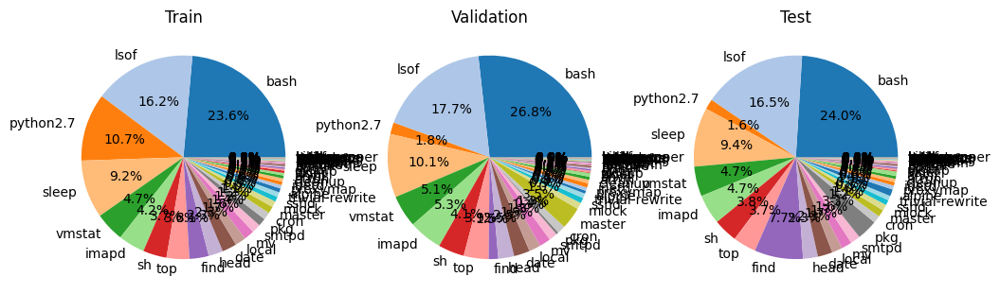

In [10]:
# print distributions in all 3 sets
train_distribution = Counter(y_train)
val_distribution = Counter(y_val)
test_distribution = Counter(y_test)

# plot 3 pie plots, use same colors for same classes
colors = plt.cm.tab20.colors
colors = [ colors[i % 20] for i in range(labels_cardinality) ]

# sort labels by occurence in training set
sorted_labels = sorted(train_distribution, key=train_distribution.get, reverse=True)

# sort all distributions by sorted_labels
train_distribution = [train_distribution[label] for label in sorted_labels]
val_distribution = [val_distribution[label] for label in sorted_labels]
test_distribution = [test_distribution[label] for label in sorted_labels]

# transform labels to names
sorted_labels = [labels_map[label] for label in sorted_labels]

fig, axs = plt.subplots(1, 3, figsize=(30*cm, 10*cm))
axs[0].pie(train_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[0].set_title('Train')
axs[1].pie(val_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[1].set_title('Validation')
axs[2].pie(test_distribution, labels=sorted_labels, colors=colors, autopct='%1.1f%%')
axs[2].set_title('Test')
plt.savefig(f'{checkpoint_path}/distributions.png')
plt.show()

In [11]:
# one-hot encode labels
y_train = np.eye(labels_cardinality)[y_train]
y_val = np.eye(labels_cardinality)[y_val]
y_test = np.eye(labels_cardinality)[y_test]

In [12]:
# one-hot encode features
# at this point, X_* are lists of tuples of vectorized features
def encode_features(sequence: np.ndarray) -> np.ndarray:
    # Precompute identity matrices
    event_eye = np.eye(event_types_cardinality)
    addr_eye = np.eye(len(addr_map))
    port_eye = np.eye(len(port_map))

    # Initialize the output array with precomputed shapes
    encoded_seq = np.empty((len(sequence), event_eye.shape[1] + 4 * addr_eye.shape[1] + 4 * port_eye.shape[1]))


    for i, feature_vector in enumerate(sequence):
        # one-hot
        event = event_eye[feature_vector[0]]
        addr1 = addr_eye[feature_vector[1]]
        port1 = port_eye[feature_vector[2]]
        addr2 = addr_eye[feature_vector[3]]
        port2 = port_eye[feature_vector[4]]
        addr3 = addr_eye[feature_vector[5]]
        port3 = port_eye[feature_vector[6]]
        addr4 = addr_eye[feature_vector[7]]
        port4 = port_eye[feature_vector[8]]

        # Concatenate all features into a single feature vector
        encoded_seq[i] = np.concatenate((event, addr1, port1, addr2, port2, addr3, port3, addr4, port4))

    return encoded_seq

X_train = [ encode_features(x) for x in X_train ]
X_val = [ encode_features(x) for x in X_val ]
X_test = [ encode_features(x) for x in X_test ]

In [13]:
feature_vector_cardinality = X_train[0].shape[1]

print(f'Feature vector cardinality: {feature_vector_cardinality}')

Feature vector cardinality: 133


In [14]:
# debug print first sequence first 5 elements
print(X_train[0][:5])

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


In [15]:
X_train, y_train = shuffle(X_train, y_train)
X_val, y_val = shuffle(X_val, y_val)
X_test, y_test = shuffle(X_test, y_test)

build model

In [16]:
model = Sequential(layers=[
    Input(shape=(None, feature_vector_cardinality)),
    SimpleRNN(128, return_sequences=True),
    SimpleRNN(128, return_sequences=True),
    SimpleRNN(128, return_sequences=False),
    Dense(labels_cardinality, activation='softmax')
])

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ simple_rnn (SimpleRNN)          │ (None, None, 128)      │        33,536 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_1 (SimpleRNN)        │ (None, None, 128)      │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ simple_rnn_2 (SimpleRNN)        │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 67)             │         8,643 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 107,971 (421.76 KB)

 Trainable params: 107,971 (421.76 KB)

 Non-trainable params: 0 (0.00 B)

In [17]:
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=5,
        verbose=1,
        mode='auto'
    ),
    ModelCheckpoint(
        filepath=model_path,
        monitor='val_loss',
        save_best_only=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=3,
        verbose=1,
        mode='auto',
        min_lr=1e-7
    ),
    CSVLogger(
        filename=log_path,
        append=True
    )
]

loss = CategoricalCrossentropy()
optimizer = Adam(learning_rate=0.0001)

# class weights
y_train_int = np.argmax(y_train, axis=1)
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train_int),
    y=y_train_int
)
class_weights_dict = dict(enumerate(class_weights))

metrics = [
    CategoricalAccuracy(name='categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'top_{top_k}_categorical_accuracy'),
]

weighted_metrics = [
    CategoricalAccuracy(name='w_categorical_accuracy'),
    TopKCategoricalAccuracy(k=top_k, name=f'w_top_{top_k}_categorical_accuracy'),
]

# 'categorical_focal_crossentropy'
# 'categorical_crossentropy'
model.compile(
    loss=loss,
    optimizer=optimizer,
    metrics=metrics,
    weighted_metrics=weighted_metrics,
)

train model

In [18]:
history = model.fit(
    x=Generator(X_train, y_train, 64, max_sequence_length),
    validation_data=Generator(X_val, y_val, 128, max_sequence_length),
    epochs=200,
    callbacks=callbacks,
    class_weight=class_weights_dict
)

# save history to file
with open(history_path, 'wb') as f:
    np.save(f, history.history)

Epoch 1/200


I0000 00:00:1724225356.623336 1962787 service.cc:145] XLA service 0x58ad610 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1724225356.623391 1962787 service.cc:153]   StreamExecutor device (0): NVIDIA GeForce RTX 2080 Ti, Compute Capability 7.5


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 7:36:01 7s/step - categorical_accuracy: 0.0156 - loss: 2.7336 - top_3_categorical_accuracy: 0.0781 - w_categorical_accuracy: 0.0081 - w_top_3_categorical_accuracy: 0.4191

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:18 36ms/step - categorical_accuracy: 0.0095 - loss: 5.4763 - top_3_categorical_accuracy: 0.0564 - w_categorical_accuracy: 0.0036 - w_top_3_categorical_accuracy: 0.1869 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:13 35ms/step - categorical_accuracy: 0.0071 - loss: 5.7532 - top_3_categorical_accuracy: 0.0465 - w_categorical_accuracy: 0.0025 - w_top_3_categorical_accuracy: 0.1317

I0000 00:00:1724225361.237416 1962787 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 34ms/step - categorical_accuracy: 0.0058 - loss: 5.7783 - top_3_categorical_accuracy: 0.0401 - w_categorical_accuracy: 0.0020 - w_top_3_categorical_accuracy: 0.1044

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 34ms/step - categorical_accuracy: 0.0049 - loss: 5.5820 - top_3_categorical_accuracy: 0.0367 - w_categorical_accuracy: 0.0017 - w_top_3_categorical_accuracy: 0.0893

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:09 34ms/step - categorical_accuracy: 0.0043 - loss: 5.3649 - top_3_categorical_accuracy: 0.0341 - w_categorical_accuracy: 0.0015 - w_top_3_categorical_accuracy: 0.0794

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 33ms/step - categorical_accuracy: 0.0038 - loss: 5.2259 - top_3_categorical_accuracy: 0.0324 - w_categorical_accuracy: 0.0013 - w_top_3_categorical_accuracy: 0.0722

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:06 33ms/step - categorical_accuracy: 0.0035 - loss: 5.1262 - top_3_categorical_accuracy: 0.0308 - w_categorical_accuracy: 0.0012 - w_top_3_categorical_accuracy: 0.0664

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 33ms/step - categorical_accuracy: 0.0032 - loss: 5.0193 - top_3_categorical_accuracy: 0.0293 - w_categorical_accuracy: 0.0011 - w_top_3_categorical_accuracy: 0.0617

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 33ms/step - categorical_accuracy: 0.0029 - loss: 4.9193 - top_3_categorical_accuracy: 0.0279 - w_categorical_accuracy: 0.0010 - w_top_3_categorical_accuracy: 0.0578

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.0027 - loss: 4.8766 - top_3_categorical_accuracy: 0.0271 - w_categorical_accuracy: 9.3425e-04 - w_top_3_categorical_accuracy: 0.0548

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.0030 - loss: 4.9199 - top_3_categorical_accuracy: 0.0276 - w_categorical_accuracy: 8.9601e-04 - w_top_3_categorical_accuracy: 0.0522

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.0032 - loss: 4.9311 - top_3_categorical_accuracy: 0.0281 - w_categorical_accuracy: 8.6288e-04 - w_top_3_categorical_accuracy: 0.0502

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0034 - loss: 4.9261 - top_3_categorical_accuracy: 0.0286 - w_categorical_accuracy: 8.3321e-04 - w_top_3_categorical_accuracy: 0.0486

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0035 - loss: 4.9146 - top_3_categorical_accuracy: 0.0290 - w_categorical_accuracy: 8.1150e-04 - w_top_3_categorical_accuracy: 0.0472

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0037 - loss: 4.9002 - top_3_categorical_accuracy: 0.0295 - w_categorical_accuracy: 8.2576e-04 - w_top_3_categorical_accuracy: 0.0460

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0039 - loss: 4.8872 - top_3_categorical_accuracy: 0.0299 - w_categorical_accuracy: 8.5648e-04 - w_top_3_categorical_accuracy: 0.0449

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.0043 - loss: 4.8667 - top_3_categorical_accuracy: 0.0304 - w_categorical_accuracy: 0.0011 - w_top_3_categorical_accuracy: 0.0442    

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0047 - loss: 4.8420 - top_3_categorical_accuracy: 0.0310 - w_categorical_accuracy: 0.0016 - w_top_3_categorical_accuracy: 0.0439

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0051 - loss: 4.8227 - top_3_categorical_accuracy: 0.0315 - w_categorical_accuracy: 0.0019 - w_top_3_categorical_accuracy: 0.0435

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0055 - loss: 4.8052 - top_3_categorical_accuracy: 0.0321 - w_categorical_accuracy: 0.0023 - w_top_3_categorical_accuracy: 0.0432

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0060 - loss: 4.7855 - top_3_categorical_accuracy: 0.0327 - w_categorical_accuracy: 0.0027 - w_top_3_categorical_accuracy: 0.0430

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0064 - loss: 4.7638 - top_3_categorical_accuracy: 0.0332 - w_categorical_accuracy: 0.0030 - w_top_3_categorical_accuracy: 0.0427

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0067 - loss: 4.7399 - top_3_categorical_accuracy: 0.0337 - w_categorical_accuracy: 0.0033 - w_top_3_categorical_accuracy: 0.0425

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0071 - loss: 4.7142 - top_3_categorical_accuracy: 0.0342 - w_categorical_accuracy: 0.0036 - w_top_3_categorical_accuracy: 0.0423

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.0075 - loss: 4.6876 - top_3_categorical_accuracy: 0.0346 - w_categorical_accuracy: 0.0039 - w_top_3_categorical_accuracy: 0.0421

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0078 - loss: 4.6603 - top_3_categorical_accuracy: 0.0350 - w_categorical_accuracy: 0.0042 - w_top_3_categorical_accuracy: 0.0420

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0082 - loss: 4.6329 - top_3_categorical_accuracy: 0.0354 - w_categorical_accuracy: 0.0045 - w_top_3_categorical_accuracy: 0.0419

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0086 - loss: 4.6078 - top_3_categorical_accuracy: 0.0358 - w_categorical_accuracy: 0.0051 - w_top_3_categorical_accuracy: 0.0421

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0090 - loss: 4.6076 - top_3_categorical_accuracy: 0.0361 - w_categorical_accuracy: 0.0055 - w_top_3_categorical_accuracy: 0.0420

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0094 - loss: 4.6053 - top_3_categorical_accuracy: 0.0365 - w_categorical_accuracy: 0.0059 - w_top_3_categorical_accuracy: 0.0420

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0097 - loss: 4.6003 - top_3_categorical_accuracy: 0.0368 - w_categorical_accuracy: 0.0063 - w_top_3_categorical_accuracy: 0.0420

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0100 - loss: 4.5939 - top_3_categorical_accuracy: 0.0372 - w_categorical_accuracy: 0.0066 - w_top_3_categorical_accuracy: 0.0421

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0103 - loss: 4.5936 - top_3_categorical_accuracy: 0.0376 - w_categorical_accuracy: 0.0069 - w_top_3_categorical_accuracy: 0.0422

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.0106 - loss: 4.5925 - top_3_categorical_accuracy: 0.0380 - w_categorical_accuracy: 0.0072 - w_top_3_categorical_accuracy: 0.0424

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0108 - loss: 4.5898 - top_3_categorical_accuracy: 0.0384 - w_categorical_accuracy: 0.0075 - w_top_3_categorical_accuracy: 0.0426

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0111 - loss: 4.5861 - top_3_categorical_accuracy: 0.0387 - w_categorical_accuracy: 0.0078 - w_top_3_categorical_accuracy: 0.0429

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0113 - loss: 4.5833 - top_3_categorical_accuracy: 0.0391 - w_categorical_accuracy: 0.0083 - w_top_3_categorical_accuracy: 0.0434

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0115 - loss: 4.5808 - top_3_categorical_accuracy: 0.0395 - w_categorical_accuracy: 0.0089 - w_top_3_categorical_accuracy: 0.0439

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0117 - loss: 4.5769 - top_3_categorical_accuracy: 0.0401 - w_categorical_accuracy: 0.0095 - w_top_3_categorical_accuracy: 0.0445

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0119 - loss: 4.5721 - top_3_categorical_accuracy: 0.0406 - w_categorical_accuracy: 0.0102 - w_top_3_categorical_accuracy: 0.0452

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0121 - loss: 4.5665 - top_3_categorical_accuracy: 0.0413 - w_categorical_accuracy: 0.0109 - w_top_3_categorical_accuracy: 0.0458

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0123 - loss: 4.5601 - top_3_categorical_accuracy: 0.0419 - w_categorical_accuracy: 0.0115 - w_top_3_categorical_accuracy: 0.0465

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0125 - loss: 4.5543 - top_3_categorical_accuracy: 0.0427 - w_categorical_accuracy: 0.0121 - w_top_3_categorical_accuracy: 0.0471

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0126 - loss: 4.5497 - top_3_categorical_accuracy: 0.0435 - w_categorical_accuracy: 0.0127 - w_top_3_categorical_accuracy: 0.0478

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.0128 - loss: 4.5448 - top_3_categorical_accuracy: 0.0443 - w_categorical_accuracy: 0.0132 - w_top_3_categorical_accuracy: 0.0484

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.0129 - loss: 4.5403 - top_3_categorical_accuracy: 0.0453 - w_categorical_accuracy: 0.0137 - w_top_3_categorical_accuracy: 0.0491

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.0130 - loss: 4.5354 - top_3_categorical_accuracy: 0.0462 - w_categorical_accuracy: 0.0142 - w_top_3_categorical_accuracy: 0.0497

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.0132 - loss: 4.5349 - top_3_categorical_accuracy: 0.0472 - w_categorical_accuracy: 0.0146 - w_top_3_categorical_accuracy: 0.0502

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.0133 - loss: 4.5362 - top_3_categorical_accuracy: 0.0482 - w_categorical_accuracy: 0.0150 - w_top_3_categorical_accuracy: 0.0507

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.0134 - loss: 4.5366 - top_3_categorical_accuracy: 0.0492 - w_categorical_accuracy: 0.0154 - w_top_3_categorical_accuracy: 0.0512

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.0135 - loss: 4.5368 - top_3_categorical_accuracy: 0.0503 - w_categorical_accuracy: 0.0158 - w_top_3_categorical_accuracy: 0.0518

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0136 - loss: 4.5362 - top_3_categorical_accuracy: 0.0514 - w_categorical_accuracy: 0.0162 - w_top_3_categorical_accuracy: 0.0524

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0137 - loss: 4.5376 - top_3_categorical_accuracy: 0.0525 - w_categorical_accuracy: 0.0167 - w_top_3_categorical_accuracy: 0.0530

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0138 - loss: 4.5414 - top_3_categorical_accuracy: 0.0537 - w_categorical_accuracy: 0.0171 - w_top_3_categorical_accuracy: 0.0544

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.0139 - loss: 4.5444 - top_3_categorical_accuracy: 0.0549 - w_categorical_accuracy: 0.0175 - w_top_3_categorical_accuracy: 0.0557

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0142 - loss: 4.5464 - top_3_categorical_accuracy: 0.0561 - w_categorical_accuracy: 0.0180 - w_top_3_categorical_accuracy: 0.0570

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0144 - loss: 4.5487 - top_3_categorical_accuracy: 0.0574 - w_categorical_accuracy: 0.0184 - w_top_3_categorical_accuracy: 0.0582

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0147 - loss: 4.5505 - top_3_categorical_accuracy: 0.0587 - w_categorical_accuracy: 0.0188 - w_top_3_categorical_accuracy: 0.0594

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0151 - loss: 4.5525 - top_3_categorical_accuracy: 0.0601 - w_categorical_accuracy: 0.0192 - w_top_3_categorical_accuracy: 0.0608

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0156 - loss: 4.5537 - top_3_categorical_accuracy: 0.0615 - w_categorical_accuracy: 0.0195 - w_top_3_categorical_accuracy: 0.0621

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0160 - loss: 4.5541 - top_3_categorical_accuracy: 0.0629 - w_categorical_accuracy: 0.0199 - w_top_3_categorical_accuracy: 0.0634

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0165 - loss: 4.5541 - top_3_categorical_accuracy: 0.0643 - w_categorical_accuracy: 0.0203 - w_top_3_categorical_accuracy: 0.0647

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0170 - loss: 4.5536 - top_3_categorical_accuracy: 0.0658 - w_categorical_accuracy: 0.0206 - w_top_3_categorical_accuracy: 0.0659

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0176 - loss: 4.5525 - top_3_categorical_accuracy: 0.0673 - w_categorical_accuracy: 0.0209 - w_top_3_categorical_accuracy: 0.0671

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0181 - loss: 4.5510 - top_3_categorical_accuracy: 0.0687 - w_categorical_accuracy: 0.0213 - w_top_3_categorical_accuracy: 0.0683

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0187 - loss: 4.5492 - top_3_categorical_accuracy: 0.0702 - w_categorical_accuracy: 0.0216 - w_top_3_categorical_accuracy: 0.0695

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.0193 - loss: 4.5474 - top_3_categorical_accuracy: 0.0718 - w_categorical_accuracy: 0.0219 - w_top_3_categorical_accuracy: 0.0707

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0200 - loss: 4.5451 - top_3_categorical_accuracy: 0.0733 - w_categorical_accuracy: 0.0222 - w_top_3_categorical_accuracy: 0.0718

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0206 - loss: 4.5445 - top_3_categorical_accuracy: 0.0749 - w_categorical_accuracy: 0.0227 - w_top_3_categorical_accuracy: 0.0730

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0213 - loss: 4.5451 - top_3_categorical_accuracy: 0.0764 - w_categorical_accuracy: 0.0234 - w_top_3_categorical_accuracy: 0.0744

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0220 - loss: 4.5453 - top_3_categorical_accuracy: 0.0780 - w_categorical_accuracy: 0.0241 - w_top_3_categorical_accuracy: 0.0758

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0227 - loss: 4.5451 - top_3_categorical_accuracy: 0.0796 - w_categorical_accuracy: 0.0248 - w_top_3_categorical_accuracy: 0.0771

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0234 - loss: 4.5445 - top_3_categorical_accuracy: 0.0811 - w_categorical_accuracy: 0.0254 - w_top_3_categorical_accuracy: 0.0785

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0241 - loss: 4.5435 - top_3_categorical_accuracy: 0.0827 - w_categorical_accuracy: 0.0260 - w_top_3_categorical_accuracy: 0.0798

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0249 - loss: 4.5423 - top_3_categorical_accuracy: 0.0842 - w_categorical_accuracy: 0.0266 - w_top_3_categorical_accuracy: 0.0810

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0256 - loss: 4.5410 - top_3_categorical_accuracy: 0.0857 - w_categorical_accuracy: 0.0272 - w_top_3_categorical_accuracy: 0.0822

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0263 - loss: 4.5404 - top_3_categorical_accuracy: 0.0872 - w_categorical_accuracy: 0.0278 - w_top_3_categorical_accuracy: 0.0834

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0271 - loss: 4.5393 - top_3_categorical_accuracy: 0.0887 - w_categorical_accuracy: 0.0283 - w_top_3_categorical_accuracy: 0.0846

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0278 - loss: 4.5378 - top_3_categorical_accuracy: 0.0902 - w_categorical_accuracy: 0.0288 - w_top_3_categorical_accuracy: 0.0858

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0286 - loss: 4.5359 - top_3_categorical_accuracy: 0.0917 - w_categorical_accuracy: 0.0293 - w_top_3_categorical_accuracy: 0.0869

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0293 - loss: 4.5339 - top_3_categorical_accuracy: 0.0931 - w_categorical_accuracy: 0.0298 - w_top_3_categorical_accuracy: 0.0880

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.0301 - loss: 4.5315 - top_3_categorical_accuracy: 0.0946 - w_categorical_accuracy: 0.0303 - w_top_3_categorical_accuracy: 0.0890

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0308 - loss: 4.5287 - top_3_categorical_accuracy: 0.0960 - w_categorical_accuracy: 0.0308 - w_top_3_categorical_accuracy: 0.0901

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0316 - loss: 4.5266 - top_3_categorical_accuracy: 0.0974 - w_categorical_accuracy: 0.0312 - w_top_3_categorical_accuracy: 0.0910

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0323 - loss: 4.5255 - top_3_categorical_accuracy: 0.0988 - w_categorical_accuracy: 0.0317 - w_top_3_categorical_accuracy: 0.0920

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0331 - loss: 4.5246 - top_3_categorical_accuracy: 0.1001 - w_categorical_accuracy: 0.0322 - w_top_3_categorical_accuracy: 0.0929

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0338 - loss: 4.5236 - top_3_categorical_accuracy: 0.1014 - w_categorical_accuracy: 0.0327 - w_top_3_categorical_accuracy: 0.0938

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0344 - loss: 4.5226 - top_3_categorical_accuracy: 0.1027 - w_categorical_accuracy: 0.0331 - w_top_3_categorical_accuracy: 0.0947

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0351 - loss: 4.5213 - top_3_categorical_accuracy: 0.1040 - w_categorical_accuracy: 0.0336 - w_top_3_categorical_accuracy: 0.0956

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0357 - loss: 4.5198 - top_3_categorical_accuracy: 0.1052 - w_categorical_accuracy: 0.0340 - w_top_3_categorical_accuracy: 0.0964

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0363 - loss: 4.5180 - top_3_categorical_accuracy: 0.1064 - w_categorical_accuracy: 0.0345 - w_top_3_categorical_accuracy: 0.0973

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0369 - loss: 4.5159 - top_3_categorical_accuracy: 0.1075 - w_categorical_accuracy: 0.0349 - w_top_3_categorical_accuracy: 0.0981

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0374 - loss: 4.5136 - top_3_categorical_accuracy: 0.1087 - w_categorical_accuracy: 0.0353 - w_top_3_categorical_accuracy: 0.0989

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0380 - loss: 4.5115 - top_3_categorical_accuracy: 0.1098 - w_categorical_accuracy: 0.0357 - w_top_3_categorical_accuracy: 0.0997

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0385 - loss: 4.5097 - top_3_categorical_accuracy: 0.1108 - w_categorical_accuracy: 0.0360 - w_top_3_categorical_accuracy: 0.1004

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.0390 - loss: 4.5077 - top_3_categorical_accuracy: 0.1119 - w_categorical_accuracy: 0.0364 - w_top_3_categorical_accuracy: 0.1011

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0394 - loss: 4.5055 - top_3_categorical_accuracy: 0.1129 - w_categorical_accuracy: 0.0368 - w_top_3_categorical_accuracy: 0.1018

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0399 - loss: 4.5030 - top_3_categorical_accuracy: 0.1139 - w_categorical_accuracy: 0.0371 - w_top_3_categorical_accuracy: 0.1025

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0403 - loss: 4.5004 - top_3_categorical_accuracy: 0.1149 - w_categorical_accuracy: 0.0374 - w_top_3_categorical_accuracy: 0.1032

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0408 - loss: 4.4977 - top_3_categorical_accuracy: 0.1159 - w_categorical_accuracy: 0.0378 - w_top_3_categorical_accuracy: 0.1039

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0412 - loss: 4.4951 - top_3_categorical_accuracy: 0.1168 - w_categorical_accuracy: 0.0381 - w_top_3_categorical_accuracy: 0.1045

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0416 - loss: 4.4924 - top_3_categorical_accuracy: 0.1177 - w_categorical_accuracy: 0.0384 - w_top_3_categorical_accuracy: 0.1052

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0420 - loss: 4.4897 - top_3_categorical_accuracy: 0.1186 - w_categorical_accuracy: 0.0387 - w_top_3_categorical_accuracy: 0.1058

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0424 - loss: 4.4870 - top_3_categorical_accuracy: 0.1195 - w_categorical_accuracy: 0.0391 - w_top_3_categorical_accuracy: 0.1065

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0428 - loss: 4.4845 - top_3_categorical_accuracy: 0.1203 - w_categorical_accuracy: 0.0394 - w_top_3_categorical_accuracy: 0.1071

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0431 - loss: 4.4820 - top_3_categorical_accuracy: 0.1212 - w_categorical_accuracy: 0.0397 - w_top_3_categorical_accuracy: 0.1077

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0435 - loss: 4.4794 - top_3_categorical_accuracy: 0.1220 - w_categorical_accuracy: 0.0400 - w_top_3_categorical_accuracy: 0.1083

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0439 - loss: 4.4767 - top_3_categorical_accuracy: 0.1228 - w_categorical_accuracy: 0.0404 - w_top_3_categorical_accuracy: 0.1089

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0442 - loss: 4.4739 - top_3_categorical_accuracy: 0.1236 - w_categorical_accuracy: 0.0408 - w_top_3_categorical_accuracy: 0.1096

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.0446 - loss: 4.4711 - top_3_categorical_accuracy: 0.1244 - w_categorical_accuracy: 0.0411 - w_top_3_categorical_accuracy: 0.1102

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0449 - loss: 4.4683 - top_3_categorical_accuracy: 0.1252 - w_categorical_accuracy: 0.0415 - w_top_3_categorical_accuracy: 0.1109

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0453 - loss: 4.4654 - top_3_categorical_accuracy: 0.1260 - w_categorical_accuracy: 0.0418 - w_top_3_categorical_accuracy: 0.1115

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0456 - loss: 4.4623 - top_3_categorical_accuracy: 0.1267 - w_categorical_accuracy: 0.0422 - w_top_3_categorical_accuracy: 0.1122

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0459 - loss: 4.4591 - top_3_categorical_accuracy: 0.1274 - w_categorical_accuracy: 0.0425 - w_top_3_categorical_accuracy: 0.1128

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0462 - loss: 4.4559 - top_3_categorical_accuracy: 0.1282 - w_categorical_accuracy: 0.0429 - w_top_3_categorical_accuracy: 0.1134

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0465 - loss: 4.4527 - top_3_categorical_accuracy: 0.1289 - w_categorical_accuracy: 0.0433 - w_top_3_categorical_accuracy: 0.1141

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0468 - loss: 4.4496 - top_3_categorical_accuracy: 0.1296 - w_categorical_accuracy: 0.0436 - w_top_3_categorical_accuracy: 0.1148

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0471 - loss: 4.4466 - top_3_categorical_accuracy: 0.1303 - w_categorical_accuracy: 0.0439 - w_top_3_categorical_accuracy: 0.1155

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0473 - loss: 4.4436 - top_3_categorical_accuracy: 0.1310 - w_categorical_accuracy: 0.0443 - w_top_3_categorical_accuracy: 0.1161

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0476 - loss: 4.4404 - top_3_categorical_accuracy: 0.1316 - w_categorical_accuracy: 0.0446 - w_top_3_categorical_accuracy: 0.1168

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0479 - loss: 4.4372 - top_3_categorical_accuracy: 0.1323 - w_categorical_accuracy: 0.0449 - w_top_3_categorical_accuracy: 0.1174

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.0481 - loss: 4.4338 - top_3_categorical_accuracy: 0.1329 - w_categorical_accuracy: 0.0453 - w_top_3_categorical_accuracy: 0.1181

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0484 - loss: 4.4305 - top_3_categorical_accuracy: 0.1335 - w_categorical_accuracy: 0.0456 - w_top_3_categorical_accuracy: 0.1187

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0486 - loss: 4.4271 - top_3_categorical_accuracy: 0.1341 - w_categorical_accuracy: 0.0459 - w_top_3_categorical_accuracy: 0.1193

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0488 - loss: 4.4238 - top_3_categorical_accuracy: 0.1347 - w_categorical_accuracy: 0.0462 - w_top_3_categorical_accuracy: 0.1200

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0491 - loss: 4.4208 - top_3_categorical_accuracy: 0.1353 - w_categorical_accuracy: 0.0466 - w_top_3_categorical_accuracy: 0.1206

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0493 - loss: 4.4179 - top_3_categorical_accuracy: 0.1358 - w_categorical_accuracy: 0.0470 - w_top_3_categorical_accuracy: 0.1213

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0495 - loss: 4.4149 - top_3_categorical_accuracy: 0.1364 - w_categorical_accuracy: 0.0473 - w_top_3_categorical_accuracy: 0.1219

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0497 - loss: 4.4119 - top_3_categorical_accuracy: 0.1369 - w_categorical_accuracy: 0.0477 - w_top_3_categorical_accuracy: 0.1226

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0499 - loss: 4.4089 - top_3_categorical_accuracy: 0.1375 - w_categorical_accuracy: 0.0480 - w_top_3_categorical_accuracy: 0.1232

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0501 - loss: 4.4058 - top_3_categorical_accuracy: 0.1380 - w_categorical_accuracy: 0.0484 - w_top_3_categorical_accuracy: 0.1238

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0503 - loss: 4.4027 - top_3_categorical_accuracy: 0.1386 - w_categorical_accuracy: 0.0487 - w_top_3_categorical_accuracy: 0.1245

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0505 - loss: 4.3997 - top_3_categorical_accuracy: 0.1391 - w_categorical_accuracy: 0.0491 - w_top_3_categorical_accuracy: 0.1251

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.0507 - loss: 4.3967 - top_3_categorical_accuracy: 0.1396 - w_categorical_accuracy: 0.0494 - w_top_3_categorical_accuracy: 0.1258

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0509 - loss: 4.3935 - top_3_categorical_accuracy: 0.1402 - w_categorical_accuracy: 0.0497 - w_top_3_categorical_accuracy: 0.1264

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0511 - loss: 4.3905 - top_3_categorical_accuracy: 0.1407 - w_categorical_accuracy: 0.0501 - w_top_3_categorical_accuracy: 0.1271

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0513 - loss: 4.3877 - top_3_categorical_accuracy: 0.1412 - w_categorical_accuracy: 0.0504 - w_top_3_categorical_accuracy: 0.1277

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0515 - loss: 4.3847 - top_3_categorical_accuracy: 0.1417 - w_categorical_accuracy: 0.0507 - w_top_3_categorical_accuracy: 0.1283

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0516 - loss: 4.3818 - top_3_categorical_accuracy: 0.1422 - w_categorical_accuracy: 0.0511 - w_top_3_categorical_accuracy: 0.1289

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0518 - loss: 4.3787 - top_3_categorical_accuracy: 0.1427 - w_categorical_accuracy: 0.0514 - w_top_3_categorical_accuracy: 0.1295

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0520 - loss: 4.3757 - top_3_categorical_accuracy: 0.1432 - w_categorical_accuracy: 0.0517 - w_top_3_categorical_accuracy: 0.1301

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0521 - loss: 4.3727 - top_3_categorical_accuracy: 0.1437 - w_categorical_accuracy: 0.0520 - w_top_3_categorical_accuracy: 0.1307

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0523 - loss: 4.3696 - top_3_categorical_accuracy: 0.1442 - w_categorical_accuracy: 0.0524 - w_top_3_categorical_accuracy: 0.1313

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0525 - loss: 4.3664 - top_3_categorical_accuracy: 0.1446 - w_categorical_accuracy: 0.0527 - w_top_3_categorical_accuracy: 0.1319

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0527 - loss: 4.3633 - top_3_categorical_accuracy: 0.1451 - w_categorical_accuracy: 0.0530 - w_top_3_categorical_accuracy: 0.1325

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0528 - loss: 4.3600 - top_3_categorical_accuracy: 0.1456 - w_categorical_accuracy: 0.0533 - w_top_3_categorical_accuracy: 0.1330

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.0530 - loss: 4.3568 - top_3_categorical_accuracy: 0.1461 - w_categorical_accuracy: 0.0536 - w_top_3_categorical_accuracy: 0.1336

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0532 - loss: 4.3535 - top_3_categorical_accuracy: 0.1465 - w_categorical_accuracy: 0.0539 - w_top_3_categorical_accuracy: 0.1341

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0534 - loss: 4.3502 - top_3_categorical_accuracy: 0.1470 - w_categorical_accuracy: 0.0542 - w_top_3_categorical_accuracy: 0.1347

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0535 - loss: 4.3469 - top_3_categorical_accuracy: 0.1475 - w_categorical_accuracy: 0.0545 - w_top_3_categorical_accuracy: 0.1353

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0537 - loss: 4.3436 - top_3_categorical_accuracy: 0.1479 - w_categorical_accuracy: 0.0548 - w_top_3_categorical_accuracy: 0.1358

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0539 - loss: 4.3403 - top_3_categorical_accuracy: 0.1484 - w_categorical_accuracy: 0.0551 - w_top_3_categorical_accuracy: 0.1364

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0541 - loss: 4.3369 - top_3_categorical_accuracy: 0.1488 - w_categorical_accuracy: 0.0554 - w_top_3_categorical_accuracy: 0.1369

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0543 - loss: 4.3336 - top_3_categorical_accuracy: 0.1493 - w_categorical_accuracy: 0.0557 - w_top_3_categorical_accuracy: 0.1374

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0545 - loss: 4.3302 - top_3_categorical_accuracy: 0.1497 - w_categorical_accuracy: 0.0560 - w_top_3_categorical_accuracy: 0.1380

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0547 - loss: 4.3268 - top_3_categorical_accuracy: 0.1502 - w_categorical_accuracy: 0.0563 - w_top_3_categorical_accuracy: 0.1385

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0549 - loss: 4.3233 - top_3_categorical_accuracy: 0.1506 - w_categorical_accuracy: 0.0567 - w_top_3_categorical_accuracy: 0.1390

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0551 - loss: 4.3200 - top_3_categorical_accuracy: 0.1511 - w_categorical_accuracy: 0.0570 - w_top_3_categorical_accuracy: 0.1396

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0553 - loss: 4.3166 - top_3_categorical_accuracy: 0.1515 - w_categorical_accuracy: 0.0573 - w_top_3_categorical_accuracy: 0.1401

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0555 - loss: 4.3132 - top_3_categorical_accuracy: 0.1520 - w_categorical_accuracy: 0.0576 - w_top_3_categorical_accuracy: 0.1407

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.0557 - loss: 4.3098 - top_3_categorical_accuracy: 0.1524 - w_categorical_accuracy: 0.0579 - w_top_3_categorical_accuracy: 0.1412

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0559 - loss: 4.3064 - top_3_categorical_accuracy: 0.1529 - w_categorical_accuracy: 0.0582 - w_top_3_categorical_accuracy: 0.1417

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0560 - loss: 4.3030 - top_3_categorical_accuracy: 0.1533 - w_categorical_accuracy: 0.0585 - w_top_3_categorical_accuracy: 0.1423

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0562 - loss: 4.2995 - top_3_categorical_accuracy: 0.1538 - w_categorical_accuracy: 0.0588 - w_top_3_categorical_accuracy: 0.1428

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0564 - loss: 4.2960 - top_3_categorical_accuracy: 0.1542 - w_categorical_accuracy: 0.0591 - w_top_3_categorical_accuracy: 0.1433

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0566 - loss: 4.2925 - top_3_categorical_accuracy: 0.1547 - w_categorical_accuracy: 0.0594 - w_top_3_categorical_accuracy: 0.1438

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0568 - loss: 4.2889 - top_3_categorical_accuracy: 0.1551 - w_categorical_accuracy: 0.0597 - w_top_3_categorical_accuracy: 0.1444

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0570 - loss: 4.2853 - top_3_categorical_accuracy: 0.1556 - w_categorical_accuracy: 0.0600 - w_top_3_categorical_accuracy: 0.1449

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0572 - loss: 4.2817 - top_3_categorical_accuracy: 0.1560 - w_categorical_accuracy: 0.0603 - w_top_3_categorical_accuracy: 0.1454

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0573 - loss: 4.2782 - top_3_categorical_accuracy: 0.1564 - w_categorical_accuracy: 0.0606 - w_top_3_categorical_accuracy: 0.1459

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0575 - loss: 4.2747 - top_3_categorical_accuracy: 0.1569 - w_categorical_accuracy: 0.0609 - w_top_3_categorical_accuracy: 0.1464

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0577 - loss: 4.2711 - top_3_categorical_accuracy: 0.1573 - w_categorical_accuracy: 0.0612 - w_top_3_categorical_accuracy: 0.1470

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0579 - loss: 4.2676 - top_3_categorical_accuracy: 0.1578 - w_categorical_accuracy: 0.0615 - w_top_3_categorical_accuracy: 0.1475

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0581 - loss: 4.2640 - top_3_categorical_accuracy: 0.1582 - w_categorical_accuracy: 0.0619 - w_top_3_categorical_accuracy: 0.1480

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0583 - loss: 4.2605 - top_3_categorical_accuracy: 0.1587 - w_categorical_accuracy: 0.0622 - w_top_3_categorical_accuracy: 0.1485

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0585 - loss: 4.2571 - top_3_categorical_accuracy: 0.1591 - w_categorical_accuracy: 0.0625 - w_top_3_categorical_accuracy: 0.1491

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.0587 - loss: 4.2537 - top_3_categorical_accuracy: 0.1596 - w_categorical_accuracy: 0.0628 - w_top_3_categorical_accuracy: 0.1496

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0589 - loss: 4.2503 - top_3_categorical_accuracy: 0.1600 - w_categorical_accuracy: 0.0632 - w_top_3_categorical_accuracy: 0.1501

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0591 - loss: 4.2469 - top_3_categorical_accuracy: 0.1605 - w_categorical_accuracy: 0.0635 - w_top_3_categorical_accuracy: 0.1506

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0593 - loss: 4.2436 - top_3_categorical_accuracy: 0.1609 - w_categorical_accuracy: 0.0638 - w_top_3_categorical_accuracy: 0.1511

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0595 - loss: 4.2402 - top_3_categorical_accuracy: 0.1614 - w_categorical_accuracy: 0.0641 - w_top_3_categorical_accuracy: 0.1516

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0597 - loss: 4.2369 - top_3_categorical_accuracy: 0.1618 - w_categorical_accuracy: 0.0645 - w_top_3_categorical_accuracy: 0.1521

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0599 - loss: 4.2336 - top_3_categorical_accuracy: 0.1623 - w_categorical_accuracy: 0.0648 - w_top_3_categorical_accuracy: 0.1526

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0601 - loss: 4.2304 - top_3_categorical_accuracy: 0.1627 - w_categorical_accuracy: 0.0651 - w_top_3_categorical_accuracy: 0.1530

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0604 - loss: 4.2272 - top_3_categorical_accuracy: 0.1632 - w_categorical_accuracy: 0.0654 - w_top_3_categorical_accuracy: 0.1535

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0606 - loss: 4.2244 - top_3_categorical_accuracy: 0.1637 - w_categorical_accuracy: 0.0657 - w_top_3_categorical_accuracy: 0.1540

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0608 - loss: 4.2215 - top_3_categorical_accuracy: 0.1642 - w_categorical_accuracy: 0.0660 - w_top_3_categorical_accuracy: 0.1544

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0610 - loss: 4.2186 - top_3_categorical_accuracy: 0.1647 - w_categorical_accuracy: 0.0663 - w_top_3_categorical_accuracy: 0.1549

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0612 - loss: 4.2158 - top_3_categorical_accuracy: 0.1652 - w_categorical_accuracy: 0.0666 - w_top_3_categorical_accuracy: 0.1553

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0614 - loss: 4.2130 - top_3_categorical_accuracy: 0.1657 - w_categorical_accuracy: 0.0669 - w_top_3_categorical_accuracy: 0.1558

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0616 - loss: 4.2102 - top_3_categorical_accuracy: 0.1662 - w_categorical_accuracy: 0.0672 - w_top_3_categorical_accuracy: 0.1562

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0618 - loss: 4.2074 - top_3_categorical_accuracy: 0.1667 - w_categorical_accuracy: 0.0675 - w_top_3_categorical_accuracy: 0.1567

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0621 - loss: 4.2049 - top_3_categorical_accuracy: 0.1672 - w_categorical_accuracy: 0.0678 - w_top_3_categorical_accuracy: 0.1571

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.0623 - loss: 4.2026 - top_3_categorical_accuracy: 0.1677 - w_categorical_accuracy: 0.0681 - w_top_3_categorical_accuracy: 0.1576

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0625 - loss: 4.2003 - top_3_categorical_accuracy: 0.1682 - w_categorical_accuracy: 0.0685 - w_top_3_categorical_accuracy: 0.1580

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0627 - loss: 4.1980 - top_3_categorical_accuracy: 0.1687 - w_categorical_accuracy: 0.0688 - w_top_3_categorical_accuracy: 0.1585

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0629 - loss: 4.1957 - top_3_categorical_accuracy: 0.1692 - w_categorical_accuracy: 0.0691 - w_top_3_categorical_accuracy: 0.1589

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0631 - loss: 4.1934 - top_3_categorical_accuracy: 0.1698 - w_categorical_accuracy: 0.0694 - w_top_3_categorical_accuracy: 0.1594

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0633 - loss: 4.1912 - top_3_categorical_accuracy: 0.1703 - w_categorical_accuracy: 0.0697 - w_top_3_categorical_accuracy: 0.1598

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0636 - loss: 4.1889 - top_3_categorical_accuracy: 0.1708 - w_categorical_accuracy: 0.0700 - w_top_3_categorical_accuracy: 0.1602

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0638 - loss: 4.1865 - top_3_categorical_accuracy: 0.1713 - w_categorical_accuracy: 0.0703 - w_top_3_categorical_accuracy: 0.1607

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0640 - loss: 4.1842 - top_3_categorical_accuracy: 0.1718 - w_categorical_accuracy: 0.0705 - w_top_3_categorical_accuracy: 0.1611

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0642 - loss: 4.1818 - top_3_categorical_accuracy: 0.1724 - w_categorical_accuracy: 0.0708 - w_top_3_categorical_accuracy: 0.1616

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0644 - loss: 4.1794 - top_3_categorical_accuracy: 0.1729 - w_categorical_accuracy: 0.0711 - w_top_3_categorical_accuracy: 0.1620

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0646 - loss: 4.1770 - top_3_categorical_accuracy: 0.1734 - w_categorical_accuracy: 0.0714 - w_top_3_categorical_accuracy: 0.1625

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0648 - loss: 4.1746 - top_3_categorical_accuracy: 0.1740 - w_categorical_accuracy: 0.0717 - w_top_3_categorical_accuracy: 0.1629

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0650 - loss: 4.1722 - top_3_categorical_accuracy: 0.1745 - w_categorical_accuracy: 0.0720 - w_top_3_categorical_accuracy: 0.1633

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0653 - loss: 4.1698 - top_3_categorical_accuracy: 0.1750 - w_categorical_accuracy: 0.0723 - w_top_3_categorical_accuracy: 0.1638

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0655 - loss: 4.1675 - top_3_categorical_accuracy: 0.1756 - w_categorical_accuracy: 0.0726 - w_top_3_categorical_accuracy: 0.1642

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0657 - loss: 4.1651 - top_3_categorical_accuracy: 0.1761 - w_categorical_accuracy: 0.0728 - w_top_3_categorical_accuracy: 0.1647

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.0659 - loss: 4.1627 - top_3_categorical_accuracy: 0.1767 - w_categorical_accuracy: 0.0731 - w_top_3_categorical_accuracy: 0.1651

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0662 - loss: 4.1604 - top_3_categorical_accuracy: 0.1772 - w_categorical_accuracy: 0.0734 - w_top_3_categorical_accuracy: 0.1655

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0664 - loss: 4.1582 - top_3_categorical_accuracy: 0.1778 - w_categorical_accuracy: 0.0737 - w_top_3_categorical_accuracy: 0.1660

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0666 - loss: 4.1559 - top_3_categorical_accuracy: 0.1783 - w_categorical_accuracy: 0.0740 - w_top_3_categorical_accuracy: 0.1664

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0669 - loss: 4.1536 - top_3_categorical_accuracy: 0.1789 - w_categorical_accuracy: 0.0742 - w_top_3_categorical_accuracy: 0.1668

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0671 - loss: 4.1513 - top_3_categorical_accuracy: 0.1794 - w_categorical_accuracy: 0.0745 - w_top_3_categorical_accuracy: 0.1672

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0673 - loss: 4.1490 - top_3_categorical_accuracy: 0.1800 - w_categorical_accuracy: 0.0748 - w_top_3_categorical_accuracy: 0.1677

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0676 - loss: 4.1467 - top_3_categorical_accuracy: 0.1805 - w_categorical_accuracy: 0.0751 - w_top_3_categorical_accuracy: 0.1681

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0678 - loss: 4.1443 - top_3_categorical_accuracy: 0.1811 - w_categorical_accuracy: 0.0753 - w_top_3_categorical_accuracy: 0.1685

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0681 - loss: 4.1420 - top_3_categorical_accuracy: 0.1816 - w_categorical_accuracy: 0.0756 - w_top_3_categorical_accuracy: 0.1689

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0684 - loss: 4.1396 - top_3_categorical_accuracy: 0.1822 - w_categorical_accuracy: 0.0759 - w_top_3_categorical_accuracy: 0.1694

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0686 - loss: 4.1372 - top_3_categorical_accuracy: 0.1827 - w_categorical_accuracy: 0.0761 - w_top_3_categorical_accuracy: 0.1698

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0689 - loss: 4.1348 - top_3_categorical_accuracy: 0.1833 - w_categorical_accuracy: 0.0764 - w_top_3_categorical_accuracy: 0.1702

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0691 - loss: 4.1324 - top_3_categorical_accuracy: 0.1838 - w_categorical_accuracy: 0.0767 - w_top_3_categorical_accuracy: 0.1706

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0694 - loss: 4.1300 - top_3_categorical_accuracy: 0.1844 - w_categorical_accuracy: 0.0769 - w_top_3_categorical_accuracy: 0.1710

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0697 - loss: 4.1276 - top_3_categorical_accuracy: 0.1850 - w_categorical_accuracy: 0.0772 - w_top_3_categorical_accuracy: 0.1715

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0700 - loss: 4.1252 - top_3_categorical_accuracy: 0.1855 - w_categorical_accuracy: 0.0775 - w_top_3_categorical_accuracy: 0.1719

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0703 - loss: 4.1228 - top_3_categorical_accuracy: 0.1861 - w_categorical_accuracy: 0.0777 - w_top_3_categorical_accuracy: 0.1723

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.0706 - loss: 4.1204 - top_3_categorical_accuracy: 0.1866 - w_categorical_accuracy: 0.0780 - w_top_3_categorical_accuracy: 0.1727

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0708 - loss: 4.1180 - top_3_categorical_accuracy: 0.1872 - w_categorical_accuracy: 0.0783 - w_top_3_categorical_accuracy: 0.1731

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0711 - loss: 4.1156 - top_3_categorical_accuracy: 0.1878 - w_categorical_accuracy: 0.0785 - w_top_3_categorical_accuracy: 0.1736

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0714 - loss: 4.1132 - top_3_categorical_accuracy: 0.1883 - w_categorical_accuracy: 0.0788 - w_top_3_categorical_accuracy: 0.1740

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0717 - loss: 4.1107 - top_3_categorical_accuracy: 0.1889 - w_categorical_accuracy: 0.0790 - w_top_3_categorical_accuracy: 0.1744

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0721 - loss: 4.1085 - top_3_categorical_accuracy: 0.1895 - w_categorical_accuracy: 0.0793 - w_top_3_categorical_accuracy: 0.1748

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0724 - loss: 4.1063 - top_3_categorical_accuracy: 0.1900 - w_categorical_accuracy: 0.0796 - w_top_3_categorical_accuracy: 0.1752

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0727 - loss: 4.1042 - top_3_categorical_accuracy: 0.1906 - w_categorical_accuracy: 0.0798 - w_top_3_categorical_accuracy: 0.1757

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0730 - loss: 4.1021 - top_3_categorical_accuracy: 0.1912 - w_categorical_accuracy: 0.0801 - w_top_3_categorical_accuracy: 0.1761

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0733 - loss: 4.0999 - top_3_categorical_accuracy: 0.1917 - w_categorical_accuracy: 0.0803 - w_top_3_categorical_accuracy: 0.1765

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0736 - loss: 4.0978 - top_3_categorical_accuracy: 0.1923 - w_categorical_accuracy: 0.0806 - w_top_3_categorical_accuracy: 0.1769

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0739 - loss: 4.0956 - top_3_categorical_accuracy: 0.1928 - w_categorical_accuracy: 0.0808 - w_top_3_categorical_accuracy: 0.1773

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0742 - loss: 4.0935 - top_3_categorical_accuracy: 0.1934 - w_categorical_accuracy: 0.0811 - w_top_3_categorical_accuracy: 0.1778

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0745 - loss: 4.0914 - top_3_categorical_accuracy: 0.1940 - w_categorical_accuracy: 0.0813 - w_top_3_categorical_accuracy: 0.1782

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0748 - loss: 4.0892 - top_3_categorical_accuracy: 0.1945 - w_categorical_accuracy: 0.0815 - w_top_3_categorical_accuracy: 0.1786

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0751 - loss: 4.0870 - top_3_categorical_accuracy: 0.1951 - w_categorical_accuracy: 0.0818 - w_top_3_categorical_accuracy: 0.1791

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0754 - loss: 4.0849 - top_3_categorical_accuracy: 0.1956 - w_categorical_accuracy: 0.0820 - w_top_3_categorical_accuracy: 0.1795

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.0757 - loss: 4.0828 - top_3_categorical_accuracy: 0.1962 - w_categorical_accuracy: 0.0823 - w_top_3_categorical_accuracy: 0.1799

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0760 - loss: 4.0806 - top_3_categorical_accuracy: 0.1968 - w_categorical_accuracy: 0.0825 - w_top_3_categorical_accuracy: 0.1803

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0763 - loss: 4.0785 - top_3_categorical_accuracy: 0.1973 - w_categorical_accuracy: 0.0828 - w_top_3_categorical_accuracy: 0.1808

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0766 - loss: 4.0764 - top_3_categorical_accuracy: 0.1979 - w_categorical_accuracy: 0.0830 - w_top_3_categorical_accuracy: 0.1812

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0769 - loss: 4.0744 - top_3_categorical_accuracy: 0.1984 - w_categorical_accuracy: 0.0832 - w_top_3_categorical_accuracy: 0.1816

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0772 - loss: 4.0723 - top_3_categorical_accuracy: 0.1990 - w_categorical_accuracy: 0.0835 - w_top_3_categorical_accuracy: 0.1820

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0775 - loss: 4.0703 - top_3_categorical_accuracy: 0.1996 - w_categorical_accuracy: 0.0837 - w_top_3_categorical_accuracy: 0.1824

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0778 - loss: 4.0683 - top_3_categorical_accuracy: 0.2001 - w_categorical_accuracy: 0.0840 - w_top_3_categorical_accuracy: 0.1829

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0780 - loss: 4.0662 - top_3_categorical_accuracy: 0.2007 - w_categorical_accuracy: 0.0842 - w_top_3_categorical_accuracy: 0.1833

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0783 - loss: 4.0642 - top_3_categorical_accuracy: 0.2012 - w_categorical_accuracy: 0.0844 - w_top_3_categorical_accuracy: 0.1837

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0786 - loss: 4.0621 - top_3_categorical_accuracy: 0.2018 - w_categorical_accuracy: 0.0847 - w_top_3_categorical_accuracy: 0.1841

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0789 - loss: 4.0601 - top_3_categorical_accuracy: 0.2024 - w_categorical_accuracy: 0.0849 - w_top_3_categorical_accuracy: 0.1845

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0792 - loss: 4.0580 - top_3_categorical_accuracy: 0.2029 - w_categorical_accuracy: 0.0851 - w_top_3_categorical_accuracy: 0.1849

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0795 - loss: 4.0560 - top_3_categorical_accuracy: 0.2035 - w_categorical_accuracy: 0.0854 - w_top_3_categorical_accuracy: 0.1853

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0798 - loss: 4.0540 - top_3_categorical_accuracy: 0.2041 - w_categorical_accuracy: 0.0856 - w_top_3_categorical_accuracy: 0.1857

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0801 - loss: 4.0520 - top_3_categorical_accuracy: 0.2046 - w_categorical_accuracy: 0.0858 - w_top_3_categorical_accuracy: 0.1861

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.0804 - loss: 4.0499 - top_3_categorical_accuracy: 0.2052 - w_categorical_accuracy: 0.0861 - w_top_3_categorical_accuracy: 0.1865

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0807 - loss: 4.0478 - top_3_categorical_accuracy: 0.2058 - w_categorical_accuracy: 0.0863 - w_top_3_categorical_accuracy: 0.1869

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0810 - loss: 4.0458 - top_3_categorical_accuracy: 0.2064 - w_categorical_accuracy: 0.0865 - w_top_3_categorical_accuracy: 0.1872

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0813 - loss: 4.0437 - top_3_categorical_accuracy: 0.2069 - w_categorical_accuracy: 0.0868 - w_top_3_categorical_accuracy: 0.1876

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0816 - loss: 4.0417 - top_3_categorical_accuracy: 0.2075 - w_categorical_accuracy: 0.0870 - w_top_3_categorical_accuracy: 0.1880

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0819 - loss: 4.0397 - top_3_categorical_accuracy: 0.2081 - w_categorical_accuracy: 0.0872 - w_top_3_categorical_accuracy: 0.1884

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0822 - loss: 4.0376 - top_3_categorical_accuracy: 0.2087 - w_categorical_accuracy: 0.0875 - w_top_3_categorical_accuracy: 0.1888

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0825 - loss: 4.0356 - top_3_categorical_accuracy: 0.2092 - w_categorical_accuracy: 0.0877 - w_top_3_categorical_accuracy: 0.1892

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0828 - loss: 4.0335 - top_3_categorical_accuracy: 0.2098 - w_categorical_accuracy: 0.0879 - w_top_3_categorical_accuracy: 0.1896

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0831 - loss: 4.0314 - top_3_categorical_accuracy: 0.2104 - w_categorical_accuracy: 0.0882 - w_top_3_categorical_accuracy: 0.1900

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0834 - loss: 4.0293 - top_3_categorical_accuracy: 0.2110 - w_categorical_accuracy: 0.0884 - w_top_3_categorical_accuracy: 0.1904

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0837 - loss: 4.0272 - top_3_categorical_accuracy: 0.2116 - w_categorical_accuracy: 0.0886 - w_top_3_categorical_accuracy: 0.1907

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0840 - loss: 4.0251 - top_3_categorical_accuracy: 0.2121 - w_categorical_accuracy: 0.0889 - w_top_3_categorical_accuracy: 0.1911

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0843 - loss: 4.0230 - top_3_categorical_accuracy: 0.2127 - w_categorical_accuracy: 0.0891 - w_top_3_categorical_accuracy: 0.1915

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0846 - loss: 4.0210 - top_3_categorical_accuracy: 0.2133 - w_categorical_accuracy: 0.0893 - w_top_3_categorical_accuracy: 0.1919

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0849 - loss: 4.0188 - top_3_categorical_accuracy: 0.2139 - w_categorical_accuracy: 0.0896 - w_top_3_categorical_accuracy: 0.1923

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.0852 - loss: 4.0167 - top_3_categorical_accuracy: 0.2145 - w_categorical_accuracy: 0.0898 - w_top_3_categorical_accuracy: 0.1927

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0856 - loss: 4.0147 - top_3_categorical_accuracy: 0.2151 - w_categorical_accuracy: 0.0900 - w_top_3_categorical_accuracy: 0.1931

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0859 - loss: 4.0127 - top_3_categorical_accuracy: 0.2157 - w_categorical_accuracy: 0.0903 - w_top_3_categorical_accuracy: 0.1935

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0862 - loss: 4.0108 - top_3_categorical_accuracy: 0.2162 - w_categorical_accuracy: 0.0905 - w_top_3_categorical_accuracy: 0.1939

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0865 - loss: 4.0090 - top_3_categorical_accuracy: 0.2168 - w_categorical_accuracy: 0.0907 - w_top_3_categorical_accuracy: 0.1942

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0868 - loss: 4.0073 - top_3_categorical_accuracy: 0.2174 - w_categorical_accuracy: 0.0909 - w_top_3_categorical_accuracy: 0.1946

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0871 - loss: 4.0056 - top_3_categorical_accuracy: 0.2180 - w_categorical_accuracy: 0.0912 - w_top_3_categorical_accuracy: 0.1950

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0875 - loss: 4.0039 - top_3_categorical_accuracy: 0.2186 - w_categorical_accuracy: 0.0914 - w_top_3_categorical_accuracy: 0.1953

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0878 - loss: 4.0022 - top_3_categorical_accuracy: 0.2192 - w_categorical_accuracy: 0.0916 - w_top_3_categorical_accuracy: 0.1957

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0881 - loss: 4.0006 - top_3_categorical_accuracy: 0.2198 - w_categorical_accuracy: 0.0918 - w_top_3_categorical_accuracy: 0.1961

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0884 - loss: 3.9989 - top_3_categorical_accuracy: 0.2204 - w_categorical_accuracy: 0.0920 - w_top_3_categorical_accuracy: 0.1964

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0887 - loss: 3.9973 - top_3_categorical_accuracy: 0.2210 - w_categorical_accuracy: 0.0922 - w_top_3_categorical_accuracy: 0.1968

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0890 - loss: 3.9956 - top_3_categorical_accuracy: 0.2215 - w_categorical_accuracy: 0.0925 - w_top_3_categorical_accuracy: 0.1972

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0893 - loss: 3.9939 - top_3_categorical_accuracy: 0.2221 - w_categorical_accuracy: 0.0927 - w_top_3_categorical_accuracy: 0.1975

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0897 - loss: 3.9925 - top_3_categorical_accuracy: 0.2227 - w_categorical_accuracy: 0.0929 - w_top_3_categorical_accuracy: 0.1979

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0900 - loss: 3.9912 - top_3_categorical_accuracy: 0.2233 - w_categorical_accuracy: 0.0931 - w_top_3_categorical_accuracy: 0.1982

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.0903 - loss: 3.9898 - top_3_categorical_accuracy: 0.2238 - w_categorical_accuracy: 0.0933 - w_top_3_categorical_accuracy: 0.1986

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0906 - loss: 3.9885 - top_3_categorical_accuracy: 0.2244 - w_categorical_accuracy: 0.0935 - w_top_3_categorical_accuracy: 0.1989

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0909 - loss: 3.9872 - top_3_categorical_accuracy: 0.2249 - w_categorical_accuracy: 0.0937 - w_top_3_categorical_accuracy: 0.1993

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0912 - loss: 3.9859 - top_3_categorical_accuracy: 0.2255 - w_categorical_accuracy: 0.0939 - w_top_3_categorical_accuracy: 0.1996

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0915 - loss: 3.9847 - top_3_categorical_accuracy: 0.2261 - w_categorical_accuracy: 0.0941 - w_top_3_categorical_accuracy: 0.1999

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0918 - loss: 3.9836 - top_3_categorical_accuracy: 0.2266 - w_categorical_accuracy: 0.0942 - w_top_3_categorical_accuracy: 0.2003

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0921 - loss: 3.9826 - top_3_categorical_accuracy: 0.2271 - w_categorical_accuracy: 0.0944 - w_top_3_categorical_accuracy: 0.2006

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0924 - loss: 3.9815 - top_3_categorical_accuracy: 0.2277 - w_categorical_accuracy: 0.0946 - w_top_3_categorical_accuracy: 0.2009

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0927 - loss: 3.9805 - top_3_categorical_accuracy: 0.2282 - w_categorical_accuracy: 0.0948 - w_top_3_categorical_accuracy: 0.2012

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0930 - loss: 3.9794 - top_3_categorical_accuracy: 0.2287 - w_categorical_accuracy: 0.0950 - w_top_3_categorical_accuracy: 0.2015

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0933 - loss: 3.9784 - top_3_categorical_accuracy: 0.2293 - w_categorical_accuracy: 0.0952 - w_top_3_categorical_accuracy: 0.2018

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0936 - loss: 3.9774 - top_3_categorical_accuracy: 0.2298 - w_categorical_accuracy: 0.0953 - w_top_3_categorical_accuracy: 0.2021

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0939 - loss: 3.9764 - top_3_categorical_accuracy: 0.2303 - w_categorical_accuracy: 0.0955 - w_top_3_categorical_accuracy: 0.2024

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0941 - loss: 3.9755 - top_3_categorical_accuracy: 0.2308 - w_categorical_accuracy: 0.0957 - w_top_3_categorical_accuracy: 0.2027

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0944 - loss: 3.9745 - top_3_categorical_accuracy: 0.2313 - w_categorical_accuracy: 0.0959 - w_top_3_categorical_accuracy: 0.2030

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0947 - loss: 3.9735 - top_3_categorical_accuracy: 0.2319 - w_categorical_accuracy: 0.0961 - w_top_3_categorical_accuracy: 0.2033

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.0950 - loss: 3.9725 - top_3_categorical_accuracy: 0.2324 - w_categorical_accuracy: 0.0962 - w_top_3_categorical_accuracy: 0.2036

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0953 - loss: 3.9715 - top_3_categorical_accuracy: 0.2329 - w_categorical_accuracy: 0.0964 - w_top_3_categorical_accuracy: 0.2039

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0956 - loss: 3.9705 - top_3_categorical_accuracy: 0.2334 - w_categorical_accuracy: 0.0966 - w_top_3_categorical_accuracy: 0.2042

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0959 - loss: 3.9695 - top_3_categorical_accuracy: 0.2339 - w_categorical_accuracy: 0.0968 - w_top_3_categorical_accuracy: 0.2045

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0962 - loss: 3.9685 - top_3_categorical_accuracy: 0.2344 - w_categorical_accuracy: 0.0969 - w_top_3_categorical_accuracy: 0.2048

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0965 - loss: 3.9674 - top_3_categorical_accuracy: 0.2349 - w_categorical_accuracy: 0.0971 - w_top_3_categorical_accuracy: 0.2051

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0967 - loss: 3.9663 - top_3_categorical_accuracy: 0.2354 - w_categorical_accuracy: 0.0973 - w_top_3_categorical_accuracy: 0.2054

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0970 - loss: 3.9653 - top_3_categorical_accuracy: 0.2359 - w_categorical_accuracy: 0.0975 - w_top_3_categorical_accuracy: 0.2057

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0973 - loss: 3.9642 - top_3_categorical_accuracy: 0.2363 - w_categorical_accuracy: 0.0977 - w_top_3_categorical_accuracy: 0.2060

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0976 - loss: 3.9632 - top_3_categorical_accuracy: 0.2368 - w_categorical_accuracy: 0.0978 - w_top_3_categorical_accuracy: 0.2062

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0979 - loss: 3.9621 - top_3_categorical_accuracy: 0.2373 - w_categorical_accuracy: 0.0980 - w_top_3_categorical_accuracy: 0.2065

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0982 - loss: 3.9610 - top_3_categorical_accuracy: 0.2378 - w_categorical_accuracy: 0.0982 - w_top_3_categorical_accuracy: 0.2068

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0985 - loss: 3.9599 - top_3_categorical_accuracy: 0.2383 - w_categorical_accuracy: 0.0984 - w_top_3_categorical_accuracy: 0.2071

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0987 - loss: 3.9588 - top_3_categorical_accuracy: 0.2388 - w_categorical_accuracy: 0.0986 - w_top_3_categorical_accuracy: 0.2074

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0990 - loss: 3.9577 - top_3_categorical_accuracy: 0.2393 - w_categorical_accuracy: 0.0987 - w_top_3_categorical_accuracy: 0.2077

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.0993 - loss: 3.9566 - top_3_categorical_accuracy: 0.2398 - w_categorical_accuracy: 0.0989 - w_top_3_categorical_accuracy: 0.2080

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.0996 - loss: 3.9555 - top_3_categorical_accuracy: 0.2402 - w_categorical_accuracy: 0.0991 - w_top_3_categorical_accuracy: 0.2083

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.0999 - loss: 3.9543 - top_3_categorical_accuracy: 0.2407 - w_categorical_accuracy: 0.0993 - w_top_3_categorical_accuracy: 0.2085

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1002 - loss: 3.9532 - top_3_categorical_accuracy: 0.2412 - w_categorical_accuracy: 0.0995 - w_top_3_categorical_accuracy: 0.2088

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1004 - loss: 3.9521 - top_3_categorical_accuracy: 0.2417 - w_categorical_accuracy: 0.0996 - w_top_3_categorical_accuracy: 0.2091

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1007 - loss: 3.9510 - top_3_categorical_accuracy: 0.2422 - w_categorical_accuracy: 0.0998 - w_top_3_categorical_accuracy: 0.2094

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1010 - loss: 3.9499 - top_3_categorical_accuracy: 0.2427 - w_categorical_accuracy: 0.1000 - w_top_3_categorical_accuracy: 0.2097

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1013 - loss: 3.9488 - top_3_categorical_accuracy: 0.2432 - w_categorical_accuracy: 0.1002 - w_top_3_categorical_accuracy: 0.2099

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1016 - loss: 3.9476 - top_3_categorical_accuracy: 0.2436 - w_categorical_accuracy: 0.1003 - w_top_3_categorical_accuracy: 0.2102

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1019 - loss: 3.9465 - top_3_categorical_accuracy: 0.2441 - w_categorical_accuracy: 0.1005 - w_top_3_categorical_accuracy: 0.2105

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1021 - loss: 3.9454 - top_3_categorical_accuracy: 0.2446 - w_categorical_accuracy: 0.1007 - w_top_3_categorical_accuracy: 0.2108

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1024 - loss: 3.9442 - top_3_categorical_accuracy: 0.2451 - w_categorical_accuracy: 0.1009 - w_top_3_categorical_accuracy: 0.2111

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1027 - loss: 3.9430 - top_3_categorical_accuracy: 0.2456 - w_categorical_accuracy: 0.1011 - w_top_3_categorical_accuracy: 0.2114

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1030 - loss: 3.9419 - top_3_categorical_accuracy: 0.2461 - w_categorical_accuracy: 0.1012 - w_top_3_categorical_accuracy: 0.2116

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1033 - loss: 3.9407 - top_3_categorical_accuracy: 0.2466 - w_categorical_accuracy: 0.1014 - w_top_3_categorical_accuracy: 0.2119

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1035 - loss: 3.9395 - top_3_categorical_accuracy: 0.2470 - w_categorical_accuracy: 0.1016 - w_top_3_categorical_accuracy: 0.2122

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.1038 - loss: 3.9383 - top_3_categorical_accuracy: 0.2475 - w_categorical_accuracy: 0.1018 - w_top_3_categorical_accuracy: 0.2125

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1041 - loss: 3.9372 - top_3_categorical_accuracy: 0.2480 - w_categorical_accuracy: 0.1019 - w_top_3_categorical_accuracy: 0.2128

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1044 - loss: 3.9360 - top_3_categorical_accuracy: 0.2485 - w_categorical_accuracy: 0.1021 - w_top_3_categorical_accuracy: 0.2130

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1047 - loss: 3.9348 - top_3_categorical_accuracy: 0.2490 - w_categorical_accuracy: 0.1023 - w_top_3_categorical_accuracy: 0.2133

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1050 - loss: 3.9337 - top_3_categorical_accuracy: 0.2495 - w_categorical_accuracy: 0.1025 - w_top_3_categorical_accuracy: 0.2136

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1053 - loss: 3.9325 - top_3_categorical_accuracy: 0.2499 - w_categorical_accuracy: 0.1026 - w_top_3_categorical_accuracy: 0.2139

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1055 - loss: 3.9314 - top_3_categorical_accuracy: 0.2504 - w_categorical_accuracy: 0.1028 - w_top_3_categorical_accuracy: 0.2141

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1058 - loss: 3.9303 - top_3_categorical_accuracy: 0.2509 - w_categorical_accuracy: 0.1030 - w_top_3_categorical_accuracy: 0.2144

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1061 - loss: 3.9291 - top_3_categorical_accuracy: 0.2514 - w_categorical_accuracy: 0.1031 - w_top_3_categorical_accuracy: 0.2147

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1064 - loss: 3.9280 - top_3_categorical_accuracy: 0.2519 - w_categorical_accuracy: 0.1033 - w_top_3_categorical_accuracy: 0.2150

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1067 - loss: 3.9269 - top_3_categorical_accuracy: 0.2524 - w_categorical_accuracy: 0.1035 - w_top_3_categorical_accuracy: 0.2152

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1070 - loss: 3.9258 - top_3_categorical_accuracy: 0.2529 - w_categorical_accuracy: 0.1037 - w_top_3_categorical_accuracy: 0.2155

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1073 - loss: 3.9246 - top_3_categorical_accuracy: 0.2534 - w_categorical_accuracy: 0.1038 - w_top_3_categorical_accuracy: 0.2158

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1076 - loss: 3.9235 - top_3_categorical_accuracy: 0.2538 - w_categorical_accuracy: 0.1040 - w_top_3_categorical_accuracy: 0.2161

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1078 - loss: 3.9224 - top_3_categorical_accuracy: 0.2543 - w_categorical_accuracy: 0.1042 - w_top_3_categorical_accuracy: 0.2164

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1081 - loss: 3.9212 - top_3_categorical_accuracy: 0.2548 - w_categorical_accuracy: 0.1044 - w_top_3_categorical_accuracy: 0.2166

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.1084 - loss: 3.9201 - top_3_categorical_accuracy: 0.2553 - w_categorical_accuracy: 0.1045 - w_top_3_categorical_accuracy: 0.2169

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1087 - loss: 3.9190 - top_3_categorical_accuracy: 0.2558 - w_categorical_accuracy: 0.1047 - w_top_3_categorical_accuracy: 0.2172

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1090 - loss: 3.9178 - top_3_categorical_accuracy: 0.2563 - w_categorical_accuracy: 0.1049 - w_top_3_categorical_accuracy: 0.2175

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1093 - loss: 3.9167 - top_3_categorical_accuracy: 0.2568 - w_categorical_accuracy: 0.1051 - w_top_3_categorical_accuracy: 0.2177

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1096 - loss: 3.9156 - top_3_categorical_accuracy: 0.2573 - w_categorical_accuracy: 0.1052 - w_top_3_categorical_accuracy: 0.2180

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1099 - loss: 3.9146 - top_3_categorical_accuracy: 0.2577 - w_categorical_accuracy: 0.1054 - w_top_3_categorical_accuracy: 0.2183

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1102 - loss: 3.9135 - top_3_categorical_accuracy: 0.2582 - w_categorical_accuracy: 0.1056 - w_top_3_categorical_accuracy: 0.2185

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1105 - loss: 3.9124 - top_3_categorical_accuracy: 0.2587 - w_categorical_accuracy: 0.1058 - w_top_3_categorical_accuracy: 0.2188

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1108 - loss: 3.9114 - top_3_categorical_accuracy: 0.2592 - w_categorical_accuracy: 0.1059 - w_top_3_categorical_accuracy: 0.2191

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1110 - loss: 3.9103 - top_3_categorical_accuracy: 0.2597 - w_categorical_accuracy: 0.1061 - w_top_3_categorical_accuracy: 0.2193

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1113 - loss: 3.9092 - top_3_categorical_accuracy: 0.2602 - w_categorical_accuracy: 0.1063 - w_top_3_categorical_accuracy: 0.2196

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1116 - loss: 3.9082 - top_3_categorical_accuracy: 0.2607 - w_categorical_accuracy: 0.1065 - w_top_3_categorical_accuracy: 0.2199

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1119 - loss: 3.9071 - top_3_categorical_accuracy: 0.2612 - w_categorical_accuracy: 0.1066 - w_top_3_categorical_accuracy: 0.2201

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1122 - loss: 3.9060 - top_3_categorical_accuracy: 0.2617 - w_categorical_accuracy: 0.1068 - w_top_3_categorical_accuracy: 0.2204

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1125 - loss: 3.9050 - top_3_categorical_accuracy: 0.2621 - w_categorical_accuracy: 0.1070 - w_top_3_categorical_accuracy: 0.2207

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1128 - loss: 3.9039 - top_3_categorical_accuracy: 0.2626 - w_categorical_accuracy: 0.1072 - w_top_3_categorical_accuracy: 0.2210

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.1131 - loss: 3.9028 - top_3_categorical_accuracy: 0.2631 - w_categorical_accuracy: 0.1073 - w_top_3_categorical_accuracy: 0.2212

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1134 - loss: 3.9018 - top_3_categorical_accuracy: 0.2636 - w_categorical_accuracy: 0.1075 - w_top_3_categorical_accuracy: 0.2215

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1137 - loss: 3.9007 - top_3_categorical_accuracy: 0.2641 - w_categorical_accuracy: 0.1077 - w_top_3_categorical_accuracy: 0.2217

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1140 - loss: 3.8996 - top_3_categorical_accuracy: 0.2646 - w_categorical_accuracy: 0.1078 - w_top_3_categorical_accuracy: 0.2220

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1143 - loss: 3.8986 - top_3_categorical_accuracy: 0.2651 - w_categorical_accuracy: 0.1080 - w_top_3_categorical_accuracy: 0.2223

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1146 - loss: 3.8975 - top_3_categorical_accuracy: 0.2655 - w_categorical_accuracy: 0.1082 - w_top_3_categorical_accuracy: 0.2225

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1148 - loss: 3.8965 - top_3_categorical_accuracy: 0.2660 - w_categorical_accuracy: 0.1084 - w_top_3_categorical_accuracy: 0.2228

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1151 - loss: 3.8954 - top_3_categorical_accuracy: 0.2665 - w_categorical_accuracy: 0.1085 - w_top_3_categorical_accuracy: 0.2231

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1154 - loss: 3.8943 - top_3_categorical_accuracy: 0.2670 - w_categorical_accuracy: 0.1087 - w_top_3_categorical_accuracy: 0.2233

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1157 - loss: 3.8933 - top_3_categorical_accuracy: 0.2675 - w_categorical_accuracy: 0.1089 - w_top_3_categorical_accuracy: 0.2236

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1160 - loss: 3.8922 - top_3_categorical_accuracy: 0.2680 - w_categorical_accuracy: 0.1090 - w_top_3_categorical_accuracy: 0.2239

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1163 - loss: 3.8911 - top_3_categorical_accuracy: 0.2684 - w_categorical_accuracy: 0.1092 - w_top_3_categorical_accuracy: 0.2241

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1166 - loss: 3.8900 - top_3_categorical_accuracy: 0.2689 - w_categorical_accuracy: 0.1094 - w_top_3_categorical_accuracy: 0.2244

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1168 - loss: 3.8890 - top_3_categorical_accuracy: 0.2694 - w_categorical_accuracy: 0.1096 - w_top_3_categorical_accuracy: 0.2246

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1171 - loss: 3.8879 - top_3_categorical_accuracy: 0.2699 - w_categorical_accuracy: 0.1097 - w_top_3_categorical_accuracy: 0.2249

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1174 - loss: 3.8868 - top_3_categorical_accuracy: 0.2703 - w_categorical_accuracy: 0.1099 - w_top_3_categorical_accuracy: 0.2252

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1177 - loss: 3.8858 - top_3_categorical_accuracy: 0.2708 - w_categorical_accuracy: 0.1101 - w_top_3_categorical_accuracy: 0.2254

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.1180 - loss: 3.8847 - top_3_categorical_accuracy: 0.2713 - w_categorical_accuracy: 0.1102 - w_top_3_categorical_accuracy: 0.2257

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1183 - loss: 3.8837 - top_3_categorical_accuracy: 0.2718 - w_categorical_accuracy: 0.1104 - w_top_3_categorical_accuracy: 0.2260

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1185 - loss: 3.8827 - top_3_categorical_accuracy: 0.2723 - w_categorical_accuracy: 0.1106 - w_top_3_categorical_accuracy: 0.2262

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1188 - loss: 3.8816 - top_3_categorical_accuracy: 0.2727 - w_categorical_accuracy: 0.1107 - w_top_3_categorical_accuracy: 0.2265

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1191 - loss: 3.8806 - top_3_categorical_accuracy: 0.2732 - w_categorical_accuracy: 0.1109 - w_top_3_categorical_accuracy: 0.2268

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1194 - loss: 3.8795 - top_3_categorical_accuracy: 0.2737 - w_categorical_accuracy: 0.1111 - w_top_3_categorical_accuracy: 0.2270

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1197 - loss: 3.8785 - top_3_categorical_accuracy: 0.2742 - w_categorical_accuracy: 0.1112 - w_top_3_categorical_accuracy: 0.2273

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1199 - loss: 3.8775 - top_3_categorical_accuracy: 0.2746 - w_categorical_accuracy: 0.1114 - w_top_3_categorical_accuracy: 0.2276

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1202 - loss: 3.8765 - top_3_categorical_accuracy: 0.2751 - w_categorical_accuracy: 0.1116 - w_top_3_categorical_accuracy: 0.2278

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1205 - loss: 3.8755 - top_3_categorical_accuracy: 0.2756 - w_categorical_accuracy: 0.1118 - w_top_3_categorical_accuracy: 0.2281

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1208 - loss: 3.8744 - top_3_categorical_accuracy: 0.2761 - w_categorical_accuracy: 0.1119 - w_top_3_categorical_accuracy: 0.2283

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1210 - loss: 3.8734 - top_3_categorical_accuracy: 0.2765 - w_categorical_accuracy: 0.1121 - w_top_3_categorical_accuracy: 0.2286

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1213 - loss: 3.8724 - top_3_categorical_accuracy: 0.2770 - w_categorical_accuracy: 0.1123 - w_top_3_categorical_accuracy: 0.2289

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1216 - loss: 3.8714 - top_3_categorical_accuracy: 0.2775 - w_categorical_accuracy: 0.1124 - w_top_3_categorical_accuracy: 0.2291

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1218 - loss: 3.8704 - top_3_categorical_accuracy: 0.2779 - w_categorical_accuracy: 0.1126 - w_top_3_categorical_accuracy: 0.2294

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.1221 - loss: 3.8694 - top_3_categorical_accuracy: 0.2784 - w_categorical_accuracy: 0.1128 - w_top_3_categorical_accuracy: 0.2297

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1224 - loss: 3.8683 - top_3_categorical_accuracy: 0.2789 - w_categorical_accuracy: 0.1129 - w_top_3_categorical_accuracy: 0.2299

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1227 - loss: 3.8673 - top_3_categorical_accuracy: 0.2793 - w_categorical_accuracy: 0.1131 - w_top_3_categorical_accuracy: 0.2302

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1229 - loss: 3.8663 - top_3_categorical_accuracy: 0.2798 - w_categorical_accuracy: 0.1133 - w_top_3_categorical_accuracy: 0.2304

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1232 - loss: 3.8653 - top_3_categorical_accuracy: 0.2803 - w_categorical_accuracy: 0.1134 - w_top_3_categorical_accuracy: 0.2307

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1235 - loss: 3.8643 - top_3_categorical_accuracy: 0.2807 - w_categorical_accuracy: 0.1136 - w_top_3_categorical_accuracy: 0.2310

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1237 - loss: 3.8633 - top_3_categorical_accuracy: 0.2812 - w_categorical_accuracy: 0.1138 - w_top_3_categorical_accuracy: 0.2312

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1240 - loss: 3.8623 - top_3_categorical_accuracy: 0.2816 - w_categorical_accuracy: 0.1139 - w_top_3_categorical_accuracy: 0.2315

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1243 - loss: 3.8614 - top_3_categorical_accuracy: 0.2821 - w_categorical_accuracy: 0.1141 - w_top_3_categorical_accuracy: 0.2317

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1245 - loss: 3.8604 - top_3_categorical_accuracy: 0.2826 - w_categorical_accuracy: 0.1142 - w_top_3_categorical_accuracy: 0.2320

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1248 - loss: 3.8595 - top_3_categorical_accuracy: 0.2830 - w_categorical_accuracy: 0.1144 - w_top_3_categorical_accuracy: 0.2322

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1251 - loss: 3.8586 - top_3_categorical_accuracy: 0.2835 - w_categorical_accuracy: 0.1145 - w_top_3_categorical_accuracy: 0.2325

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1254 - loss: 3.8577 - top_3_categorical_accuracy: 0.2839 - w_categorical_accuracy: 0.1147 - w_top_3_categorical_accuracy: 0.2327

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1256 - loss: 3.8568 - top_3_categorical_accuracy: 0.2844 - w_categorical_accuracy: 0.1149 - w_top_3_categorical_accuracy: 0.2330

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1259 - loss: 3.8558 - top_3_categorical_accuracy: 0.2848 - w_categorical_accuracy: 0.1150 - w_top_3_categorical_accuracy: 0.2332

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.1262 - loss: 3.8549 - top_3_categorical_accuracy: 0.2853 - w_categorical_accuracy: 0.1152 - w_top_3_categorical_accuracy: 0.2335

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1264 - loss: 3.8540 - top_3_categorical_accuracy: 0.2857 - w_categorical_accuracy: 0.1153 - w_top_3_categorical_accuracy: 0.2337

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1267 - loss: 3.8531 - top_3_categorical_accuracy: 0.2862 - w_categorical_accuracy: 0.1155 - w_top_3_categorical_accuracy: 0.2340

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1270 - loss: 3.8521 - top_3_categorical_accuracy: 0.2866 - w_categorical_accuracy: 0.1156 - w_top_3_categorical_accuracy: 0.2343

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1272 - loss: 3.8512 - top_3_categorical_accuracy: 0.2871 - w_categorical_accuracy: 0.1158 - w_top_3_categorical_accuracy: 0.2345

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1275 - loss: 3.8502 - top_3_categorical_accuracy: 0.2875 - w_categorical_accuracy: 0.1159 - w_top_3_categorical_accuracy: 0.2348

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1278 - loss: 3.8493 - top_3_categorical_accuracy: 0.2880 - w_categorical_accuracy: 0.1161 - w_top_3_categorical_accuracy: 0.2350

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1280 - loss: 3.8483 - top_3_categorical_accuracy: 0.2884 - w_categorical_accuracy: 0.1162 - w_top_3_categorical_accuracy: 0.2353

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1283 - loss: 3.8474 - top_3_categorical_accuracy: 0.2889 - w_categorical_accuracy: 0.1164 - w_top_3_categorical_accuracy: 0.2355

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1286 - loss: 3.8464 - top_3_categorical_accuracy: 0.2893 - w_categorical_accuracy: 0.1165 - w_top_3_categorical_accuracy: 0.2358

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1289 - loss: 3.8455 - top_3_categorical_accuracy: 0.2898 - w_categorical_accuracy: 0.1167 - w_top_3_categorical_accuracy: 0.2360

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1291 - loss: 3.8445 - top_3_categorical_accuracy: 0.2902 - w_categorical_accuracy: 0.1168 - w_top_3_categorical_accuracy: 0.2363

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1294 - loss: 3.8435 - top_3_categorical_accuracy: 0.2906 - w_categorical_accuracy: 0.1170 - w_top_3_categorical_accuracy: 0.2365

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1297 - loss: 3.8426 - top_3_categorical_accuracy: 0.2911 - w_categorical_accuracy: 0.1171 - w_top_3_categorical_accuracy: 0.2368

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1300 - loss: 3.8416 - top_3_categorical_accuracy: 0.2915 - w_categorical_accuracy: 0.1173 - w_top_3_categorical_accuracy: 0.2370

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1302 - loss: 3.8407 - top_3_categorical_accuracy: 0.2920 - w_categorical_accuracy: 0.1174 - w_top_3_categorical_accuracy: 0.2373

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.1305 - loss: 3.8397 - top_3_categorical_accuracy: 0.2924 - w_categorical_accuracy: 0.1176 - w_top_3_categorical_accuracy: 0.2375

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1308 - loss: 3.8388 - top_3_categorical_accuracy: 0.2929 - w_categorical_accuracy: 0.1177 - w_top_3_categorical_accuracy: 0.2378

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1311 - loss: 3.8378 - top_3_categorical_accuracy: 0.2933 - w_categorical_accuracy: 0.1179 - w_top_3_categorical_accuracy: 0.2380

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1313 - loss: 3.8368 - top_3_categorical_accuracy: 0.2938 - w_categorical_accuracy: 0.1180 - w_top_3_categorical_accuracy: 0.2383

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1316 - loss: 3.8358 - top_3_categorical_accuracy: 0.2942 - w_categorical_accuracy: 0.1182 - w_top_3_categorical_accuracy: 0.2385

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1319 - loss: 3.8349 - top_3_categorical_accuracy: 0.2946 - w_categorical_accuracy: 0.1184 - w_top_3_categorical_accuracy: 0.2388

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1322 - loss: 3.8339 - top_3_categorical_accuracy: 0.2951 - w_categorical_accuracy: 0.1185 - w_top_3_categorical_accuracy: 0.2390

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1324 - loss: 3.8329 - top_3_categorical_accuracy: 0.2955 - w_categorical_accuracy: 0.1187 - w_top_3_categorical_accuracy: 0.2393

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1327 - loss: 3.8319 - top_3_categorical_accuracy: 0.2960 - w_categorical_accuracy: 0.1188 - w_top_3_categorical_accuracy: 0.2395

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1330 - loss: 3.8310 - top_3_categorical_accuracy: 0.2964 - w_categorical_accuracy: 0.1190 - w_top_3_categorical_accuracy: 0.2398

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1333 - loss: 3.8300 - top_3_categorical_accuracy: 0.2969 - w_categorical_accuracy: 0.1191 - w_top_3_categorical_accuracy: 0.2400

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1336 - loss: 3.8290 - top_3_categorical_accuracy: 0.2973 - w_categorical_accuracy: 0.1193 - w_top_3_categorical_accuracy: 0.2403

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1338 - loss: 3.8280 - top_3_categorical_accuracy: 0.2977 - w_categorical_accuracy: 0.1195 - w_top_3_categorical_accuracy: 0.2405

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1341 - loss: 3.8270 - top_3_categorical_accuracy: 0.2982 - w_categorical_accuracy: 0.1196 - w_top_3_categorical_accuracy: 0.2408

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1344 - loss: 3.8260 - top_3_categorical_accuracy: 0.2986 - w_categorical_accuracy: 0.1198 - w_top_3_categorical_accuracy: 0.2410

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1347 - loss: 3.8250 - top_3_categorical_accuracy: 0.2991 - w_categorical_accuracy: 0.1199 - w_top_3_categorical_accuracy: 0.2413

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.1350 - loss: 3.8240 - top_3_categorical_accuracy: 0.2995 - w_categorical_accuracy: 0.1201 - w_top_3_categorical_accuracy: 0.2415

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1352 - loss: 3.8230 - top_3_categorical_accuracy: 0.2999 - w_categorical_accuracy: 0.1203 - w_top_3_categorical_accuracy: 0.2418

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1355 - loss: 3.8220 - top_3_categorical_accuracy: 0.3004 - w_categorical_accuracy: 0.1204 - w_top_3_categorical_accuracy: 0.2421

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1358 - loss: 3.8210 - top_3_categorical_accuracy: 0.3008 - w_categorical_accuracy: 0.1206 - w_top_3_categorical_accuracy: 0.2423

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1361 - loss: 3.8200 - top_3_categorical_accuracy: 0.3012 - w_categorical_accuracy: 0.1207 - w_top_3_categorical_accuracy: 0.2426

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1363 - loss: 3.8191 - top_3_categorical_accuracy: 0.3017 - w_categorical_accuracy: 0.1209 - w_top_3_categorical_accuracy: 0.2428

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1366 - loss: 3.8181 - top_3_categorical_accuracy: 0.3021 - w_categorical_accuracy: 0.1211 - w_top_3_categorical_accuracy: 0.2431

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1369 - loss: 3.8171 - top_3_categorical_accuracy: 0.3026 - w_categorical_accuracy: 0.1212 - w_top_3_categorical_accuracy: 0.2433

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1372 - loss: 3.8161 - top_3_categorical_accuracy: 0.3030 - w_categorical_accuracy: 0.1214 - w_top_3_categorical_accuracy: 0.2436

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1375 - loss: 3.8152 - top_3_categorical_accuracy: 0.3034 - w_categorical_accuracy: 0.1216 - w_top_3_categorical_accuracy: 0.2438

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1377 - loss: 3.8142 - top_3_categorical_accuracy: 0.3039 - w_categorical_accuracy: 0.1217 - w_top_3_categorical_accuracy: 0.2441

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1380 - loss: 3.8132 - top_3_categorical_accuracy: 0.3043 - w_categorical_accuracy: 0.1219 - w_top_3_categorical_accuracy: 0.2443

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1383 - loss: 3.8122 - top_3_categorical_accuracy: 0.3047 - w_categorical_accuracy: 0.1221 - w_top_3_categorical_accuracy: 0.2446

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1386 - loss: 3.8112 - top_3_categorical_accuracy: 0.3052 - w_categorical_accuracy: 0.1222 - w_top_3_categorical_accuracy: 0.2448

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1388 - loss: 3.8103 - top_3_categorical_accuracy: 0.3056 - w_categorical_accuracy: 0.1224 - w_top_3_categorical_accuracy: 0.2451

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1391 - loss: 3.8093 - top_3_categorical_accuracy: 0.3060 - w_categorical_accuracy: 0.1225 - w_top_3_categorical_accuracy: 0.2453

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.1394 - loss: 3.8084 - top_3_categorical_accuracy: 0.3065 - w_categorical_accuracy: 0.1227 - w_top_3_categorical_accuracy: 0.2456

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1397 - loss: 3.8075 - top_3_categorical_accuracy: 0.3069 - w_categorical_accuracy: 0.1229 - w_top_3_categorical_accuracy: 0.2459

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1400 - loss: 3.8065 - top_3_categorical_accuracy: 0.3073 - w_categorical_accuracy: 0.1230 - w_top_3_categorical_accuracy: 0.2461

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1402 - loss: 3.8056 - top_3_categorical_accuracy: 0.3078 - w_categorical_accuracy: 0.1232 - w_top_3_categorical_accuracy: 0.2464

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1405 - loss: 3.8046 - top_3_categorical_accuracy: 0.3082 - w_categorical_accuracy: 0.1234 - w_top_3_categorical_accuracy: 0.2466

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1408 - loss: 3.8037 - top_3_categorical_accuracy: 0.3086 - w_categorical_accuracy: 0.1235 - w_top_3_categorical_accuracy: 0.2469

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1411 - loss: 3.8028 - top_3_categorical_accuracy: 0.3091 - w_categorical_accuracy: 0.1237 - w_top_3_categorical_accuracy: 0.2471

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1414 - loss: 3.8018 - top_3_categorical_accuracy: 0.3095 - w_categorical_accuracy: 0.1239 - w_top_3_categorical_accuracy: 0.2474

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1416 - loss: 3.8009 - top_3_categorical_accuracy: 0.3099 - w_categorical_accuracy: 0.1240 - w_top_3_categorical_accuracy: 0.2477

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1419 - loss: 3.8000 - top_3_categorical_accuracy: 0.3103 - w_categorical_accuracy: 0.1242 - w_top_3_categorical_accuracy: 0.2479

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1422 - loss: 3.7990 - top_3_categorical_accuracy: 0.3108 - w_categorical_accuracy: 0.1244 - w_top_3_categorical_accuracy: 0.2482

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1425 - loss: 3.7981 - top_3_categorical_accuracy: 0.3112 - w_categorical_accuracy: 0.1246 - w_top_3_categorical_accuracy: 0.2484

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1428 - loss: 3.7971 - top_3_categorical_accuracy: 0.3116 - w_categorical_accuracy: 0.1247 - w_top_3_categorical_accuracy: 0.2487

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1430 - loss: 3.7962 - top_3_categorical_accuracy: 0.3120 - w_categorical_accuracy: 0.1249 - w_top_3_categorical_accuracy: 0.2489

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1433 - loss: 3.7953 - top_3_categorical_accuracy: 0.3125 - w_categorical_accuracy: 0.1251 - w_top_3_categorical_accuracy: 0.2492

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1436 - loss: 3.7945 - top_3_categorical_accuracy: 0.3129 - w_categorical_accuracy: 0.1252 - w_top_3_categorical_accuracy: 0.2494

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.1439 - loss: 3.7936 - top_3_categorical_accuracy: 0.3133 - w_categorical_accuracy: 0.1254 - w_top_3_categorical_accuracy: 0.2497

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1442 - loss: 3.7928 - top_3_categorical_accuracy: 0.3137 - w_categorical_accuracy: 0.1256 - w_top_3_categorical_accuracy: 0.2499

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1444 - loss: 3.7919 - top_3_categorical_accuracy: 0.3142 - w_categorical_accuracy: 0.1257 - w_top_3_categorical_accuracy: 0.2502

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1447 - loss: 3.7911 - top_3_categorical_accuracy: 0.3146 - w_categorical_accuracy: 0.1259 - w_top_3_categorical_accuracy: 0.2504

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1450 - loss: 3.7902 - top_3_categorical_accuracy: 0.3150 - w_categorical_accuracy: 0.1261 - w_top_3_categorical_accuracy: 0.2507

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1453 - loss: 3.7894 - top_3_categorical_accuracy: 0.3154 - w_categorical_accuracy: 0.1262 - w_top_3_categorical_accuracy: 0.2509

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1455 - loss: 3.7885 - top_3_categorical_accuracy: 0.3159 - w_categorical_accuracy: 0.1264 - w_top_3_categorical_accuracy: 0.2512

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1458 - loss: 3.7877 - top_3_categorical_accuracy: 0.3163 - w_categorical_accuracy: 0.1266 - w_top_3_categorical_accuracy: 0.2514

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1461 - loss: 3.7868 - top_3_categorical_accuracy: 0.3167 - w_categorical_accuracy: 0.1267 - w_top_3_categorical_accuracy: 0.2517

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1464 - loss: 3.7860 - top_3_categorical_accuracy: 0.3171 - w_categorical_accuracy: 0.1269 - w_top_3_categorical_accuracy: 0.2519

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1466 - loss: 3.7851 - top_3_categorical_accuracy: 0.3175 - w_categorical_accuracy: 0.1271 - w_top_3_categorical_accuracy: 0.2521

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1469 - loss: 3.7843 - top_3_categorical_accuracy: 0.3179 - w_categorical_accuracy: 0.1272 - w_top_3_categorical_accuracy: 0.2524

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1472 - loss: 3.7835 - top_3_categorical_accuracy: 0.3184 - w_categorical_accuracy: 0.1274 - w_top_3_categorical_accuracy: 0.2526

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1475 - loss: 3.7827 - top_3_categorical_accuracy: 0.3188 - w_categorical_accuracy: 0.1276 - w_top_3_categorical_accuracy: 0.2529

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1477 - loss: 3.7818 - top_3_categorical_accuracy: 0.3192 - w_categorical_accuracy: 0.1277 - w_top_3_categorical_accuracy: 0.2531

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1480 - loss: 3.7810 - top_3_categorical_accuracy: 0.3196 - w_categorical_accuracy: 0.1279 - w_top_3_categorical_accuracy: 0.2534

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.1483 - loss: 3.7802 - top_3_categorical_accuracy: 0.3200 - w_categorical_accuracy: 0.1281 - w_top_3_categorical_accuracy: 0.2536

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1486 - loss: 3.7794 - top_3_categorical_accuracy: 0.3204 - w_categorical_accuracy: 0.1282 - w_top_3_categorical_accuracy: 0.2539

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1488 - loss: 3.7786 - top_3_categorical_accuracy: 0.3209 - w_categorical_accuracy: 0.1284 - w_top_3_categorical_accuracy: 0.2541

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1491 - loss: 3.7778 - top_3_categorical_accuracy: 0.3213 - w_categorical_accuracy: 0.1286 - w_top_3_categorical_accuracy: 0.2543

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1494 - loss: 3.7769 - top_3_categorical_accuracy: 0.3217 - w_categorical_accuracy: 0.1287 - w_top_3_categorical_accuracy: 0.2546

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1496 - loss: 3.7761 - top_3_categorical_accuracy: 0.3221 - w_categorical_accuracy: 0.1289 - w_top_3_categorical_accuracy: 0.2548

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1499 - loss: 3.7753 - top_3_categorical_accuracy: 0.3225 - w_categorical_accuracy: 0.1291 - w_top_3_categorical_accuracy: 0.2551

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1502 - loss: 3.7745 - top_3_categorical_accuracy: 0.3229 - w_categorical_accuracy: 0.1292 - w_top_3_categorical_accuracy: 0.2553

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1505 - loss: 3.7737 - top_3_categorical_accuracy: 0.3233 - w_categorical_accuracy: 0.1294 - w_top_3_categorical_accuracy: 0.2555

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1507 - loss: 3.7729 - top_3_categorical_accuracy: 0.3237 - w_categorical_accuracy: 0.1296 - w_top_3_categorical_accuracy: 0.2558

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1510 - loss: 3.7721 - top_3_categorical_accuracy: 0.3241 - w_categorical_accuracy: 0.1297 - w_top_3_categorical_accuracy: 0.2560

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1513 - loss: 3.7713 - top_3_categorical_accuracy: 0.3245 - w_categorical_accuracy: 0.1299 - w_top_3_categorical_accuracy: 0.2562

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1515 - loss: 3.7705 - top_3_categorical_accuracy: 0.3250 - w_categorical_accuracy: 0.1301 - w_top_3_categorical_accuracy: 0.2565

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1518 - loss: 3.7697 - top_3_categorical_accuracy: 0.3254 - w_categorical_accuracy: 0.1302 - w_top_3_categorical_accuracy: 0.2567

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1521 - loss: 3.7689 - top_3_categorical_accuracy: 0.3258 - w_categorical_accuracy: 0.1304 - w_top_3_categorical_accuracy: 0.2569

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.1523 - loss: 3.7681 - top_3_categorical_accuracy: 0.3262 - w_categorical_accuracy: 0.1306 - w_top_3_categorical_accuracy: 0.2572

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1526 - loss: 3.7673 - top_3_categorical_accuracy: 0.3266 - w_categorical_accuracy: 0.1307 - w_top_3_categorical_accuracy: 0.2574

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1529 - loss: 3.7665 - top_3_categorical_accuracy: 0.3270 - w_categorical_accuracy: 0.1309 - w_top_3_categorical_accuracy: 0.2576

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1532 - loss: 3.7657 - top_3_categorical_accuracy: 0.3274 - w_categorical_accuracy: 0.1310 - w_top_3_categorical_accuracy: 0.2578

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1534 - loss: 3.7650 - top_3_categorical_accuracy: 0.3278 - w_categorical_accuracy: 0.1312 - w_top_3_categorical_accuracy: 0.2581

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1537 - loss: 3.7643 - top_3_categorical_accuracy: 0.3282 - w_categorical_accuracy: 0.1314 - w_top_3_categorical_accuracy: 0.2583

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1540 - loss: 3.7635 - top_3_categorical_accuracy: 0.3286 - w_categorical_accuracy: 0.1315 - w_top_3_categorical_accuracy: 0.2585

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1542 - loss: 3.7628 - top_3_categorical_accuracy: 0.3290 - w_categorical_accuracy: 0.1317 - w_top_3_categorical_accuracy: 0.2587

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1545 - loss: 3.7621 - top_3_categorical_accuracy: 0.3294 - w_categorical_accuracy: 0.1318 - w_top_3_categorical_accuracy: 0.2590

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1548 - loss: 3.7614 - top_3_categorical_accuracy: 0.3298 - w_categorical_accuracy: 0.1320 - w_top_3_categorical_accuracy: 0.2592

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1550 - loss: 3.7607 - top_3_categorical_accuracy: 0.3302 - w_categorical_accuracy: 0.1321 - w_top_3_categorical_accuracy: 0.2594

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1553 - loss: 3.7600 - top_3_categorical_accuracy: 0.3306 - w_categorical_accuracy: 0.1323 - w_top_3_categorical_accuracy: 0.2596

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1556 - loss: 3.7593 - top_3_categorical_accuracy: 0.3310 - w_categorical_accuracy: 0.1325 - w_top_3_categorical_accuracy: 0.2599

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1559 - loss: 3.7586 - top_3_categorical_accuracy: 0.3314 - w_categorical_accuracy: 0.1326 - w_top_3_categorical_accuracy: 0.2601

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1561 - loss: 3.7579 - top_3_categorical_accuracy: 0.3318 - w_categorical_accuracy: 0.1328 - w_top_3_categorical_accuracy: 0.2603

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1564 - loss: 3.7572 - top_3_categorical_accuracy: 0.3322 - w_categorical_accuracy: 0.1329 - w_top_3_categorical_accuracy: 0.2605

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1567 - loss: 3.7565 - top_3_categorical_accuracy: 0.3326 - w_categorical_accuracy: 0.1331 - w_top_3_categorical_accuracy: 0.2608

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.1569 - loss: 3.7558 - top_3_categorical_accuracy: 0.3330 - w_categorical_accuracy: 0.1333 - w_top_3_categorical_accuracy: 0.2610

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1572 - loss: 3.7551 - top_3_categorical_accuracy: 0.3334 - w_categorical_accuracy: 0.1334 - w_top_3_categorical_accuracy: 0.2612

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1575 - loss: 3.7544 - top_3_categorical_accuracy: 0.3338 - w_categorical_accuracy: 0.1336 - w_top_3_categorical_accuracy: 0.2614

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1577 - loss: 3.7537 - top_3_categorical_accuracy: 0.3342 - w_categorical_accuracy: 0.1337 - w_top_3_categorical_accuracy: 0.2616

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1580 - loss: 3.7530 - top_3_categorical_accuracy: 0.3346 - w_categorical_accuracy: 0.1339 - w_top_3_categorical_accuracy: 0.2619

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1583 - loss: 3.7522 - top_3_categorical_accuracy: 0.3350 - w_categorical_accuracy: 0.1340 - w_top_3_categorical_accuracy: 0.2621

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1585 - loss: 3.7515 - top_3_categorical_accuracy: 0.3354 - w_categorical_accuracy: 0.1342 - w_top_3_categorical_accuracy: 0.2623

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1588 - loss: 3.7508 - top_3_categorical_accuracy: 0.3358 - w_categorical_accuracy: 0.1343 - w_top_3_categorical_accuracy: 0.2625

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1591 - loss: 3.7501 - top_3_categorical_accuracy: 0.3362 - w_categorical_accuracy: 0.1345 - w_top_3_categorical_accuracy: 0.2627

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1593 - loss: 3.7494 - top_3_categorical_accuracy: 0.3365 - w_categorical_accuracy: 0.1346 - w_top_3_categorical_accuracy: 0.2630

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1596 - loss: 3.7487 - top_3_categorical_accuracy: 0.3369 - w_categorical_accuracy: 0.1348 - w_top_3_categorical_accuracy: 0.2632

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1599 - loss: 3.7479 - top_3_categorical_accuracy: 0.3373 - w_categorical_accuracy: 0.1349 - w_top_3_categorical_accuracy: 0.2634

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1601 - loss: 3.7472 - top_3_categorical_accuracy: 0.3377 - w_categorical_accuracy: 0.1351 - w_top_3_categorical_accuracy: 0.2636

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1604 - loss: 3.7465 - top_3_categorical_accuracy: 0.3381 - w_categorical_accuracy: 0.1353 - w_top_3_categorical_accuracy: 0.2638

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1607 - loss: 3.7458 - top_3_categorical_accuracy: 0.3385 - w_categorical_accuracy: 0.1354 - w_top_3_categorical_accuracy: 0.2641

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.1609 - loss: 3.7451 - top_3_categorical_accuracy: 0.3389 - w_categorical_accuracy: 0.1356 - w_top_3_categorical_accuracy: 0.2643

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1612 - loss: 3.7444 - top_3_categorical_accuracy: 0.3393 - w_categorical_accuracy: 0.1357 - w_top_3_categorical_accuracy: 0.2645

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1615 - loss: 3.7437 - top_3_categorical_accuracy: 0.3397 - w_categorical_accuracy: 0.1359 - w_top_3_categorical_accuracy: 0.2647

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1617 - loss: 3.7430 - top_3_categorical_accuracy: 0.3401 - w_categorical_accuracy: 0.1360 - w_top_3_categorical_accuracy: 0.2649

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1620 - loss: 3.7423 - top_3_categorical_accuracy: 0.3404 - w_categorical_accuracy: 0.1362 - w_top_3_categorical_accuracy: 0.2651

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1623 - loss: 3.7416 - top_3_categorical_accuracy: 0.3408 - w_categorical_accuracy: 0.1363 - w_top_3_categorical_accuracy: 0.2653

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1625 - loss: 3.7409 - top_3_categorical_accuracy: 0.3412 - w_categorical_accuracy: 0.1365 - w_top_3_categorical_accuracy: 0.2656

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1628 - loss: 3.7402 - top_3_categorical_accuracy: 0.3416 - w_categorical_accuracy: 0.1366 - w_top_3_categorical_accuracy: 0.2658

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1631 - loss: 3.7395 - top_3_categorical_accuracy: 0.3420 - w_categorical_accuracy: 0.1368 - w_top_3_categorical_accuracy: 0.2660

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1633 - loss: 3.7388 - top_3_categorical_accuracy: 0.3424 - w_categorical_accuracy: 0.1369 - w_top_3_categorical_accuracy: 0.2662

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1636 - loss: 3.7381 - top_3_categorical_accuracy: 0.3427 - w_categorical_accuracy: 0.1371 - w_top_3_categorical_accuracy: 0.2664

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1638 - loss: 3.7374 - top_3_categorical_accuracy: 0.3431 - w_categorical_accuracy: 0.1372 - w_top_3_categorical_accuracy: 0.2666

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1641 - loss: 3.7367 - top_3_categorical_accuracy: 0.3435 - w_categorical_accuracy: 0.1374 - w_top_3_categorical_accuracy: 0.2668

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1644 - loss: 3.7361 - top_3_categorical_accuracy: 0.3439 - w_categorical_accuracy: 0.1375 - w_top_3_categorical_accuracy: 0.2671

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1646 - loss: 3.7354 - top_3_categorical_accuracy: 0.3443 - w_categorical_accuracy: 0.1377 - w_top_3_categorical_accuracy: 0.2673

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1649 - loss: 3.7347 - top_3_categorical_accuracy: 0.3447 - w_categorical_accuracy: 0.1378 - w_top_3_categorical_accuracy: 0.2675

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.1652 - loss: 3.7339 - top_3_categorical_accuracy: 0.3450 - w_categorical_accuracy: 0.1380 - w_top_3_categorical_accuracy: 0.2677

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1654 - loss: 3.7332 - top_3_categorical_accuracy: 0.3454 - w_categorical_accuracy: 0.1381 - w_top_3_categorical_accuracy: 0.2679

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1657 - loss: 3.7325 - top_3_categorical_accuracy: 0.3458 - w_categorical_accuracy: 0.1383 - w_top_3_categorical_accuracy: 0.2681

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1660 - loss: 3.7318 - top_3_categorical_accuracy: 0.3462 - w_categorical_accuracy: 0.1384 - w_top_3_categorical_accuracy: 0.2683

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1662 - loss: 3.7311 - top_3_categorical_accuracy: 0.3466 - w_categorical_accuracy: 0.1386 - w_top_3_categorical_accuracy: 0.2685

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1665 - loss: 3.7304 - top_3_categorical_accuracy: 0.3469 - w_categorical_accuracy: 0.1387 - w_top_3_categorical_accuracy: 0.2687

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1668 - loss: 3.7297 - top_3_categorical_accuracy: 0.3473 - w_categorical_accuracy: 0.1389 - w_top_3_categorical_accuracy: 0.2690

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1670 - loss: 3.7290 - top_3_categorical_accuracy: 0.3477 - w_categorical_accuracy: 0.1390 - w_top_3_categorical_accuracy: 0.2692

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1673 - loss: 3.7283 - top_3_categorical_accuracy: 0.3481 - w_categorical_accuracy: 0.1392 - w_top_3_categorical_accuracy: 0.2694

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1675 - loss: 3.7276 - top_3_categorical_accuracy: 0.3484 - w_categorical_accuracy: 0.1394 - w_top_3_categorical_accuracy: 0.2696

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1678 - loss: 3.7270 - top_3_categorical_accuracy: 0.3488 - w_categorical_accuracy: 0.1395 - w_top_3_categorical_accuracy: 0.2698

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1681 - loss: 3.7263 - top_3_categorical_accuracy: 0.3492 - w_categorical_accuracy: 0.1397 - w_top_3_categorical_accuracy: 0.2700

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1683 - loss: 3.7256 - top_3_categorical_accuracy: 0.3496 - w_categorical_accuracy: 0.1398 - w_top_3_categorical_accuracy: 0.2702

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1686 - loss: 3.7249 - top_3_categorical_accuracy: 0.3499 - w_categorical_accuracy: 0.1400 - w_top_3_categorical_accuracy: 0.2704

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1689 - loss: 3.7242 - top_3_categorical_accuracy: 0.3503 - w_categorical_accuracy: 0.1401 - w_top_3_categorical_accuracy: 0.2706

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1691 - loss: 3.7235 - top_3_categorical_accuracy: 0.3507 - w_categorical_accuracy: 0.1403 - w_top_3_categorical_accuracy: 0.2708

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1694 - loss: 3.7228 - top_3_categorical_accuracy: 0.3511 - w_categorical_accuracy: 0.1404 - w_top_3_categorical_accuracy: 0.2710

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.1697 - loss: 3.7221 - top_3_categorical_accuracy: 0.3514 - w_categorical_accuracy: 0.1406 - w_top_3_categorical_accuracy: 0.2712

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1699 - loss: 3.7214 - top_3_categorical_accuracy: 0.3518 - w_categorical_accuracy: 0.1407 - w_top_3_categorical_accuracy: 0.2715

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1702 - loss: 3.7207 - top_3_categorical_accuracy: 0.3522 - w_categorical_accuracy: 0.1409 - w_top_3_categorical_accuracy: 0.2717

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1704 - loss: 3.7200 - top_3_categorical_accuracy: 0.3526 - w_categorical_accuracy: 0.1410 - w_top_3_categorical_accuracy: 0.2719

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1707 - loss: 3.7193 - top_3_categorical_accuracy: 0.3529 - w_categorical_accuracy: 0.1412 - w_top_3_categorical_accuracy: 0.2721

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1710 - loss: 3.7186 - top_3_categorical_accuracy: 0.3533 - w_categorical_accuracy: 0.1413 - w_top_3_categorical_accuracy: 0.2723

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1712 - loss: 3.7179 - top_3_categorical_accuracy: 0.3537 - w_categorical_accuracy: 0.1415 - w_top_3_categorical_accuracy: 0.2725

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1715 - loss: 3.7172 - top_3_categorical_accuracy: 0.3540 - w_categorical_accuracy: 0.1416 - w_top_3_categorical_accuracy: 0.2727

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1717 - loss: 3.7165 - top_3_categorical_accuracy: 0.3544 - w_categorical_accuracy: 0.1418 - w_top_3_categorical_accuracy: 0.2729

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1720 - loss: 3.7158 - top_3_categorical_accuracy: 0.3548 - w_categorical_accuracy: 0.1419 - w_top_3_categorical_accuracy: 0.2731

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1723 - loss: 3.7150 - top_3_categorical_accuracy: 0.3551 - w_categorical_accuracy: 0.1421 - w_top_3_categorical_accuracy: 0.2733

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1725 - loss: 3.7143 - top_3_categorical_accuracy: 0.3555 - w_categorical_accuracy: 0.1422 - w_top_3_categorical_accuracy: 0.2735

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1728 - loss: 3.7136 - top_3_categorical_accuracy: 0.3559 - w_categorical_accuracy: 0.1424 - w_top_3_categorical_accuracy: 0.2737

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1731 - loss: 3.7129 - top_3_categorical_accuracy: 0.3562 - w_categorical_accuracy: 0.1425 - w_top_3_categorical_accuracy: 0.2739

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1733 - loss: 3.7122 - top_3_categorical_accuracy: 0.3566 - w_categorical_accuracy: 0.1427 - w_top_3_categorical_accuracy: 0.2741

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1736 - loss: 3.7115 - top_3_categorical_accuracy: 0.3570 - w_categorical_accuracy: 0.1428 - w_top_3_categorical_accuracy: 0.2743

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.1738 - loss: 3.7108 - top_3_categorical_accuracy: 0.3573 - w_categorical_accuracy: 0.1430 - w_top_3_categorical_accuracy: 0.2745

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1741 - loss: 3.7100 - top_3_categorical_accuracy: 0.3577 - w_categorical_accuracy: 0.1431 - w_top_3_categorical_accuracy: 0.2747

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1744 - loss: 3.7093 - top_3_categorical_accuracy: 0.3581 - w_categorical_accuracy: 0.1433 - w_top_3_categorical_accuracy: 0.2750

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1746 - loss: 3.7086 - top_3_categorical_accuracy: 0.3584 - w_categorical_accuracy: 0.1434 - w_top_3_categorical_accuracy: 0.2752

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1749 - loss: 3.7079 - top_3_categorical_accuracy: 0.3588 - w_categorical_accuracy: 0.1436 - w_top_3_categorical_accuracy: 0.2754

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1751 - loss: 3.7072 - top_3_categorical_accuracy: 0.3592 - w_categorical_accuracy: 0.1437 - w_top_3_categorical_accuracy: 0.2756

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1754 - loss: 3.7065 - top_3_categorical_accuracy: 0.3595 - w_categorical_accuracy: 0.1439 - w_top_3_categorical_accuracy: 0.2758

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1757 - loss: 3.7058 - top_3_categorical_accuracy: 0.3599 - w_categorical_accuracy: 0.1440 - w_top_3_categorical_accuracy: 0.2760

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1759 - loss: 3.7051 - top_3_categorical_accuracy: 0.3602 - w_categorical_accuracy: 0.1442 - w_top_3_categorical_accuracy: 0.2762

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1762 - loss: 3.7044 - top_3_categorical_accuracy: 0.3606 - w_categorical_accuracy: 0.1443 - w_top_3_categorical_accuracy: 0.2764

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1764 - loss: 3.7037 - top_3_categorical_accuracy: 0.3610 - w_categorical_accuracy: 0.1445 - w_top_3_categorical_accuracy: 0.2766

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1767 - loss: 3.7030 - top_3_categorical_accuracy: 0.3613 - w_categorical_accuracy: 0.1446 - w_top_3_categorical_accuracy: 0.2768

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1770 - loss: 3.7023 - top_3_categorical_accuracy: 0.3617 - w_categorical_accuracy: 0.1448 - w_top_3_categorical_accuracy: 0.2770

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1772 - loss: 3.7016 - top_3_categorical_accuracy: 0.3620 - w_categorical_accuracy: 0.1449 - w_top_3_categorical_accuracy: 0.2772

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1775 - loss: 3.7009 - top_3_categorical_accuracy: 0.3624 - w_categorical_accuracy: 0.1451 - w_top_3_categorical_accuracy: 0.2774

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1777 - loss: 3.7002 - top_3_categorical_accuracy: 0.3627 - w_categorical_accuracy: 0.1452 - w_top_3_categorical_accuracy: 0.2776

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.1780 - loss: 3.6995 - top_3_categorical_accuracy: 0.3631 - w_categorical_accuracy: 0.1454 - w_top_3_categorical_accuracy: 0.2778

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1783 - loss: 3.6989 - top_3_categorical_accuracy: 0.3635 - w_categorical_accuracy: 0.1455 - w_top_3_categorical_accuracy: 0.2780

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1785 - loss: 3.6982 - top_3_categorical_accuracy: 0.3638 - w_categorical_accuracy: 0.1457 - w_top_3_categorical_accuracy: 0.2782

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1788 - loss: 3.6975 - top_3_categorical_accuracy: 0.3642 - w_categorical_accuracy: 0.1458 - w_top_3_categorical_accuracy: 0.2784

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1790 - loss: 3.6968 - top_3_categorical_accuracy: 0.3645 - w_categorical_accuracy: 0.1460 - w_top_3_categorical_accuracy: 0.2787

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1793 - loss: 3.6962 - top_3_categorical_accuracy: 0.3649 - w_categorical_accuracy: 0.1461 - w_top_3_categorical_accuracy: 0.2789

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1796 - loss: 3.6956 - top_3_categorical_accuracy: 0.3652 - w_categorical_accuracy: 0.1462 - w_top_3_categorical_accuracy: 0.2790

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1798 - loss: 3.6950 - top_3_categorical_accuracy: 0.3656 - w_categorical_accuracy: 0.1464 - w_top_3_categorical_accuracy: 0.2792

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1801 - loss: 3.6944 - top_3_categorical_accuracy: 0.3659 - w_categorical_accuracy: 0.1465 - w_top_3_categorical_accuracy: 0.2794

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1803 - loss: 3.6938 - top_3_categorical_accuracy: 0.3663 - w_categorical_accuracy: 0.1467 - w_top_3_categorical_accuracy: 0.2796

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1806 - loss: 3.6932 - top_3_categorical_accuracy: 0.3666 - w_categorical_accuracy: 0.1468 - w_top_3_categorical_accuracy: 0.2798

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1809 - loss: 3.6926 - top_3_categorical_accuracy: 0.3670 - w_categorical_accuracy: 0.1470 - w_top_3_categorical_accuracy: 0.2800

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1811 - loss: 3.6919 - top_3_categorical_accuracy: 0.3674 - w_categorical_accuracy: 0.1471 - w_top_3_categorical_accuracy: 0.2802

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1814 - loss: 3.6913 - top_3_categorical_accuracy: 0.3677 - w_categorical_accuracy: 0.1473 - w_top_3_categorical_accuracy: 0.2804

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1816 - loss: 3.6907 - top_3_categorical_accuracy: 0.3681 - w_categorical_accuracy: 0.1474 - w_top_3_categorical_accuracy: 0.2806

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1819 - loss: 3.6901 - top_3_categorical_accuracy: 0.3684 - w_categorical_accuracy: 0.1475 - w_top_3_categorical_accuracy: 0.2808

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.1822 - loss: 3.6895 - top_3_categorical_accuracy: 0.3687 - w_categorical_accuracy: 0.1477 - w_top_3_categorical_accuracy: 0.2810

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1824 - loss: 3.6889 - top_3_categorical_accuracy: 0.3691 - w_categorical_accuracy: 0.1478 - w_top_3_categorical_accuracy: 0.2812

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1827 - loss: 3.6883 - top_3_categorical_accuracy: 0.3694 - w_categorical_accuracy: 0.1480 - w_top_3_categorical_accuracy: 0.2814

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1829 - loss: 3.6877 - top_3_categorical_accuracy: 0.3698 - w_categorical_accuracy: 0.1481 - w_top_3_categorical_accuracy: 0.2816

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1832 - loss: 3.6871 - top_3_categorical_accuracy: 0.3701 - w_categorical_accuracy: 0.1483 - w_top_3_categorical_accuracy: 0.2818

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1835 - loss: 3.6865 - top_3_categorical_accuracy: 0.3705 - w_categorical_accuracy: 0.1484 - w_top_3_categorical_accuracy: 0.2820

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1837 - loss: 3.6860 - top_3_categorical_accuracy: 0.3708 - w_categorical_accuracy: 0.1485 - w_top_3_categorical_accuracy: 0.2821

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1840 - loss: 3.6854 - top_3_categorical_accuracy: 0.3712 - w_categorical_accuracy: 0.1487 - w_top_3_categorical_accuracy: 0.2823

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1842 - loss: 3.6849 - top_3_categorical_accuracy: 0.3715 - w_categorical_accuracy: 0.1488 - w_top_3_categorical_accuracy: 0.2825

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1845 - loss: 3.6843 - top_3_categorical_accuracy: 0.3719 - w_categorical_accuracy: 0.1490 - w_top_3_categorical_accuracy: 0.2827

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1848 - loss: 3.6838 - top_3_categorical_accuracy: 0.3722 - w_categorical_accuracy: 0.1491 - w_top_3_categorical_accuracy: 0.2829

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1850 - loss: 3.6832 - top_3_categorical_accuracy: 0.3726 - w_categorical_accuracy: 0.1492 - w_top_3_categorical_accuracy: 0.2831

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1853 - loss: 3.6826 - top_3_categorical_accuracy: 0.3729 - w_categorical_accuracy: 0.1494 - w_top_3_categorical_accuracy: 0.2832

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1855 - loss: 3.6821 - top_3_categorical_accuracy: 0.3732 - w_categorical_accuracy: 0.1495 - w_top_3_categorical_accuracy: 0.2834

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1858 - loss: 3.6815 - top_3_categorical_accuracy: 0.3736 - w_categorical_accuracy: 0.1496 - w_top_3_categorical_accuracy: 0.2836

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1861 - loss: 3.6809 - top_3_categorical_accuracy: 0.3739 - w_categorical_accuracy: 0.1498 - w_top_3_categorical_accuracy: 0.2838

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.1863 - loss: 3.6804 - top_3_categorical_accuracy: 0.3743 - w_categorical_accuracy: 0.1499 - w_top_3_categorical_accuracy: 0.2840

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1866 - loss: 3.6798 - top_3_categorical_accuracy: 0.3746 - w_categorical_accuracy: 0.1501 - w_top_3_categorical_accuracy: 0.2842

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1869 - loss: 3.6792 - top_3_categorical_accuracy: 0.3749 - w_categorical_accuracy: 0.1502 - w_top_3_categorical_accuracy: 0.2843

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1871 - loss: 3.6786 - top_3_categorical_accuracy: 0.3753 - w_categorical_accuracy: 0.1503 - w_top_3_categorical_accuracy: 0.2845

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1874 - loss: 3.6781 - top_3_categorical_accuracy: 0.3756 - w_categorical_accuracy: 0.1505 - w_top_3_categorical_accuracy: 0.2847

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1876 - loss: 3.6775 - top_3_categorical_accuracy: 0.3760 - w_categorical_accuracy: 0.1506 - w_top_3_categorical_accuracy: 0.2849

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1879 - loss: 3.6769 - top_3_categorical_accuracy: 0.3763 - w_categorical_accuracy: 0.1507 - w_top_3_categorical_accuracy: 0.2851

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1882 - loss: 3.6763 - top_3_categorical_accuracy: 0.3766 - w_categorical_accuracy: 0.1509 - w_top_3_categorical_accuracy: 0.2853

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1884 - loss: 3.6757 - top_3_categorical_accuracy: 0.3770 - w_categorical_accuracy: 0.1510 - w_top_3_categorical_accuracy: 0.2854

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1887 - loss: 3.6751 - top_3_categorical_accuracy: 0.3773 - w_categorical_accuracy: 0.1512 - w_top_3_categorical_accuracy: 0.2856

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1890 - loss: 3.6745 - top_3_categorical_accuracy: 0.3776 - w_categorical_accuracy: 0.1513 - w_top_3_categorical_accuracy: 0.2858

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1892 - loss: 3.6739 - top_3_categorical_accuracy: 0.3780 - w_categorical_accuracy: 0.1514 - w_top_3_categorical_accuracy: 0.2860

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1895 - loss: 3.6733 - top_3_categorical_accuracy: 0.3783 - w_categorical_accuracy: 0.1516 - w_top_3_categorical_accuracy: 0.2862

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1897 - loss: 3.6727 - top_3_categorical_accuracy: 0.3786 - w_categorical_accuracy: 0.1517 - w_top_3_categorical_accuracy: 0.2863

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1900 - loss: 3.6721 - top_3_categorical_accuracy: 0.3790 - w_categorical_accuracy: 0.1518 - w_top_3_categorical_accuracy: 0.2865

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1903 - loss: 3.6716 - top_3_categorical_accuracy: 0.3793 - w_categorical_accuracy: 0.1520 - w_top_3_categorical_accuracy: 0.2867

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.1905 - loss: 3.6711 - top_3_categorical_accuracy: 0.3796 - w_categorical_accuracy: 0.1521 - w_top_3_categorical_accuracy: 0.2869

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1908 - loss: 3.6705 - top_3_categorical_accuracy: 0.3800 - w_categorical_accuracy: 0.1523 - w_top_3_categorical_accuracy: 0.2871

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1910 - loss: 3.6700 - top_3_categorical_accuracy: 0.3803 - w_categorical_accuracy: 0.1524 - w_top_3_categorical_accuracy: 0.2872

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1913 - loss: 3.6695 - top_3_categorical_accuracy: 0.3806 - w_categorical_accuracy: 0.1525 - w_top_3_categorical_accuracy: 0.2874

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1916 - loss: 3.6689 - top_3_categorical_accuracy: 0.3810 - w_categorical_accuracy: 0.1527 - w_top_3_categorical_accuracy: 0.2876

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1918 - loss: 3.6684 - top_3_categorical_accuracy: 0.3813 - w_categorical_accuracy: 0.1528 - w_top_3_categorical_accuracy: 0.2878

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1921 - loss: 3.6678 - top_3_categorical_accuracy: 0.3816 - w_categorical_accuracy: 0.1529 - w_top_3_categorical_accuracy: 0.2880

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1923 - loss: 3.6673 - top_3_categorical_accuracy: 0.3820 - w_categorical_accuracy: 0.1531 - w_top_3_categorical_accuracy: 0.2881

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1926 - loss: 3.6668 - top_3_categorical_accuracy: 0.3823 - w_categorical_accuracy: 0.1532 - w_top_3_categorical_accuracy: 0.2883

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1929 - loss: 3.6662 - top_3_categorical_accuracy: 0.3826 - w_categorical_accuracy: 0.1534 - w_top_3_categorical_accuracy: 0.2885

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1931 - loss: 3.6657 - top_3_categorical_accuracy: 0.3830 - w_categorical_accuracy: 0.1535 - w_top_3_categorical_accuracy: 0.2887

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1934 - loss: 3.6651 - top_3_categorical_accuracy: 0.3833 - w_categorical_accuracy: 0.1536 - w_top_3_categorical_accuracy: 0.2889

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1936 - loss: 3.6646 - top_3_categorical_accuracy: 0.3836 - w_categorical_accuracy: 0.1538 - w_top_3_categorical_accuracy: 0.2890

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1939 - loss: 3.6640 - top_3_categorical_accuracy: 0.3839 - w_categorical_accuracy: 0.1539 - w_top_3_categorical_accuracy: 0.2892

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1942 - loss: 3.6635 - top_3_categorical_accuracy: 0.3843 - w_categorical_accuracy: 0.1540 - w_top_3_categorical_accuracy: 0.2894

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1944 - loss: 3.6630 - top_3_categorical_accuracy: 0.3846 - w_categorical_accuracy: 0.1542 - w_top_3_categorical_accuracy: 0.2896

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1947 - loss: 3.6625 - top_3_categorical_accuracy: 0.3849 - w_categorical_accuracy: 0.1543 - w_top_3_categorical_accuracy: 0.2897

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.1949 - loss: 3.6620 - top_3_categorical_accuracy: 0.3853 - w_categorical_accuracy: 0.1545 - w_top_3_categorical_accuracy: 0.2899

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1952 - loss: 3.6614 - top_3_categorical_accuracy: 0.3856 - w_categorical_accuracy: 0.1546 - w_top_3_categorical_accuracy: 0.2901

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1955 - loss: 3.6609 - top_3_categorical_accuracy: 0.3859 - w_categorical_accuracy: 0.1547 - w_top_3_categorical_accuracy: 0.2903

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1957 - loss: 3.6604 - top_3_categorical_accuracy: 0.3862 - w_categorical_accuracy: 0.1549 - w_top_3_categorical_accuracy: 0.2904

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1960 - loss: 3.6599 - top_3_categorical_accuracy: 0.3866 - w_categorical_accuracy: 0.1550 - w_top_3_categorical_accuracy: 0.2906

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1962 - loss: 3.6594 - top_3_categorical_accuracy: 0.3869 - w_categorical_accuracy: 0.1551 - w_top_3_categorical_accuracy: 0.2908

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1965 - loss: 3.6589 - top_3_categorical_accuracy: 0.3872 - w_categorical_accuracy: 0.1553 - w_top_3_categorical_accuracy: 0.2910

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1968 - loss: 3.6583 - top_3_categorical_accuracy: 0.3875 - w_categorical_accuracy: 0.1554 - w_top_3_categorical_accuracy: 0.2911

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1970 - loss: 3.6578 - top_3_categorical_accuracy: 0.3879 - w_categorical_accuracy: 0.1555 - w_top_3_categorical_accuracy: 0.2913

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1973 - loss: 3.6573 - top_3_categorical_accuracy: 0.3882 - w_categorical_accuracy: 0.1557 - w_top_3_categorical_accuracy: 0.2915

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1975 - loss: 3.6568 - top_3_categorical_accuracy: 0.3885 - w_categorical_accuracy: 0.1558 - w_top_3_categorical_accuracy: 0.2916

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1978 - loss: 3.6563 - top_3_categorical_accuracy: 0.3888 - w_categorical_accuracy: 0.1559 - w_top_3_categorical_accuracy: 0.2918

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1980 - loss: 3.6557 - top_3_categorical_accuracy: 0.3891 - w_categorical_accuracy: 0.1561 - w_top_3_categorical_accuracy: 0.2920

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1983 - loss: 3.6552 - top_3_categorical_accuracy: 0.3895 - w_categorical_accuracy: 0.1562 - w_top_3_categorical_accuracy: 0.2922

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1986 - loss: 3.6547 - top_3_categorical_accuracy: 0.3898 - w_categorical_accuracy: 0.1563 - w_top_3_categorical_accuracy: 0.2923

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1988 - loss: 3.6542 - top_3_categorical_accuracy: 0.3901 - w_categorical_accuracy: 0.1565 - w_top_3_categorical_accuracy: 0.2925

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.1991 - loss: 3.6537 - top_3_categorical_accuracy: 0.3904 - w_categorical_accuracy: 0.1566 - w_top_3_categorical_accuracy: 0.2927

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1993 - loss: 3.6532 - top_3_categorical_accuracy: 0.3907 - w_categorical_accuracy: 0.1567 - w_top_3_categorical_accuracy: 0.2929

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1996 - loss: 3.6527 - top_3_categorical_accuracy: 0.3911 - w_categorical_accuracy: 0.1569 - w_top_3_categorical_accuracy: 0.2931

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.1999 - loss: 3.6522 - top_3_categorical_accuracy: 0.3914 - w_categorical_accuracy: 0.1570 - w_top_3_categorical_accuracy: 0.2932

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2001 - loss: 3.6517 - top_3_categorical_accuracy: 0.3917 - w_categorical_accuracy: 0.1571 - w_top_3_categorical_accuracy: 0.2934

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2004 - loss: 3.6512 - top_3_categorical_accuracy: 0.3920 - w_categorical_accuracy: 0.1573 - w_top_3_categorical_accuracy: 0.2936

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2006 - loss: 3.6507 - top_3_categorical_accuracy: 0.3923 - w_categorical_accuracy: 0.1574 - w_top_3_categorical_accuracy: 0.2938

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2009 - loss: 3.6502 - top_3_categorical_accuracy: 0.3926 - w_categorical_accuracy: 0.1575 - w_top_3_categorical_accuracy: 0.2940

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2011 - loss: 3.6497 - top_3_categorical_accuracy: 0.3930 - w_categorical_accuracy: 0.1577 - w_top_3_categorical_accuracy: 0.2941

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2014 - loss: 3.6492 - top_3_categorical_accuracy: 0.3933 - w_categorical_accuracy: 0.1578 - w_top_3_categorical_accuracy: 0.2943

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2016 - loss: 3.6487 - top_3_categorical_accuracy: 0.3936 - w_categorical_accuracy: 0.1579 - w_top_3_categorical_accuracy: 0.2945

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2019 - loss: 3.6482 - top_3_categorical_accuracy: 0.3939 - w_categorical_accuracy: 0.1581 - w_top_3_categorical_accuracy: 0.2947

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2022 - loss: 3.6477 - top_3_categorical_accuracy: 0.3942 - w_categorical_accuracy: 0.1582 - w_top_3_categorical_accuracy: 0.2948

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2024 - loss: 3.6472 - top_3_categorical_accuracy: 0.3945 - w_categorical_accuracy: 0.1583 - w_top_3_categorical_accuracy: 0.2950

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2027 - loss: 3.6467 - top_3_categorical_accuracy: 0.3948 - w_categorical_accuracy: 0.1585 - w_top_3_categorical_accuracy: 0.2952

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2029 - loss: 3.6462 - top_3_categorical_accuracy: 0.3952 - w_categorical_accuracy: 0.1586 - w_top_3_categorical_accuracy: 0.2954

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.2032 - loss: 3.6457 - top_3_categorical_accuracy: 0.3955 - w_categorical_accuracy: 0.1587 - w_top_3_categorical_accuracy: 0.2955

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2034 - loss: 3.6452 - top_3_categorical_accuracy: 0.3958 - w_categorical_accuracy: 0.1589 - w_top_3_categorical_accuracy: 0.2957

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2037 - loss: 3.6447 - top_3_categorical_accuracy: 0.3961 - w_categorical_accuracy: 0.1590 - w_top_3_categorical_accuracy: 0.2959

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2039 - loss: 3.6442 - top_3_categorical_accuracy: 0.3964 - w_categorical_accuracy: 0.1591 - w_top_3_categorical_accuracy: 0.2961

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2042 - loss: 3.6437 - top_3_categorical_accuracy: 0.3967 - w_categorical_accuracy: 0.1593 - w_top_3_categorical_accuracy: 0.2963

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2044 - loss: 3.6432 - top_3_categorical_accuracy: 0.3970 - w_categorical_accuracy: 0.1594 - w_top_3_categorical_accuracy: 0.2964

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2047 - loss: 3.6427 - top_3_categorical_accuracy: 0.3973 - w_categorical_accuracy: 0.1595 - w_top_3_categorical_accuracy: 0.2966

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2049 - loss: 3.6423 - top_3_categorical_accuracy: 0.3976 - w_categorical_accuracy: 0.1597 - w_top_3_categorical_accuracy: 0.2968

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2052 - loss: 3.6418 - top_3_categorical_accuracy: 0.3979 - w_categorical_accuracy: 0.1598 - w_top_3_categorical_accuracy: 0.2970

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2054 - loss: 3.6413 - top_3_categorical_accuracy: 0.3983 - w_categorical_accuracy: 0.1599 - w_top_3_categorical_accuracy: 0.2972

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2057 - loss: 3.6408 - top_3_categorical_accuracy: 0.3986 - w_categorical_accuracy: 0.1601 - w_top_3_categorical_accuracy: 0.2973

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2059 - loss: 3.6404 - top_3_categorical_accuracy: 0.3989 - w_categorical_accuracy: 0.1602 - w_top_3_categorical_accuracy: 0.2975

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2062 - loss: 3.6399 - top_3_categorical_accuracy: 0.3992 - w_categorical_accuracy: 0.1603 - w_top_3_categorical_accuracy: 0.2977

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2064 - loss: 3.6394 - top_3_categorical_accuracy: 0.3995 - w_categorical_accuracy: 0.1605 - w_top_3_categorical_accuracy: 0.2979

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2067 - loss: 3.6389 - top_3_categorical_accuracy: 0.3998 - w_categorical_accuracy: 0.1606 - w_top_3_categorical_accuracy: 0.2980

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2069 - loss: 3.6384 - top_3_categorical_accuracy: 0.4001 - w_categorical_accuracy: 0.1607 - w_top_3_categorical_accuracy: 0.2982

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.2072 - loss: 3.6379 - top_3_categorical_accuracy: 0.4004 - w_categorical_accuracy: 0.1609 - w_top_3_categorical_accuracy: 0.2984

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2074 - loss: 3.6375 - top_3_categorical_accuracy: 0.4007 - w_categorical_accuracy: 0.1610 - w_top_3_categorical_accuracy: 0.2986

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2077 - loss: 3.6370 - top_3_categorical_accuracy: 0.4010 - w_categorical_accuracy: 0.1611 - w_top_3_categorical_accuracy: 0.2987

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2079 - loss: 3.6365 - top_3_categorical_accuracy: 0.4013 - w_categorical_accuracy: 0.1613 - w_top_3_categorical_accuracy: 0.2989

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2082 - loss: 3.6361 - top_3_categorical_accuracy: 0.4016 - w_categorical_accuracy: 0.1614 - w_top_3_categorical_accuracy: 0.2991

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2084 - loss: 3.6356 - top_3_categorical_accuracy: 0.4019 - w_categorical_accuracy: 0.1615 - w_top_3_categorical_accuracy: 0.2993

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2087 - loss: 3.6352 - top_3_categorical_accuracy: 0.4022 - w_categorical_accuracy: 0.1616 - w_top_3_categorical_accuracy: 0.2994

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2089 - loss: 3.6347 - top_3_categorical_accuracy: 0.4025 - w_categorical_accuracy: 0.1618 - w_top_3_categorical_accuracy: 0.2996

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2092 - loss: 3.6342 - top_3_categorical_accuracy: 0.4028 - w_categorical_accuracy: 0.1619 - w_top_3_categorical_accuracy: 0.2998

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2094 - loss: 3.6338 - top_3_categorical_accuracy: 0.4031 - w_categorical_accuracy: 0.1620 - w_top_3_categorical_accuracy: 0.3000

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2097 - loss: 3.6333 - top_3_categorical_accuracy: 0.4034 - w_categorical_accuracy: 0.1622 - w_top_3_categorical_accuracy: 0.3001

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2099 - loss: 3.6329 - top_3_categorical_accuracy: 0.4037 - w_categorical_accuracy: 0.1623 - w_top_3_categorical_accuracy: 0.3003

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2102 - loss: 3.6324 - top_3_categorical_accuracy: 0.4040 - w_categorical_accuracy: 0.1624 - w_top_3_categorical_accuracy: 0.3005

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2104 - loss: 3.6319 - top_3_categorical_accuracy: 0.4043 - w_categorical_accuracy: 0.1626 - w_top_3_categorical_accuracy: 0.3007

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2107 - loss: 3.6315 - top_3_categorical_accuracy: 0.4046 - w_categorical_accuracy: 0.1627 - w_top_3_categorical_accuracy: 0.3008

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2109 - loss: 3.6310 - top_3_categorical_accuracy: 0.4049 - w_categorical_accuracy: 0.1629 - w_top_3_categorical_accuracy: 0.3010

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.2112 - loss: 3.6306 - top_3_categorical_accuracy: 0.4052 - w_categorical_accuracy: 0.1630 - w_top_3_categorical_accuracy: 0.3012

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2114 - loss: 3.6301 - top_3_categorical_accuracy: 0.4055 - w_categorical_accuracy: 0.1631 - w_top_3_categorical_accuracy: 0.3014

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2117 - loss: 3.6296 - top_3_categorical_accuracy: 0.4058 - w_categorical_accuracy: 0.1632 - w_top_3_categorical_accuracy: 0.3015

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2119 - loss: 3.6292 - top_3_categorical_accuracy: 0.4061 - w_categorical_accuracy: 0.1634 - w_top_3_categorical_accuracy: 0.3017

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2122 - loss: 3.6287 - top_3_categorical_accuracy: 0.4064 - w_categorical_accuracy: 0.1635 - w_top_3_categorical_accuracy: 0.3019

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2124 - loss: 3.6282 - top_3_categorical_accuracy: 0.4067 - w_categorical_accuracy: 0.1636 - w_top_3_categorical_accuracy: 0.3020

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2127 - loss: 3.6278 - top_3_categorical_accuracy: 0.4070 - w_categorical_accuracy: 0.1638 - w_top_3_categorical_accuracy: 0.3022

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2129 - loss: 3.6273 - top_3_categorical_accuracy: 0.4073 - w_categorical_accuracy: 0.1639 - w_top_3_categorical_accuracy: 0.3024

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2131 - loss: 3.6268 - top_3_categorical_accuracy: 0.4076 - w_categorical_accuracy: 0.1640 - w_top_3_categorical_accuracy: 0.3026

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2134 - loss: 3.6264 - top_3_categorical_accuracy: 0.4079 - w_categorical_accuracy: 0.1642 - w_top_3_categorical_accuracy: 0.3027

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2136 - loss: 3.6259 - top_3_categorical_accuracy: 0.4081 - w_categorical_accuracy: 0.1643 - w_top_3_categorical_accuracy: 0.3029

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2139 - loss: 3.6254 - top_3_categorical_accuracy: 0.4084 - w_categorical_accuracy: 0.1644 - w_top_3_categorical_accuracy: 0.3031

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2141 - loss: 3.6250 - top_3_categorical_accuracy: 0.4087 - w_categorical_accuracy: 0.1646 - w_top_3_categorical_accuracy: 0.3032

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2144 - loss: 3.6245 - top_3_categorical_accuracy: 0.4090 - w_categorical_accuracy: 0.1647 - w_top_3_categorical_accuracy: 0.3034

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2146 - loss: 3.6240 - top_3_categorical_accuracy: 0.4093 - w_categorical_accuracy: 0.1648 - w_top_3_categorical_accuracy: 0.3036

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2149 - loss: 3.6236 - top_3_categorical_accuracy: 0.4096 - w_categorical_accuracy: 0.1649 - w_top_3_categorical_accuracy: 0.3037

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.2151 - loss: 3.6231 - top_3_categorical_accuracy: 0.4099 - w_categorical_accuracy: 0.1651 - w_top_3_categorical_accuracy: 0.3039

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2154 - loss: 3.6226 - top_3_categorical_accuracy: 0.4102 - w_categorical_accuracy: 0.1652 - w_top_3_categorical_accuracy: 0.3041

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2156 - loss: 3.6222 - top_3_categorical_accuracy: 0.4105 - w_categorical_accuracy: 0.1653 - w_top_3_categorical_accuracy: 0.3043

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2158 - loss: 3.6217 - top_3_categorical_accuracy: 0.4108 - w_categorical_accuracy: 0.1655 - w_top_3_categorical_accuracy: 0.3044

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2161 - loss: 3.6212 - top_3_categorical_accuracy: 0.4111 - w_categorical_accuracy: 0.1656 - w_top_3_categorical_accuracy: 0.3046

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2163 - loss: 3.6208 - top_3_categorical_accuracy: 0.4113 - w_categorical_accuracy: 0.1657 - w_top_3_categorical_accuracy: 0.3048

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2166 - loss: 3.6203 - top_3_categorical_accuracy: 0.4116 - w_categorical_accuracy: 0.1659 - w_top_3_categorical_accuracy: 0.3049

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2168 - loss: 3.6198 - top_3_categorical_accuracy: 0.4119 - w_categorical_accuracy: 0.1660 - w_top_3_categorical_accuracy: 0.3051

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2171 - loss: 3.6194 - top_3_categorical_accuracy: 0.4122 - w_categorical_accuracy: 0.1661 - w_top_3_categorical_accuracy: 0.3053

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2173 - loss: 3.6189 - top_3_categorical_accuracy: 0.4125 - w_categorical_accuracy: 0.1662 - w_top_3_categorical_accuracy: 0.3054

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2176 - loss: 3.6184 - top_3_categorical_accuracy: 0.4128 - w_categorical_accuracy: 0.1664 - w_top_3_categorical_accuracy: 0.3056

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2178 - loss: 3.6180 - top_3_categorical_accuracy: 0.4131 - w_categorical_accuracy: 0.1665 - w_top_3_categorical_accuracy: 0.3058

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2180 - loss: 3.6175 - top_3_categorical_accuracy: 0.4134 - w_categorical_accuracy: 0.1666 - w_top_3_categorical_accuracy: 0.3059

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2183 - loss: 3.6170 - top_3_categorical_accuracy: 0.4136 - w_categorical_accuracy: 0.1668 - w_top_3_categorical_accuracy: 0.3061

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2185 - loss: 3.6165 - top_3_categorical_accuracy: 0.4139 - w_categorical_accuracy: 0.1669 - w_top_3_categorical_accuracy: 0.3063

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2188 - loss: 3.6160 - top_3_categorical_accuracy: 0.4142 - w_categorical_accuracy: 0.1670 - w_top_3_categorical_accuracy: 0.3064

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.2190 - loss: 3.6156 - top_3_categorical_accuracy: 0.4145 - w_categorical_accuracy: 0.1671 - w_top_3_categorical_accuracy: 0.3066

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2193 - loss: 3.6151 - top_3_categorical_accuracy: 0.4148 - w_categorical_accuracy: 0.1673 - w_top_3_categorical_accuracy: 0.3068

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2195 - loss: 3.6146 - top_3_categorical_accuracy: 0.4151 - w_categorical_accuracy: 0.1674 - w_top_3_categorical_accuracy: 0.3069

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2197 - loss: 3.6141 - top_3_categorical_accuracy: 0.4154 - w_categorical_accuracy: 0.1675 - w_top_3_categorical_accuracy: 0.3071

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2200 - loss: 3.6136 - top_3_categorical_accuracy: 0.4156 - w_categorical_accuracy: 0.1677 - w_top_3_categorical_accuracy: 0.3073

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2202 - loss: 3.6132 - top_3_categorical_accuracy: 0.4159 - w_categorical_accuracy: 0.1678 - w_top_3_categorical_accuracy: 0.3074

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2205 - loss: 3.6127 - top_3_categorical_accuracy: 0.4162 - w_categorical_accuracy: 0.1679 - w_top_3_categorical_accuracy: 0.3076

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2207 - loss: 3.6122 - top_3_categorical_accuracy: 0.4165 - w_categorical_accuracy: 0.1680 - w_top_3_categorical_accuracy: 0.3078

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2210 - loss: 3.6117 - top_3_categorical_accuracy: 0.4168 - w_categorical_accuracy: 0.1682 - w_top_3_categorical_accuracy: 0.3079

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2212 - loss: 3.6112 - top_3_categorical_accuracy: 0.4171 - w_categorical_accuracy: 0.1683 - w_top_3_categorical_accuracy: 0.3081

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2214 - loss: 3.6107 - top_3_categorical_accuracy: 0.4173 - w_categorical_accuracy: 0.1684 - w_top_3_categorical_accuracy: 0.3083

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2217 - loss: 3.6102 - top_3_categorical_accuracy: 0.4176 - w_categorical_accuracy: 0.1686 - w_top_3_categorical_accuracy: 0.3084

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2219 - loss: 3.6098 - top_3_categorical_accuracy: 0.4179 - w_categorical_accuracy: 0.1687 - w_top_3_categorical_accuracy: 0.3086

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2222 - loss: 3.6093 - top_3_categorical_accuracy: 0.4182 - w_categorical_accuracy: 0.1688 - w_top_3_categorical_accuracy: 0.3088

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2224 - loss: 3.6088 - top_3_categorical_accuracy: 0.4185 - w_categorical_accuracy: 0.1690 - w_top_3_categorical_accuracy: 0.3089

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2226 - loss: 3.6083 - top_3_categorical_accuracy: 0.4187 - w_categorical_accuracy: 0.1691 - w_top_3_categorical_accuracy: 0.3091

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.2229 - loss: 3.6078 - top_3_categorical_accuracy: 0.4190 - w_categorical_accuracy: 0.1692 - w_top_3_categorical_accuracy: 0.3093

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2231 - loss: 3.6074 - top_3_categorical_accuracy: 0.4193 - w_categorical_accuracy: 0.1694 - w_top_3_categorical_accuracy: 0.3094

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2234 - loss: 3.6069 - top_3_categorical_accuracy: 0.4196 - w_categorical_accuracy: 0.1695 - w_top_3_categorical_accuracy: 0.3096

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2236 - loss: 3.6064 - top_3_categorical_accuracy: 0.4198 - w_categorical_accuracy: 0.1696 - w_top_3_categorical_accuracy: 0.3098

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2238 - loss: 3.6059 - top_3_categorical_accuracy: 0.4201 - w_categorical_accuracy: 0.1697 - w_top_3_categorical_accuracy: 0.3099

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2241 - loss: 3.6055 - top_3_categorical_accuracy: 0.4204 - w_categorical_accuracy: 0.1699 - w_top_3_categorical_accuracy: 0.3101

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2243 - loss: 3.6050 - top_3_categorical_accuracy: 0.4207 - w_categorical_accuracy: 0.1700 - w_top_3_categorical_accuracy: 0.3103

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2246 - loss: 3.6045 - top_3_categorical_accuracy: 0.4210 - w_categorical_accuracy: 0.1701 - w_top_3_categorical_accuracy: 0.3104

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2248 - loss: 3.6040 - top_3_categorical_accuracy: 0.4212 - w_categorical_accuracy: 0.1703 - w_top_3_categorical_accuracy: 0.3106

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2250 - loss: 3.6035 - top_3_categorical_accuracy: 0.4215 - w_categorical_accuracy: 0.1704 - w_top_3_categorical_accuracy: 0.3107

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2253 - loss: 3.6031 - top_3_categorical_accuracy: 0.4218 - w_categorical_accuracy: 0.1705 - w_top_3_categorical_accuracy: 0.3109

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2255 - loss: 3.6026 - top_3_categorical_accuracy: 0.4221 - w_categorical_accuracy: 0.1706 - w_top_3_categorical_accuracy: 0.3111

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2257 - loss: 3.6021 - top_3_categorical_accuracy: 0.4223 - w_categorical_accuracy: 0.1708 - w_top_3_categorical_accuracy: 0.3112

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2260 - loss: 3.6017 - top_3_categorical_accuracy: 0.4226 - w_categorical_accuracy: 0.1709 - w_top_3_categorical_accuracy: 0.3114

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2262 - loss: 3.6012 - top_3_categorical_accuracy: 0.4229 - w_categorical_accuracy: 0.1710 - w_top_3_categorical_accuracy: 0.3115

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2264 - loss: 3.6007 - top_3_categorical_accuracy: 0.4231 - w_categorical_accuracy: 0.1711 - w_top_3_categorical_accuracy: 0.3117

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.2267 - loss: 3.6003 - top_3_categorical_accuracy: 0.4234 - w_categorical_accuracy: 0.1713 - w_top_3_categorical_accuracy: 0.3119

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2269 - loss: 3.5998 - top_3_categorical_accuracy: 0.4237 - w_categorical_accuracy: 0.1714 - w_top_3_categorical_accuracy: 0.3120

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2272 - loss: 3.5993 - top_3_categorical_accuracy: 0.4240 - w_categorical_accuracy: 0.1715 - w_top_3_categorical_accuracy: 0.3122

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2274 - loss: 3.5988 - top_3_categorical_accuracy: 0.4242 - w_categorical_accuracy: 0.1717 - w_top_3_categorical_accuracy: 0.3123

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2276 - loss: 3.5984 - top_3_categorical_accuracy: 0.4245 - w_categorical_accuracy: 0.1718 - w_top_3_categorical_accuracy: 0.3125

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2279 - loss: 3.5979 - top_3_categorical_accuracy: 0.4248 - w_categorical_accuracy: 0.1719 - w_top_3_categorical_accuracy: 0.3127

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2281 - loss: 3.5974 - top_3_categorical_accuracy: 0.4250 - w_categorical_accuracy: 0.1720 - w_top_3_categorical_accuracy: 0.3128

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2283 - loss: 3.5969 - top_3_categorical_accuracy: 0.4253 - w_categorical_accuracy: 0.1722 - w_top_3_categorical_accuracy: 0.3130

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2286 - loss: 3.5965 - top_3_categorical_accuracy: 0.4256 - w_categorical_accuracy: 0.1723 - w_top_3_categorical_accuracy: 0.3131

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2288 - loss: 3.5960 - top_3_categorical_accuracy: 0.4259 - w_categorical_accuracy: 0.1724 - w_top_3_categorical_accuracy: 0.3133

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2290 - loss: 3.5955 - top_3_categorical_accuracy: 0.4261 - w_categorical_accuracy: 0.1725 - w_top_3_categorical_accuracy: 0.3135

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2293 - loss: 3.5950 - top_3_categorical_accuracy: 0.4264 - w_categorical_accuracy: 0.1727 - w_top_3_categorical_accuracy: 0.3136

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2295 - loss: 3.5945 - top_3_categorical_accuracy: 0.4267 - w_categorical_accuracy: 0.1728 - w_top_3_categorical_accuracy: 0.3138

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2297 - loss: 3.5940 - top_3_categorical_accuracy: 0.4269 - w_categorical_accuracy: 0.1729 - w_top_3_categorical_accuracy: 0.3140

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2300 - loss: 3.5935 - top_3_categorical_accuracy: 0.4272 - w_categorical_accuracy: 0.1730 - w_top_3_categorical_accuracy: 0.3141

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2302 - loss: 3.5930 - top_3_categorical_accuracy: 0.4275 - w_categorical_accuracy: 0.1732 - w_top_3_categorical_accuracy: 0.3143

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2304 - loss: 3.5925 - top_3_categorical_accuracy: 0.4277 - w_categorical_accuracy: 0.1733 - w_top_3_categorical_accuracy: 0.3144

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.2307 - loss: 3.5920 - top_3_categorical_accuracy: 0.4280 - w_categorical_accuracy: 0.1734 - w_top_3_categorical_accuracy: 0.3146

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2309 - loss: 3.5915 - top_3_categorical_accuracy: 0.4283 - w_categorical_accuracy: 0.1736 - w_top_3_categorical_accuracy: 0.3147

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2311 - loss: 3.5911 - top_3_categorical_accuracy: 0.4285 - w_categorical_accuracy: 0.1737 - w_top_3_categorical_accuracy: 0.3149

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2314 - loss: 3.5906 - top_3_categorical_accuracy: 0.4288 - w_categorical_accuracy: 0.1738 - w_top_3_categorical_accuracy: 0.3151

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2316 - loss: 3.5901 - top_3_categorical_accuracy: 0.4291 - w_categorical_accuracy: 0.1739 - w_top_3_categorical_accuracy: 0.3152

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2318 - loss: 3.5896 - top_3_categorical_accuracy: 0.4293 - w_categorical_accuracy: 0.1741 - w_top_3_categorical_accuracy: 0.3154

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2321 - loss: 3.5891 - top_3_categorical_accuracy: 0.4296 - w_categorical_accuracy: 0.1742 - w_top_3_categorical_accuracy: 0.3156

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2323 - loss: 3.5886 - top_3_categorical_accuracy: 0.4299 - w_categorical_accuracy: 0.1743 - w_top_3_categorical_accuracy: 0.3157

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2325 - loss: 3.5881 - top_3_categorical_accuracy: 0.4301 - w_categorical_accuracy: 0.1744 - w_top_3_categorical_accuracy: 0.3159

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2327 - loss: 3.5876 - top_3_categorical_accuracy: 0.4304 - w_categorical_accuracy: 0.1746 - w_top_3_categorical_accuracy: 0.3160

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2330 - loss: 3.5872 - top_3_categorical_accuracy: 0.4306 - w_categorical_accuracy: 0.1747 - w_top_3_categorical_accuracy: 0.3162

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2332 - loss: 3.5867 - top_3_categorical_accuracy: 0.4309 - w_categorical_accuracy: 0.1748 - w_top_3_categorical_accuracy: 0.3164

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2334 - loss: 3.5862 - top_3_categorical_accuracy: 0.4312 - w_categorical_accuracy: 0.1749 - w_top_3_categorical_accuracy: 0.3165

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2337 - loss: 3.5857 - top_3_categorical_accuracy: 0.4314 - w_categorical_accuracy: 0.1751 - w_top_3_categorical_accuracy: 0.3167

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2339 - loss: 3.5852 - top_3_categorical_accuracy: 0.4317 - w_categorical_accuracy: 0.1752 - w_top_3_categorical_accuracy: 0.3168

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2341 - loss: 3.5847 - top_3_categorical_accuracy: 0.4320 - w_categorical_accuracy: 0.1753 - w_top_3_categorical_accuracy: 0.3170

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.2344 - loss: 3.5842 - top_3_categorical_accuracy: 0.4322 - w_categorical_accuracy: 0.1754 - w_top_3_categorical_accuracy: 0.3172

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2346 - loss: 3.5837 - top_3_categorical_accuracy: 0.4325 - w_categorical_accuracy: 0.1756 - w_top_3_categorical_accuracy: 0.3173

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2348 - loss: 3.5832 - top_3_categorical_accuracy: 0.4327 - w_categorical_accuracy: 0.1757 - w_top_3_categorical_accuracy: 0.3175

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2351 - loss: 3.5827 - top_3_categorical_accuracy: 0.4330 - w_categorical_accuracy: 0.1758 - w_top_3_categorical_accuracy: 0.3176

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2353 - loss: 3.5822 - top_3_categorical_accuracy: 0.4333 - w_categorical_accuracy: 0.1759 - w_top_3_categorical_accuracy: 0.3178

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2355 - loss: 3.5817 - top_3_categorical_accuracy: 0.4335 - w_categorical_accuracy: 0.1761 - w_top_3_categorical_accuracy: 0.3180

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2357 - loss: 3.5812 - top_3_categorical_accuracy: 0.4338 - w_categorical_accuracy: 0.1762 - w_top_3_categorical_accuracy: 0.3181

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2360 - loss: 3.5807 - top_3_categorical_accuracy: 0.4340 - w_categorical_accuracy: 0.1763 - w_top_3_categorical_accuracy: 0.3183

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2362 - loss: 3.5802 - top_3_categorical_accuracy: 0.4343 - w_categorical_accuracy: 0.1764 - w_top_3_categorical_accuracy: 0.3184

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2364 - loss: 3.5798 - top_3_categorical_accuracy: 0.4346 - w_categorical_accuracy: 0.1766 - w_top_3_categorical_accuracy: 0.3186

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2367 - loss: 3.5793 - top_3_categorical_accuracy: 0.4348 - w_categorical_accuracy: 0.1767 - w_top_3_categorical_accuracy: 0.3188

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2369 - loss: 3.5788 - top_3_categorical_accuracy: 0.4351 - w_categorical_accuracy: 0.1768 - w_top_3_categorical_accuracy: 0.3189

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2371 - loss: 3.5783 - top_3_categorical_accuracy: 0.4353 - w_categorical_accuracy: 0.1769 - w_top_3_categorical_accuracy: 0.3191

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2374 - loss: 3.5778 - top_3_categorical_accuracy: 0.4356 - w_categorical_accuracy: 0.1771 - w_top_3_categorical_accuracy: 0.3192

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2376 - loss: 3.5773 - top_3_categorical_accuracy: 0.4358 - w_categorical_accuracy: 0.1772 - w_top_3_categorical_accuracy: 0.3194

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2378 - loss: 3.5768 - top_3_categorical_accuracy: 0.4361 - w_categorical_accuracy: 0.1773 - w_top_3_categorical_accuracy: 0.3195

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.2380 - loss: 3.5763 - top_3_categorical_accuracy: 0.4364 - w_categorical_accuracy: 0.1774 - w_top_3_categorical_accuracy: 0.3197

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2383 - loss: 3.5758 - top_3_categorical_accuracy: 0.4366 - w_categorical_accuracy: 0.1776 - w_top_3_categorical_accuracy: 0.3199

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2385 - loss: 3.5753 - top_3_categorical_accuracy: 0.4369 - w_categorical_accuracy: 0.1777 - w_top_3_categorical_accuracy: 0.3200

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2387 - loss: 3.5748 - top_3_categorical_accuracy: 0.4371 - w_categorical_accuracy: 0.1778 - w_top_3_categorical_accuracy: 0.3202

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2390 - loss: 3.5744 - top_3_categorical_accuracy: 0.4374 - w_categorical_accuracy: 0.1779 - w_top_3_categorical_accuracy: 0.3203

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2392 - loss: 3.5739 - top_3_categorical_accuracy: 0.4376 - w_categorical_accuracy: 0.1781 - w_top_3_categorical_accuracy: 0.3205

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2394 - loss: 3.5734 - top_3_categorical_accuracy: 0.4379 - w_categorical_accuracy: 0.1782 - w_top_3_categorical_accuracy: 0.3206

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2396 - loss: 3.5729 - top_3_categorical_accuracy: 0.4381 - w_categorical_accuracy: 0.1783 - w_top_3_categorical_accuracy: 0.3208

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2399 - loss: 3.5725 - top_3_categorical_accuracy: 0.4384 - w_categorical_accuracy: 0.1784 - w_top_3_categorical_accuracy: 0.3209

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2401 - loss: 3.5720 - top_3_categorical_accuracy: 0.4386 - w_categorical_accuracy: 0.1786 - w_top_3_categorical_accuracy: 0.3211

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2403 - loss: 3.5715 - top_3_categorical_accuracy: 0.4389 - w_categorical_accuracy: 0.1787 - w_top_3_categorical_accuracy: 0.3213

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2406 - loss: 3.5711 - top_3_categorical_accuracy: 0.4391 - w_categorical_accuracy: 0.1788 - w_top_3_categorical_accuracy: 0.3214

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2408 - loss: 3.5706 - top_3_categorical_accuracy: 0.4394 - w_categorical_accuracy: 0.1789 - w_top_3_categorical_accuracy: 0.3216

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2410 - loss: 3.5701 - top_3_categorical_accuracy: 0.4397 - w_categorical_accuracy: 0.1791 - w_top_3_categorical_accuracy: 0.3217

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2412 - loss: 3.5697 - top_3_categorical_accuracy: 0.4399 - w_categorical_accuracy: 0.1792 - w_top_3_categorical_accuracy: 0.3219

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2415 - loss: 3.5692 - top_3_categorical_accuracy: 0.4402 - w_categorical_accuracy: 0.1793 - w_top_3_categorical_accuracy: 0.3220

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.2417 - loss: 3.5687 - top_3_categorical_accuracy: 0.4404 - w_categorical_accuracy: 0.1794 - w_top_3_categorical_accuracy: 0.3222

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2419 - loss: 3.5682 - top_3_categorical_accuracy: 0.4407 - w_categorical_accuracy: 0.1795 - w_top_3_categorical_accuracy: 0.3223

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2421 - loss: 3.5678 - top_3_categorical_accuracy: 0.4409 - w_categorical_accuracy: 0.1797 - w_top_3_categorical_accuracy: 0.3225

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2424 - loss: 3.5673 - top_3_categorical_accuracy: 0.4412 - w_categorical_accuracy: 0.1798 - w_top_3_categorical_accuracy: 0.3227

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2426 - loss: 3.5668 - top_3_categorical_accuracy: 0.4414 - w_categorical_accuracy: 0.1799 - w_top_3_categorical_accuracy: 0.3228

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2428 - loss: 3.5664 - top_3_categorical_accuracy: 0.4417 - w_categorical_accuracy: 0.1800 - w_top_3_categorical_accuracy: 0.3230

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2430 - loss: 3.5659 - top_3_categorical_accuracy: 0.4419 - w_categorical_accuracy: 0.1802 - w_top_3_categorical_accuracy: 0.3231

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2433 - loss: 3.5654 - top_3_categorical_accuracy: 0.4421 - w_categorical_accuracy: 0.1803 - w_top_3_categorical_accuracy: 0.3233

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2435 - loss: 3.5650 - top_3_categorical_accuracy: 0.4424 - w_categorical_accuracy: 0.1804 - w_top_3_categorical_accuracy: 0.3234

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2437 - loss: 3.5645 - top_3_categorical_accuracy: 0.4426 - w_categorical_accuracy: 0.1805 - w_top_3_categorical_accuracy: 0.3236

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2439 - loss: 3.5641 - top_3_categorical_accuracy: 0.4429 - w_categorical_accuracy: 0.1807 - w_top_3_categorical_accuracy: 0.3237

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2442 - loss: 3.5636 - top_3_categorical_accuracy: 0.4431 - w_categorical_accuracy: 0.1808 - w_top_3_categorical_accuracy: 0.3239

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2444 - loss: 3.5632 - top_3_categorical_accuracy: 0.4434 - w_categorical_accuracy: 0.1809 - w_top_3_categorical_accuracy: 0.3240

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2446 - loss: 3.5627 - top_3_categorical_accuracy: 0.4436 - w_categorical_accuracy: 0.1810 - w_top_3_categorical_accuracy: 0.3242

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2448 - loss: 3.5623 - top_3_categorical_accuracy: 0.4439 - w_categorical_accuracy: 0.1812 - w_top_3_categorical_accuracy: 0.3243

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2451 - loss: 3.5619 - top_3_categorical_accuracy: 0.4441 - w_categorical_accuracy: 0.1813 - w_top_3_categorical_accuracy: 0.3245

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.2453 - loss: 3.5614 - top_3_categorical_accuracy: 0.4444 - w_categorical_accuracy: 0.1814 - w_top_3_categorical_accuracy: 0.3247

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2455 - loss: 3.5610 - top_3_categorical_accuracy: 0.4446 - w_categorical_accuracy: 0.1815 - w_top_3_categorical_accuracy: 0.3248

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2457 - loss: 3.5606 - top_3_categorical_accuracy: 0.4449 - w_categorical_accuracy: 0.1817 - w_top_3_categorical_accuracy: 0.3250

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2459 - loss: 3.5601 - top_3_categorical_accuracy: 0.4451 - w_categorical_accuracy: 0.1818 - w_top_3_categorical_accuracy: 0.3251

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2462 - loss: 3.5597 - top_3_categorical_accuracy: 0.4453 - w_categorical_accuracy: 0.1819 - w_top_3_categorical_accuracy: 0.3253

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2464 - loss: 3.5592 - top_3_categorical_accuracy: 0.4456 - w_categorical_accuracy: 0.1820 - w_top_3_categorical_accuracy: 0.3254

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2466 - loss: 3.5588 - top_3_categorical_accuracy: 0.4458 - w_categorical_accuracy: 0.1821 - w_top_3_categorical_accuracy: 0.3256

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2468 - loss: 3.5584 - top_3_categorical_accuracy: 0.4461 - w_categorical_accuracy: 0.1823 - w_top_3_categorical_accuracy: 0.3257

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2471 - loss: 3.5579 - top_3_categorical_accuracy: 0.4463 - w_categorical_accuracy: 0.1824 - w_top_3_categorical_accuracy: 0.3259

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2473 - loss: 3.5575 - top_3_categorical_accuracy: 0.4466 - w_categorical_accuracy: 0.1825 - w_top_3_categorical_accuracy: 0.3260

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2475 - loss: 3.5570 - top_3_categorical_accuracy: 0.4468 - w_categorical_accuracy: 0.1826 - w_top_3_categorical_accuracy: 0.3262

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2477 - loss: 3.5566 - top_3_categorical_accuracy: 0.4470 - w_categorical_accuracy: 0.1828 - w_top_3_categorical_accuracy: 0.3263

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2479 - loss: 3.5562 - top_3_categorical_accuracy: 0.4473 - w_categorical_accuracy: 0.1829 - w_top_3_categorical_accuracy: 0.3265

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2482 - loss: 3.5557 - top_3_categorical_accuracy: 0.4475 - w_categorical_accuracy: 0.1830 - w_top_3_categorical_accuracy: 0.3266

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2484 - loss: 3.5553 - top_3_categorical_accuracy: 0.4478 - w_categorical_accuracy: 0.1831 - w_top_3_categorical_accuracy: 0.3268

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2486 - loss: 3.5548 - top_3_categorical_accuracy: 0.4480 - w_categorical_accuracy: 0.1832 - w_top_3_categorical_accuracy: 0.3269

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.2488 - loss: 3.5544 - top_3_categorical_accuracy: 0.4482 - w_categorical_accuracy: 0.1834 - w_top_3_categorical_accuracy: 0.3271

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2490 - loss: 3.5540 - top_3_categorical_accuracy: 0.4485 - w_categorical_accuracy: 0.1835 - w_top_3_categorical_accuracy: 0.3272

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2492 - loss: 3.5535 - top_3_categorical_accuracy: 0.4487 - w_categorical_accuracy: 0.1836 - w_top_3_categorical_accuracy: 0.3274

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2495 - loss: 3.5531 - top_3_categorical_accuracy: 0.4490 - w_categorical_accuracy: 0.1837 - w_top_3_categorical_accuracy: 0.3275

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2497 - loss: 3.5526 - top_3_categorical_accuracy: 0.4492 - w_categorical_accuracy: 0.1839 - w_top_3_categorical_accuracy: 0.3277

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2499 - loss: 3.5522 - top_3_categorical_accuracy: 0.4494 - w_categorical_accuracy: 0.1840 - w_top_3_categorical_accuracy: 0.3278

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2501 - loss: 3.5517 - top_3_categorical_accuracy: 0.4497 - w_categorical_accuracy: 0.1841 - w_top_3_categorical_accuracy: 0.3280

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2503 - loss: 3.5513 - top_3_categorical_accuracy: 0.4499 - w_categorical_accuracy: 0.1842 - w_top_3_categorical_accuracy: 0.3281

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2506 - loss: 3.5508 - top_3_categorical_accuracy: 0.4502 - w_categorical_accuracy: 0.1843 - w_top_3_categorical_accuracy: 0.3283

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2508 - loss: 3.5504 - top_3_categorical_accuracy: 0.4504 - w_categorical_accuracy: 0.1845 - w_top_3_categorical_accuracy: 0.3284

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2510 - loss: 3.5500 - top_3_categorical_accuracy: 0.4506 - w_categorical_accuracy: 0.1846 - w_top_3_categorical_accuracy: 0.3285

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2512 - loss: 3.5495 - top_3_categorical_accuracy: 0.4509 - w_categorical_accuracy: 0.1847 - w_top_3_categorical_accuracy: 0.3287

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2514 - loss: 3.5491 - top_3_categorical_accuracy: 0.4511 - w_categorical_accuracy: 0.1848 - w_top_3_categorical_accuracy: 0.3288

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2516 - loss: 3.5486 - top_3_categorical_accuracy: 0.4513 - w_categorical_accuracy: 0.1849 - w_top_3_categorical_accuracy: 0.3290

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2519 - loss: 3.5482 - top_3_categorical_accuracy: 0.4516 - w_categorical_accuracy: 0.1851 - w_top_3_categorical_accuracy: 0.3291

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2521 - loss: 3.5478 - top_3_categorical_accuracy: 0.4518 - w_categorical_accuracy: 0.1852 - w_top_3_categorical_accuracy: 0.3293

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.2523 - loss: 3.5473 - top_3_categorical_accuracy: 0.4521 - w_categorical_accuracy: 0.1853 - w_top_3_categorical_accuracy: 0.3294

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2525 - loss: 3.5469 - top_3_categorical_accuracy: 0.4523 - w_categorical_accuracy: 0.1854 - w_top_3_categorical_accuracy: 0.3296

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2527 - loss: 3.5465 - top_3_categorical_accuracy: 0.4525 - w_categorical_accuracy: 0.1855 - w_top_3_categorical_accuracy: 0.3297

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2529 - loss: 3.5461 - top_3_categorical_accuracy: 0.4528 - w_categorical_accuracy: 0.1856 - w_top_3_categorical_accuracy: 0.3299

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2531 - loss: 3.5457 - top_3_categorical_accuracy: 0.4530 - w_categorical_accuracy: 0.1858 - w_top_3_categorical_accuracy: 0.3300

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2534 - loss: 3.5453 - top_3_categorical_accuracy: 0.4532 - w_categorical_accuracy: 0.1859 - w_top_3_categorical_accuracy: 0.3301

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2536 - loss: 3.5448 - top_3_categorical_accuracy: 0.4535 - w_categorical_accuracy: 0.1860 - w_top_3_categorical_accuracy: 0.3303

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2538 - loss: 3.5444 - top_3_categorical_accuracy: 0.4537 - w_categorical_accuracy: 0.1861 - w_top_3_categorical_accuracy: 0.3304

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2540 - loss: 3.5440 - top_3_categorical_accuracy: 0.4539 - w_categorical_accuracy: 0.1862 - w_top_3_categorical_accuracy: 0.3306

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2542 - loss: 3.5436 - top_3_categorical_accuracy: 0.4542 - w_categorical_accuracy: 0.1863 - w_top_3_categorical_accuracy: 0.3307

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2544 - loss: 3.5432 - top_3_categorical_accuracy: 0.4544 - w_categorical_accuracy: 0.1865 - w_top_3_categorical_accuracy: 0.3309

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2546 - loss: 3.5427 - top_3_categorical_accuracy: 0.4546 - w_categorical_accuracy: 0.1866 - w_top_3_categorical_accuracy: 0.3310

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2549 - loss: 3.5423 - top_3_categorical_accuracy: 0.4549 - w_categorical_accuracy: 0.1867 - w_top_3_categorical_accuracy: 0.3311

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2551 - loss: 3.5419 - top_3_categorical_accuracy: 0.4551 - w_categorical_accuracy: 0.1868 - w_top_3_categorical_accuracy: 0.3313

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2553 - loss: 3.5415 - top_3_categorical_accuracy: 0.4553 - w_categorical_accuracy: 0.1869 - w_top_3_categorical_accuracy: 0.3314

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2555 - loss: 3.5411 - top_3_categorical_accuracy: 0.4555 - w_categorical_accuracy: 0.1870 - w_top_3_categorical_accuracy: 0.3316

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.2557 - loss: 3.5407 - top_3_categorical_accuracy: 0.4558 - w_categorical_accuracy: 0.1872 - w_top_3_categorical_accuracy: 0.3317

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2559 - loss: 3.5402 - top_3_categorical_accuracy: 0.4560 - w_categorical_accuracy: 0.1873 - w_top_3_categorical_accuracy: 0.3319

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2561 - loss: 3.5398 - top_3_categorical_accuracy: 0.4562 - w_categorical_accuracy: 0.1874 - w_top_3_categorical_accuracy: 0.3320

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2563 - loss: 3.5394 - top_3_categorical_accuracy: 0.4565 - w_categorical_accuracy: 0.1875 - w_top_3_categorical_accuracy: 0.3321

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2566 - loss: 3.5390 - top_3_categorical_accuracy: 0.4567 - w_categorical_accuracy: 0.1876 - w_top_3_categorical_accuracy: 0.3323

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2568 - loss: 3.5386 - top_3_categorical_accuracy: 0.4569 - w_categorical_accuracy: 0.1877 - w_top_3_categorical_accuracy: 0.3324

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2570 - loss: 3.5382 - top_3_categorical_accuracy: 0.4572 - w_categorical_accuracy: 0.1878 - w_top_3_categorical_accuracy: 0.3326

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2572 - loss: 3.5378 - top_3_categorical_accuracy: 0.4574 - w_categorical_accuracy: 0.1880 - w_top_3_categorical_accuracy: 0.3327

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2574 - loss: 3.5373 - top_3_categorical_accuracy: 0.4576 - w_categorical_accuracy: 0.1881 - w_top_3_categorical_accuracy: 0.3329

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2576 - loss: 3.5369 - top_3_categorical_accuracy: 0.4578 - w_categorical_accuracy: 0.1882 - w_top_3_categorical_accuracy: 0.3330

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2578 - loss: 3.5365 - top_3_categorical_accuracy: 0.4581 - w_categorical_accuracy: 0.1883 - w_top_3_categorical_accuracy: 0.3332

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2580 - loss: 3.5361 - top_3_categorical_accuracy: 0.4583 - w_categorical_accuracy: 0.1884 - w_top_3_categorical_accuracy: 0.3333

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2583 - loss: 3.5357 - top_3_categorical_accuracy: 0.4585 - w_categorical_accuracy: 0.1886 - w_top_3_categorical_accuracy: 0.3334

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2585 - loss: 3.5353 - top_3_categorical_accuracy: 0.4587 - w_categorical_accuracy: 0.1887 - w_top_3_categorical_accuracy: 0.3336

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2587 - loss: 3.5348 - top_3_categorical_accuracy: 0.4590 - w_categorical_accuracy: 0.1888 - w_top_3_categorical_accuracy: 0.3337

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2589 - loss: 3.5344 - top_3_categorical_accuracy: 0.4592 - w_categorical_accuracy: 0.1889 - w_top_3_categorical_accuracy: 0.3339

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.2591 - loss: 3.5340 - top_3_categorical_accuracy: 0.4594 - w_categorical_accuracy: 0.1890 - w_top_3_categorical_accuracy: 0.3340

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2593 - loss: 3.5336 - top_3_categorical_accuracy: 0.4597 - w_categorical_accuracy: 0.1892 - w_top_3_categorical_accuracy: 0.3342

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2595 - loss: 3.5332 - top_3_categorical_accuracy: 0.4599 - w_categorical_accuracy: 0.1893 - w_top_3_categorical_accuracy: 0.3343

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2597 - loss: 3.5327 - top_3_categorical_accuracy: 0.4601 - w_categorical_accuracy: 0.1894 - w_top_3_categorical_accuracy: 0.3345

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2599 - loss: 3.5323 - top_3_categorical_accuracy: 0.4603 - w_categorical_accuracy: 0.1895 - w_top_3_categorical_accuracy: 0.3346

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2601 - loss: 3.5319 - top_3_categorical_accuracy: 0.4606 - w_categorical_accuracy: 0.1896 - w_top_3_categorical_accuracy: 0.3348

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2604 - loss: 3.5315 - top_3_categorical_accuracy: 0.4608 - w_categorical_accuracy: 0.1898 - w_top_3_categorical_accuracy: 0.3349

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2606 - loss: 3.5310 - top_3_categorical_accuracy: 0.4610 - w_categorical_accuracy: 0.1899 - w_top_3_categorical_accuracy: 0.3351

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2608 - loss: 3.5306 - top_3_categorical_accuracy: 0.4612 - w_categorical_accuracy: 0.1900 - w_top_3_categorical_accuracy: 0.3352

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2610 - loss: 3.5302 - top_3_categorical_accuracy: 0.4615 - w_categorical_accuracy: 0.1901 - w_top_3_categorical_accuracy: 0.3353

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2612 - loss: 3.5298 - top_3_categorical_accuracy: 0.4617 - w_categorical_accuracy: 0.1902 - w_top_3_categorical_accuracy: 0.3355

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2614 - loss: 3.5293 - top_3_categorical_accuracy: 0.4619 - w_categorical_accuracy: 0.1903 - w_top_3_categorical_accuracy: 0.3356

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2616 - loss: 3.5289 - top_3_categorical_accuracy: 0.4621 - w_categorical_accuracy: 0.1905 - w_top_3_categorical_accuracy: 0.3358

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2618 - loss: 3.5285 - top_3_categorical_accuracy: 0.4624 - w_categorical_accuracy: 0.1906 - w_top_3_categorical_accuracy: 0.3359

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2620 - loss: 3.5281 - top_3_categorical_accuracy: 0.4626 - w_categorical_accuracy: 0.1907 - w_top_3_categorical_accuracy: 0.3361

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2622 - loss: 3.5276 - top_3_categorical_accuracy: 0.4628 - w_categorical_accuracy: 0.1908 - w_top_3_categorical_accuracy: 0.3362

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.2624 - loss: 3.5272 - top_3_categorical_accuracy: 0.4630 - w_categorical_accuracy: 0.1909 - w_top_3_categorical_accuracy: 0.3364

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2627 - loss: 3.5268 - top_3_categorical_accuracy: 0.4632 - w_categorical_accuracy: 0.1911 - w_top_3_categorical_accuracy: 0.3365 

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2629 - loss: 3.5264 - top_3_categorical_accuracy: 0.4635 - w_categorical_accuracy: 0.1912 - w_top_3_categorical_accuracy: 0.3366

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2631 - loss: 3.5259 - top_3_categorical_accuracy: 0.4637 - w_categorical_accuracy: 0.1913 - w_top_3_categorical_accuracy: 0.3368

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2633 - loss: 3.5255 - top_3_categorical_accuracy: 0.4639 - w_categorical_accuracy: 0.1914 - w_top_3_categorical_accuracy: 0.3369

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2635 - loss: 3.5251 - top_3_categorical_accuracy: 0.4641 - w_categorical_accuracy: 0.1915 - w_top_3_categorical_accuracy: 0.3371

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2637 - loss: 3.5247 - top_3_categorical_accuracy: 0.4644 - w_categorical_accuracy: 0.1917 - w_top_3_categorical_accuracy: 0.3372

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2639 - loss: 3.5243 - top_3_categorical_accuracy: 0.4646 - w_categorical_accuracy: 0.1918 - w_top_3_categorical_accuracy: 0.3374

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2641 - loss: 3.5238 - top_3_categorical_accuracy: 0.4648 - w_categorical_accuracy: 0.1919 - w_top_3_categorical_accuracy: 0.3375

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2643 - loss: 3.5234 - top_3_categorical_accuracy: 0.4650 - w_categorical_accuracy: 0.1920 - w_top_3_categorical_accuracy: 0.3377

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2645 - loss: 3.5230 - top_3_categorical_accuracy: 0.4652 - w_categorical_accuracy: 0.1921 - w_top_3_categorical_accuracy: 0.3378

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2647 - loss: 3.5226 - top_3_categorical_accuracy: 0.4655 - w_categorical_accuracy: 0.1923 - w_top_3_categorical_accuracy: 0.3380

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2649 - loss: 3.5221 - top_3_categorical_accuracy: 0.4657 - w_categorical_accuracy: 0.1924 - w_top_3_categorical_accuracy: 0.3381

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2651 - loss: 3.5217 - top_3_categorical_accuracy: 0.4659 - w_categorical_accuracy: 0.1925 - w_top_3_categorical_accuracy: 0.3382

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2653 - loss: 3.5213 - top_3_categorical_accuracy: 0.4661 - w_categorical_accuracy: 0.1926 - w_top_3_categorical_accuracy: 0.3384

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2655 - loss: 3.5209 - top_3_categorical_accuracy: 0.4663 - w_categorical_accuracy: 0.1927 - w_top_3_categorical_accuracy: 0.3385

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.2658 - loss: 3.5205 - top_3_categorical_accuracy: 0.4666 - w_categorical_accuracy: 0.1929 - w_top_3_categorical_accuracy: 0.3387

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2660 - loss: 3.5200 - top_3_categorical_accuracy: 0.4668 - w_categorical_accuracy: 0.1930 - w_top_3_categorical_accuracy: 0.3388

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2662 - loss: 3.5196 - top_3_categorical_accuracy: 0.4670 - w_categorical_accuracy: 0.1931 - w_top_3_categorical_accuracy: 0.3390

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2664 - loss: 3.5192 - top_3_categorical_accuracy: 0.4672 - w_categorical_accuracy: 0.1932 - w_top_3_categorical_accuracy: 0.3391

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2666 - loss: 3.5188 - top_3_categorical_accuracy: 0.4674 - w_categorical_accuracy: 0.1934 - w_top_3_categorical_accuracy: 0.3393

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2668 - loss: 3.5184 - top_3_categorical_accuracy: 0.4676 - w_categorical_accuracy: 0.1935 - w_top_3_categorical_accuracy: 0.3394

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2670 - loss: 3.5179 - top_3_categorical_accuracy: 0.4679 - w_categorical_accuracy: 0.1936 - w_top_3_categorical_accuracy: 0.3396

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2672 - loss: 3.5175 - top_3_categorical_accuracy: 0.4681 - w_categorical_accuracy: 0.1937 - w_top_3_categorical_accuracy: 0.3397

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2674 - loss: 3.5171 - top_3_categorical_accuracy: 0.4683 - w_categorical_accuracy: 0.1938 - w_top_3_categorical_accuracy: 0.3399

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2676 - loss: 3.5167 - top_3_categorical_accuracy: 0.4685 - w_categorical_accuracy: 0.1940 - w_top_3_categorical_accuracy: 0.3400

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2678 - loss: 3.5163 - top_3_categorical_accuracy: 0.4687 - w_categorical_accuracy: 0.1941 - w_top_3_categorical_accuracy: 0.3401

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2680 - loss: 3.5159 - top_3_categorical_accuracy: 0.4689 - w_categorical_accuracy: 0.1942 - w_top_3_categorical_accuracy: 0.3403

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2682 - loss: 3.5154 - top_3_categorical_accuracy: 0.4692 - w_categorical_accuracy: 0.1943 - w_top_3_categorical_accuracy: 0.3404

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2684 - loss: 3.5150 - top_3_categorical_accuracy: 0.4694 - w_categorical_accuracy: 0.1944 - w_top_3_categorical_accuracy: 0.3406

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2686 - loss: 3.5146 - top_3_categorical_accuracy: 0.4696 - w_categorical_accuracy: 0.1945 - w_top_3_categorical_accuracy: 0.3407

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2688 - loss: 3.5142 - top_3_categorical_accuracy: 0.4698 - w_categorical_accuracy: 0.1947 - w_top_3_categorical_accuracy: 0.3409

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.2690 - loss: 3.5138 - top_3_categorical_accuracy: 0.4700 - w_categorical_accuracy: 0.1948 - w_top_3_categorical_accuracy: 0.3410

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2692 - loss: 3.5134 - top_3_categorical_accuracy: 0.4702 - w_categorical_accuracy: 0.1949 - w_top_3_categorical_accuracy: 0.3412

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2694 - loss: 3.5129 - top_3_categorical_accuracy: 0.4704 - w_categorical_accuracy: 0.1950 - w_top_3_categorical_accuracy: 0.3413

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2696 - loss: 3.5125 - top_3_categorical_accuracy: 0.4707 - w_categorical_accuracy: 0.1951 - w_top_3_categorical_accuracy: 0.3415

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2698 - loss: 3.5121 - top_3_categorical_accuracy: 0.4709 - w_categorical_accuracy: 0.1953 - w_top_3_categorical_accuracy: 0.3416

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2700 - loss: 3.5117 - top_3_categorical_accuracy: 0.4711 - w_categorical_accuracy: 0.1954 - w_top_3_categorical_accuracy: 0.3417

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2702 - loss: 3.5113 - top_3_categorical_accuracy: 0.4713 - w_categorical_accuracy: 0.1955 - w_top_3_categorical_accuracy: 0.3419

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2704 - loss: 3.5109 - top_3_categorical_accuracy: 0.4715 - w_categorical_accuracy: 0.1956 - w_top_3_categorical_accuracy: 0.3420

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2706 - loss: 3.5104 - top_3_categorical_accuracy: 0.4717 - w_categorical_accuracy: 0.1957 - w_top_3_categorical_accuracy: 0.3422

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2709 - loss: 3.5100 - top_3_categorical_accuracy: 0.4719 - w_categorical_accuracy: 0.1959 - w_top_3_categorical_accuracy: 0.3423

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2711 - loss: 3.5096 - top_3_categorical_accuracy: 0.4722 - w_categorical_accuracy: 0.1960 - w_top_3_categorical_accuracy: 0.3425

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2713 - loss: 3.5092 - top_3_categorical_accuracy: 0.4724 - w_categorical_accuracy: 0.1961 - w_top_3_categorical_accuracy: 0.3426

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2715 - loss: 3.5088 - top_3_categorical_accuracy: 0.4726 - w_categorical_accuracy: 0.1962 - w_top_3_categorical_accuracy: 0.3427

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2717 - loss: 3.5084 - top_3_categorical_accuracy: 0.4728 - w_categorical_accuracy: 0.1963 - w_top_3_categorical_accuracy: 0.3429

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2719 - loss: 3.5080 - top_3_categorical_accuracy: 0.4730 - w_categorical_accuracy: 0.1964 - w_top_3_categorical_accuracy: 0.3430

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2721 - loss: 3.5076 - top_3_categorical_accuracy: 0.4732 - w_categorical_accuracy: 0.1966 - w_top_3_categorical_accuracy: 0.3432

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.2723 - loss: 3.5072 - top_3_categorical_accuracy: 0.4734 - w_categorical_accuracy: 0.1967 - w_top_3_categorical_accuracy: 0.3433

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2725 - loss: 3.5068 - top_3_categorical_accuracy: 0.4736 - w_categorical_accuracy: 0.1968 - w_top_3_categorical_accuracy: 0.3435

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2727 - loss: 3.5064 - top_3_categorical_accuracy: 0.4738 - w_categorical_accuracy: 0.1969 - w_top_3_categorical_accuracy: 0.3436

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2729 - loss: 3.5060 - top_3_categorical_accuracy: 0.4741 - w_categorical_accuracy: 0.1970 - w_top_3_categorical_accuracy: 0.3437

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2731 - loss: 3.5056 - top_3_categorical_accuracy: 0.4743 - w_categorical_accuracy: 0.1971 - w_top_3_categorical_accuracy: 0.3439

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2733 - loss: 3.5052 - top_3_categorical_accuracy: 0.4745 - w_categorical_accuracy: 0.1972 - w_top_3_categorical_accuracy: 0.3440

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2735 - loss: 3.5048 - top_3_categorical_accuracy: 0.4747 - w_categorical_accuracy: 0.1974 - w_top_3_categorical_accuracy: 0.3442

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2737 - loss: 3.5044 - top_3_categorical_accuracy: 0.4749 - w_categorical_accuracy: 0.1975 - w_top_3_categorical_accuracy: 0.3443

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.2739 - loss: 3.5040 - top_3_categorical_accuracy: 0.4751 - w_categorical_accuracy: 0.1976 - w_top_3_categorical_accuracy: 0.3444

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2741 - loss: 3.5036 - top_3_categorical_accuracy: 0.4753 - w_categorical_accuracy: 0.1977 - w_top_3_categorical_accuracy: 0.3446

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2743 - loss: 3.5032 - top_3_categorical_accuracy: 0.4755 - w_categorical_accuracy: 0.1978 - w_top_3_categorical_accuracy: 0.3447

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2745 - loss: 3.5028 - top_3_categorical_accuracy: 0.4757 - w_categorical_accuracy: 0.1979 - w_top_3_categorical_accuracy: 0.3449

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2747 - loss: 3.5023 - top_3_categorical_accuracy: 0.4759 - w_categorical_accuracy: 0.1981 - w_top_3_categorical_accuracy: 0.3450

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2749 - loss: 3.5019 - top_3_categorical_accuracy: 0.4761 - w_categorical_accuracy: 0.1982 - w_top_3_categorical_accuracy: 0.3451

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2751 - loss: 3.5015 - top_3_categorical_accuracy: 0.4763 - w_categorical_accuracy: 0.1983 - w_top_3_categorical_accuracy: 0.3453

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2753 - loss: 3.5011 - top_3_categorical_accuracy: 0.4766 - w_categorical_accuracy: 0.1984 - w_top_3_categorical_accuracy: 0.3454

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2755 - loss: 3.5007 - top_3_categorical_accuracy: 0.4768 - w_categorical_accuracy: 0.1985 - w_top_3_categorical_accuracy: 0.3456

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2757 - loss: 3.5003 - top_3_categorical_accuracy: 0.4770 - w_categorical_accuracy: 0.1986 - w_top_3_categorical_accuracy: 0.3457

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2759 - loss: 3.4999 - top_3_categorical_accuracy: 0.4772 - w_categorical_accuracy: 0.1987 - w_top_3_categorical_accuracy: 0.3458

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2761 - loss: 3.4995 - top_3_categorical_accuracy: 0.4774 - w_categorical_accuracy: 0.1989 - w_top_3_categorical_accuracy: 0.3460

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2763 - loss: 3.4991 - top_3_categorical_accuracy: 0.4776 - w_categorical_accuracy: 0.1990 - w_top_3_categorical_accuracy: 0.3461

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 32ms/step - categorical_accuracy: 0.2765 - loss: 3.4987 - top_3_categorical_accuracy: 0.4778 - w_categorical_accuracy: 0.1991 - w_top_3_categorical_accuracy: 0.3462

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2767 - loss: 3.4982 - top_3_categorical_accuracy: 0.4780 - w_categorical_accuracy: 0.1992 - w_top_3_categorical_accuracy: 0.3464

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2769 - loss: 3.4978 - top_3_categorical_accuracy: 0.4782 - w_categorical_accuracy: 0.1993 - w_top_3_categorical_accuracy: 0.3465

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2771 - loss: 3.4974 - top_3_categorical_accuracy: 0.4784 - w_categorical_accuracy: 0.1994 - w_top_3_categorical_accuracy: 0.3467

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2773 - loss: 3.4970 - top_3_categorical_accuracy: 0.4786 - w_categorical_accuracy: 0.1995 - w_top_3_categorical_accuracy: 0.3468

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2775 - loss: 3.4966 - top_3_categorical_accuracy: 0.4788 - w_categorical_accuracy: 0.1997 - w_top_3_categorical_accuracy: 0.3469

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2777 - loss: 3.4962 - top_3_categorical_accuracy: 0.4790 - w_categorical_accuracy: 0.1998 - w_top_3_categorical_accuracy: 0.3471

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2779 - loss: 3.4958 - top_3_categorical_accuracy: 0.4792 - w_categorical_accuracy: 0.1999 - w_top_3_categorical_accuracy: 0.3472

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2780 - loss: 3.4954 - top_3_categorical_accuracy: 0.4794 - w_categorical_accuracy: 0.2000 - w_top_3_categorical_accuracy: 0.3474

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2782 - loss: 3.4949 - top_3_categorical_accuracy: 0.4796 - w_categorical_accuracy: 0.2001 - w_top_3_categorical_accuracy: 0.3475

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2784 - loss: 3.4945 - top_3_categorical_accuracy: 0.4798 - w_categorical_accuracy: 0.2002 - w_top_3_categorical_accuracy: 0.3476

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2786 - loss: 3.4941 - top_3_categorical_accuracy: 0.4800 - w_categorical_accuracy: 0.2003 - w_top_3_categorical_accuracy: 0.3478

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2788 - loss: 3.4937 - top_3_categorical_accuracy: 0.4802 - w_categorical_accuracy: 0.2005 - w_top_3_categorical_accuracy: 0.3479

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2790 - loss: 3.4933 - top_3_categorical_accuracy: 0.4804 - w_categorical_accuracy: 0.2006 - w_top_3_categorical_accuracy: 0.3480

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2792 - loss: 3.4929 - top_3_categorical_accuracy: 0.4806 - w_categorical_accuracy: 0.2007 - w_top_3_categorical_accuracy: 0.3482

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 32ms/step - categorical_accuracy: 0.2794 - loss: 3.4925 - top_3_categorical_accuracy: 0.4809 - w_categorical_accuracy: 0.2008 - w_top_3_categorical_accuracy: 0.3483

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2796 - loss: 3.4921 - top_3_categorical_accuracy: 0.4811 - w_categorical_accuracy: 0.2009 - w_top_3_categorical_accuracy: 0.3485

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2798 - loss: 3.4916 - top_3_categorical_accuracy: 0.4813 - w_categorical_accuracy: 0.2010 - w_top_3_categorical_accuracy: 0.3486

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2800 - loss: 3.4912 - top_3_categorical_accuracy: 0.4815 - w_categorical_accuracy: 0.2012 - w_top_3_categorical_accuracy: 0.3487

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2802 - loss: 3.4908 - top_3_categorical_accuracy: 0.4817 - w_categorical_accuracy: 0.2013 - w_top_3_categorical_accuracy: 0.3489

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2804 - loss: 3.4904 - top_3_categorical_accuracy: 0.4819 - w_categorical_accuracy: 0.2014 - w_top_3_categorical_accuracy: 0.3490

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2806 - loss: 3.4900 - top_3_categorical_accuracy: 0.4821 - w_categorical_accuracy: 0.2015 - w_top_3_categorical_accuracy: 0.3492

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2808 - loss: 3.4896 - top_3_categorical_accuracy: 0.4823 - w_categorical_accuracy: 0.2016 - w_top_3_categorical_accuracy: 0.3493

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2810 - loss: 3.4892 - top_3_categorical_accuracy: 0.4825 - w_categorical_accuracy: 0.2017 - w_top_3_categorical_accuracy: 0.3494

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2812 - loss: 3.4887 - top_3_categorical_accuracy: 0.4827 - w_categorical_accuracy: 0.2018 - w_top_3_categorical_accuracy: 0.3496

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2814 - loss: 3.4883 - top_3_categorical_accuracy: 0.4829 - w_categorical_accuracy: 0.2020 - w_top_3_categorical_accuracy: 0.3497

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2816 - loss: 3.4879 - top_3_categorical_accuracy: 0.4831 - w_categorical_accuracy: 0.2021 - w_top_3_categorical_accuracy: 0.3498

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2818 - loss: 3.4875 - top_3_categorical_accuracy: 0.4833 - w_categorical_accuracy: 0.2022 - w_top_3_categorical_accuracy: 0.3500

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2819 - loss: 3.4871 - top_3_categorical_accuracy: 0.4835 - w_categorical_accuracy: 0.2023 - w_top_3_categorical_accuracy: 0.3501

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2821 - loss: 3.4867 - top_3_categorical_accuracy: 0.4837 - w_categorical_accuracy: 0.2024 - w_top_3_categorical_accuracy: 0.3503

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 32ms/step - categorical_accuracy: 0.2823 - loss: 3.4863 - top_3_categorical_accuracy: 0.4839 - w_categorical_accuracy: 0.2025 - w_top_3_categorical_accuracy: 0.3504

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2825 - loss: 3.4859 - top_3_categorical_accuracy: 0.4841 - w_categorical_accuracy: 0.2026 - w_top_3_categorical_accuracy: 0.3505

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2827 - loss: 3.4855 - top_3_categorical_accuracy: 0.4843 - w_categorical_accuracy: 0.2028 - w_top_3_categorical_accuracy: 0.3507

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2829 - loss: 3.4851 - top_3_categorical_accuracy: 0.4845 - w_categorical_accuracy: 0.2029 - w_top_3_categorical_accuracy: 0.3508

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2831 - loss: 3.4847 - top_3_categorical_accuracy: 0.4847 - w_categorical_accuracy: 0.2030 - w_top_3_categorical_accuracy: 0.3509

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2833 - loss: 3.4843 - top_3_categorical_accuracy: 0.4849 - w_categorical_accuracy: 0.2031 - w_top_3_categorical_accuracy: 0.3511

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2835 - loss: 3.4839 - top_3_categorical_accuracy: 0.4851 - w_categorical_accuracy: 0.2032 - w_top_3_categorical_accuracy: 0.3512

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2837 - loss: 3.4835 - top_3_categorical_accuracy: 0.4853 - w_categorical_accuracy: 0.2033 - w_top_3_categorical_accuracy: 0.3514

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2839 - loss: 3.4830 - top_3_categorical_accuracy: 0.4854 - w_categorical_accuracy: 0.2034 - w_top_3_categorical_accuracy: 0.3515

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2841 - loss: 3.4826 - top_3_categorical_accuracy: 0.4856 - w_categorical_accuracy: 0.2036 - w_top_3_categorical_accuracy: 0.3516

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2843 - loss: 3.4822 - top_3_categorical_accuracy: 0.4858 - w_categorical_accuracy: 0.2037 - w_top_3_categorical_accuracy: 0.3518

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2844 - loss: 3.4818 - top_3_categorical_accuracy: 0.4860 - w_categorical_accuracy: 0.2038 - w_top_3_categorical_accuracy: 0.3519

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2846 - loss: 3.4814 - top_3_categorical_accuracy: 0.4862 - w_categorical_accuracy: 0.2039 - w_top_3_categorical_accuracy: 0.3520

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2848 - loss: 3.4810 - top_3_categorical_accuracy: 0.4864 - w_categorical_accuracy: 0.2040 - w_top_3_categorical_accuracy: 0.3522

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2850 - loss: 3.4806 - top_3_categorical_accuracy: 0.4866 - w_categorical_accuracy: 0.2041 - w_top_3_categorical_accuracy: 0.3523

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 32ms/step - categorical_accuracy: 0.2852 - loss: 3.4802 - top_3_categorical_accuracy: 0.4868 - w_categorical_accuracy: 0.2042 - w_top_3_categorical_accuracy: 0.3524

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2854 - loss: 3.4797 - top_3_categorical_accuracy: 0.4870 - w_categorical_accuracy: 0.2044 - w_top_3_categorical_accuracy: 0.3526

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2856 - loss: 3.4793 - top_3_categorical_accuracy: 0.4872 - w_categorical_accuracy: 0.2045 - w_top_3_categorical_accuracy: 0.3527

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2858 - loss: 3.4789 - top_3_categorical_accuracy: 0.4874 - w_categorical_accuracy: 0.2046 - w_top_3_categorical_accuracy: 0.3529

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2860 - loss: 3.4785 - top_3_categorical_accuracy: 0.4876 - w_categorical_accuracy: 0.2047 - w_top_3_categorical_accuracy: 0.3530

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2862 - loss: 3.4781 - top_3_categorical_accuracy: 0.4878 - w_categorical_accuracy: 0.2048 - w_top_3_categorical_accuracy: 0.3531

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2864 - loss: 3.4777 - top_3_categorical_accuracy: 0.4880 - w_categorical_accuracy: 0.2049 - w_top_3_categorical_accuracy: 0.3533

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2865 - loss: 3.4772 - top_3_categorical_accuracy: 0.4882 - w_categorical_accuracy: 0.2050 - w_top_3_categorical_accuracy: 0.3534

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2867 - loss: 3.4768 - top_3_categorical_accuracy: 0.4884 - w_categorical_accuracy: 0.2051 - w_top_3_categorical_accuracy: 0.3535

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2869 - loss: 3.4764 - top_3_categorical_accuracy: 0.4886 - w_categorical_accuracy: 0.2053 - w_top_3_categorical_accuracy: 0.3537

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2871 - loss: 3.4760 - top_3_categorical_accuracy: 0.4888 - w_categorical_accuracy: 0.2054 - w_top_3_categorical_accuracy: 0.3538

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2873 - loss: 3.4756 - top_3_categorical_accuracy: 0.4890 - w_categorical_accuracy: 0.2055 - w_top_3_categorical_accuracy: 0.3539

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2875 - loss: 3.4751 - top_3_categorical_accuracy: 0.4892 - w_categorical_accuracy: 0.2056 - w_top_3_categorical_accuracy: 0.3541

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2877 - loss: 3.4747 - top_3_categorical_accuracy: 0.4894 - w_categorical_accuracy: 0.2057 - w_top_3_categorical_accuracy: 0.3542

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2879 - loss: 3.4743 - top_3_categorical_accuracy: 0.4895 - w_categorical_accuracy: 0.2058 - w_top_3_categorical_accuracy: 0.3543

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 32ms/step - categorical_accuracy: 0.2881 - loss: 3.4739 - top_3_categorical_accuracy: 0.4897 - w_categorical_accuracy: 0.2059 - w_top_3_categorical_accuracy: 0.3545

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2883 - loss: 3.4735 - top_3_categorical_accuracy: 0.4899 - w_categorical_accuracy: 0.2061 - w_top_3_categorical_accuracy: 0.3546

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2884 - loss: 3.4731 - top_3_categorical_accuracy: 0.4901 - w_categorical_accuracy: 0.2062 - w_top_3_categorical_accuracy: 0.3547

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2886 - loss: 3.4726 - top_3_categorical_accuracy: 0.4903 - w_categorical_accuracy: 0.2063 - w_top_3_categorical_accuracy: 0.3549

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2888 - loss: 3.4722 - top_3_categorical_accuracy: 0.4905 - w_categorical_accuracy: 0.2064 - w_top_3_categorical_accuracy: 0.3550

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2890 - loss: 3.4718 - top_3_categorical_accuracy: 0.4907 - w_categorical_accuracy: 0.2065 - w_top_3_categorical_accuracy: 0.3551

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2892 - loss: 3.4714 - top_3_categorical_accuracy: 0.4909 - w_categorical_accuracy: 0.2066 - w_top_3_categorical_accuracy: 0.3553

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2894 - loss: 3.4710 - top_3_categorical_accuracy: 0.4911 - w_categorical_accuracy: 0.2067 - w_top_3_categorical_accuracy: 0.3554

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2896 - loss: 3.4706 - top_3_categorical_accuracy: 0.4913 - w_categorical_accuracy: 0.2068 - w_top_3_categorical_accuracy: 0.3555

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2898 - loss: 3.4702 - top_3_categorical_accuracy: 0.4915 - w_categorical_accuracy: 0.2070 - w_top_3_categorical_accuracy: 0.3557

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2900 - loss: 3.4697 - top_3_categorical_accuracy: 0.4917 - w_categorical_accuracy: 0.2071 - w_top_3_categorical_accuracy: 0.3558

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2901 - loss: 3.4693 - top_3_categorical_accuracy: 0.4919 - w_categorical_accuracy: 0.2072 - w_top_3_categorical_accuracy: 0.3559

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2903 - loss: 3.4689 - top_3_categorical_accuracy: 0.4920 - w_categorical_accuracy: 0.2073 - w_top_3_categorical_accuracy: 0.3561

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2905 - loss: 3.4685 - top_3_categorical_accuracy: 0.4922 - w_categorical_accuracy: 0.2074 - w_top_3_categorical_accuracy: 0.3562

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2907 - loss: 3.4681 - top_3_categorical_accuracy: 0.4924 - w_categorical_accuracy: 0.2075 - w_top_3_categorical_accuracy: 0.3563

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 32ms/step - categorical_accuracy: 0.2909 - loss: 3.4677 - top_3_categorical_accuracy: 0.4926 - w_categorical_accuracy: 0.2076 - w_top_3_categorical_accuracy: 0.3565

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2911 - loss: 3.4672 - top_3_categorical_accuracy: 0.4928 - w_categorical_accuracy: 0.2077 - w_top_3_categorical_accuracy: 0.3566

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2913 - loss: 3.4668 - top_3_categorical_accuracy: 0.4930 - w_categorical_accuracy: 0.2079 - w_top_3_categorical_accuracy: 0.3567

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2915 - loss: 3.4664 - top_3_categorical_accuracy: 0.4932 - w_categorical_accuracy: 0.2080 - w_top_3_categorical_accuracy: 0.3569

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2917 - loss: 3.4660 - top_3_categorical_accuracy: 0.4934 - w_categorical_accuracy: 0.2081 - w_top_3_categorical_accuracy: 0.3570

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2918 - loss: 3.4656 - top_3_categorical_accuracy: 0.4936 - w_categorical_accuracy: 0.2082 - w_top_3_categorical_accuracy: 0.3571

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2920 - loss: 3.4652 - top_3_categorical_accuracy: 0.4937 - w_categorical_accuracy: 0.2083 - w_top_3_categorical_accuracy: 0.3573

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2922 - loss: 3.4648 - top_3_categorical_accuracy: 0.4939 - w_categorical_accuracy: 0.2084 - w_top_3_categorical_accuracy: 0.3574

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2924 - loss: 3.4643 - top_3_categorical_accuracy: 0.4941 - w_categorical_accuracy: 0.2085 - w_top_3_categorical_accuracy: 0.3575

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2926 - loss: 3.4639 - top_3_categorical_accuracy: 0.4943 - w_categorical_accuracy: 0.2086 - w_top_3_categorical_accuracy: 0.3577

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2928 - loss: 3.4635 - top_3_categorical_accuracy: 0.4945 - w_categorical_accuracy: 0.2087 - w_top_3_categorical_accuracy: 0.3578

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2930 - loss: 3.4631 - top_3_categorical_accuracy: 0.4947 - w_categorical_accuracy: 0.2089 - w_top_3_categorical_accuracy: 0.3579

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2932 - loss: 3.4627 - top_3_categorical_accuracy: 0.4949 - w_categorical_accuracy: 0.2090 - w_top_3_categorical_accuracy: 0.3581

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2933 - loss: 3.4623 - top_3_categorical_accuracy: 0.4951 - w_categorical_accuracy: 0.2091 - w_top_3_categorical_accuracy: 0.3582

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2935 - loss: 3.4619 - top_3_categorical_accuracy: 0.4953 - w_categorical_accuracy: 0.2092 - w_top_3_categorical_accuracy: 0.3583

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 32ms/step - categorical_accuracy: 0.2937 - loss: 3.4615 - top_3_categorical_accuracy: 0.4954 - w_categorical_accuracy: 0.2093 - w_top_3_categorical_accuracy: 0.3584

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2939 - loss: 3.4611 - top_3_categorical_accuracy: 0.4956 - w_categorical_accuracy: 0.2094 - w_top_3_categorical_accuracy: 0.3586

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2941 - loss: 3.4607 - top_3_categorical_accuracy: 0.4958 - w_categorical_accuracy: 0.2095 - w_top_3_categorical_accuracy: 0.3587

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2943 - loss: 3.4602 - top_3_categorical_accuracy: 0.4960 - w_categorical_accuracy: 0.2096 - w_top_3_categorical_accuracy: 0.3588

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2945 - loss: 3.4596 - top_3_categorical_accuracy: 0.4963 - w_categorical_accuracy: 0.2098 - w_top_3_categorical_accuracy: 0.3590

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2947 - loss: 3.4592 - top_3_categorical_accuracy: 0.4965 - w_categorical_accuracy: 0.2099 - w_top_3_categorical_accuracy: 0.3592

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2949 - loss: 3.4588 - top_3_categorical_accuracy: 0.4966 - w_categorical_accuracy: 0.2100 - w_top_3_categorical_accuracy: 0.3593

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2951 - loss: 3.4584 - top_3_categorical_accuracy: 0.4968 - w_categorical_accuracy: 0.2101 - w_top_3_categorical_accuracy: 0.3594

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2953 - loss: 3.4580 - top_3_categorical_accuracy: 0.4970 - w_categorical_accuracy: 0.2102 - w_top_3_categorical_accuracy: 0.3596

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2955 - loss: 3.4576 - top_3_categorical_accuracy: 0.4972 - w_categorical_accuracy: 0.2103 - w_top_3_categorical_accuracy: 0.3597

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2957 - loss: 3.4572 - top_3_categorical_accuracy: 0.4974 - w_categorical_accuracy: 0.2105 - w_top_3_categorical_accuracy: 0.3598

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2958 - loss: 3.4567 - top_3_categorical_accuracy: 0.4976 - w_categorical_accuracy: 0.2106 - w_top_3_categorical_accuracy: 0.3599

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2960 - loss: 3.4563 - top_3_categorical_accuracy: 0.4978 - w_categorical_accuracy: 0.2107 - w_top_3_categorical_accuracy: 0.3601

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2962 - loss: 3.4559 - top_3_categorical_accuracy: 0.4979 - w_categorical_accuracy: 0.2108 - w_top_3_categorical_accuracy: 0.3602

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 32ms/step - categorical_accuracy: 0.2964 - loss: 3.4555 - top_3_categorical_accuracy: 0.4981 - w_categorical_accuracy: 0.2109 - w_top_3_categorical_accuracy: 0.3603

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2966 - loss: 3.4551 - top_3_categorical_accuracy: 0.4983 - w_categorical_accuracy: 0.2110 - w_top_3_categorical_accuracy: 0.3605

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2967 - loss: 3.4547 - top_3_categorical_accuracy: 0.4985 - w_categorical_accuracy: 0.2111 - w_top_3_categorical_accuracy: 0.3606

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2969 - loss: 3.4543 - top_3_categorical_accuracy: 0.4987 - w_categorical_accuracy: 0.2112 - w_top_3_categorical_accuracy: 0.3607

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2971 - loss: 3.4539 - top_3_categorical_accuracy: 0.4989 - w_categorical_accuracy: 0.2113 - w_top_3_categorical_accuracy: 0.3608

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2973 - loss: 3.4534 - top_3_categorical_accuracy: 0.4990 - w_categorical_accuracy: 0.2115 - w_top_3_categorical_accuracy: 0.3610

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2975 - loss: 3.4530 - top_3_categorical_accuracy: 0.4992 - w_categorical_accuracy: 0.2116 - w_top_3_categorical_accuracy: 0.3611

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2977 - loss: 3.4526 - top_3_categorical_accuracy: 0.4994 - w_categorical_accuracy: 0.2117 - w_top_3_categorical_accuracy: 0.3612

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2978 - loss: 3.4522 - top_3_categorical_accuracy: 0.4996 - w_categorical_accuracy: 0.2118 - w_top_3_categorical_accuracy: 0.3614

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2980 - loss: 3.4518 - top_3_categorical_accuracy: 0.4998 - w_categorical_accuracy: 0.2119 - w_top_3_categorical_accuracy: 0.3615

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2982 - loss: 3.4514 - top_3_categorical_accuracy: 0.5000 - w_categorical_accuracy: 0.2120 - w_top_3_categorical_accuracy: 0.3616

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2984 - loss: 3.4509 - top_3_categorical_accuracy: 0.5001 - w_categorical_accuracy: 0.2121 - w_top_3_categorical_accuracy: 0.3617

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2986 - loss: 3.4505 - top_3_categorical_accuracy: 0.5003 - w_categorical_accuracy: 0.2122 - w_top_3_categorical_accuracy: 0.3619

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2987 - loss: 3.4501 - top_3_categorical_accuracy: 0.5005 - w_categorical_accuracy: 0.2123 - w_top_3_categorical_accuracy: 0.3620

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2989 - loss: 3.4497 - top_3_categorical_accuracy: 0.5007 - w_categorical_accuracy: 0.2124 - w_top_3_categorical_accuracy: 0.3621

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 32ms/step - categorical_accuracy: 0.2991 - loss: 3.4492 - top_3_categorical_accuracy: 0.5009 - w_categorical_accuracy: 0.2126 - w_top_3_categorical_accuracy: 0.3623

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.2993 - loss: 3.4488 - top_3_categorical_accuracy: 0.5010 - w_categorical_accuracy: 0.2127 - w_top_3_categorical_accuracy: 0.3624

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.2995 - loss: 3.4484 - top_3_categorical_accuracy: 0.5012 - w_categorical_accuracy: 0.2128 - w_top_3_categorical_accuracy: 0.3625

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.2996 - loss: 3.4480 - top_3_categorical_accuracy: 0.5014 - w_categorical_accuracy: 0.2129 - w_top_3_categorical_accuracy: 0.3626

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.2998 - loss: 3.4476 - top_3_categorical_accuracy: 0.5016 - w_categorical_accuracy: 0.2130 - w_top_3_categorical_accuracy: 0.3628

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3000 - loss: 3.4471 - top_3_categorical_accuracy: 0.5018 - w_categorical_accuracy: 0.2131 - w_top_3_categorical_accuracy: 0.3629

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3002 - loss: 3.4467 - top_3_categorical_accuracy: 0.5019 - w_categorical_accuracy: 0.2132 - w_top_3_categorical_accuracy: 0.3630

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3004 - loss: 3.4463 - top_3_categorical_accuracy: 0.5021 - w_categorical_accuracy: 0.2133 - w_top_3_categorical_accuracy: 0.3632

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3005 - loss: 3.4459 - top_3_categorical_accuracy: 0.5023 - w_categorical_accuracy: 0.2134 - w_top_3_categorical_accuracy: 0.3633

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3007 - loss: 3.4454 - top_3_categorical_accuracy: 0.5025 - w_categorical_accuracy: 0.2135 - w_top_3_categorical_accuracy: 0.3634

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3009 - loss: 3.4450 - top_3_categorical_accuracy: 0.5027 - w_categorical_accuracy: 0.2137 - w_top_3_categorical_accuracy: 0.3635

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3011 - loss: 3.4446 - top_3_categorical_accuracy: 0.5028 - w_categorical_accuracy: 0.2138 - w_top_3_categorical_accuracy: 0.3637

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3013 - loss: 3.4441 - top_3_categorical_accuracy: 0.5030 - w_categorical_accuracy: 0.2139 - w_top_3_categorical_accuracy: 0.3638

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3014 - loss: 3.4437 - top_3_categorical_accuracy: 0.5032 - w_categorical_accuracy: 0.2140 - w_top_3_categorical_accuracy: 0.3639

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3016 - loss: 3.4433 - top_3_categorical_accuracy: 0.5034 - w_categorical_accuracy: 0.2141 - w_top_3_categorical_accuracy: 0.3641

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 32ms/step - categorical_accuracy: 0.3018 - loss: 3.4429 - top_3_categorical_accuracy: 0.5036 - w_categorical_accuracy: 0.2142 - w_top_3_categorical_accuracy: 0.3642

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3020 - loss: 3.4424 - top_3_categorical_accuracy: 0.5037 - w_categorical_accuracy: 0.2143 - w_top_3_categorical_accuracy: 0.3643

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3021 - loss: 3.4420 - top_3_categorical_accuracy: 0.5039 - w_categorical_accuracy: 0.2144 - w_top_3_categorical_accuracy: 0.3644

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3023 - loss: 3.4416 - top_3_categorical_accuracy: 0.5041 - w_categorical_accuracy: 0.2145 - w_top_3_categorical_accuracy: 0.3646

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3025 - loss: 3.4411 - top_3_categorical_accuracy: 0.5043 - w_categorical_accuracy: 0.2147 - w_top_3_categorical_accuracy: 0.3647

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3027 - loss: 3.4407 - top_3_categorical_accuracy: 0.5045 - w_categorical_accuracy: 0.2148 - w_top_3_categorical_accuracy: 0.3648

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3029 - loss: 3.4403 - top_3_categorical_accuracy: 0.5046 - w_categorical_accuracy: 0.2149 - w_top_3_categorical_accuracy: 0.3649

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3030 - loss: 3.4398 - top_3_categorical_accuracy: 0.5048 - w_categorical_accuracy: 0.2150 - w_top_3_categorical_accuracy: 0.3651

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3032 - loss: 3.4394 - top_3_categorical_accuracy: 0.5050 - w_categorical_accuracy: 0.2151 - w_top_3_categorical_accuracy: 0.3652

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3034 - loss: 3.4390 - top_3_categorical_accuracy: 0.5052 - w_categorical_accuracy: 0.2152 - w_top_3_categorical_accuracy: 0.3653

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3036 - loss: 3.4385 - top_3_categorical_accuracy: 0.5053 - w_categorical_accuracy: 0.2153 - w_top_3_categorical_accuracy: 0.3655

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3037 - loss: 3.4381 - top_3_categorical_accuracy: 0.5055 - w_categorical_accuracy: 0.2154 - w_top_3_categorical_accuracy: 0.3656

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3039 - loss: 3.4377 - top_3_categorical_accuracy: 0.5057 - w_categorical_accuracy: 0.2155 - w_top_3_categorical_accuracy: 0.3657

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3041 - loss: 3.4372 - top_3_categorical_accuracy: 0.5059 - w_categorical_accuracy: 0.2156 - w_top_3_categorical_accuracy: 0.3658

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3043 - loss: 3.4368 - top_3_categorical_accuracy: 0.5060 - w_categorical_accuracy: 0.2158 - w_top_3_categorical_accuracy: 0.3660

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 32ms/step - categorical_accuracy: 0.3044 - loss: 3.4363 - top_3_categorical_accuracy: 0.5062 - w_categorical_accuracy: 0.2159 - w_top_3_categorical_accuracy: 0.3661

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3046 - loss: 3.4359 - top_3_categorical_accuracy: 0.5064 - w_categorical_accuracy: 0.2160 - w_top_3_categorical_accuracy: 0.3662

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3048 - loss: 3.4355 - top_3_categorical_accuracy: 0.5066 - w_categorical_accuracy: 0.2161 - w_top_3_categorical_accuracy: 0.3663

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3050 - loss: 3.4350 - top_3_categorical_accuracy: 0.5067 - w_categorical_accuracy: 0.2162 - w_top_3_categorical_accuracy: 0.3665

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3052 - loss: 3.4346 - top_3_categorical_accuracy: 0.5069 - w_categorical_accuracy: 0.2163 - w_top_3_categorical_accuracy: 0.3666

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3053 - loss: 3.4342 - top_3_categorical_accuracy: 0.5071 - w_categorical_accuracy: 0.2164 - w_top_3_categorical_accuracy: 0.3667

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3055 - loss: 3.4337 - top_3_categorical_accuracy: 0.5073 - w_categorical_accuracy: 0.2165 - w_top_3_categorical_accuracy: 0.3669

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3057 - loss: 3.4333 - top_3_categorical_accuracy: 0.5074 - w_categorical_accuracy: 0.2166 - w_top_3_categorical_accuracy: 0.3670

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3059 - loss: 3.4328 - top_3_categorical_accuracy: 0.5076 - w_categorical_accuracy: 0.2167 - w_top_3_categorical_accuracy: 0.3671

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3060 - loss: 3.4324 - top_3_categorical_accuracy: 0.5078 - w_categorical_accuracy: 0.2169 - w_top_3_categorical_accuracy: 0.3672

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3062 - loss: 3.4320 - top_3_categorical_accuracy: 0.5080 - w_categorical_accuracy: 0.2170 - w_top_3_categorical_accuracy: 0.3674

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3064 - loss: 3.4315 - top_3_categorical_accuracy: 0.5081 - w_categorical_accuracy: 0.2171 - w_top_3_categorical_accuracy: 0.3675

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3066 - loss: 3.4311 - top_3_categorical_accuracy: 0.5083 - w_categorical_accuracy: 0.2172 - w_top_3_categorical_accuracy: 0.3676

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3067 - loss: 3.4306 - top_3_categorical_accuracy: 0.5085 - w_categorical_accuracy: 0.2173 - w_top_3_categorical_accuracy: 0.3677

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3069 - loss: 3.4302 - top_3_categorical_accuracy: 0.5087 - w_categorical_accuracy: 0.2174 - w_top_3_categorical_accuracy: 0.3679

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 32ms/step - categorical_accuracy: 0.3071 - loss: 3.4298 - top_3_categorical_accuracy: 0.5088 - w_categorical_accuracy: 0.2175 - w_top_3_categorical_accuracy: 0.3680

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3073 - loss: 3.4293 - top_3_categorical_accuracy: 0.5090 - w_categorical_accuracy: 0.2176 - w_top_3_categorical_accuracy: 0.3681

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3074 - loss: 3.4289 - top_3_categorical_accuracy: 0.5092 - w_categorical_accuracy: 0.2177 - w_top_3_categorical_accuracy: 0.3682

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3076 - loss: 3.4284 - top_3_categorical_accuracy: 0.5093 - w_categorical_accuracy: 0.2179 - w_top_3_categorical_accuracy: 0.3684

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3078 - loss: 3.4280 - top_3_categorical_accuracy: 0.5095 - w_categorical_accuracy: 0.2180 - w_top_3_categorical_accuracy: 0.3685

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3079 - loss: 3.4276 - top_3_categorical_accuracy: 0.5097 - w_categorical_accuracy: 0.2181 - w_top_3_categorical_accuracy: 0.3686

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3081 - loss: 3.4271 - top_3_categorical_accuracy: 0.5099 - w_categorical_accuracy: 0.2182 - w_top_3_categorical_accuracy: 0.3687

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3083 - loss: 3.4267 - top_3_categorical_accuracy: 0.5100 - w_categorical_accuracy: 0.2183 - w_top_3_categorical_accuracy: 0.3689

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3085 - loss: 3.4262 - top_3_categorical_accuracy: 0.5102 - w_categorical_accuracy: 0.2184 - w_top_3_categorical_accuracy: 0.3690

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3086 - loss: 3.4258 - top_3_categorical_accuracy: 0.5104 - w_categorical_accuracy: 0.2185 - w_top_3_categorical_accuracy: 0.3691

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3088 - loss: 3.4253 - top_3_categorical_accuracy: 0.5106 - w_categorical_accuracy: 0.2186 - w_top_3_categorical_accuracy: 0.3692

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3090 - loss: 3.4249 - top_3_categorical_accuracy: 0.5107 - w_categorical_accuracy: 0.2187 - w_top_3_categorical_accuracy: 0.3694

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3092 - loss: 3.4245 - top_3_categorical_accuracy: 0.5109 - w_categorical_accuracy: 0.2188 - w_top_3_categorical_accuracy: 0.3695

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3093 - loss: 3.4240 - top_3_categorical_accuracy: 0.5111 - w_categorical_accuracy: 0.2189 - w_top_3_categorical_accuracy: 0.3696

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3095 - loss: 3.4236 - top_3_categorical_accuracy: 0.5112 - w_categorical_accuracy: 0.2191 - w_top_3_categorical_accuracy: 0.3697

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 32ms/step - categorical_accuracy: 0.3097 - loss: 3.4231 - top_3_categorical_accuracy: 0.5114 - w_categorical_accuracy: 0.2192 - w_top_3_categorical_accuracy: 0.3699

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3099 - loss: 3.4227 - top_3_categorical_accuracy: 0.5116 - w_categorical_accuracy: 0.2193 - w_top_3_categorical_accuracy: 0.3700

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3100 - loss: 3.4223 - top_3_categorical_accuracy: 0.5117 - w_categorical_accuracy: 0.2194 - w_top_3_categorical_accuracy: 0.3701

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3102 - loss: 3.4218 - top_3_categorical_accuracy: 0.5119 - w_categorical_accuracy: 0.2195 - w_top_3_categorical_accuracy: 0.3702

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3104 - loss: 3.4214 - top_3_categorical_accuracy: 0.5121 - w_categorical_accuracy: 0.2196 - w_top_3_categorical_accuracy: 0.3704

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3105 - loss: 3.4209 - top_3_categorical_accuracy: 0.5123 - w_categorical_accuracy: 0.2197 - w_top_3_categorical_accuracy: 0.3705

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3107 - loss: 3.4205 - top_3_categorical_accuracy: 0.5124 - w_categorical_accuracy: 0.2198 - w_top_3_categorical_accuracy: 0.3706

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3109 - loss: 3.4200 - top_3_categorical_accuracy: 0.5126 - w_categorical_accuracy: 0.2199 - w_top_3_categorical_accuracy: 0.3707

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3111 - loss: 3.4196 - top_3_categorical_accuracy: 0.5128 - w_categorical_accuracy: 0.2200 - w_top_3_categorical_accuracy: 0.3708

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3112 - loss: 3.4191 - top_3_categorical_accuracy: 0.5129 - w_categorical_accuracy: 0.2202 - w_top_3_categorical_accuracy: 0.3710

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3114 - loss: 3.4187 - top_3_categorical_accuracy: 0.5131 - w_categorical_accuracy: 0.2203 - w_top_3_categorical_accuracy: 0.3711

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3116 - loss: 3.4182 - top_3_categorical_accuracy: 0.5133 - w_categorical_accuracy: 0.2204 - w_top_3_categorical_accuracy: 0.3712

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3118 - loss: 3.4178 - top_3_categorical_accuracy: 0.5134 - w_categorical_accuracy: 0.2205 - w_top_3_categorical_accuracy: 0.3713

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3119 - loss: 3.4173 - top_3_categorical_accuracy: 0.5136 - w_categorical_accuracy: 0.2206 - w_top_3_categorical_accuracy: 0.3715

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3121 - loss: 3.4169 - top_3_categorical_accuracy: 0.5138 - w_categorical_accuracy: 0.2207 - w_top_3_categorical_accuracy: 0.3716

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3123 - loss: 3.4164 - top_3_categorical_accuracy: 0.5139 - w_categorical_accuracy: 0.2208 - w_top_3_categorical_accuracy: 0.3717

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 32ms/step - categorical_accuracy: 0.3124 - loss: 3.4160 - top_3_categorical_accuracy: 0.5141 - w_categorical_accuracy: 0.2209 - w_top_3_categorical_accuracy: 0.3718

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3126 - loss: 3.4155 - top_3_categorical_accuracy: 0.5143 - w_categorical_accuracy: 0.2210 - w_top_3_categorical_accuracy: 0.3720

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3128 - loss: 3.4151 - top_3_categorical_accuracy: 0.5144 - w_categorical_accuracy: 0.2211 - w_top_3_categorical_accuracy: 0.3721

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3130 - loss: 3.4146 - top_3_categorical_accuracy: 0.5146 - w_categorical_accuracy: 0.2212 - w_top_3_categorical_accuracy: 0.3722

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3131 - loss: 3.4142 - top_3_categorical_accuracy: 0.5148 - w_categorical_accuracy: 0.2213 - w_top_3_categorical_accuracy: 0.3723

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3133 - loss: 3.4137 - top_3_categorical_accuracy: 0.5149 - w_categorical_accuracy: 0.2215 - w_top_3_categorical_accuracy: 0.3724

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3135 - loss: 3.4133 - top_3_categorical_accuracy: 0.5151 - w_categorical_accuracy: 0.2216 - w_top_3_categorical_accuracy: 0.3726

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3136 - loss: 3.4128 - top_3_categorical_accuracy: 0.5153 - w_categorical_accuracy: 0.2217 - w_top_3_categorical_accuracy: 0.3727

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3138 - loss: 3.4124 - top_3_categorical_accuracy: 0.5154 - w_categorical_accuracy: 0.2218 - w_top_3_categorical_accuracy: 0.3728

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3140 - loss: 3.4119 - top_3_categorical_accuracy: 0.5156 - w_categorical_accuracy: 0.2219 - w_top_3_categorical_accuracy: 0.3729

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3142 - loss: 3.4115 - top_3_categorical_accuracy: 0.5158 - w_categorical_accuracy: 0.2220 - w_top_3_categorical_accuracy: 0.3731

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3143 - loss: 3.4110 - top_3_categorical_accuracy: 0.5159 - w_categorical_accuracy: 0.2221 - w_top_3_categorical_accuracy: 0.3732

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3145 - loss: 3.4106 - top_3_categorical_accuracy: 0.5161 - w_categorical_accuracy: 0.2222 - w_top_3_categorical_accuracy: 0.3733

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3147 - loss: 3.4101 - top_3_categorical_accuracy: 0.5163 - w_categorical_accuracy: 0.2223 - w_top_3_categorical_accuracy: 0.3734

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 32ms/step - categorical_accuracy: 0.3148 - loss: 3.4097 - top_3_categorical_accuracy: 0.5164 - w_categorical_accuracy: 0.2224 - w_top_3_categorical_accuracy: 0.3735

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3150 - loss: 3.4092 - top_3_categorical_accuracy: 0.5166 - w_categorical_accuracy: 0.2225 - w_top_3_categorical_accuracy: 0.3737

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3152 - loss: 3.4088 - top_3_categorical_accuracy: 0.5168 - w_categorical_accuracy: 0.2227 - w_top_3_categorical_accuracy: 0.3738

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3153 - loss: 3.4083 - top_3_categorical_accuracy: 0.5169 - w_categorical_accuracy: 0.2228 - w_top_3_categorical_accuracy: 0.3739

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3155 - loss: 3.4079 - top_3_categorical_accuracy: 0.5171 - w_categorical_accuracy: 0.2229 - w_top_3_categorical_accuracy: 0.3740

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3157 - loss: 3.4074 - top_3_categorical_accuracy: 0.5173 - w_categorical_accuracy: 0.2230 - w_top_3_categorical_accuracy: 0.3741

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3159 - loss: 3.4070 - top_3_categorical_accuracy: 0.5174 - w_categorical_accuracy: 0.2231 - w_top_3_categorical_accuracy: 0.3743

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3160 - loss: 3.4065 - top_3_categorical_accuracy: 0.5176 - w_categorical_accuracy: 0.2232 - w_top_3_categorical_accuracy: 0.3744

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3162 - loss: 3.4061 - top_3_categorical_accuracy: 0.5178 - w_categorical_accuracy: 0.2233 - w_top_3_categorical_accuracy: 0.3745

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3164 - loss: 3.4056 - top_3_categorical_accuracy: 0.5179 - w_categorical_accuracy: 0.2234 - w_top_3_categorical_accuracy: 0.3746

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3165 - loss: 3.4052 - top_3_categorical_accuracy: 0.5181 - w_categorical_accuracy: 0.2235 - w_top_3_categorical_accuracy: 0.3747

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3167 - loss: 3.4047 - top_3_categorical_accuracy: 0.5183 - w_categorical_accuracy: 0.2236 - w_top_3_categorical_accuracy: 0.3749

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3169 - loss: 3.4043 - top_3_categorical_accuracy: 0.5184 - w_categorical_accuracy: 0.2237 - w_top_3_categorical_accuracy: 0.3750

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3170 - loss: 3.4038 - top_3_categorical_accuracy: 0.5186 - w_categorical_accuracy: 0.2238 - w_top_3_categorical_accuracy: 0.3751

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3172 - loss: 3.4034 - top_3_categorical_accuracy: 0.5187 - w_categorical_accuracy: 0.2240 - w_top_3_categorical_accuracy: 0.3752

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 32ms/step - categorical_accuracy: 0.3174 - loss: 3.4029 - top_3_categorical_accuracy: 0.5189 - w_categorical_accuracy: 0.2241 - w_top_3_categorical_accuracy: 0.3754

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3175 - loss: 3.4025 - top_3_categorical_accuracy: 0.5191 - w_categorical_accuracy: 0.2242 - w_top_3_categorical_accuracy: 0.3755

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3177 - loss: 3.4020 - top_3_categorical_accuracy: 0.5192 - w_categorical_accuracy: 0.2243 - w_top_3_categorical_accuracy: 0.3756

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3179 - loss: 3.4016 - top_3_categorical_accuracy: 0.5194 - w_categorical_accuracy: 0.2244 - w_top_3_categorical_accuracy: 0.3757

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3181 - loss: 3.4011 - top_3_categorical_accuracy: 0.5196 - w_categorical_accuracy: 0.2245 - w_top_3_categorical_accuracy: 0.3758

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3182 - loss: 3.4007 - top_3_categorical_accuracy: 0.5197 - w_categorical_accuracy: 0.2246 - w_top_3_categorical_accuracy: 0.3760

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3184 - loss: 3.4002 - top_3_categorical_accuracy: 0.5199 - w_categorical_accuracy: 0.2247 - w_top_3_categorical_accuracy: 0.3761

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3186 - loss: 3.3998 - top_3_categorical_accuracy: 0.5200 - w_categorical_accuracy: 0.2248 - w_top_3_categorical_accuracy: 0.3762

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3187 - loss: 3.3993 - top_3_categorical_accuracy: 0.5202 - w_categorical_accuracy: 0.2249 - w_top_3_categorical_accuracy: 0.3763

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3189 - loss: 3.3989 - top_3_categorical_accuracy: 0.5204 - w_categorical_accuracy: 0.2250 - w_top_3_categorical_accuracy: 0.3764

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3191 - loss: 3.3984 - top_3_categorical_accuracy: 0.5205 - w_categorical_accuracy: 0.2251 - w_top_3_categorical_accuracy: 0.3766

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3192 - loss: 3.3980 - top_3_categorical_accuracy: 0.5207 - w_categorical_accuracy: 0.2253 - w_top_3_categorical_accuracy: 0.3767

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3194 - loss: 3.3975 - top_3_categorical_accuracy: 0.5209 - w_categorical_accuracy: 0.2254 - w_top_3_categorical_accuracy: 0.3768

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3196 - loss: 3.3971 - top_3_categorical_accuracy: 0.5210 - w_categorical_accuracy: 0.2255 - w_top_3_categorical_accuracy: 0.3769

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3197 - loss: 3.3966 - top_3_categorical_accuracy: 0.5212 - w_categorical_accuracy: 0.2256 - w_top_3_categorical_accuracy: 0.3770

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3199 - loss: 3.3962 - top_3_categorical_accuracy: 0.5213 - w_categorical_accuracy: 0.2257 - w_top_3_categorical_accuracy: 0.3771

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 32ms/step - categorical_accuracy: 0.3201 - loss: 3.3957 - top_3_categorical_accuracy: 0.5215 - w_categorical_accuracy: 0.2258 - w_top_3_categorical_accuracy: 0.3773

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3202 - loss: 3.3953 - top_3_categorical_accuracy: 0.5217 - w_categorical_accuracy: 0.2259 - w_top_3_categorical_accuracy: 0.3774

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3204 - loss: 3.3948 - top_3_categorical_accuracy: 0.5218 - w_categorical_accuracy: 0.2260 - w_top_3_categorical_accuracy: 0.3775

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3206 - loss: 3.3944 - top_3_categorical_accuracy: 0.5220 - w_categorical_accuracy: 0.2261 - w_top_3_categorical_accuracy: 0.3776

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3207 - loss: 3.3939 - top_3_categorical_accuracy: 0.5221 - w_categorical_accuracy: 0.2262 - w_top_3_categorical_accuracy: 0.3777

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3209 - loss: 3.3935 - top_3_categorical_accuracy: 0.5223 - w_categorical_accuracy: 0.2263 - w_top_3_categorical_accuracy: 0.3779

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3211 - loss: 3.3930 - top_3_categorical_accuracy: 0.5225 - w_categorical_accuracy: 0.2264 - w_top_3_categorical_accuracy: 0.3780

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3212 - loss: 3.3926 - top_3_categorical_accuracy: 0.5226 - w_categorical_accuracy: 0.2265 - w_top_3_categorical_accuracy: 0.3781

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3214 - loss: 3.3921 - top_3_categorical_accuracy: 0.5228 - w_categorical_accuracy: 0.2267 - w_top_3_categorical_accuracy: 0.3782

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3216 - loss: 3.3917 - top_3_categorical_accuracy: 0.5229 - w_categorical_accuracy: 0.2268 - w_top_3_categorical_accuracy: 0.3783

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3217 - loss: 3.3913 - top_3_categorical_accuracy: 0.5231 - w_categorical_accuracy: 0.2269 - w_top_3_categorical_accuracy: 0.3784

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3219 - loss: 3.3908 - top_3_categorical_accuracy: 0.5233 - w_categorical_accuracy: 0.2270 - w_top_3_categorical_accuracy: 0.3786

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3221 - loss: 3.3904 - top_3_categorical_accuracy: 0.5234 - w_categorical_accuracy: 0.2271 - w_top_3_categorical_accuracy: 0.3787

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3222 - loss: 3.3899 - top_3_categorical_accuracy: 0.5236 - w_categorical_accuracy: 0.2272 - w_top_3_categorical_accuracy: 0.3788

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3224 - loss: 3.3895 - top_3_categorical_accuracy: 0.5237 - w_categorical_accuracy: 0.2273 - w_top_3_categorical_accuracy: 0.3789

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 32ms/step - categorical_accuracy: 0.3226 - loss: 3.3890 - top_3_categorical_accuracy: 0.5239 - w_categorical_accuracy: 0.2274 - w_top_3_categorical_accuracy: 0.3790

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3227 - loss: 3.3886 - top_3_categorical_accuracy: 0.5240 - w_categorical_accuracy: 0.2275 - w_top_3_categorical_accuracy: 0.3792

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3229 - loss: 3.3882 - top_3_categorical_accuracy: 0.5242 - w_categorical_accuracy: 0.2276 - w_top_3_categorical_accuracy: 0.3793

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3231 - loss: 3.3877 - top_3_categorical_accuracy: 0.5244 - w_categorical_accuracy: 0.2277 - w_top_3_categorical_accuracy: 0.3794

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3232 - loss: 3.3873 - top_3_categorical_accuracy: 0.5245 - w_categorical_accuracy: 0.2278 - w_top_3_categorical_accuracy: 0.3795

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3234 - loss: 3.3868 - top_3_categorical_accuracy: 0.5247 - w_categorical_accuracy: 0.2279 - w_top_3_categorical_accuracy: 0.3796

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3236 - loss: 3.3864 - top_3_categorical_accuracy: 0.5248 - w_categorical_accuracy: 0.2280 - w_top_3_categorical_accuracy: 0.3797

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3237 - loss: 3.3859 - top_3_categorical_accuracy: 0.5250 - w_categorical_accuracy: 0.2281 - w_top_3_categorical_accuracy: 0.3798

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3239 - loss: 3.3855 - top_3_categorical_accuracy: 0.5252 - w_categorical_accuracy: 0.2283 - w_top_3_categorical_accuracy: 0.3800

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3241 - loss: 3.3851 - top_3_categorical_accuracy: 0.5253 - w_categorical_accuracy: 0.2284 - w_top_3_categorical_accuracy: 0.3801

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3242 - loss: 3.3846 - top_3_categorical_accuracy: 0.5255 - w_categorical_accuracy: 0.2285 - w_top_3_categorical_accuracy: 0.3802

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3244 - loss: 3.3842 - top_3_categorical_accuracy: 0.5256 - w_categorical_accuracy: 0.2286 - w_top_3_categorical_accuracy: 0.3803

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3245 - loss: 3.3837 - top_3_categorical_accuracy: 0.5258 - w_categorical_accuracy: 0.2287 - w_top_3_categorical_accuracy: 0.3804

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3247 - loss: 3.3833 - top_3_categorical_accuracy: 0.5259 - w_categorical_accuracy: 0.2288 - w_top_3_categorical_accuracy: 0.3805

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3249 - loss: 3.3828 - top_3_categorical_accuracy: 0.5261 - w_categorical_accuracy: 0.2289 - w_top_3_categorical_accuracy: 0.3807

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 32ms/step - categorical_accuracy: 0.3250 - loss: 3.3824 - top_3_categorical_accuracy: 0.5262 - w_categorical_accuracy: 0.2290 - w_top_3_categorical_accuracy: 0.3808

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3252 - loss: 3.3820 - top_3_categorical_accuracy: 0.5264 - w_categorical_accuracy: 0.2291 - w_top_3_categorical_accuracy: 0.3809

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3254 - loss: 3.3815 - top_3_categorical_accuracy: 0.5266 - w_categorical_accuracy: 0.2292 - w_top_3_categorical_accuracy: 0.3810

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3255 - loss: 3.3811 - top_3_categorical_accuracy: 0.5267 - w_categorical_accuracy: 0.2293 - w_top_3_categorical_accuracy: 0.3811

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3257 - loss: 3.3806 - top_3_categorical_accuracy: 0.5269 - w_categorical_accuracy: 0.2294 - w_top_3_categorical_accuracy: 0.3812

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3259 - loss: 3.3802 - top_3_categorical_accuracy: 0.5270 - w_categorical_accuracy: 0.2295 - w_top_3_categorical_accuracy: 0.3813

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3260 - loss: 3.3798 - top_3_categorical_accuracy: 0.5272 - w_categorical_accuracy: 0.2296 - w_top_3_categorical_accuracy: 0.3815

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3262 - loss: 3.3793 - top_3_categorical_accuracy: 0.5273 - w_categorical_accuracy: 0.2297 - w_top_3_categorical_accuracy: 0.3816

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3263 - loss: 3.3789 - top_3_categorical_accuracy: 0.5275 - w_categorical_accuracy: 0.2298 - w_top_3_categorical_accuracy: 0.3817

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3265 - loss: 3.3785 - top_3_categorical_accuracy: 0.5276 - w_categorical_accuracy: 0.2299 - w_top_3_categorical_accuracy: 0.3818

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3267 - loss: 3.3780 - top_3_categorical_accuracy: 0.5278 - w_categorical_accuracy: 0.2300 - w_top_3_categorical_accuracy: 0.3819

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3268 - loss: 3.3776 - top_3_categorical_accuracy: 0.5280 - w_categorical_accuracy: 0.2301 - w_top_3_categorical_accuracy: 0.3820

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3270 - loss: 3.3772 - top_3_categorical_accuracy: 0.5281 - w_categorical_accuracy: 0.2302 - w_top_3_categorical_accuracy: 0.3821

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3272 - loss: 3.3768 - top_3_categorical_accuracy: 0.5283 - w_categorical_accuracy: 0.2303 - w_top_3_categorical_accuracy: 0.3823

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3273 - loss: 3.3763 - top_3_categorical_accuracy: 0.5284 - w_categorical_accuracy: 0.2305 - w_top_3_categorical_accuracy: 0.3824

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3275 - loss: 3.3759 - top_3_categorical_accuracy: 0.5286 - w_categorical_accuracy: 0.2306 - w_top_3_categorical_accuracy: 0.3825

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 32ms/step - categorical_accuracy: 0.3276 - loss: 3.3755 - top_3_categorical_accuracy: 0.5287 - w_categorical_accuracy: 0.2307 - w_top_3_categorical_accuracy: 0.3826

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3278 - loss: 3.3751 - top_3_categorical_accuracy: 0.5289 - w_categorical_accuracy: 0.2308 - w_top_3_categorical_accuracy: 0.3827

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3280 - loss: 3.3746 - top_3_categorical_accuracy: 0.5290 - w_categorical_accuracy: 0.2309 - w_top_3_categorical_accuracy: 0.3828

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3281 - loss: 3.3742 - top_3_categorical_accuracy: 0.5292 - w_categorical_accuracy: 0.2310 - w_top_3_categorical_accuracy: 0.3829

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3283 - loss: 3.3738 - top_3_categorical_accuracy: 0.5293 - w_categorical_accuracy: 0.2311 - w_top_3_categorical_accuracy: 0.3831

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3285 - loss: 3.3734 - top_3_categorical_accuracy: 0.5295 - w_categorical_accuracy: 0.2312 - w_top_3_categorical_accuracy: 0.3832

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3286 - loss: 3.3729 - top_3_categorical_accuracy: 0.5296 - w_categorical_accuracy: 0.2313 - w_top_3_categorical_accuracy: 0.3833

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3288 - loss: 3.3725 - top_3_categorical_accuracy: 0.5298 - w_categorical_accuracy: 0.2314 - w_top_3_categorical_accuracy: 0.3834

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3289 - loss: 3.3721 - top_3_categorical_accuracy: 0.5299 - w_categorical_accuracy: 0.2315 - w_top_3_categorical_accuracy: 0.3835

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3291 - loss: 3.3717 - top_3_categorical_accuracy: 0.5301 - w_categorical_accuracy: 0.2316 - w_top_3_categorical_accuracy: 0.3836

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3293 - loss: 3.3712 - top_3_categorical_accuracy: 0.5303 - w_categorical_accuracy: 0.2317 - w_top_3_categorical_accuracy: 0.3837

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3294 - loss: 3.3708 - top_3_categorical_accuracy: 0.5304 - w_categorical_accuracy: 0.2318 - w_top_3_categorical_accuracy: 0.3838

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3296 - loss: 3.3704 - top_3_categorical_accuracy: 0.5306 - w_categorical_accuracy: 0.2319 - w_top_3_categorical_accuracy: 0.3840

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3297 - loss: 3.3700 - top_3_categorical_accuracy: 0.5307 - w_categorical_accuracy: 0.2320 - w_top_3_categorical_accuracy: 0.3841

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3299 - loss: 3.3696 - top_3_categorical_accuracy: 0.5309 - w_categorical_accuracy: 0.2321 - w_top_3_categorical_accuracy: 0.3842

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 32ms/step - categorical_accuracy: 0.3301 - loss: 3.3691 - top_3_categorical_accuracy: 0.5310 - w_categorical_accuracy: 0.2322 - w_top_3_categorical_accuracy: 0.3843

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3302 - loss: 3.3687 - top_3_categorical_accuracy: 0.5312 - w_categorical_accuracy: 0.2323 - w_top_3_categorical_accuracy: 0.3844

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3304 - loss: 3.3683 - top_3_categorical_accuracy: 0.5313 - w_categorical_accuracy: 0.2324 - w_top_3_categorical_accuracy: 0.3845

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3305 - loss: 3.3679 - top_3_categorical_accuracy: 0.5315 - w_categorical_accuracy: 0.2325 - w_top_3_categorical_accuracy: 0.3846

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3307 - loss: 3.3675 - top_3_categorical_accuracy: 0.5316 - w_categorical_accuracy: 0.2326 - w_top_3_categorical_accuracy: 0.3847

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3309 - loss: 3.3670 - top_3_categorical_accuracy: 0.5318 - w_categorical_accuracy: 0.2327 - w_top_3_categorical_accuracy: 0.3849

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3310 - loss: 3.3666 - top_3_categorical_accuracy: 0.5319 - w_categorical_accuracy: 0.2328 - w_top_3_categorical_accuracy: 0.3850

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3312 - loss: 3.3662 - top_3_categorical_accuracy: 0.5321 - w_categorical_accuracy: 0.2329 - w_top_3_categorical_accuracy: 0.3851

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3313 - loss: 3.3658 - top_3_categorical_accuracy: 0.5322 - w_categorical_accuracy: 0.2330 - w_top_3_categorical_accuracy: 0.3852

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3315 - loss: 3.3654 - top_3_categorical_accuracy: 0.5324 - w_categorical_accuracy: 0.2331 - w_top_3_categorical_accuracy: 0.3853

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3317 - loss: 3.3650 - top_3_categorical_accuracy: 0.5325 - w_categorical_accuracy: 0.2332 - w_top_3_categorical_accuracy: 0.3854

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3318 - loss: 3.3645 - top_3_categorical_accuracy: 0.5327 - w_categorical_accuracy: 0.2333 - w_top_3_categorical_accuracy: 0.3855

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3320 - loss: 3.3641 - top_3_categorical_accuracy: 0.5328 - w_categorical_accuracy: 0.2334 - w_top_3_categorical_accuracy: 0.3857

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3321 - loss: 3.3637 - top_3_categorical_accuracy: 0.5330 - w_categorical_accuracy: 0.2335 - w_top_3_categorical_accuracy: 0.3858

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3323 - loss: 3.3633 - top_3_categorical_accuracy: 0.5331 - w_categorical_accuracy: 0.2336 - w_top_3_categorical_accuracy: 0.3859

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3325 - loss: 3.3629 - top_3_categorical_accuracy: 0.5333 - w_categorical_accuracy: 0.2337 - w_top_3_categorical_accuracy: 0.3860

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 32ms/step - categorical_accuracy: 0.3326 - loss: 3.3625 - top_3_categorical_accuracy: 0.5334 - w_categorical_accuracy: 0.2339 - w_top_3_categorical_accuracy: 0.3861

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3328 - loss: 3.3620 - top_3_categorical_accuracy: 0.5336 - w_categorical_accuracy: 0.2340 - w_top_3_categorical_accuracy: 0.3862

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3329 - loss: 3.3616 - top_3_categorical_accuracy: 0.5337 - w_categorical_accuracy: 0.2341 - w_top_3_categorical_accuracy: 0.3863

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3331 - loss: 3.3612 - top_3_categorical_accuracy: 0.5339 - w_categorical_accuracy: 0.2342 - w_top_3_categorical_accuracy: 0.3864

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3333 - loss: 3.3608 - top_3_categorical_accuracy: 0.5340 - w_categorical_accuracy: 0.2343 - w_top_3_categorical_accuracy: 0.3866

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3334 - loss: 3.3604 - top_3_categorical_accuracy: 0.5342 - w_categorical_accuracy: 0.2344 - w_top_3_categorical_accuracy: 0.3867

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3336 - loss: 3.3600 - top_3_categorical_accuracy: 0.5343 - w_categorical_accuracy: 0.2345 - w_top_3_categorical_accuracy: 0.3868

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3337 - loss: 3.3595 - top_3_categorical_accuracy: 0.5345 - w_categorical_accuracy: 0.2346 - w_top_3_categorical_accuracy: 0.3869

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3339 - loss: 3.3591 - top_3_categorical_accuracy: 0.5346 - w_categorical_accuracy: 0.2347 - w_top_3_categorical_accuracy: 0.3870

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3340 - loss: 3.3587 - top_3_categorical_accuracy: 0.5348 - w_categorical_accuracy: 0.2348 - w_top_3_categorical_accuracy: 0.3871

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3342 - loss: 3.3583 - top_3_categorical_accuracy: 0.5349 - w_categorical_accuracy: 0.2349 - w_top_3_categorical_accuracy: 0.3872

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3344 - loss: 3.3579 - top_3_categorical_accuracy: 0.5350 - w_categorical_accuracy: 0.2350 - w_top_3_categorical_accuracy: 0.3874

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3345 - loss: 3.3575 - top_3_categorical_accuracy: 0.5352 - w_categorical_accuracy: 0.2351 - w_top_3_categorical_accuracy: 0.3875

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3347 - loss: 3.3570 - top_3_categorical_accuracy: 0.5353 - w_categorical_accuracy: 0.2352 - w_top_3_categorical_accuracy: 0.3876

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3348 - loss: 3.3566 - top_3_categorical_accuracy: 0.5355 - w_categorical_accuracy: 0.2353 - w_top_3_categorical_accuracy: 0.3877

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 32ms/step - categorical_accuracy: 0.3350 - loss: 3.3562 - top_3_categorical_accuracy: 0.5356 - w_categorical_accuracy: 0.2354 - w_top_3_categorical_accuracy: 0.3878

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3351 - loss: 3.3558 - top_3_categorical_accuracy: 0.5358 - w_categorical_accuracy: 0.2355 - w_top_3_categorical_accuracy: 0.3879

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3353 - loss: 3.3554 - top_3_categorical_accuracy: 0.5359 - w_categorical_accuracy: 0.2356 - w_top_3_categorical_accuracy: 0.3880

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3355 - loss: 3.3550 - top_3_categorical_accuracy: 0.5361 - w_categorical_accuracy: 0.2357 - w_top_3_categorical_accuracy: 0.3882

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3356 - loss: 3.3546 - top_3_categorical_accuracy: 0.5362 - w_categorical_accuracy: 0.2358 - w_top_3_categorical_accuracy: 0.3883

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3358 - loss: 3.3541 - top_3_categorical_accuracy: 0.5364 - w_categorical_accuracy: 0.2359 - w_top_3_categorical_accuracy: 0.3884

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3359 - loss: 3.3537 - top_3_categorical_accuracy: 0.5365 - w_categorical_accuracy: 0.2360 - w_top_3_categorical_accuracy: 0.3885

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3361 - loss: 3.3533 - top_3_categorical_accuracy: 0.5367 - w_categorical_accuracy: 0.2361 - w_top_3_categorical_accuracy: 0.3886

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3362 - loss: 3.3529 - top_3_categorical_accuracy: 0.5368 - w_categorical_accuracy: 0.2362 - w_top_3_categorical_accuracy: 0.3887

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3364 - loss: 3.3525 - top_3_categorical_accuracy: 0.5370 - w_categorical_accuracy: 0.2363 - w_top_3_categorical_accuracy: 0.3888

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3365 - loss: 3.3521 - top_3_categorical_accuracy: 0.5371 - w_categorical_accuracy: 0.2364 - w_top_3_categorical_accuracy: 0.3889

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3367 - loss: 3.3517 - top_3_categorical_accuracy: 0.5373 - w_categorical_accuracy: 0.2365 - w_top_3_categorical_accuracy: 0.3891

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3369 - loss: 3.3512 - top_3_categorical_accuracy: 0.5374 - w_categorical_accuracy: 0.2366 - w_top_3_categorical_accuracy: 0.3892

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3370 - loss: 3.3508 - top_3_categorical_accuracy: 0.5375 - w_categorical_accuracy: 0.2367 - w_top_3_categorical_accuracy: 0.3893

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3372 - loss: 3.3504 - top_3_categorical_accuracy: 0.5377 - w_categorical_accuracy: 0.2368 - w_top_3_categorical_accuracy: 0.3894

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 32ms/step - categorical_accuracy: 0.3373 - loss: 3.3500 - top_3_categorical_accuracy: 0.5378 - w_categorical_accuracy: 0.2369 - w_top_3_categorical_accuracy: 0.3895

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3375 - loss: 3.3496 - top_3_categorical_accuracy: 0.5380 - w_categorical_accuracy: 0.2371 - w_top_3_categorical_accuracy: 0.3896

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3376 - loss: 3.3492 - top_3_categorical_accuracy: 0.5381 - w_categorical_accuracy: 0.2372 - w_top_3_categorical_accuracy: 0.3897

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3378 - loss: 3.3488 - top_3_categorical_accuracy: 0.5383 - w_categorical_accuracy: 0.2373 - w_top_3_categorical_accuracy: 0.3898

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3379 - loss: 3.3484 - top_3_categorical_accuracy: 0.5384 - w_categorical_accuracy: 0.2374 - w_top_3_categorical_accuracy: 0.3900

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3381 - loss: 3.3479 - top_3_categorical_accuracy: 0.5386 - w_categorical_accuracy: 0.2375 - w_top_3_categorical_accuracy: 0.3901

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3382 - loss: 3.3475 - top_3_categorical_accuracy: 0.5387 - w_categorical_accuracy: 0.2376 - w_top_3_categorical_accuracy: 0.3902

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3384 - loss: 3.3471 - top_3_categorical_accuracy: 0.5388 - w_categorical_accuracy: 0.2377 - w_top_3_categorical_accuracy: 0.3903

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3385 - loss: 3.3467 - top_3_categorical_accuracy: 0.5390 - w_categorical_accuracy: 0.2378 - w_top_3_categorical_accuracy: 0.3904

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3387 - loss: 3.3463 - top_3_categorical_accuracy: 0.5391 - w_categorical_accuracy: 0.2379 - w_top_3_categorical_accuracy: 0.3905

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3389 - loss: 3.3459 - top_3_categorical_accuracy: 0.5393 - w_categorical_accuracy: 0.2380 - w_top_3_categorical_accuracy: 0.3906

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3390 - loss: 3.3455 - top_3_categorical_accuracy: 0.5394 - w_categorical_accuracy: 0.2381 - w_top_3_categorical_accuracy: 0.3907

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3392 - loss: 3.3450 - top_3_categorical_accuracy: 0.5396 - w_categorical_accuracy: 0.2382 - w_top_3_categorical_accuracy: 0.3909

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3393 - loss: 3.3446 - top_3_categorical_accuracy: 0.5397 - w_categorical_accuracy: 0.2383 - w_top_3_categorical_accuracy: 0.3910

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3395 - loss: 3.3442 - top_3_categorical_accuracy: 0.5399 - w_categorical_accuracy: 0.2384 - w_top_3_categorical_accuracy: 0.3911

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3396 - loss: 3.3438 - top_3_categorical_accuracy: 0.5400 - w_categorical_accuracy: 0.2385 - w_top_3_categorical_accuracy: 0.3912

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 32ms/step - categorical_accuracy: 0.3398 - loss: 3.3434 - top_3_categorical_accuracy: 0.5401 - w_categorical_accuracy: 0.2386 - w_top_3_categorical_accuracy: 0.3913

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3399 - loss: 3.3430 - top_3_categorical_accuracy: 0.5403 - w_categorical_accuracy: 0.2387 - w_top_3_categorical_accuracy: 0.3914

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3401 - loss: 3.3426 - top_3_categorical_accuracy: 0.5404 - w_categorical_accuracy: 0.2388 - w_top_3_categorical_accuracy: 0.3915

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3402 - loss: 3.3421 - top_3_categorical_accuracy: 0.5406 - w_categorical_accuracy: 0.2389 - w_top_3_categorical_accuracy: 0.3916

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3404 - loss: 3.3417 - top_3_categorical_accuracy: 0.5407 - w_categorical_accuracy: 0.2390 - w_top_3_categorical_accuracy: 0.3917

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3405 - loss: 3.3413 - top_3_categorical_accuracy: 0.5409 - w_categorical_accuracy: 0.2391 - w_top_3_categorical_accuracy: 0.3919

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3407 - loss: 3.3409 - top_3_categorical_accuracy: 0.5410 - w_categorical_accuracy: 0.2392 - w_top_3_categorical_accuracy: 0.3920

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3408 - loss: 3.3405 - top_3_categorical_accuracy: 0.5411 - w_categorical_accuracy: 0.2393 - w_top_3_categorical_accuracy: 0.3921

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3410 - loss: 3.3401 - top_3_categorical_accuracy: 0.5413 - w_categorical_accuracy: 0.2394 - w_top_3_categorical_accuracy: 0.3922

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3411 - loss: 3.3396 - top_3_categorical_accuracy: 0.5414 - w_categorical_accuracy: 0.2395 - w_top_3_categorical_accuracy: 0.3923

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3413 - loss: 3.3392 - top_3_categorical_accuracy: 0.5416 - w_categorical_accuracy: 0.2396 - w_top_3_categorical_accuracy: 0.3924

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3414 - loss: 3.3388 - top_3_categorical_accuracy: 0.5417 - w_categorical_accuracy: 0.2397 - w_top_3_categorical_accuracy: 0.3925

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3416 - loss: 3.3384 - top_3_categorical_accuracy: 0.5418 - w_categorical_accuracy: 0.2398 - w_top_3_categorical_accuracy: 0.3926

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3417 - loss: 3.3380 - top_3_categorical_accuracy: 0.5420 - w_categorical_accuracy: 0.2399 - w_top_3_categorical_accuracy: 0.3927

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3419 - loss: 3.3376 - top_3_categorical_accuracy: 0.5421 - w_categorical_accuracy: 0.2400 - w_top_3_categorical_accuracy: 0.3929

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 32ms/step - categorical_accuracy: 0.3420 - loss: 3.3372 - top_3_categorical_accuracy: 0.5423 - w_categorical_accuracy: 0.2401 - w_top_3_categorical_accuracy: 0.3930

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3422 - loss: 3.3368 - top_3_categorical_accuracy: 0.5424 - w_categorical_accuracy: 0.2402 - w_top_3_categorical_accuracy: 0.3931

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3423 - loss: 3.3364 - top_3_categorical_accuracy: 0.5426 - w_categorical_accuracy: 0.2403 - w_top_3_categorical_accuracy: 0.3932

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3425 - loss: 3.3359 - top_3_categorical_accuracy: 0.5427 - w_categorical_accuracy: 0.2404 - w_top_3_categorical_accuracy: 0.3933

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3426 - loss: 3.3355 - top_3_categorical_accuracy: 0.5428 - w_categorical_accuracy: 0.2405 - w_top_3_categorical_accuracy: 0.3934

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3428 - loss: 3.3351 - top_3_categorical_accuracy: 0.5430 - w_categorical_accuracy: 0.2406 - w_top_3_categorical_accuracy: 0.3935

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3430 - loss: 3.3347 - top_3_categorical_accuracy: 0.5431 - w_categorical_accuracy: 0.2407 - w_top_3_categorical_accuracy: 0.3936

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3431 - loss: 3.3343 - top_3_categorical_accuracy: 0.5433 - w_categorical_accuracy: 0.2408 - w_top_3_categorical_accuracy: 0.3937

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3433 - loss: 3.3339 - top_3_categorical_accuracy: 0.5434 - w_categorical_accuracy: 0.2409 - w_top_3_categorical_accuracy: 0.3939

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3434 - loss: 3.3335 - top_3_categorical_accuracy: 0.5435 - w_categorical_accuracy: 0.2410 - w_top_3_categorical_accuracy: 0.3940

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3436 - loss: 3.3330 - top_3_categorical_accuracy: 0.5437 - w_categorical_accuracy: 0.2411 - w_top_3_categorical_accuracy: 0.3941

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3437 - loss: 3.3326 - top_3_categorical_accuracy: 0.5438 - w_categorical_accuracy: 0.2412 - w_top_3_categorical_accuracy: 0.3942

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3439 - loss: 3.3322 - top_3_categorical_accuracy: 0.5440 - w_categorical_accuracy: 0.2413 - w_top_3_categorical_accuracy: 0.3943

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3440 - loss: 3.3318 - top_3_categorical_accuracy: 0.5441 - w_categorical_accuracy: 0.2414 - w_top_3_categorical_accuracy: 0.3944

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3442 - loss: 3.3314 - top_3_categorical_accuracy: 0.5442 - w_categorical_accuracy: 0.2415 - w_top_3_categorical_accuracy: 0.3945

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3443 - loss: 3.3310 - top_3_categorical_accuracy: 0.5444 - w_categorical_accuracy: 0.2416 - w_top_3_categorical_accuracy: 0.3946

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 32ms/step - categorical_accuracy: 0.3445 - loss: 3.3306 - top_3_categorical_accuracy: 0.5445 - w_categorical_accuracy: 0.2417 - w_top_3_categorical_accuracy: 0.3947

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3446 - loss: 3.3301 - top_3_categorical_accuracy: 0.5447 - w_categorical_accuracy: 0.2418 - w_top_3_categorical_accuracy: 0.3948

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3448 - loss: 3.3297 - top_3_categorical_accuracy: 0.5448 - w_categorical_accuracy: 0.2419 - w_top_3_categorical_accuracy: 0.3949

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3449 - loss: 3.3293 - top_3_categorical_accuracy: 0.5449 - w_categorical_accuracy: 0.2420 - w_top_3_categorical_accuracy: 0.3951

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3451 - loss: 3.3289 - top_3_categorical_accuracy: 0.5451 - w_categorical_accuracy: 0.2421 - w_top_3_categorical_accuracy: 0.3952

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3452 - loss: 3.3285 - top_3_categorical_accuracy: 0.5452 - w_categorical_accuracy: 0.2422 - w_top_3_categorical_accuracy: 0.3953

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3453 - loss: 3.3281 - top_3_categorical_accuracy: 0.5454 - w_categorical_accuracy: 0.2423 - w_top_3_categorical_accuracy: 0.3954

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3455 - loss: 3.3277 - top_3_categorical_accuracy: 0.5455 - w_categorical_accuracy: 0.2424 - w_top_3_categorical_accuracy: 0.3955

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3456 - loss: 3.3273 - top_3_categorical_accuracy: 0.5456 - w_categorical_accuracy: 0.2425 - w_top_3_categorical_accuracy: 0.3956

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3458 - loss: 3.3268 - top_3_categorical_accuracy: 0.5458 - w_categorical_accuracy: 0.2426 - w_top_3_categorical_accuracy: 0.3957

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3459 - loss: 3.3264 - top_3_categorical_accuracy: 0.5459 - w_categorical_accuracy: 0.2427 - w_top_3_categorical_accuracy: 0.3958

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3461 - loss: 3.3260 - top_3_categorical_accuracy: 0.5460 - w_categorical_accuracy: 0.2428 - w_top_3_categorical_accuracy: 0.3959

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3462 - loss: 3.3256 - top_3_categorical_accuracy: 0.5462 - w_categorical_accuracy: 0.2429 - w_top_3_categorical_accuracy: 0.3960

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3464 - loss: 3.3252 - top_3_categorical_accuracy: 0.5463 - w_categorical_accuracy: 0.2430 - w_top_3_categorical_accuracy: 0.3962

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3465 - loss: 3.3248 - top_3_categorical_accuracy: 0.5465 - w_categorical_accuracy: 0.2431 - w_top_3_categorical_accuracy: 0.3963

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 32ms/step - categorical_accuracy: 0.3467 - loss: 3.3243 - top_3_categorical_accuracy: 0.5466 - w_categorical_accuracy: 0.2433 - w_top_3_categorical_accuracy: 0.3964

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3468 - loss: 3.3239 - top_3_categorical_accuracy: 0.5467 - w_categorical_accuracy: 0.2434 - w_top_3_categorical_accuracy: 0.3965

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3470 - loss: 3.3235 - top_3_categorical_accuracy: 0.5469 - w_categorical_accuracy: 0.2435 - w_top_3_categorical_accuracy: 0.3966

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3471 - loss: 3.3231 - top_3_categorical_accuracy: 0.5470 - w_categorical_accuracy: 0.2436 - w_top_3_categorical_accuracy: 0.3967

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3473 - loss: 3.3227 - top_3_categorical_accuracy: 0.5471 - w_categorical_accuracy: 0.2437 - w_top_3_categorical_accuracy: 0.3968

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3474 - loss: 3.3223 - top_3_categorical_accuracy: 0.5473 - w_categorical_accuracy: 0.2438 - w_top_3_categorical_accuracy: 0.3969

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3476 - loss: 3.3218 - top_3_categorical_accuracy: 0.5474 - w_categorical_accuracy: 0.2439 - w_top_3_categorical_accuracy: 0.3970

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3477 - loss: 3.3214 - top_3_categorical_accuracy: 0.5476 - w_categorical_accuracy: 0.2440 - w_top_3_categorical_accuracy: 0.3971

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3479 - loss: 3.3210 - top_3_categorical_accuracy: 0.5477 - w_categorical_accuracy: 0.2441 - w_top_3_categorical_accuracy: 0.3972

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3480 - loss: 3.3206 - top_3_categorical_accuracy: 0.5478 - w_categorical_accuracy: 0.2442 - w_top_3_categorical_accuracy: 0.3974

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3482 - loss: 3.3202 - top_3_categorical_accuracy: 0.5480 - w_categorical_accuracy: 0.2443 - w_top_3_categorical_accuracy: 0.3975

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3483 - loss: 3.3198 - top_3_categorical_accuracy: 0.5481 - w_categorical_accuracy: 0.2444 - w_top_3_categorical_accuracy: 0.3976

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3485 - loss: 3.3193 - top_3_categorical_accuracy: 0.5482 - w_categorical_accuracy: 0.2445 - w_top_3_categorical_accuracy: 0.3977

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3486 - loss: 3.3189 - top_3_categorical_accuracy: 0.5484 - w_categorical_accuracy: 0.2446 - w_top_3_categorical_accuracy: 0.3978

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3488 - loss: 3.3185 - top_3_categorical_accuracy: 0.5485 - w_categorical_accuracy: 0.2447 - w_top_3_categorical_accuracy: 0.3979

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3489 - loss: 3.3181 - top_3_categorical_accuracy: 0.5486 - w_categorical_accuracy: 0.2448 - w_top_3_categorical_accuracy: 0.3980

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 32ms/step - categorical_accuracy: 0.3490 - loss: 3.3177 - top_3_categorical_accuracy: 0.5488 - w_categorical_accuracy: 0.2449 - w_top_3_categorical_accuracy: 0.3981

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3492 - loss: 3.3172 - top_3_categorical_accuracy: 0.5489 - w_categorical_accuracy: 0.2450 - w_top_3_categorical_accuracy: 0.3982

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3493 - loss: 3.3168 - top_3_categorical_accuracy: 0.5491 - w_categorical_accuracy: 0.2451 - w_top_3_categorical_accuracy: 0.3983

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3495 - loss: 3.3164 - top_3_categorical_accuracy: 0.5492 - w_categorical_accuracy: 0.2452 - w_top_3_categorical_accuracy: 0.3984

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3496 - loss: 3.3160 - top_3_categorical_accuracy: 0.5493 - w_categorical_accuracy: 0.2453 - w_top_3_categorical_accuracy: 0.3986

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3498 - loss: 3.3156 - top_3_categorical_accuracy: 0.5495 - w_categorical_accuracy: 0.2454 - w_top_3_categorical_accuracy: 0.3987

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3499 - loss: 3.3152 - top_3_categorical_accuracy: 0.5496 - w_categorical_accuracy: 0.2455 - w_top_3_categorical_accuracy: 0.3988

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3501 - loss: 3.3147 - top_3_categorical_accuracy: 0.5497 - w_categorical_accuracy: 0.2456 - w_top_3_categorical_accuracy: 0.3989

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3502 - loss: 3.3143 - top_3_categorical_accuracy: 0.5499 - w_categorical_accuracy: 0.2457 - w_top_3_categorical_accuracy: 0.3990

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3504 - loss: 3.3139 - top_3_categorical_accuracy: 0.5500 - w_categorical_accuracy: 0.2458 - w_top_3_categorical_accuracy: 0.3991

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3505 - loss: 3.3135 - top_3_categorical_accuracy: 0.5501 - w_categorical_accuracy: 0.2459 - w_top_3_categorical_accuracy: 0.3992

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3507 - loss: 3.3131 - top_3_categorical_accuracy: 0.5503 - w_categorical_accuracy: 0.2460 - w_top_3_categorical_accuracy: 0.3993

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3508 - loss: 3.3127 - top_3_categorical_accuracy: 0.5504 - w_categorical_accuracy: 0.2461 - w_top_3_categorical_accuracy: 0.3994

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3510 - loss: 3.3123 - top_3_categorical_accuracy: 0.5505 - w_categorical_accuracy: 0.2462 - w_top_3_categorical_accuracy: 0.3995

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3511 - loss: 3.3118 - top_3_categorical_accuracy: 0.5507 - w_categorical_accuracy: 0.2463 - w_top_3_categorical_accuracy: 0.3996

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3512 - loss: 3.3114 - top_3_categorical_accuracy: 0.5508 - w_categorical_accuracy: 0.2464 - w_top_3_categorical_accuracy: 0.3997

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 32ms/step - categorical_accuracy: 0.3514 - loss: 3.3110 - top_3_categorical_accuracy: 0.5509 - w_categorical_accuracy: 0.2465 - w_top_3_categorical_accuracy: 0.3998

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3515 - loss: 3.3106 - top_3_categorical_accuracy: 0.5511 - w_categorical_accuracy: 0.2466 - w_top_3_categorical_accuracy: 0.4000

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3517 - loss: 3.3102 - top_3_categorical_accuracy: 0.5512 - w_categorical_accuracy: 0.2467 - w_top_3_categorical_accuracy: 0.4001

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3518 - loss: 3.3098 - top_3_categorical_accuracy: 0.5513 - w_categorical_accuracy: 0.2468 - w_top_3_categorical_accuracy: 0.4002

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3520 - loss: 3.3093 - top_3_categorical_accuracy: 0.5515 - w_categorical_accuracy: 0.2469 - w_top_3_categorical_accuracy: 0.4003

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3521 - loss: 3.3089 - top_3_categorical_accuracy: 0.5516 - w_categorical_accuracy: 0.2470 - w_top_3_categorical_accuracy: 0.4004

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3523 - loss: 3.3085 - top_3_categorical_accuracy: 0.5517 - w_categorical_accuracy: 0.2471 - w_top_3_categorical_accuracy: 0.4005

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3524 - loss: 3.3081 - top_3_categorical_accuracy: 0.5519 - w_categorical_accuracy: 0.2472 - w_top_3_categorical_accuracy: 0.4006

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3526 - loss: 3.3077 - top_3_categorical_accuracy: 0.5520 - w_categorical_accuracy: 0.2473 - w_top_3_categorical_accuracy: 0.4007

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3527 - loss: 3.3073 - top_3_categorical_accuracy: 0.5521 - w_categorical_accuracy: 0.2474 - w_top_3_categorical_accuracy: 0.4008

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3528 - loss: 3.3068 - top_3_categorical_accuracy: 0.5523 - w_categorical_accuracy: 0.2475 - w_top_3_categorical_accuracy: 0.4009

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3530 - loss: 3.3064 - top_3_categorical_accuracy: 0.5524 - w_categorical_accuracy: 0.2476 - w_top_3_categorical_accuracy: 0.4010

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3531 - loss: 3.3060 - top_3_categorical_accuracy: 0.5525 - w_categorical_accuracy: 0.2477 - w_top_3_categorical_accuracy: 0.4011

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3533 - loss: 3.3056 - top_3_categorical_accuracy: 0.5527 - w_categorical_accuracy: 0.2478 - w_top_3_categorical_accuracy: 0.4013

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3534 - loss: 3.3052 - top_3_categorical_accuracy: 0.5528 - w_categorical_accuracy: 0.2479 - w_top_3_categorical_accuracy: 0.4014

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 32ms/step - categorical_accuracy: 0.3536 - loss: 3.3047 - top_3_categorical_accuracy: 0.5529 - w_categorical_accuracy: 0.2480 - w_top_3_categorical_accuracy: 0.4015

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3537 - loss: 3.3043 - top_3_categorical_accuracy: 0.5531 - w_categorical_accuracy: 0.2481 - w_top_3_categorical_accuracy: 0.4016

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3539 - loss: 3.3039 - top_3_categorical_accuracy: 0.5532 - w_categorical_accuracy: 0.2482 - w_top_3_categorical_accuracy: 0.4017

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3540 - loss: 3.3035 - top_3_categorical_accuracy: 0.5533 - w_categorical_accuracy: 0.2483 - w_top_3_categorical_accuracy: 0.4018

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3541 - loss: 3.3031 - top_3_categorical_accuracy: 0.5535 - w_categorical_accuracy: 0.2484 - w_top_3_categorical_accuracy: 0.4019

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3543 - loss: 3.3027 - top_3_categorical_accuracy: 0.5536 - w_categorical_accuracy: 0.2485 - w_top_3_categorical_accuracy: 0.4020

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3544 - loss: 3.3022 - top_3_categorical_accuracy: 0.5537 - w_categorical_accuracy: 0.2486 - w_top_3_categorical_accuracy: 0.4021

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3546 - loss: 3.3018 - top_3_categorical_accuracy: 0.5539 - w_categorical_accuracy: 0.2487 - w_top_3_categorical_accuracy: 0.4022

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3547 - loss: 3.3014 - top_3_categorical_accuracy: 0.5540 - w_categorical_accuracy: 0.2488 - w_top_3_categorical_accuracy: 0.4023

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3549 - loss: 3.3010 - top_3_categorical_accuracy: 0.5541 - w_categorical_accuracy: 0.2489 - w_top_3_categorical_accuracy: 0.4024

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3550 - loss: 3.3006 - top_3_categorical_accuracy: 0.5542 - w_categorical_accuracy: 0.2490 - w_top_3_categorical_accuracy: 0.4025

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3551 - loss: 3.3001 - top_3_categorical_accuracy: 0.5544 - w_categorical_accuracy: 0.2491 - w_top_3_categorical_accuracy: 0.4026

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3553 - loss: 3.2997 - top_3_categorical_accuracy: 0.5545 - w_categorical_accuracy: 0.2492 - w_top_3_categorical_accuracy: 0.4028

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3554 - loss: 3.2993 - top_3_categorical_accuracy: 0.5546 - w_categorical_accuracy: 0.2493 - w_top_3_categorical_accuracy: 0.4029

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3556 - loss: 3.2989 - top_3_categorical_accuracy: 0.5548 - w_categorical_accuracy: 0.2494 - w_top_3_categorical_accuracy: 0.4030

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3557 - loss: 3.2985 - top_3_categorical_accuracy: 0.5549 - w_categorical_accuracy: 0.2495 - w_top_3_categorical_accuracy: 0.4031

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 32ms/step - categorical_accuracy: 0.3559 - loss: 3.2980 - top_3_categorical_accuracy: 0.5550 - w_categorical_accuracy: 0.2496 - w_top_3_categorical_accuracy: 0.4032

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3560 - loss: 3.2976 - top_3_categorical_accuracy: 0.5552 - w_categorical_accuracy: 0.2497 - w_top_3_categorical_accuracy: 0.4033

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3561 - loss: 3.2972 - top_3_categorical_accuracy: 0.5553 - w_categorical_accuracy: 0.2498 - w_top_3_categorical_accuracy: 0.4034

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3563 - loss: 3.2968 - top_3_categorical_accuracy: 0.5554 - w_categorical_accuracy: 0.2499 - w_top_3_categorical_accuracy: 0.4035

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3564 - loss: 3.2964 - top_3_categorical_accuracy: 0.5555 - w_categorical_accuracy: 0.2500 - w_top_3_categorical_accuracy: 0.4036

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3566 - loss: 3.2959 - top_3_categorical_accuracy: 0.5557 - w_categorical_accuracy: 0.2501 - w_top_3_categorical_accuracy: 0.4037

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3567 - loss: 3.2955 - top_3_categorical_accuracy: 0.5558 - w_categorical_accuracy: 0.2502 - w_top_3_categorical_accuracy: 0.4038

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3569 - loss: 3.2951 - top_3_categorical_accuracy: 0.5559 - w_categorical_accuracy: 0.2503 - w_top_3_categorical_accuracy: 0.4039

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3570 - loss: 3.2947 - top_3_categorical_accuracy: 0.5561 - w_categorical_accuracy: 0.2504 - w_top_3_categorical_accuracy: 0.4040

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3571 - loss: 3.2943 - top_3_categorical_accuracy: 0.5562 - w_categorical_accuracy: 0.2505 - w_top_3_categorical_accuracy: 0.4041

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3573 - loss: 3.2938 - top_3_categorical_accuracy: 0.5563 - w_categorical_accuracy: 0.2506 - w_top_3_categorical_accuracy: 0.4042

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3574 - loss: 3.2934 - top_3_categorical_accuracy: 0.5565 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4043

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3576 - loss: 3.2930 - top_3_categorical_accuracy: 0.5566 - w_categorical_accuracy: 0.2507 - w_top_3_categorical_accuracy: 0.4044

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3577 - loss: 3.2926 - top_3_categorical_accuracy: 0.5567 - w_categorical_accuracy: 0.2508 - w_top_3_categorical_accuracy: 0.4046

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3579 - loss: 3.2922 - top_3_categorical_accuracy: 0.5568 - w_categorical_accuracy: 0.2509 - w_top_3_categorical_accuracy: 0.4047

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 32ms/step - categorical_accuracy: 0.3580 - loss: 3.2917 - top_3_categorical_accuracy: 0.5570 - w_categorical_accuracy: 0.2510 - w_top_3_categorical_accuracy: 0.4048

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3581 - loss: 3.2913 - top_3_categorical_accuracy: 0.5571 - w_categorical_accuracy: 0.2511 - w_top_3_categorical_accuracy: 0.4049

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3583 - loss: 3.2909 - top_3_categorical_accuracy: 0.5572 - w_categorical_accuracy: 0.2512 - w_top_3_categorical_accuracy: 0.4050

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3584 - loss: 3.2905 - top_3_categorical_accuracy: 0.5574 - w_categorical_accuracy: 0.2513 - w_top_3_categorical_accuracy: 0.4051

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3586 - loss: 3.2901 - top_3_categorical_accuracy: 0.5575 - w_categorical_accuracy: 0.2514 - w_top_3_categorical_accuracy: 0.4052

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3587 - loss: 3.2896 - top_3_categorical_accuracy: 0.5576 - w_categorical_accuracy: 0.2515 - w_top_3_categorical_accuracy: 0.4053

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3588 - loss: 3.2892 - top_3_categorical_accuracy: 0.5577 - w_categorical_accuracy: 0.2516 - w_top_3_categorical_accuracy: 0.4054

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3590 - loss: 3.2888 - top_3_categorical_accuracy: 0.5579 - w_categorical_accuracy: 0.2517 - w_top_3_categorical_accuracy: 0.4055

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3591 - loss: 3.2884 - top_3_categorical_accuracy: 0.5580 - w_categorical_accuracy: 0.2518 - w_top_3_categorical_accuracy: 0.4056

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3593 - loss: 3.2880 - top_3_categorical_accuracy: 0.5581 - w_categorical_accuracy: 0.2519 - w_top_3_categorical_accuracy: 0.4057

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3594 - loss: 3.2875 - top_3_categorical_accuracy: 0.5583 - w_categorical_accuracy: 0.2520 - w_top_3_categorical_accuracy: 0.4058

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3596 - loss: 3.2871 - top_3_categorical_accuracy: 0.5584 - w_categorical_accuracy: 0.2521 - w_top_3_categorical_accuracy: 0.4059

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3597 - loss: 3.2867 - top_3_categorical_accuracy: 0.5585 - w_categorical_accuracy: 0.2522 - w_top_3_categorical_accuracy: 0.4060

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3598 - loss: 3.2863 - top_3_categorical_accuracy: 0.5586 - w_categorical_accuracy: 0.2523 - w_top_3_categorical_accuracy: 0.4061

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3600 - loss: 3.2859 - top_3_categorical_accuracy: 0.5588 - w_categorical_accuracy: 0.2524 - w_top_3_categorical_accuracy: 0.4062

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3601 - loss: 3.2855 - top_3_categorical_accuracy: 0.5589 - w_categorical_accuracy: 0.2525 - w_top_3_categorical_accuracy: 0.4063

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 32ms/step - categorical_accuracy: 0.3603 - loss: 3.2851 - top_3_categorical_accuracy: 0.5590 - w_categorical_accuracy: 0.2526 - w_top_3_categorical_accuracy: 0.4065

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3604 - loss: 3.2846 - top_3_categorical_accuracy: 0.5591 - w_categorical_accuracy: 0.2527 - w_top_3_categorical_accuracy: 0.4066

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3605 - loss: 3.2842 - top_3_categorical_accuracy: 0.5593 - w_categorical_accuracy: 0.2528 - w_top_3_categorical_accuracy: 0.4067

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3607 - loss: 3.2838 - top_3_categorical_accuracy: 0.5594 - w_categorical_accuracy: 0.2529 - w_top_3_categorical_accuracy: 0.4068

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3608 - loss: 3.2834 - top_3_categorical_accuracy: 0.5595 - w_categorical_accuracy: 0.2530 - w_top_3_categorical_accuracy: 0.4069

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3610 - loss: 3.2830 - top_3_categorical_accuracy: 0.5597 - w_categorical_accuracy: 0.2531 - w_top_3_categorical_accuracy: 0.4070

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3611 - loss: 3.2826 - top_3_categorical_accuracy: 0.5598 - w_categorical_accuracy: 0.2532 - w_top_3_categorical_accuracy: 0.4071

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3612 - loss: 3.2821 - top_3_categorical_accuracy: 0.5599 - w_categorical_accuracy: 0.2533 - w_top_3_categorical_accuracy: 0.4072

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3614 - loss: 3.2817 - top_3_categorical_accuracy: 0.5600 - w_categorical_accuracy: 0.2534 - w_top_3_categorical_accuracy: 0.4073

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3615 - loss: 3.2813 - top_3_categorical_accuracy: 0.5602 - w_categorical_accuracy: 0.2535 - w_top_3_categorical_accuracy: 0.4074

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3617 - loss: 3.2809 - top_3_categorical_accuracy: 0.5603 - w_categorical_accuracy: 0.2536 - w_top_3_categorical_accuracy: 0.4075

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3618 - loss: 3.2805 - top_3_categorical_accuracy: 0.5604 - w_categorical_accuracy: 0.2537 - w_top_3_categorical_accuracy: 0.4076

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3619 - loss: 3.2801 - top_3_categorical_accuracy: 0.5605 - w_categorical_accuracy: 0.2538 - w_top_3_categorical_accuracy: 0.4077

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3621 - loss: 3.2797 - top_3_categorical_accuracy: 0.5607 - w_categorical_accuracy: 0.2539 - w_top_3_categorical_accuracy: 0.4078

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3622 - loss: 3.2792 - top_3_categorical_accuracy: 0.5608 - w_categorical_accuracy: 0.2540 - w_top_3_categorical_accuracy: 0.4079

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 32ms/step - categorical_accuracy: 0.3624 - loss: 3.2788 - top_3_categorical_accuracy: 0.5609 - w_categorical_accuracy: 0.2541 - w_top_3_categorical_accuracy: 0.4080

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3625 - loss: 3.2784 - top_3_categorical_accuracy: 0.5610 - w_categorical_accuracy: 0.2542 - w_top_3_categorical_accuracy: 0.4081

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3626 - loss: 3.2780 - top_3_categorical_accuracy: 0.5612 - w_categorical_accuracy: 0.2543 - w_top_3_categorical_accuracy: 0.4082

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3628 - loss: 3.2776 - top_3_categorical_accuracy: 0.5613 - w_categorical_accuracy: 0.2544 - w_top_3_categorical_accuracy: 0.4083

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3629 - loss: 3.2772 - top_3_categorical_accuracy: 0.5614 - w_categorical_accuracy: 0.2545 - w_top_3_categorical_accuracy: 0.4084

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3631 - loss: 3.2768 - top_3_categorical_accuracy: 0.5615 - w_categorical_accuracy: 0.2546 - w_top_3_categorical_accuracy: 0.4085

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3632 - loss: 3.2763 - top_3_categorical_accuracy: 0.5617 - w_categorical_accuracy: 0.2547 - w_top_3_categorical_accuracy: 0.4086

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3633 - loss: 3.2759 - top_3_categorical_accuracy: 0.5618 - w_categorical_accuracy: 0.2548 - w_top_3_categorical_accuracy: 0.4087

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3635 - loss: 3.2755 - top_3_categorical_accuracy: 0.5619 - w_categorical_accuracy: 0.2549 - w_top_3_categorical_accuracy: 0.4088

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3636 - loss: 3.2751 - top_3_categorical_accuracy: 0.5620 - w_categorical_accuracy: 0.2550 - w_top_3_categorical_accuracy: 0.4090

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3637 - loss: 3.2747 - top_3_categorical_accuracy: 0.5622 - w_categorical_accuracy: 0.2551 - w_top_3_categorical_accuracy: 0.4091

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3639 - loss: 3.2743 - top_3_categorical_accuracy: 0.5623 - w_categorical_accuracy: 0.2552 - w_top_3_categorical_accuracy: 0.4092

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3640 - loss: 3.2739 - top_3_categorical_accuracy: 0.5624 - w_categorical_accuracy: 0.2553 - w_top_3_categorical_accuracy: 0.4093

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3642 - loss: 3.2735 - top_3_categorical_accuracy: 0.5625 - w_categorical_accuracy: 0.2554 - w_top_3_categorical_accuracy: 0.4094

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3643 - loss: 3.2731 - top_3_categorical_accuracy: 0.5627 - w_categorical_accuracy: 0.2555 - w_top_3_categorical_accuracy: 0.4095

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3644 - loss: 3.2727 - top_3_categorical_accuracy: 0.5628 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4096

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 32ms/step - categorical_accuracy: 0.3646 - loss: 3.2723 - top_3_categorical_accuracy: 0.5629 - w_categorical_accuracy: 0.2556 - w_top_3_categorical_accuracy: 0.4097

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3647 - loss: 3.2720 - top_3_categorical_accuracy: 0.5630 - w_categorical_accuracy: 0.2557 - w_top_3_categorical_accuracy: 0.4098

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3649 - loss: 3.2716 - top_3_categorical_accuracy: 0.5632 - w_categorical_accuracy: 0.2558 - w_top_3_categorical_accuracy: 0.4099

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3650 - loss: 3.2712 - top_3_categorical_accuracy: 0.5633 - w_categorical_accuracy: 0.2559 - w_top_3_categorical_accuracy: 0.4100

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3651 - loss: 3.2708 - top_3_categorical_accuracy: 0.5634 - w_categorical_accuracy: 0.2560 - w_top_3_categorical_accuracy: 0.4101

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3653 - loss: 3.2704 - top_3_categorical_accuracy: 0.5635 - w_categorical_accuracy: 0.2561 - w_top_3_categorical_accuracy: 0.4102

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3654 - loss: 3.2700 - top_3_categorical_accuracy: 0.5636 - w_categorical_accuracy: 0.2562 - w_top_3_categorical_accuracy: 0.4103

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3655 - loss: 3.2696 - top_3_categorical_accuracy: 0.5638 - w_categorical_accuracy: 0.2563 - w_top_3_categorical_accuracy: 0.4104

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3657 - loss: 3.2692 - top_3_categorical_accuracy: 0.5639 - w_categorical_accuracy: 0.2564 - w_top_3_categorical_accuracy: 0.4105

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3658 - loss: 3.2688 - top_3_categorical_accuracy: 0.5640 - w_categorical_accuracy: 0.2565 - w_top_3_categorical_accuracy: 0.4106

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3659 - loss: 3.2684 - top_3_categorical_accuracy: 0.5641 - w_categorical_accuracy: 0.2566 - w_top_3_categorical_accuracy: 0.4107

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3661 - loss: 3.2681 - top_3_categorical_accuracy: 0.5643 - w_categorical_accuracy: 0.2567 - w_top_3_categorical_accuracy: 0.4108

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3662 - loss: 3.2677 - top_3_categorical_accuracy: 0.5644 - w_categorical_accuracy: 0.2568 - w_top_3_categorical_accuracy: 0.4109

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3663 - loss: 3.2673 - top_3_categorical_accuracy: 0.5645 - w_categorical_accuracy: 0.2569 - w_top_3_categorical_accuracy: 0.4110

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3665 - loss: 3.2669 - top_3_categorical_accuracy: 0.5646 - w_categorical_accuracy: 0.2570 - w_top_3_categorical_accuracy: 0.4111

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3666 - loss: 3.2665 - top_3_categorical_accuracy: 0.5647 - w_categorical_accuracy: 0.2571 - w_top_3_categorical_accuracy: 0.4112

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 32ms/step - categorical_accuracy: 0.3667 - loss: 3.2661 - top_3_categorical_accuracy: 0.5649 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4113

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3669 - loss: 3.2657 - top_3_categorical_accuracy: 0.5650 - w_categorical_accuracy: 0.2572 - w_top_3_categorical_accuracy: 0.4114

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3670 - loss: 3.2654 - top_3_categorical_accuracy: 0.5651 - w_categorical_accuracy: 0.2573 - w_top_3_categorical_accuracy: 0.4115

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3671 - loss: 3.2650 - top_3_categorical_accuracy: 0.5652 - w_categorical_accuracy: 0.2574 - w_top_3_categorical_accuracy: 0.4116

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3673 - loss: 3.2646 - top_3_categorical_accuracy: 0.5653 - w_categorical_accuracy: 0.2575 - w_top_3_categorical_accuracy: 0.4117

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3674 - loss: 3.2642 - top_3_categorical_accuracy: 0.5654 - w_categorical_accuracy: 0.2576 - w_top_3_categorical_accuracy: 0.4118

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3675 - loss: 3.2638 - top_3_categorical_accuracy: 0.5656 - w_categorical_accuracy: 0.2577 - w_top_3_categorical_accuracy: 0.4119

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3677 - loss: 3.2635 - top_3_categorical_accuracy: 0.5657 - w_categorical_accuracy: 0.2578 - w_top_3_categorical_accuracy: 0.4120

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3678 - loss: 3.2631 - top_3_categorical_accuracy: 0.5658 - w_categorical_accuracy: 0.2579 - w_top_3_categorical_accuracy: 0.4121

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3679 - loss: 3.2627 - top_3_categorical_accuracy: 0.5659 - w_categorical_accuracy: 0.2580 - w_top_3_categorical_accuracy: 0.4121

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3681 - loss: 3.2623 - top_3_categorical_accuracy: 0.5660 - w_categorical_accuracy: 0.2581 - w_top_3_categorical_accuracy: 0.4122

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3682 - loss: 3.2619 - top_3_categorical_accuracy: 0.5662 - w_categorical_accuracy: 0.2582 - w_top_3_categorical_accuracy: 0.4123

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3683 - loss: 3.2616 - top_3_categorical_accuracy: 0.5663 - w_categorical_accuracy: 0.2583 - w_top_3_categorical_accuracy: 0.4124

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3685 - loss: 3.2612 - top_3_categorical_accuracy: 0.5664 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4125

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3686 - loss: 3.2608 - top_3_categorical_accuracy: 0.5665 - w_categorical_accuracy: 0.2584 - w_top_3_categorical_accuracy: 0.4126

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - categorical_accuracy: 0.3687 - loss: 3.2604 - top_3_categorical_accuracy: 0.5666 - w_categorical_accuracy: 0.2585 - w_top_3_categorical_accuracy: 0.4127

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3689 - loss: 3.2601 - top_3_categorical_accuracy: 0.5667 - w_categorical_accuracy: 0.2586 - w_top_3_categorical_accuracy: 0.4128

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3690 - loss: 3.2597 - top_3_categorical_accuracy: 0.5669 - w_categorical_accuracy: 0.2587 - w_top_3_categorical_accuracy: 0.4129

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3691 - loss: 3.2593 - top_3_categorical_accuracy: 0.5670 - w_categorical_accuracy: 0.2588 - w_top_3_categorical_accuracy: 0.4130

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3692 - loss: 3.2589 - top_3_categorical_accuracy: 0.5671 - w_categorical_accuracy: 0.2589 - w_top_3_categorical_accuracy: 0.4131

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3694 - loss: 3.2586 - top_3_categorical_accuracy: 0.5672 - w_categorical_accuracy: 0.2590 - w_top_3_categorical_accuracy: 0.4132

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3695 - loss: 3.2582 - top_3_categorical_accuracy: 0.5673 - w_categorical_accuracy: 0.2591 - w_top_3_categorical_accuracy: 0.4133

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3696 - loss: 3.2578 - top_3_categorical_accuracy: 0.5674 - w_categorical_accuracy: 0.2592 - w_top_3_categorical_accuracy: 0.4134

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3698 - loss: 3.2575 - top_3_categorical_accuracy: 0.5676 - w_categorical_accuracy: 0.2593 - w_top_3_categorical_accuracy: 0.4135

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3699 - loss: 3.2571 - top_3_categorical_accuracy: 0.5677 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4136

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3700 - loss: 3.2567 - top_3_categorical_accuracy: 0.5678 - w_categorical_accuracy: 0.2594 - w_top_3_categorical_accuracy: 0.4137

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3702 - loss: 3.2563 - top_3_categorical_accuracy: 0.5679 - w_categorical_accuracy: 0.2595 - w_top_3_categorical_accuracy: 0.4138

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3703 - loss: 3.2560 - top_3_categorical_accuracy: 0.5680 - w_categorical_accuracy: 0.2596 - w_top_3_categorical_accuracy: 0.4139

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3704 - loss: 3.2556 - top_3_categorical_accuracy: 0.5681 - w_categorical_accuracy: 0.2597 - w_top_3_categorical_accuracy: 0.4140

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3705 - loss: 3.2552 - top_3_categorical_accuracy: 0.5682 - w_categorical_accuracy: 0.2598 - w_top_3_categorical_accuracy: 0.4141

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3707 - loss: 3.2549 - top_3_categorical_accuracy: 0.5684 - w_categorical_accuracy: 0.2599 - w_top_3_categorical_accuracy: 0.4142

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 32ms/step - categorical_accuracy: 0.3708 - loss: 3.2545 - top_3_categorical_accuracy: 0.5685 - w_categorical_accuracy: 0.2600 - w_top_3_categorical_accuracy: 0.4143

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3709 - loss: 3.2541 - top_3_categorical_accuracy: 0.5686 - w_categorical_accuracy: 0.2601 - w_top_3_categorical_accuracy: 0.4144

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3711 - loss: 3.2537 - top_3_categorical_accuracy: 0.5687 - w_categorical_accuracy: 0.2602 - w_top_3_categorical_accuracy: 0.4144

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3712 - loss: 3.2534 - top_3_categorical_accuracy: 0.5688 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4145

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3713 - loss: 3.2530 - top_3_categorical_accuracy: 0.5689 - w_categorical_accuracy: 0.2603 - w_top_3_categorical_accuracy: 0.4146

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3714 - loss: 3.2526 - top_3_categorical_accuracy: 0.5690 - w_categorical_accuracy: 0.2604 - w_top_3_categorical_accuracy: 0.4147

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3716 - loss: 3.2523 - top_3_categorical_accuracy: 0.5692 - w_categorical_accuracy: 0.2605 - w_top_3_categorical_accuracy: 0.4148

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3717 - loss: 3.2519 - top_3_categorical_accuracy: 0.5693 - w_categorical_accuracy: 0.2606 - w_top_3_categorical_accuracy: 0.4149

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3718 - loss: 3.2515 - top_3_categorical_accuracy: 0.5694 - w_categorical_accuracy: 0.2607 - w_top_3_categorical_accuracy: 0.4150

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3719 - loss: 3.2512 - top_3_categorical_accuracy: 0.5695 - w_categorical_accuracy: 0.2608 - w_top_3_categorical_accuracy: 0.4151

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3721 - loss: 3.2508 - top_3_categorical_accuracy: 0.5696 - w_categorical_accuracy: 0.2609 - w_top_3_categorical_accuracy: 0.4152

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3722 - loss: 3.2504 - top_3_categorical_accuracy: 0.5697 - w_categorical_accuracy: 0.2610 - w_top_3_categorical_accuracy: 0.4153

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3723 - loss: 3.2500 - top_3_categorical_accuracy: 0.5698 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4154

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3724 - loss: 3.2497 - top_3_categorical_accuracy: 0.5699 - w_categorical_accuracy: 0.2611 - w_top_3_categorical_accuracy: 0.4155

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3726 - loss: 3.2493 - top_3_categorical_accuracy: 0.5701 - w_categorical_accuracy: 0.2612 - w_top_3_categorical_accuracy: 0.4156

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3727 - loss: 3.2489 - top_3_categorical_accuracy: 0.5702 - w_categorical_accuracy: 0.2613 - w_top_3_categorical_accuracy: 0.4157

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - categorical_accuracy: 0.3728 - loss: 3.2486 - top_3_categorical_accuracy: 0.5703 - w_categorical_accuracy: 0.2614 - w_top_3_categorical_accuracy: 0.4158

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3730 - loss: 3.2482 - top_3_categorical_accuracy: 0.5704 - w_categorical_accuracy: 0.2615 - w_top_3_categorical_accuracy: 0.4159

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3731 - loss: 3.2478 - top_3_categorical_accuracy: 0.5705 - w_categorical_accuracy: 0.2616 - w_top_3_categorical_accuracy: 0.4160

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3732 - loss: 3.2475 - top_3_categorical_accuracy: 0.5706 - w_categorical_accuracy: 0.2617 - w_top_3_categorical_accuracy: 0.4160

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3733 - loss: 3.2471 - top_3_categorical_accuracy: 0.5707 - w_categorical_accuracy: 0.2618 - w_top_3_categorical_accuracy: 0.4161

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3735 - loss: 3.2467 - top_3_categorical_accuracy: 0.5708 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4162

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3736 - loss: 3.2464 - top_3_categorical_accuracy: 0.5710 - w_categorical_accuracy: 0.2619 - w_top_3_categorical_accuracy: 0.4163

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3737 - loss: 3.2460 - top_3_categorical_accuracy: 0.5711 - w_categorical_accuracy: 0.2620 - w_top_3_categorical_accuracy: 0.4164

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3738 - loss: 3.2456 - top_3_categorical_accuracy: 0.5712 - w_categorical_accuracy: 0.2621 - w_top_3_categorical_accuracy: 0.4165

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3740 - loss: 3.2453 - top_3_categorical_accuracy: 0.5713 - w_categorical_accuracy: 0.2622 - w_top_3_categorical_accuracy: 0.4166

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3741 - loss: 3.2449 - top_3_categorical_accuracy: 0.5714 - w_categorical_accuracy: 0.2623 - w_top_3_categorical_accuracy: 0.4167

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3742 - loss: 3.2445 - top_3_categorical_accuracy: 0.5715 - w_categorical_accuracy: 0.2624 - w_top_3_categorical_accuracy: 0.4168

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3743 - loss: 3.2442 - top_3_categorical_accuracy: 0.5716 - w_categorical_accuracy: 0.2625 - w_top_3_categorical_accuracy: 0.4169

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3744 - loss: 3.2438 - top_3_categorical_accuracy: 0.5717 - w_categorical_accuracy: 0.2626 - w_top_3_categorical_accuracy: 0.4170

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3746 - loss: 3.2434 - top_3_categorical_accuracy: 0.5719 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4171

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 32ms/step - categorical_accuracy: 0.3747 - loss: 3.2431 - top_3_categorical_accuracy: 0.5720 - w_categorical_accuracy: 0.2627 - w_top_3_categorical_accuracy: 0.4172

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3748 - loss: 3.2427 - top_3_categorical_accuracy: 0.5721 - w_categorical_accuracy: 0.2628 - w_top_3_categorical_accuracy: 0.4173

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3749 - loss: 3.2423 - top_3_categorical_accuracy: 0.5722 - w_categorical_accuracy: 0.2629 - w_top_3_categorical_accuracy: 0.4174

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3751 - loss: 3.2420 - top_3_categorical_accuracy: 0.5723 - w_categorical_accuracy: 0.2630 - w_top_3_categorical_accuracy: 0.4174

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3752 - loss: 3.2416 - top_3_categorical_accuracy: 0.5724 - w_categorical_accuracy: 0.2631 - w_top_3_categorical_accuracy: 0.4175

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3753 - loss: 3.2412 - top_3_categorical_accuracy: 0.5725 - w_categorical_accuracy: 0.2632 - w_top_3_categorical_accuracy: 0.4176

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3754 - loss: 3.2409 - top_3_categorical_accuracy: 0.5726 - w_categorical_accuracy: 0.2633 - w_top_3_categorical_accuracy: 0.4177

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3756 - loss: 3.2405 - top_3_categorical_accuracy: 0.5727 - w_categorical_accuracy: 0.2634 - w_top_3_categorical_accuracy: 0.4178

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3757 - loss: 3.2402 - top_3_categorical_accuracy: 0.5728 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4179

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3758 - loss: 3.2398 - top_3_categorical_accuracy: 0.5730 - w_categorical_accuracy: 0.2635 - w_top_3_categorical_accuracy: 0.4180

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3759 - loss: 3.2394 - top_3_categorical_accuracy: 0.5731 - w_categorical_accuracy: 0.2636 - w_top_3_categorical_accuracy: 0.4181

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3761 - loss: 3.2391 - top_3_categorical_accuracy: 0.5732 - w_categorical_accuracy: 0.2637 - w_top_3_categorical_accuracy: 0.4182

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3762 - loss: 3.2387 - top_3_categorical_accuracy: 0.5733 - w_categorical_accuracy: 0.2638 - w_top_3_categorical_accuracy: 0.4183

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3763 - loss: 3.2383 - top_3_categorical_accuracy: 0.5734 - w_categorical_accuracy: 0.2639 - w_top_3_categorical_accuracy: 0.4184

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3764 - loss: 3.2380 - top_3_categorical_accuracy: 0.5735 - w_categorical_accuracy: 0.2640 - w_top_3_categorical_accuracy: 0.4185

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3765 - loss: 3.2376 - top_3_categorical_accuracy: 0.5736 - w_categorical_accuracy: 0.2641 - w_top_3_categorical_accuracy: 0.4185

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 32ms/step - categorical_accuracy: 0.3767 - loss: 3.2372 - top_3_categorical_accuracy: 0.5737 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4186

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3768 - loss: 3.2369 - top_3_categorical_accuracy: 0.5738 - w_categorical_accuracy: 0.2642 - w_top_3_categorical_accuracy: 0.4187

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3769 - loss: 3.2365 - top_3_categorical_accuracy: 0.5739 - w_categorical_accuracy: 0.2643 - w_top_3_categorical_accuracy: 0.4188

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3770 - loss: 3.2362 - top_3_categorical_accuracy: 0.5741 - w_categorical_accuracy: 0.2644 - w_top_3_categorical_accuracy: 0.4189

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3772 - loss: 3.2358 - top_3_categorical_accuracy: 0.5742 - w_categorical_accuracy: 0.2645 - w_top_3_categorical_accuracy: 0.4190

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3773 - loss: 3.2354 - top_3_categorical_accuracy: 0.5743 - w_categorical_accuracy: 0.2646 - w_top_3_categorical_accuracy: 0.4191

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3774 - loss: 3.2351 - top_3_categorical_accuracy: 0.5744 - w_categorical_accuracy: 0.2647 - w_top_3_categorical_accuracy: 0.4192

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3775 - loss: 3.2347 - top_3_categorical_accuracy: 0.5745 - w_categorical_accuracy: 0.2648 - w_top_3_categorical_accuracy: 0.4193

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3776 - loss: 3.2343 - top_3_categorical_accuracy: 0.5746 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4194

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3778 - loss: 3.2340 - top_3_categorical_accuracy: 0.5747 - w_categorical_accuracy: 0.2649 - w_top_3_categorical_accuracy: 0.4195

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3779 - loss: 3.2336 - top_3_categorical_accuracy: 0.5748 - w_categorical_accuracy: 0.2650 - w_top_3_categorical_accuracy: 0.4195

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3780 - loss: 3.2333 - top_3_categorical_accuracy: 0.5749 - w_categorical_accuracy: 0.2651 - w_top_3_categorical_accuracy: 0.4196

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3781 - loss: 3.2329 - top_3_categorical_accuracy: 0.5750 - w_categorical_accuracy: 0.2652 - w_top_3_categorical_accuracy: 0.4197

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3783 - loss: 3.2325 - top_3_categorical_accuracy: 0.5751 - w_categorical_accuracy: 0.2653 - w_top_3_categorical_accuracy: 0.4198

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3784 - loss: 3.2322 - top_3_categorical_accuracy: 0.5752 - w_categorical_accuracy: 0.2654 - w_top_3_categorical_accuracy: 0.4199

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3785 - loss: 3.2318 - top_3_categorical_accuracy: 0.5754 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4200

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 32ms/step - categorical_accuracy: 0.3786 - loss: 3.2315 - top_3_categorical_accuracy: 0.5755 - w_categorical_accuracy: 0.2655 - w_top_3_categorical_accuracy: 0.4201

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3787 - loss: 3.2311 - top_3_categorical_accuracy: 0.5756 - w_categorical_accuracy: 0.2656 - w_top_3_categorical_accuracy: 0.4202

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3789 - loss: 3.2307 - top_3_categorical_accuracy: 0.5757 - w_categorical_accuracy: 0.2657 - w_top_3_categorical_accuracy: 0.4203

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3790 - loss: 3.2304 - top_3_categorical_accuracy: 0.5758 - w_categorical_accuracy: 0.2658 - w_top_3_categorical_accuracy: 0.4204

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3791 - loss: 3.2300 - top_3_categorical_accuracy: 0.5759 - w_categorical_accuracy: 0.2659 - w_top_3_categorical_accuracy: 0.4205

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3792 - loss: 3.2297 - top_3_categorical_accuracy: 0.5760 - w_categorical_accuracy: 0.2660 - w_top_3_categorical_accuracy: 0.4205

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3793 - loss: 3.2293 - top_3_categorical_accuracy: 0.5761 - w_categorical_accuracy: 0.2661 - w_top_3_categorical_accuracy: 0.4206

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3795 - loss: 3.2289 - top_3_categorical_accuracy: 0.5762 - w_categorical_accuracy: 0.2662 - w_top_3_categorical_accuracy: 0.4207

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3796 - loss: 3.2286 - top_3_categorical_accuracy: 0.5763 - w_categorical_accuracy: 0.2662 - w_top_3_categorical_accuracy: 0.4208

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3797 - loss: 3.2282 - top_3_categorical_accuracy: 0.5764 - w_categorical_accuracy: 0.2663 - w_top_3_categorical_accuracy: 0.4209

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3798 - loss: 3.2279 - top_3_categorical_accuracy: 0.5765 - w_categorical_accuracy: 0.2664 - w_top_3_categorical_accuracy: 0.4210

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3799 - loss: 3.2275 - top_3_categorical_accuracy: 0.5766 - w_categorical_accuracy: 0.2665 - w_top_3_categorical_accuracy: 0.4211

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3801 - loss: 3.2271 - top_3_categorical_accuracy: 0.5768 - w_categorical_accuracy: 0.2666 - w_top_3_categorical_accuracy: 0.4212

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3802 - loss: 3.2268 - top_3_categorical_accuracy: 0.5769 - w_categorical_accuracy: 0.2667 - w_top_3_categorical_accuracy: 0.4213

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3803 - loss: 3.2264 - top_3_categorical_accuracy: 0.5770 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4214

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 32ms/step - categorical_accuracy: 0.3804 - loss: 3.2261 - top_3_categorical_accuracy: 0.5771 - w_categorical_accuracy: 0.2668 - w_top_3_categorical_accuracy: 0.4215

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3805 - loss: 3.2257 - top_3_categorical_accuracy: 0.5772 - w_categorical_accuracy: 0.2669 - w_top_3_categorical_accuracy: 0.4215

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3806 - loss: 3.2253 - top_3_categorical_accuracy: 0.5773 - w_categorical_accuracy: 0.2670 - w_top_3_categorical_accuracy: 0.4216

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3808 - loss: 3.2250 - top_3_categorical_accuracy: 0.5774 - w_categorical_accuracy: 0.2671 - w_top_3_categorical_accuracy: 0.4217

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3809 - loss: 3.2246 - top_3_categorical_accuracy: 0.5775 - w_categorical_accuracy: 0.2672 - w_top_3_categorical_accuracy: 0.4218

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3810 - loss: 3.2243 - top_3_categorical_accuracy: 0.5776 - w_categorical_accuracy: 0.2673 - w_top_3_categorical_accuracy: 0.4219

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3811 - loss: 3.2239 - top_3_categorical_accuracy: 0.5777 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4220

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3812 - loss: 3.2235 - top_3_categorical_accuracy: 0.5778 - w_categorical_accuracy: 0.2674 - w_top_3_categorical_accuracy: 0.4221

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3814 - loss: 3.2232 - top_3_categorical_accuracy: 0.5779 - w_categorical_accuracy: 0.2675 - w_top_3_categorical_accuracy: 0.4222

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3815 - loss: 3.2228 - top_3_categorical_accuracy: 0.5780 - w_categorical_accuracy: 0.2676 - w_top_3_categorical_accuracy: 0.4223

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3816 - loss: 3.2225 - top_3_categorical_accuracy: 0.5781 - w_categorical_accuracy: 0.2677 - w_top_3_categorical_accuracy: 0.4224

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3817 - loss: 3.2221 - top_3_categorical_accuracy: 0.5782 - w_categorical_accuracy: 0.2678 - w_top_3_categorical_accuracy: 0.4224

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3818 - loss: 3.2217 - top_3_categorical_accuracy: 0.5783 - w_categorical_accuracy: 0.2679 - w_top_3_categorical_accuracy: 0.4225

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3819 - loss: 3.2214 - top_3_categorical_accuracy: 0.5785 - w_categorical_accuracy: 0.2680 - w_top_3_categorical_accuracy: 0.4226

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3821 - loss: 3.2210 - top_3_categorical_accuracy: 0.5786 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4227

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3822 - loss: 3.2206 - top_3_categorical_accuracy: 0.5787 - w_categorical_accuracy: 0.2681 - w_top_3_categorical_accuracy: 0.4228

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 32ms/step - categorical_accuracy: 0.3823 - loss: 3.2203 - top_3_categorical_accuracy: 0.5788 - w_categorical_accuracy: 0.2682 - w_top_3_categorical_accuracy: 0.4229

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3824 - loss: 3.2199 - top_3_categorical_accuracy: 0.5789 - w_categorical_accuracy: 0.2683 - w_top_3_categorical_accuracy: 0.4230

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3825 - loss: 3.2196 - top_3_categorical_accuracy: 0.5790 - w_categorical_accuracy: 0.2684 - w_top_3_categorical_accuracy: 0.4231

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3827 - loss: 3.2192 - top_3_categorical_accuracy: 0.5791 - w_categorical_accuracy: 0.2685 - w_top_3_categorical_accuracy: 0.4232

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3828 - loss: 3.2188 - top_3_categorical_accuracy: 0.5792 - w_categorical_accuracy: 0.2686 - w_top_3_categorical_accuracy: 0.4232

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3829 - loss: 3.2185 - top_3_categorical_accuracy: 0.5793 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4233

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3830 - loss: 3.2181 - top_3_categorical_accuracy: 0.5794 - w_categorical_accuracy: 0.2687 - w_top_3_categorical_accuracy: 0.4234

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3831 - loss: 3.2177 - top_3_categorical_accuracy: 0.5795 - w_categorical_accuracy: 0.2688 - w_top_3_categorical_accuracy: 0.4235

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3832 - loss: 3.2174 - top_3_categorical_accuracy: 0.5796 - w_categorical_accuracy: 0.2689 - w_top_3_categorical_accuracy: 0.4236

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3834 - loss: 3.2170 - top_3_categorical_accuracy: 0.5797 - w_categorical_accuracy: 0.2690 - w_top_3_categorical_accuracy: 0.4237

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3835 - loss: 3.2167 - top_3_categorical_accuracy: 0.5798 - w_categorical_accuracy: 0.2691 - w_top_3_categorical_accuracy: 0.4238

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3836 - loss: 3.2163 - top_3_categorical_accuracy: 0.5799 - w_categorical_accuracy: 0.2692 - w_top_3_categorical_accuracy: 0.4239

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3837 - loss: 3.2159 - top_3_categorical_accuracy: 0.5800 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4240

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3838 - loss: 3.2156 - top_3_categorical_accuracy: 0.5801 - w_categorical_accuracy: 0.2693 - w_top_3_categorical_accuracy: 0.4241

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3839 - loss: 3.2152 - top_3_categorical_accuracy: 0.5802 - w_categorical_accuracy: 0.2694 - w_top_3_categorical_accuracy: 0.4241

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3841 - loss: 3.2148 - top_3_categorical_accuracy: 0.5803 - w_categorical_accuracy: 0.2695 - w_top_3_categorical_accuracy: 0.4242

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 32ms/step - categorical_accuracy: 0.3842 - loss: 3.2145 - top_3_categorical_accuracy: 0.5805 - w_categorical_accuracy: 0.2696 - w_top_3_categorical_accuracy: 0.4243

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3843 - loss: 3.2141 - top_3_categorical_accuracy: 0.5806 - w_categorical_accuracy: 0.2697 - w_top_3_categorical_accuracy: 0.4244

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3844 - loss: 3.2138 - top_3_categorical_accuracy: 0.5807 - w_categorical_accuracy: 0.2698 - w_top_3_categorical_accuracy: 0.4245

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3845 - loss: 3.2134 - top_3_categorical_accuracy: 0.5808 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4246

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3846 - loss: 3.2130 - top_3_categorical_accuracy: 0.5809 - w_categorical_accuracy: 0.2699 - w_top_3_categorical_accuracy: 0.4247

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3847 - loss: 3.2127 - top_3_categorical_accuracy: 0.5810 - w_categorical_accuracy: 0.2700 - w_top_3_categorical_accuracy: 0.4248

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3849 - loss: 3.2123 - top_3_categorical_accuracy: 0.5811 - w_categorical_accuracy: 0.2701 - w_top_3_categorical_accuracy: 0.4249

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3850 - loss: 3.2119 - top_3_categorical_accuracy: 0.5812 - w_categorical_accuracy: 0.2702 - w_top_3_categorical_accuracy: 0.4250

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3851 - loss: 3.2116 - top_3_categorical_accuracy: 0.5813 - w_categorical_accuracy: 0.2703 - w_top_3_categorical_accuracy: 0.4250

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3852 - loss: 3.2112 - top_3_categorical_accuracy: 0.5814 - w_categorical_accuracy: 0.2704 - w_top_3_categorical_accuracy: 0.4251

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3853 - loss: 3.2109 - top_3_categorical_accuracy: 0.5815 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4252

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3854 - loss: 3.2105 - top_3_categorical_accuracy: 0.5816 - w_categorical_accuracy: 0.2705 - w_top_3_categorical_accuracy: 0.4253

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3856 - loss: 3.2101 - top_3_categorical_accuracy: 0.5817 - w_categorical_accuracy: 0.2706 - w_top_3_categorical_accuracy: 0.4254

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3857 - loss: 3.2098 - top_3_categorical_accuracy: 0.5818 - w_categorical_accuracy: 0.2707 - w_top_3_categorical_accuracy: 0.4255

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3858 - loss: 3.2094 - top_3_categorical_accuracy: 0.5819 - w_categorical_accuracy: 0.2708 - w_top_3_categorical_accuracy: 0.4256

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 32ms/step - categorical_accuracy: 0.3859 - loss: 3.2090 - top_3_categorical_accuracy: 0.5820 - w_categorical_accuracy: 0.2709 - w_top_3_categorical_accuracy: 0.4257

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3860 - loss: 3.2087 - top_3_categorical_accuracy: 0.5821 - w_categorical_accuracy: 0.2710 - w_top_3_categorical_accuracy: 0.4258

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3861 - loss: 3.2083 - top_3_categorical_accuracy: 0.5822 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.4258

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3863 - loss: 3.2079 - top_3_categorical_accuracy: 0.5823 - w_categorical_accuracy: 0.2711 - w_top_3_categorical_accuracy: 0.4259

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3864 - loss: 3.2076 - top_3_categorical_accuracy: 0.5824 - w_categorical_accuracy: 0.2712 - w_top_3_categorical_accuracy: 0.4260

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3865 - loss: 3.2072 - top_3_categorical_accuracy: 0.5825 - w_categorical_accuracy: 0.2713 - w_top_3_categorical_accuracy: 0.4261

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3866 - loss: 3.2069 - top_3_categorical_accuracy: 0.5826 - w_categorical_accuracy: 0.2714 - w_top_3_categorical_accuracy: 0.4262

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3867 - loss: 3.2065 - top_3_categorical_accuracy: 0.5827 - w_categorical_accuracy: 0.2715 - w_top_3_categorical_accuracy: 0.4263

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3868 - loss: 3.2061 - top_3_categorical_accuracy: 0.5828 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4264

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3869 - loss: 3.2058 - top_3_categorical_accuracy: 0.5829 - w_categorical_accuracy: 0.2716 - w_top_3_categorical_accuracy: 0.4265

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3871 - loss: 3.2054 - top_3_categorical_accuracy: 0.5830 - w_categorical_accuracy: 0.2717 - w_top_3_categorical_accuracy: 0.4266

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3872 - loss: 3.2050 - top_3_categorical_accuracy: 0.5831 - w_categorical_accuracy: 0.2718 - w_top_3_categorical_accuracy: 0.4266

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3873 - loss: 3.2047 - top_3_categorical_accuracy: 0.5832 - w_categorical_accuracy: 0.2719 - w_top_3_categorical_accuracy: 0.4267

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3874 - loss: 3.2043 - top_3_categorical_accuracy: 0.5833 - w_categorical_accuracy: 0.2720 - w_top_3_categorical_accuracy: 0.4268

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3875 - loss: 3.2040 - top_3_categorical_accuracy: 0.5834 - w_categorical_accuracy: 0.2721 - w_top_3_categorical_accuracy: 0.4269

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3876 - loss: 3.2036 - top_3_categorical_accuracy: 0.5835 - w_categorical_accuracy: 0.2722 - w_top_3_categorical_accuracy: 0.4270

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 32ms/step - categorical_accuracy: 0.3877 - loss: 3.2032 - top_3_categorical_accuracy: 0.5836 - w_categorical_accuracy: 0.2722 - w_top_3_categorical_accuracy: 0.4271

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3879 - loss: 3.2029 - top_3_categorical_accuracy: 0.5838 - w_categorical_accuracy: 0.2723 - w_top_3_categorical_accuracy: 0.4272

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3880 - loss: 3.2025 - top_3_categorical_accuracy: 0.5839 - w_categorical_accuracy: 0.2724 - w_top_3_categorical_accuracy: 0.4273

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3881 - loss: 3.2022 - top_3_categorical_accuracy: 0.5840 - w_categorical_accuracy: 0.2725 - w_top_3_categorical_accuracy: 0.4273

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3882 - loss: 3.2018 - top_3_categorical_accuracy: 0.5841 - w_categorical_accuracy: 0.2726 - w_top_3_categorical_accuracy: 0.4274

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3883 - loss: 3.2015 - top_3_categorical_accuracy: 0.5842 - w_categorical_accuracy: 0.2727 - w_top_3_categorical_accuracy: 0.4275

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3884 - loss: 3.2011 - top_3_categorical_accuracy: 0.5843 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4276

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3885 - loss: 3.2007 - top_3_categorical_accuracy: 0.5844 - w_categorical_accuracy: 0.2728 - w_top_3_categorical_accuracy: 0.4277

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3887 - loss: 3.2004 - top_3_categorical_accuracy: 0.5845 - w_categorical_accuracy: 0.2729 - w_top_3_categorical_accuracy: 0.4278

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3888 - loss: 3.2000 - top_3_categorical_accuracy: 0.5846 - w_categorical_accuracy: 0.2730 - w_top_3_categorical_accuracy: 0.4279

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3889 - loss: 3.1997 - top_3_categorical_accuracy: 0.5847 - w_categorical_accuracy: 0.2731 - w_top_3_categorical_accuracy: 0.4280

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3890 - loss: 3.1993 - top_3_categorical_accuracy: 0.5848 - w_categorical_accuracy: 0.2732 - w_top_3_categorical_accuracy: 0.4281

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3891 - loss: 3.1990 - top_3_categorical_accuracy: 0.5849 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4281

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3892 - loss: 3.1986 - top_3_categorical_accuracy: 0.5850 - w_categorical_accuracy: 0.2733 - w_top_3_categorical_accuracy: 0.4282

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3893 - loss: 3.1983 - top_3_categorical_accuracy: 0.5851 - w_categorical_accuracy: 0.2734 - w_top_3_categorical_accuracy: 0.4283

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3894 - loss: 3.1979 - top_3_categorical_accuracy: 0.5852 - w_categorical_accuracy: 0.2735 - w_top_3_categorical_accuracy: 0.4284

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step - categorical_accuracy: 0.3896 - loss: 3.1975 - top_3_categorical_accuracy: 0.5853 - w_categorical_accuracy: 0.2736 - w_top_3_categorical_accuracy: 0.4285

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3897 - loss: 3.1972 - top_3_categorical_accuracy: 0.5854 - w_categorical_accuracy: 0.2737 - w_top_3_categorical_accuracy: 0.4286 

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3898 - loss: 3.1968 - top_3_categorical_accuracy: 0.5855 - w_categorical_accuracy: 0.2738 - w_top_3_categorical_accuracy: 0.4287

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3899 - loss: 3.1965 - top_3_categorical_accuracy: 0.5856 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.4288

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3900 - loss: 3.1961 - top_3_categorical_accuracy: 0.5857 - w_categorical_accuracy: 0.2739 - w_top_3_categorical_accuracy: 0.4288

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3901 - loss: 3.1958 - top_3_categorical_accuracy: 0.5858 - w_categorical_accuracy: 0.2740 - w_top_3_categorical_accuracy: 0.4289

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3902 - loss: 3.1954 - top_3_categorical_accuracy: 0.5859 - w_categorical_accuracy: 0.2741 - w_top_3_categorical_accuracy: 0.4290

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3904 - loss: 3.1950 - top_3_categorical_accuracy: 0.5860 - w_categorical_accuracy: 0.2742 - w_top_3_categorical_accuracy: 0.4291

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3905 - loss: 3.1947 - top_3_categorical_accuracy: 0.5861 - w_categorical_accuracy: 0.2743 - w_top_3_categorical_accuracy: 0.4292

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3906 - loss: 3.1943 - top_3_categorical_accuracy: 0.5862 - w_categorical_accuracy: 0.2744 - w_top_3_categorical_accuracy: 0.4293

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3907 - loss: 3.1940 - top_3_categorical_accuracy: 0.5863 - w_categorical_accuracy: 0.2744 - w_top_3_categorical_accuracy: 0.4294

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3908 - loss: 3.1936 - top_3_categorical_accuracy: 0.5864 - w_categorical_accuracy: 0.2745 - w_top_3_categorical_accuracy: 0.4295

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3909 - loss: 3.1933 - top_3_categorical_accuracy: 0.5865 - w_categorical_accuracy: 0.2746 - w_top_3_categorical_accuracy: 0.4295

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3910 - loss: 3.1929 - top_3_categorical_accuracy: 0.5866 - w_categorical_accuracy: 0.2747 - w_top_3_categorical_accuracy: 0.4296

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3911 - loss: 3.1926 - top_3_categorical_accuracy: 0.5867 - w_categorical_accuracy: 0.2748 - w_top_3_categorical_accuracy: 0.4297

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3913 - loss: 3.1922 - top_3_categorical_accuracy: 0.5868 - w_categorical_accuracy: 0.2749 - w_top_3_categorical_accuracy: 0.4298

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 32ms/step - categorical_accuracy: 0.3914 - loss: 3.1919 - top_3_categorical_accuracy: 0.5869 - w_categorical_accuracy: 0.2749 - w_top_3_categorical_accuracy: 0.4299

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3915 - loss: 3.1915 - top_3_categorical_accuracy: 0.5870 - w_categorical_accuracy: 0.2750 - w_top_3_categorical_accuracy: 0.4300

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3916 - loss: 3.1912 - top_3_categorical_accuracy: 0.5871 - w_categorical_accuracy: 0.2751 - w_top_3_categorical_accuracy: 0.4301

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3917 - loss: 3.1908 - top_3_categorical_accuracy: 0.5872 - w_categorical_accuracy: 0.2752 - w_top_3_categorical_accuracy: 0.4301

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3918 - loss: 3.1905 - top_3_categorical_accuracy: 0.5873 - w_categorical_accuracy: 0.2753 - w_top_3_categorical_accuracy: 0.4302

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3919 - loss: 3.1901 - top_3_categorical_accuracy: 0.5874 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4303

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3920 - loss: 3.1898 - top_3_categorical_accuracy: 0.5875 - w_categorical_accuracy: 0.2754 - w_top_3_categorical_accuracy: 0.4304

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3922 - loss: 3.1894 - top_3_categorical_accuracy: 0.5876 - w_categorical_accuracy: 0.2755 - w_top_3_categorical_accuracy: 0.4305

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3923 - loss: 3.1891 - top_3_categorical_accuracy: 0.5877 - w_categorical_accuracy: 0.2756 - w_top_3_categorical_accuracy: 0.4306

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3924 - loss: 3.1887 - top_3_categorical_accuracy: 0.5878 - w_categorical_accuracy: 0.2757 - w_top_3_categorical_accuracy: 0.4307

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3925 - loss: 3.1884 - top_3_categorical_accuracy: 0.5879 - w_categorical_accuracy: 0.2758 - w_top_3_categorical_accuracy: 0.4308

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3926 - loss: 3.1880 - top_3_categorical_accuracy: 0.5880 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4308

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3927 - loss: 3.1877 - top_3_categorical_accuracy: 0.5881 - w_categorical_accuracy: 0.2759 - w_top_3_categorical_accuracy: 0.4309

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3928 - loss: 3.1873 - top_3_categorical_accuracy: 0.5882 - w_categorical_accuracy: 0.2760 - w_top_3_categorical_accuracy: 0.4310

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3929 - loss: 3.1870 - top_3_categorical_accuracy: 0.5883 - w_categorical_accuracy: 0.2761 - w_top_3_categorical_accuracy: 0.4311

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 32ms/step - categorical_accuracy: 0.3930 - loss: 3.1866 - top_3_categorical_accuracy: 0.5884 - w_categorical_accuracy: 0.2762 - w_top_3_categorical_accuracy: 0.4312

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3932 - loss: 3.1863 - top_3_categorical_accuracy: 0.5885 - w_categorical_accuracy: 0.2763 - w_top_3_categorical_accuracy: 0.4313

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3933 - loss: 3.1859 - top_3_categorical_accuracy: 0.5886 - w_categorical_accuracy: 0.2764 - w_top_3_categorical_accuracy: 0.4314

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3934 - loss: 3.1856 - top_3_categorical_accuracy: 0.5887 - w_categorical_accuracy: 0.2764 - w_top_3_categorical_accuracy: 0.4314

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3935 - loss: 3.1853 - top_3_categorical_accuracy: 0.5888 - w_categorical_accuracy: 0.2765 - w_top_3_categorical_accuracy: 0.4315

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3936 - loss: 3.1849 - top_3_categorical_accuracy: 0.5889 - w_categorical_accuracy: 0.2766 - w_top_3_categorical_accuracy: 0.4316

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3937 - loss: 3.1846 - top_3_categorical_accuracy: 0.5890 - w_categorical_accuracy: 0.2767 - w_top_3_categorical_accuracy: 0.4317

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3938 - loss: 3.1842 - top_3_categorical_accuracy: 0.5891 - w_categorical_accuracy: 0.2768 - w_top_3_categorical_accuracy: 0.4318

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3939 - loss: 3.1839 - top_3_categorical_accuracy: 0.5892 - w_categorical_accuracy: 0.2769 - w_top_3_categorical_accuracy: 0.4319

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3940 - loss: 3.1835 - top_3_categorical_accuracy: 0.5893 - w_categorical_accuracy: 0.2769 - w_top_3_categorical_accuracy: 0.4320

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3942 - loss: 3.1832 - top_3_categorical_accuracy: 0.5894 - w_categorical_accuracy: 0.2770 - w_top_3_categorical_accuracy: 0.4320

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3943 - loss: 3.1828 - top_3_categorical_accuracy: 0.5895 - w_categorical_accuracy: 0.2771 - w_top_3_categorical_accuracy: 0.4321

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3944 - loss: 3.1825 - top_3_categorical_accuracy: 0.5895 - w_categorical_accuracy: 0.2772 - w_top_3_categorical_accuracy: 0.4322

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3945 - loss: 3.1821 - top_3_categorical_accuracy: 0.5896 - w_categorical_accuracy: 0.2773 - w_top_3_categorical_accuracy: 0.4323

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3946 - loss: 3.1818 - top_3_categorical_accuracy: 0.5897 - w_categorical_accuracy: 0.2774 - w_top_3_categorical_accuracy: 0.4324

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3947 - loss: 3.1815 - top_3_categorical_accuracy: 0.5898 - w_categorical_accuracy: 0.2774 - w_top_3_categorical_accuracy: 0.4325

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 32ms/step - categorical_accuracy: 0.3948 - loss: 3.1811 - top_3_categorical_accuracy: 0.5899 - w_categorical_accuracy: 0.2775 - w_top_3_categorical_accuracy: 0.4326

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3949 - loss: 3.1808 - top_3_categorical_accuracy: 0.5900 - w_categorical_accuracy: 0.2776 - w_top_3_categorical_accuracy: 0.4326

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3950 - loss: 3.1804 - top_3_categorical_accuracy: 0.5901 - w_categorical_accuracy: 0.2777 - w_top_3_categorical_accuracy: 0.4327

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3952 - loss: 3.1801 - top_3_categorical_accuracy: 0.5902 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4328

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3953 - loss: 3.1797 - top_3_categorical_accuracy: 0.5903 - w_categorical_accuracy: 0.2778 - w_top_3_categorical_accuracy: 0.4329

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3954 - loss: 3.1794 - top_3_categorical_accuracy: 0.5904 - w_categorical_accuracy: 0.2779 - w_top_3_categorical_accuracy: 0.4330

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3955 - loss: 3.1790 - top_3_categorical_accuracy: 0.5905 - w_categorical_accuracy: 0.2780 - w_top_3_categorical_accuracy: 0.4331

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3956 - loss: 3.1787 - top_3_categorical_accuracy: 0.5906 - w_categorical_accuracy: 0.2781 - w_top_3_categorical_accuracy: 0.4332

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3957 - loss: 3.1784 - top_3_categorical_accuracy: 0.5907 - w_categorical_accuracy: 0.2782 - w_top_3_categorical_accuracy: 0.4332

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3958 - loss: 3.1780 - top_3_categorical_accuracy: 0.5908 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4333

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3959 - loss: 3.1777 - top_3_categorical_accuracy: 0.5909 - w_categorical_accuracy: 0.2783 - w_top_3_categorical_accuracy: 0.4334

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3960 - loss: 3.1773 - top_3_categorical_accuracy: 0.5910 - w_categorical_accuracy: 0.2784 - w_top_3_categorical_accuracy: 0.4335

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3961 - loss: 3.1770 - top_3_categorical_accuracy: 0.5911 - w_categorical_accuracy: 0.2785 - w_top_3_categorical_accuracy: 0.4336

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3963 - loss: 3.1766 - top_3_categorical_accuracy: 0.5912 - w_categorical_accuracy: 0.2786 - w_top_3_categorical_accuracy: 0.4337

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3964 - loss: 3.1763 - top_3_categorical_accuracy: 0.5913 - w_categorical_accuracy: 0.2787 - w_top_3_categorical_accuracy: 0.4337

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3965 - loss: 3.1759 - top_3_categorical_accuracy: 0.5914 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4338

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 32ms/step - categorical_accuracy: 0.3966 - loss: 3.1756 - top_3_categorical_accuracy: 0.5915 - w_categorical_accuracy: 0.2788 - w_top_3_categorical_accuracy: 0.4339

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3967 - loss: 3.1753 - top_3_categorical_accuracy: 0.5916 - w_categorical_accuracy: 0.2789 - w_top_3_categorical_accuracy: 0.4340

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3968 - loss: 3.1749 - top_3_categorical_accuracy: 0.5917 - w_categorical_accuracy: 0.2790 - w_top_3_categorical_accuracy: 0.4341

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3969 - loss: 3.1746 - top_3_categorical_accuracy: 0.5918 - w_categorical_accuracy: 0.2791 - w_top_3_categorical_accuracy: 0.4342

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3970 - loss: 3.1742 - top_3_categorical_accuracy: 0.5919 - w_categorical_accuracy: 0.2792 - w_top_3_categorical_accuracy: 0.4343

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3971 - loss: 3.1739 - top_3_categorical_accuracy: 0.5920 - w_categorical_accuracy: 0.2793 - w_top_3_categorical_accuracy: 0.4343

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3972 - loss: 3.1735 - top_3_categorical_accuracy: 0.5921 - w_categorical_accuracy: 0.2793 - w_top_3_categorical_accuracy: 0.4344

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3974 - loss: 3.1732 - top_3_categorical_accuracy: 0.5922 - w_categorical_accuracy: 0.2794 - w_top_3_categorical_accuracy: 0.4345

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3975 - loss: 3.1729 - top_3_categorical_accuracy: 0.5923 - w_categorical_accuracy: 0.2795 - w_top_3_categorical_accuracy: 0.4346

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3976 - loss: 3.1725 - top_3_categorical_accuracy: 0.5924 - w_categorical_accuracy: 0.2796 - w_top_3_categorical_accuracy: 0.4347

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3977 - loss: 3.1722 - top_3_categorical_accuracy: 0.5925 - w_categorical_accuracy: 0.2797 - w_top_3_categorical_accuracy: 0.4348

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3978 - loss: 3.1718 - top_3_categorical_accuracy: 0.5926 - w_categorical_accuracy: 0.2797 - w_top_3_categorical_accuracy: 0.4348

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3979 - loss: 3.1715 - top_3_categorical_accuracy: 0.5926 - w_categorical_accuracy: 0.2798 - w_top_3_categorical_accuracy: 0.4349

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3980 - loss: 3.1711 - top_3_categorical_accuracy: 0.5927 - w_categorical_accuracy: 0.2799 - w_top_3_categorical_accuracy: 0.4350

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3981 - loss: 3.1708 - top_3_categorical_accuracy: 0.5928 - w_categorical_accuracy: 0.2800 - w_top_3_categorical_accuracy: 0.4351

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3982 - loss: 3.1704 - top_3_categorical_accuracy: 0.5929 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.4352

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 32ms/step - categorical_accuracy: 0.3983 - loss: 3.1701 - top_3_categorical_accuracy: 0.5930 - w_categorical_accuracy: 0.2801 - w_top_3_categorical_accuracy: 0.4353

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3984 - loss: 3.1698 - top_3_categorical_accuracy: 0.5931 - w_categorical_accuracy: 0.2802 - w_top_3_categorical_accuracy: 0.4353

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3986 - loss: 3.1694 - top_3_categorical_accuracy: 0.5932 - w_categorical_accuracy: 0.2803 - w_top_3_categorical_accuracy: 0.4354

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3987 - loss: 3.1691 - top_3_categorical_accuracy: 0.5933 - w_categorical_accuracy: 0.2804 - w_top_3_categorical_accuracy: 0.4355

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3988 - loss: 3.1687 - top_3_categorical_accuracy: 0.5934 - w_categorical_accuracy: 0.2805 - w_top_3_categorical_accuracy: 0.4356

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3989 - loss: 3.1684 - top_3_categorical_accuracy: 0.5935 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.4357

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3990 - loss: 3.1680 - top_3_categorical_accuracy: 0.5936 - w_categorical_accuracy: 0.2806 - w_top_3_categorical_accuracy: 0.4358

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3991 - loss: 3.1677 - top_3_categorical_accuracy: 0.5937 - w_categorical_accuracy: 0.2807 - w_top_3_categorical_accuracy: 0.4359

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3992 - loss: 3.1674 - top_3_categorical_accuracy: 0.5938 - w_categorical_accuracy: 0.2808 - w_top_3_categorical_accuracy: 0.4359

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3993 - loss: 3.1670 - top_3_categorical_accuracy: 0.5939 - w_categorical_accuracy: 0.2809 - w_top_3_categorical_accuracy: 0.4360

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3994 - loss: 3.1667 - top_3_categorical_accuracy: 0.5940 - w_categorical_accuracy: 0.2810 - w_top_3_categorical_accuracy: 0.4361

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3995 - loss: 3.1663 - top_3_categorical_accuracy: 0.5941 - w_categorical_accuracy: 0.2810 - w_top_3_categorical_accuracy: 0.4362

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3996 - loss: 3.1660 - top_3_categorical_accuracy: 0.5942 - w_categorical_accuracy: 0.2811 - w_top_3_categorical_accuracy: 0.4363

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3997 - loss: 3.1656 - top_3_categorical_accuracy: 0.5943 - w_categorical_accuracy: 0.2812 - w_top_3_categorical_accuracy: 0.4364

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.3999 - loss: 3.1653 - top_3_categorical_accuracy: 0.5944 - w_categorical_accuracy: 0.2813 - w_top_3_categorical_accuracy: 0.4364

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step - categorical_accuracy: 0.4000 - loss: 3.1649 - top_3_categorical_accuracy: 0.5945 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4365

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4001 - loss: 3.1646 - top_3_categorical_accuracy: 0.5946 - w_categorical_accuracy: 0.2814 - w_top_3_categorical_accuracy: 0.4366

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4002 - loss: 3.1642 - top_3_categorical_accuracy: 0.5946 - w_categorical_accuracy: 0.2815 - w_top_3_categorical_accuracy: 0.4367

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4003 - loss: 3.1639 - top_3_categorical_accuracy: 0.5947 - w_categorical_accuracy: 0.2816 - w_top_3_categorical_accuracy: 0.4368

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4004 - loss: 3.1636 - top_3_categorical_accuracy: 0.5948 - w_categorical_accuracy: 0.2817 - w_top_3_categorical_accuracy: 0.4369

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4005 - loss: 3.1632 - top_3_categorical_accuracy: 0.5949 - w_categorical_accuracy: 0.2818 - w_top_3_categorical_accuracy: 0.4369

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4006 - loss: 3.1629 - top_3_categorical_accuracy: 0.5950 - w_categorical_accuracy: 0.2819 - w_top_3_categorical_accuracy: 0.4370

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4007 - loss: 3.1625 - top_3_categorical_accuracy: 0.5951 - w_categorical_accuracy: 0.2819 - w_top_3_categorical_accuracy: 0.4371

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4008 - loss: 3.1622 - top_3_categorical_accuracy: 0.5952 - w_categorical_accuracy: 0.2820 - w_top_3_categorical_accuracy: 0.4372

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4009 - loss: 3.1618 - top_3_categorical_accuracy: 0.5953 - w_categorical_accuracy: 0.2821 - w_top_3_categorical_accuracy: 0.4373

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4010 - loss: 3.1615 - top_3_categorical_accuracy: 0.5954 - w_categorical_accuracy: 0.2822 - w_top_3_categorical_accuracy: 0.4374

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4011 - loss: 3.1611 - top_3_categorical_accuracy: 0.5955 - w_categorical_accuracy: 0.2823 - w_top_3_categorical_accuracy: 0.4374

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4013 - loss: 3.1608 - top_3_categorical_accuracy: 0.5956 - w_categorical_accuracy: 0.2823 - w_top_3_categorical_accuracy: 0.4375

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4014 - loss: 3.1605 - top_3_categorical_accuracy: 0.5957 - w_categorical_accuracy: 0.2824 - w_top_3_categorical_accuracy: 0.4376

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4015 - loss: 3.1601 - top_3_categorical_accuracy: 0.5958 - w_categorical_accuracy: 0.2825 - w_top_3_categorical_accuracy: 0.4377

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4016 - loss: 3.1598 - top_3_categorical_accuracy: 0.5959 - w_categorical_accuracy: 0.2826 - w_top_3_categorical_accuracy: 0.4378

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - categorical_accuracy: 0.4017 - loss: 3.1594 - top_3_categorical_accuracy: 0.5960 - w_categorical_accuracy: 0.2827 - w_top_3_categorical_accuracy: 0.4378

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4018 - loss: 3.1591 - top_3_categorical_accuracy: 0.5961 - w_categorical_accuracy: 0.2827 - w_top_3_categorical_accuracy: 0.4379

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4019 - loss: 3.1588 - top_3_categorical_accuracy: 0.5961 - w_categorical_accuracy: 0.2828 - w_top_3_categorical_accuracy: 0.4380

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4020 - loss: 3.1584 - top_3_categorical_accuracy: 0.5962 - w_categorical_accuracy: 0.2829 - w_top_3_categorical_accuracy: 0.4381

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4021 - loss: 3.1581 - top_3_categorical_accuracy: 0.5963 - w_categorical_accuracy: 0.2830 - w_top_3_categorical_accuracy: 0.4382

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4022 - loss: 3.1577 - top_3_categorical_accuracy: 0.5964 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.4383

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4023 - loss: 3.1574 - top_3_categorical_accuracy: 0.5965 - w_categorical_accuracy: 0.2831 - w_top_3_categorical_accuracy: 0.4383

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4024 - loss: 3.1570 - top_3_categorical_accuracy: 0.5966 - w_categorical_accuracy: 0.2832 - w_top_3_categorical_accuracy: 0.4384

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4025 - loss: 3.1567 - top_3_categorical_accuracy: 0.5967 - w_categorical_accuracy: 0.2833 - w_top_3_categorical_accuracy: 0.4385

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4026 - loss: 3.1564 - top_3_categorical_accuracy: 0.5968 - w_categorical_accuracy: 0.2834 - w_top_3_categorical_accuracy: 0.4386

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4028 - loss: 3.1560 - top_3_categorical_accuracy: 0.5969 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.4387

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4029 - loss: 3.1557 - top_3_categorical_accuracy: 0.5970 - w_categorical_accuracy: 0.2835 - w_top_3_categorical_accuracy: 0.4388

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4030 - loss: 3.1553 - top_3_categorical_accuracy: 0.5971 - w_categorical_accuracy: 0.2836 - w_top_3_categorical_accuracy: 0.4388

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4031 - loss: 3.1550 - top_3_categorical_accuracy: 0.5972 - w_categorical_accuracy: 0.2837 - w_top_3_categorical_accuracy: 0.4389

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4032 - loss: 3.1547 - top_3_categorical_accuracy: 0.5973 - w_categorical_accuracy: 0.2838 - w_top_3_categorical_accuracy: 0.4390

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4033 - loss: 3.1543 - top_3_categorical_accuracy: 0.5974 - w_categorical_accuracy: 0.2839 - w_top_3_categorical_accuracy: 0.4391

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step - categorical_accuracy: 0.4034 - loss: 3.1540 - top_3_categorical_accuracy: 0.5974 - w_categorical_accuracy: 0.2839 - w_top_3_categorical_accuracy: 0.4392

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4035 - loss: 3.1536 - top_3_categorical_accuracy: 0.5975 - w_categorical_accuracy: 0.2840 - w_top_3_categorical_accuracy: 0.4392

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4036 - loss: 3.1533 - top_3_categorical_accuracy: 0.5976 - w_categorical_accuracy: 0.2841 - w_top_3_categorical_accuracy: 0.4393

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4037 - loss: 3.1530 - top_3_categorical_accuracy: 0.5977 - w_categorical_accuracy: 0.2842 - w_top_3_categorical_accuracy: 0.4394

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4038 - loss: 3.1526 - top_3_categorical_accuracy: 0.5978 - w_categorical_accuracy: 0.2843 - w_top_3_categorical_accuracy: 0.4395

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4039 - loss: 3.1523 - top_3_categorical_accuracy: 0.5979 - w_categorical_accuracy: 0.2843 - w_top_3_categorical_accuracy: 0.4396

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4040 - loss: 3.1519 - top_3_categorical_accuracy: 0.5980 - w_categorical_accuracy: 0.2844 - w_top_3_categorical_accuracy: 0.4397

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4041 - loss: 3.1516 - top_3_categorical_accuracy: 0.5981 - w_categorical_accuracy: 0.2845 - w_top_3_categorical_accuracy: 0.4397

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4042 - loss: 3.1513 - top_3_categorical_accuracy: 0.5982 - w_categorical_accuracy: 0.2846 - w_top_3_categorical_accuracy: 0.4398

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4043 - loss: 3.1509 - top_3_categorical_accuracy: 0.5983 - w_categorical_accuracy: 0.2847 - w_top_3_categorical_accuracy: 0.4399

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4044 - loss: 3.1506 - top_3_categorical_accuracy: 0.5984 - w_categorical_accuracy: 0.2848 - w_top_3_categorical_accuracy: 0.4400

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4046 - loss: 3.1502 - top_3_categorical_accuracy: 0.5985 - w_categorical_accuracy: 0.2848 - w_top_3_categorical_accuracy: 0.4401

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4047 - loss: 3.1499 - top_3_categorical_accuracy: 0.5986 - w_categorical_accuracy: 0.2849 - w_top_3_categorical_accuracy: 0.4401

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4048 - loss: 3.1496 - top_3_categorical_accuracy: 0.5986 - w_categorical_accuracy: 0.2850 - w_top_3_categorical_accuracy: 0.4402

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4049 - loss: 3.1492 - top_3_categorical_accuracy: 0.5987 - w_categorical_accuracy: 0.2851 - w_top_3_categorical_accuracy: 0.4403

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4050 - loss: 3.1489 - top_3_categorical_accuracy: 0.5988 - w_categorical_accuracy: 0.2852 - w_top_3_categorical_accuracy: 0.4404

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - categorical_accuracy: 0.4051 - loss: 3.1485 - top_3_categorical_accuracy: 0.5989 - w_categorical_accuracy: 0.2852 - w_top_3_categorical_accuracy: 0.4405

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4052 - loss: 3.1482 - top_3_categorical_accuracy: 0.5990 - w_categorical_accuracy: 0.2853 - w_top_3_categorical_accuracy: 0.4406

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4053 - loss: 3.1478 - top_3_categorical_accuracy: 0.5991 - w_categorical_accuracy: 0.2854 - w_top_3_categorical_accuracy: 0.4406

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4054 - loss: 3.1475 - top_3_categorical_accuracy: 0.5992 - w_categorical_accuracy: 0.2855 - w_top_3_categorical_accuracy: 0.4407

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4055 - loss: 3.1472 - top_3_categorical_accuracy: 0.5993 - w_categorical_accuracy: 0.2856 - w_top_3_categorical_accuracy: 0.4408

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4056 - loss: 3.1468 - top_3_categorical_accuracy: 0.5994 - w_categorical_accuracy: 0.2856 - w_top_3_categorical_accuracy: 0.4409

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4057 - loss: 3.1465 - top_3_categorical_accuracy: 0.5995 - w_categorical_accuracy: 0.2857 - w_top_3_categorical_accuracy: 0.4410

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4058 - loss: 3.1462 - top_3_categorical_accuracy: 0.5996 - w_categorical_accuracy: 0.2858 - w_top_3_categorical_accuracy: 0.4410

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4059 - loss: 3.1458 - top_3_categorical_accuracy: 0.5996 - w_categorical_accuracy: 0.2859 - w_top_3_categorical_accuracy: 0.4411

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4060 - loss: 3.1455 - top_3_categorical_accuracy: 0.5997 - w_categorical_accuracy: 0.2859 - w_top_3_categorical_accuracy: 0.4412

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4061 - loss: 3.1452 - top_3_categorical_accuracy: 0.5998 - w_categorical_accuracy: 0.2860 - w_top_3_categorical_accuracy: 0.4413

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4062 - loss: 3.1448 - top_3_categorical_accuracy: 0.5999 - w_categorical_accuracy: 0.2861 - w_top_3_categorical_accuracy: 0.4414

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4063 - loss: 3.1445 - top_3_categorical_accuracy: 0.6000 - w_categorical_accuracy: 0.2862 - w_top_3_categorical_accuracy: 0.4415

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4064 - loss: 3.1442 - top_3_categorical_accuracy: 0.6001 - w_categorical_accuracy: 0.2863 - w_top_3_categorical_accuracy: 0.4415

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4066 - loss: 3.1438 - top_3_categorical_accuracy: 0.6002 - w_categorical_accuracy: 0.2863 - w_top_3_categorical_accuracy: 0.4416

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4067 - loss: 3.1435 - top_3_categorical_accuracy: 0.6003 - w_categorical_accuracy: 0.2864 - w_top_3_categorical_accuracy: 0.4417

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - categorical_accuracy: 0.4068 - loss: 3.1432 - top_3_categorical_accuracy: 0.6004 - w_categorical_accuracy: 0.2865 - w_top_3_categorical_accuracy: 0.4418


Epoch 1: val_loss improved from inf to 1.78464, saving model to saves/netinfo/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 138s 34ms/step - categorical_accuracy: 0.4068 - loss: 3.1430 - top_3_categorical_accuracy: 0.6004 - w_categorical_accuracy: 0.2865 - w_top_3_categorical_accuracy: 0.4418 - val_categorical_accuracy: 0.7676 - val_loss: 1.7846 - val_top_3_categorical_accuracy: 0.8304 - val_w_categorical_accuracy: 0.7676 - val_w_top_3_categorical_accuracy: 0.8304 - learning_rate: 1.0000e-04


Epoch 2/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 12:00 187ms/step - categorical_accuracy: 0.7656 - loss: 1.5957 - top_3_categorical_accuracy: 0.8281 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.8625

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.7821 - loss: 1.4567 - top_3_categorical_accuracy: 0.8368 - w_categorical_accuracy: 0.8681 - w_top_3_categorical_accuracy: 0.8976  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.7788 - loss: 1.3875 - top_3_categorical_accuracy: 0.8380 - w_categorical_accuracy: 0.8642 - w_top_3_categorical_accuracy: 0.9021

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7788 - loss: 1.3332 - top_3_categorical_accuracy: 0.8399 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.8953

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.7795 - loss: 1.2953 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.8876

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7798 - loss: 1.2756 - top_3_categorical_accuracy: 0.8465 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.8862

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7792 - loss: 1.2555 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.8859

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7792 - loss: 1.2392 - top_3_categorical_accuracy: 0.8503 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.8824

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7796 - loss: 1.2317 - top_3_categorical_accuracy: 0.8527 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.8781

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7800 - loss: 1.2439 - top_3_categorical_accuracy: 0.8550 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.8771

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7807 - loss: 1.2490 - top_3_categorical_accuracy: 0.8570 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.8762

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7810 - loss: 1.2482 - top_3_categorical_accuracy: 0.8590 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.8753

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7810 - loss: 1.2477 - top_3_categorical_accuracy: 0.8609 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.8749

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7804 - loss: 1.2471 - top_3_categorical_accuracy: 0.8626 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.8752

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7795 - loss: 1.2455 - top_3_categorical_accuracy: 0.8643 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.8755

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7786 - loss: 1.2432 - top_3_categorical_accuracy: 0.8657 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.8755

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7779 - loss: 1.2480 - top_3_categorical_accuracy: 0.8670 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.8723

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7774 - loss: 1.2497 - top_3_categorical_accuracy: 0.8681 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.8693

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7771 - loss: 1.2511 - top_3_categorical_accuracy: 0.8690 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.8661

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7768 - loss: 1.2525 - top_3_categorical_accuracy: 0.8697 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.8629

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7766 - loss: 1.2530 - top_3_categorical_accuracy: 0.8704 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.8599

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7766 - loss: 1.2531 - top_3_categorical_accuracy: 0.8710 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.8572

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7766 - loss: 1.2531 - top_3_categorical_accuracy: 0.8715 - w_categorical_accuracy: 0.7671 - w_top_3_categorical_accuracy: 0.8549

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7769 - loss: 1.2533 - top_3_categorical_accuracy: 0.8721 - w_categorical_accuracy: 0.7628 - w_top_3_categorical_accuracy: 0.8530

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7769 - loss: 1.2549 - top_3_categorical_accuracy: 0.8726 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.8519

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7770 - loss: 1.2555 - top_3_categorical_accuracy: 0.8731 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.8511

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7770 - loss: 1.2562 - top_3_categorical_accuracy: 0.8735 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.8507

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7769 - loss: 1.2564 - top_3_categorical_accuracy: 0.8740 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8503

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7769 - loss: 1.2558 - top_3_categorical_accuracy: 0.8744 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8500

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7768 - loss: 1.2544 - top_3_categorical_accuracy: 0.8749 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8498

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7767 - loss: 1.2533 - top_3_categorical_accuracy: 0.8753 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8496

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7766 - loss: 1.2524 - top_3_categorical_accuracy: 0.8757 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8495

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7764 - loss: 1.2532 - top_3_categorical_accuracy: 0.8760 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8497

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7762 - loss: 1.2557 - top_3_categorical_accuracy: 0.8763 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8502

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7760 - loss: 1.2576 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8506

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7757 - loss: 1.2591 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8510

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7754 - loss: 1.2607 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8516

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7751 - loss: 1.2618 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8522

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7748 - loss: 1.2623 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8527

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7745 - loss: 1.2623 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8532

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7741 - loss: 1.2619 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8537

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7738 - loss: 1.2619 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8541

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7734 - loss: 1.2615 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8545

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7729 - loss: 1.2608 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8549

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7725 - loss: 1.2628 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8545

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7721 - loss: 1.2643 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8542

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7718 - loss: 1.2655 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8540

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7715 - loss: 1.2663 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8537

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7712 - loss: 1.2669 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8534

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7709 - loss: 1.2674 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8531

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7707 - loss: 1.2694 - top_3_categorical_accuracy: 0.8795 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8529

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7705 - loss: 1.2710 - top_3_categorical_accuracy: 0.8797 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8528

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7703 - loss: 1.2725 - top_3_categorical_accuracy: 0.8799 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8527

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7702 - loss: 1.2737 - top_3_categorical_accuracy: 0.8800 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8526

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7701 - loss: 1.2746 - top_3_categorical_accuracy: 0.8801 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8525

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7700 - loss: 1.2753 - top_3_categorical_accuracy: 0.8803 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8524

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7700 - loss: 1.2758 - top_3_categorical_accuracy: 0.8805 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8524

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7700 - loss: 1.2763 - top_3_categorical_accuracy: 0.8806 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8523

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7699 - loss: 1.2766 - top_3_categorical_accuracy: 0.8808 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8523

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7699 - loss: 1.2770 - top_3_categorical_accuracy: 0.8809 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8523

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7699 - loss: 1.2774 - top_3_categorical_accuracy: 0.8810 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8523

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7699 - loss: 1.2775 - top_3_categorical_accuracy: 0.8811 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.8523

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7699 - loss: 1.2775 - top_3_categorical_accuracy: 0.8813 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8523

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7699 - loss: 1.2773 - top_3_categorical_accuracy: 0.8814 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8523

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7698 - loss: 1.2771 - top_3_categorical_accuracy: 0.8815 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.8524

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7698 - loss: 1.2766 - top_3_categorical_accuracy: 0.8817 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.8524

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7698 - loss: 1.2762 - top_3_categorical_accuracy: 0.8818 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.8524

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7697 - loss: 1.2757 - top_3_categorical_accuracy: 0.8820 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8525

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7697 - loss: 1.2750 - top_3_categorical_accuracy: 0.8821 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8526

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7697 - loss: 1.2742 - top_3_categorical_accuracy: 0.8823 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8527

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7696 - loss: 1.2735 - top_3_categorical_accuracy: 0.8824 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.8528

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7696 - loss: 1.2730 - top_3_categorical_accuracy: 0.8825 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8529

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7695 - loss: 1.2724 - top_3_categorical_accuracy: 0.8827 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8531

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7695 - loss: 1.2717 - top_3_categorical_accuracy: 0.8828 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.8532

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7694 - loss: 1.2709 - top_3_categorical_accuracy: 0.8829 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.8534

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7694 - loss: 1.2700 - top_3_categorical_accuracy: 0.8831 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.8535

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2690 - top_3_categorical_accuracy: 0.8832 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.8537

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2679 - top_3_categorical_accuracy: 0.8833 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8538

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2668 - top_3_categorical_accuracy: 0.8835 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.8540

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2657 - top_3_categorical_accuracy: 0.8836 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.8541

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2646 - top_3_categorical_accuracy: 0.8837 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8543

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2635 - top_3_categorical_accuracy: 0.8838 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8545

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2624 - top_3_categorical_accuracy: 0.8839 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.8546

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2614 - top_3_categorical_accuracy: 0.8841 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.8548

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2605 - top_3_categorical_accuracy: 0.8842 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.8550

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2597 - top_3_categorical_accuracy: 0.8843 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.8552

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7686 - loss: 1.2587 - top_3_categorical_accuracy: 0.8844 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.8554

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7684 - loss: 1.2577 - top_3_categorical_accuracy: 0.8845 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.8556

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7683 - loss: 1.2567 - top_3_categorical_accuracy: 0.8846 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.8557

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7682 - loss: 1.2556 - top_3_categorical_accuracy: 0.8847 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.8559

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7681 - loss: 1.2546 - top_3_categorical_accuracy: 0.8848 - w_categorical_accuracy: 0.7153 - w_top_3_categorical_accuracy: 0.8561

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7680 - loss: 1.2536 - top_3_categorical_accuracy: 0.8848 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.8563

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7679 - loss: 1.2525 - top_3_categorical_accuracy: 0.8849 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.8565

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7678 - loss: 1.2514 - top_3_categorical_accuracy: 0.8850 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.8567

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7677 - loss: 1.2503 - top_3_categorical_accuracy: 0.8851 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.8568

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7676 - loss: 1.2491 - top_3_categorical_accuracy: 0.8852 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.8570

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2480 - top_3_categorical_accuracy: 0.8853 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.8572

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2468 - top_3_categorical_accuracy: 0.8853 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.8573

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2456 - top_3_categorical_accuracy: 0.8854 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.8575

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2444 - top_3_categorical_accuracy: 0.8855 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8576

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2431 - top_3_categorical_accuracy: 0.8855 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8578

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2418 - top_3_categorical_accuracy: 0.8856 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8579

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2406 - top_3_categorical_accuracy: 0.8857 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8581

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2393 - top_3_categorical_accuracy: 0.8857 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8582

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2380 - top_3_categorical_accuracy: 0.8858 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8584

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2368 - top_3_categorical_accuracy: 0.8859 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8585

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2356 - top_3_categorical_accuracy: 0.8859 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8586

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2350 - top_3_categorical_accuracy: 0.8860 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.8588

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2345 - top_3_categorical_accuracy: 0.8860 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.8590

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2340 - top_3_categorical_accuracy: 0.8861 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.8591

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2334 - top_3_categorical_accuracy: 0.8862 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8593

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2330 - top_3_categorical_accuracy: 0.8862 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.8595

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2326 - top_3_categorical_accuracy: 0.8863 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.8597

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2324 - top_3_categorical_accuracy: 0.8864 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.8599

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7671 - loss: 1.2323 - top_3_categorical_accuracy: 0.8864 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8600

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2325 - top_3_categorical_accuracy: 0.8865 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.8601

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2329 - top_3_categorical_accuracy: 0.8865 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.8603

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2333 - top_3_categorical_accuracy: 0.8866 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8604

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2337 - top_3_categorical_accuracy: 0.8867 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.8605

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2341 - top_3_categorical_accuracy: 0.8867 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.8607

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2344 - top_3_categorical_accuracy: 0.8868 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.8608

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2346 - top_3_categorical_accuracy: 0.8868 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.8610

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2349 - top_3_categorical_accuracy: 0.8869 - w_categorical_accuracy: 0.7108 - w_top_3_categorical_accuracy: 0.8611

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2351 - top_3_categorical_accuracy: 0.8869 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.8612

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2352 - top_3_categorical_accuracy: 0.8870 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.8614

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7676 - loss: 1.2355 - top_3_categorical_accuracy: 0.8870 - w_categorical_accuracy: 0.7104 - w_top_3_categorical_accuracy: 0.8615

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7676 - loss: 1.2358 - top_3_categorical_accuracy: 0.8871 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.8615

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7677 - loss: 1.2361 - top_3_categorical_accuracy: 0.8871 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.8617

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7678 - loss: 1.2363 - top_3_categorical_accuracy: 0.8872 - w_categorical_accuracy: 0.7100 - w_top_3_categorical_accuracy: 0.8618

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7678 - loss: 1.2365 - top_3_categorical_accuracy: 0.8872 - w_categorical_accuracy: 0.7099 - w_top_3_categorical_accuracy: 0.8619

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7679 - loss: 1.2369 - top_3_categorical_accuracy: 0.8873 - w_categorical_accuracy: 0.7098 - w_top_3_categorical_accuracy: 0.8620

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7679 - loss: 1.2373 - top_3_categorical_accuracy: 0.8873 - w_categorical_accuracy: 0.7097 - w_top_3_categorical_accuracy: 0.8621

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7680 - loss: 1.2376 - top_3_categorical_accuracy: 0.8874 - w_categorical_accuracy: 0.7096 - w_top_3_categorical_accuracy: 0.8622

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7681 - loss: 1.2379 - top_3_categorical_accuracy: 0.8874 - w_categorical_accuracy: 0.7095 - w_top_3_categorical_accuracy: 0.8623

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7681 - loss: 1.2381 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.7094 - w_top_3_categorical_accuracy: 0.8624

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7682 - loss: 1.2383 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.7093 - w_top_3_categorical_accuracy: 0.8625

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7683 - loss: 1.2385 - top_3_categorical_accuracy: 0.8876 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8626

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7684 - loss: 1.2387 - top_3_categorical_accuracy: 0.8876 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8627

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7684 - loss: 1.2392 - top_3_categorical_accuracy: 0.8877 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8628

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7685 - loss: 1.2396 - top_3_categorical_accuracy: 0.8877 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8630

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7686 - loss: 1.2403 - top_3_categorical_accuracy: 0.8878 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.8631

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7686 - loss: 1.2411 - top_3_categorical_accuracy: 0.8878 - w_categorical_accuracy: 0.7090 - w_top_3_categorical_accuracy: 0.8633

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2419 - top_3_categorical_accuracy: 0.8878 - w_categorical_accuracy: 0.7088 - w_top_3_categorical_accuracy: 0.8634

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2429 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7086 - w_top_3_categorical_accuracy: 0.8635

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2441 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7084 - w_top_3_categorical_accuracy: 0.8636

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2453 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7082 - w_top_3_categorical_accuracy: 0.8636

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2464 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7080 - w_top_3_categorical_accuracy: 0.8637

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2475 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7078 - w_top_3_categorical_accuracy: 0.8638

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2485 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7076 - w_top_3_categorical_accuracy: 0.8638

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2496 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7074 - w_top_3_categorical_accuracy: 0.8639

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2506 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7073 - w_top_3_categorical_accuracy: 0.8640

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2516 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7071 - w_top_3_categorical_accuracy: 0.8640

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2526 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7069 - w_top_3_categorical_accuracy: 0.8641

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2538 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7068 - w_top_3_categorical_accuracy: 0.8642

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2549 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7067 - w_top_3_categorical_accuracy: 0.8643

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2560 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7066 - w_top_3_categorical_accuracy: 0.8644

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2571 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7065 - w_top_3_categorical_accuracy: 0.8644

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2581 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7065 - w_top_3_categorical_accuracy: 0.8645

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2591 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7064 - w_top_3_categorical_accuracy: 0.8646

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2600 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7063 - w_top_3_categorical_accuracy: 0.8647

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2610 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7062 - w_top_3_categorical_accuracy: 0.8648

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2620 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7062 - w_top_3_categorical_accuracy: 0.8649

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2630 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7061 - w_top_3_categorical_accuracy: 0.8650

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2640 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7060 - w_top_3_categorical_accuracy: 0.8651

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2649 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7059 - w_top_3_categorical_accuracy: 0.8652

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2659 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7059 - w_top_3_categorical_accuracy: 0.8652

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2668 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7058 - w_top_3_categorical_accuracy: 0.8653

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2676 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7058 - w_top_3_categorical_accuracy: 0.8654

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2685 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7057 - w_top_3_categorical_accuracy: 0.8655

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2693 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7057 - w_top_3_categorical_accuracy: 0.8656

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2701 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.8657

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2708 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.8658

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2716 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.8659

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2724 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7055 - w_top_3_categorical_accuracy: 0.8660

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2732 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7055 - w_top_3_categorical_accuracy: 0.8660

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2740 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7055 - w_top_3_categorical_accuracy: 0.8661

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2747 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.8662

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2754 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.8663

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2761 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.8663

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2768 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7053 - w_top_3_categorical_accuracy: 0.8664

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2775 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7053 - w_top_3_categorical_accuracy: 0.8665

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2782 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7052 - w_top_3_categorical_accuracy: 0.8665

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2789 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7052 - w_top_3_categorical_accuracy: 0.8666

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2795 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7051 - w_top_3_categorical_accuracy: 0.8667

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2802 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7051 - w_top_3_categorical_accuracy: 0.8667

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2808 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7051 - w_top_3_categorical_accuracy: 0.8668

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2815 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7050 - w_top_3_categorical_accuracy: 0.8668

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2821 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7050 - w_top_3_categorical_accuracy: 0.8668

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2830 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7049 - w_top_3_categorical_accuracy: 0.8668

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2839 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7048 - w_top_3_categorical_accuracy: 0.8668

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2849 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7047 - w_top_3_categorical_accuracy: 0.8668

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2859 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7046 - w_top_3_categorical_accuracy: 0.8668

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2869 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7044 - w_top_3_categorical_accuracy: 0.8668

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2878 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7043 - w_top_3_categorical_accuracy: 0.8668

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2889 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7042 - w_top_3_categorical_accuracy: 0.8668

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2899 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7040 - w_top_3_categorical_accuracy: 0.8668

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2909 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7039 - w_top_3_categorical_accuracy: 0.8667

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2918 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7038 - w_top_3_categorical_accuracy: 0.8667

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2927 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7036 - w_top_3_categorical_accuracy: 0.8667

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7688 - loss: 1.2936 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7035 - w_top_3_categorical_accuracy: 0.8667

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2950 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7033 - w_top_3_categorical_accuracy: 0.8666

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2963 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7031 - w_top_3_categorical_accuracy: 0.8665

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2976 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7029 - w_top_3_categorical_accuracy: 0.8664

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7686 - loss: 1.2989 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7027 - w_top_3_categorical_accuracy: 0.8664

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3002 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7025 - w_top_3_categorical_accuracy: 0.8663

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3015 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7023 - w_top_3_categorical_accuracy: 0.8662

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3027 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7021 - w_top_3_categorical_accuracy: 0.8661

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3039 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7020 - w_top_3_categorical_accuracy: 0.8660

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3051 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7018 - w_top_3_categorical_accuracy: 0.8660

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3064 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7016 - w_top_3_categorical_accuracy: 0.8659

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3076 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7014 - w_top_3_categorical_accuracy: 0.8658

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3087 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7012 - w_top_3_categorical_accuracy: 0.8657

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3099 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7010 - w_top_3_categorical_accuracy: 0.8656

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3110 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7008 - w_top_3_categorical_accuracy: 0.8655

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3121 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7006 - w_top_3_categorical_accuracy: 0.8654

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3132 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7005 - w_top_3_categorical_accuracy: 0.8653

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3143 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7003 - w_top_3_categorical_accuracy: 0.8652

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3153 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7001 - w_top_3_categorical_accuracy: 0.8652

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3163 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.6999 - w_top_3_categorical_accuracy: 0.8651

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3173 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.6998 - w_top_3_categorical_accuracy: 0.8650

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3183 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.6996 - w_top_3_categorical_accuracy: 0.8649

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3192 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.6994 - w_top_3_categorical_accuracy: 0.8648

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3203 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6993 - w_top_3_categorical_accuracy: 0.8647

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3213 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6991 - w_top_3_categorical_accuracy: 0.8646

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3224 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6990 - w_top_3_categorical_accuracy: 0.8645

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3234 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6988 - w_top_3_categorical_accuracy: 0.8644

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3244 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6987 - w_top_3_categorical_accuracy: 0.8643

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3254 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6986 - w_top_3_categorical_accuracy: 0.8642

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3264 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6984 - w_top_3_categorical_accuracy: 0.8641

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3273 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6983 - w_top_3_categorical_accuracy: 0.8640

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3282 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6982 - w_top_3_categorical_accuracy: 0.8639

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3293 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6981 - w_top_3_categorical_accuracy: 0.8638

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3303 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6979 - w_top_3_categorical_accuracy: 0.8637

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3313 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6978 - w_top_3_categorical_accuracy: 0.8636

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3323 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6977 - w_top_3_categorical_accuracy: 0.8635

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3333 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6975 - w_top_3_categorical_accuracy: 0.8634

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3343 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6974 - w_top_3_categorical_accuracy: 0.8632

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3352 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6972 - w_top_3_categorical_accuracy: 0.8631

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3362 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6971 - w_top_3_categorical_accuracy: 0.8630

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3371 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6970 - w_top_3_categorical_accuracy: 0.8629

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3380 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6969 - w_top_3_categorical_accuracy: 0.8628

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3389 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6967 - w_top_3_categorical_accuracy: 0.8627

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3398 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.6966 - w_top_3_categorical_accuracy: 0.8626

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3407 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6965 - w_top_3_categorical_accuracy: 0.8625

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3417 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6964 - w_top_3_categorical_accuracy: 0.8624

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3426 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6963 - w_top_3_categorical_accuracy: 0.8623

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3435 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6962 - w_top_3_categorical_accuracy: 0.8622

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3444 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6961 - w_top_3_categorical_accuracy: 0.8621

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3453 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6960 - w_top_3_categorical_accuracy: 0.8620

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3462 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6959 - w_top_3_categorical_accuracy: 0.8619

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3470 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6958 - w_top_3_categorical_accuracy: 0.8618

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3479 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6957 - w_top_3_categorical_accuracy: 0.8617

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3487 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6956 - w_top_3_categorical_accuracy: 0.8616

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3495 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6955 - w_top_3_categorical_accuracy: 0.8615

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3503 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6954 - w_top_3_categorical_accuracy: 0.8614

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3511 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6953 - w_top_3_categorical_accuracy: 0.8613

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3519 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6952 - w_top_3_categorical_accuracy: 0.8612

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3527 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.6951 - w_top_3_categorical_accuracy: 0.8611

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7654 - loss: 1.3534 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6950 - w_top_3_categorical_accuracy: 0.8610

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7654 - loss: 1.3542 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6949 - w_top_3_categorical_accuracy: 0.8609

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3549 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6949 - w_top_3_categorical_accuracy: 0.8608

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3557 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6948 - w_top_3_categorical_accuracy: 0.8607

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7652 - loss: 1.3564 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6947 - w_top_3_categorical_accuracy: 0.8606

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7652 - loss: 1.3572 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.8605

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3579 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6945 - w_top_3_categorical_accuracy: 0.8604

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3586 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6944 - w_top_3_categorical_accuracy: 0.8603

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3593 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6943 - w_top_3_categorical_accuracy: 0.8602

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7650 - loss: 1.3601 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6942 - w_top_3_categorical_accuracy: 0.8601

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7650 - loss: 1.3608 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.6942 - w_top_3_categorical_accuracy: 0.8600

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3615 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6941 - w_top_3_categorical_accuracy: 0.8599

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3621 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6940 - w_top_3_categorical_accuracy: 0.8599

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3628 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6940 - w_top_3_categorical_accuracy: 0.8598

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3634 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6939 - w_top_3_categorical_accuracy: 0.8597

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3641 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6938 - w_top_3_categorical_accuracy: 0.8596

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3647 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6938 - w_top_3_categorical_accuracy: 0.8595

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3653 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6937 - w_top_3_categorical_accuracy: 0.8595

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3659 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.8594

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3664 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.8593

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3670 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6935 - w_top_3_categorical_accuracy: 0.8592

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3676 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6935 - w_top_3_categorical_accuracy: 0.8592

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3682 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6934 - w_top_3_categorical_accuracy: 0.8591

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3688 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6934 - w_top_3_categorical_accuracy: 0.8590

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3693 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.8590

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3698 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.8589

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3703 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6932 - w_top_3_categorical_accuracy: 0.8588

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3709 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6932 - w_top_3_categorical_accuracy: 0.8588

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3714 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.8587

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3718 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.8586

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3723 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.8586

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3728 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.8585

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3732 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6929 - w_top_3_categorical_accuracy: 0.8585

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3737 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6929 - w_top_3_categorical_accuracy: 0.8584

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3741 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.6929 - w_top_3_categorical_accuracy: 0.8583

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3745 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6928 - w_top_3_categorical_accuracy: 0.8583

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3749 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6928 - w_top_3_categorical_accuracy: 0.8582

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3753 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.8582

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3757 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.8581

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3760 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.8581

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3764 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.8580

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3767 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.8580

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3771 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.6925 - w_top_3_categorical_accuracy: 0.8579

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3774 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6925 - w_top_3_categorical_accuracy: 0.8579

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3777 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.8578

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3780 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.8578

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3783 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.8577

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3786 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.8577

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3788 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.8576

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3791 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.8576

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3794 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.8575

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3796 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.8575

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3798 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.8574

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3800 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.8574

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3802 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.8574

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3805 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.8573

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3806 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.8573

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3808 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.8572

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3810 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.8572

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3812 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.8572

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3813 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.8571

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3815 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.8571

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3816 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.8570

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3818 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.8570

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3819 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.8570

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3820 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.8569

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3821 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.8569

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3823 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8569

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3824 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8568

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3824 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8568

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3825 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8568

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3826 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8567

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3827 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.8567

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3828 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8567

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3829 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8566

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3829 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8566

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3830 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8566

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3831 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8566

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3831 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8565

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3832 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8565

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3832 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8565

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3833 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.8564

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3833 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8564

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3833 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8564

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3833 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8564

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3834 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8563

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3834 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8563

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3834 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8563

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3835 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8562

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3836 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8562

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3837 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8562

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3837 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8561

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3838 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8561

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3839 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.8561

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3839 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8561

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3840 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8560

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3840 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8560

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3841 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8560

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3841 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8559

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3842 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8559

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3842 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8559

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3842 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8559

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3842 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8558

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3843 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8558

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3843 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8558

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3843 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8558

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3843 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8557

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3842 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8557

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3842 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8557

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3842 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8557

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3842 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8556

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3841 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8556

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3841 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8556

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3841 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8556

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3840 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8556

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3840 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8555

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3839 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8555

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3838 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8555

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3838 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8555

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3837 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8555

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3836 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8555

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3835 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8554

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3834 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8554

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3834 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8554

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3833 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8554

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3832 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8554

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3831 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8554

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3830 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8553

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3830 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8553

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3830 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8553

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3829 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8552

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3829 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8552

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3829 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8551

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3828 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8551

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3828 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8551

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3828 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8550

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3827 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8550

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3827 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8550

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3826 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8549

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3826 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8549

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3825 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8549

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3825 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8548

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7632 - loss: 1.3824 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.8548

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3824 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8548

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3824 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8547

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3823 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8547

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3823 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8546

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3822 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8546

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3822 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8546

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3822 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8545

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3821 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8545

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7633 - loss: 1.3820 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8544

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3820 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8544

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3819 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8544

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3819 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.8543

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3819 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.8543

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3819 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.8542

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3819 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.8542

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3819 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.8541

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7634 - loss: 1.3820 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.8540

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3821 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.8540

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3821 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.8539

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3822 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.8538

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3823 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6911 - w_top_3_categorical_accuracy: 0.8538

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3823 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6911 - w_top_3_categorical_accuracy: 0.8537

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3824 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6911 - w_top_3_categorical_accuracy: 0.8536

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3825 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6910 - w_top_3_categorical_accuracy: 0.8536

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3826 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6910 - w_top_3_categorical_accuracy: 0.8535

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7635 - loss: 1.3826 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6910 - w_top_3_categorical_accuracy: 0.8534

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3827 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6909 - w_top_3_categorical_accuracy: 0.8534

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3827 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6909 - w_top_3_categorical_accuracy: 0.8533

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3828 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6909 - w_top_3_categorical_accuracy: 0.8533

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3829 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6908 - w_top_3_categorical_accuracy: 0.8532

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3830 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6908 - w_top_3_categorical_accuracy: 0.8531

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3831 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6908 - w_top_3_categorical_accuracy: 0.8530

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3832 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6907 - w_top_3_categorical_accuracy: 0.8530

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3833 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6907 - w_top_3_categorical_accuracy: 0.8529

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3834 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6907 - w_top_3_categorical_accuracy: 0.8528

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3835 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6906 - w_top_3_categorical_accuracy: 0.8528

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3836 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6906 - w_top_3_categorical_accuracy: 0.8527

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7636 - loss: 1.3836 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6906 - w_top_3_categorical_accuracy: 0.8526

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3837 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6906 - w_top_3_categorical_accuracy: 0.8526

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3838 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8525

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3838 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8525

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3839 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8524

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3840 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8523

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3841 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6904 - w_top_3_categorical_accuracy: 0.8523

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3841 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6904 - w_top_3_categorical_accuracy: 0.8522

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3842 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6904 - w_top_3_categorical_accuracy: 0.8521

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3843 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6904 - w_top_3_categorical_accuracy: 0.8521

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 1.3844 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6903 - w_top_3_categorical_accuracy: 0.8520

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3844 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6903 - w_top_3_categorical_accuracy: 0.8520

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3845 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6903 - w_top_3_categorical_accuracy: 0.8519

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3846 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6903 - w_top_3_categorical_accuracy: 0.8518

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3847 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.8518

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3848 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.8517

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3848 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.8516

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3849 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.8516

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 1.3850 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.8515

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3850 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6901 - w_top_3_categorical_accuracy: 0.8515

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3851 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6901 - w_top_3_categorical_accuracy: 0.8514

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3852 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6901 - w_top_3_categorical_accuracy: 0.8513

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3853 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6901 - w_top_3_categorical_accuracy: 0.8513

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3854 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8512

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3855 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8511

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 1.3856 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8511

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3857 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8510

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3858 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8509

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3859 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8509

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3860 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6899 - w_top_3_categorical_accuracy: 0.8508

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3861 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8507

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3862 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8506

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7640 - loss: 1.3863 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.8506

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3865 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8505

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3866 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8505

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3867 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8504

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3868 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8503

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3870 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8503

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7641 - loss: 1.3871 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8502

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3872 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8501

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3873 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8501

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3874 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8500

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3875 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8500

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3876 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.8499

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7642 - loss: 1.3878 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8498

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3879 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8498

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3880 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8497

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3881 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8497

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3882 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8496

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3883 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6895 - w_top_3_categorical_accuracy: 0.8495

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7643 - loss: 1.3884 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8495

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3884 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8494

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3885 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8494

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3886 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8493

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3887 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8493

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3888 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8492

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7644 - loss: 1.3888 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.8492

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3889 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8491

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3890 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8490

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3890 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8490

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3891 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8489

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7645 - loss: 1.3892 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8489

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3892 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8488

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3893 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.8488

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3893 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8487

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3894 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8487

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7646 - loss: 1.3894 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8486

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3895 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8486

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3895 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8485

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3896 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8485

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3897 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6892 - w_top_3_categorical_accuracy: 0.8484

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7647 - loss: 1.3897 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8484

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3898 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8484

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3899 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8483

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3899 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8483

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3900 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8482

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7648 - loss: 1.3900 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8482

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3901 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6891 - w_top_3_categorical_accuracy: 0.8481

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3901 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8481

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3902 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8481

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3902 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8480

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 1.3903 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8480

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7650 - loss: 1.3903 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8479

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7650 - loss: 1.3904 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8479

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7650 - loss: 1.3904 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8479

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7650 - loss: 1.3904 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.8478

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3905 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8478

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3905 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8478

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3905 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8477

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3906 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8477

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 1.3906 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8476

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7652 - loss: 1.3907 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8476

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7652 - loss: 1.3907 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8476

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7652 - loss: 1.3907 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8475

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7652 - loss: 1.3908 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8475

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3908 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8474

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3908 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8474

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3909 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8474

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3909 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8473

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7653 - loss: 1.3909 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8473

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7654 - loss: 1.3909 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8473

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7654 - loss: 1.3909 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8472

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7654 - loss: 1.3910 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8472

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7654 - loss: 1.3910 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6888 - w_top_3_categorical_accuracy: 0.8472

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3910 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8471

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3910 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8471

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3910 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8470

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3911 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8470

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3911 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8470

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3911 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8469

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3912 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6887 - w_top_3_categorical_accuracy: 0.8469

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3912 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8468

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3913 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8468

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3913 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8468

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3914 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8467

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3915 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8467

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3915 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.8466

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3916 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8466

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3916 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8466

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3917 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8465

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3917 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8465

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3917 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8465

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3918 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.8464

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3919 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8464

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3919 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8463

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3920 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8463

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3920 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8463

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3921 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6884 - w_top_3_categorical_accuracy: 0.8462

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3921 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8462

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3922 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8461

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3922 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8461

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3923 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8461

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3924 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6883 - w_top_3_categorical_accuracy: 0.8460

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3924 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8460

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3925 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8459

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3925 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8459

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3926 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8459

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3927 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.8458

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3927 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8458

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3928 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8457

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3928 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8457

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3929 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6881 - w_top_3_categorical_accuracy: 0.8457

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3930 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8456

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3930 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8456

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3931 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8456

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3931 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6880 - w_top_3_categorical_accuracy: 0.8455

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3932 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8455

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3933 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8455

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3933 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8454

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3934 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.8454

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3934 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8454

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3935 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8453

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3935 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8453

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3936 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8453

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3936 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8452

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3937 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8452

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3937 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8452

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3938 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8452

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3938 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8451

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3939 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6877 - w_top_3_categorical_accuracy: 0.8451

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3939 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8451

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3940 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8450

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3940 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8450

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3941 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8450

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3941 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.8450

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3941 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8449

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3942 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8449

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3942 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8449

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3943 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8449

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3943 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8448

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3943 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.8448

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3944 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8448

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3944 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8448

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3944 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8447

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3945 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8447

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3945 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8447

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3945 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8447

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3945 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8446

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3946 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6874 - w_top_3_categorical_accuracy: 0.8446

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3946 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8446

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3946 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8446

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3946 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8445

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3947 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8445

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3947 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8445

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3947 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8445

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3947 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8444

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3948 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8444

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3948 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.8444

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3948 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8444

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3948 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8443

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3949 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8443

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3949 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8443

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3949 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8443

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3950 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8442

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3950 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.8442

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3950 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8442

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3950 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8441

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3951 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8441

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3951 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8441

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3951 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8441

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3951 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8440

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3951 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8440

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3951 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8440

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6871 - w_top_3_categorical_accuracy: 0.8440

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8439

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8439

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8439

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8439

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8438

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8438

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8438

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3952 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8438

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8438

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8437

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3953 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8437

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3953 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8437

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3953 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8437

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3953 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8436

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6870 - w_top_3_categorical_accuracy: 0.8436

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8436

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8436

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8436

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8435

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8435

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8435

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3952 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8435

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8435

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8435

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8434

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8434

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8434

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8434

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8434

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3952 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8434

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8433

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8433

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8433

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8433

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8433

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8433

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8432

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3953 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8432

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3953 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8432

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3953 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8432

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3953 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8432

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3953 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8431

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8431

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8431

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8431

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8431

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8430

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8430

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8430

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8430

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3954 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8430

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3955 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8429

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3955 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8429

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3955 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8429

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8429

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8429

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8429

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8428

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8428

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8428

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8428

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8428

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3955 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8428

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3956 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8427

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3956 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8427

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3956 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8427

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3956 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8427

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3956 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8427

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3956 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8427

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3956 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8426

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8426

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8426

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8426

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8426

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8426

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3955 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8425

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3954 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3954 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3953 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3953 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3953 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8424

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3953 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3953 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3952 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3952 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3952 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3952 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3952 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3951 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8423

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3951 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3951 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3950 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3950 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3950 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3949 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3949 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3949 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3949 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8422

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3948 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3948 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3948 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3947 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3947 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3946 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3946 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3946 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3945 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8421

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3945 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3944 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3944 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3943 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3943 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3942 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3942 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3941 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8420

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3941 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8420

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3940 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8420

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3940 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8420

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3940 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3939 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3939 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3938 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3938 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3937 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3937 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3937 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3936 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3936 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3935 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3935 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.8419

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3934 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3934 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3934 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3933 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3933 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3932 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3932 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3932 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3931 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3931 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3930 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3930 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3930 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3929 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3929 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3928 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8418

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3928 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3928 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3927 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3927 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3926 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3926 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3926 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3925 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3925 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3924 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3924 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3923 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3923 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3922 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3922 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3921 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3921 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3920 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3920 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3919 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3919 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3918 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3918 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3917 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3917 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3916 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3916 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8417

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3915 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8416

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3915 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8416

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3914 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8416

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3914 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6868 - w_top_3_categorical_accuracy: 0.8416

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3913 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3913 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3912 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3912 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3911 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3911 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3910 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3910 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3909 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3908 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3908 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3907 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3907 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3906 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3905 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3905 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3904 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3904 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3903 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3903 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3902 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3902 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3901 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3901 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3900 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3900 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3899 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3898 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3898 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3897 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3897 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3896 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3896 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3895 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3895 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3894 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.8416

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3894 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8416

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3893 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8416

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3893 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8416

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3892 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8416

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3892 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3891 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3891 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3890 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3890 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3890 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3889 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3889 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3888 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3888 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3887 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3887 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3886 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3886 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3885 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3885 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3885 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3884 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3884 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3883 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3883 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3882 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8415

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3882 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3881 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3881 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3880 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3879 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3879 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3878 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3878 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3877 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3877 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3876 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3876 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3875 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3874 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3874 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7695 - loss: 1.3873 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3873 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3872 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3872 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3871 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3870 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3870 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3869 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3869 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3868 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3868 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3867 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8415

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3867 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3866 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3865 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3865 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3864 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3864 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3863 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3863 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3862 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3862 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3861 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3860 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3860 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3859 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3859 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3858 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3857 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3857 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3856 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3855 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3855 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3854 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3854 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3853 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3853 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3852 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3852 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3851 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3851 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3850 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3850 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3849 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3849 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3848 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6865 - w_top_3_categorical_accuracy: 0.8416

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3848 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3847 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3847 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3846 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7694 - loss: 1.3846 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3845 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3845 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3844 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3844 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3843 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3843 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3843 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3842 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3842 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3841 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416 

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3841 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3840 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3840 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3839 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3839 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8416

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3838 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3838 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3837 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3837 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3836 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3836 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3835 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3835 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3834 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3834 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3833 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3833 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3832 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3832 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3831 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3830 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3830 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3829 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3829 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3828 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3828 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7693 - loss: 1.3827 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3827 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3826 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3826 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3825 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3825 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3824 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3824 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3823 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3823 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3822 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3821 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3821 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3820 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3820 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3819 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3818 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3818 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3817 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7692 - loss: 1.3817 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3816 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3815 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3815 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3814 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3814 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3813 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8417

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3813 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3812 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3811 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3811 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3810 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3810 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7691 - loss: 1.3809 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3809 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3808 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3808 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3807 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3807 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3806 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3806 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3805 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3805 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3804 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7690 - loss: 1.3804 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3803 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3803 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3803 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3802 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3802 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3801 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3801 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3800 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3800 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7689 - loss: 1.3800 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3799 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3799 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3798 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3798 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3798 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3797 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3797 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6864 - w_top_3_categorical_accuracy: 0.8418

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3796 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8418

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3796 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8418

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7688 - loss: 1.3795 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8418

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3795 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8418

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3795 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8418

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3794 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3794 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3793 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3793 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3792 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3792 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7687 - loss: 1.3791 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3791 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3790 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3790 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3789 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3789 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3789 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3788 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3788 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7686 - loss: 1.3787 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3786 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3786 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3785 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3785 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3784 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3784 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3783 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7685 - loss: 1.3783 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3782 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3782 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3781 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3781 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3780 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3780 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3779 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3779 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7684 - loss: 1.3779 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3778 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.8417

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3778 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3777 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3777 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3776 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3776 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3776 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3775 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7683 - loss: 1.3775 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3774 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3774 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3774 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3773 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3773 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3772 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3772 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3772 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7682 - loss: 1.3771 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3771 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3771 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3770 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3770 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3769 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3769 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3769 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3768 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3768 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3768 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7681 - loss: 1.3767 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3767 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3767 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3766 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3766 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3765 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3765 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3765 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3764 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3764 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3764 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7680 - loss: 1.3763 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3763 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3762 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3762 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3761 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3761 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3761 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3760 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3760 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3759 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3759 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7679 - loss: 1.3758 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3758 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3758 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3757 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3757 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3756 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3756 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3755 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3755 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3754 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3754 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3754 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3753 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7678 - loss: 1.3753 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3752 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3752 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3751 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3751 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3751 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3750 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8418

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3750 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3749 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3749 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3749 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3748 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3748 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3747 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3747 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3746 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7677 - loss: 1.3746 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3746 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3745 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3745 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3744 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3744 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3744 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3743 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3743 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3742 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3742 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3741 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3741 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3741 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3740 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3740 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3739 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3739 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7676 - loss: 1.3739 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3738 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3738 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3738 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3737 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.8417

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3737 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3736 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3736 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3736 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3735 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3735 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3734 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3734 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3734 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3733 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3733 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3733 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3732 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3732 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7675 - loss: 1.3731 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3731 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3731 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3730 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3730 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3729 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3729 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3728 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3728 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3728 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3727 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3727 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3726 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3726 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3725 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3725 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3724 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3724 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7674 - loss: 1.3724 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3723 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3723 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3722 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3722 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3722 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3721 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3721 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3720 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3720 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3720 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3719 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3719 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3718 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3718 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3717 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3717 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3717 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3716 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7673 - loss: 1.3716 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3715 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3715 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3714 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3714 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3714 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3713 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3713 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3712 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3712 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3712 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3711 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3711 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3711 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3710 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3710 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3710 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3709 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3709 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7672 - loss: 1.3709 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3708 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3708 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3708 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3707 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3707 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3707 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3706 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3706 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3705 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3705 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3705 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3704 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3704 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3704 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3703 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3703 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3703 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3702 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7671 - loss: 1.3702 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3702 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3701 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3701 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3701 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3700 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3700 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3700 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3699 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3699 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3699 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3698 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3698 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3698 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6861 - w_top_3_categorical_accuracy: 0.8417

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3697 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3697 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3697 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3697 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3696 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3696 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3696 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3695 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7670 - loss: 1.3695 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3695 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3694 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3694 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3694 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3694 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3693 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3693 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3693 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3693 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3692 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3692 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3692 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3692 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3691 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3691 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3691 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3691 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3690 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3690 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3690 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7669 - loss: 1.3689 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3689 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3689 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3689 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3688 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3688 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3688 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3688 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3687 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3687 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3687 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3687 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3686 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3686 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3686 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3685 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3685 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3685 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3685 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8417

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3684 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3684 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7668 - loss: 1.3684 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3683 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3683 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3683 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3683 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3682 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3682 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3682 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3681 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3681 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3681 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3680 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3680 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3680 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3679 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3679 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3679 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3679 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3678 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3678 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3678 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3677 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3677 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3677 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3676 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3676 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3676 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3675 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7667 - loss: 1.3675 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3675 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3675 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3674 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3674 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3674 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3674 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3674 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3673 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3673 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3673 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3673 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3673 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3672 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3672 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8416

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3672 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3672 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3672 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3671 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3671 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3671 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3671 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3671 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3671 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3670 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3670 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3670 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3670 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7666 - loss: 1.3670 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3670 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3669 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3669 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3669 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3669 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3669 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6860 - w_top_3_categorical_accuracy: 0.8415

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3668 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3668 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3668 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3668 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3668 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3667 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3666 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3666 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3666 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3666 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7665 - loss: 1.3666 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3666 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3665 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3664 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3664 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3664 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3664 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3664 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3664 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3663 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3663 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3663 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3663 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3663 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3662 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3662 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3662 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3662 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3662 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3662 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3661 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3661 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7664 - loss: 1.3661 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3661 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3661 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3660 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3660 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3660 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3660 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3660 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3659 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3659 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3659 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3659 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3659 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3658 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3658 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8414

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3658 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6859 - w_top_3_categorical_accuracy: 0.8415

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3658 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3657 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3657 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3657 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3657 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3656 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3656 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3656 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3656 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3655 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3655 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3655 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3655 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3654 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3654 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3654 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3654 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7663 - loss: 1.3653 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3653 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3653 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3653 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3652 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3652 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3652 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3651 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3651 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3651 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3651 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3650 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3650 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3650 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3650 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3649 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3649 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3649 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3649 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3648 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3648 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3648 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3648 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3647 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3647 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3647 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3647 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3646 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3646 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3646 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3646 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3645 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3645 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7662 - loss: 1.3645 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3644 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3644 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3644 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3644 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3643 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3643 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3643 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3642 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3642 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3642 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3642 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3641 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3641 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3641 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8415

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3640 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3640 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3640 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3640 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3639 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3639 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3639 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3638 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3638 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3638 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3637 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3637 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3637 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3636 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3636 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3636 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3636 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3635 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3635 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3635 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3634 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3634 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3634 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3633 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3633 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3633 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3632 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3632 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3632 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3632 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3631 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3631 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3631 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3630 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3630 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3630 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3629 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3629 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3629 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3629 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7661 - loss: 1.3628 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3628 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3628 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3627 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8416

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3627 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3627 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3626 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3626 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3626 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3626 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3625 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3625 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3625 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3624 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3624 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3624 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3623 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3623 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3623 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3623 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3622 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3622 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3622 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3622 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3621 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3621 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3621 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3621 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3620 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3620 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3620 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7660 - loss: 1.3619 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3619 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3619 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3619 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3618 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3618 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.6858 - w_top_3_categorical_accuracy: 0.8417

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3618 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3618 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3617 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3617 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3617 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3616 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3616 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3616 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3616 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3615 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3615 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3615 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3614 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3614 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3614 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3613 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3613 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3613 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3613 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3612 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3612 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7659 - loss: 1.3612 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3611 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3611 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3611 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3611 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3610 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3610 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3610 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3609 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3609 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3609 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3608 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3608 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3608 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3608 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3607 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3607 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3607 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3606 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8417

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3606 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3606 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3606 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3605 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3605 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3605 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3604 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3604 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3604 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3603 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3603 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3603 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3603 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3602 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3602 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7658 - loss: 1.3602 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3602 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3602 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3601 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3601 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3601 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3601 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3601 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3600 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3600 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3600 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3600 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3600 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3599 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3599 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3599 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3599 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3599 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3598 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3598 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3598 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3598 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3598 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3597 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3597 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3597 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3597 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3596 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3596 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3596 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3596 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3596 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3595 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3595 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3595 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3595 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3595 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3594 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3594 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3594 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3594 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7657 - loss: 1.3593 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3593 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3593 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3593 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3592 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3592 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3592 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3592 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3591 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3591 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3591 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3591 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3590 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3590 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3590 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3590 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3589 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3589 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3589 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3589 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3588 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3588 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3588 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3588 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3588 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3587 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3587 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.8418

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3587 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3587 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3586 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3586 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3586 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3586 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3585 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3585 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3585 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3585 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3585 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3584 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3584 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3584 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3584 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3584 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3583 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3583 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3583 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3583 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3583 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3582 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3582 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3582 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3582 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3582 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3581 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3581 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3581 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3581 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3581 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3580 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3580 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3580 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3580 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3579 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3579 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3579 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7656 - loss: 1.3579 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3578 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3578 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3578 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3578 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3578 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3577 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3577 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3577 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3577 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3576 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3576 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3576 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3576 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3575 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3575 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3575 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3575 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3574 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3574 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3574 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3574 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3573 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3573 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3573 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3573 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3573 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3572 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3572 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3572 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3572 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3571 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3571 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3571 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3571 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3570 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3570 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3570 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3570 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3570 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3569 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3569 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3569 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3569 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3568 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3568 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3568 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3568 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3567 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3567 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3567 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3567 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3566 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3566 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3566 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3566 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3566 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8418

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3565 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3565 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3565 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3565 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3565 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3564 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3564 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3564 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3564 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3563 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3563 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3563 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3563 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3563 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3562 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3562 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3562 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3562 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3561 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3561 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3561 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3561 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3560 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3560 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3560 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3560 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3559 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3559 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3559 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3559 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3558 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6855 - w_top_3_categorical_accuracy: 0.8417

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3558 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3558 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3557 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3557 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3557 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3557 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3556 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3556 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3556 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3556 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3555 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3555 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3555 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3554 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3554 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3554 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3554 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3553 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3553 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3553 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3553 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3552 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3552 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3552 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3551 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3551 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3551 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8417

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3551 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3550 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3550 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3550 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3549 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3549 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3549 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3549 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3548 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3548 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3548 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3547 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3547 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3547 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3547 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3546 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3546 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3546 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3545 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3545 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3545 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3545 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3544 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3544 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3544 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3544 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3543 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3543 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3543 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3543 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3542 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3542 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3542 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3542 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3541 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3541 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3541 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3541 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3540 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3540 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3540 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3540 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3540 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3539 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3539 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7655 - loss: 1.3539 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418


Epoch 2: val_loss improved from 1.78464 to 1.45264, saving model to saves/netinfo/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7655 - loss: 1.3539 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.8418 - val_categorical_accuracy: 0.7893 - val_loss: 1.4526 - val_top_3_categorical_accuracy: 0.8492 - val_w_categorical_accuracy: 0.7893 - val_w_top_3_categorical_accuracy: 0.8492 - learning_rate: 1.0000e-04


Epoch 3/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 11:34 180ms/step - categorical_accuracy: 0.7656 - loss: 0.7340 - top_3_categorical_accuracy: 0.8438 - w_categorical_accuracy: 0.6099 - w_top_3_categorical_accuracy: 0.7782

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.7830 - loss: 0.5951 - top_3_categorical_accuracy: 0.8741 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.8316  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.7840 - loss: 0.6186 - top_3_categorical_accuracy: 0.8835 - w_categorical_accuracy: 0.6830 - w_top_3_categorical_accuracy: 0.8304

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6224 - top_3_categorical_accuracy: 0.8838 - w_categorical_accuracy: 0.6978 - w_top_3_categorical_accuracy: 0.8361

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.7948 - loss: 0.6591 - top_3_categorical_accuracy: 0.8859 - w_categorical_accuracy: 0.7034 - w_top_3_categorical_accuracy: 0.8334

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.7997 - loss: 0.7669 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.6744 - w_top_3_categorical_accuracy: 0.8347

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8029 - loss: 0.8259 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.6578 - w_top_3_categorical_accuracy: 0.8375

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8054 - loss: 0.8656 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.6456 - w_top_3_categorical_accuracy: 0.8404

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.8075 - loss: 0.8895 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6411 - w_top_3_categorical_accuracy: 0.8434

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8093 - loss: 0.9073 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6402 - w_top_3_categorical_accuracy: 0.8462

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8107 - loss: 0.9204 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6423 - w_top_3_categorical_accuracy: 0.8492

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8120 - loss: 0.9255 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6448 - w_top_3_categorical_accuracy: 0.8519

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8132 - loss: 0.9264 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6482 - w_top_3_categorical_accuracy: 0.8545

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8138 - loss: 0.9262 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6515 - w_top_3_categorical_accuracy: 0.8566

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8143 - loss: 0.9240 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6551 - w_top_3_categorical_accuracy: 0.8587

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8147 - loss: 0.9206 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6600 - w_top_3_categorical_accuracy: 0.8611

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8153 - loss: 0.9311 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6612 - w_top_3_categorical_accuracy: 0.8643

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8155 - loss: 0.9381 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6624 - w_top_3_categorical_accuracy: 0.8671

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8154 - loss: 0.9429 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6642 - w_top_3_categorical_accuracy: 0.8698

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8150 - loss: 0.9465 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6668 - w_top_3_categorical_accuracy: 0.8724

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8143 - loss: 0.9487 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6692 - w_top_3_categorical_accuracy: 0.8748

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8131 - loss: 0.9496 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.6713 - w_top_3_categorical_accuracy: 0.8768

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8117 - loss: 0.9496 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6733 - w_top_3_categorical_accuracy: 0.8785

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8101 - loss: 0.9515 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6748 - w_top_3_categorical_accuracy: 0.8795

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8086 - loss: 0.9527 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6765 - w_top_3_categorical_accuracy: 0.8804

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8071 - loss: 0.9529 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.6785 - w_top_3_categorical_accuracy: 0.8815

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8056 - loss: 0.9525 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.6805 - w_top_3_categorical_accuracy: 0.8824

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8042 - loss: 0.9515 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.6825 - w_top_3_categorical_accuracy: 0.8833

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8027 - loss: 0.9508 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.6841 - w_top_3_categorical_accuracy: 0.8842

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8013 - loss: 0.9507 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.8851

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7998 - loss: 0.9502 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.8860

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7984 - loss: 0.9499 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.8867

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7970 - loss: 0.9500 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.8872

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7957 - loss: 0.9529 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.6897 - w_top_3_categorical_accuracy: 0.8872

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7944 - loss: 0.9551 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.8872

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7931 - loss: 0.9568 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.8873

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7918 - loss: 0.9584 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.8873

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7905 - loss: 0.9605 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.8873

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7892 - loss: 0.9624 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.8873

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7879 - loss: 0.9652 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.8875

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7866 - loss: 0.9677 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.6962 - w_top_3_categorical_accuracy: 0.8879

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7854 - loss: 0.9699 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.6976 - w_top_3_categorical_accuracy: 0.8882

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7843 - loss: 0.9719 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.6990 - w_top_3_categorical_accuracy: 0.8884

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7831 - loss: 0.9734 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7004 - w_top_3_categorical_accuracy: 0.8887

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7820 - loss: 0.9747 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7018 - w_top_3_categorical_accuracy: 0.8890

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7809 - loss: 0.9762 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7031 - w_top_3_categorical_accuracy: 0.8892

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7799 - loss: 0.9778 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7043 - w_top_3_categorical_accuracy: 0.8893

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9793 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.8895

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9807 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7066 - w_top_3_categorical_accuracy: 0.8898

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9818 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7078 - w_top_3_categorical_accuracy: 0.8900

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9828 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7090 - w_top_3_categorical_accuracy: 0.8902

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7749 - loss: 0.9835 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.8904

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7740 - loss: 0.9840 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.8906

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7731 - loss: 0.9844 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8908

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7722 - loss: 0.9845 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.8910

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7713 - loss: 0.9852 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.8911

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7705 - loss: 0.9869 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.8912

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7697 - loss: 0.9883 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.8912

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7689 - loss: 0.9897 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8912

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7681 - loss: 0.9910 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8912

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7673 - loss: 0.9922 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8912

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7667 - loss: 0.9931 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.8913

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7660 - loss: 0.9940 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.8914

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7654 - loss: 0.9948 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.8916

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7649 - loss: 0.9955 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.8917

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7643 - loss: 0.9961 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.8918

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7639 - loss: 0.9966 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8920

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7635 - loss: 0.9969 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8921

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7631 - loss: 0.9976 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8923

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7627 - loss: 0.9986 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8924

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7624 - loss: 0.9995 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8926

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0006 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8928

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0019 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8931

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7616 - loss: 1.0031 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8933

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7614 - loss: 1.0042 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8935

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7612 - loss: 1.0052 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8938

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7611 - loss: 1.0060 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8940

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7609 - loss: 1.0076 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8942

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7608 - loss: 1.0091 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8945

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7607 - loss: 1.0105 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8948

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7606 - loss: 1.0117 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8950

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7606 - loss: 1.0128 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8953

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7605 - loss: 1.0138 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8955

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7604 - loss: 1.0147 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8957

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7603 - loss: 1.0155 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8960

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7602 - loss: 1.0163 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8962

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7601 - loss: 1.0169 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8964

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7599 - loss: 1.0175 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8966

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7598 - loss: 1.0180 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8969

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7597 - loss: 1.0184 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8971

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7595 - loss: 1.0187 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8973

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7594 - loss: 1.0189 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8975

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7592 - loss: 1.0191 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8977

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7591 - loss: 1.0191 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8979

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7590 - loss: 1.0192 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8981

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7588 - loss: 1.0192 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8982

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7587 - loss: 1.0193 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8984

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7587 - loss: 1.0194 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8986

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7586 - loss: 1.0194 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8987

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7585 - loss: 1.0195 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8989

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7585 - loss: 1.0195 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8990

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7584 - loss: 1.0196 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8992

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7584 - loss: 1.0199 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8992

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7583 - loss: 1.0202 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8993

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7583 - loss: 1.0204 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8993

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7583 - loss: 1.0206 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8994

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7582 - loss: 1.0206 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8995

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7582 - loss: 1.0207 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8995

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0207 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8996

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0207 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8997

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0206 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8997

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0205 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8998

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0204 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8998

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0202 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8999

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0199 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9000

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0197 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9000

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0194 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9001

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0191 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9001

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0187 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9002

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7581 - loss: 1.0183 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9003

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7582 - loss: 1.0178 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9003

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7582 - loss: 1.0173 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9004

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7582 - loss: 1.0168 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9004

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7583 - loss: 1.0164 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9005

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7583 - loss: 1.0159 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9005

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7584 - loss: 1.0155 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9005

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7584 - loss: 1.0150 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9006

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7585 - loss: 1.0145 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9006

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7585 - loss: 1.0140 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9007

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7586 - loss: 1.0136 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9007

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7587 - loss: 1.0131 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9008

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7587 - loss: 1.0132 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9006

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7588 - loss: 1.0134 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9005

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7589 - loss: 1.0135 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9004

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7590 - loss: 1.0136 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9002

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7590 - loss: 1.0137 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9001

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7591 - loss: 1.0138 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9000

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7592 - loss: 1.0138 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8998

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7593 - loss: 1.0139 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8997

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7594 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8996

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7595 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8995

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7596 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8994

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7597 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7598 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8991

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7599 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8990

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7600 - loss: 1.0138 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8989

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7601 - loss: 1.0138 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8988

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7602 - loss: 1.0137 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8987

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7603 - loss: 1.0136 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8986

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7604 - loss: 1.0135 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8985

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7605 - loss: 1.0134 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8984

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7606 - loss: 1.0133 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8983

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7607 - loss: 1.0133 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8983

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7608 - loss: 1.0132 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8982

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7609 - loss: 1.0132 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8981

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7610 - loss: 1.0131 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8981

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7611 - loss: 1.0130 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8980

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7612 - loss: 1.0129 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8979

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7613 - loss: 1.0129 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8978

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7614 - loss: 1.0129 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8977

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7615 - loss: 1.0129 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8977

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7616 - loss: 1.0129 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8976

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0128 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8975

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0127 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8974

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0127 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8973

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0127 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8973

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0127 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8972

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0126 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8972

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7622 - loss: 1.0125 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8971

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7623 - loss: 1.0124 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8971

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7623 - loss: 1.0124 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8970

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7624 - loss: 1.0123 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8970

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7625 - loss: 1.0122 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8969

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7626 - loss: 1.0121 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8969

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7627 - loss: 1.0120 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8968

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7628 - loss: 1.0119 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8968

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7628 - loss: 1.0117 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8968

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7629 - loss: 1.0116 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8967

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7630 - loss: 1.0114 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8967

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7631 - loss: 1.0112 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8967

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7632 - loss: 1.0111 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8966

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0109 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8966

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0107 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8966

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0105 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8965

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0103 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8965

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0102 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8965

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0101 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8964

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0099 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8964

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0098 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8964

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0097 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8963

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0095 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8963

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0093 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8963

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0091 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8962

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0089 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8962

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0087 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8962

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0085 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8961

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0083 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8961

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0081 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8961

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0078 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8960

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0076 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8960

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0074 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8960

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0071 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8960

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0069 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8959

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0066 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8959

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0063 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8959

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0061 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8959

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0058 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8959

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0055 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8959

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0053 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8958

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0052 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8958

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0051 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8958

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0049 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8958

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0048 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8959

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0047 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8959

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0045 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8959

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0043 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8959

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0042 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8959

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7672 - loss: 1.0040 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8959

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7673 - loss: 1.0038 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8959

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7674 - loss: 1.0036 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8959

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7675 - loss: 1.0035 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8959

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7676 - loss: 1.0033 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8959

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7678 - loss: 1.0031 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8960

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7679 - loss: 1.0028 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8960

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7680 - loss: 1.0027 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8960

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7681 - loss: 1.0025 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.8960

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7682 - loss: 1.0024 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8960

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7683 - loss: 1.0022 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.8960

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7684 - loss: 1.0021 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8961

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7686 - loss: 1.0019 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8961

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7687 - loss: 1.0017 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8961

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7688 - loss: 1.0015 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8961

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7689 - loss: 1.0013 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.8962

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7690 - loss: 1.0011 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.8962

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7691 - loss: 1.0009 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8962

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7692 - loss: 1.0007 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8962

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7694 - loss: 1.0005 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8962

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7695 - loss: 1.0003 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8963

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7696 - loss: 1.0002 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8963

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7697 - loss: 1.0000 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8963

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7698 - loss: 0.9999 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8963

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7699 - loss: 0.9997 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8964

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7700 - loss: 0.9996 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8964

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7701 - loss: 0.9994 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8964

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7703 - loss: 0.9992 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8964

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7704 - loss: 0.9991 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8965

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7705 - loss: 0.9989 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8965

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7706 - loss: 0.9987 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8965

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7707 - loss: 0.9985 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8965

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7708 - loss: 0.9984 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8966

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7709 - loss: 0.9982 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8966

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7710 - loss: 0.9981 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8966

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7711 - loss: 0.9980 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8966

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7713 - loss: 0.9978 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8966

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7714 - loss: 0.9977 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8966

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7715 - loss: 0.9975 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8966

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7716 - loss: 0.9973 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8967

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7717 - loss: 0.9972 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8967

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7718 - loss: 0.9970 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8967

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7719 - loss: 0.9968 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8967

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7720 - loss: 0.9966 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8967

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7721 - loss: 0.9964 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8967

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7722 - loss: 0.9962 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8968

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7724 - loss: 0.9960 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8968

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7725 - loss: 0.9958 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8968

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7726 - loss: 0.9957 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8968

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7727 - loss: 0.9955 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8968

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7728 - loss: 0.9953 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8969

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7729 - loss: 0.9951 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8969

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7730 - loss: 0.9949 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8969

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7731 - loss: 0.9948 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8969

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7732 - loss: 0.9946 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8969

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7733 - loss: 0.9945 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8969

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7734 - loss: 0.9944 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8970

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7735 - loss: 0.9943 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8970

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7736 - loss: 0.9942 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8970

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7737 - loss: 0.9941 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8970

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7738 - loss: 0.9940 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8970

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7739 - loss: 0.9938 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8970

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7740 - loss: 0.9937 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8970

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7741 - loss: 0.9936 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8970

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7741 - loss: 0.9935 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8970

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7742 - loss: 0.9933 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8971

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7743 - loss: 0.9932 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8971

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7744 - loss: 0.9931 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8971

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7745 - loss: 0.9930 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8971

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7745 - loss: 0.9928 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8971

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7746 - loss: 0.9927 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8971

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7747 - loss: 0.9926 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8971

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7747 - loss: 0.9924 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8972

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7748 - loss: 0.9923 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8972

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7749 - loss: 0.9921 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8972

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7749 - loss: 0.9920 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8972

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7750 - loss: 0.9918 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8972

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7750 - loss: 0.9916 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8972

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7751 - loss: 0.9915 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8973

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7751 - loss: 0.9913 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8973

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9911 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8973

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9909 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8973

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9908 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8973

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9906 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8974

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9904 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8974

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9902 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8974

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9900 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8974

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9899 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8974

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9897 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8974

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9895 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8975

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9894 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8975

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9892 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8975

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9890 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8975

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9889 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8975

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9887 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8976

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9885 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8976

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9884 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8976

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9882 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8976

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9880 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8976

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9879 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8977

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9878 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8977

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9876 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8977

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9875 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8977

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9874 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8978

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9874 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8978

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9873 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8978

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9872 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8978

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9871 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8978

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9871 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8979

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9870 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8979

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9869 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8979

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9868 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8979

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9867 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8979

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9866 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8980

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9865 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8980

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9864 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8980

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9863 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8980

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9861 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8981

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9860 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8981

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9859 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8981

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9858 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8981

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9857 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8981

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9856 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8982

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9855 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8982

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9854 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8982

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9853 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8982

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9851 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8983

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9850 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8983

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9849 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9848 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9846 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9845 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9844 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9843 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9841 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9840 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9839 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9837 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9836 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9835 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9835 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9834 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9833 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9833 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9832 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9831 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9831 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9830 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9830 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9829 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9829 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9828 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9827 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9827 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9826 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9826 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9825 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9824 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9824 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9823 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9822 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9822 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9821 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9820 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9820 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9819 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9819 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9818 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9818 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9817 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9817 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9816 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9815 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9815 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9814 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9813 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9813 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9812 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9812 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9811 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9811 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9810 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9810 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9809 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9809 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9809 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9808 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9808 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9808 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9807 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9807 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9807 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9807 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9806 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9806 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9806 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9806 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8985

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9805 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9805 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9805 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9805 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9804 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9804 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9804 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9803 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9803 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9803 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9802 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9802 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9801 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9801 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9801 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9800 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9800 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9799 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9799 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9798 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9798 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8985

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9799 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9799 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9799 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9800 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9800 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9801 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8984

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9801 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9802 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9802 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9803 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8983

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9803 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8982

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9804 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8982

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9804 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8982

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9805 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8982

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9806 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8981

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9807 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8981

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9808 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8981

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9810 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8980

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9811 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8980

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9812 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8980

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9814 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8979

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9815 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8979

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9817 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8979

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9818 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8978

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9820 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8978

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9822 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8977

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9823 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8977

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9825 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8977

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9827 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8976

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9829 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8976

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9831 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8976

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9832 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8975

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7751 - loss: 0.9834 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8975

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7751 - loss: 0.9836 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8974

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7751 - loss: 0.9838 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8974

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7750 - loss: 0.9840 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8974

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7750 - loss: 0.9842 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8973

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7750 - loss: 0.9844 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8973

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7749 - loss: 0.9846 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8973

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7749 - loss: 0.9848 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8972

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7749 - loss: 0.9850 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8972

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7748 - loss: 0.9852 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8971

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7748 - loss: 0.9855 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8971

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7748 - loss: 0.9857 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8971

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7747 - loss: 0.9859 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8970

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7747 - loss: 0.9861 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8970

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7746 - loss: 0.9862 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8969

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7746 - loss: 0.9864 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8969

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7746 - loss: 0.9866 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8969

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7745 - loss: 0.9868 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8968

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7745 - loss: 0.9870 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8968

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7744 - loss: 0.9872 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8968

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7744 - loss: 0.9874 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8967

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7744 - loss: 0.9876 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8967

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7743 - loss: 0.9878 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8967

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7743 - loss: 0.9880 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8966

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7743 - loss: 0.9881 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8966

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7742 - loss: 0.9883 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8966

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7742 - loss: 0.9885 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8965

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7742 - loss: 0.9887 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8965

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7741 - loss: 0.9888 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8965

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7741 - loss: 0.9890 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8965

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7741 - loss: 0.9892 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8964

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7740 - loss: 0.9893 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8964

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7740 - loss: 0.9895 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8964

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7740 - loss: 0.9897 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8963

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7739 - loss: 0.9898 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8963

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7739 - loss: 0.9900 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8963

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7739 - loss: 0.9901 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8963

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7738 - loss: 0.9903 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8962

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7738 - loss: 0.9904 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8962

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7738 - loss: 0.9906 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8962

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7738 - loss: 0.9907 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8961

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7737 - loss: 0.9909 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8961

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7737 - loss: 0.9910 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8961

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7737 - loss: 0.9912 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8961

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7736 - loss: 0.9913 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8960

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7736 - loss: 0.9915 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8960

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7736 - loss: 0.9916 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8960

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7735 - loss: 0.9918 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8960

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7735 - loss: 0.9919 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8959

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7735 - loss: 0.9921 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8959

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7735 - loss: 0.9923 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8959

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7734 - loss: 0.9924 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8959

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7734 - loss: 0.9926 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8959

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7734 - loss: 0.9927 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8958

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7733 - loss: 0.9929 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8958

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7733 - loss: 0.9930 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8958

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7732 - loss: 0.9932 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8958

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7732 - loss: 0.9933 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8957

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7732 - loss: 0.9935 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8957

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7731 - loss: 0.9936 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8957

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7731 - loss: 0.9938 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8957

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7731 - loss: 0.9939 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8956

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7730 - loss: 0.9941 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8956

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7730 - loss: 0.9942 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8956

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7730 - loss: 0.9943 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8956

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7729 - loss: 0.9945 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8955

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7729 - loss: 0.9946 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8955

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7728 - loss: 0.9948 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8955

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7728 - loss: 0.9949 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8955

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7728 - loss: 0.9951 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8954

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7727 - loss: 0.9952 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8954

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7727 - loss: 0.9954 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8954

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.9955 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8954

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.9957 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8953

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.9958 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8953

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7725 - loss: 0.9960 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8953

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7725 - loss: 0.9961 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8953

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7724 - loss: 0.9962 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8952

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7724 - loss: 0.9964 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8952

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7724 - loss: 0.9965 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8952

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7723 - loss: 0.9966 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8951

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7723 - loss: 0.9968 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8951

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7722 - loss: 0.9969 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8951

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7722 - loss: 0.9970 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8951

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7722 - loss: 0.9972 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8950

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7721 - loss: 0.9973 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8950

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7721 - loss: 0.9974 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8950

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7720 - loss: 0.9976 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8950

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7720 - loss: 0.9977 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8949

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7720 - loss: 0.9978 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8949

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7719 - loss: 0.9980 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8949

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7719 - loss: 0.9981 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8948

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7718 - loss: 0.9982 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8948

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7718 - loss: 0.9983 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8948

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7718 - loss: 0.9985 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8948

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7717 - loss: 0.9986 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8947

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7717 - loss: 0.9987 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8947

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7716 - loss: 0.9988 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8947

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7716 - loss: 0.9989 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8947

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7716 - loss: 0.9991 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8946

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7715 - loss: 0.9992 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8946

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7715 - loss: 0.9993 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8946

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7714 - loss: 0.9994 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8946

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7714 - loss: 0.9995 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8945

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7714 - loss: 0.9996 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8945

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7713 - loss: 0.9997 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8945

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7713 - loss: 0.9999 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8945

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7712 - loss: 1.0000 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8944

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7712 - loss: 1.0001 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8944

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7712 - loss: 1.0002 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8944

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7711 - loss: 1.0003 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8944

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7711 - loss: 1.0004 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8944

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7710 - loss: 1.0005 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8943

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7710 - loss: 1.0006 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8943

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7710 - loss: 1.0007 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8943

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7709 - loss: 1.0007 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8943

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7709 - loss: 1.0008 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8942

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7709 - loss: 1.0009 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8942

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7708 - loss: 1.0010 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8942

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7708 - loss: 1.0012 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8942

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7707 - loss: 1.0013 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8942

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7707 - loss: 1.0014 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8941

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7707 - loss: 1.0015 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8941

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7706 - loss: 1.0016 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8941

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7706 - loss: 1.0017 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8941

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7706 - loss: 1.0018 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8941

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7705 - loss: 1.0019 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8941

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7705 - loss: 1.0020 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8940

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7704 - loss: 1.0021 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8940

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7704 - loss: 1.0022 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8940

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7704 - loss: 1.0023 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8940

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7703 - loss: 1.0024 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8940

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7703 - loss: 1.0025 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8939

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7703 - loss: 1.0026 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8939

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7702 - loss: 1.0026 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8939

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7702 - loss: 1.0027 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8939

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7702 - loss: 1.0028 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8939

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7701 - loss: 1.0029 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8939

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7701 - loss: 1.0030 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8938

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7701 - loss: 1.0031 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8938

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7700 - loss: 1.0032 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8938

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7700 - loss: 1.0033 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8938

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7699 - loss: 1.0034 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8938

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7699 - loss: 1.0035 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8937

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7699 - loss: 1.0036 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8937

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7698 - loss: 1.0038 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8937

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7698 - loss: 1.0039 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8937

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7698 - loss: 1.0040 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8936

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7697 - loss: 1.0041 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8936

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7697 - loss: 1.0042 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8936

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7696 - loss: 1.0043 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8936

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7696 - loss: 1.0044 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8935

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7696 - loss: 1.0045 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8935

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7695 - loss: 1.0046 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8935

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7695 - loss: 1.0047 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8935

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7695 - loss: 1.0048 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8934

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7694 - loss: 1.0049 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8934

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7694 - loss: 1.0050 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8934

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7693 - loss: 1.0051 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8934

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7693 - loss: 1.0052 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8933

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7693 - loss: 1.0053 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8933

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7692 - loss: 1.0054 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8933

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7692 - loss: 1.0055 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8933

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7692 - loss: 1.0056 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8933

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7691 - loss: 1.0057 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.8932

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7691 - loss: 1.0058 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.8932

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7691 - loss: 1.0059 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.8932

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7690 - loss: 1.0060 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.8932

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7690 - loss: 1.0061 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8931

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7690 - loss: 1.0062 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8931

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7689 - loss: 1.0063 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8931

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7689 - loss: 1.0064 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8930

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7689 - loss: 1.0065 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8930

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7689 - loss: 1.0066 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8930

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7688 - loss: 1.0067 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8930

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7688 - loss: 1.0068 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8929

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7688 - loss: 1.0069 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8929

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7687 - loss: 1.0070 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.8929

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7687 - loss: 1.0071 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.8929

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7687 - loss: 1.0072 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.8928

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7686 - loss: 1.0073 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.8928

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7686 - loss: 1.0074 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.8928

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7686 - loss: 1.0076 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.8927

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7686 - loss: 1.0077 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8927

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7685 - loss: 1.0078 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8927

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7685 - loss: 1.0079 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8927

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7685 - loss: 1.0080 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8926

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7685 - loss: 1.0081 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8926

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7684 - loss: 1.0082 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8926

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7684 - loss: 1.0083 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8926

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7684 - loss: 1.0084 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8925

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7684 - loss: 1.0085 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8925

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7683 - loss: 1.0086 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8925

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7683 - loss: 1.0087 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8925

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7683 - loss: 1.0088 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8924

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7682 - loss: 1.0089 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8924

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7682 - loss: 1.0090 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8924

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7682 - loss: 1.0091 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8924

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7682 - loss: 1.0092 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8923

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7681 - loss: 1.0093 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8923

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7681 - loss: 1.0094 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.8923

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7681 - loss: 1.0096 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.8923

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7681 - loss: 1.0097 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.8922

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7680 - loss: 1.0098 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8922

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7680 - loss: 1.0099 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8922

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7680 - loss: 1.0100 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8922

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7680 - loss: 1.0101 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.8921

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7680 - loss: 1.0102 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.8921

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.0103 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.8921

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.0104 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8921

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.0105 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8921

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7679 - loss: 1.0106 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8920

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.0107 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8920

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.0108 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8920

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.0110 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8920

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7678 - loss: 1.0111 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8920

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7677 - loss: 1.0112 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8919

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7677 - loss: 1.0113 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8919

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7677 - loss: 1.0114 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8919

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7677 - loss: 1.0115 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8919

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7676 - loss: 1.0116 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8918

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7676 - loss: 1.0117 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8918

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7676 - loss: 1.0118 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8918

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7676 - loss: 1.0119 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8918

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7676 - loss: 1.0120 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8918

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7675 - loss: 1.0121 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8917

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7675 - loss: 1.0122 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8917

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7675 - loss: 1.0124 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8917

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7675 - loss: 1.0125 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8917

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7674 - loss: 1.0126 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8917

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7674 - loss: 1.0127 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8916

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7674 - loss: 1.0128 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8916

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7674 - loss: 1.0129 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8916

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7674 - loss: 1.0130 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8916

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7673 - loss: 1.0131 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8915

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7673 - loss: 1.0132 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8915

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7673 - loss: 1.0133 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8915

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7673 - loss: 1.0134 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8915

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7673 - loss: 1.0136 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8914

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7672 - loss: 1.0137 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8914

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7672 - loss: 1.0138 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8914

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7672 - loss: 1.0139 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8914

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7672 - loss: 1.0140 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8913

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7672 - loss: 1.0141 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8913

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0142 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8913

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0143 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8913

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0145 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8912

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0146 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8912

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0147 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8912

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7671 - loss: 1.0148 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8912

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0149 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8911

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0150 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8911

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0151 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8911

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0152 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8911

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0153 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8910

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7670 - loss: 1.0154 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8910

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7669 - loss: 1.0155 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8910

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7669 - loss: 1.0156 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8910

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7669 - loss: 1.0158 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8909

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7669 - loss: 1.0159 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8909

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7669 - loss: 1.0160 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8909

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7669 - loss: 1.0161 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8909

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0162 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8908

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0163 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8908

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0164 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8908

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0165 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8908

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0166 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8907

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0167 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8907

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7668 - loss: 1.0168 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8907

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0169 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8907

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0170 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8906

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0171 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8906

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0172 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8906

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0173 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8906

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0174 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8905

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0175 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8905

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7667 - loss: 1.0176 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8905

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0177 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8905

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0178 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8904

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0179 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8904

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0179 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8904

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0180 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8904

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0181 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8903

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0182 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8903

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0183 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8903

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0184 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8903

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7666 - loss: 1.0185 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8902

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0186 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8902

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0187 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8902

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0188 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8901

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0190 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8901

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0191 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8901

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0192 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8901

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0193 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8900

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0194 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8900

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0195 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8900

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7665 - loss: 1.0196 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8899

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0197 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8899

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0198 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8899

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0199 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8899

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0200 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8898

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0201 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8898

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0202 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8898

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0203 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8898

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0204 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8897

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0205 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8897

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0206 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8897

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0207 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8897

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7664 - loss: 1.0208 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8896

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0209 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8896

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0210 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8896

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0211 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8896

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0212 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8895

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0213 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8895

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0214 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8895

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0215 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8895

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0216 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8894

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0216 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8894

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0217 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8894

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0218 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8894

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0219 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8893

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0220 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8893

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0221 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8893

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7663 - loss: 1.0222 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8893

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0223 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8892

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0224 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8892

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0225 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8892

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0226 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8892

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0227 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8891

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0228 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8891

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0229 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8891

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0230 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8891

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0231 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8890

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0232 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8890

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0232 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8890

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0233 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8890

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0234 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8889

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0235 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8889

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0236 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8889

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7662 - loss: 1.0237 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8889

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0238 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8888

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0239 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8888

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0240 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8888

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0241 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8888

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0241 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8888

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0242 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8887

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0243 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8887

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0244 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8887

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0245 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8887

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0246 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8886

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0247 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8886

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0247 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8886

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0248 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8886

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0249 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8886

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0250 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8885

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0251 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8885

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7661 - loss: 1.0251 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8885

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0252 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8885

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0253 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8884

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0254 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8884

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0255 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8884

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0256 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8884

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0256 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8884

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0257 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8884

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0258 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8883

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0259 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8883

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0260 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8883

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0260 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8883

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0261 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8883

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0262 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8882

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0263 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8882

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0264 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8882

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7660 - loss: 1.0264 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8882

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0265 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8882

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0266 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8881

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0267 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8881

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0267 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8881

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0268 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8881

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0269 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8881

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0270 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8881

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0270 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8880

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0271 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8880

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0272 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8880

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0272 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8880

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0273 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8880

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0274 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8880

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0275 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8879

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7659 - loss: 1.0275 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8879

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0276 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8879

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0276 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8879

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0277 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8879

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0278 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8879

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0278 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8878

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0279 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8878

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0280 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8878

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0280 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8878

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0281 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8878

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0281 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8878

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0282 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8877

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0283 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8877

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0283 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8877

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0284 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8877

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7658 - loss: 1.0285 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8877

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0285 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8877

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0286 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8876

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0287 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8876

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0288 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8876

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0288 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8876

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0289 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8876

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0290 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8876

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0290 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8875

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0291 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8875

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0292 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8875

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0292 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8875

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0293 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8875

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0293 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8875

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0294 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8874

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7657 - loss: 1.0295 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8874

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0295 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8874

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0296 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8874

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0297 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8874

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0297 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8874

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0298 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8873

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0299 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8873

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0299 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8873

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0300 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8873

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0301 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8873

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0301 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8873

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0302 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8872

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0303 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8872

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7656 - loss: 1.0303 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8872

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0304 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8872

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0305 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8872

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0305 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8872

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0306 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8872

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0306 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8871

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0307 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8871

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0308 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8871

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0308 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8871

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0309 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8871

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0310 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8871

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0311 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8870

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0311 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8870

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0312 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8870

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0313 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8870

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0313 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8870

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0314 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8870

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0315 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8869

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7654 - loss: 1.0315 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8869

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0316 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8869

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0317 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8869

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0317 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8869

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0318 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8869

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0319 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8869

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0319 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8868

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0320 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8868

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0321 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8868

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0321 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8868

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0322 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8868

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0322 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8868

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0323 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8868

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0324 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8867

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0324 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8867

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0325 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8867

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0325 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8867

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0326 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8867

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0326 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8867

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0327 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8867

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0327 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8866

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0328 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8866

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0328 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8866

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0329 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8866

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0329 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8866

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0330 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8866

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0330 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8866

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0331 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8866

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0331 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8865

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0332 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8865

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0332 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8865

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0333 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8865

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0333 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8865

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0334 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8865

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0334 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8865

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0335 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8864

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0335 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8864

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0336 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8864

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0336 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8864

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0337 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8864

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0337 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8864

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0338 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8864

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0338 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8863

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0338 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8863

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0339 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8863

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0339 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8863

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0340 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8863

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0340 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8863

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0341 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8863

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0341 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8862

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0342 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8862

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0342 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8862 

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0343 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8862

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0343 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8862

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0343 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8862

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0344 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8862

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0344 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8862

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0345 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8861

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0345 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8861

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0346 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8861

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0346 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8861

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0346 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8861

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0347 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8861

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0347 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8861

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0347 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8861

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0348 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8860

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0348 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8860

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0349 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8860

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0349 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8860

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0349 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8860

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0350 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8860

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0350 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8860

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0350 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8860

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0351 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8859

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0351 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8859

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0351 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8859

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0352 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8859

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0352 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8859

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0352 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8859

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0352 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8859

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0353 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8859

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0353 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8859

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0353 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8858

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0354 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8858

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0354 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8858

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0354 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8858

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0355 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8858

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0355 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8858

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0355 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8858

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0356 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8858

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0356 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8857

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0356 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8857

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0356 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8857

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0357 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8857

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0357 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8857

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0357 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8857

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0357 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8857

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0358 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8857

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0358 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8856

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0358 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8856

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0358 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8856

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0359 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8856

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0359 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8856

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0359 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8856

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0359 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8856

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0359 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8856

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0360 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8856

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0360 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8855

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0360 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8855

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0360 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8855

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0360 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8855

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0361 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8855

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0361 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8855

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0361 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8855

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0361 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8854

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0362 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8854

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0362 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8854

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0362 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8854

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0362 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8854

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0363 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8854

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0363 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8854

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0363 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8853

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0364 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8853

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0364 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8853

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0364 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8853

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0364 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8853

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0365 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8853

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0365 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8852

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0365 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8852

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0366 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8852

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0366 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8852

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0366 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8852

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0366 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8852

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0367 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8852

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0367 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8851

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0367 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8851

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0367 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8851

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0368 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8851

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0368 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8851

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0368 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8851

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0368 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8851

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0369 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8850

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0369 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8850

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0369 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8850

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0369 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8850

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0369 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8850

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0370 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8850

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0370 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8849

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0370 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8849

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0370 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8849

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0371 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8849

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0371 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8849

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0371 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8849

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0372 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8849

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0372 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8848

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0372 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8848

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0373 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8848

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0373 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8848

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0373 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8848

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0374 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8847

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0374 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8847

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0375 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8847

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0375 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8847

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0375 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8847

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0376 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8847

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0376 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8846

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0376 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8846

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0377 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8846

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0377 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8846

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0378 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8846

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0378 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8845

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0378 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8845

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0379 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8845

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0379 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8845

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0379 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8845

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0380 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8845

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0380 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8844

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0380 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8844

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0381 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8844

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0381 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8844

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0381 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8844

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0382 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8844

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0382 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8843

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0382 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8843

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0383 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8843

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0383 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8843

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0383 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8843

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0384 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8843

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0384 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8843

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0384 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8842

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0385 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8842

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0385 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8842

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0385 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8842

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0386 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8842

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0386 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8842

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0386 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8841

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0387 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8841

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0387 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8841

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0387 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8841

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0388 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8841

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0388 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8841

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0388 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8841

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0389 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8840

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0389 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8840

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0389 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8840

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0390 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8840

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0390 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8840

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0390 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8840

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0391 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8839

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0391 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8839

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0391 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8839

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0391 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8839

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0392 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8839

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0392 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8839

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0392 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8839

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0393 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8838

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0393 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8838

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0393 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8838

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0393 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8838

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0394 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8838

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0394 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8838

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0394 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8838

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0394 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0395 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0395 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0395 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0395 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0396 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0396 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8837

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0396 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0396 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0397 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0397 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0397 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0397 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0397 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8836

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0398 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8835

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0398 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8835

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0398 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8835

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0398 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8835

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0398 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8835

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8835

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8835

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8834

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8834

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8834

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8834

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8834

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8834

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8834

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8834

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8833

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8833

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8833

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8833

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8833

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8833

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8833

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8833

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8832

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8832

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8832

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8832

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8832

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8832

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8832

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8832

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8831

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8830

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8829

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8829

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8829

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8829

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8829

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8829

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8829

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8829

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8829

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8829

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0402 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8828

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8827

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8826

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8826

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8826

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0401 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8826

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8826

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8826

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8826

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8826

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8826

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8826

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0400 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8825

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8824

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8824

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8823

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0399 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8823

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8823

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8823

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8823

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8822

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8822

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8822

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8822

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8822

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8822

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8822

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8822

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8822

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8822

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8821

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8821

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0398 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8820

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8819

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8819

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8819

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8819

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8819

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8818

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8818

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8818

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8818

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0397 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8817

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8816

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8816

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8816

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8816

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8816

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0396 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8816

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8816

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0395 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8815

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8814

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0394 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8814

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8814

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8814

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0393 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8814

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0392 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0391 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8813

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0390 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8812

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0389 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8812

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0388 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0387 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0386 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0386 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0386 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0386 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0386 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8811

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0386 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0385 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0385 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0385 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0385 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0385 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0385 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0384 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0384 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0384 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0384 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0384 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0384 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0383 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0383 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0383 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0383 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0383 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0382 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8810

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0382 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0382 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0382 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0382 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0381 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0381 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0381 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0381 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0381 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0380 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0380 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0380 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0380 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0380 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0379 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0379 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0379 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0379 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0378 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0378 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0378 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0378 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8809

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0378 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0377 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0377 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0377 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0377 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0377 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0376 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0376 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0376 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0376 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0376 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0375 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0375 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0375 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0375 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0374 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0374 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0374 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0374 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0374 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0373 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0373 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8808

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0373 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0373 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0372 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0372 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0372 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0372 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0371 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0371 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0371 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0371 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0370 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0370 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0370 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0370 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0370 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0369 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0369 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0369 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0369 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0368 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0368 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0368 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0368 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8807

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0367 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0367 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0367 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0367 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0366 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0366 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0366 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0366 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0366 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0365 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0365 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0365 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0365 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0364 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0364 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0364 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0364 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8806

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0363 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0363 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0363 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0363 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0362 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0362 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0362 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0362 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0361 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0361 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0361 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0360 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8806

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0360 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0360 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0360 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0359 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0359 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0359 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0359 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0359 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0358 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0358 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0358 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0358 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0358 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0357 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0357 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0357 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0357 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0357 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0356 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0356 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0356 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0356 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0356 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0355 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0355 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0355 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0355 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0355 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0354 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8805

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0354 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0354 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0354 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0354 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0353 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0353 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0353 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0353 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0353 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8804

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0352 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0352 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0352 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0352 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0352 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0352 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0351 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0351 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0351 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0351 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0351 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0350 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0350 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0350 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0350 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0350 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0349 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0349 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0349 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0349 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0349 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0348 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0348 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0348 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0348 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8804

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0347 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0347 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0347 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0347 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0347 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0346 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0346 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0346 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0346 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0346 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0345 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0345 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0345 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0345 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0344 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0344 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0344 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0344 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0344 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0343 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0343 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8803

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0343 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0343 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0342 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0342 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0342 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0342 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0341 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0341 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0341 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0341 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0341 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0340 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0340 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0340 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0340 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0340 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0339 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0339 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0339 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0339 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0338 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0338 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0338 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0338 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0338 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0337 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8803

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0337 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0337 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0337 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0337 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0336 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0336 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0336 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0336 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0336 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0335 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0335 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0335 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0335 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0334 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0334 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0334 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0334 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0334 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0333 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8802

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0333 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0333 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0333 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0332 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0332 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0332 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0332 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0332 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0331 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0331 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0331 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0331 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0331 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0330 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0330 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0330 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0330 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0330 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0329 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0329 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0329 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0329 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0329 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0328 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0328 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0328 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0328 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0327 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0327 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0327 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0327 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0327 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0326 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0326 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8802

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0326 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0326 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0325 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0325 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0325 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0325 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0325 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0324 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0324 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0324 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0324 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0324 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0323 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0323 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0323 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0323 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0323 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0322 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0322 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0322 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0322 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0322 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0322 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0321 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0321 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0321 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0321 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0321 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0321 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0320 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0319 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8801

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0318 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8800

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0317 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800 

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0316 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0316 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0316 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0316 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0316 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0316 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0315 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0315 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0315 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0315 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0315 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0315 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0314 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0313 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0313 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0313 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0313 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0313 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0313 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0312 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0311 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8800

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0310 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0309 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0308 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8799

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0307 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0306 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8798

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8797

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8797

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8797

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8797

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8797

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0305 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8797

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0304 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0303 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8797

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0301 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0300 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8796

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0299 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0298 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0298 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795


Epoch 3: val_loss did not improve from 1.45264


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.7644 - loss: 1.0298 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8795 - val_categorical_accuracy: 0.7960 - val_loss: 1.4538 - val_top_3_categorical_accuracy: 0.8566 - val_w_categorical_accuracy: 0.7960 - val_w_top_3_categorical_accuracy: 0.8566 - learning_rate: 1.0000e-04


Epoch 4/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:37 165ms/step - categorical_accuracy: 0.7812 - loss: 1.1642 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9320

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.8177 - loss: 0.9352 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9302  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.8261 - loss: 0.9102 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9289

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8259 - loss: 0.9634 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9343

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8206 - loss: 1.0238 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9364

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8171 - loss: 1.0390 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9376

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8142 - loss: 1.0450 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9400

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8115 - loss: 1.0483 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9426

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8087 - loss: 1.0501 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9451

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8059 - loss: 1.0440 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9471

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8033 - loss: 1.0344 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.8647 - w_top_3_categorical_accuracy: 0.9487

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8010 - loss: 1.0243 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9501

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7987 - loss: 1.0534 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9516

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7965 - loss: 1.0728 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9529

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7946 - loss: 1.0922 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9533

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7927 - loss: 1.1054 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9533

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7908 - loss: 1.1291 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9522

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7891 - loss: 1.1574 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9500

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7874 - loss: 1.1798 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9480

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7860 - loss: 1.1970 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9463

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7847 - loss: 1.2100 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9447

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7836 - loss: 1.2268 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9416

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7826 - loss: 1.2398 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9388

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7816 - loss: 1.2501 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9362

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7807 - loss: 1.2583 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9339

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7799 - loss: 1.2645 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9318

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7791 - loss: 1.2686 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9300

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7784 - loss: 1.2713 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7675 - w_top_3_categorical_accuracy: 0.9283

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7777 - loss: 1.2728 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7649 - w_top_3_categorical_accuracy: 0.9268

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7770 - loss: 1.2760 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7620 - w_top_3_categorical_accuracy: 0.9256

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7763 - loss: 1.2796 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9246

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7757 - loss: 1.2818 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9237

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7751 - loss: 1.2839 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9230

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7746 - loss: 1.2862 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9224

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7741 - loss: 1.2875 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9218

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7735 - loss: 1.2879 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9212

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7730 - loss: 1.2877 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9207

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7724 - loss: 1.2869 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9202

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7718 - loss: 1.2855 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9197

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7711 - loss: 1.2837 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9193

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7705 - loss: 1.2819 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9189

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7700 - loss: 1.2801 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9185

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7695 - loss: 1.2779 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9182

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7691 - loss: 1.2753 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9179

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2726 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9177

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7685 - loss: 1.2699 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9174

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7682 - loss: 1.2672 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9173

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7680 - loss: 1.2646 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9171

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7679 - loss: 1.2620 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9170

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7678 - loss: 1.2596 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9168

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7677 - loss: 1.2571 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9167

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7677 - loss: 1.2547 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9166

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7676 - loss: 1.2525 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9165

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7676 - loss: 1.2505 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9165

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2495 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9166

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2482 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9166

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2471 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9167

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2459 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9168

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2445 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9169

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2429 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9170

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2413 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9171

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2395 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9172

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2375 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9173

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2356 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9174

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2335 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9174

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2314 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9175

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2299 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9176

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7672 - loss: 1.2283 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9177

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2266 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9178

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7673 - loss: 1.2249 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9179

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2235 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9179

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7674 - loss: 1.2220 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9179

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7675 - loss: 1.2206 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9179

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7676 - loss: 1.2192 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9180

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7677 - loss: 1.2180 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.9180

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7678 - loss: 1.2168 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9180

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7680 - loss: 1.2156 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9180

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7681 - loss: 1.2143 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9180

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7682 - loss: 1.2130 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9180

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7683 - loss: 1.2117 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9179

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7685 - loss: 1.2103 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9179

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7686 - loss: 1.2088 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9179

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7687 - loss: 1.2072 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9179

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7689 - loss: 1.2057 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9179

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7690 - loss: 1.2043 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9179

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7692 - loss: 1.2028 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9179

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7693 - loss: 1.2012 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9179

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7694 - loss: 1.1997 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9179

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7696 - loss: 1.1980 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9179

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7697 - loss: 1.1963 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9179

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7699 - loss: 1.1946 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9180

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7701 - loss: 1.1929 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9180

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7702 - loss: 1.1911 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9180

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7704 - loss: 1.1893 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9181

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7705 - loss: 1.1875 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9181

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7707 - loss: 1.1857 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9182

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7709 - loss: 1.1838 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9182

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7711 - loss: 1.1820 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9182

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7713 - loss: 1.1801 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9183

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7715 - loss: 1.1783 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9183

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7716 - loss: 1.1765 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9184

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7718 - loss: 1.1747 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9184

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7720 - loss: 1.1729 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9185

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7722 - loss: 1.1718 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9186

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7724 - loss: 1.1712 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9187

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7726 - loss: 1.1705 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9188

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7728 - loss: 1.1697 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9189

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7730 - loss: 1.1690 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9190

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7732 - loss: 1.1682 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9191

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7734 - loss: 1.1675 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9192

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7736 - loss: 1.1667 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9194

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7737 - loss: 1.1659 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9195

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7739 - loss: 1.1650 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9196

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7740 - loss: 1.1642 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9197

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7742 - loss: 1.1633 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9198

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7744 - loss: 1.1624 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9199

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7745 - loss: 1.1617 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9199

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7746 - loss: 1.1610 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9200

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7748 - loss: 1.1602 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9200

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7749 - loss: 1.1595 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9201

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7750 - loss: 1.1588 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9201

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7752 - loss: 1.1583 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9200

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7753 - loss: 1.1578 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9200

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7754 - loss: 1.1573 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9199

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7756 - loss: 1.1568 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9199

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7757 - loss: 1.1562 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9199

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7758 - loss: 1.1557 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9198

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7759 - loss: 1.1551 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9198

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7761 - loss: 1.1545 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9198

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7762 - loss: 1.1539 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9197

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7763 - loss: 1.1532 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9197

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7764 - loss: 1.1525 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9197

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7766 - loss: 1.1518 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9196

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7767 - loss: 1.1512 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9196

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7768 - loss: 1.1507 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9196

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7770 - loss: 1.1502 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9196

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7771 - loss: 1.1497 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9196

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7772 - loss: 1.1491 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9196

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7774 - loss: 1.1485 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9196

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7775 - loss: 1.1479 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9195

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7776 - loss: 1.1472 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9195

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7777 - loss: 1.1466 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9195

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7778 - loss: 1.1460 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9195

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7779 - loss: 1.1456 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9195

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7780 - loss: 1.1452 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9195

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7780 - loss: 1.1447 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9196

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7781 - loss: 1.1443 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9196

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7782 - loss: 1.1439 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9196

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7783 - loss: 1.1435 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9196

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7783 - loss: 1.1431 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9197

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7784 - loss: 1.1426 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9197

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7784 - loss: 1.1422 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9197

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7785 - loss: 1.1417 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9198

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7785 - loss: 1.1412 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9198

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7785 - loss: 1.1407 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9198

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7786 - loss: 1.1402 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9199

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7786 - loss: 1.1396 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9199

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7786 - loss: 1.1390 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9199

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1385 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9200

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1378 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9200

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1372 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9201

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1367 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9201

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1361 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9201

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1356 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9202

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1350 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9202

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1344 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9202

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1338 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9203

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1332 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9203

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1325 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9203

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7787 - loss: 1.1320 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9204

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7786 - loss: 1.1315 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9204

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7786 - loss: 1.1311 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9203

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7785 - loss: 1.1307 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.9203

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7785 - loss: 1.1302 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9203

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7785 - loss: 1.1298 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9203

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7784 - loss: 1.1293 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9203

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7784 - loss: 1.1288 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9203

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7783 - loss: 1.1283 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7783 - loss: 1.1278 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7783 - loss: 1.1273 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7782 - loss: 1.1268 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7782 - loss: 1.1264 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7781 - loss: 1.1258 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9203

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7781 - loss: 1.1253 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9203

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7780 - loss: 1.1248 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9203

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7780 - loss: 1.1242 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9203

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7780 - loss: 1.1237 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9203

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7779 - loss: 1.1231 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7779 - loss: 1.1225 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7779 - loss: 1.1219 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7778 - loss: 1.1213 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7778 - loss: 1.1207 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7778 - loss: 1.1201 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7777 - loss: 1.1195 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7777 - loss: 1.1189 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7776 - loss: 1.1183 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7776 - loss: 1.1177 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7776 - loss: 1.1171 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9203

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7775 - loss: 1.1164 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9204

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7775 - loss: 1.1158 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9204

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7774 - loss: 1.1152 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9204

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7774 - loss: 1.1146 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9204

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7774 - loss: 1.1139 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9204

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7773 - loss: 1.1133 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9204

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7773 - loss: 1.1127 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9204

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7772 - loss: 1.1121 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9203

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7772 - loss: 1.1115 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7771 - loss: 1.1109 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7771 - loss: 1.1103 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7771 - loss: 1.1096 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7770 - loss: 1.1090 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9203

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7770 - loss: 1.1084 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7769 - loss: 1.1077 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7769 - loss: 1.1070 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7768 - loss: 1.1064 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9203

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7768 - loss: 1.1057 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9203

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7768 - loss: 1.1051 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9203

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7767 - loss: 1.1044 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9203

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7767 - loss: 1.1038 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9203

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7766 - loss: 1.1031 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.9203

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7766 - loss: 1.1024 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.9203

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7766 - loss: 1.1018 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9203

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7765 - loss: 1.1011 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9204

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7765 - loss: 1.1005 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9204

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7765 - loss: 1.0999 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9204

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7764 - loss: 1.0992 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9204

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7764 - loss: 1.0986 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9204

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7763 - loss: 1.0980 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9204

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7763 - loss: 1.0974 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9204

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7763 - loss: 1.0967 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9204

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7762 - loss: 1.0961 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9204

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7762 - loss: 1.0954 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9204

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7762 - loss: 1.0948 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9205

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7762 - loss: 1.0941 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9205

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7761 - loss: 1.0935 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9205

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7761 - loss: 1.0928 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9205

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7761 - loss: 1.0922 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9205

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7760 - loss: 1.0915 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9205

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7760 - loss: 1.0908 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9205

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7760 - loss: 1.0902 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9205

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7759 - loss: 1.0895 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9206

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7759 - loss: 1.0888 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9206

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7759 - loss: 1.0882 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9206

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0875 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9206

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0868 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9206

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0862 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9206

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0855 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9206

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0848 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9207

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0841 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9207

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0835 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.9207

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0828 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9207

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0822 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9207

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0815 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.9207

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0808 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9207

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0802 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9207

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0795 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9207

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0789 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9207

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0782 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.9207

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0776 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9207

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0769 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.9207

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0763 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9207

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0756 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9207

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0750 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.9207

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0743 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9208

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0737 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9208

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0730 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9208

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0724 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9208

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0717 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.9208

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0710 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9208

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0704 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9208

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7756 - loss: 1.0697 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9208

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0691 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.9208

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0684 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9208

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0677 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9208

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0671 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.9208

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0664 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9208

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0658 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.9209

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0651 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9209

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0645 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9209

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0638 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.9209

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0633 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9209

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0628 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.9208

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0622 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9208

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0617 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9208

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0612 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9208

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0606 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9208

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0601 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9207

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0596 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9207

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0591 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.9207

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0586 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9207

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0581 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9207

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0575 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9207

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0570 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9206

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0565 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9206

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0560 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9206

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9206

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9206

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0545 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9206

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0540 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9206

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0535 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9205

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0530 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.9205

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0525 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9205

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0520 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9205

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0515 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9205

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0510 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9205

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0505 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9204

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0500 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9204

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0495 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.9204

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0490 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9204

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0486 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9204

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0481 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9204

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0476 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9203

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0471 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9203

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0466 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9203

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0461 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9203

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0456 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9203

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0451 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9203

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0446 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9203

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0441 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9202

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0437 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9202

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0432 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9202

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0427 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9202

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0422 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9202

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0417 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9202

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0412 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9202

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0408 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9202

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0403 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9202

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0398 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9201

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0394 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9201

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0389 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9201

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0384 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9201

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0380 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9201

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0375 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9201

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0370 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9201

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0365 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9201

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0361 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9201

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0356 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9201

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0351 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9201

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0346 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9201

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0342 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9201

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0337 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9201

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0332 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9200

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0327 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9200

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0322 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9200

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0317 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9200

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0313 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9200

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0308 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9200

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0303 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9200

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0298 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9200

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0293 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9200

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0288 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9200

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0283 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9200

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0278 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9200

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0273 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9200

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0269 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9200

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0264 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9200

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0259 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9200

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0254 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9200

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0250 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9200

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0245 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9200

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0240 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9200

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0235 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9200

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0231 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9200

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0226 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9200

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0222 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9200

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0217 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9200

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0213 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9200

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0208 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9200

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0204 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9200

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0200 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9200

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0196 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9200

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0191 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9200

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0187 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9200

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0183 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9200

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0179 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9200

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0175 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9200

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0171 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9199

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0166 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9199

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0162 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9199

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0159 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9199

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0155 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9199

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0151 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9199

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0148 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9199

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0144 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9198

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0140 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9198

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0137 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9198

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0133 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9198

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0130 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9198

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0126 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9197

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0122 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9197

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0119 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9197

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0115 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9197

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0112 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9197

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0108 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9196

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0105 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9196

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0101 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9196

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0098 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9196

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0094 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9195

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0091 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9195

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0087 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9195

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0084 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9195

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0081 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9195

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0077 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9194

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0074 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9194

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0071 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9194

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0068 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9194

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0065 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9194

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0061 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9193

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0058 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9193

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0055 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9193

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0052 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9193

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0049 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9193

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0046 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9193

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0043 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9192

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0039 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9192

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0036 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9192

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7757 - loss: 1.0033 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9192

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0030 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9192

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0026 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9192

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0023 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9191

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0020 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9191

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0017 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9191

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0013 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9191

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0010 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9191

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0007 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9191

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0004 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9190

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 1.0000 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9190

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9997 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9190

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9994 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9190

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9991 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9190

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9987 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9190

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9984 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9190

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9981 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9190

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9978 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9189

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9974 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9189

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9971 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9189

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9969 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9189

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9966 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9188

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9964 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9188

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9961 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9188

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9958 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9188

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9956 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9187

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9953 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9187

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9950 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9187

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9948 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9186

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9945 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9186

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9943 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9186

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9940 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9185

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9938 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9185

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9936 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9185

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9933 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9184

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9931 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9184

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9928 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9184

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9926 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9184

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9924 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9183

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9921 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9183

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9919 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9183

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9917 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9182

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9914 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9182

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9912 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9182

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9910 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9182

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9907 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9181

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9905 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9181

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9903 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9181

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9900 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9181

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9898 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9180

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9896 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9180

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9894 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9180

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9892 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9180

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9890 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9179

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9889 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9179

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9887 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9179

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9885 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9179

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9883 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9178

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9881 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9178

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9879 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9178

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9877 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9178

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9875 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9178

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9874 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9177

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9872 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9177

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9870 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9177

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9868 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9177

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9866 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9177

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9864 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9176

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9862 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9176

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9860 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9176

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9858 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9176

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9856 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9176

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9854 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9176

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9853 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9175

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9851 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9175

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9849 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9175

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9847 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9175

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9846 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9175

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9844 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9175

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9842 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9175

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9841 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9174

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9839 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9174

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9837 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9174

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9836 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9174

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9834 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9174

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9833 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9174

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9831 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9174

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9830 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9173

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9828 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9173

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9826 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9173

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9825 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9173

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9823 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9173

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9822 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9173

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9820 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9173

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9819 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9173

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9817 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9172

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9815 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9172

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9814 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9172

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9812 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9172

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9811 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9172

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9809 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9172

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9807 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9172

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9806 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9172

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9804 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9172

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9803 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9172

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9801 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9172

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9800 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9171

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9798 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9171

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9797 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9171

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9795 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9171

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9794 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9171

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9792 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9171

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9791 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9171

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9171

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9787 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9171

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9786 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9171

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9784 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9171

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9783 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9171

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9781 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9171

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9779 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9171

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9778 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9170

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9776 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9170

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9775 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9170

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9773 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9170

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9771 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9170

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9770 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9170

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9768 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9170

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9767 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9170

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9765 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9170

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9764 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9170

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9763 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9170

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9761 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9169

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9760 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9169

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9759 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9169

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9758 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9169

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9756 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9169

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9755 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9169

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9754 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9169

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9753 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9169

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9752 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9168

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9751 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9168

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9749 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9168

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9748 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9168

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9747 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9168

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9746 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9167

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9745 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9167

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9744 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9167

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9743 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9167

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9743 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9167

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9742 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9166

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9741 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9166

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9740 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9166

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9739 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9166

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9738 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9165

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9738 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9165

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9737 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9165

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9736 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9165

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9735 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9165

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9734 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9164

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9734 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9164

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9733 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9164

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9732 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9164

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9731 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9163

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9730 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9163

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9729 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9163

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9728 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9163

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9728 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9163

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9727 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9162

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9726 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9162

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9725 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9162

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9724 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9162

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9723 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9162

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9722 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9161

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9721 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9161

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9720 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9161

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9719 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9161

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9718 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9161

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9717 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9160

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9717 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9160

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9716 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9160

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9715 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9160

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9714 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9160

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9713 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9160

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9712 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9159

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9711 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9159

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9711 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9159

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9710 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9159

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9709 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9159

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9708 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9158

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9707 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9158

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9706 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9158

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9705 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9158

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9704 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9158

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9703 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9158

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9703 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9157

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9702 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9157

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9701 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9157

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9700 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9157

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9699 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9157

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9699 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9156

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9698 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9156

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9697 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9156

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9696 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9156

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9695 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9156

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9695 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9155

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9694 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9155

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9693 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9155

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9692 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9155

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9692 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9155

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9691 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9154

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9690 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9154

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9689 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9154

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9688 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9154

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9688 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9154

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9687 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9153

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9686 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9153

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9685 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9153

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9684 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9153

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9683 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9153

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9682 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9153

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9682 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9152

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9681 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9152

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9680 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9152

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9679 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9152

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9678 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9152

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9678 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9151

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9677 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9151

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9676 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9151

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9675 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9151

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9674 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9151

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9673 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9151

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9672 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9151

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9672 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9150

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9671 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9150

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9670 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9150

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9669 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9150

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9668 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9150

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9667 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9150

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9667 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9149

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9666 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9149

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9665 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9149

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9665 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9149

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9664 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9148

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9663 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9148

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9663 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9148

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9662 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9148

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9662 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9147

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9661 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9147

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9660 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9147

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9660 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9147

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9659 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9147

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9659 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9146

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9658 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9146

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9658 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9146

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9657 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9146

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9657 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9145

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9656 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9145

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9655 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9145

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9655 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9145

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9654 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9144

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9654 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9144

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9653 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9144

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9653 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9144

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9652 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9143

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9651 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9143

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9651 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9143

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9650 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9143

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9650 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9143

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9649 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9142

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9648 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9142

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9648 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9142

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9647 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9142

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9646 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9141

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9646 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9141

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9645 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9141

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9644 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9141

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9644 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9140

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9643 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9140

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9642 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9140

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9642 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9140

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9641 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9140

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9640 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9139

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9640 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9139

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9639 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9139

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9639 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9139

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9639 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9139

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9638 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9638 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9637 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9637 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9636 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9137

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9636 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9137

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9636 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9137

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9137

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9136

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9136

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9136

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9136

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9135

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9135

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9135

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9134

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9134

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9134

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9133

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9133

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9133

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9635 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9132

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9636 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9132

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9636 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9132

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9636 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9132

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9636 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9131

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9637 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9131

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9637 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9131

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9637 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9130

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9638 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9130

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9638 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9130

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9638 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9129

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9639 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9129

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9639 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9129

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9640 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9128

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9640 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9128

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9641 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9127

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9641 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9127

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9641 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9127

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9642 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9126

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9642 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9126

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9643 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9126

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9643 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9125

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9643 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9125

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9644 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9125

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9645 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9124

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9645 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9124

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9646 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9124

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9647 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9123

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9648 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9123

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9648 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9122

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9649 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9122

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9650 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9122

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9651 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9121

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7789 - loss: 0.9652 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9121

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9653 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9120

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9654 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9120

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9654 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9120

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9655 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9119

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9656 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9119

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9657 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9118

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9658 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9118

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9659 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9118

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9660 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9117

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9660 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9117

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7788 - loss: 0.9661 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9116

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9662 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9116

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9663 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9116

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9664 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9115

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9665 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9115

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9665 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9114

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9666 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9114

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9667 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9113

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9668 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9113

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7787 - loss: 0.9669 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9113

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9670 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9112

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9671 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9112

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9672 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9111

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9673 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9111

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9674 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9110

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9674 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9110

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9675 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9110

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9676 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9109

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7786 - loss: 0.9677 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9109

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9678 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9108

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9679 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9108

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9680 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9108

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9681 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9107

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9681 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9107

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9682 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9106

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9683 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9106

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7785 - loss: 0.9684 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9106

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9685 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9105

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9686 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9105

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9687 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9104

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9688 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9104

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9689 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9104

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9690 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9103

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9691 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9103

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7784 - loss: 0.9692 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9102

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9692 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9102

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9693 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9102

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9694 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9101

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9695 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9101

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9696 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9101

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9697 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9100

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9698 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9100

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9699 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9099

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7783 - loss: 0.9700 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9099

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9701 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9099

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9701 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9098

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9702 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9098

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9703 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9098

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9704 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9097

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9705 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9097

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9706 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9096

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9706 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9096

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9707 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9096

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9708 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9095

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7782 - loss: 0.9709 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9095

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9709 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9095

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9710 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9094

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9711 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9094

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9712 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9094

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9712 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9093

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9713 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9093

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9714 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9093

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9715 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9092

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9715 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9092

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9716 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9092

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9717 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9091

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7781 - loss: 0.9718 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9091

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9718 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9091

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9719 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9090

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9720 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9090

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9720 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9090

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9721 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9089

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9722 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9089

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9722 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9089

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9723 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9088

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9724 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9088

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9724 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9088

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9725 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9087

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9726 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9087

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9726 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9087

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9727 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9086

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7780 - loss: 0.9728 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9086

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9728 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9086

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9729 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9085

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9729 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9085

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9730 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9085

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9731 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9084

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9731 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9084

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9732 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9084

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9733 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9083

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9733 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9083

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9734 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9083

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9734 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9082

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9735 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9082

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9735 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9082

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9736 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9081

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9737 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9081

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9737 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9081

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9738 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9081

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9738 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9080

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9739 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9080

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9739 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9080

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.9740 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9079

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9740 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9079

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9741 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9079

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9741 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9078

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9742 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9078

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9742 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9078

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9742 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9077

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9743 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9077

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9743 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9077

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9744 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9077

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9744 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9076

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9745 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9076

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9745 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9076

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9745 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9075

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9746 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9075

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9746 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9075

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9747 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9075

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9747 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9074

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9747 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9074

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9748 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9074

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9748 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9073

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9749 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9073

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9749 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9073

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9749 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9072

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9750 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9072

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9750 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9072

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9750 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9072

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9751 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9071

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9751 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9071

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9752 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9071

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9752 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9071

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9752 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9070

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9753 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9070

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9753 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9070

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9753 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9069

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9754 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9069

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9754 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9069

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9754 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9069

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9755 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9068

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9755 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9068

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9755 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9068

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9756 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9067

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7778 - loss: 0.9756 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9067

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9756 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9067

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9757 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9067

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9757 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9066

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9757 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9066

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9758 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9066

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9758 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9066

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9758 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9065

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9758 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9065

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9759 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9065

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9759 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9065

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9759 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9064

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9759 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9064

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9760 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9064

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9760 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9064

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9760 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9063

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9760 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9063

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9761 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9063

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9761 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9063

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9761 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9062

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9761 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9062

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9762 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9062

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9762 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9062

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9762 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9061

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9762 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9061

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9763 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9061

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7777 - loss: 0.9763 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9061

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9763 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9060

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9763 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9060

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9763 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9060

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9764 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9060

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9764 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9060

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9764 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9059

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9764 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9059

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9764 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9059

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9765 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9059

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9765 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9058

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9765 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9058

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9765 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9058

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9765 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9058

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9766 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9057

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9766 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9057

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9766 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9057

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9766 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9057

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9766 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9056

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9766 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9056

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9767 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9056

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9767 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9056

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.9767 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9056 

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9767 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9055

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9767 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9055

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9767 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9055

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9767 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9055

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9054

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9054

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9054

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9054

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9053

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9053

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9768 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9053

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9053

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9052

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9052

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9052

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9052

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9052

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9051

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9051

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9051

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9769 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9051

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9050

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9050

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9050

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9050

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9049

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9049

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9049

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9049

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9049

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9048

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9048

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9048

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9048

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9047

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9047

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9047

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9047

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9046

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9770 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9046

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9046

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9046

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9046

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9045

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9045

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9045

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9045

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9044

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9044

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9044

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9044

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9043

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9043

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9043

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9043

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9043

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9042

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9042

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9042

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9042

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9041

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9041

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9041

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9041

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9041

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9040

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9040

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9040

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9040

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9040

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9039

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9039

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9039

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9039

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9039

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9038

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9038

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9038

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9038

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9038

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9037

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9037

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9037

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9037

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9037

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9036

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9036

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9036

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9036

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9036

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9035

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9035

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9035

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9035

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9771 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9035

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9034

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9034

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9034

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9034

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9034

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9033

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9033

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9033

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9033

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9033

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9033

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9772 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9032

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9032

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9032

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9032

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9032

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9031

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9031

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9031

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9031

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9031

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9030

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9030

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9030

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9030

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9030

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9030

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9029

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9029

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9029

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9029

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9029

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9028

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9028

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9028

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9028

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9028

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9028

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9027

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9027

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9027

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9027

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9027

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9027

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9026

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9026

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9026

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9026

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9026

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9026

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9025

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9025

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9025

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9025

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9025

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9025

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9025

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9024

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9024

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9024

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9024

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9024

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9024

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9023

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9773 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9022

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9022

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9022

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9022

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9022

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9022

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9022

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9021

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9021

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9021

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9021

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9021

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9021

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9020

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9020

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9020

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9020

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9020

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9020

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9020

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9019

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9774 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9019

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9019

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9019

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9019

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9019

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9019

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9018

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9018

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9018

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9018

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9018

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.9775 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9018

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9775 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9017

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9775 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9017

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9775 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9017

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9775 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9017

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9017

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9017

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9017

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9016

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9016

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9016

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9016

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9016

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9016

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9776 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9016

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9015

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9014

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9777 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9014

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9014

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9014

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9014

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9014

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9014

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9013

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9013

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9013

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9013

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9013

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9013

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9013

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9778 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9013

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9012

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9011

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9011

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9011

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9011

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9011

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9011

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.9779 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9011

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9779 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9011

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9779 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9010

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9779 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9010

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9010

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9010

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9010

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9010

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9010

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9010

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9010

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9780 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9009

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9008

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9007

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9007

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9007

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9007

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9782 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9007

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9782 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9007

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9782 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9007

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9782 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9007

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.9782 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9007

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9782 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9006

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9782 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9006

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9782 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9006

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9782 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9006

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9782 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9006

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9006

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9006

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9006

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9006

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9005

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9005

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9005

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9783 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9005

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9005

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9005

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9005

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9005

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9005

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9784 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9004

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9004

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9004

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9004

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9003

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9785 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9003

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9003

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9002

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9002

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9786 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9002

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9002

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9002

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9001

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9001

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9001

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9001

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9001

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9001

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9001

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9001

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9001

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9787 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9001

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9000

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9000

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9000

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9000

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9000

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8999

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8999

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8999

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9788 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8999

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8999

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8999

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8998

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8998

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8998

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8998

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8998

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8998

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8997

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8997

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8997

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8997

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8997

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8997

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8996

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8996

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8996

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8996

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8996

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9789 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8996

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8995

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8995

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8995

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8995

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8995

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8994

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8994

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8994

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8994

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8994

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9791 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8994

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8993

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8993

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8992

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8992

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8992

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8992

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8992

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8992

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8992

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9792 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8991

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8991

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8990

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8990

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9791 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9790 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.9790 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8990

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9790 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8990

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9789 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8989

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9788 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8989

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8989

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8989

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8988

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8988

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9787 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8987

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8987

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8987

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8987

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9786 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8986

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8986

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8986

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8986

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8986

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9785 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8986

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8986

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8985

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8985

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8985

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8985

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8985

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8985

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9784 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8985

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9783 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9782 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9781 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9781 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8985

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9781 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.9781 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9781 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9781 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9781 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9781 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9781 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8984

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9780 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9779 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8984

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9778 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9777 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8984

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8984

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9776 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8984

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8984

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9775 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9774 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8983

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9773 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9772 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9771 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9771 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9771 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9771 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9771 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9771 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8983

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9770 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9769 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9769 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.9769 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9769 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9769 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9769 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9768 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9768 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9768 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9768 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9768 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9768 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9767 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9767 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9767 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9767 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9767 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9766 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9766 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9766 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9766 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9766 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9766 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9765 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9765 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9765 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9765 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9765 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9764 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9764 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9764 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9764 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8983

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9764 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9763 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9763 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9763 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9763 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9763 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9762 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9762 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9762 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9762 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9762 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9761 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9761 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9761 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9761 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9761 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9760 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9760 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9760 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9760 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9759 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9759 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9759 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9759 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.9759 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9758 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9758 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9758 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9758 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9757 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9757 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9757 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9757 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9756 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9756 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9756 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9756 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9755 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9755 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9755 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9755 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9754 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9754 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9754 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9754 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9753 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983 

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9753 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9753 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9753 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9752 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9752 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9752 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9752 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9751 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9751 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9751 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9750 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9750 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9750 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9750 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9749 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9749 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9749 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9749 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9748 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9748 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9748 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9747 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9747 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9747 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9747 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9746 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9746 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9746 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9745 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9745 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9745 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9745 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9744 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9744 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9744 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.9743 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9743 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9743 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9743 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9742 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9742 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9742 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9741 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9741 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9741 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9741 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9740 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9740 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9740 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9739 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9739 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9739 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9739 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9738 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9738 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8983

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9738 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9737 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9737 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9737 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9737 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9736 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9736 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9736 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9735 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9735 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9735 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9735 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9734 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9734 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9734 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9733 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9733 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9733 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9733 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9732 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9732 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9732 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9731 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9731 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9731 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9730 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.9730 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9730 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9729 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9729 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9729 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9729 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9728 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9728 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9728 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9727 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9727 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9727 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9727 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9726 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9726 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9726 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9725 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9725 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9725 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9724 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9724 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9724 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9724 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9723 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9723 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9723 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9722 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9722 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9722 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9722 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9721 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9721 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.9721 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9720 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9720 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9720 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9720 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9719 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9719 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9719 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9718 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9718 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9718 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9718 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9717 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9717 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9717 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9716 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9716 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8984

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9716 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9716 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9715 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9715 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9715 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9714 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9714 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9714 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9713 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9713 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9713 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9713 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9712 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9712 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9712 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.9711 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9711 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9711 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9710 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9710 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9710 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9709 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9709 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9709 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9709 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9708 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9708 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9708 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9707 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9707 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.9707 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985


Epoch 4: val_loss improved from 1.45264 to 1.07915, saving model to saves/netinfo/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7752 - loss: 0.9707 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8985 - val_categorical_accuracy: 0.8164 - val_loss: 1.0791 - val_top_3_categorical_accuracy: 0.8798 - val_w_categorical_accuracy: 0.8164 - val_w_top_3_categorical_accuracy: 0.8798 - learning_rate: 1.0000e-04


Epoch 5/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:55 170ms/step - categorical_accuracy: 0.8594 - loss: 0.2304 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.8938 - w_top_3_categorical_accuracy: 0.9690

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.8602 - loss: 0.2573 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.9061 - w_top_3_categorical_accuracy: 0.9791  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.8597 - loss: 0.2747 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.8856 - w_top_3_categorical_accuracy: 0.9781

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.8637 - loss: 0.2850 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.8723 - w_top_3_categorical_accuracy: 0.9701

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8672 - loss: 0.2932 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8682 - w_top_3_categorical_accuracy: 0.9662

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8683 - loss: 0.3919 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9532

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8691 - loss: 0.4974 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9359

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8698 - loss: 0.5604 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9250

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8702 - loss: 0.5990 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9174

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8703 - loss: 0.6230 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7653 - w_top_3_categorical_accuracy: 0.9118

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8705 - loss: 0.6364 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9080

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8704 - loss: 0.6439 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9053

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8705 - loss: 0.6474 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9036

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8706 - loss: 0.6486 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9025

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8706 - loss: 0.6478 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9018

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8706 - loss: 0.6455 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9014

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8705 - loss: 0.6422 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9011

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8704 - loss: 0.6384 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9010

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8703 - loss: 0.6364 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9011

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8701 - loss: 0.6342 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9013

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8698 - loss: 0.6315 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9017

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8696 - loss: 0.6285 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9022

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8691 - loss: 0.6339 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9002

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8686 - loss: 0.6382 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8986

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.8680 - loss: 0.6415 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8974

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8674 - loss: 0.6441 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8965

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.8664 - loss: 0.6465 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8958

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.8652 - loss: 0.6520 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8943

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 32ms/step - categorical_accuracy: 0.8638 - loss: 0.6565 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8930

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 32ms/step - categorical_accuracy: 0.8622 - loss: 0.6604 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8917

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8606 - loss: 0.6640 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8904

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8590 - loss: 0.6670 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8892

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8575 - loss: 0.6696 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8882

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8560 - loss: 0.6717 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8873

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8546 - loss: 0.6734 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8865

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8533 - loss: 0.6751 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8859

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8522 - loss: 0.6764 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8855

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8511 - loss: 0.6773 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8851

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8502 - loss: 0.6778 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8848

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8493 - loss: 0.6779 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8845

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8486 - loss: 0.6779 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8843

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8479 - loss: 0.6776 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8840

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8472 - loss: 0.6772 - top_3_categorical_accuracy: 0.9235 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8839

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8466 - loss: 0.6767 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8837

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8460 - loss: 0.6763 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8835

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8455 - loss: 0.6759 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8835

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8450 - loss: 0.6754 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8834

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8445 - loss: 0.6749 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8834

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8441 - loss: 0.6741 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8835

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8437 - loss: 0.6734 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8835

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8434 - loss: 0.6725 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.8836

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8431 - loss: 0.6715 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.8837

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8427 - loss: 0.6705 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.8837

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8425 - loss: 0.6693 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.8838

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8422 - loss: 0.6681 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.8839

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8420 - loss: 0.6671 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.8839

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8417 - loss: 0.6664 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.8839

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8415 - loss: 0.6655 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.8840

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8413 - loss: 0.6646 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.8840

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8412 - loss: 0.6649 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.8842

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8410 - loss: 0.6663 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.8844

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8409 - loss: 0.6677 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.8846

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8408 - loss: 0.6698 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.8847

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8406 - loss: 0.6732 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.8843

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8404 - loss: 0.6766 - top_3_categorical_accuracy: 0.9230 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.8839

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8403 - loss: 0.6799 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.8836

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8401 - loss: 0.6830 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.8832

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8399 - loss: 0.6861 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8829

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8397 - loss: 0.6896 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8827

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8395 - loss: 0.6932 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8825

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8393 - loss: 0.6967 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8823

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8391 - loss: 0.7002 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8822

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8389 - loss: 0.7036 - top_3_categorical_accuracy: 0.9228 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8821

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8387 - loss: 0.7069 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8820

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8384 - loss: 0.7099 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8820

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8382 - loss: 0.7129 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.8819

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8379 - loss: 0.7157 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8819

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8377 - loss: 0.7182 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8819

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8375 - loss: 0.7207 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8819

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8373 - loss: 0.7229 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8819

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8370 - loss: 0.7251 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8820

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8368 - loss: 0.7271 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8820

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8367 - loss: 0.7292 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8820

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8365 - loss: 0.7317 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8819

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8363 - loss: 0.7340 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8818

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8362 - loss: 0.7362 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8817

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8360 - loss: 0.7382 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8816

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8359 - loss: 0.7402 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8815

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8358 - loss: 0.7420 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8815

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8356 - loss: 0.7437 - top_3_categorical_accuracy: 0.9225 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8814

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8355 - loss: 0.7453 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8814

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8354 - loss: 0.7468 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8813

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8353 - loss: 0.7483 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8813

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8352 - loss: 0.7496 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8813

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8351 - loss: 0.7508 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8813

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8350 - loss: 0.7520 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8812

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8350 - loss: 0.7530 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8812

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8349 - loss: 0.7540 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8812

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8348 - loss: 0.7550 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8812

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8347 - loss: 0.7558 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8812

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8347 - loss: 0.7566 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8813

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8346 - loss: 0.7574 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8813

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8346 - loss: 0.7580 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8813

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8345 - loss: 0.7587 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8813

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8345 - loss: 0.7592 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8813

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8344 - loss: 0.7598 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8814

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8344 - loss: 0.7602 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8814

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8343 - loss: 0.7607 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8815

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8343 - loss: 0.7612 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8816

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8343 - loss: 0.7616 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8817

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8342 - loss: 0.7620 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8817

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8342 - loss: 0.7623 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8818

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8342 - loss: 0.7627 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8819

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8342 - loss: 0.7629 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8820

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8341 - loss: 0.7632 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8821

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8341 - loss: 0.7634 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8822

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8341 - loss: 0.7636 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8823

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8340 - loss: 0.7640 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8824

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8340 - loss: 0.7643 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8825

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8339 - loss: 0.7646 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8827

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8339 - loss: 0.7649 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8828

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8338 - loss: 0.7651 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8829

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8337 - loss: 0.7654 - top_3_categorical_accuracy: 0.9222 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8830

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8336 - loss: 0.7656 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8832

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8335 - loss: 0.7657 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8833

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8333 - loss: 0.7659 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8835

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8332 - loss: 0.7660 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8836

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8331 - loss: 0.7662 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8837

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8329 - loss: 0.7668 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8837

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8328 - loss: 0.7674 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8838

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8327 - loss: 0.7679 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8838

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8325 - loss: 0.7684 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8839

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8324 - loss: 0.7689 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8840

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8322 - loss: 0.7694 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8840

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8321 - loss: 0.7698 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8841

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8319 - loss: 0.7703 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8842

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8317 - loss: 0.7708 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8842

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8315 - loss: 0.7712 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8843

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8314 - loss: 0.7716 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8844

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8312 - loss: 0.7720 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8844

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8310 - loss: 0.7724 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8845

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8308 - loss: 0.7727 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8846

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8306 - loss: 0.7730 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8847

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8304 - loss: 0.7733 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8848

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8301 - loss: 0.7736 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8848

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8299 - loss: 0.7738 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8849

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8297 - loss: 0.7741 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8850

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8295 - loss: 0.7744 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8850

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8292 - loss: 0.7746 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8851

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8290 - loss: 0.7748 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8852

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8287 - loss: 0.7750 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8853

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8285 - loss: 0.7752 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8853

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8282 - loss: 0.7753 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8854

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8280 - loss: 0.7755 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8855

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8277 - loss: 0.7756 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8855

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8274 - loss: 0.7758 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8856

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8272 - loss: 0.7759 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8857

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8269 - loss: 0.7760 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8858

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8267 - loss: 0.7761 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8858

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8264 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8859

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8261 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8860

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8259 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8861

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8256 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8862

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8254 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8863

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8251 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8864

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8248 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8865

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8246 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8865

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8243 - loss: 0.7764 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8866

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8241 - loss: 0.7765 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8867

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8238 - loss: 0.7765 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8868

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8236 - loss: 0.7766 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8869

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8233 - loss: 0.7766 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8869

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8231 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8870

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8228 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8871

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8226 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8872

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8223 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8872

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8221 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8873

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8219 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8874

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8216 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8875

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8214 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8875

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8211 - loss: 0.7767 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8876

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8209 - loss: 0.7766 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8877

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8207 - loss: 0.7766 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8877

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8205 - loss: 0.7766 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8878

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8202 - loss: 0.7766 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8878

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8200 - loss: 0.7767 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8879

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8198 - loss: 0.7767 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8879

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8196 - loss: 0.7768 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8879

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8194 - loss: 0.7768 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8879

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8192 - loss: 0.7768 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8880

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8190 - loss: 0.7769 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8880

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8188 - loss: 0.7769 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8880

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8187 - loss: 0.7770 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8881

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8185 - loss: 0.7771 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8881

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8183 - loss: 0.7771 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8881

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8181 - loss: 0.7772 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8882

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8180 - loss: 0.7772 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8882

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8178 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8882

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8176 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.8883

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8175 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.8883

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8173 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8883

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8171 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.8884

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8170 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8884

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8168 - loss: 0.7773 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.8885

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8167 - loss: 0.7772 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.8885

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8165 - loss: 0.7772 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8885

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8164 - loss: 0.7771 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.8886

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8162 - loss: 0.7771 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.8886

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8160 - loss: 0.7770 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8887

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8159 - loss: 0.7769 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.8887

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8157 - loss: 0.7769 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.8887

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8156 - loss: 0.7768 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.8888

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8154 - loss: 0.7767 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8888

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8153 - loss: 0.7766 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.8889

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8151 - loss: 0.7765 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.8889

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8150 - loss: 0.7764 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8890

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8148 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.8890

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8147 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8891

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8146 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.8891

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8144 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.8892

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8143 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8893

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8141 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.8893

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8140 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8894

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8138 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.8894

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8137 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8895

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8136 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.8895

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8135 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8895

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8133 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.8896

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8132 - loss: 0.7763 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.8896

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8131 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8897

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8130 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.8897

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8128 - loss: 0.7762 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.8898

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8127 - loss: 0.7761 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8898

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8126 - loss: 0.7761 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.8899

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8125 - loss: 0.7760 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.8899

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8124 - loss: 0.7759 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.8900

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8123 - loss: 0.7759 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8901

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8122 - loss: 0.7758 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.8901

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8121 - loss: 0.7758 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.8902

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8120 - loss: 0.7757 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.8902

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8119 - loss: 0.7757 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8903

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8118 - loss: 0.7756 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.8903

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8117 - loss: 0.7755 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.8904

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8116 - loss: 0.7754 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.8905

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8115 - loss: 0.7754 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8905

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8115 - loss: 0.7753 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.8906

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8114 - loss: 0.7752 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.8906

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8113 - loss: 0.7751 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.8907

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8112 - loss: 0.7750 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.8908

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8111 - loss: 0.7749 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.8908

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8111 - loss: 0.7748 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.8909

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8110 - loss: 0.7747 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8910

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8109 - loss: 0.7746 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.8910

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8109 - loss: 0.7745 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.8911

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8108 - loss: 0.7744 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.8912

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8107 - loss: 0.7742 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.8912

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8107 - loss: 0.7741 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.8913

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8106 - loss: 0.7740 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.8913

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8105 - loss: 0.7739 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.8914

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8105 - loss: 0.7737 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.8915

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8104 - loss: 0.7736 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.8916

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8104 - loss: 0.7735 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.8916

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8103 - loss: 0.7733 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.8917

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8103 - loss: 0.7732 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.8918

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8102 - loss: 0.7731 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.8918

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8102 - loss: 0.7729 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.8919

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8101 - loss: 0.7728 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.8920

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8101 - loss: 0.7726 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.8920

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8100 - loss: 0.7725 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.8921

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8100 - loss: 0.7723 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8922

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8099 - loss: 0.7722 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.8922

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8099 - loss: 0.7720 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.8923

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8098 - loss: 0.7719 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.8924

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8098 - loss: 0.7717 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.8925

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8097 - loss: 0.7715 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8925

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8097 - loss: 0.7714 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.8926

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8096 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.8927

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8096 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8928

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8095 - loss: 0.7712 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.8928

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8095 - loss: 0.7711 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.8929

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8094 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8930

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8094 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8931

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8093 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8931

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8093 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.8932

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8092 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8933

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8092 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8933

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8092 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8934

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8091 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.8935

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8091 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8935

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8090 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8936

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8090 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.8937

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8089 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8937

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8089 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8938

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8088 - loss: 0.7710 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8938

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8088 - loss: 0.7711 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8939

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8088 - loss: 0.7711 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8939

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8087 - loss: 0.7712 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.8940

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8087 - loss: 0.7712 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8940

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8086 - loss: 0.7712 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8940

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8086 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8941

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8086 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8941

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8085 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8942

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8085 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8942

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8085 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.8942

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8084 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8943

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8084 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8943

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8084 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8944

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8084 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8944

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8083 - loss: 0.7713 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.8944

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8083 - loss: 0.7714 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8945

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8083 - loss: 0.7714 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8945

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8082 - loss: 0.7715 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.8946

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8082 - loss: 0.7715 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8946

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8082 - loss: 0.7715 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.8947

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8081 - loss: 0.7716 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8947

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8081 - loss: 0.7716 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8948

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8080 - loss: 0.7716 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.8948

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8080 - loss: 0.7716 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8949

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8080 - loss: 0.7717 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.8949

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8079 - loss: 0.7717 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8950

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8079 - loss: 0.7717 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8950

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8078 - loss: 0.7717 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.8950

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8078 - loss: 0.7717 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8951

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8077 - loss: 0.7717 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.8951

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8077 - loss: 0.7718 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8952

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8076 - loss: 0.7718 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8952

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8076 - loss: 0.7718 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.8953

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8075 - loss: 0.7719 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8953

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8075 - loss: 0.7719 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8953

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8075 - loss: 0.7720 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.8954

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8074 - loss: 0.7720 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8954

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8074 - loss: 0.7721 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8954

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8073 - loss: 0.7722 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.8955

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8073 - loss: 0.7722 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8955

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8072 - loss: 0.7723 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8956

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8071 - loss: 0.7723 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8956

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8071 - loss: 0.7724 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.8956

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8070 - loss: 0.7724 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8957

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8070 - loss: 0.7725 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8957

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8069 - loss: 0.7725 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.8957

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8068 - loss: 0.7725 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8958

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8068 - loss: 0.7726 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8958

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8067 - loss: 0.7726 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8958

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8066 - loss: 0.7727 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.8959

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8066 - loss: 0.7727 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8959

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8065 - loss: 0.7727 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8959

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8064 - loss: 0.7728 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8960

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8063 - loss: 0.7728 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.8960

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8063 - loss: 0.7728 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8961

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8062 - loss: 0.7729 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8961

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8061 - loss: 0.7729 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.8961

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8060 - loss: 0.7729 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8962

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8059 - loss: 0.7729 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8962

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8059 - loss: 0.7729 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8962

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8058 - loss: 0.7730 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.8963

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8057 - loss: 0.7730 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8963

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8056 - loss: 0.7730 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.8964

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8055 - loss: 0.7731 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8964

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8054 - loss: 0.7731 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8964

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8053 - loss: 0.7732 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.8965

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8052 - loss: 0.7732 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8965

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8052 - loss: 0.7732 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8965

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8051 - loss: 0.7732 - top_3_categorical_accuracy: 0.9213 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8966

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8050 - loss: 0.7733 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.8966

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8049 - loss: 0.7733 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8967

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8048 - loss: 0.7733 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8967

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8047 - loss: 0.7733 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.8967

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8046 - loss: 0.7733 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8968

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8045 - loss: 0.7734 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.8968

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8044 - loss: 0.7734 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8969

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8043 - loss: 0.7734 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8969

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8042 - loss: 0.7734 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.8969

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8041 - loss: 0.7734 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8970

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8040 - loss: 0.7734 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8970

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8039 - loss: 0.7734 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.8971

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8038 - loss: 0.7734 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8971

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8037 - loss: 0.7734 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.8971

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8036 - loss: 0.7734 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8972

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8035 - loss: 0.7734 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8972

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8033 - loss: 0.7734 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.8972

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8032 - loss: 0.7734 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8973

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8031 - loss: 0.7734 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.8973

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8030 - loss: 0.7733 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8974

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8029 - loss: 0.7733 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.8974

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8028 - loss: 0.7733 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8974

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8027 - loss: 0.7733 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8975

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8026 - loss: 0.7733 - top_3_categorical_accuracy: 0.9209 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.8975

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8025 - loss: 0.7733 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8975

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8024 - loss: 0.7732 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.8976

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8023 - loss: 0.7732 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8976

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8022 - loss: 0.7732 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.8977

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8021 - loss: 0.7732 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8977

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8020 - loss: 0.7731 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.8977

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8019 - loss: 0.7731 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8978

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8018 - loss: 0.7731 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.8978

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8017 - loss: 0.7730 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8978

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8016 - loss: 0.7730 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8979

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8015 - loss: 0.7730 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.8979

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8014 - loss: 0.7729 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8980

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8013 - loss: 0.7729 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.8980

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8012 - loss: 0.7728 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8980

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8012 - loss: 0.7728 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.8981

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8011 - loss: 0.7727 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8981

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8010 - loss: 0.7727 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.8981

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8009 - loss: 0.7726 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8982

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8008 - loss: 0.7726 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.8982

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8007 - loss: 0.7725 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8983

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8007 - loss: 0.7725 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.8983

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8006 - loss: 0.7724 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8983

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8005 - loss: 0.7724 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.8984

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8004 - loss: 0.7723 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8984

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8003 - loss: 0.7723 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.8984

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8003 - loss: 0.7722 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8985

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8002 - loss: 0.7721 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.8985

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8001 - loss: 0.7721 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8986

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8000 - loss: 0.7720 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.8986

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7999 - loss: 0.7720 - top_3_categorical_accuracy: 0.9205 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8986

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7999 - loss: 0.7720 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.8987

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7998 - loss: 0.7719 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8987

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7997 - loss: 0.7718 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.8987

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7996 - loss: 0.7718 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8988

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7996 - loss: 0.7718 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.8988

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7995 - loss: 0.7717 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8988

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7994 - loss: 0.7717 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8989

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7994 - loss: 0.7717 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.8989

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7993 - loss: 0.7716 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8989

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7992 - loss: 0.7716 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.8990

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7991 - loss: 0.7716 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.8990

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7991 - loss: 0.7715 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.8990

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7990 - loss: 0.7715 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.8991

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7989 - loss: 0.7715 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.8991

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7989 - loss: 0.7714 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.8991

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7988 - loss: 0.7714 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.8992

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7987 - loss: 0.7713 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.8992

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7987 - loss: 0.7713 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.8992

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7986 - loss: 0.7712 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.8993

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7986 - loss: 0.7712 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.8993

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7985 - loss: 0.7711 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.8993

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7984 - loss: 0.7711 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.8994

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7984 - loss: 0.7711 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.8994

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7983 - loss: 0.7710 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.8994

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7983 - loss: 0.7710 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.8995

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7982 - loss: 0.7709 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.8995

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7981 - loss: 0.7709 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.8996

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7981 - loss: 0.7708 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.8996

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7980 - loss: 0.7708 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.8996

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7980 - loss: 0.7707 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.8997

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7979 - loss: 0.7707 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.8997

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7979 - loss: 0.7706 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.8997

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7978 - loss: 0.7706 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.8998

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7978 - loss: 0.7705 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.8998

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7977 - loss: 0.7705 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.8998

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7977 - loss: 0.7704 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.8999

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7976 - loss: 0.7704 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.8999

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7976 - loss: 0.7703 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9000

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7975 - loss: 0.7703 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9000

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7975 - loss: 0.7702 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9000

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7974 - loss: 0.7701 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9001

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7974 - loss: 0.7701 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9001

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7973 - loss: 0.7700 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9001

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7973 - loss: 0.7699 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9002

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7972 - loss: 0.7699 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9002

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7972 - loss: 0.7698 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9003

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7971 - loss: 0.7698 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9003

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7971 - loss: 0.7697 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9003

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7971 - loss: 0.7696 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9004

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7970 - loss: 0.7696 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9004

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7970 - loss: 0.7695 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9004

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7969 - loss: 0.7694 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9005

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7969 - loss: 0.7694 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9005

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7968 - loss: 0.7693 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9005

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7968 - loss: 0.7693 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9006

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7968 - loss: 0.7692 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9006

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7967 - loss: 0.7692 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9006

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7967 - loss: 0.7691 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9007

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7967 - loss: 0.7691 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9007

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7966 - loss: 0.7690 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9007

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7966 - loss: 0.7690 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9008

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7965 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9008

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7965 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9008

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7965 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9009

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7964 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9009

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7964 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9009

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7964 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9010

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7963 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9010

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7963 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9010

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7963 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9010

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7962 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9011

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7962 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9011

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7962 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9011

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7961 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9011

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7961 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9011

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7961 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9012

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7960 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9012

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7960 - loss: 0.7688 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9012

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7959 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9012

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7959 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9012

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7959 - loss: 0.7689 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9013

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7958 - loss: 0.7690 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9013

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7958 - loss: 0.7690 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9013

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7958 - loss: 0.7690 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9013

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7957 - loss: 0.7691 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9013

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7957 - loss: 0.7691 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9014

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7956 - loss: 0.7691 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9014

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7956 - loss: 0.7692 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9014

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7956 - loss: 0.7692 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9014

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7955 - loss: 0.7692 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9015

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7955 - loss: 0.7693 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9015

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7955 - loss: 0.7693 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9015

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7954 - loss: 0.7693 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9015

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7954 - loss: 0.7693 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9015

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7954 - loss: 0.7694 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9016

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7953 - loss: 0.7694 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9016

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7953 - loss: 0.7695 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9016

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7953 - loss: 0.7695 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9016

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7952 - loss: 0.7696 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9017

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7952 - loss: 0.7696 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9017

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7951 - loss: 0.7697 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9017

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7951 - loss: 0.7698 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9017

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7951 - loss: 0.7698 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9018

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7950 - loss: 0.7699 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9018

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7950 - loss: 0.7699 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9018

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7950 - loss: 0.7699 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9018

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7949 - loss: 0.7700 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9019

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7949 - loss: 0.7700 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9019

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7948 - loss: 0.7701 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9019

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7948 - loss: 0.7701 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9019

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7948 - loss: 0.7702 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9019

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7947 - loss: 0.7702 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9020

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7947 - loss: 0.7702 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9020

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7947 - loss: 0.7703 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9020

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7946 - loss: 0.7703 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9020

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7946 - loss: 0.7703 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9021

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7946 - loss: 0.7704 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9021

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7945 - loss: 0.7704 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9021

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7945 - loss: 0.7705 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9022

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7945 - loss: 0.7705 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9022

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7944 - loss: 0.7705 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9022

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7944 - loss: 0.7706 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9022

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7943 - loss: 0.7706 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9023

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7943 - loss: 0.7706 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9023

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7943 - loss: 0.7707 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9023

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7942 - loss: 0.7707 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9023

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7942 - loss: 0.7707 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9024

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7942 - loss: 0.7707 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9024

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7941 - loss: 0.7707 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9024

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7941 - loss: 0.7708 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9024

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7940 - loss: 0.7708 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9025

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7940 - loss: 0.7708 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9025

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7940 - loss: 0.7708 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9025

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7939 - loss: 0.7709 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9025

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7939 - loss: 0.7709 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9026

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7938 - loss: 0.7709 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9026

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7938 - loss: 0.7709 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9026

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7937 - loss: 0.7709 - top_3_categorical_accuracy: 0.9197 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9026

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7937 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9027

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7937 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9027

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7936 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9027

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7936 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9027

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7935 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9028

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7935 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9028

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7934 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9028

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7934 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9028

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7934 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9029

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7933 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9029

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7933 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9029

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7932 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9029

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7932 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9030

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7931 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9030

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7931 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9030

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7930 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9030

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7930 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9031

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7929 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9031

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7929 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9031

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7929 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9031

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7928 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9032

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7928 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9032

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7927 - loss: 0.7710 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9032

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7927 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9032

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7926 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9033

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7926 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9033

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7925 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9033

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7925 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9034

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7925 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9034

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7924 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9034

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7924 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9034

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7923 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9035

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7923 - loss: 0.7709 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9035

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7922 - loss: 0.7708 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9035

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7922 - loss: 0.7708 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9035

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7921 - loss: 0.7708 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9036

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7921 - loss: 0.7708 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9036

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7920 - loss: 0.7708 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9036

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7920 - loss: 0.7708 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9036

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7920 - loss: 0.7707 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9037

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7919 - loss: 0.7707 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9037

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7919 - loss: 0.7707 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9037

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7918 - loss: 0.7707 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9038

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7918 - loss: 0.7707 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9038

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7917 - loss: 0.7707 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9038

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7917 - loss: 0.7706 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9038

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7916 - loss: 0.7706 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9039

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7916 - loss: 0.7706 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9039

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7916 - loss: 0.7706 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9039

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7915 - loss: 0.7705 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9039

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7915 - loss: 0.7705 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9040

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7914 - loss: 0.7705 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9040

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7914 - loss: 0.7705 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9040

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7913 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9040

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7913 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9041

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7913 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9041

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7912 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9041

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7912 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9041

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7911 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9042

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7911 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9042

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7911 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9042

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7910 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9042

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7910 - loss: 0.7701 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9043

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7910 - loss: 0.7701 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9043

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7909 - loss: 0.7701 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9043

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7909 - loss: 0.7700 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9043

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7908 - loss: 0.7700 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9044

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7908 - loss: 0.7699 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9044

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7908 - loss: 0.7699 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9044

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7907 - loss: 0.7698 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9045

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7907 - loss: 0.7698 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9045

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7907 - loss: 0.7698 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9045

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7906 - loss: 0.7697 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9045

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7906 - loss: 0.7697 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9046

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7906 - loss: 0.7696 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9046

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7905 - loss: 0.7696 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9046

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7905 - loss: 0.7695 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9046

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7905 - loss: 0.7695 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9047

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7904 - loss: 0.7695 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9047

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7904 - loss: 0.7694 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9047

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7904 - loss: 0.7694 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9047

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7903 - loss: 0.7693 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9048

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7903 - loss: 0.7693 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9048

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7903 - loss: 0.7692 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9048

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7902 - loss: 0.7692 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9048

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7902 - loss: 0.7691 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9049

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7902 - loss: 0.7691 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9049

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7901 - loss: 0.7690 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9049

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7901 - loss: 0.7690 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9049

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7901 - loss: 0.7689 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9050

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7900 - loss: 0.7689 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9050

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7900 - loss: 0.7688 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9050

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7900 - loss: 0.7688 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9050

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7899 - loss: 0.7687 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9051

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7899 - loss: 0.7687 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9051

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7899 - loss: 0.7686 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9051

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7898 - loss: 0.7685 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9051

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7898 - loss: 0.7685 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9052

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7898 - loss: 0.7684 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9052

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7897 - loss: 0.7684 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9052

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7897 - loss: 0.7683 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9052

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7897 - loss: 0.7682 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9053

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7896 - loss: 0.7682 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9053

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7896 - loss: 0.7681 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9053

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7896 - loss: 0.7681 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9053

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7896 - loss: 0.7680 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9054

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7895 - loss: 0.7679 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9054

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7895 - loss: 0.7679 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9054

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7895 - loss: 0.7678 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9054

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7894 - loss: 0.7677 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9054

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7894 - loss: 0.7677 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9055

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7894 - loss: 0.7676 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9055

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7893 - loss: 0.7676 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9055

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7893 - loss: 0.7675 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9055

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7893 - loss: 0.7674 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9056

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7892 - loss: 0.7674 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9056

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7892 - loss: 0.7673 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9056

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7892 - loss: 0.7673 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9056

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7892 - loss: 0.7672 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9057

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7891 - loss: 0.7672 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9057

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7891 - loss: 0.7671 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9057

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7891 - loss: 0.7671 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9057

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7890 - loss: 0.7670 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9058

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7890 - loss: 0.7670 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9058

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7890 - loss: 0.7669 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9058

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7889 - loss: 0.7669 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9058

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7889 - loss: 0.7668 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9059

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7889 - loss: 0.7668 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9059

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7889 - loss: 0.7667 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9059

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7888 - loss: 0.7667 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9059

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7888 - loss: 0.7666 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9060

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7888 - loss: 0.7666 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9060

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7887 - loss: 0.7665 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9060

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7887 - loss: 0.7665 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9060

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7887 - loss: 0.7664 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9061

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7886 - loss: 0.7664 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9061

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7886 - loss: 0.7663 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9061

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7886 - loss: 0.7662 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9061

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7885 - loss: 0.7662 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9061

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7885 - loss: 0.7662 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9062

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7885 - loss: 0.7661 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9062

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7884 - loss: 0.7661 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9062

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7884 - loss: 0.7660 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9062

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7883 - loss: 0.7660 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9063

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7883 - loss: 0.7659 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9063

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7883 - loss: 0.7659 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9063

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7882 - loss: 0.7659 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9063

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7882 - loss: 0.7658 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9064

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7882 - loss: 0.7658 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9064

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7881 - loss: 0.7657 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9064

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7881 - loss: 0.7657 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9064

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7881 - loss: 0.7657 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9065

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7880 - loss: 0.7657 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9065

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7880 - loss: 0.7657 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9065

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7879 - loss: 0.7656 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9065

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7879 - loss: 0.7656 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9065

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7879 - loss: 0.7656 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9065

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7878 - loss: 0.7656 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9066

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7878 - loss: 0.7655 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9066

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7878 - loss: 0.7655 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9066

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7877 - loss: 0.7655 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9066

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7877 - loss: 0.7655 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9066

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7876 - loss: 0.7654 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9067

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7876 - loss: 0.7654 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9067

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7876 - loss: 0.7654 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9067

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7875 - loss: 0.7654 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9067

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7875 - loss: 0.7653 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9067

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7875 - loss: 0.7653 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9067

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7874 - loss: 0.7653 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9067

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7874 - loss: 0.7653 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9068

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7873 - loss: 0.7652 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9068

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7873 - loss: 0.7652 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9068

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7873 - loss: 0.7652 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9068

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7872 - loss: 0.7652 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9068

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7872 - loss: 0.7651 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9068

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7871 - loss: 0.7651 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9069

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7871 - loss: 0.7651 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9069

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7871 - loss: 0.7650 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9069

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7870 - loss: 0.7650 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9069

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7870 - loss: 0.7650 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9069

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7869 - loss: 0.7649 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9069

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7869 - loss: 0.7649 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9070

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7869 - loss: 0.7649 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9070

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7868 - loss: 0.7648 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9070

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7868 - loss: 0.7648 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9070

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7867 - loss: 0.7648 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9070

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7867 - loss: 0.7647 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9070

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7867 - loss: 0.7647 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9071

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7866 - loss: 0.7647 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9071

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7866 - loss: 0.7646 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9071

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7865 - loss: 0.7646 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9071

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7865 - loss: 0.7646 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9071

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7864 - loss: 0.7645 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9071

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7864 - loss: 0.7645 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9072

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7864 - loss: 0.7645 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9072

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7863 - loss: 0.7644 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9072

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7863 - loss: 0.7644 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9072

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7862 - loss: 0.7643 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9072

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7862 - loss: 0.7643 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9072

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7862 - loss: 0.7643 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9073

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7861 - loss: 0.7642 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9073

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7861 - loss: 0.7642 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9073

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7860 - loss: 0.7642 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9073

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7860 - loss: 0.7641 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9073

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7859 - loss: 0.7641 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9073

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7859 - loss: 0.7641 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9073

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7859 - loss: 0.7640 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9074

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7858 - loss: 0.7640 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9074

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7858 - loss: 0.7640 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9074

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7857 - loss: 0.7639 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9074

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7857 - loss: 0.7639 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9074

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7857 - loss: 0.7639 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9074

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7856 - loss: 0.7638 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9074

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7856 - loss: 0.7638 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9075

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7855 - loss: 0.7638 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9075

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7855 - loss: 0.7637 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9075

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7855 - loss: 0.7637 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9075

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7854 - loss: 0.7637 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9075

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7854 - loss: 0.7636 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9075

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7853 - loss: 0.7636 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9076

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7853 - loss: 0.7636 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9076

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7853 - loss: 0.7636 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9076

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7852 - loss: 0.7635 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9076

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7852 - loss: 0.7635 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9076

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7851 - loss: 0.7635 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9076

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7851 - loss: 0.7635 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9076

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7850 - loss: 0.7634 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9077

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7850 - loss: 0.7634 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9077

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7850 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9077

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7849 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9077

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7849 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9077

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7848 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9077

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7848 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9078

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7847 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9078

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7847 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9078

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7846 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9078

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7846 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9078

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7846 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9078

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7845 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9079

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7845 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9079

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7844 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9079

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7844 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9079

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7843 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9079

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7843 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9079

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7842 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9079

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7842 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9080

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7842 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9080

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7841 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9080

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7841 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9080

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7840 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9080

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7840 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9080

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7839 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9080

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7839 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7839 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7838 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7838 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7837 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7837 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7836 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9081

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7836 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9081

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7836 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7835 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7835 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7834 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7834 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7833 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7833 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9082

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7832 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9083

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7832 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9083

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7832 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9083

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7831 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9083

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7831 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9083

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7830 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9083

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7830 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9083

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7829 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7829 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7828 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7828 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7828 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7827 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7827 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7826 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9084

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7826 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7825 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7825 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7825 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7824 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7824 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7823 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9085

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7823 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7822 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7822 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7822 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7821 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7821 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7820 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7820 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9086

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7820 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7819 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7819 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7818 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7818 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7818 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7817 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9087

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7817 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9088

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7816 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9088

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7816 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9088

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7816 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9088

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7815 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9088

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7815 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9088

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7814 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9088

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7814 - loss: 0.7632 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9088

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7814 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7813 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7813 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7813 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7812 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7812 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7811 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7811 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9089

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7811 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9090

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7810 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7810 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7810 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7809 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7809 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7808 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7808 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7808 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9090

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7807 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9091

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7807 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9091

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7807 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9091

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7806 - loss: 0.7631 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9091

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7806 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9091

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7806 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9091

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7805 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9091

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7805 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9091

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7805 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7804 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7804 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7804 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7803 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7803 - loss: 0.7630 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7803 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7802 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7802 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9092

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7802 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9093

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7801 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9093

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7801 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9093

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7801 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9093

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7800 - loss: 0.7629 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9093

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7800 - loss: 0.7628 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9093

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7800 - loss: 0.7628 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9093

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7800 - loss: 0.7628 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9093

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7799 - loss: 0.7628 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9094

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7799 - loss: 0.7628 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9094

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7799 - loss: 0.7628 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9094

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7798 - loss: 0.7627 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9094

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7798 - loss: 0.7627 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9094

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7798 - loss: 0.7627 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9094

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7798 - loss: 0.7627 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9094

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7797 - loss: 0.7627 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9094

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7797 - loss: 0.7626 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7797 - loss: 0.7626 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7796 - loss: 0.7626 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7796 - loss: 0.7626 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7796 - loss: 0.7626 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7796 - loss: 0.7626 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7795 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7795 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7795 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9095

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7794 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9096

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7794 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7794 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7794 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7793 - loss: 0.7625 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7793 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7793 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7793 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9096

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7791 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7791 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7791 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7791 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7624 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9097

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9098

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9098

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7789 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7789 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7789 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7789 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7788 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7788 - loss: 0.7623 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9098

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7788 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7788 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9099

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7622 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9099

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9099 

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7621 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9100

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7620 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7620 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7620 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9101

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7620 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7620 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7620 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7620 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9102

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7621 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7622 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7622 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7622 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7622 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7622 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7622 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7623 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7623 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7623 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7623 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7623 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7623 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7624 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9103

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7624 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9104

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7624 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9104

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7624 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9104

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7625 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9104

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7625 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9104

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7625 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9104

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7625 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7625 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7626 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7626 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7626 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7626 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7627 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7627 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7627 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7627 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7628 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7628 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7628 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7628 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9104

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7628 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7629 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7629 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7629 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7629 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7629 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7630 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7630 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7630 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7630 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7630 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7631 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7631 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7631 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7631 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7631 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9105

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9105

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9105

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7632 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7633 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7634 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9106

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7635 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7635 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7635 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7635 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7635 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7635 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7636 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9107

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7637 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7638 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9108

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7639 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7640 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9109

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7641 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7642 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7643 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7643 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7643 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7643 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7643 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7644 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7644 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7644 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7644 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7645 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7645 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7645 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7646 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7646 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7646 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7646 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7647 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7647 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7647 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9110

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7647 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9110

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7648 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9110

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7648 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9110

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7648 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9110

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7648 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7649 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7649 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7649 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7649 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7650 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7650 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7650 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7650 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7651 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7651 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7651 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7652 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7652 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7652 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7652 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7653 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7653 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7653 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7653 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7654 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7654 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7654 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7654 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7655 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7655 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7655 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9111

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7655 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7656 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7656 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7656 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7656 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7657 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7657 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7657 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7658 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7658 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7658 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7658 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7659 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7659 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7659 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7659 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7660 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7660 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7660 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7660 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7661 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7661 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7661 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7661 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7662 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9111

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7662 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7662 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7662 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7662 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7663 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7663 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7663 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7663 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7664 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7664 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7664 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7664 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7664 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7665 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7665 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7665 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7665 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7665 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7666 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7666 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7666 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9112

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7666 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7666 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7667 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7667 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7667 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7667 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7667 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7667 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7668 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7668 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7668 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7668 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7668 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7668 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7669 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7669 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7669 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7669 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7669 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7669 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7670 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7670 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7670 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9112

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7670 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7670 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7670 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7671 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7672 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7672 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7672 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7672 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7672 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7672 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7673 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7674 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7674 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7674 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7674 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7674 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7674 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7675 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7676 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9113

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7677 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7678 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7679 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7680 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7681 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7682 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7683 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9114

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7684 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7685 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7686 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7687 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7688 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7689 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7689 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7689 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7689 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7689 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7689 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7690 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7690 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7690 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7690 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7690 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7690 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7691 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7691 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7691 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7691 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7691 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7692 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7692 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7692 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7692 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7692 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7693 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7693 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7693 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7693 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7694 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7694 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7694 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7694 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7694 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7695 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7695 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7695 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9115

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7695 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7695 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7696 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7696 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7696 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7696 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7696 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7697 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7697 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7697 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7697 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7697 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7698 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7698 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7698 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7698 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7698 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7699 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7699 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7699 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7699 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7699 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7700 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7700 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7700 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7700 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7700 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7701 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7701 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7701 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7701 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7701 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9115

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7702 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7703 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7704 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7705 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7705 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7705 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7706 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7706 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7706 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7707 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9115

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7707 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7708 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7708 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7708 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7709 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7709 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7709 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7710 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7710 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7711 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7711 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7712 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7712 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7712 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9115

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7713 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9115

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7713 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9115

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7714 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9115

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7714 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9115

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7715 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7715 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7715 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7716 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7716 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7717 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7717 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9114

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7717 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7718 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7718 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7719 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7719 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7720 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7720 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7720 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7721 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7721 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7722 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7722 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9114

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7723 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7723 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7724 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7724 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7724 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7725 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7725 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7726 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9114

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7726 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9113

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7727 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9113

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7727 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9113

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7727 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7728 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7728 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7729 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7729 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7730 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7730 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7731 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7731 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7732 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9113

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7732 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7732 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7733 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7733 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7734 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7734 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7735 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7735 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7736 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7736 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9113

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7737 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9113

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7737 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9113

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7738 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9113

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7738 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9113

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7738 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9112

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7739 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9112

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7739 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9112

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7740 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9112

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7740 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9112

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7741 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9112

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7741 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7742 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7742 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7743 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7743 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7744 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7744 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7744 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7745 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7745 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9112

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7746 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7746 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7747 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7747 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7748 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7748 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7749 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7749 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9112

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7749 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9111

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7750 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9111

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7750 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7751 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7751 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7752 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7752 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7753 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7753 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7753 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7754 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7754 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9111

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7755 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7755 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7756 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7756 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7756 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7757 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7757 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7758 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7758 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7759 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9111

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7759 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9111

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7759 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9111

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7760 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9111

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7760 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9111

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7761 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9111

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7761 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9111

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7762 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9110

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7762 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9110

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7762 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9110

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7763 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9110

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7763 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9110

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7764 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7764 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7764 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7765 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7765 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7766 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7766 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7767 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7767 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7767 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7768 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9110

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7768 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7769 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7769 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7769 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7770 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7770 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7771 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7771 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7771 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7772 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7772 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7773 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9110

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7773 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9110

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7773 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9110

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7774 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9110

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7774 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7775 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7775 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7775 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7776 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7776 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7777 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7777 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7777 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7778 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9109

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7778 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7778 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7779 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7779 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7780 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7780 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7780 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7781 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7781 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7781 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7782 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7782 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7783 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7783 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9109

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7783 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7784 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7784 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7784 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7785 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7785 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7786 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7786 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7786 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7787 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7787 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7787 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7788 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9109

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7788 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9109

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7788 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9109

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7789 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9109

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7789 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9109

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7790 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9109

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7790 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7790 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7791 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7791 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7791 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7792 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7792 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7792 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7793 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7793 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9108

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7793 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7794 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7794 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7794 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7795 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7795 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7796 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7796 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7796 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7797 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7797 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7797 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7798 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9108

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7798 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7798 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7799 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7799 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7799 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7800 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7800 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7800 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7801 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7801 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7801 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7802 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7802 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7802 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7803 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9108

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7803 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7803 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7804 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7804 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7804 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7805 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7805 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7805 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7806 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7806 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7806 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7806 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7807 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7807 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7807 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7808 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9107

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7808 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7808 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7809 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7809 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7809 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7810 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7810 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7810 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7810 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7811 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7811 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7811 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7812 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7812 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7812 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7812 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7813 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9107

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7813 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7813 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7814 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7814 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7814 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7814 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7815 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7815 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9107

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7815 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7815 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7816 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7816 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7816 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7817 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7817 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7817 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7817 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7818 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7818 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9106

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7818 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7818 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7819 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7819 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7819 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7819 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7820 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7820 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7820 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7821 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7821 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7821 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7821 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7822 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7822 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7822 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7822 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7822 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7823 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7823 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9106

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7823 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7823 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7824 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7824 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7824 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7824 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7825 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7825 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7825 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7825 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7825 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7826 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7826 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7826 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7826 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7827 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7827 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9106

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7827 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9105

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7827 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9105

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7827 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9105

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7828 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9105

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7828 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9105

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7828 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7828 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7829 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7829 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7829 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7829 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7829 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7830 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7830 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7830 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7830 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7830 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7831 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7831 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7831 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7831 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7832 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7832 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7832 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7832 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7832 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7833 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7833 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7833 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9105

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7833 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7834 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7834 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7834 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7835 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7835 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7835 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7835 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7836 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7836 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7836 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7836 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7837 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7837 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7837 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9105

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7838 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9104

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7838 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9104

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7838 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9104

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7838 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9104

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7839 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9104

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7839 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9104

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7839 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7839 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7840 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7840 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7840 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7840 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7841 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7841 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7841 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7842 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7842 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7842 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7842 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7843 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7843 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7843 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7844 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7844 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9104

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7844 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7844 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7845 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7845 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7845 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7845 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7846 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7846 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7846 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7847 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9104

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7847 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9103

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7847 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9103

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7848 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9103

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7848 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9103

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7848 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9103

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7848 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7849 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7849 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7849 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7850 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7850 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7850 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7850 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7851 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7851 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7851 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7852 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7852 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7852 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7852 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7853 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9103

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7853 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7853 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7854 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7854 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7854 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7854 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7855 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7855 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7855 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7855 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7856 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103


Epoch 5: val_loss did not improve from 1.07915


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7748 - loss: 0.7856 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9103 - val_categorical_accuracy: 0.7125 - val_loss: 1.0847 - val_top_3_categorical_accuracy: 0.8763 - val_w_categorical_accuracy: 0.7125 - val_w_top_3_categorical_accuracy: 0.8763 - learning_rate: 1.0000e-04


Epoch 6/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 12:01 187ms/step - categorical_accuracy: 0.6719 - loss: 0.3792 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.6563 - w_top_3_categorical_accuracy: 0.9402

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.7049 - loss: 0.3417 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.6741 - w_top_3_categorical_accuracy: 0.9533  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7235 - loss: 0.4072 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.6565 - w_top_3_categorical_accuracy: 0.9634

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7307 - loss: 0.4175 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.9697

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7362 - loss: 0.4646 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9747

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.7396 - loss: 0.5097 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.9779

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.7414 - loss: 0.5548 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9798

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7419 - loss: 0.6436 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9678

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7422 - loss: 0.6973 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7679 - w_top_3_categorical_accuracy: 0.9589

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7421 - loss: 0.7324 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7660 - w_top_3_categorical_accuracy: 0.9520

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7422 - loss: 0.7626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7670 - w_top_3_categorical_accuracy: 0.9478

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7420 - loss: 0.7834 - top_3_categorical_accuracy: 0.9253 - w_categorical_accuracy: 0.7683 - w_top_3_categorical_accuracy: 0.9445

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7419 - loss: 0.7997 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9428

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7422 - loss: 0.8104 - top_3_categorical_accuracy: 0.9237 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9414

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7426 - loss: 0.8174 - top_3_categorical_accuracy: 0.9232 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9404

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7432 - loss: 0.8413 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9402

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7440 - loss: 0.8772 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9403

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7447 - loss: 0.9069 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9406

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7454 - loss: 0.9305 - top_3_categorical_accuracy: 0.9216 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9408

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7463 - loss: 0.9500 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.7682 - w_top_3_categorical_accuracy: 0.9409

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7472 - loss: 0.9662 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.7668 - w_top_3_categorical_accuracy: 0.9411

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7478 - loss: 0.9792 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.9413

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7482 - loss: 0.9895 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.7646 - w_top_3_categorical_accuracy: 0.9414

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7484 - loss: 0.9973 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.7637 - w_top_3_categorical_accuracy: 0.9415

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7485 - loss: 1.0042 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7628 - w_top_3_categorical_accuracy: 0.9415

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7485 - loss: 1.0094 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7619 - w_top_3_categorical_accuracy: 0.9414

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7485 - loss: 1.0136 - top_3_categorical_accuracy: 0.9182 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9413

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7483 - loss: 1.0170 - top_3_categorical_accuracy: 0.9175 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9412

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7481 - loss: 1.0198 - top_3_categorical_accuracy: 0.9168 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9410

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7478 - loss: 1.0223 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9409

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7475 - loss: 1.0255 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9408

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7472 - loss: 1.0281 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9406

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7470 - loss: 1.0307 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9405

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7470 - loss: 1.0327 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9404

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7470 - loss: 1.0340 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9403

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7471 - loss: 1.0348 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9402

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7473 - loss: 1.0351 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9401

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7475 - loss: 1.0353 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9400

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7478 - loss: 1.0349 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9399

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7482 - loss: 1.0342 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9398

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7486 - loss: 1.0332 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9398

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7490 - loss: 1.0322 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9397

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7494 - loss: 1.0334 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9398

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7499 - loss: 1.0371 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9399

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0406 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9401

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7509 - loss: 1.0437 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9402

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7514 - loss: 1.0464 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9403

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7519 - loss: 1.0487 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9404

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7524 - loss: 1.0510 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9404

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7530 - loss: 1.0530 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9405

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7535 - loss: 1.0546 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9405

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7541 - loss: 1.0558 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9406

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7547 - loss: 1.0569 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9406

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7552 - loss: 1.0580 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9407

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7558 - loss: 1.0589 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9407

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7563 - loss: 1.0608 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9404

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7569 - loss: 1.0639 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9396

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7574 - loss: 1.0667 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9389

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7580 - loss: 1.0691 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9382

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7585 - loss: 1.0712 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9375

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7591 - loss: 1.0731 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9368

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7596 - loss: 1.0746 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.9362

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7602 - loss: 1.0760 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.9356

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7608 - loss: 1.0773 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.9351

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7613 - loss: 1.0785 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.9345

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0795 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.9340

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7624 - loss: 1.0803 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.9335

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7630 - loss: 1.0827 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.9331

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0852 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.9327

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0880 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.9324

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0906 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.9320

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0929 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.9317

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0951 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9314

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0971 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.9311

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7655 - loss: 1.0990 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.9307

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7657 - loss: 1.1010 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.9304

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7659 - loss: 1.1041 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.9301

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1073 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.9298

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1103 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.9295

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1132 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.9292

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1160 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.9290

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1189 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.9286

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1219 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.9282

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1249 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7102 - w_top_3_categorical_accuracy: 0.9279

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1277 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.9275

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1303 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7083 - w_top_3_categorical_accuracy: 0.9272

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1328 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.9268

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1352 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7067 - w_top_3_categorical_accuracy: 0.9265

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7659 - loss: 1.1374 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7059 - w_top_3_categorical_accuracy: 0.9262

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7658 - loss: 1.1394 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7052 - w_top_3_categorical_accuracy: 0.9259

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7658 - loss: 1.1413 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7045 - w_top_3_categorical_accuracy: 0.9256

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7657 - loss: 1.1431 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7039 - w_top_3_categorical_accuracy: 0.9254

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7656 - loss: 1.1448 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7033 - w_top_3_categorical_accuracy: 0.9251

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7655 - loss: 1.1464 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7027 - w_top_3_categorical_accuracy: 0.9248

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7655 - loss: 1.1479 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7021 - w_top_3_categorical_accuracy: 0.9246

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7654 - loss: 1.1494 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7016 - w_top_3_categorical_accuracy: 0.9243

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7653 - loss: 1.1507 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7011 - w_top_3_categorical_accuracy: 0.9241

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7652 - loss: 1.1519 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7005 - w_top_3_categorical_accuracy: 0.9238

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7652 - loss: 1.1530 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7000 - w_top_3_categorical_accuracy: 0.9236

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7651 - loss: 1.1541 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.6996 - w_top_3_categorical_accuracy: 0.9234

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7650 - loss: 1.1550 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.6991 - w_top_3_categorical_accuracy: 0.9232

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7649 - loss: 1.1559 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.6988 - w_top_3_categorical_accuracy: 0.9230

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7649 - loss: 1.1567 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.6984 - w_top_3_categorical_accuracy: 0.9228

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7648 - loss: 1.1573 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.6980 - w_top_3_categorical_accuracy: 0.9226

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7647 - loss: 1.1579 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.6977 - w_top_3_categorical_accuracy: 0.9224

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7646 - loss: 1.1584 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.6974 - w_top_3_categorical_accuracy: 0.9223

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7646 - loss: 1.1589 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.6971 - w_top_3_categorical_accuracy: 0.9221

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7645 - loss: 1.1593 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.6968 - w_top_3_categorical_accuracy: 0.9219

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7644 - loss: 1.1596 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.6966 - w_top_3_categorical_accuracy: 0.9218

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7644 - loss: 1.1602 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.6963 - w_top_3_categorical_accuracy: 0.9216

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7643 - loss: 1.1606 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.6960 - w_top_3_categorical_accuracy: 0.9214

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7643 - loss: 1.1610 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6957 - w_top_3_categorical_accuracy: 0.9212

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7642 - loss: 1.1614 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.6954 - w_top_3_categorical_accuracy: 0.9210

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7642 - loss: 1.1616 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.6951 - w_top_3_categorical_accuracy: 0.9208

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1619 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.6949 - w_top_3_categorical_accuracy: 0.9206

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1621 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6947 - w_top_3_categorical_accuracy: 0.9205

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1624 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.9203

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1626 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.6944 - w_top_3_categorical_accuracy: 0.9202

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1628 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6943 - w_top_3_categorical_accuracy: 0.9200

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1629 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.6941 - w_top_3_categorical_accuracy: 0.9199

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1629 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6940 - w_top_3_categorical_accuracy: 0.9198

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1629 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.6939 - w_top_3_categorical_accuracy: 0.9196

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1628 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6938 - w_top_3_categorical_accuracy: 0.9195

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1628 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6937 - w_top_3_categorical_accuracy: 0.9194

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1628 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.9192

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1627 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6935 - w_top_3_categorical_accuracy: 0.9190

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1625 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6934 - w_top_3_categorical_accuracy: 0.9189

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1624 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.9187

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7642 - loss: 1.1622 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6932 - w_top_3_categorical_accuracy: 0.9186

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7642 - loss: 1.1619 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6932 - w_top_3_categorical_accuracy: 0.9185

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7643 - loss: 1.1616 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.9183

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7643 - loss: 1.1613 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.9182

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7644 - loss: 1.1610 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.9181

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7645 - loss: 1.1606 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.9179

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7645 - loss: 1.1602 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.9178

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7646 - loss: 1.1600 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.6928 - w_top_3_categorical_accuracy: 0.9177

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7647 - loss: 1.1597 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.9176

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7648 - loss: 1.1593 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.9175

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7648 - loss: 1.1590 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.9174

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7649 - loss: 1.1586 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6925 - w_top_3_categorical_accuracy: 0.9173

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7650 - loss: 1.1582 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.9172

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7651 - loss: 1.1577 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9171

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7651 - loss: 1.1573 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9171

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7652 - loss: 1.1568 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.9170

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7652 - loss: 1.1563 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.9169

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7653 - loss: 1.1558 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.9168

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7654 - loss: 1.1553 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.9167

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7654 - loss: 1.1549 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.9167

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7655 - loss: 1.1544 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.9166

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7655 - loss: 1.1539 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.9165

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7656 - loss: 1.1533 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.9165

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7656 - loss: 1.1527 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9164

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7657 - loss: 1.1522 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9164

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7658 - loss: 1.1515 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9163

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7658 - loss: 1.1509 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9162

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7659 - loss: 1.1503 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9162

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7659 - loss: 1.1496 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9161

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1490 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9161

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1483 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9160

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1476 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9160

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1469 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9159

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1461 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9159

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1454 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9158

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1448 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9158

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1442 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9157

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1436 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9156

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1429 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9155

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1422 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9155

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7664 - loss: 1.1415 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9154

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7664 - loss: 1.1409 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9153

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7664 - loss: 1.1403 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9153

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7664 - loss: 1.1397 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9152

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7664 - loss: 1.1391 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9152

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1385 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9151

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1378 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.9151

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1372 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.9150

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1366 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9150

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7663 - loss: 1.1359 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9149

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1353 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9149

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1346 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.6915 - w_top_3_categorical_accuracy: 0.9148

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7662 - loss: 1.1340 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9148

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1333 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9147

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7661 - loss: 1.1326 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9147

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1320 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9146

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1313 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9146

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7660 - loss: 1.1307 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9146

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7659 - loss: 1.1301 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9146

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7658 - loss: 1.1295 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.9145

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7658 - loss: 1.1290 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6920 - w_top_3_categorical_accuracy: 0.9145

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7657 - loss: 1.1284 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.9145

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7656 - loss: 1.1278 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.9145

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7656 - loss: 1.1272 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6922 - w_top_3_categorical_accuracy: 0.9144

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7655 - loss: 1.1266 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9144

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7654 - loss: 1.1260 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9144

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7653 - loss: 1.1254 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.9144

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7652 - loss: 1.1248 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.6925 - w_top_3_categorical_accuracy: 0.9144

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7651 - loss: 1.1241 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.9143

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7650 - loss: 1.1235 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.9143

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7649 - loss: 1.1228 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.9143

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7648 - loss: 1.1222 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.6928 - w_top_3_categorical_accuracy: 0.9143

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7647 - loss: 1.1215 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.6929 - w_top_3_categorical_accuracy: 0.9143

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7646 - loss: 1.1209 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.9143

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7645 - loss: 1.1202 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.9142

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7644 - loss: 1.1195 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.9142

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7643 - loss: 1.1188 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.6932 - w_top_3_categorical_accuracy: 0.9142

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7642 - loss: 1.1182 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.9142

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1175 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.6934 - w_top_3_categorical_accuracy: 0.9142

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7641 - loss: 1.1168 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.6935 - w_top_3_categorical_accuracy: 0.9142

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7640 - loss: 1.1161 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.9142

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7639 - loss: 1.1153 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6937 - w_top_3_categorical_accuracy: 0.9142

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7638 - loss: 1.1146 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.6938 - w_top_3_categorical_accuracy: 0.9142

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7637 - loss: 1.1139 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.6939 - w_top_3_categorical_accuracy: 0.9141

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7636 - loss: 1.1132 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.6941 - w_top_3_categorical_accuracy: 0.9141

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7635 - loss: 1.1124 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.6942 - w_top_3_categorical_accuracy: 0.9141

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7634 - loss: 1.1117 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.6943 - w_top_3_categorical_accuracy: 0.9141

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7633 - loss: 1.1110 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6944 - w_top_3_categorical_accuracy: 0.9141

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7632 - loss: 1.1103 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.9141

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7631 - loss: 1.1095 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.6947 - w_top_3_categorical_accuracy: 0.9141

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7630 - loss: 1.1088 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.6948 - w_top_3_categorical_accuracy: 0.9142

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7629 - loss: 1.1080 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6950 - w_top_3_categorical_accuracy: 0.9142

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7628 - loss: 1.1073 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.6951 - w_top_3_categorical_accuracy: 0.9142

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7627 - loss: 1.1065 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.6953 - w_top_3_categorical_accuracy: 0.9142

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7627 - loss: 1.1058 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6954 - w_top_3_categorical_accuracy: 0.9142

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7626 - loss: 1.1050 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.6956 - w_top_3_categorical_accuracy: 0.9142

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7625 - loss: 1.1043 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.6957 - w_top_3_categorical_accuracy: 0.9142

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7625 - loss: 1.1035 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6958 - w_top_3_categorical_accuracy: 0.9142

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7624 - loss: 1.1027 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.6960 - w_top_3_categorical_accuracy: 0.9142

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7623 - loss: 1.1019 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6961 - w_top_3_categorical_accuracy: 0.9142

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7623 - loss: 1.1011 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.6963 - w_top_3_categorical_accuracy: 0.9142

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7622 - loss: 1.1003 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6964 - w_top_3_categorical_accuracy: 0.9142

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7622 - loss: 1.0995 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.6966 - w_top_3_categorical_accuracy: 0.9142

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0987 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6967 - w_top_3_categorical_accuracy: 0.9143

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0979 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.6969 - w_top_3_categorical_accuracy: 0.9143

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0971 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6970 - w_top_3_categorical_accuracy: 0.9143

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0963 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.6972 - w_top_3_categorical_accuracy: 0.9143

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0955 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6973 - w_top_3_categorical_accuracy: 0.9143

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0946 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.6975 - w_top_3_categorical_accuracy: 0.9143

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0938 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6976 - w_top_3_categorical_accuracy: 0.9143

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0930 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.6978 - w_top_3_categorical_accuracy: 0.9143

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0922 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6979 - w_top_3_categorical_accuracy: 0.9143

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0914 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.6981 - w_top_3_categorical_accuracy: 0.9144

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0906 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6982 - w_top_3_categorical_accuracy: 0.9144

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0898 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6984 - w_top_3_categorical_accuracy: 0.9144

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0890 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.6985 - w_top_3_categorical_accuracy: 0.9144

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0882 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6987 - w_top_3_categorical_accuracy: 0.9144

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0873 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.6988 - w_top_3_categorical_accuracy: 0.9144

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0867 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6989 - w_top_3_categorical_accuracy: 0.9144

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0860 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6991 - w_top_3_categorical_accuracy: 0.9143

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0853 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.6992 - w_top_3_categorical_accuracy: 0.9143

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0847 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6993 - w_top_3_categorical_accuracy: 0.9143

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0840 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6994 - w_top_3_categorical_accuracy: 0.9142

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0834 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.6995 - w_top_3_categorical_accuracy: 0.9142

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0827 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6996 - w_top_3_categorical_accuracy: 0.9142

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0820 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6997 - w_top_3_categorical_accuracy: 0.9141

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0813 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.6998 - w_top_3_categorical_accuracy: 0.9141

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0807 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.6999 - w_top_3_categorical_accuracy: 0.9141

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0800 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7000 - w_top_3_categorical_accuracy: 0.9141

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0793 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7002 - w_top_3_categorical_accuracy: 0.9140

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0786 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7003 - w_top_3_categorical_accuracy: 0.9140

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0780 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7004 - w_top_3_categorical_accuracy: 0.9140

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0774 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7005 - w_top_3_categorical_accuracy: 0.9140

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0767 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7007 - w_top_3_categorical_accuracy: 0.9140

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0761 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7008 - w_top_3_categorical_accuracy: 0.9139

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7617 - loss: 1.0754 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7009 - w_top_3_categorical_accuracy: 0.9139

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0747 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7011 - w_top_3_categorical_accuracy: 0.9139

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0741 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7012 - w_top_3_categorical_accuracy: 0.9139

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0734 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7014 - w_top_3_categorical_accuracy: 0.9139

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0727 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7015 - w_top_3_categorical_accuracy: 0.9139

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7618 - loss: 1.0721 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7016 - w_top_3_categorical_accuracy: 0.9139

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0714 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7018 - w_top_3_categorical_accuracy: 0.9138

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0708 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7019 - w_top_3_categorical_accuracy: 0.9138

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0701 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7021 - w_top_3_categorical_accuracy: 0.9138

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0694 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7022 - w_top_3_categorical_accuracy: 0.9138

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7619 - loss: 1.0687 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7024 - w_top_3_categorical_accuracy: 0.9138

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0681 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7025 - w_top_3_categorical_accuracy: 0.9138

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0674 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7027 - w_top_3_categorical_accuracy: 0.9138

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7620 - loss: 1.0667 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7028 - w_top_3_categorical_accuracy: 0.9138

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0661 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7030 - w_top_3_categorical_accuracy: 0.9138

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0654 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7031 - w_top_3_categorical_accuracy: 0.9138

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7621 - loss: 1.0648 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7033 - w_top_3_categorical_accuracy: 0.9138

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7622 - loss: 1.0641 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7034 - w_top_3_categorical_accuracy: 0.9138

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7622 - loss: 1.0634 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7036 - w_top_3_categorical_accuracy: 0.9138

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7622 - loss: 1.0628 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7037 - w_top_3_categorical_accuracy: 0.9138

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7623 - loss: 1.0621 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7038 - w_top_3_categorical_accuracy: 0.9138

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7623 - loss: 1.0614 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7040 - w_top_3_categorical_accuracy: 0.9138

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7623 - loss: 1.0608 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7041 - w_top_3_categorical_accuracy: 0.9138

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7624 - loss: 1.0601 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7043 - w_top_3_categorical_accuracy: 0.9138

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7624 - loss: 1.0594 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7044 - w_top_3_categorical_accuracy: 0.9138

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7625 - loss: 1.0588 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7046 - w_top_3_categorical_accuracy: 0.9138

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7625 - loss: 1.0581 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7047 - w_top_3_categorical_accuracy: 0.9138

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7625 - loss: 1.0574 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7048 - w_top_3_categorical_accuracy: 0.9138

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7626 - loss: 1.0567 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7050 - w_top_3_categorical_accuracy: 0.9138

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7626 - loss: 1.0561 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7051 - w_top_3_categorical_accuracy: 0.9138

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7627 - loss: 1.0554 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7053 - w_top_3_categorical_accuracy: 0.9138

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7627 - loss: 1.0547 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.9139

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7628 - loss: 1.0540 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.9139

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7628 - loss: 1.0534 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7057 - w_top_3_categorical_accuracy: 0.9139

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7629 - loss: 1.0527 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7058 - w_top_3_categorical_accuracy: 0.9139

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7629 - loss: 1.0520 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7060 - w_top_3_categorical_accuracy: 0.9139

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7630 - loss: 1.0513 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7061 - w_top_3_categorical_accuracy: 0.9139

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7630 - loss: 1.0507 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7063 - w_top_3_categorical_accuracy: 0.9139

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7630 - loss: 1.0500 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7064 - w_top_3_categorical_accuracy: 0.9139

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7631 - loss: 1.0493 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7065 - w_top_3_categorical_accuracy: 0.9139

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7631 - loss: 1.0486 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7067 - w_top_3_categorical_accuracy: 0.9139

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7632 - loss: 1.0479 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7068 - w_top_3_categorical_accuracy: 0.9139

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7632 - loss: 1.0473 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7070 - w_top_3_categorical_accuracy: 0.9140

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0466 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7071 - w_top_3_categorical_accuracy: 0.9140

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0459 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7073 - w_top_3_categorical_accuracy: 0.9140

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7633 - loss: 1.0452 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7074 - w_top_3_categorical_accuracy: 0.9140

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0445 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.9140

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7634 - loss: 1.0438 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7077 - w_top_3_categorical_accuracy: 0.9140

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0432 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7078 - w_top_3_categorical_accuracy: 0.9140

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0425 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7079 - w_top_3_categorical_accuracy: 0.9141

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7635 - loss: 1.0419 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7081 - w_top_3_categorical_accuracy: 0.9141

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0412 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7082 - w_top_3_categorical_accuracy: 0.9141

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0406 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7084 - w_top_3_categorical_accuracy: 0.9141

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7636 - loss: 1.0399 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7085 - w_top_3_categorical_accuracy: 0.9141

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0393 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7086 - w_top_3_categorical_accuracy: 0.9141

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7637 - loss: 1.0386 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7087 - w_top_3_categorical_accuracy: 0.9141

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0380 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7089 - w_top_3_categorical_accuracy: 0.9142

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0373 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7090 - w_top_3_categorical_accuracy: 0.9142

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7638 - loss: 1.0367 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.9142

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0360 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7093 - w_top_3_categorical_accuracy: 0.9142

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0354 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7094 - w_top_3_categorical_accuracy: 0.9142

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7639 - loss: 1.0349 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7095 - w_top_3_categorical_accuracy: 0.9142

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0343 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7096 - w_top_3_categorical_accuracy: 0.9142

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7640 - loss: 1.0337 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7097 - w_top_3_categorical_accuracy: 0.9142

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0331 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7098 - w_top_3_categorical_accuracy: 0.9142

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0325 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7099 - w_top_3_categorical_accuracy: 0.9142

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7641 - loss: 1.0319 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7100 - w_top_3_categorical_accuracy: 0.9142

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0313 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.9141

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0308 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7102 - w_top_3_categorical_accuracy: 0.9141

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7642 - loss: 1.0302 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7102 - w_top_3_categorical_accuracy: 0.9141

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0297 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.9141

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0291 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7104 - w_top_3_categorical_accuracy: 0.9141

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7643 - loss: 1.0286 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7105 - w_top_3_categorical_accuracy: 0.9141

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0280 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.9141

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0275 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.9141

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7644 - loss: 1.0269 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.9141

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0263 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7108 - w_top_3_categorical_accuracy: 0.9141

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0258 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7109 - w_top_3_categorical_accuracy: 0.9141

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7645 - loss: 1.0252 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.9141

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0247 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.9141

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0241 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.9141

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0236 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.9141

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7646 - loss: 1.0231 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.9141

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0226 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.9141

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0220 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7115 - w_top_3_categorical_accuracy: 0.9141

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7647 - loss: 1.0215 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7115 - w_top_3_categorical_accuracy: 0.9142

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0210 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.9142

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0204 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.9142

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7648 - loss: 1.0199 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.9142

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0194 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.9142

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0189 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7119 - w_top_3_categorical_accuracy: 0.9142

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7649 - loss: 1.0184 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.9142

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0179 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.9142

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0174 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.9142

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0170 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.9142

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0165 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.9142

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7650 - loss: 1.0160 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.9141

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0156 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.9141

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0151 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.9141

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0147 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.9141

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0142 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.9141

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7651 - loss: 1.0137 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.9141

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0133 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.9141

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0128 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.9141

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0123 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.9141

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0119 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7129 - w_top_3_categorical_accuracy: 0.9141

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0114 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.9141

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0109 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.9141

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0105 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.9141

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7652 - loss: 1.0100 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.9140

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0096 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.9140

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0091 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7133 - w_top_3_categorical_accuracy: 0.9140

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0086 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.9140

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0082 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.9140

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0077 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.9140

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0072 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7136 - w_top_3_categorical_accuracy: 0.9140

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0068 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.9140

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0063 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.9140

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0058 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7138 - w_top_3_categorical_accuracy: 0.9140

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0054 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.9140

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0049 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.9140

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0044 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7140 - w_top_3_categorical_accuracy: 0.9140

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0040 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.9140

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0035 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.9140

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0030 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.9140

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0025 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.9140

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0021 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.9140

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0016 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.9140

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0011 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.9139

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0007 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.9139

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 1.0002 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.9139

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9997 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.9139

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9993 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.9139

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9988 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.9139

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9984 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.9139

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9979 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.9139

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9975 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.9140

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7653 - loss: 0.9970 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.9140

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7652 - loss: 0.9965 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.9140

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7652 - loss: 0.9961 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.9140

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7652 - loss: 0.9957 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7153 - w_top_3_categorical_accuracy: 0.9140

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7652 - loss: 0.9952 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.9140

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7652 - loss: 0.9948 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.9140

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7652 - loss: 0.9944 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.9139

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7651 - loss: 0.9940 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7156 - w_top_3_categorical_accuracy: 0.9139

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7651 - loss: 0.9935 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7156 - w_top_3_categorical_accuracy: 0.9139

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7651 - loss: 0.9931 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.9139

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7651 - loss: 0.9927 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.9139

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7651 - loss: 0.9923 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.9139

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7650 - loss: 0.9919 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.9139

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7650 - loss: 0.9915 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.9139

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7650 - loss: 0.9911 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.9139

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7650 - loss: 0.9907 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.9139

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7650 - loss: 0.9903 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.9139

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7649 - loss: 0.9899 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.9139

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7649 - loss: 0.9895 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.9139

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7649 - loss: 0.9892 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.9139

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7648 - loss: 0.9888 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.9139

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7648 - loss: 0.9884 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.9139

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7648 - loss: 0.9880 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.9139

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7648 - loss: 0.9876 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.9139

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7647 - loss: 0.9872 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.9139

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7647 - loss: 0.9869 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.9139

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7647 - loss: 0.9865 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.9139

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7646 - loss: 0.9861 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.9139

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7646 - loss: 0.9857 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.9139

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7646 - loss: 0.9854 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.9139

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7645 - loss: 0.9850 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.9139

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7645 - loss: 0.9846 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.9139

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7645 - loss: 0.9842 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.9139

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7644 - loss: 0.9838 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.9139

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7644 - loss: 0.9835 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.9139

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7644 - loss: 0.9831 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.9139

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7643 - loss: 0.9828 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.9139

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7643 - loss: 0.9824 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.9139

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7643 - loss: 0.9821 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.9139

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7642 - loss: 0.9817 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.9139

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7642 - loss: 0.9814 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.9138

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7641 - loss: 0.9810 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.9138

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7641 - loss: 0.9806 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.9138

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7640 - loss: 0.9803 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.9138

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7640 - loss: 0.9800 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.9138

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7640 - loss: 0.9796 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.9138

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 0.9793 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.9138

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7639 - loss: 0.9789 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.9138

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 0.9786 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.9138

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7638 - loss: 0.9782 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.9138

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7637 - loss: 0.9779 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.9138

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7637 - loss: 0.9776 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.9138

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7636 - loss: 0.9772 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.9137

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7636 - loss: 0.9769 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.9137

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7636 - loss: 0.9765 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.9137

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7635 - loss: 0.9762 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.9137

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7635 - loss: 0.9759 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.9137

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7634 - loss: 0.9755 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.9137

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7634 - loss: 0.9752 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.9137

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7633 - loss: 0.9749 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.9137

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7633 - loss: 0.9746 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.9137

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7632 - loss: 0.9743 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.9137

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7632 - loss: 0.9740 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.9137

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7631 - loss: 0.9737 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.9136

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7631 - loss: 0.9734 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.9136

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7630 - loss: 0.9732 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.9136

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7630 - loss: 0.9729 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.9136

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7630 - loss: 0.9726 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.9136

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7629 - loss: 0.9723 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.9135

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7629 - loss: 0.9720 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.9135

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7628 - loss: 0.9717 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.9135

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7628 - loss: 0.9714 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.9135

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7628 - loss: 0.9711 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.9135

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7627 - loss: 0.9709 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.9134

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7627 - loss: 0.9706 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.9134

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7627 - loss: 0.9703 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.9134

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7626 - loss: 0.9700 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.9134

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7626 - loss: 0.9697 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.9134

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7626 - loss: 0.9694 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.9133

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7625 - loss: 0.9691 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.9133

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7625 - loss: 0.9688 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.9133

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7625 - loss: 0.9686 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.9133

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7624 - loss: 0.9683 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.9133

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7624 - loss: 0.9680 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.9133

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7624 - loss: 0.9678 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.9133

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7623 - loss: 0.9675 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.9132

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7623 - loss: 0.9672 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.9132

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7623 - loss: 0.9670 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.9132

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7622 - loss: 0.9667 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.9132

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7622 - loss: 0.9665 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.9132

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7622 - loss: 0.9662 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.9132

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7621 - loss: 0.9660 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.9132

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7621 - loss: 0.9657 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.9131

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7621 - loss: 0.9654 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.9131

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7620 - loss: 0.9652 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.9131

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7620 - loss: 0.9649 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.9131

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7620 - loss: 0.9647 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.9131

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7619 - loss: 0.9644 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.9131

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7619 - loss: 0.9641 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.9131

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7619 - loss: 0.9639 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.9131

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7618 - loss: 0.9636 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.9131

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7618 - loss: 0.9633 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.9130

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7618 - loss: 0.9631 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.9130

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7617 - loss: 0.9628 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.9130

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7617 - loss: 0.9625 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.9130

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7617 - loss: 0.9623 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.9130

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7616 - loss: 0.9620 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.9130

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7616 - loss: 0.9617 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.9130

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7616 - loss: 0.9615 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.9130

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7615 - loss: 0.9612 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.9130

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7615 - loss: 0.9609 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.9130

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7615 - loss: 0.9607 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.9129

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7615 - loss: 0.9604 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.9129

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7614 - loss: 0.9602 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7614 - loss: 0.9600 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7614 - loss: 0.9597 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7613 - loss: 0.9595 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7613 - loss: 0.9592 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7613 - loss: 0.9590 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7613 - loss: 0.9588 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7612 - loss: 0.9585 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7612 - loss: 0.9583 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7612 - loss: 0.9581 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.9129

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7612 - loss: 0.9579 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7611 - loss: 0.9576 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7611 - loss: 0.9574 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7611 - loss: 0.9572 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7611 - loss: 0.9569 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7610 - loss: 0.9567 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7610 - loss: 0.9565 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7610 - loss: 0.9562 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7610 - loss: 0.9560 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7609 - loss: 0.9558 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.9128

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7609 - loss: 0.9556 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9128

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7609 - loss: 0.9553 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9127

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7609 - loss: 0.9551 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9127

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7609 - loss: 0.9549 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9127

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7608 - loss: 0.9546 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9127

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7608 - loss: 0.9544 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9127

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7608 - loss: 0.9542 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9127

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7608 - loss: 0.9539 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7607 - loss: 0.9537 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7607 - loss: 0.9535 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7607 - loss: 0.9532 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7607 - loss: 0.9530 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7607 - loss: 0.9527 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7606 - loss: 0.9525 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.9127

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7606 - loss: 0.9523 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.9127

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7606 - loss: 0.9520 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.9127

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7606 - loss: 0.9518 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.9126

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7606 - loss: 0.9516 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.9126

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7605 - loss: 0.9513 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.9126

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7605 - loss: 0.9511 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.9126

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7605 - loss: 0.9508 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.9126

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7605 - loss: 0.9506 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.9126

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7605 - loss: 0.9503 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.9126

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7604 - loss: 0.9501 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.9126

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7604 - loss: 0.9499 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9126

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7604 - loss: 0.9496 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9126

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7604 - loss: 0.9494 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9126

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7604 - loss: 0.9491 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9126

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7604 - loss: 0.9489 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9126

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7603 - loss: 0.9486 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9126

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7603 - loss: 0.9484 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.9126

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7603 - loss: 0.9481 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.9126

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7603 - loss: 0.9479 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.9126

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7603 - loss: 0.9476 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.9126

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7603 - loss: 0.9474 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.9126

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7602 - loss: 0.9471 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.9126

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7602 - loss: 0.9469 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.9126

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7602 - loss: 0.9466 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.9126

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7602 - loss: 0.9463 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.9126

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7602 - loss: 0.9461 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9126

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7602 - loss: 0.9459 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9126

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7601 - loss: 0.9456 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9125

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7601 - loss: 0.9454 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9125

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7601 - loss: 0.9451 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9125

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7601 - loss: 0.9449 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9125

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7601 - loss: 0.9447 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.9125

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7601 - loss: 0.9444 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9125

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7600 - loss: 0.9442 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9125

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7600 - loss: 0.9440 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9125

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7600 - loss: 0.9437 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9125

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7600 - loss: 0.9435 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9125

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7600 - loss: 0.9433 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9125

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7600 - loss: 0.9430 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.9125

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7599 - loss: 0.9428 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.9125

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7599 - loss: 0.9425 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.9125

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7599 - loss: 0.9423 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.9125

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7599 - loss: 0.9421 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.9125

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7599 - loss: 0.9418 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.9125

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7598 - loss: 0.9416 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.9125

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7598 - loss: 0.9414 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.9125

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7598 - loss: 0.9411 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.9125

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7598 - loss: 0.9409 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.9125

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7598 - loss: 0.9407 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.9125

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7597 - loss: 0.9404 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.9125

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7597 - loss: 0.9402 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.9125

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7597 - loss: 0.9400 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.9125

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7597 - loss: 0.9398 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.9125

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7597 - loss: 0.9395 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.9125

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7596 - loss: 0.9393 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.9125

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7596 - loss: 0.9391 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9124

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7596 - loss: 0.9388 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9124

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7596 - loss: 0.9386 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9124

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7596 - loss: 0.9384 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9124

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7595 - loss: 0.9381 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9124

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7595 - loss: 0.9379 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.9124

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7595 - loss: 0.9377 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.9124

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7595 - loss: 0.9374 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.9124

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7594 - loss: 0.9372 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.9124

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7594 - loss: 0.9370 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.9124

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7594 - loss: 0.9367 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.9124

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7594 - loss: 0.9365 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.9124

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7593 - loss: 0.9363 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.9124

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7593 - loss: 0.9360 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.9124

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7593 - loss: 0.9358 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.9124

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7593 - loss: 0.9356 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.9124

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7592 - loss: 0.9353 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.9124

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7592 - loss: 0.9351 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.9124

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7592 - loss: 0.9349 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.9124

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7592 - loss: 0.9346 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.9124

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7591 - loss: 0.9344 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.9124

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7591 - loss: 0.9342 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.9124

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7591 - loss: 0.9339 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.9124

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7591 - loss: 0.9337 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.9124

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7590 - loss: 0.9334 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.9124

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7590 - loss: 0.9332 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.9124

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7590 - loss: 0.9330 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.9124

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7589 - loss: 0.9327 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.9124

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7589 - loss: 0.9325 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.9124

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7589 - loss: 0.9323 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.9124

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7589 - loss: 0.9320 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.9124

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7588 - loss: 0.9318 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.9124

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7588 - loss: 0.9316 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.9124

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7588 - loss: 0.9313 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.9124

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7587 - loss: 0.9311 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.9125

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7587 - loss: 0.9309 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.9125

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7587 - loss: 0.9306 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.9125

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7587 - loss: 0.9304 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.9125

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7586 - loss: 0.9302 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.9125

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7586 - loss: 0.9299 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.9125

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7586 - loss: 0.9297 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.9125

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7585 - loss: 0.9295 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.9125

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7585 - loss: 0.9293 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.9125

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7585 - loss: 0.9291 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.9125

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7584 - loss: 0.9288 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.9125

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7584 - loss: 0.9286 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.9125

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7584 - loss: 0.9284 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.9125

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7583 - loss: 0.9282 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.9125

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7583 - loss: 0.9280 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.9125

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7583 - loss: 0.9278 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.9125

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7582 - loss: 0.9276 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.9125

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7582 - loss: 0.9274 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.9125

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7582 - loss: 0.9272 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.9125

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7581 - loss: 0.9270 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.9125

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7581 - loss: 0.9267 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.9125

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7581 - loss: 0.9265 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.9125

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.9263 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.9125

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.9261 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.9125

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.9259 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.9125

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7579 - loss: 0.9257 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.9125

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7579 - loss: 0.9255 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.9125

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7578 - loss: 0.9253 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.9125

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7578 - loss: 0.9251 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.9125

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7578 - loss: 0.9248 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.9125

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7577 - loss: 0.9246 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.9125

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7577 - loss: 0.9244 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.9125

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7577 - loss: 0.9242 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.9125

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7576 - loss: 0.9240 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.9125

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7576 - loss: 0.9238 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.9125

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7575 - loss: 0.9236 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.9125

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7575 - loss: 0.9234 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.9125

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7575 - loss: 0.9232 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.9125

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7574 - loss: 0.9229 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.9125

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7574 - loss: 0.9227 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.9125

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7574 - loss: 0.9225 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.9125

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7573 - loss: 0.9223 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.9125

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7573 - loss: 0.9221 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.9125

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7572 - loss: 0.9219 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.9125

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7572 - loss: 0.9217 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.9125

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7572 - loss: 0.9215 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.9125

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7571 - loss: 0.9213 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.9125

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7571 - loss: 0.9210 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.9125

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7571 - loss: 0.9208 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.9125

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7570 - loss: 0.9206 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.9125

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7570 - loss: 0.9204 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.9125

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7570 - loss: 0.9202 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.9125

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7569 - loss: 0.9200 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.9126

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7569 - loss: 0.9198 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.9126

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7568 - loss: 0.9196 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.9126

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7568 - loss: 0.9194 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.9126

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7568 - loss: 0.9192 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.9126

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7567 - loss: 0.9190 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.9126

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7567 - loss: 0.9188 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.9126

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7567 - loss: 0.9186 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.9126

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7566 - loss: 0.9184 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.9126

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7566 - loss: 0.9182 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.9126

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7566 - loss: 0.9179 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.9126

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7565 - loss: 0.9177 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.9126

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7565 - loss: 0.9175 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.9126

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7565 - loss: 0.9173 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.9126

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7564 - loss: 0.9171 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.9126

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7564 - loss: 0.9169 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.9126

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7563 - loss: 0.9167 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.9126

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7563 - loss: 0.9165 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.9126

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7563 - loss: 0.9163 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.9126

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7562 - loss: 0.9161 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.9126

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7562 - loss: 0.9159 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.9126

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7562 - loss: 0.9157 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.9126

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7561 - loss: 0.9155 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.9127

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7561 - loss: 0.9153 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.9127

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7561 - loss: 0.9151 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.9127

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7560 - loss: 0.9148 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.9127

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7560 - loss: 0.9146 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.9127

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7559 - loss: 0.9144 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.9127

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7559 - loss: 0.9142 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.9127

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7559 - loss: 0.9140 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.9127

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7558 - loss: 0.9138 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.9127

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7558 - loss: 0.9136 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.9127

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7558 - loss: 0.9134 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.9127

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7557 - loss: 0.9132 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.9127

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7557 - loss: 0.9130 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.9127

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7557 - loss: 0.9128 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.9127

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7556 - loss: 0.9126 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.9127

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7556 - loss: 0.9124 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.9127

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7556 - loss: 0.9122 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.9127

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7555 - loss: 0.9120 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.9127

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7555 - loss: 0.9118 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.9127

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7555 - loss: 0.9116 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.9127

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7554 - loss: 0.9113 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.9128

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7554 - loss: 0.9111 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.9128

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7554 - loss: 0.9109 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.9128

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7553 - loss: 0.9107 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.9128

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7553 - loss: 0.9105 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.9128

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7553 - loss: 0.9103 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.9128

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7552 - loss: 0.9101 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.9128

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7552 - loss: 0.9099 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.9128

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7552 - loss: 0.9097 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.9128

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7551 - loss: 0.9095 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.9128

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7551 - loss: 0.9093 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.9128

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7551 - loss: 0.9091 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.9128

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7550 - loss: 0.9089 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.9128

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7550 - loss: 0.9087 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.9128

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7550 - loss: 0.9085 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.9128

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7549 - loss: 0.9083 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.9128

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7549 - loss: 0.9081 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.9128

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7549 - loss: 0.9079 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.9128

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7548 - loss: 0.9077 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.9128

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7548 - loss: 0.9075 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.9129

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7548 - loss: 0.9073 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.9129

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7547 - loss: 0.9071 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.9129

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7547 - loss: 0.9069 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.9129

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7547 - loss: 0.9067 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.9129

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7546 - loss: 0.9065 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.9129

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7546 - loss: 0.9062 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.9129

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7546 - loss: 0.9060 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.9129

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7546 - loss: 0.9058 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.9129

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7545 - loss: 0.9056 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.9129

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7545 - loss: 0.9054 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.9129

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7545 - loss: 0.9052 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.9129

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7544 - loss: 0.9050 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.9129

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7544 - loss: 0.9048 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.9129

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7544 - loss: 0.9046 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.9129

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7543 - loss: 0.9044 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.9129

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7543 - loss: 0.9042 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.9130

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7543 - loss: 0.9040 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.9130

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7543 - loss: 0.9038 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.9130

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7542 - loss: 0.9036 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.9130

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7542 - loss: 0.9033 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.9130

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7542 - loss: 0.9031 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.9130

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7541 - loss: 0.9029 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.9130

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7541 - loss: 0.9027 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.9130

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7541 - loss: 0.9025 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.9130

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7541 - loss: 0.9023 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.9130

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7540 - loss: 0.9021 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.9130

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7540 - loss: 0.9019 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.9130

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7540 - loss: 0.9017 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.9130

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7539 - loss: 0.9015 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.9130

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7539 - loss: 0.9013 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.9131

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7539 - loss: 0.9011 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.9131

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7539 - loss: 0.9009 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.9131

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7538 - loss: 0.9006 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.9131

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7538 - loss: 0.9004 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.9131

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7538 - loss: 0.9002 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.9131

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7538 - loss: 0.9000 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.9131

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7537 - loss: 0.8998 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.9131

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7537 - loss: 0.8996 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.9131

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7537 - loss: 0.8994 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.9131

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7536 - loss: 0.8992 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.9131

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7536 - loss: 0.8990 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.9131

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7536 - loss: 0.8988 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.9131

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7536 - loss: 0.8986 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.9131

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7535 - loss: 0.8984 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.9131

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7535 - loss: 0.8982 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.9131

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7535 - loss: 0.8979 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.9132

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7535 - loss: 0.8977 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.9132

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8975 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.9132

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8973 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.9132

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8971 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.9132

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8969 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.9132

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8967 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.9132

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7533 - loss: 0.8965 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.9132

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7533 - loss: 0.8963 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.9132

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7533 - loss: 0.8961 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.9132

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7533 - loss: 0.8959 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.9132

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8957 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.9132

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8955 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.9132

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8953 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.9132

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8951 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.9132

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8948 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.9132

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8946 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.9132

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8944 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.9132

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8942 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.9133

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8940 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.9133

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8938 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.9133

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8936 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.9133

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8934 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.9133

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8932 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.9133

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8930 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.9133

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8928 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.9133

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8926 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.9133

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8924 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.9133

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8922 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.9133

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8920 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.9133

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8917 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.9133

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8915 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.9133

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8913 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.9133

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8911 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.9134

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8909 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.9134

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8907 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.9134

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8905 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.9134

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8903 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.9134

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8901 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.9134

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8899 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.9134

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8897 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.9134

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8895 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.9134

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8893 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.9134

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8891 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.9134

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8889 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.9134

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8887 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.9134

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8885 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.9134

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8883 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.9134

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8880 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.9134

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8878 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.9134

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8876 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.9135

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8874 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.9135

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8872 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.9135

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8870 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.9135

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8868 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.9135

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8866 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.9135

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8864 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.9135

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8862 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.9135

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7525 - loss: 0.8860 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.9135

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8858 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.9135

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8856 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.9135

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8854 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.9135

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8852 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.9135

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8850 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.9135

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8848 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.9135

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8846 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.9135

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8844 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.9135

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7524 - loss: 0.8842 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.9135

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8840 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.9136

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8838 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.9136

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8836 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.9136

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8834 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.9136

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8832 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.9136

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8830 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.9136

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8828 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.9136

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8826 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.9136

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8824 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.9136

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7523 - loss: 0.8822 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.9136

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8820 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9136

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8819 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9136

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8817 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9136

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8815 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.9136

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8813 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9136

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8811 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9136

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8809 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9136

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8807 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9136

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8805 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9137

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8803 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9137

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7522 - loss: 0.8802 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.9137

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8800 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9137

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8798 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9137

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8796 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9137

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8794 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9137

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8792 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9137

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8790 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9137

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8789 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.9137

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8787 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9137

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8785 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9137

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8783 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9137

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8781 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9137

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8780 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.9137

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8778 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.9137

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8776 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.9137

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8774 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9137

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7521 - loss: 0.8773 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9137

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8771 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9137

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8769 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9137

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8767 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9137

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8766 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9137

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8764 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9137

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8762 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.9137

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8761 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9137

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8759 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9137

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8757 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9137

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8756 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9137

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8754 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9137

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8752 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9137

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8751 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9137

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7520 - loss: 0.8749 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9137

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8747 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.9137

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8745 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9137

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8744 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9137

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8742 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9137

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8740 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.9137

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8739 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9137

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8737 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9137

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8735 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9137

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8734 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9137

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8732 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9137

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8730 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9137

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8729 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9137

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8727 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.9137

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8725 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9137

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8724 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9137

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8722 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9137

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8720 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9137

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8719 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9137

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8717 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9137

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8716 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9137

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8714 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.9137

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8713 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9137

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8711 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9137

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8710 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9137

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8708 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9137

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8706 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9137

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8705 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9137

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8703 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9137

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8702 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.9137

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8700 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9137

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8699 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9137

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8697 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9137

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8696 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9137

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8694 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9137

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8693 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9137

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8691 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9137

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8690 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9137

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8688 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.9137

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8687 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9137

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8685 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9137

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8683 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9137

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8682 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9137

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8680 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9137

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8679 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9137

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8677 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9137

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8676 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.9137

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8674 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9137

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8673 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9137

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8671 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9137

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8670 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9137

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8668 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9137

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8667 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9137

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8665 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9137 

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8664 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.9137

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8662 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9137

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8661 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9137

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8659 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9137

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8658 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9137

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8656 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9137

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8655 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9137

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8654 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9137

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8652 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9137

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8651 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9137

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8649 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.9137

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8648 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9137

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8646 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9137

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8645 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9137

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8643 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9137

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8642 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.9137

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8641 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.9137

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8639 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.9137

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8638 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.9137

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8636 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9137

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8635 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9137

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8633 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9137

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8632 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9137

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8631 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9137

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8629 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.9137

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8628 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.9137

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8626 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.9137

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8625 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.9137

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8623 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9137

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8622 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9137

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8621 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9137

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8619 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9137

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8618 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9137

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8616 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9137

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8615 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9137

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8614 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9137

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8612 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.9137

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8611 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9137

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8610 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9137

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8608 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9137

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8607 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9137

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8605 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9137

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8604 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.9137

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8603 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.9137

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8601 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.9137

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8600 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.9137

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8599 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.9137

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8597 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9137

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8596 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9137

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8594 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9137

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8593 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9137

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8592 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9137

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8590 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.9137

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8589 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.9137

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8588 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.9137

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8586 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.9137

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8585 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.9137

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8583 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9137

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8582 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9137

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8581 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9137

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8579 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9137

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8578 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.9137

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8577 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.9137

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8575 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.9137

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8574 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.9137

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8572 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.9137

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8571 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9137

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8570 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9137

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8568 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9137

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8567 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9137

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8566 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9137

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8564 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9137

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8563 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9137

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8561 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9137

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8560 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.9137

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8559 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9137

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8557 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9137

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8556 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9137

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8555 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9137

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8553 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9137

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8552 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9137

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8551 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9137

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8549 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9137

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8548 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9136

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8547 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9136

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8545 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9136

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8544 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.9136

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8543 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.9136

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8541 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.9136

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8540 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.9136

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8539 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.9136

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8537 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9136

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8536 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9136

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8535 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9136

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8533 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9136

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8532 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9136

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8531 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9136

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8529 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9136

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8528 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9136

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8527 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9136

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8525 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.9136

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8524 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9136

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8523 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9136

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8521 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9136

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8520 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9136

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8519 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9136

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8517 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.9136

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8516 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.9136

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8515 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.9136

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8513 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.9136

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8512 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.9136

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8511 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9136

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8509 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9136

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8508 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9136

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8507 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9136

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8505 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9136

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8504 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9136

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8503 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9136

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8501 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9136

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8500 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9136

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8499 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.9136

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8497 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.9136

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8496 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.9136

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8495 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.9136

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8494 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.9136

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8492 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9136

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8491 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9136

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8490 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9136

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8488 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9136

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8487 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9136

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8486 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.9136

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8484 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.9136

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8483 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.9136

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8482 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.9136

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8481 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.9136

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8479 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9136

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8478 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9136

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8477 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9136

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8475 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9136

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8474 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9136

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8473 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.9136

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8472 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.9136

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8470 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.9136

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8469 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.9136

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8468 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9136

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8466 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9136

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8465 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9136

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8464 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9136

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8463 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9136

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8461 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.9136

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8460 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.9136

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8459 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.9136

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8458 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.9136

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8456 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.9136

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8455 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9136

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8454 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9136

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8453 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9136

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8451 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9136

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8450 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9136

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8449 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9136

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8448 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9136

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8446 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9136

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8445 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9136

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8444 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9136

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8443 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9136

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8441 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9136

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8440 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9136

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8439 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9136

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8438 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9136

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8437 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.9136

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8435 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9136

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8434 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9136

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8433 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9136

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8432 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9136

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8430 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9136

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8429 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9136

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8428 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.9136

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8427 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.9136

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8426 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.9136

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8424 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.9136

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8423 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.9136

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8422 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9136

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8421 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9136

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8420 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9136

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8418 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9136

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8417 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9136

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8416 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9136

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8415 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9136

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8414 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9136

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8412 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9136

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8411 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9136

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8410 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9136

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8409 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.9136

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8408 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9136

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8406 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9136

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8405 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9136

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8404 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9136

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8403 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9136

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8402 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9136

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8400 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9136

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8399 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9136

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8398 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9136

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8397 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9136

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8395 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.9136

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8394 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9136

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8393 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9136

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8392 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9136

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8391 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9136

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8389 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9136

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8388 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9136

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8387 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9136

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8386 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9136

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8385 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9136

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8383 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9136

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8382 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9136

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8381 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9136

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8380 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9136

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8379 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9136

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8377 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9136

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8376 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.9136

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8375 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9136

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8374 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9136

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8373 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9136

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8372 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9137

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8371 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9137

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8369 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9137

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8368 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.9137

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8367 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.9137

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8366 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.9137

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8365 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.9137

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8364 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.9137

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8363 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9137

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8362 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9137

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8360 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9137

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8359 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9137

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8358 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9137

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8357 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9137

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8356 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9137

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8355 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9137

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8354 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9137

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8353 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9137

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8352 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9137

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8351 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9137

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8350 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9137

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8348 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9137

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8347 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9137

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8346 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.9137

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8345 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9137

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8344 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9137

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8343 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9137

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8342 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9137

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8341 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9137

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8340 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9137

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8339 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.9137

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8338 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.9137

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8337 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.9137

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8336 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.9137

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8335 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.9137

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8334 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9137

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8333 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9137

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8332 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9137

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8330 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9137

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8329 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9137

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8328 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9137

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8327 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9137

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8326 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9137

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8325 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9137

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8324 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.9137

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8323 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9137

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8322 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9137

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8321 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9137

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8320 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9137

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8319 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9137

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8318 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9137

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8317 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9137

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8316 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9137

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8315 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9137

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8314 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9137

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8313 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.9137

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8312 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9137

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8311 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9137

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8310 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9137

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8309 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9137

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8308 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9137

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8307 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9137

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8306 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9137

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8305 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9138

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8304 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9138

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8303 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9138

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8302 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9138

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8301 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9138

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8300 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9138

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8299 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9138

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8299 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9138

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7506 - loss: 0.8298 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9138

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8297 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9138

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8296 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.9138

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8295 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9138

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8294 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9138

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8293 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9138

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8292 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9138

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8291 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9138

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8290 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9138

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8289 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9138

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8288 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9138

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8287 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9138

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8286 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9138

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8285 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9138

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8284 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9138

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8283 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9138

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8282 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9138

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8281 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9138

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8280 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9138

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8279 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.9138

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8278 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9138

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8277 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9138

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8276 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9138

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8275 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9138

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8274 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9138

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7507 - loss: 0.8273 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9138

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8272 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9138

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8271 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9138

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8271 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9138

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8270 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9138

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8269 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9138

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8268 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.9138

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8267 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9138

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8266 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9138

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8265 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9138

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8264 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9138

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8263 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9138

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8262 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9138

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8261 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9138

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8260 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9138

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8259 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9138

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8259 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9138

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8258 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9138

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8257 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7508 - loss: 0.8256 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8255 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8254 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8253 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8253 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8252 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9138

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8251 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9138

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8250 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9138

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8249 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9138

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8248 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9138

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8248 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9138

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8247 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9138

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8246 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9138

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8245 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9138

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8244 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9138

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8243 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9138

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8243 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9138

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8242 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9138

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7509 - loss: 0.8241 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9138

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8240 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9138

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8239 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9138

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8238 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9138

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8238 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9138

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8237 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9138

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8236 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9138

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8235 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9138

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8234 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9138

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8233 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9138

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8233 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9138

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8232 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9138

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8231 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9138

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8230 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9138

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8229 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9138

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8228 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9138

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8228 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9138

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7510 - loss: 0.8227 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9138

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8226 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9138

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8225 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9138

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8224 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9138

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8223 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9138

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8223 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9138

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8222 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9138

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8221 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9138

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8220 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9138

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8219 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9138

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8218 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9138

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8218 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9138

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8217 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9138

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8216 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9138

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7511 - loss: 0.8215 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9138

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8214 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9138

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8213 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9138

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8213 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9138

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8212 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9138

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8211 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9138

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8211 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9138

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8210 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9138

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8209 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9138

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8208 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9138

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8208 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9138

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8207 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9138

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8206 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9138

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8206 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9137

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8205 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9137

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7512 - loss: 0.8204 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9137

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8204 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9137

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8203 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8202 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8202 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8201 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8200 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8200 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8199 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9137

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8198 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8198 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8197 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8196 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8196 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8195 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8194 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9137

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8194 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8193 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8192 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7513 - loss: 0.8192 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8191 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8190 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8190 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9137

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8189 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8188 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8188 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8187 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8186 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8186 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8185 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9137

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8185 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8184 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8183 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8183 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8182 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8181 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8181 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8180 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9137

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8180 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7514 - loss: 0.8179 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8178 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8178 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8177 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8177 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8176 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9137

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8175 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9136

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8175 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8174 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8174 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8173 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8172 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8172 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8171 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8171 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9136

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8170 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8169 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8169 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8168 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8168 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8167 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8166 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8166 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9136

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7515 - loss: 0.8165 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8165 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8164 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8163 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8163 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8162 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8162 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8161 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9136

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8161 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8160 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8159 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8159 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8158 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8158 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8157 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8157 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8156 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8156 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9136

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8155 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9136

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8155 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9136

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8154 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8154 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8153 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8153 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8152 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8152 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8151 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8151 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8150 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9135

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8150 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8149 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8149 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8148 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8148 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8147 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8147 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8146 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8146 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8145 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8145 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9135

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8145 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8144 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8144 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8143 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8143 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8142 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8142 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8141 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8141 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8140 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8140 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9134

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8139 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8139 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8138 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8138 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8137 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8137 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8136 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8136 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8135 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8135 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8134 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9134

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8134 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8133 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8133 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8132 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8132 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8131 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8131 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8130 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8130 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8129 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9133

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8129 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8129 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8128 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8128 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8127 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8127 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8126 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8126 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8125 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9133

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8125 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8124 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8124 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8123 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8123 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8122 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8122 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8121 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8121 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9133

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8120 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8120 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8119 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8119 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8118 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8118 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8118 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8117 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8117 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9132

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8116 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8116 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8115 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8115 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8114 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8114 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8114 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8113 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8113 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8112 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9132

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8112 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8111 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8111 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8110 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8110 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8110 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8109 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8109 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8108 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8108 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9132

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8107 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9132

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8107 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8107 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8106 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8106 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8105 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8105 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8104 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8104 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8103 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9131

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8103 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8103 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8102 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8102 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8101 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8101 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8100 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8100 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8099 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8099 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9131

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8099 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8098 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8098 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8097 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8097 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8096 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8096 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8096 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8095 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8095 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8094 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9131

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8094 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9131

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8093 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9131

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8093 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9131

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8092 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9131

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8092 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9130

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8092 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9130

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8091 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9130

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8091 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9130

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8090 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9130

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8090 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9130

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8089 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8089 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8088 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8088 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8088 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8087 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8087 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8086 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8086 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8085 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9130

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8085 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8085 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8084 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8084 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8083 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8083 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8082 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8082 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8081 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8081 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9130

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8081 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8080 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8080 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8079 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8079 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8078 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8078 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8077 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8077 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8077 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9130

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8076 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9130

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8076 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9130

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8075 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9130

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8075 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9130

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8074 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9130

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8074 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9129

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8073 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9129

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8073 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9129

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8072 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9129

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8072 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9129

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8072 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8071 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8071 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8070 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8070 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8069 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8069 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8069 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8068 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8068 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9129

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8067 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8067 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8067 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8066 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8066 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8065 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8065 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8064 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8064 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8064 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8063 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9129

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8063 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8062 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8062 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8062 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8061 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8061 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8060 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8060 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8060 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8059 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8059 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9129

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8058 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9129

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8058 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9129

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8058 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9129

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8057 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8057 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8056 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8056 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8056 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8055 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8055 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8054 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9128

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8054 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8053 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8053 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8053 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8052 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8052 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8051 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8051 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8051 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8050 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8050 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8049 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9128

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8049 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8049 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8048 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8048 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8048 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8047 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8047 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8046 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8046 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8046 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8045 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8045 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9128

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8045 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8044 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8044 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8043 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8043 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8043 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8042 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8042 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8042 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8041 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8041 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8041 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9128

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8040 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9127

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8040 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8040 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8039 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8039 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8038 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8038 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8038 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8037 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8037 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8037 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8036 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8036 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8036 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9127

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8035 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8035 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8035 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8034 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8034 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8034 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8033 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8033 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8033 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7516 - loss: 0.8032 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8032 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8032 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8032 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8031 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8031 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9127

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8031 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8030 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8030 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8030 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8029 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8029 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8029 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8029 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8028 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9127

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8028 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8028 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8028 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8027 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8027 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8027 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8026 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8026 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8026 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8026 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8025 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8025 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8025 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8025 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8024 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8024 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8024 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8024 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8023 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8023 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8023 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8022 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8022 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8022 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126 

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8022 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8021 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8021 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8021 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8021 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8020 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8020 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8020 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8020 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9126

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8020 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8019 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8019 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8019 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8019 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8018 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8018 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9126

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8018 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8018 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8017 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8017 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8017 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8017 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8016 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9125

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8016 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8016 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8016 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8015 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8015 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7517 - loss: 0.8015 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8015 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8014 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8014 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8014 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8014 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8013 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8013 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9125

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8013 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8013 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8013 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8012 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8012 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8012 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8012 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8011 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8011 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8011 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8011 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8010 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9125

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8010 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8010 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8010 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8009 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8009 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8009 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8009 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8008 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8008 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8008 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8008 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8007 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8007 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9125

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8007 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8007 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8007 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8006 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8006 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8006 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8006 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8005 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9125

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8005 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9124

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8005 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9124

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8005 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9124

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8004 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9124

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8004 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9124

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8004 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9124

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8004 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8003 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8003 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8003 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8003 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8003 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8002 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8002 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8002 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8002 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8001 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8001 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8001 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9124

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8001 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7518 - loss: 0.8000 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8000 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8000 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8000 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.8000 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7999 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7999 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7999 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7999 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7998 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7998 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7998 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7998 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7998 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7997 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9124

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7997 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7997 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7997 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7997 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7997 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7996 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7996 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7996 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7996 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7996 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7996 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7995 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7995 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7995 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7995 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7995 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7995 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9124

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7994 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9123

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7994 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7994 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7994 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7994 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7994 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7993 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7993 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7993 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7993 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7993 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7992 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7992 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7992 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7992 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7992 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7992 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7991 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7991 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9123

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7991 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7991 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7991 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7991 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7990 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7990 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7990 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7990 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7990 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7989 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7989 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7989 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7989 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7989 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7988 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7988 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7988 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9123

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7988 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9123

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7988 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9123

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7988 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9123


Epoch 6: val_loss did not improve from 1.07915


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7520 - loss: 0.7987 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9123 - val_categorical_accuracy: 0.6530 - val_loss: 1.1047 - val_top_3_categorical_accuracy: 0.8630 - val_w_categorical_accuracy: 0.6530 - val_w_top_3_categorical_accuracy: 0.8630 - learning_rate: 1.0000e-04


Epoch 7/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 12:44 198ms/step - categorical_accuracy: 0.6719 - loss: 12.0228 - top_3_categorical_accuracy: 0.8750 - w_categorical_accuracy: 0.9897 - w_top_3_categorical_accuracy: 0.9944

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 29ms/step - categorical_accuracy: 0.6823 - loss: 7.5829 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.9748 - w_top_3_categorical_accuracy: 0.9839   

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.7034 - loss: 6.0337 - top_3_categorical_accuracy: 0.8815 - w_categorical_accuracy: 0.9699 - w_top_3_categorical_accuracy: 0.9802

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.7029 - loss: 5.0863 - top_3_categorical_accuracy: 0.8815 - w_categorical_accuracy: 0.9649 - w_top_3_categorical_accuracy: 0.9772

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.6983 - loss: 4.4463 - top_3_categorical_accuracy: 0.8800 - w_categorical_accuracy: 0.9601 - w_top_3_categorical_accuracy: 0.9747

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.6930 - loss: 3.9790 - top_3_categorical_accuracy: 0.8800 - w_categorical_accuracy: 0.9549 - w_top_3_categorical_accuracy: 0.9723

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.6875 - loss: 3.6275 - top_3_categorical_accuracy: 0.8809 - w_categorical_accuracy: 0.9492 - w_top_3_categorical_accuracy: 0.9705

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.6819 - loss: 3.3488 - top_3_categorical_accuracy: 0.8811 - w_categorical_accuracy: 0.9443 - w_top_3_categorical_accuracy: 0.9687

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.6764 - loss: 3.1411 - top_3_categorical_accuracy: 0.8809 - w_categorical_accuracy: 0.9335 - w_top_3_categorical_accuracy: 0.9664

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.6708 - loss: 2.9706 - top_3_categorical_accuracy: 0.8804 - w_categorical_accuracy: 0.9236 - w_top_3_categorical_accuracy: 0.9636

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.6653 - loss: 2.8248 - top_3_categorical_accuracy: 0.8802 - w_categorical_accuracy: 0.9157 - w_top_3_categorical_accuracy: 0.9613

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6607 - loss: 2.6973 - top_3_categorical_accuracy: 0.8802 - w_categorical_accuracy: 0.9093 - w_top_3_categorical_accuracy: 0.9594

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6568 - loss: 2.5881 - top_3_categorical_accuracy: 0.8801 - w_categorical_accuracy: 0.9026 - w_top_3_categorical_accuracy: 0.9578

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6533 - loss: 2.4931 - top_3_categorical_accuracy: 0.8802 - w_categorical_accuracy: 0.8956 - w_top_3_categorical_accuracy: 0.9564

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6506 - loss: 2.4073 - top_3_categorical_accuracy: 0.8804 - w_categorical_accuracy: 0.8903 - w_top_3_categorical_accuracy: 0.9554

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6491 - loss: 2.3286 - top_3_categorical_accuracy: 0.8809 - w_categorical_accuracy: 0.8864 - w_top_3_categorical_accuracy: 0.9548

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6482 - loss: 2.2571 - top_3_categorical_accuracy: 0.8813 - w_categorical_accuracy: 0.8829 - w_top_3_categorical_accuracy: 0.9541

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6477 - loss: 2.1913 - top_3_categorical_accuracy: 0.8816 - w_categorical_accuracy: 0.8798 - w_top_3_categorical_accuracy: 0.9534

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6477 - loss: 2.1307 - top_3_categorical_accuracy: 0.8819 - w_categorical_accuracy: 0.8770 - w_top_3_categorical_accuracy: 0.9529

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6481 - loss: 2.0746 - top_3_categorical_accuracy: 0.8823 - w_categorical_accuracy: 0.8747 - w_top_3_categorical_accuracy: 0.9524

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6487 - loss: 2.0228 - top_3_categorical_accuracy: 0.8827 - w_categorical_accuracy: 0.8725 - w_top_3_categorical_accuracy: 0.9519

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6496 - loss: 1.9746 - top_3_categorical_accuracy: 0.8830 - w_categorical_accuracy: 0.8708 - w_top_3_categorical_accuracy: 0.9515

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6508 - loss: 1.9299 - top_3_categorical_accuracy: 0.8834 - w_categorical_accuracy: 0.8692 - w_top_3_categorical_accuracy: 0.9510

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6522 - loss: 1.8973 - top_3_categorical_accuracy: 0.8837 - w_categorical_accuracy: 0.8686 - w_top_3_categorical_accuracy: 0.9508

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6538 - loss: 1.8662 - top_3_categorical_accuracy: 0.8841 - w_categorical_accuracy: 0.8680 - w_top_3_categorical_accuracy: 0.9507

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6553 - loss: 1.8367 - top_3_categorical_accuracy: 0.8844 - w_categorical_accuracy: 0.8674 - w_top_3_categorical_accuracy: 0.9506

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6566 - loss: 1.8091 - top_3_categorical_accuracy: 0.8847 - w_categorical_accuracy: 0.8666 - w_top_3_categorical_accuracy: 0.9505

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6577 - loss: 1.7865 - top_3_categorical_accuracy: 0.8850 - w_categorical_accuracy: 0.8652 - w_top_3_categorical_accuracy: 0.9501

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6588 - loss: 1.7663 - top_3_categorical_accuracy: 0.8853 - w_categorical_accuracy: 0.8635 - w_top_3_categorical_accuracy: 0.9498

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6597 - loss: 1.7467 - top_3_categorical_accuracy: 0.8856 - w_categorical_accuracy: 0.8620 - w_top_3_categorical_accuracy: 0.9494

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6605 - loss: 1.7281 - top_3_categorical_accuracy: 0.8858 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9490

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6611 - loss: 1.7102 - top_3_categorical_accuracy: 0.8860 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9487

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6619 - loss: 1.6941 - top_3_categorical_accuracy: 0.8862 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9485

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6627 - loss: 1.6794 - top_3_categorical_accuracy: 0.8864 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9484

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6635 - loss: 1.6648 - top_3_categorical_accuracy: 0.8866 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9482

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6644 - loss: 1.6505 - top_3_categorical_accuracy: 0.8869 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9481

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6654 - loss: 1.6366 - top_3_categorical_accuracy: 0.8871 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9480

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6664 - loss: 1.6230 - top_3_categorical_accuracy: 0.8873 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9478

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6674 - loss: 1.6099 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9477

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6684 - loss: 1.5972 - top_3_categorical_accuracy: 0.8877 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9475

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6695 - loss: 1.5847 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9473

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6707 - loss: 1.5723 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.8535 - w_top_3_categorical_accuracy: 0.9472

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6718 - loss: 1.5612 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9466

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6730 - loss: 1.5515 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9458

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6741 - loss: 1.5420 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9450

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6753 - loss: 1.5327 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9443

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.6765 - loss: 1.5238 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9436

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.6776 - loss: 1.5149 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9430

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.6787 - loss: 1.5060 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.8462 - w_top_3_categorical_accuracy: 0.9423

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.6799 - loss: 1.4974 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.8454 - w_top_3_categorical_accuracy: 0.9418

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.6810 - loss: 1.4891 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9413

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.6822 - loss: 1.4809 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9408

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6833 - loss: 1.4731 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9403

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6845 - loss: 1.4657 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9399

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6856 - loss: 1.4584 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9396

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6868 - loss: 1.4512 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9392

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6879 - loss: 1.4440 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9389

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6890 - loss: 1.4369 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9386

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6901 - loss: 1.4299 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9383

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6912 - loss: 1.4229 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9380

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6923 - loss: 1.4159 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9377

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6934 - loss: 1.4090 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9374

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6945 - loss: 1.4022 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9371

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6955 - loss: 1.3956 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9369

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6966 - loss: 1.3891 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9366

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6976 - loss: 1.3826 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9364

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6986 - loss: 1.3762 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9361

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6996 - loss: 1.3701 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9360

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7006 - loss: 1.3640 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9358

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7016 - loss: 1.3581 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9357

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7025 - loss: 1.3525 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9356

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7034 - loss: 1.3470 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9355

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7043 - loss: 1.3415 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9354

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7053 - loss: 1.3360 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9353

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7062 - loss: 1.3306 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9353

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7070 - loss: 1.3254 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9352

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7079 - loss: 1.3202 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9352

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7088 - loss: 1.3152 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9351

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7096 - loss: 1.3101 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9351

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7105 - loss: 1.3051 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9350

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7113 - loss: 1.3001 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9350

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7121 - loss: 1.2952 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9350

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7130 - loss: 1.2903 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9350

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7138 - loss: 1.2854 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9349

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7145 - loss: 1.2806 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9349

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7153 - loss: 1.2759 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9349

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7161 - loss: 1.2712 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9349

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7169 - loss: 1.2666 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9348

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7176 - loss: 1.2620 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9348

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7184 - loss: 1.2575 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9348

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7191 - loss: 1.2530 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9347

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7198 - loss: 1.2486 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9347

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7205 - loss: 1.2444 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9347

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7212 - loss: 1.2404 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9346

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7219 - loss: 1.2364 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9346

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7226 - loss: 1.2325 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9345

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7233 - loss: 1.2286 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9345

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7240 - loss: 1.2248 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9344

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7247 - loss: 1.2209 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9344

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7253 - loss: 1.2172 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9343

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7260 - loss: 1.2135 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9343

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7266 - loss: 1.2098 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9342

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7273 - loss: 1.2061 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9342

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7279 - loss: 1.2025 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9341

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7285 - loss: 1.1990 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9341

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7292 - loss: 1.1955 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9340

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7298 - loss: 1.1920 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9340

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7304 - loss: 1.1886 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9340

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7310 - loss: 1.1852 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9339

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7316 - loss: 1.1818 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9339

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7322 - loss: 1.1784 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9339

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7328 - loss: 1.1756 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9338

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7334 - loss: 1.1727 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9338

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7339 - loss: 1.1700 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9338

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7345 - loss: 1.1672 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9338

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7351 - loss: 1.1644 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9338

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7357 - loss: 1.1617 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9338

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7362 - loss: 1.1589 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9338

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7368 - loss: 1.1562 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9338

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7373 - loss: 1.1537 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9338

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7379 - loss: 1.1513 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9338

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7384 - loss: 1.1489 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9338

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7389 - loss: 1.1465 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9338

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7394 - loss: 1.1441 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9338

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7399 - loss: 1.1417 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9338

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7404 - loss: 1.1394 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9338

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7408 - loss: 1.1370 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9338

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7413 - loss: 1.1347 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9338

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7417 - loss: 1.1324 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9338

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7421 - loss: 1.1301 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9338

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7425 - loss: 1.1279 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9338

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7429 - loss: 1.1256 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9337

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7433 - loss: 1.1234 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9337

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7436 - loss: 1.1212 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9337

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7440 - loss: 1.1191 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9337

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7443 - loss: 1.1170 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9337

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7446 - loss: 1.1149 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9337

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7450 - loss: 1.1129 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9337

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7453 - loss: 1.1108 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9337

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7456 - loss: 1.1087 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9337

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7459 - loss: 1.1067 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9337

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7461 - loss: 1.1046 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9337

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7464 - loss: 1.1026 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9337

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7466 - loss: 1.1005 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9337

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7469 - loss: 1.0985 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9337

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7471 - loss: 1.0965 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9337

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7473 - loss: 1.0945 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9337

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7475 - loss: 1.0925 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9338

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7477 - loss: 1.0906 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9338

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7479 - loss: 1.0887 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9338

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7480 - loss: 1.0868 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9338

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7482 - loss: 1.0849 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9338

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7483 - loss: 1.0831 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9338

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7485 - loss: 1.0812 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9338

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7486 - loss: 1.0794 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9338

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7488 - loss: 1.0776 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9338

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7489 - loss: 1.0759 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9339

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7490 - loss: 1.0742 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9339

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7492 - loss: 1.0726 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9339

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7493 - loss: 1.0709 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9339

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7494 - loss: 1.0693 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9339

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7495 - loss: 1.0677 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9339

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7496 - loss: 1.0661 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9339

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7497 - loss: 1.0645 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9339

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7498 - loss: 1.0629 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9339

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7499 - loss: 1.0614 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9340

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7499 - loss: 1.0599 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9340

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7500 - loss: 1.0584 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9340

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7501 - loss: 1.0569 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9340

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7501 - loss: 1.0554 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9340

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0539 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9340

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0524 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9341

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0508 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9341

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0494 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9341

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0479 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9341

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0465 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9342

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0451 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9342

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0436 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9342

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0422 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9342

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0408 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9343

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0394 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9343

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0381 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9343

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0368 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9343

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0354 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9344

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0341 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9344

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0328 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9344

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0315 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9344

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7504 - loss: 1.0301 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9345

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0288 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9345

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0275 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9345

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0262 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9345

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0250 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9345

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0238 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9345

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0225 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9345

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0213 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9345

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0201 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9345

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7503 - loss: 1.0188 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9345

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0176 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9345

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0164 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9345

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0152 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9345

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0140 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9345

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0128 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9345

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0116 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9345

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7502 - loss: 1.0105 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9345

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7501 - loss: 1.0093 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9345

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7501 - loss: 1.0082 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9344

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7501 - loss: 1.0070 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9344

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7501 - loss: 1.0059 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9344

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7500 - loss: 1.0048 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9345

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7500 - loss: 1.0036 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9345

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7500 - loss: 1.0025 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9345

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7500 - loss: 1.0014 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9345

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7499 - loss: 1.0003 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9345

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9992 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9345

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9981 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9345

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9970 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9345

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9958 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9345

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9947 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9345

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9936 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9345

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9925 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9345

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9914 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9345

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9903 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9345

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9892 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9345

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9882 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9345

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9871 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9345

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7498 - loss: 0.9860 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9345

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9849 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9345

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9838 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9345

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9827 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9345

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9816 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9345

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9805 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9345

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9795 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9345

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7499 - loss: 0.9784 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9346

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7500 - loss: 0.9773 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9346

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7500 - loss: 0.9763 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9346

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7500 - loss: 0.9752 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9346

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7500 - loss: 0.9742 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9346

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7501 - loss: 0.9731 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9346

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7501 - loss: 0.9721 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9346

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7501 - loss: 0.9711 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9346

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7501 - loss: 0.9700 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9346

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7502 - loss: 0.9690 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9346

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7502 - loss: 0.9679 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9346

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7502 - loss: 0.9669 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9347

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7502 - loss: 0.9659 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9347

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7503 - loss: 0.9649 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9347

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7503 - loss: 0.9638 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9347

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7503 - loss: 0.9628 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9347

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7503 - loss: 0.9618 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9347

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7503 - loss: 0.9608 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9347

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7504 - loss: 0.9597 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9347

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7504 - loss: 0.9587 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9347

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7504 - loss: 0.9577 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9348

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7504 - loss: 0.9567 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9348

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7505 - loss: 0.9557 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9348

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7505 - loss: 0.9547 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9348

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7505 - loss: 0.9536 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9348

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7506 - loss: 0.9526 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9348

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7506 - loss: 0.9516 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9348

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7506 - loss: 0.9506 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9348

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7506 - loss: 0.9497 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9349

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7507 - loss: 0.9487 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9349

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7507 - loss: 0.9477 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9349

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7507 - loss: 0.9467 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9349

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7507 - loss: 0.9457 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9349

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7508 - loss: 0.9448 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9349

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7508 - loss: 0.9438 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9349

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7508 - loss: 0.9428 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9349

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7508 - loss: 0.9419 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9349

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7509 - loss: 0.9409 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9350

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7509 - loss: 0.9400 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9350

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7509 - loss: 0.9391 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9350

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7509 - loss: 0.9381 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9350

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7510 - loss: 0.9372 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9350

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7510 - loss: 0.9363 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9350

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7510 - loss: 0.9354 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9350

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7510 - loss: 0.9345 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9350

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7511 - loss: 0.9336 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9351

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7511 - loss: 0.9326 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7511 - loss: 0.9317 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7512 - loss: 0.9308 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7512 - loss: 0.9299 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7512 - loss: 0.9291 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7513 - loss: 0.9282 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7513 - loss: 0.9273 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9351

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7513 - loss: 0.9264 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9352

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7514 - loss: 0.9256 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9352

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7514 - loss: 0.9248 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9352

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7514 - loss: 0.9241 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9352

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7515 - loss: 0.9233 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9352

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7515 - loss: 0.9225 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9352

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7515 - loss: 0.9217 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9352

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7516 - loss: 0.9209 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9353

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7516 - loss: 0.9201 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9353

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7516 - loss: 0.9194 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9353

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7517 - loss: 0.9186 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9353

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7517 - loss: 0.9178 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9353

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7518 - loss: 0.9170 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9353

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7518 - loss: 0.9163 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9354

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7518 - loss: 0.9155 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9354

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7519 - loss: 0.9148 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9354

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7519 - loss: 0.9141 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9354

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7519 - loss: 0.9134 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9354

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7520 - loss: 0.9126 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9355

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7520 - loss: 0.9119 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9355

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7521 - loss: 0.9112 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9355

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7521 - loss: 0.9105 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9355

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7521 - loss: 0.9098 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9356

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7522 - loss: 0.9091 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9356

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7522 - loss: 0.9084 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9356

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7522 - loss: 0.9077 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9356

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7523 - loss: 0.9070 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9356

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7523 - loss: 0.9063 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9357

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7523 - loss: 0.9057 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9357

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7523 - loss: 0.9050 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9357

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7524 - loss: 0.9043 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9357

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7524 - loss: 0.9036 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9358

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7524 - loss: 0.9030 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9358

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7525 - loss: 0.9023 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9358

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7525 - loss: 0.9016 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9358

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7526 - loss: 0.9010 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9358

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7526 - loss: 0.9003 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9359

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7526 - loss: 0.8997 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9359

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8990 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9359

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8984 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9359

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7527 - loss: 0.8977 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9359

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8971 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9360

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8964 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9360

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7528 - loss: 0.8958 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9360

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8952 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9360

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7529 - loss: 0.8945 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9360

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8939 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9361

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8932 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9361

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7530 - loss: 0.8926 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9361

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8920 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9361

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7531 - loss: 0.8914 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9361

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8907 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9362

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8901 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9362

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7532 - loss: 0.8895 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9362

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7533 - loss: 0.8889 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9362

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7533 - loss: 0.8883 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9362

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8877 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9363

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7534 - loss: 0.8870 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9363

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7535 - loss: 0.8864 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9363

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7535 - loss: 0.8858 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9363

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7536 - loss: 0.8852 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9363

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7536 - loss: 0.8846 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9364

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7537 - loss: 0.8840 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9364

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7537 - loss: 0.8834 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9364

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7538 - loss: 0.8828 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9364

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7538 - loss: 0.8822 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9364

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7539 - loss: 0.8816 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9365

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7539 - loss: 0.8810 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9365

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7540 - loss: 0.8804 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9365

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7540 - loss: 0.8798 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9365

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7541 - loss: 0.8792 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9365

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7541 - loss: 0.8787 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9366

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7542 - loss: 0.8781 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9366

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7542 - loss: 0.8775 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9366

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7543 - loss: 0.8769 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9366

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7543 - loss: 0.8763 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9366

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7544 - loss: 0.8757 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9366

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7544 - loss: 0.8752 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9367

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7545 - loss: 0.8746 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9367

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7546 - loss: 0.8740 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9367

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7546 - loss: 0.8735 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9367

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7547 - loss: 0.8729 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9367

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7547 - loss: 0.8723 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9367

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7548 - loss: 0.8718 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9368

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7548 - loss: 0.8712 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9368

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7549 - loss: 0.8706 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9368

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7550 - loss: 0.8701 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9368

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7550 - loss: 0.8696 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9368

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7551 - loss: 0.8692 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9368

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7551 - loss: 0.8687 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9368

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7552 - loss: 0.8682 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9368

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7553 - loss: 0.8677 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9368

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7553 - loss: 0.8672 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9368

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7554 - loss: 0.8667 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9368

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7554 - loss: 0.8663 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7555 - loss: 0.8658 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7556 - loss: 0.8653 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7556 - loss: 0.8651 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7557 - loss: 0.8646 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7557 - loss: 0.8641 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7558 - loss: 0.8636 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7558 - loss: 0.8631 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9368

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7559 - loss: 0.8627 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7560 - loss: 0.8622 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7560 - loss: 0.8617 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7561 - loss: 0.8613 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7562 - loss: 0.8608 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7562 - loss: 0.8604 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7563 - loss: 0.8599 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9368

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7564 - loss: 0.8594 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7564 - loss: 0.8590 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7565 - loss: 0.8585 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7565 - loss: 0.8581 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7566 - loss: 0.8576 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7567 - loss: 0.8572 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7567 - loss: 0.8567 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7568 - loss: 0.8562 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7569 - loss: 0.8558 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7569 - loss: 0.8553 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7570 - loss: 0.8549 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7571 - loss: 0.8544 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7571 - loss: 0.8540 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9368

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7572 - loss: 0.8535 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7573 - loss: 0.8530 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7573 - loss: 0.8526 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7574 - loss: 0.8522 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7575 - loss: 0.8517 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7575 - loss: 0.8513 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7576 - loss: 0.8509 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7577 - loss: 0.8505 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7577 - loss: 0.8501 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7578 - loss: 0.8497 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9368

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7579 - loss: 0.8493 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9368

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7579 - loss: 0.8489 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9368

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7580 - loss: 0.8485 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9368

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7581 - loss: 0.8481 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9368

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7581 - loss: 0.8477 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9368

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7582 - loss: 0.8473 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9368

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7583 - loss: 0.8469 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9368

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7583 - loss: 0.8465 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9368

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7584 - loss: 0.8461 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9368

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7584 - loss: 0.8458 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7585 - loss: 0.8454 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7586 - loss: 0.8450 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7586 - loss: 0.8446 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7587 - loss: 0.8442 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7588 - loss: 0.8438 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7588 - loss: 0.8435 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9368

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7589 - loss: 0.8431 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7589 - loss: 0.8427 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7590 - loss: 0.8423 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7591 - loss: 0.8420 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7591 - loss: 0.8416 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7592 - loss: 0.8412 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7593 - loss: 0.8408 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7593 - loss: 0.8405 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7594 - loss: 0.8401 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9368

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7594 - loss: 0.8397 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9368

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7595 - loss: 0.8393 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9368

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7596 - loss: 0.8390 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9368

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7596 - loss: 0.8386 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9368

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7597 - loss: 0.8382 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9368

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7598 - loss: 0.8379 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7598 - loss: 0.8375 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7599 - loss: 0.8371 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7600 - loss: 0.8368 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7600 - loss: 0.8364 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7601 - loss: 0.8361 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7602 - loss: 0.8357 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7602 - loss: 0.8353 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7603 - loss: 0.8350 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7603 - loss: 0.8346 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9369

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7604 - loss: 0.8343 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7605 - loss: 0.8339 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7605 - loss: 0.8336 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7606 - loss: 0.8333 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7607 - loss: 0.8330 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7607 - loss: 0.8327 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7608 - loss: 0.8324 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7609 - loss: 0.8320 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7609 - loss: 0.8317 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7610 - loss: 0.8314 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7611 - loss: 0.8311 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7611 - loss: 0.8308 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7612 - loss: 0.8305 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9369

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7613 - loss: 0.8302 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7613 - loss: 0.8299 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7614 - loss: 0.8296 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7615 - loss: 0.8293 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7615 - loss: 0.8290 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7616 - loss: 0.8286 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7617 - loss: 0.8283 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7617 - loss: 0.8280 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7618 - loss: 0.8277 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7619 - loss: 0.8274 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7619 - loss: 0.8271 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7620 - loss: 0.8268 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7621 - loss: 0.8265 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7621 - loss: 0.8262 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7622 - loss: 0.8259 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7623 - loss: 0.8256 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7623 - loss: 0.8253 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9368

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7624 - loss: 0.8251 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9368

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7625 - loss: 0.8248 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9368

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7625 - loss: 0.8245 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9368

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7626 - loss: 0.8242 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7627 - loss: 0.8240 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7627 - loss: 0.8237 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7628 - loss: 0.8234 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7629 - loss: 0.8231 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7629 - loss: 0.8229 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7630 - loss: 0.8226 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9367

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7631 - loss: 0.8223 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9366

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7631 - loss: 0.8220 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7632 - loss: 0.8218 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7633 - loss: 0.8215 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7633 - loss: 0.8212 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7634 - loss: 0.8209 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7635 - loss: 0.8207 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7635 - loss: 0.8204 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9366

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7636 - loss: 0.8201 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7637 - loss: 0.8198 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7637 - loss: 0.8196 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7638 - loss: 0.8193 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7639 - loss: 0.8190 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7639 - loss: 0.8187 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7640 - loss: 0.8185 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9365

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7641 - loss: 0.8182 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9365

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7641 - loss: 0.8179 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7642 - loss: 0.8176 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7642 - loss: 0.8174 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7643 - loss: 0.8171 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7644 - loss: 0.8168 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7644 - loss: 0.8166 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7645 - loss: 0.8163 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7646 - loss: 0.8159 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7647 - loss: 0.8157 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9364

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7647 - loss: 0.8154 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7648 - loss: 0.8151 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 0.8149 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7649 - loss: 0.8146 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7650 - loss: 0.8144 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 0.8141 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7651 - loss: 0.8138 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7652 - loss: 0.8136 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7653 - loss: 0.8133 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9363

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7653 - loss: 0.8131 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9363

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7654 - loss: 0.8128 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7655 - loss: 0.8125 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7655 - loss: 0.8123 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7656 - loss: 0.8120 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7657 - loss: 0.8118 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7657 - loss: 0.8115 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7658 - loss: 0.8112 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7658 - loss: 0.8110 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7659 - loss: 0.8107 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7660 - loss: 0.8104 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9362

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7660 - loss: 0.8102 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9361

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7661 - loss: 0.8099 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7661 - loss: 0.8097 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7662 - loss: 0.8094 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7663 - loss: 0.8091 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7663 - loss: 0.8089 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7664 - loss: 0.8086 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7665 - loss: 0.8084 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7665 - loss: 0.8081 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7666 - loss: 0.8079 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7666 - loss: 0.8076 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7667 - loss: 0.8073 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9361

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7668 - loss: 0.8071 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7668 - loss: 0.8068 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7669 - loss: 0.8066 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7669 - loss: 0.8063 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7670 - loss: 0.8061 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7671 - loss: 0.8058 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7671 - loss: 0.8056 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7672 - loss: 0.8053 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7672 - loss: 0.8051 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7673 - loss: 0.8048 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7673 - loss: 0.8046 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7674 - loss: 0.8043 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9360

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7675 - loss: 0.8041 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7675 - loss: 0.8038 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7676 - loss: 0.8036 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7676 - loss: 0.8033 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7677 - loss: 0.8031 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7678 - loss: 0.8028 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7678 - loss: 0.8026 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7679 - loss: 0.8023 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7679 - loss: 0.8021 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7680 - loss: 0.8018 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7681 - loss: 0.8016 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7681 - loss: 0.8013 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7682 - loss: 0.8011 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7682 - loss: 0.8008 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7683 - loss: 0.8006 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9359

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7684 - loss: 0.8004 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7684 - loss: 0.8001 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7999 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7996 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7994 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7992 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7989 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7987 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7984 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7982 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7980 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7977 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7975 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9358

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7972 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7970 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7968 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7965 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7963 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7960 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7958 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7956 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7953 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7951 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7948 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7946 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7944 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7941 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7939 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7937 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9357

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7934 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7932 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7930 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7928 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7926 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7924 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7922 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7920 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7918 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9356

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7917 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9356

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7915 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9356

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7913 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9356

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7911 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9356

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7909 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7907 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7906 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7904 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7902 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7900 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7899 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7897 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7895 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9355

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7894 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9355

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7892 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9355

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7891 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9355

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7889 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9355

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7887 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7886 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7885 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7884 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7882 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7881 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7880 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7878 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7877 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9354

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7876 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9354

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7875 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9354

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7874 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9354

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7873 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9353

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7871 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9353

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7870 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9353

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7869 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9353

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7868 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9353

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7867 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9353

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7866 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9353

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7865 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9353

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7864 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9353

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7863 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9352

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7862 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9352

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7861 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9352

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7860 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9352

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7859 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9352

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7858 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9352

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7857 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9352

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7856 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9352

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7855 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9352

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7854 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7852 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7851 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7850 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7849 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7848 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7847 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7846 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9351

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7845 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9351

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7844 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7843 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7842 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7840 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7839 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7838 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7837 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7836 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7835 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7834 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7833 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9350

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7832 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9349

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7831 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7830 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7828 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7827 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7826 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7825 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7824 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7823 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7822 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7821 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9349

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7820 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9348

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7819 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9348

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7818 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7816 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7815 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7814 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7813 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7812 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7811 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7810 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7809 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9348

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7808 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9347

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7807 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9347

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7806 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9347

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7805 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9347

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7804 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9347

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7804 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9347

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7803 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9347

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7802 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9347

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7801 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9346

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7800 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7799 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7798 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7797 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7796 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7795 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7794 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9346

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7793 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7793 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7792 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7791 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7790 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7789 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7788 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7787 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9345

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7786 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9345

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7785 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7784 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7783 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7782 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7781 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7780 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7779 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7778 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9344

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7777 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9344

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7776 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9343

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7775 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9343

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7774 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9343

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7773 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9343

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7772 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9343

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7772 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9343

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7771 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9343

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7770 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9343

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7769 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9343

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7768 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9343

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7767 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9342

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7766 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9342

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7765 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9342

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7764 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9342

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7763 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9342

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7762 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9342

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7761 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9342

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7760 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9342

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7759 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9342

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7758 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9342

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7757 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9341

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7756 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7755 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7754 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7753 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7752 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7751 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7750 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9341

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7749 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9341

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7748 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9341

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7747 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9340

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7746 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9340

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7745 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9340

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7744 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9340

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7743 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9340

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7742 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9340

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7742 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9340

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7741 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9340

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7740 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9340

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7739 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9340

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7738 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9340

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7737 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9339

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7736 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9339

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7735 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9339

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7734 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9339

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7733 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7732 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7731 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7730 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7729 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7728 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7727 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9339

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7726 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9338

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7725 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9338

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7724 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9338

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7723 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7722 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7721 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7721 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7720 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7719 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7718 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7717 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7716 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7715 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9338

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7714 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7713 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7712 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7711 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7710 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7709 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7708 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7707 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7706 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7705 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7704 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9337

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7703 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9337

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7702 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9337

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7701 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9337

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7700 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7699 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7698 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7697 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7696 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7695 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7694 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7693 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7692 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9336

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7691 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7690 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7689 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7688 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7687 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7686 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7685 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9336

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7684 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9335

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7683 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9335

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7682 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9335

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7682 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9335

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7681 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7680 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7679 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7678 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7677 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7676 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7675 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7674 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7673 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7672 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7671 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7670 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9335

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7669 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9335

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7668 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9335

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7667 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9335

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7666 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7665 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7664 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7663 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7662 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7661 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7660 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7659 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7658 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7657 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7656 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7655 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9334

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7654 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7653 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7652 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7651 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7650 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7649 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7648 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7647 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7646 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7645 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7644 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7643 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7642 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7641 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7640 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9334

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7639 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7638 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7637 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7636 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7635 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7634 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7633 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7632 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7631 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7630 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7629 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7628 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7627 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7626 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9333

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7625 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7624 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7623 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7623 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7622 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7621 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7620 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7619 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7618 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7617 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7616 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7615 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7614 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7613 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7612 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7611 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7610 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7609 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7608 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7607 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7606 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7605 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7604 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7603 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7602 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7601 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7600 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7599 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7598 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7598 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7597 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7596 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7595 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7594 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7593 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7592 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7591 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7590 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7589 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7588 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7587 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7586 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7585 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9333

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7584 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7583 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7582 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7581 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7580 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7579 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7578 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7577 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7576 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9332

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7575 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7575 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7574 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7573 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7572 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7572 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7571 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7570 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7570 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7569 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7568 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7568 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7567 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7566 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7566 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7565 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7565 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9332

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7564 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9332

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7564 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7563 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331 

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7563 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7562 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7562 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7561 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7561 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7560 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7560 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9331

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7559 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9331

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7559 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9331

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7558 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9331

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7558 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9331

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7557 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9330

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7557 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9330

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7556 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9330

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7556 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9330

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7555 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9330

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7555 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9330

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7554 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7554 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7553 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7553 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7552 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7552 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7552 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7551 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9330

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7551 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9329

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7550 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9329

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7550 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7952 - w_top_3_categorical_accuracy: 0.9329

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7549 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7549 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7548 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7548 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7547 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7547 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7546 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7546 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7545 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7545 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7544 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9329

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7544 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9329

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7543 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7543 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7542 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7542 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7541 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7541 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7540 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7540 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7539 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7539 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7538 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7538 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9328

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7537 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9328

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7537 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9328

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7536 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9328

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7536 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9328

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7535 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7535 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7534 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7534 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7534 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7533 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7533 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9327

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7532 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9327

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7532 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9327

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7532 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9327

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7531 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9327

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7531 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7530 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7530 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7529 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7529 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7529 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7528 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9326

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7528 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9326

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7527 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9326

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7527 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9326

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7526 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9326

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7526 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9325

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7526 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9325

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7525 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9325

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7525 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9325

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7524 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9325

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7524 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7947 - w_top_3_categorical_accuracy: 0.9325

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7524 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9325

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7523 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9325

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7523 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9325

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7522 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9325

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7522 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9325

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7522 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9324

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7521 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9324

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7521 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9324

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7521 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9324

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7520 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9324

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7520 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7520 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7519 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7519 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7518 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7518 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7518 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9324

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7517 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9323

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7517 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9323

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7517 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9323

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7516 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7516 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7515 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7515 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7515 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7514 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7514 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7514 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7513 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9323

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7513 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9322

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7513 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7513 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7512 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7512 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7512 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7511 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7511 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9322

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7511 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9322

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7511 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9322

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7510 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9321

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7510 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9321

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7510 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9321

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7510 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9321

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7510 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9321

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7509 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9321

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7509 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9321

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7509 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9321

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7509 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9321

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7509 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9320

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7508 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9320

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7508 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9320

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7508 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9320

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7508 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9320

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7507 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9320

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7507 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9320

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7507 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9320

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7507 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9320

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7507 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9320

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7507 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9319

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7506 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9319

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7506 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9319

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7506 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9319

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7506 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9319

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7506 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9319

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7505 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9319

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7505 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9319

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7505 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9319

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7505 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9318

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7505 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9318

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7504 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9318

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7504 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9318

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7504 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9318

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7504 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9318

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7504 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9318

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7503 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9318

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7503 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9318

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7503 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9317

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7503 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9317

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7503 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7502 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7502 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7502 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7502 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7502 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7501 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7501 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9317

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7501 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9317

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7501 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7501 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7500 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7500 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7500 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7500 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7499 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7499 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9316

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7499 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9316

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7499 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9316

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7498 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7498 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7498 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7498 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7498 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7497 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7497 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9315

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7497 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9315

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7497 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9315

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7496 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9315

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7496 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9315

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7496 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9315

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7496 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9314

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7496 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9314

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7495 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9314

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7495 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9314

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7495 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7495 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7494 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7494 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7494 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7494 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7494 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7493 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9314

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7493 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9313

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7493 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9313

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7493 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7492 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7492 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7492 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7492 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7491 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7491 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7491 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7491 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7491 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9313

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7490 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9312

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7490 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7490 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7490 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7489 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7489 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7489 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7489 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7488 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7488 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9312

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7488 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9312

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7488 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9312

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7488 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9312

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9312

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9311

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9311

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9311

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7486 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9311

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7486 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9311

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7486 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9311

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9311

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9310

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9310

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9310

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9310

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9310

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9309

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9309

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9309

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9309

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9309

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9309

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9309

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9309

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9309

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9309

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9309

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9309

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9308

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9308

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9308

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9308

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9307

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9307

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9307

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7479 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9307

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9307

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9307

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9307

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9307

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9307

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9306

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7480 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9306

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9306

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9306

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9306

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9306

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9306

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7481 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9306

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9305

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9305

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9305

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9305

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7482 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9305

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9305

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9305

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9305

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7483 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9304

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9304

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9304

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9304

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9304

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7484 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9304

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9304

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9303

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9303

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7485 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9303

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7486 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9303

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7486 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9303

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7486 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9303

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9303

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9302

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7487 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9302

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7488 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9302

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7488 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9302

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7488 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9302

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7488 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9302

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7489 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9302

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7489 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9301

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7489 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9301

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7490 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9301

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7490 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9301

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7490 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9301

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7490 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9301

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7491 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9301

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7491 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9301

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7491 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9300

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7491 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9300

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7492 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9300

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7492 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9300

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7492 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9300

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7493 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9300

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7493 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9300

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7493 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9299

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7493 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9299

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7494 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9299

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7494 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9299

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7494 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9299

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7494 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9299

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7495 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9299

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7495 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9299

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7495 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9298

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7496 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9298

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7496 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9298

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7496 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9298

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7496 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9298

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7497 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9298

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7497 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9298

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7497 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9297

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7498 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9297

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7498 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9297

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7498 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9297

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7498 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9297

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7499 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9297

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7499 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9297

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7499 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9297

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7500 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9297

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7500 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9296

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7500 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9296

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7501 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9296

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7501 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9296

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7501 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9296

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7501 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9296

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7502 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9296

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7502 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9296

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7502 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9295

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7502 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9295

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7503 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9295

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7503 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9295

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7503 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9295

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7504 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9295

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7504 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9295

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7504 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9295

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7504 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9294

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7505 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9294

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7505 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9294

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7505 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9294

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7506 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9294

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7506 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9294

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7506 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9294

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7506 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9294

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7507 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9294

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7507 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9293

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7507 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9293

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7508 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9293

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7508 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9293

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7508 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9293

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7508 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9293

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7509 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9293

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7509 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9293

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7509 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7510 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7510 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9292

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7510 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9292

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7510 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9292

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7511 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9292

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7511 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9292

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7511 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9292

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7511 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7512 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7512 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7512 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7513 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7513 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7513 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7513 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7514 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7514 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9290

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7514 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9290

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7514 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9290

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7515 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9290

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7515 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9290

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7515 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7516 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7516 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7516 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9289

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7516 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9289

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7517 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9289

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7517 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9289

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7517 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9289

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7517 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9289

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7518 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9289

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7518 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9289

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7518 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9289

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7518 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9288

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7519 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9288

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7519 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9288

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7519 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9288

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7519 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9288

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7520 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9288

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7520 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9288

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7520 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9288

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7521 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9287

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7521 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9287

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7521 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9287

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7521 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9287

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7522 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9287

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7522 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9287

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7522 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9287

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7523 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9287

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7523 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9286

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7523 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9286

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7523 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9286

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7524 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9286

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7524 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9286

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7524 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9286

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7524 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9286

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7525 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9286

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7525 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9286

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7525 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9285

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7525 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9285

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7526 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9285

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7526 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9285

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7526 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9285

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7526 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9285

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7527 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9285

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7527 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9285

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7527 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9284

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7527 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9284

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7528 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9284

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7528 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9284

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7528 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9284

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7528 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9284

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7528 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9284

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7529 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9284

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7529 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9284

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7529 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9283

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7529 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9283

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7529 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9283

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7530 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9283

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7530 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9283

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7530 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9283

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7530 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9283

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7530 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9283

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7531 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9283

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7531 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9282

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7531 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9282

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7531 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9282

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7531 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9282

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7532 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9282

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7532 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9282

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7532 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9282

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7532 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9282

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7532 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9282

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7533 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7533 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7533 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7533 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7533 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7534 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7534 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9281

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7534 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9281

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7534 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9281

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7534 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9280

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7534 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9280

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7535 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9280

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7535 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9280

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7535 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9280

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7535 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9280

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7535 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9280

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7536 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9280

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7536 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9280

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7536 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9279

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7536 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9279

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7536 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9279

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7537 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9279

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7537 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9279

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7537 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9279

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7537 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9279

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7537 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9279

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7538 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9279

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7538 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9278

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7538 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9278

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7538 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9278

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7538 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9278

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7538 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9278

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7539 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9278

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7539 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9278

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7539 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9278

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7539 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9277

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7539 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9277

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7539 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9277

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7540 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9277

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7540 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9277

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7540 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9277

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7540 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9277

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7540 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9277

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7540 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9277

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7541 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9276

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7541 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9276

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7541 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9276

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7541 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9276

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7541 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9276

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7542 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9276

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7542 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9276

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7542 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9276

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7542 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9276

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7542 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9275

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7542 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9275

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7543 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9275

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7543 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9275

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7543 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9275

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7543 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9275

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7543 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9275

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7543 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9275

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7544 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9275

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7544 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9274

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7544 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9274

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7544 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9274

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7544 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9274

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7544 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9274

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9274

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9274

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9274

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9274

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9273

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9273

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7545 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7546 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7546 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7546 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7546 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7546 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7546 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9273

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7547 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9273

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7547 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9272

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7547 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9272

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7547 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9272

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7547 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9272

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7547 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9272

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9272

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9272

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9272

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9272

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9271

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9271

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7548 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9271

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7549 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9271

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7549 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9271

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7549 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9271

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7549 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9271

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7549 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9271

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7549 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9271

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9270

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9270

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7550 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9270

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9270

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9269

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9269

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9269

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9269

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7551 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9269

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9269

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9269

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9269

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9269

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9268

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9268

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7552 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9268

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9268

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9268

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9268

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9268

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9268

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9268

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9268

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7553 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9267

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7554 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9267

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9267

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9266

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9266

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9266

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9266

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9266

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9266

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9266

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7555 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9266

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9266

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9266

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9265

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9265

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9265

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9265

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9265

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9265

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9265

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7556 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9265

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9265

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9265

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9264

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9264

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7557 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7557 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7557 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9264

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7557 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9264

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9263

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9263

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9263

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9263

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9262

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9262

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9262

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9262

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9262

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9262

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9262

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7558 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9262

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9262

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9262

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9262

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9262

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9261

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9261

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9261

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9261

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9260

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7559 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9260

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9260

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9260

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9259

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9259

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9259

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9259

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9259

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9259

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9259

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9259

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9259

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9259

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9259

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9258

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9258

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9258

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9258

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9258

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7560 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9257

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9257

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9257

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9257

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7561 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9256

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9256

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9256

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9256

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9256

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9255

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9255

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9255

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9255

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9255

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7562 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9255

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9254

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9254

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9254

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9254

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9253

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9253

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9253

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9253

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9253

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9253

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9252

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9252

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9252

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9252

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251 

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9251

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9251

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9251

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9251

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9251

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9251

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9250

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9250

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9250

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9250

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9250

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9249

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9249

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9249

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9248

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9248

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9248

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9248

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9248

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9248

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9248

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9247

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9247

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9247

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9247

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9247

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9246

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9246

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9246

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9245

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9245

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9245

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9245

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9245

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9244

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7566 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9244

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9243

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9243

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9243

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9243

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9243

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9243

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9242

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9242

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7565 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9242

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9241

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9241

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9241

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9241

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7564 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9240

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9240

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9240

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9240

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9240

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9240

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9239

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9239

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9239

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9239


Epoch 7: val_loss improved from 1.07915 to 1.02593, saving model to saves/netinfo/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7722 - loss: 0.7563 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9239 - val_categorical_accuracy: 0.8261 - val_loss: 1.0259 - val_top_3_categorical_accuracy: 0.8835 - val_w_categorical_accuracy: 0.8261 - val_w_top_3_categorical_accuracy: 0.8835 - learning_rate: 1.0000e-04


Epoch 8/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 8:21 130ms/step - categorical_accuracy: 0.9219 - loss: 0.1144 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.9648 - w_top_3_categorical_accuracy: 0.9769

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.8915 - loss: 0.1832 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8762 - w_top_3_categorical_accuracy: 0.9748 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.8838 - loss: 0.4061 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9773

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8766 - loss: 0.5976 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.6938 - w_top_3_categorical_accuracy: 0.9764

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8721 - loss: 0.6631 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.6496 - w_top_3_categorical_accuracy: 0.9750

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8710 - loss: 0.6798 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.6331 - w_top_3_categorical_accuracy: 0.9743

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8706 - loss: 0.6798 - top_3_categorical_accuracy: 0.9241 - w_categorical_accuracy: 0.6281 - w_top_3_categorical_accuracy: 0.9740

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8701 - loss: 0.6724 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.6284 - w_top_3_categorical_accuracy: 0.9732

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8700 - loss: 0.6608 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.6302 - w_top_3_categorical_accuracy: 0.9725

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8696 - loss: 0.6536 - top_3_categorical_accuracy: 0.9245 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.9718

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8698 - loss: 0.6451 - top_3_categorical_accuracy: 0.9249 - w_categorical_accuracy: 0.6330 - w_top_3_categorical_accuracy: 0.9709

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8700 - loss: 0.6359 - top_3_categorical_accuracy: 0.9254 - w_categorical_accuracy: 0.6358 - w_top_3_categorical_accuracy: 0.9702

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8702 - loss: 0.6268 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.6388 - w_top_3_categorical_accuracy: 0.9695

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8706 - loss: 0.6172 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.6425 - w_top_3_categorical_accuracy: 0.9689

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8709 - loss: 0.6081 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.6466 - w_top_3_categorical_accuracy: 0.9685

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8714 - loss: 0.6011 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.6492 - w_top_3_categorical_accuracy: 0.9681

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8717 - loss: 0.5955 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.6507 - w_top_3_categorical_accuracy: 0.9678

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8719 - loss: 0.5903 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.6522 - w_top_3_categorical_accuracy: 0.9677

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8721 - loss: 0.5850 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.6539 - w_top_3_categorical_accuracy: 0.9675

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8722 - loss: 0.5796 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.6556 - w_top_3_categorical_accuracy: 0.9673

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8724 - loss: 0.5829 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6538 - w_top_3_categorical_accuracy: 0.9662

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8726 - loss: 0.5897 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.6504 - w_top_3_categorical_accuracy: 0.9656

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8727 - loss: 0.5951 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.6476 - w_top_3_categorical_accuracy: 0.9650

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8728 - loss: 0.5991 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.6454 - w_top_3_categorical_accuracy: 0.9645

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8728 - loss: 0.6018 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.6436 - w_top_3_categorical_accuracy: 0.9641

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8729 - loss: 0.6036 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.6423 - w_top_3_categorical_accuracy: 0.9637

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8730 - loss: 0.6046 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.6416 - w_top_3_categorical_accuracy: 0.9633

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8731 - loss: 0.6051 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.6414 - w_top_3_categorical_accuracy: 0.9630

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8733 - loss: 0.6053 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.6413 - w_top_3_categorical_accuracy: 0.9628

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8734 - loss: 0.6060 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.6416 - w_top_3_categorical_accuracy: 0.9627

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8735 - loss: 0.6064 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.6421 - w_top_3_categorical_accuracy: 0.9626

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8736 - loss: 0.6063 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.6427 - w_top_3_categorical_accuracy: 0.9625

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8737 - loss: 0.6061 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.6433 - w_top_3_categorical_accuracy: 0.9624

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8738 - loss: 0.6055 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.6440 - w_top_3_categorical_accuracy: 0.9622

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8738 - loss: 0.6054 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.6445 - w_top_3_categorical_accuracy: 0.9622

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8739 - loss: 0.6049 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.6451 - w_top_3_categorical_accuracy: 0.9621

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8739 - loss: 0.6042 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.6458 - w_top_3_categorical_accuracy: 0.9620

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8739 - loss: 0.6035 - top_3_categorical_accuracy: 0.9328 - w_categorical_accuracy: 0.6464 - w_top_3_categorical_accuracy: 0.9619

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8738 - loss: 0.6027 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6471 - w_top_3_categorical_accuracy: 0.9617

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8738 - loss: 0.6018 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6479 - w_top_3_categorical_accuracy: 0.9616

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8736 - loss: 0.6007 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6489 - w_top_3_categorical_accuracy: 0.9615

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8735 - loss: 0.5995 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6500 - w_top_3_categorical_accuracy: 0.9613

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8734 - loss: 0.5981 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6511 - w_top_3_categorical_accuracy: 0.9612

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8732 - loss: 0.5967 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6523 - w_top_3_categorical_accuracy: 0.9612

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8731 - loss: 0.5952 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6534 - w_top_3_categorical_accuracy: 0.9611

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8729 - loss: 0.5937 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6546 - w_top_3_categorical_accuracy: 0.9610

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8728 - loss: 0.5920 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6558 - w_top_3_categorical_accuracy: 0.9609

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8727 - loss: 0.5904 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6571 - w_top_3_categorical_accuracy: 0.9608

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8725 - loss: 0.5887 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6585 - w_top_3_categorical_accuracy: 0.9607

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8724 - loss: 0.5870 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6599 - w_top_3_categorical_accuracy: 0.9607

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8723 - loss: 0.5861 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6610 - w_top_3_categorical_accuracy: 0.9603

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8722 - loss: 0.5856 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6619 - w_top_3_categorical_accuracy: 0.9599

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8721 - loss: 0.5849 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6629 - w_top_3_categorical_accuracy: 0.9595

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8720 - loss: 0.5842 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6638 - w_top_3_categorical_accuracy: 0.9591

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8719 - loss: 0.5835 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6647 - w_top_3_categorical_accuracy: 0.9588

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8717 - loss: 0.5827 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6655 - w_top_3_categorical_accuracy: 0.9585

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8716 - loss: 0.5820 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6664 - w_top_3_categorical_accuracy: 0.9581

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8714 - loss: 0.5812 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6672 - w_top_3_categorical_accuracy: 0.9579

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8711 - loss: 0.5804 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6680 - w_top_3_categorical_accuracy: 0.9576

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8709 - loss: 0.5807 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6685 - w_top_3_categorical_accuracy: 0.9568

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8706 - loss: 0.5819 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6687 - w_top_3_categorical_accuracy: 0.9555

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8704 - loss: 0.5829 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6689 - w_top_3_categorical_accuracy: 0.9544

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8701 - loss: 0.5838 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6694 - w_top_3_categorical_accuracy: 0.9533

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8699 - loss: 0.5847 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6700 - w_top_3_categorical_accuracy: 0.9523

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8696 - loss: 0.5861 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6704 - w_top_3_categorical_accuracy: 0.9514

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8693 - loss: 0.5878 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6707 - w_top_3_categorical_accuracy: 0.9506

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8690 - loss: 0.5897 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6710 - w_top_3_categorical_accuracy: 0.9498

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8687 - loss: 0.5918 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6715 - w_top_3_categorical_accuracy: 0.9491

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8683 - loss: 0.5937 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6720 - w_top_3_categorical_accuracy: 0.9484

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8680 - loss: 0.5955 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6725 - w_top_3_categorical_accuracy: 0.9478

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8676 - loss: 0.5971 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.6729 - w_top_3_categorical_accuracy: 0.9472

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8672 - loss: 0.5986 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6734 - w_top_3_categorical_accuracy: 0.9466

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8668 - loss: 0.6000 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6739 - w_top_3_categorical_accuracy: 0.9461

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8663 - loss: 0.6013 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6745 - w_top_3_categorical_accuracy: 0.9455

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8658 - loss: 0.6026 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6751 - w_top_3_categorical_accuracy: 0.9451

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8653 - loss: 0.6037 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6758 - w_top_3_categorical_accuracy: 0.9446

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8648 - loss: 0.6048 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6764 - w_top_3_categorical_accuracy: 0.9442

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8642 - loss: 0.6059 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6771 - w_top_3_categorical_accuracy: 0.9438

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8637 - loss: 0.6068 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6777 - w_top_3_categorical_accuracy: 0.9434

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8631 - loss: 0.6077 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6784 - w_top_3_categorical_accuracy: 0.9430

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8625 - loss: 0.6085 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6791 - w_top_3_categorical_accuracy: 0.9426

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8619 - loss: 0.6092 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6797 - w_top_3_categorical_accuracy: 0.9422

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8613 - loss: 0.6098 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6804 - w_top_3_categorical_accuracy: 0.9419

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8606 - loss: 0.6105 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6810 - w_top_3_categorical_accuracy: 0.9415

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8600 - loss: 0.6110 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6817 - w_top_3_categorical_accuracy: 0.9412

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8594 - loss: 0.6115 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6823 - w_top_3_categorical_accuracy: 0.9409

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8588 - loss: 0.6120 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6829 - w_top_3_categorical_accuracy: 0.9405

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8581 - loss: 0.6125 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6836 - w_top_3_categorical_accuracy: 0.9402

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8575 - loss: 0.6129 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6842 - w_top_3_categorical_accuracy: 0.9399

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8569 - loss: 0.6133 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6849 - w_top_3_categorical_accuracy: 0.9397

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8563 - loss: 0.6136 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.6856 - w_top_3_categorical_accuracy: 0.9394

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8556 - loss: 0.6139 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6863 - w_top_3_categorical_accuracy: 0.9391

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8550 - loss: 0.6147 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6866 - w_top_3_categorical_accuracy: 0.9389

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8544 - loss: 0.6156 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.9387

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8538 - loss: 0.6163 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6873 - w_top_3_categorical_accuracy: 0.9385

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8532 - loss: 0.6171 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6876 - w_top_3_categorical_accuracy: 0.9383

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8526 - loss: 0.6178 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6879 - w_top_3_categorical_accuracy: 0.9381

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8520 - loss: 0.6185 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.9379

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8514 - loss: 0.6191 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6886 - w_top_3_categorical_accuracy: 0.9378

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8507 - loss: 0.6197 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6889 - w_top_3_categorical_accuracy: 0.9376

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8501 - loss: 0.6203 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6893 - w_top_3_categorical_accuracy: 0.9374

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8495 - loss: 0.6208 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6896 - w_top_3_categorical_accuracy: 0.9373

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8490 - loss: 0.6217 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.9369

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8484 - loss: 0.6226 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6900 - w_top_3_categorical_accuracy: 0.9365

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8478 - loss: 0.6235 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.9362

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8472 - loss: 0.6243 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6905 - w_top_3_categorical_accuracy: 0.9359

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8467 - loss: 0.6255 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6906 - w_top_3_categorical_accuracy: 0.9354

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8461 - loss: 0.6271 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6907 - w_top_3_categorical_accuracy: 0.9348

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8456 - loss: 0.6287 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6907 - w_top_3_categorical_accuracy: 0.9343

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8450 - loss: 0.6302 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6908 - w_top_3_categorical_accuracy: 0.9337

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8444 - loss: 0.6318 - top_3_categorical_accuracy: 0.9328 - w_categorical_accuracy: 0.6909 - w_top_3_categorical_accuracy: 0.9331

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8438 - loss: 0.6333 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.6909 - w_top_3_categorical_accuracy: 0.9326

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8433 - loss: 0.6349 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.6910 - w_top_3_categorical_accuracy: 0.9320

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8426 - loss: 0.6364 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.6911 - w_top_3_categorical_accuracy: 0.9315

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8420 - loss: 0.6379 - top_3_categorical_accuracy: 0.9324 - w_categorical_accuracy: 0.6912 - w_top_3_categorical_accuracy: 0.9310

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8414 - loss: 0.6394 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.6913 - w_top_3_categorical_accuracy: 0.9305

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8408 - loss: 0.6409 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.9300

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8401 - loss: 0.6424 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.6916 - w_top_3_categorical_accuracy: 0.9295

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8395 - loss: 0.6439 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.6917 - w_top_3_categorical_accuracy: 0.9290

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8389 - loss: 0.6454 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.6919 - w_top_3_categorical_accuracy: 0.9286

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8382 - loss: 0.6468 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.6921 - w_top_3_categorical_accuracy: 0.9281

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8376 - loss: 0.6481 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9277

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8370 - loss: 0.6497 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9271

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8363 - loss: 0.6513 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.9265

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8357 - loss: 0.6529 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.6924 - w_top_3_categorical_accuracy: 0.9260

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8351 - loss: 0.6544 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.6925 - w_top_3_categorical_accuracy: 0.9254

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8344 - loss: 0.6559 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.6926 - w_top_3_categorical_accuracy: 0.9249

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8338 - loss: 0.6574 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.9244

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8332 - loss: 0.6588 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.6928 - w_top_3_categorical_accuracy: 0.9239

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8326 - loss: 0.6602 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.6929 - w_top_3_categorical_accuracy: 0.9234

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8319 - loss: 0.6615 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.6930 - w_top_3_categorical_accuracy: 0.9229

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8313 - loss: 0.6628 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.9225

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8307 - loss: 0.6640 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.6932 - w_top_3_categorical_accuracy: 0.9220

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8301 - loss: 0.6652 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.6933 - w_top_3_categorical_accuracy: 0.9216

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8294 - loss: 0.6664 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.6935 - w_top_3_categorical_accuracy: 0.9211

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8288 - loss: 0.6675 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.9207

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8282 - loss: 0.6685 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.6937 - w_top_3_categorical_accuracy: 0.9203

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8276 - loss: 0.6696 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.6939 - w_top_3_categorical_accuracy: 0.9199

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8270 - loss: 0.6706 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.6940 - w_top_3_categorical_accuracy: 0.9195

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8264 - loss: 0.6717 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.6942 - w_top_3_categorical_accuracy: 0.9191

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8258 - loss: 0.6728 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.6943 - w_top_3_categorical_accuracy: 0.9187

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8252 - loss: 0.6740 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.6945 - w_top_3_categorical_accuracy: 0.9184

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8246 - loss: 0.6751 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.9180

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6763 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.6947 - w_top_3_categorical_accuracy: 0.9177

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6774 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.6949 - w_top_3_categorical_accuracy: 0.9173

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6786 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.6950 - w_top_3_categorical_accuracy: 0.9170

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6797 - top_3_categorical_accuracy: 0.9252 - w_categorical_accuracy: 0.6951 - w_top_3_categorical_accuracy: 0.9167

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6807 - top_3_categorical_accuracy: 0.9250 - w_categorical_accuracy: 0.6953 - w_top_3_categorical_accuracy: 0.9164

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6818 - top_3_categorical_accuracy: 0.9248 - w_categorical_accuracy: 0.6954 - w_top_3_categorical_accuracy: 0.9160

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6828 - top_3_categorical_accuracy: 0.9246 - w_categorical_accuracy: 0.6955 - w_top_3_categorical_accuracy: 0.9157

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6837 - top_3_categorical_accuracy: 0.9244 - w_categorical_accuracy: 0.6957 - w_top_3_categorical_accuracy: 0.9155

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6849 - top_3_categorical_accuracy: 0.9242 - w_categorical_accuracy: 0.6958 - w_top_3_categorical_accuracy: 0.9151

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6860 - top_3_categorical_accuracy: 0.9240 - w_categorical_accuracy: 0.6959 - w_top_3_categorical_accuracy: 0.9148

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6870 - top_3_categorical_accuracy: 0.9238 - w_categorical_accuracy: 0.6960 - w_top_3_categorical_accuracy: 0.9145

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6880 - top_3_categorical_accuracy: 0.9236 - w_categorical_accuracy: 0.6961 - w_top_3_categorical_accuracy: 0.9142

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6890 - top_3_categorical_accuracy: 0.9234 - w_categorical_accuracy: 0.6962 - w_top_3_categorical_accuracy: 0.9140

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6900 - top_3_categorical_accuracy: 0.9233 - w_categorical_accuracy: 0.6963 - w_top_3_categorical_accuracy: 0.9137

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6909 - top_3_categorical_accuracy: 0.9231 - w_categorical_accuracy: 0.6965 - w_top_3_categorical_accuracy: 0.9134

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6918 - top_3_categorical_accuracy: 0.9229 - w_categorical_accuracy: 0.6966 - w_top_3_categorical_accuracy: 0.9131

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6927 - top_3_categorical_accuracy: 0.9227 - w_categorical_accuracy: 0.6967 - w_top_3_categorical_accuracy: 0.9129

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6935 - top_3_categorical_accuracy: 0.9226 - w_categorical_accuracy: 0.6968 - w_top_3_categorical_accuracy: 0.9126

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6944 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.6969 - w_top_3_categorical_accuracy: 0.9124

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6952 - top_3_categorical_accuracy: 0.9223 - w_categorical_accuracy: 0.6971 - w_top_3_categorical_accuracy: 0.9121

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6960 - top_3_categorical_accuracy: 0.9221 - w_categorical_accuracy: 0.6972 - w_top_3_categorical_accuracy: 0.9119

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6968 - top_3_categorical_accuracy: 0.9220 - w_categorical_accuracy: 0.6973 - w_top_3_categorical_accuracy: 0.9117

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6975 - top_3_categorical_accuracy: 0.9218 - w_categorical_accuracy: 0.6974 - w_top_3_categorical_accuracy: 0.9114

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6983 - top_3_categorical_accuracy: 0.9217 - w_categorical_accuracy: 0.6976 - w_top_3_categorical_accuracy: 0.9112

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6990 - top_3_categorical_accuracy: 0.9215 - w_categorical_accuracy: 0.6977 - w_top_3_categorical_accuracy: 0.9110

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6997 - top_3_categorical_accuracy: 0.9214 - w_categorical_accuracy: 0.6978 - w_top_3_categorical_accuracy: 0.9108

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8107 - loss: 0.7003 - top_3_categorical_accuracy: 0.9212 - w_categorical_accuracy: 0.6980 - w_top_3_categorical_accuracy: 0.9106

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8103 - loss: 0.7010 - top_3_categorical_accuracy: 0.9211 - w_categorical_accuracy: 0.6981 - w_top_3_categorical_accuracy: 0.9104

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8098 - loss: 0.7017 - top_3_categorical_accuracy: 0.9210 - w_categorical_accuracy: 0.6983 - w_top_3_categorical_accuracy: 0.9102

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8094 - loss: 0.7024 - top_3_categorical_accuracy: 0.9208 - w_categorical_accuracy: 0.6985 - w_top_3_categorical_accuracy: 0.9100

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8090 - loss: 0.7030 - top_3_categorical_accuracy: 0.9207 - w_categorical_accuracy: 0.6986 - w_top_3_categorical_accuracy: 0.9098

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8085 - loss: 0.7036 - top_3_categorical_accuracy: 0.9206 - w_categorical_accuracy: 0.6988 - w_top_3_categorical_accuracy: 0.9096

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8081 - loss: 0.7042 - top_3_categorical_accuracy: 0.9204 - w_categorical_accuracy: 0.6989 - w_top_3_categorical_accuracy: 0.9095

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8077 - loss: 0.7048 - top_3_categorical_accuracy: 0.9203 - w_categorical_accuracy: 0.6991 - w_top_3_categorical_accuracy: 0.9093

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8073 - loss: 0.7054 - top_3_categorical_accuracy: 0.9202 - w_categorical_accuracy: 0.6992 - w_top_3_categorical_accuracy: 0.9091

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8069 - loss: 0.7060 - top_3_categorical_accuracy: 0.9201 - w_categorical_accuracy: 0.6993 - w_top_3_categorical_accuracy: 0.9089

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8065 - loss: 0.7066 - top_3_categorical_accuracy: 0.9200 - w_categorical_accuracy: 0.6995 - w_top_3_categorical_accuracy: 0.9087

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8061 - loss: 0.7072 - top_3_categorical_accuracy: 0.9199 - w_categorical_accuracy: 0.6996 - w_top_3_categorical_accuracy: 0.9085

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8058 - loss: 0.7078 - top_3_categorical_accuracy: 0.9198 - w_categorical_accuracy: 0.6997 - w_top_3_categorical_accuracy: 0.9084

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8054 - loss: 0.7084 - top_3_categorical_accuracy: 0.9196 - w_categorical_accuracy: 0.6999 - w_top_3_categorical_accuracy: 0.9082

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8050 - loss: 0.7090 - top_3_categorical_accuracy: 0.9195 - w_categorical_accuracy: 0.7000 - w_top_3_categorical_accuracy: 0.9080

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8047 - loss: 0.7096 - top_3_categorical_accuracy: 0.9194 - w_categorical_accuracy: 0.7002 - w_top_3_categorical_accuracy: 0.9079

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8043 - loss: 0.7102 - top_3_categorical_accuracy: 0.9193 - w_categorical_accuracy: 0.7003 - w_top_3_categorical_accuracy: 0.9077

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8039 - loss: 0.7108 - top_3_categorical_accuracy: 0.9192 - w_categorical_accuracy: 0.7005 - w_top_3_categorical_accuracy: 0.9076

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8036 - loss: 0.7113 - top_3_categorical_accuracy: 0.9191 - w_categorical_accuracy: 0.7007 - w_top_3_categorical_accuracy: 0.9074

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8033 - loss: 0.7118 - top_3_categorical_accuracy: 0.9190 - w_categorical_accuracy: 0.7008 - w_top_3_categorical_accuracy: 0.9073

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8029 - loss: 0.7124 - top_3_categorical_accuracy: 0.9189 - w_categorical_accuracy: 0.7010 - w_top_3_categorical_accuracy: 0.9071

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8026 - loss: 0.7129 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7011 - w_top_3_categorical_accuracy: 0.9070

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8022 - loss: 0.7134 - top_3_categorical_accuracy: 0.9188 - w_categorical_accuracy: 0.7013 - w_top_3_categorical_accuracy: 0.9068

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8019 - loss: 0.7138 - top_3_categorical_accuracy: 0.9187 - w_categorical_accuracy: 0.7015 - w_top_3_categorical_accuracy: 0.9067

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8016 - loss: 0.7143 - top_3_categorical_accuracy: 0.9186 - w_categorical_accuracy: 0.7016 - w_top_3_categorical_accuracy: 0.9066

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8013 - loss: 0.7148 - top_3_categorical_accuracy: 0.9185 - w_categorical_accuracy: 0.7018 - w_top_3_categorical_accuracy: 0.9064

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8010 - loss: 0.7152 - top_3_categorical_accuracy: 0.9184 - w_categorical_accuracy: 0.7019 - w_top_3_categorical_accuracy: 0.9063

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8006 - loss: 0.7156 - top_3_categorical_accuracy: 0.9183 - w_categorical_accuracy: 0.7021 - w_top_3_categorical_accuracy: 0.9062

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8003 - loss: 0.7162 - top_3_categorical_accuracy: 0.9182 - w_categorical_accuracy: 0.7022 - w_top_3_categorical_accuracy: 0.9060

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8000 - loss: 0.7168 - top_3_categorical_accuracy: 0.9181 - w_categorical_accuracy: 0.7023 - w_top_3_categorical_accuracy: 0.9058

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7997 - loss: 0.7173 - top_3_categorical_accuracy: 0.9181 - w_categorical_accuracy: 0.7024 - w_top_3_categorical_accuracy: 0.9057

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7994 - loss: 0.7178 - top_3_categorical_accuracy: 0.9180 - w_categorical_accuracy: 0.7025 - w_top_3_categorical_accuracy: 0.9055

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7991 - loss: 0.7183 - top_3_categorical_accuracy: 0.9179 - w_categorical_accuracy: 0.7026 - w_top_3_categorical_accuracy: 0.9053

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7988 - loss: 0.7188 - top_3_categorical_accuracy: 0.9178 - w_categorical_accuracy: 0.7027 - w_top_3_categorical_accuracy: 0.9052

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7986 - loss: 0.7193 - top_3_categorical_accuracy: 0.9177 - w_categorical_accuracy: 0.7028 - w_top_3_categorical_accuracy: 0.9050

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7983 - loss: 0.7198 - top_3_categorical_accuracy: 0.9176 - w_categorical_accuracy: 0.7029 - w_top_3_categorical_accuracy: 0.9048

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7980 - loss: 0.7203 - top_3_categorical_accuracy: 0.9176 - w_categorical_accuracy: 0.7030 - w_top_3_categorical_accuracy: 0.9047

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7977 - loss: 0.7208 - top_3_categorical_accuracy: 0.9175 - w_categorical_accuracy: 0.7031 - w_top_3_categorical_accuracy: 0.9045

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7974 - loss: 0.7212 - top_3_categorical_accuracy: 0.9174 - w_categorical_accuracy: 0.7032 - w_top_3_categorical_accuracy: 0.9044

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7972 - loss: 0.7217 - top_3_categorical_accuracy: 0.9173 - w_categorical_accuracy: 0.7033 - w_top_3_categorical_accuracy: 0.9042

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7969 - loss: 0.7221 - top_3_categorical_accuracy: 0.9173 - w_categorical_accuracy: 0.7034 - w_top_3_categorical_accuracy: 0.9041

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7966 - loss: 0.7226 - top_3_categorical_accuracy: 0.9172 - w_categorical_accuracy: 0.7035 - w_top_3_categorical_accuracy: 0.9040

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7964 - loss: 0.7230 - top_3_categorical_accuracy: 0.9171 - w_categorical_accuracy: 0.7036 - w_top_3_categorical_accuracy: 0.9038

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7961 - loss: 0.7234 - top_3_categorical_accuracy: 0.9171 - w_categorical_accuracy: 0.7037 - w_top_3_categorical_accuracy: 0.9037

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7959 - loss: 0.7238 - top_3_categorical_accuracy: 0.9170 - w_categorical_accuracy: 0.7038 - w_top_3_categorical_accuracy: 0.9036

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7956 - loss: 0.7242 - top_3_categorical_accuracy: 0.9169 - w_categorical_accuracy: 0.7039 - w_top_3_categorical_accuracy: 0.9034

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7954 - loss: 0.7245 - top_3_categorical_accuracy: 0.9169 - w_categorical_accuracy: 0.7040 - w_top_3_categorical_accuracy: 0.9033

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7951 - loss: 0.7249 - top_3_categorical_accuracy: 0.9168 - w_categorical_accuracy: 0.7041 - w_top_3_categorical_accuracy: 0.9032

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7949 - loss: 0.7253 - top_3_categorical_accuracy: 0.9167 - w_categorical_accuracy: 0.7042 - w_top_3_categorical_accuracy: 0.9030

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7946 - loss: 0.7256 - top_3_categorical_accuracy: 0.9167 - w_categorical_accuracy: 0.7043 - w_top_3_categorical_accuracy: 0.9029

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7944 - loss: 0.7260 - top_3_categorical_accuracy: 0.9166 - w_categorical_accuracy: 0.7044 - w_top_3_categorical_accuracy: 0.9028

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7941 - loss: 0.7263 - top_3_categorical_accuracy: 0.9165 - w_categorical_accuracy: 0.7045 - w_top_3_categorical_accuracy: 0.9027

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7939 - loss: 0.7267 - top_3_categorical_accuracy: 0.9165 - w_categorical_accuracy: 0.7046 - w_top_3_categorical_accuracy: 0.9026

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7937 - loss: 0.7270 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7047 - w_top_3_categorical_accuracy: 0.9024

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7934 - loss: 0.7273 - top_3_categorical_accuracy: 0.9164 - w_categorical_accuracy: 0.7048 - w_top_3_categorical_accuracy: 0.9023

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7932 - loss: 0.7276 - top_3_categorical_accuracy: 0.9163 - w_categorical_accuracy: 0.7050 - w_top_3_categorical_accuracy: 0.9022

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7930 - loss: 0.7278 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7051 - w_top_3_categorical_accuracy: 0.9021

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7928 - loss: 0.7281 - top_3_categorical_accuracy: 0.9162 - w_categorical_accuracy: 0.7052 - w_top_3_categorical_accuracy: 0.9020

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7926 - loss: 0.7284 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7053 - w_top_3_categorical_accuracy: 0.9019

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7923 - loss: 0.7286 - top_3_categorical_accuracy: 0.9161 - w_categorical_accuracy: 0.7054 - w_top_3_categorical_accuracy: 0.9018

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7921 - loss: 0.7288 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7055 - w_top_3_categorical_accuracy: 0.9017

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7919 - loss: 0.7291 - top_3_categorical_accuracy: 0.9160 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.9016

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7917 - loss: 0.7293 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7057 - w_top_3_categorical_accuracy: 0.9015

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7915 - loss: 0.7295 - top_3_categorical_accuracy: 0.9159 - w_categorical_accuracy: 0.7058 - w_top_3_categorical_accuracy: 0.9014

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7913 - loss: 0.7297 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7059 - w_top_3_categorical_accuracy: 0.9013

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7911 - loss: 0.7300 - top_3_categorical_accuracy: 0.9158 - w_categorical_accuracy: 0.7060 - w_top_3_categorical_accuracy: 0.9012

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7909 - loss: 0.7302 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7061 - w_top_3_categorical_accuracy: 0.9012

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7907 - loss: 0.7304 - top_3_categorical_accuracy: 0.9157 - w_categorical_accuracy: 0.7062 - w_top_3_categorical_accuracy: 0.9011

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7905 - loss: 0.7306 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7063 - w_top_3_categorical_accuracy: 0.9010

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7903 - loss: 0.7308 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7064 - w_top_3_categorical_accuracy: 0.9009

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7901 - loss: 0.7310 - top_3_categorical_accuracy: 0.9156 - w_categorical_accuracy: 0.7065 - w_top_3_categorical_accuracy: 0.9008

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7899 - loss: 0.7312 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7066 - w_top_3_categorical_accuracy: 0.9008

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7897 - loss: 0.7314 - top_3_categorical_accuracy: 0.9155 - w_categorical_accuracy: 0.7067 - w_top_3_categorical_accuracy: 0.9007

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7895 - loss: 0.7316 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7068 - w_top_3_categorical_accuracy: 0.9006

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7893 - loss: 0.7318 - top_3_categorical_accuracy: 0.9154 - w_categorical_accuracy: 0.7069 - w_top_3_categorical_accuracy: 0.9005

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7892 - loss: 0.7320 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7069 - w_top_3_categorical_accuracy: 0.9004

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7890 - loss: 0.7322 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7070 - w_top_3_categorical_accuracy: 0.9004

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7888 - loss: 0.7325 - top_3_categorical_accuracy: 0.9153 - w_categorical_accuracy: 0.7071 - w_top_3_categorical_accuracy: 0.9003

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7886 - loss: 0.7327 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7072 - w_top_3_categorical_accuracy: 0.9002

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7885 - loss: 0.7329 - top_3_categorical_accuracy: 0.9152 - w_categorical_accuracy: 0.7073 - w_top_3_categorical_accuracy: 0.9001

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7883 - loss: 0.7331 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7074 - w_top_3_categorical_accuracy: 0.9000

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7881 - loss: 0.7332 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.9000

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7879 - loss: 0.7334 - top_3_categorical_accuracy: 0.9151 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.8999

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7878 - loss: 0.7336 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7076 - w_top_3_categorical_accuracy: 0.8998

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7876 - loss: 0.7337 - top_3_categorical_accuracy: 0.9150 - w_categorical_accuracy: 0.7077 - w_top_3_categorical_accuracy: 0.8998

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7874 - loss: 0.7339 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7078 - w_top_3_categorical_accuracy: 0.8997

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7872 - loss: 0.7342 - top_3_categorical_accuracy: 0.9149 - w_categorical_accuracy: 0.7079 - w_top_3_categorical_accuracy: 0.8996

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7871 - loss: 0.7344 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7079 - w_top_3_categorical_accuracy: 0.8996

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7869 - loss: 0.7347 - top_3_categorical_accuracy: 0.9148 - w_categorical_accuracy: 0.7080 - w_top_3_categorical_accuracy: 0.8995

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7867 - loss: 0.7349 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7080 - w_top_3_categorical_accuracy: 0.8994

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7866 - loss: 0.7352 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7081 - w_top_3_categorical_accuracy: 0.8993

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7864 - loss: 0.7354 - top_3_categorical_accuracy: 0.9147 - w_categorical_accuracy: 0.7081 - w_top_3_categorical_accuracy: 0.8993

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7862 - loss: 0.7356 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7082 - w_top_3_categorical_accuracy: 0.8992

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7861 - loss: 0.7359 - top_3_categorical_accuracy: 0.9146 - w_categorical_accuracy: 0.7083 - w_top_3_categorical_accuracy: 0.8991

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7859 - loss: 0.7361 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7083 - w_top_3_categorical_accuracy: 0.8990

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7858 - loss: 0.7363 - top_3_categorical_accuracy: 0.9145 - w_categorical_accuracy: 0.7084 - w_top_3_categorical_accuracy: 0.8990

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7856 - loss: 0.7365 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7084 - w_top_3_categorical_accuracy: 0.8989

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7855 - loss: 0.7367 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7085 - w_top_3_categorical_accuracy: 0.8989

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7853 - loss: 0.7369 - top_3_categorical_accuracy: 0.9144 - w_categorical_accuracy: 0.7086 - w_top_3_categorical_accuracy: 0.8988

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7852 - loss: 0.7371 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7086 - w_top_3_categorical_accuracy: 0.8987

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7851 - loss: 0.7373 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7087 - w_top_3_categorical_accuracy: 0.8987

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7849 - loss: 0.7375 - top_3_categorical_accuracy: 0.9143 - w_categorical_accuracy: 0.7088 - w_top_3_categorical_accuracy: 0.8986

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7848 - loss: 0.7377 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7088 - w_top_3_categorical_accuracy: 0.8986

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7847 - loss: 0.7379 - top_3_categorical_accuracy: 0.9142 - w_categorical_accuracy: 0.7089 - w_top_3_categorical_accuracy: 0.8985

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7845 - loss: 0.7380 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7090 - w_top_3_categorical_accuracy: 0.8985

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7844 - loss: 0.7382 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.8984

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7843 - loss: 0.7384 - top_3_categorical_accuracy: 0.9141 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8984

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7842 - loss: 0.7385 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7092 - w_top_3_categorical_accuracy: 0.8983

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7840 - loss: 0.7388 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7093 - w_top_3_categorical_accuracy: 0.8983

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7839 - loss: 0.7390 - top_3_categorical_accuracy: 0.9140 - w_categorical_accuracy: 0.7094 - w_top_3_categorical_accuracy: 0.8982

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7838 - loss: 0.7392 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7094 - w_top_3_categorical_accuracy: 0.8981

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7837 - loss: 0.7394 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7095 - w_top_3_categorical_accuracy: 0.8981

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7836 - loss: 0.7397 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7096 - w_top_3_categorical_accuracy: 0.8980

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7835 - loss: 0.7400 - top_3_categorical_accuracy: 0.9139 - w_categorical_accuracy: 0.7096 - w_top_3_categorical_accuracy: 0.8980

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7834 - loss: 0.7402 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7097 - w_top_3_categorical_accuracy: 0.8979

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7833 - loss: 0.7405 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7098 - w_top_3_categorical_accuracy: 0.8979

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7832 - loss: 0.7407 - top_3_categorical_accuracy: 0.9138 - w_categorical_accuracy: 0.7098 - w_top_3_categorical_accuracy: 0.8978

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7831 - loss: 0.7410 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7099 - w_top_3_categorical_accuracy: 0.8978

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7829 - loss: 0.7412 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7100 - w_top_3_categorical_accuracy: 0.8977

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7828 - loss: 0.7415 - top_3_categorical_accuracy: 0.9137 - w_categorical_accuracy: 0.7100 - w_top_3_categorical_accuracy: 0.8976

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7827 - loss: 0.7417 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.8976

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7826 - loss: 0.7419 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7101 - w_top_3_categorical_accuracy: 0.8975

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7825 - loss: 0.7421 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7102 - w_top_3_categorical_accuracy: 0.8975

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7824 - loss: 0.7423 - top_3_categorical_accuracy: 0.9136 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.8975

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7823 - loss: 0.7426 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.8974

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7822 - loss: 0.7428 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7104 - w_top_3_categorical_accuracy: 0.8974

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7821 - loss: 0.7430 - top_3_categorical_accuracy: 0.9135 - w_categorical_accuracy: 0.7105 - w_top_3_categorical_accuracy: 0.8973

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7820 - loss: 0.7432 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.8973

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7819 - loss: 0.7434 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.8972

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7818 - loss: 0.7436 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7107 - w_top_3_categorical_accuracy: 0.8972

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7816 - loss: 0.7437 - top_3_categorical_accuracy: 0.9134 - w_categorical_accuracy: 0.7108 - w_top_3_categorical_accuracy: 0.8972

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7815 - loss: 0.7440 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7109 - w_top_3_categorical_accuracy: 0.8971

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7814 - loss: 0.7442 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7109 - w_top_3_categorical_accuracy: 0.8971

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7813 - loss: 0.7443 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.8971

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7812 - loss: 0.7445 - top_3_categorical_accuracy: 0.9133 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.8970

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7811 - loss: 0.7447 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7111 - w_top_3_categorical_accuracy: 0.8970

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7810 - loss: 0.7449 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7112 - w_top_3_categorical_accuracy: 0.8970

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7809 - loss: 0.7450 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.8970

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7808 - loss: 0.7452 - top_3_categorical_accuracy: 0.9132 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.8969

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7807 - loss: 0.7453 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7114 - w_top_3_categorical_accuracy: 0.8969

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7806 - loss: 0.7455 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7115 - w_top_3_categorical_accuracy: 0.8969

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7805 - loss: 0.7456 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8969

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7803 - loss: 0.7458 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7116 - w_top_3_categorical_accuracy: 0.8968

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7802 - loss: 0.7459 - top_3_categorical_accuracy: 0.9131 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.8968

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7801 - loss: 0.7460 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.8968

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7800 - loss: 0.7461 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7118 - w_top_3_categorical_accuracy: 0.8968

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7799 - loss: 0.7463 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7119 - w_top_3_categorical_accuracy: 0.8967

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7798 - loss: 0.7464 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7120 - w_top_3_categorical_accuracy: 0.8967

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7797 - loss: 0.7465 - top_3_categorical_accuracy: 0.9130 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.8967

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7796 - loss: 0.7466 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.8967

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7794 - loss: 0.7467 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7122 - w_top_3_categorical_accuracy: 0.8966

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7793 - loss: 0.7468 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8966

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7470 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8966

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7791 - loss: 0.7471 - top_3_categorical_accuracy: 0.9129 - w_categorical_accuracy: 0.7123 - w_top_3_categorical_accuracy: 0.8966

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7472 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.8965

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7789 - loss: 0.7474 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.8965

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7788 - loss: 0.7475 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.8965

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7477 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7125 - w_top_3_categorical_accuracy: 0.8965

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7478 - top_3_categorical_accuracy: 0.9128 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.8964

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7479 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7126 - w_top_3_categorical_accuracy: 0.8964

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7480 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.8964

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7482 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7127 - w_top_3_categorical_accuracy: 0.8964

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7483 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.8963

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7484 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7129 - w_top_3_categorical_accuracy: 0.8963

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7485 - top_3_categorical_accuracy: 0.9127 - w_categorical_accuracy: 0.7129 - w_top_3_categorical_accuracy: 0.8963

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7486 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.8963

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7487 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7130 - w_top_3_categorical_accuracy: 0.8963

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7488 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.8963

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7488 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7131 - w_top_3_categorical_accuracy: 0.8962

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7489 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8962

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7490 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.8962

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7491 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7133 - w_top_3_categorical_accuracy: 0.8962

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7492 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.8962

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7492 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7134 - w_top_3_categorical_accuracy: 0.8962

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7493 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.8962

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7494 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.8961

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7495 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7136 - w_top_3_categorical_accuracy: 0.8961

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7496 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7136 - w_top_3_categorical_accuracy: 0.8961

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7497 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.8961

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7497 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7137 - w_top_3_categorical_accuracy: 0.8961

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7498 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7138 - w_top_3_categorical_accuracy: 0.8961

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7499 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7138 - w_top_3_categorical_accuracy: 0.8961

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7500 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.8961

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7500 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.8961

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7501 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7140 - w_top_3_categorical_accuracy: 0.8961

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7502 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7140 - w_top_3_categorical_accuracy: 0.8961

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7502 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.8961

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7503 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7141 - w_top_3_categorical_accuracy: 0.8961

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7504 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8961

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7504 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7142 - w_top_3_categorical_accuracy: 0.8961

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7505 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8960

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7505 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.8960

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7506 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8960

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7506 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7144 - w_top_3_categorical_accuracy: 0.8960

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7507 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.8960

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7507 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7145 - w_top_3_categorical_accuracy: 0.8960

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7508 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.8960

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7508 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.8960

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7508 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7147 - w_top_3_categorical_accuracy: 0.8960

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7757 - loss: 0.7509 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.8960

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7509 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7148 - w_top_3_categorical_accuracy: 0.8960

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7509 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.8960

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7510 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7149 - w_top_3_categorical_accuracy: 0.8961

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7510 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.8961

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7510 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.8961

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7510 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7151 - w_top_3_categorical_accuracy: 0.8961

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7510 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.8961

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7511 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7152 - w_top_3_categorical_accuracy: 0.8961

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7511 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7153 - w_top_3_categorical_accuracy: 0.8961

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7511 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.8961

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7512 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.8961

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7512 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7155 - w_top_3_categorical_accuracy: 0.8961

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7512 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7156 - w_top_3_categorical_accuracy: 0.8961

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7512 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7156 - w_top_3_categorical_accuracy: 0.8961

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7513 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.8961

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7513 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.8961

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7513 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7158 - w_top_3_categorical_accuracy: 0.8961

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7514 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.8961

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7514 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7159 - w_top_3_categorical_accuracy: 0.8961

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7515 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.8961

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7515 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.8961

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7516 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.8961

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7517 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7161 - w_top_3_categorical_accuracy: 0.8961

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7517 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.8962

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7518 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7162 - w_top_3_categorical_accuracy: 0.8962

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7518 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.8962

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7519 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7163 - w_top_3_categorical_accuracy: 0.8962

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7519 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.8962

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7520 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.8962

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7520 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7165 - w_top_3_categorical_accuracy: 0.8962

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7520 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8962

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7521 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7166 - w_top_3_categorical_accuracy: 0.8962

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7521 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8962

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7521 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.8962

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7522 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.8962

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7522 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7168 - w_top_3_categorical_accuracy: 0.8962

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7523 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.8963

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7523 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7169 - w_top_3_categorical_accuracy: 0.8963

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7523 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.8963

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7524 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7170 - w_top_3_categorical_accuracy: 0.8963

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7524 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8963

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7524 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.8963

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7525 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7172 - w_top_3_categorical_accuracy: 0.8963

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7525 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.8963

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7525 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7173 - w_top_3_categorical_accuracy: 0.8963

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7526 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.8964

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7526 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7174 - w_top_3_categorical_accuracy: 0.8964

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7527 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.8964

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7527 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.8964

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7528 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.8964

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7529 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7176 - w_top_3_categorical_accuracy: 0.8964

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7529 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.8965

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7530 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7177 - w_top_3_categorical_accuracy: 0.8965

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7530 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.8965

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7531 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7178 - w_top_3_categorical_accuracy: 0.8965

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7531 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8965

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7532 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.8965

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7532 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.8965

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7532 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7180 - w_top_3_categorical_accuracy: 0.8965

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7732 - loss: 0.7533 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8966

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7533 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7181 - w_top_3_categorical_accuracy: 0.8966

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7533 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.8966

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7534 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7182 - w_top_3_categorical_accuracy: 0.8966

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7534 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8966

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7534 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.8966

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7184 - w_top_3_categorical_accuracy: 0.8967

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8967

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7185 - w_top_3_categorical_accuracy: 0.8967

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7186 - w_top_3_categorical_accuracy: 0.8967

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8967

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.8968

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7188 - w_top_3_categorical_accuracy: 0.8968

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8968

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7189 - w_top_3_categorical_accuracy: 0.8968

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7190 - w_top_3_categorical_accuracy: 0.8968

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8969

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.8969

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7192 - w_top_3_categorical_accuracy: 0.8969

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.8969

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7193 - w_top_3_categorical_accuracy: 0.8969

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7194 - w_top_3_categorical_accuracy: 0.8970

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8970

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7195 - w_top_3_categorical_accuracy: 0.8970

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.8970

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.8971

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7197 - w_top_3_categorical_accuracy: 0.8971

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7198 - w_top_3_categorical_accuracy: 0.8971

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.8971

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7199 - w_top_3_categorical_accuracy: 0.8971

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.8972

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.8972

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7538 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7201 - w_top_3_categorical_accuracy: 0.8972

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7202 - w_top_3_categorical_accuracy: 0.8972

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.8973

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7203 - w_top_3_categorical_accuracy: 0.8973

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.8973

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.8973

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7205 - w_top_3_categorical_accuracy: 0.8973

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7206 - w_top_3_categorical_accuracy: 0.8974

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.8974

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7207 - w_top_3_categorical_accuracy: 0.8974

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7536 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.8974

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7209 - w_top_3_categorical_accuracy: 0.8975

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.8975

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7535 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7210 - w_top_3_categorical_accuracy: 0.8975

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7534 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7211 - w_top_3_categorical_accuracy: 0.8975

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7534 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.8976

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7534 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.8976

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7534 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7213 - w_top_3_categorical_accuracy: 0.8976

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7534 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.8976

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7533 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7214 - w_top_3_categorical_accuracy: 0.8976

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7533 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8977

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7533 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7215 - w_top_3_categorical_accuracy: 0.8977

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7533 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.8977

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7533 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.8977

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7532 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7217 - w_top_3_categorical_accuracy: 0.8977

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7532 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7218 - w_top_3_categorical_accuracy: 0.8978

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7532 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.8978

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7532 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.8978

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7531 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.8978

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7531 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7220 - w_top_3_categorical_accuracy: 0.8978

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7531 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7221 - w_top_3_categorical_accuracy: 0.8978

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7531 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.8979

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7530 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7222 - w_top_3_categorical_accuracy: 0.8979

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7530 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.8979

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7530 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.8979

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7530 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7224 - w_top_3_categorical_accuracy: 0.8979

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7529 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.8979

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7529 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7225 - w_top_3_categorical_accuracy: 0.8980

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7529 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.8980

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7528 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.8980

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7528 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7227 - w_top_3_categorical_accuracy: 0.8980

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7528 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.8980

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7527 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7228 - w_top_3_categorical_accuracy: 0.8981

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7527 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.8981

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7526 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7229 - w_top_3_categorical_accuracy: 0.8981

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7526 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.8981

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7526 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.8981

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7525 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7231 - w_top_3_categorical_accuracy: 0.8981

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7525 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.8982

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7524 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7232 - w_top_3_categorical_accuracy: 0.8982

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7524 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7233 - w_top_3_categorical_accuracy: 0.8982

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7523 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8982

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7523 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.8982

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7522 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.8983

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7522 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7235 - w_top_3_categorical_accuracy: 0.8983

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7521 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.8983

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7521 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7236 - w_top_3_categorical_accuracy: 0.8983

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7521 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8983

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7521 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7237 - w_top_3_categorical_accuracy: 0.8983

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7521 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.8983

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7520 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.8983

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7520 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8983

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7520 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7239 - w_top_3_categorical_accuracy: 0.8983

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7520 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.8983

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7520 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7240 - w_top_3_categorical_accuracy: 0.8983

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7520 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8983

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7519 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8983

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7519 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.8984

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7519 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.8984

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7519 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7242 - w_top_3_categorical_accuracy: 0.8984

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7519 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.8984

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7518 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7243 - w_top_3_categorical_accuracy: 0.8984

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7518 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8984

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8984

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.8984

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8984

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7245 - w_top_3_categorical_accuracy: 0.8984

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.8984

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.8983

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7246 - w_top_3_categorical_accuracy: 0.8983

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.8983

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7518 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7247 - w_top_3_categorical_accuracy: 0.8983

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7519 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8983

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7519 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8983

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7520 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8983

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7520 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.8983

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7521 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8983

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7522 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8982

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7523 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7249 - w_top_3_categorical_accuracy: 0.8982

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7523 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8982

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7524 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8982

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7525 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8982

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7526 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7250 - w_top_3_categorical_accuracy: 0.8982

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7526 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8981

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7528 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8981

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7529 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8981

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7530 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8981

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7531 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8980

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7533 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8980

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7534 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8980

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7535 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8980

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7537 - top_3_categorical_accuracy: 0.9126 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8979

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7538 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8979

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7540 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8979

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7542 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8978

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7544 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8978

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7546 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8977

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7548 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8977

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7550 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8977

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7552 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8976

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7554 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8976

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7556 - top_3_categorical_accuracy: 0.9125 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8975

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7558 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8975

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7560 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8974

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7562 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8974

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7564 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8974

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7566 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8973

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7568 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8973

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7570 - top_3_categorical_accuracy: 0.9124 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8972

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7571 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8972

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7573 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8971

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7575 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8971

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7577 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8971

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7579 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8970

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7581 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8970

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7583 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8969

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7584 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8969

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7586 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8969

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7588 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8968

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7590 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8968

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7592 - top_3_categorical_accuracy: 0.9122 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8967

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7593 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8967

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7595 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8967

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7597 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8966

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7598 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8966

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7720 - loss: 0.7600 - top_3_categorical_accuracy: 0.9121 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8965

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7602 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8965

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7603 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8965

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7605 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8964

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7607 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8964

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7608 - top_3_categorical_accuracy: 0.9120 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8964

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7610 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.8963

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7611 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8963

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7613 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8963

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7614 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8962

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7616 - top_3_categorical_accuracy: 0.9119 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8962

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7617 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8962

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7619 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8961

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7620 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8961

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7622 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8961

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7623 - top_3_categorical_accuracy: 0.9118 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8960

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7624 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8960

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7626 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8960

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7627 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8959

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7628 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8959

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7630 - top_3_categorical_accuracy: 0.9117 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8959

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7631 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8958

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7633 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8958

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7634 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8958

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7635 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8957

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7637 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8957

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7638 - top_3_categorical_accuracy: 0.9116 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8957

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7639 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8956

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7641 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8956

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7642 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8956

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7643 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7252 - w_top_3_categorical_accuracy: 0.8956

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7644 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8955

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7646 - top_3_categorical_accuracy: 0.9115 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8955

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7647 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8955

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7648 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8954

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7650 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8954

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7651 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8954

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7652 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8954

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7653 - top_3_categorical_accuracy: 0.9114 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8953

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7655 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8953

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7656 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8953

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7657 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8953

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7658 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8952

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7659 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8952

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7661 - top_3_categorical_accuracy: 0.9113 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8952

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7662 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8952

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7663 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8951

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7664 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8951

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7665 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8951

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7666 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8951

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7668 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8950

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7669 - top_3_categorical_accuracy: 0.9112 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8950

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7670 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8950

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7671 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8950

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7672 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8949

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7673 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8949

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7675 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8949

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7676 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8949

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7677 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7253 - w_top_3_categorical_accuracy: 0.8949

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7678 - top_3_categorical_accuracy: 0.9111 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8948

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7679 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8948

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7680 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8948

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7681 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8948

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7682 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8948

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7683 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8947

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7684 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8947

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7685 - top_3_categorical_accuracy: 0.9110 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8947

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7686 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8947

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7687 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8947

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7688 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8946

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7689 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8946

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7690 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8946

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7691 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.8946

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7692 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8946

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7693 - top_3_categorical_accuracy: 0.9109 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8946

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7694 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8945

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7695 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8945

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7695 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8945

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7696 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8945

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7697 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8945

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7698 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8944

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7699 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8944

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7700 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8944

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7701 - top_3_categorical_accuracy: 0.9108 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.8944

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7702 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8944

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7703 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8944

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7704 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7704 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7705 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7706 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7707 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7708 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7709 - top_3_categorical_accuracy: 0.9107 - w_categorical_accuracy: 0.7256 - w_top_3_categorical_accuracy: 0.8943

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7709 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8942

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7710 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8942

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7711 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8942

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7712 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8942

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7712 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8942

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7713 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8942

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7714 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8941

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7715 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.8941

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7715 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8941

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7716 - top_3_categorical_accuracy: 0.9106 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8941

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7717 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8941

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7717 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8941

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7718 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8941

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7719 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8940

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7719 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7258 - w_top_3_categorical_accuracy: 0.8940

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7720 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8940

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7720 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8940

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7721 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8940

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7722 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8940

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7722 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8940

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7723 - top_3_categorical_accuracy: 0.9105 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8940

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7723 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7259 - w_top_3_categorical_accuracy: 0.8939

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7724 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8939

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7724 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8939

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7725 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8939

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7725 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8939

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7726 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7260 - w_top_3_categorical_accuracy: 0.8939

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7726 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8939

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7727 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8939

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7727 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8939

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7728 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8938

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7728 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8938

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7729 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.8938

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7729 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8938

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7730 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8938

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7730 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8938

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7731 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8938

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7731 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8938

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7732 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7262 - w_top_3_categorical_accuracy: 0.8938

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7732 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8938

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7733 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8937

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7733 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8937

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7733 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8937

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7734 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8937

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7734 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7263 - w_top_3_categorical_accuracy: 0.8937

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7735 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8937

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7735 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8937

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7736 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8937

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7736 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8937

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7736 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8937

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7737 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.8937

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7737 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8937

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7738 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8937

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7738 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8936

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7738 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8936

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7739 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7265 - w_top_3_categorical_accuracy: 0.8936

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7739 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8936

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7739 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8936

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7740 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8936

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7740 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8936

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7741 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7266 - w_top_3_categorical_accuracy: 0.8936

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7741 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8936

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7741 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8936

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7742 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8936

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7742 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8936

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7743 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.8936

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7743 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8936

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7744 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8936

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7744 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8936

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7745 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7268 - w_top_3_categorical_accuracy: 0.8936

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7745 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8936

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7746 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8936

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7746 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8936

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7747 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8936

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7747 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8936

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7748 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7269 - w_top_3_categorical_accuracy: 0.8936

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7749 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8935

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7749 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8935

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7750 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8935

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7750 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8935

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7751 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8935

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7751 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.8935

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7752 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7753 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7753 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7754 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7754 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7755 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7756 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7271 - w_top_3_categorical_accuracy: 0.8935

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7756 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7757 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7757 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7758 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7758 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7759 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7760 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7272 - w_top_3_categorical_accuracy: 0.8935

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7760 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7761 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7761 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7762 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7762 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7763 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7763 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.8935

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7764 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8935

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7764 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8935

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7765 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8935

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7765 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8935

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7766 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8935

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7766 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7274 - w_top_3_categorical_accuracy: 0.8935

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7767 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7767 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7768 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7768 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7769 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7769 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7770 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7770 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7275 - w_top_3_categorical_accuracy: 0.8935

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7771 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8935

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7771 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8935

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7772 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8935

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7772 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8934

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7773 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8934

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7773 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8934

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7774 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.8934

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7774 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.8934

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7774 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.8934

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7775 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.8934

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7775 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.8934

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7776 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.8934

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7776 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7277 - w_top_3_categorical_accuracy: 0.8934

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7776 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7777 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7777 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7777 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7778 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7778 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7778 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7278 - w_top_3_categorical_accuracy: 0.8934

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7779 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.8934

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7779 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.8934

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7779 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.8934

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7780 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.8934

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7780 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.8934

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7780 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.8934

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7781 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.8934

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7781 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.8934

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7781 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.8934

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7782 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.8934

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7782 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.8934

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7782 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7280 - w_top_3_categorical_accuracy: 0.8934

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7783 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7783 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7783 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7783 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7784 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7784 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7784 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7281 - w_top_3_categorical_accuracy: 0.8934

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7785 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7785 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7785 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7786 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7786 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7786 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7786 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.8934

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7787 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7787 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7787 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7788 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7788 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7788 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7788 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7283 - w_top_3_categorical_accuracy: 0.8934

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7789 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7789 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7789 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7790 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7791 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7792 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.8934

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7792 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7793 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7793 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7794 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7794 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7795 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7795 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7796 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8934

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7796 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8933

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7797 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8933

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7797 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8933

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7798 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7285 - w_top_3_categorical_accuracy: 0.8933

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7798 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7799 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7799 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7800 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7800 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7801 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7801 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7802 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7802 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7803 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7803 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7804 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7804 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7805 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7805 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8933

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7806 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7806 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7807 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7807 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7808 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7808 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7809 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7809 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7810 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7810 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7811 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7811 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7812 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7813 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7814 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7815 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7815 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7816 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7817 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7818 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7819 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7820 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8933

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7820 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7821 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7822 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7823 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7824 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7825 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7825 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7826 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7827 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7828 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7829 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7830 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7830 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7831 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7832 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7833 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7834 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8932

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7835 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7836 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7836 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7837 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7838 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7839 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7840 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7841 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7842 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7842 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7843 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7844 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7845 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7846 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7846 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7847 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7848 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7849 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7850 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7850 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7851 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8931

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7852 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7853 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7854 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7854 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7855 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7856 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7857 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7857 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7858 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7859 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7860 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7861 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7861 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7862 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7863 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7864 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7865 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930 

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7865 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7866 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7867 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7868 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7868 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7869 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7870 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7871 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7871 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7872 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8930

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7873 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8930

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7874 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8930

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7874 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8930

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7875 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8930

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7876 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8930

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7877 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7877 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7878 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7879 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7879 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7880 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7881 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7882 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7882 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7883 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7884 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7884 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7885 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7886 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7886 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7887 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7888 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7889 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7889 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7890 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7890 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.8929

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7891 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7892 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7892 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7893 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7894 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7894 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7895 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7896 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7896 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7897 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7897 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7898 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7899 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7899 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7900 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7900 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7901 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7902 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7902 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7903 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7904 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7904 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7905 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7905 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7906 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7907 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7907 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7908 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7908 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7909 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7909 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7910 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7912 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7912 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7913 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7913 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7914 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7914 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7915 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7915 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7287 - w_top_3_categorical_accuracy: 0.8929

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7917 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7917 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7919 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7919 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8929

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7922 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7922 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7923 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7923 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7923 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7924 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7924 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7925 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7925 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7926 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.8930

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7926 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7926 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7927 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7927 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7927 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7928 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7928 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7929 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7929 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7929 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7930 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7930 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7930 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7931 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7931 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7931 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7932 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7289 - w_top_3_categorical_accuracy: 0.8930

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7932 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7932 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7933 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7933 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7933 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7934 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7934 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7934 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8930

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7935 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7935 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7935 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7936 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7936 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7936 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7936 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.8931

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7937 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7937 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7937 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7937 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7938 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7938 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7938 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7939 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7939 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7939 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7940 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7940 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7940 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7940 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7941 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7291 - w_top_3_categorical_accuracy: 0.8931

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7941 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7942 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7942 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7942 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7943 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7943 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7943 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7944 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7944 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7944 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8931

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7945 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8932

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7945 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8932

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7945 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.8932

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7946 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7946 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7947 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7947 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7947 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7948 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7948 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7948 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7949 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7949 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7950 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7950 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7293 - w_top_3_categorical_accuracy: 0.8932

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7950 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7951 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7951 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7951 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7952 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7952 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7952 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7953 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7953 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8932

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7954 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8933

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7954 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.8933

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7954 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7955 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7955 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7955 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7955 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7956 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7956 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7956 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7957 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7957 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7957 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7958 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7295 - w_top_3_categorical_accuracy: 0.8933

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7958 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8933

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7958 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8933

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7958 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8933

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7959 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8933

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7959 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8933

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7959 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8933

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7960 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8934

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7960 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8934

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7960 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8934

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7960 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.8934

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7961 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7961 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7961 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7962 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7962 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7962 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7962 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7963 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7963 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7963 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7297 - w_top_3_categorical_accuracy: 0.8934

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7964 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8934

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7964 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8934

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7964 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8934

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7964 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8934

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7965 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8934

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7965 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8935

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7965 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8935

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7965 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8935

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7966 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8935

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7966 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.8935

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7966 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7966 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7967 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7967 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7967 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7967 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7968 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7968 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7299 - w_top_3_categorical_accuracy: 0.8935

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7968 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8935

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7969 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8935

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7969 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8935

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7969 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8935

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7969 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8935

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7970 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8936

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7970 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8936

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7970 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8936

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7970 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.8936

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7970 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7971 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7971 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7971 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7971 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7972 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7972 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7972 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7972 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7301 - w_top_3_categorical_accuracy: 0.8936

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7973 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8936

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7973 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8936

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7973 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8936

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7973 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8936

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7973 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8937

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7974 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8937

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7974 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8937

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7974 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7302 - w_top_3_categorical_accuracy: 0.8937

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7974 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7974 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7975 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7975 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7975 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7975 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7975 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.8937

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7976 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8937

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7976 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8937

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7976 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8937

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7976 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8937

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7976 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8938

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7977 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8938

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7977 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8938

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7977 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7304 - w_top_3_categorical_accuracy: 0.8938

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7977 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7977 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7978 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7978 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7978 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7978 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7978 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7978 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.8938

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7979 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8938

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7979 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8938

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7979 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8939

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7979 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8939

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7979 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8939

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7980 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8939

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7980 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8939

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7980 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7306 - w_top_3_categorical_accuracy: 0.8939

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7980 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7980 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7980 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.8939

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7981 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7308 - w_top_3_categorical_accuracy: 0.8940

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8940

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7982 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8940

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8940

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8940

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8940

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8941

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.8941

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7983 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7310 - w_top_3_categorical_accuracy: 0.8941

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8941

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8941

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8941

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7984 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8942

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8942

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8942

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.8942

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7312 - w_top_3_categorical_accuracy: 0.8942

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7985 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.8943

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8943

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8943

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8943

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8943

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8943

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8943

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7314 - w_top_3_categorical_accuracy: 0.8944

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.8944

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8944

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8944

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8945

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8945

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8945

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8945

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7316 - w_top_3_categorical_accuracy: 0.8945

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8945

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8945

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8945

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7987 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8945

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7987 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8945

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7987 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.8945

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7987 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8945

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8946

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8946

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8946

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8946

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8946

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7318 - w_top_3_categorical_accuracy: 0.8946

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8946

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8946

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8946

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8946

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8946

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8947

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.8947

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8947

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8947

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8947

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8947

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8947

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7320 - w_top_3_categorical_accuracy: 0.8947

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8947

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8947

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8947

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8948

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8948

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8948

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.8948

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8948

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8948

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7986 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8948

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8948

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8948

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7322 - w_top_3_categorical_accuracy: 0.8948

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8948

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8949

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8949

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8949

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8949

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8949

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.8949

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8949

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8949

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7985 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8949

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8949

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8950

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7324 - w_top_3_categorical_accuracy: 0.8950

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8950

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8950

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8950

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8950

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8950

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.8950

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8950

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7984 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8950

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7983 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8950

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7983 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8951

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7983 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8951

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7983 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8951

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7983 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7326 - w_top_3_categorical_accuracy: 0.8951

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7983 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8951

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7983 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8951

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7983 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8951

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8951

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8951

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.8951

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7982 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7328 - w_top_3_categorical_accuracy: 0.8952

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8952

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8952

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8952

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7981 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8952

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8953

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.8953

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8953

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8953

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8953

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8953

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7980 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8953

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7979 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7330 - w_top_3_categorical_accuracy: 0.8953

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7979 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8953

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7979 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8953

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7979 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8954

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7979 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8954

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7979 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8954

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7978 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.8954

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7978 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8954

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7978 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8954

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7978 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8954

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7978 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8954

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7978 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8954

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.8954

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7977 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7333 - w_top_3_categorical_accuracy: 0.8955

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8955

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8955

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8955

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8955

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8955

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.8956

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7976 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7335 - w_top_3_categorical_accuracy: 0.8956

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8956

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8956

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7975 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8956

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8957

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8957

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.8957

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7974 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7337 - w_top_3_categorical_accuracy: 0.8957

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8957

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8957

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8958

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7973 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8958

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8958

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8958

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.8958

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8958

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8958

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8958

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7972 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8958

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7971 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8958

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7971 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8958

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7971 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7339 - w_top_3_categorical_accuracy: 0.8959

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7971 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7971 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7971 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.8959

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8959

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8959

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7970 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8959

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8959

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8960

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8960

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.8960

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7969 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7342 - w_top_3_categorical_accuracy: 0.8960

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8960

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8961

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8961

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8961

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8961

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8961

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7968 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.8961

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8961

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8961

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8961

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8961

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8961

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8962

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8962

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7344 - w_top_3_categorical_accuracy: 0.8962

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7967 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.8962

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8962

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7346 - w_top_3_categorical_accuracy: 0.8963

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8963

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8963

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8963

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8963

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8963

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8963

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8964

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8964

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7966 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.8964

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.8964

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8964

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7965 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7349 - w_top_3_categorical_accuracy: 0.8965

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8965

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8965

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8965

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8965

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8965

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8966

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8966

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8966

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8966

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.8966

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7964 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8966

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7351 - w_top_3_categorical_accuracy: 0.8967

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7963 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.8967

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8967

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8967

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8967

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8967

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8968

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8968

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8968

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7962 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8968

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7353 - w_top_3_categorical_accuracy: 0.8968

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.8968

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7961 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7355 - w_top_3_categorical_accuracy: 0.8969

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7960 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8969

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8969

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8969

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8970

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8970

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8970

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8970

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.8970

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7959 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8970

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.8971

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7958 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7957 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7358 - w_top_3_categorical_accuracy: 0.8971

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8971

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8971

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7956 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7955 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.8972

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7955 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8972

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7955 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8972

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7955 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8972

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7955 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8972

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7955 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8972

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8972

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8973

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7360 - w_top_3_categorical_accuracy: 0.8973

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7954 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7953 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7953 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7953 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7953 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7953 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.8973

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7953 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8973

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7952 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7952 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7952 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7952 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7952 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7952 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7951 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.8974

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7951 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8974

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7951 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8974

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7951 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8974

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7951 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8974

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7951 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8974

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7950 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8975

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7950 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8975

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7950 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8975

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7950 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7363 - w_top_3_categorical_accuracy: 0.8975

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7950 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7950 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7949 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7949 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7949 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7949 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7949 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8975

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7948 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.8976

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7948 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7948 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7948 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7948 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7947 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7947 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7947 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7947 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7365 - w_top_3_categorical_accuracy: 0.8976

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7947 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8976

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7946 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8976

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7946 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8976

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7946 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8977

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7946 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8977

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7946 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8977

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7945 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8977

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7945 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.8977

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7945 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7945 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7945 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7944 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7944 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7944 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7944 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8977

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7944 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7367 - w_top_3_categorical_accuracy: 0.8978

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7943 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7943 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7943 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7943 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7943 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7942 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7942 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7942 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7942 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.8978

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7941 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8978

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7941 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7941 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7941 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7941 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7940 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7940 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7940 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7369 - w_top_3_categorical_accuracy: 0.8979

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7940 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8979

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7940 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8979

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7939 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8979

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7939 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8979

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7939 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8979

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7939 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8980

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7938 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8980

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7938 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.8980

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7938 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7938 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7938 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7937 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7937 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7937 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7937 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7937 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7936 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.8980

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7936 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7936 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7936 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7935 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7935 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7935 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7935 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7935 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7372 - w_top_3_categorical_accuracy: 0.8981

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7934 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8981

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7934 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8981

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7934 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8981

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7934 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8981

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7933 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8982

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7933 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8982

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7933 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8982

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7933 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8982

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7933 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.8982

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7932 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7932 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7932 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982 

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7932 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7931 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7931 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7931 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8982

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7931 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8983

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7931 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.8983

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7930 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7930 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7930 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7930 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7929 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7929 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7929 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7929 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7375 - w_top_3_categorical_accuracy: 0.8983

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7929 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8983

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7928 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8983

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7928 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7928 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7928 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7928 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7927 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7927 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7927 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.8984

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7927 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8984

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7926 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8984

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7926 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8984

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7926 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8984

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7926 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8984

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7926 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8985

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7925 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8985

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7925 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8985

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7925 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7377 - w_top_3_categorical_accuracy: 0.8985

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7925 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7925 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7924 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7924 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7924 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7924 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7924 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7923 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7923 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.8985

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7923 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7923 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7923 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7922 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7922 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7922 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7922 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.8986

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8986

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7921 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8986

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8986

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8987

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8987

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8987

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7920 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8987

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7919 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8987

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7919 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.8987

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7919 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7919 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7918 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8987

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7917 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8988

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7917 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.8988

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7917 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7917 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7916 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7915 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7915 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.8988

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7915 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8988

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7915 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7914 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7914 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7914 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7914 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7913 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7913 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7913 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.8989

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7913 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8989

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7912 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8989

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7912 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8989

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7912 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8989

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7912 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8989

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8990

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8990

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8990

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.8990

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7911 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7910 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7910 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7910 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7910 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7909 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7909 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7909 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7909 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.8990

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7908 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7908 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7908 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7908 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7907 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7907 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7907 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7907 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7906 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.8991

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7906 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8991

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7906 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8991

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7906 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8991

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7905 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8991

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7905 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8992

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7905 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8992

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7905 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8992

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7904 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8992

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7904 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.8992

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7904 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7904 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7903 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7903 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7903 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7903 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7902 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7902 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8992

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7902 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.8993

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7901 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7901 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7901 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7901 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7900 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7900 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7900 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7900 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7899 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7899 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.8993

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7899 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8993

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7899 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8993

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7898 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8993

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7898 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8994

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7898 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8994

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7898 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8994

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7897 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8994

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7897 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8994

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7897 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.8994

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7896 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7896 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7896 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7896 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7895 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7895 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7895 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7895 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.8994

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7894 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8995


Epoch 8: val_loss improved from 1.02593 to 0.91608, saving model to saves/netinfo/model.keras


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7636 - loss: 0.7894 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.8995 - val_categorical_accuracy: 0.8271 - val_loss: 0.9161 - val_top_3_categorical_accuracy: 0.8897 - val_w_categorical_accuracy: 0.8271 - val_w_top_3_categorical_accuracy: 0.8897 - learning_rate: 1.0000e-04


Epoch 9/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 9:57 155ms/step - categorical_accuracy: 0.8594 - loss: 0.3265 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.9443 - w_top_3_categorical_accuracy: 0.9787

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.8602 - loss: 0.4688 - top_3_categorical_accuracy: 0.9123 - w_categorical_accuracy: 0.8667 - w_top_3_categorical_accuracy: 0.9812 

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8646 - loss: 0.4471 - top_3_categorical_accuracy: 0.9224 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9790

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8663 - loss: 0.4250 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8637 - w_top_3_categorical_accuracy: 0.9752

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8640 - loss: 0.4109 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8649 - w_top_3_categorical_accuracy: 0.9722

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8604 - loss: 0.4087 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8615 - w_top_3_categorical_accuracy: 0.9669

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8584 - loss: 0.4488 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9646

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8563 - loss: 0.4686 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9631

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8546 - loss: 0.4803 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9620

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8531 - loss: 0.4856 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9616

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8522 - loss: 0.4895 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9612

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8513 - loss: 0.4905 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9608

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8508 - loss: 0.4897 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9604

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8506 - loss: 0.4879 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9599

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8504 - loss: 0.4860 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9599

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8501 - loss: 0.4847 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9600

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8500 - loss: 0.4826 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9602

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8498 - loss: 0.4799 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9603

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8497 - loss: 0.4841 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9606

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8497 - loss: 0.4873 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9608

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8497 - loss: 0.4897 - top_3_categorical_accuracy: 0.9255 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9608

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8497 - loss: 0.4913 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9608

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8497 - loss: 0.4924 - top_3_categorical_accuracy: 0.9256 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9608

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8498 - loss: 0.4929 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9608

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8498 - loss: 0.4934 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9608

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8499 - loss: 0.4934 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9608

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8501 - loss: 0.4930 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9608

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8502 - loss: 0.4924 - top_3_categorical_accuracy: 0.9258 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9608

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8504 - loss: 0.4917 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9609

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8506 - loss: 0.4908 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9609

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8509 - loss: 0.4897 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9610

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8512 - loss: 0.4885 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9611

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8514 - loss: 0.4874 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9612

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8517 - loss: 0.4863 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9614

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8519 - loss: 0.4850 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9615

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8521 - loss: 0.4836 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9616

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8523 - loss: 0.4821 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9618

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8525 - loss: 0.4805 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9619

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8527 - loss: 0.4790 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9620

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8529 - loss: 0.4774 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9621

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8532 - loss: 0.4759 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9623

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8534 - loss: 0.4743 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9624

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8536 - loss: 0.4727 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9626

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8538 - loss: 0.4711 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9627

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8540 - loss: 0.4695 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9629

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8542 - loss: 0.4679 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9630

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8544 - loss: 0.4663 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9631

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8545 - loss: 0.4647 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9633

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8547 - loss: 0.4632 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9634

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8549 - loss: 0.4616 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9636

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8550 - loss: 0.4601 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9637

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8552 - loss: 0.4585 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9638

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8553 - loss: 0.4569 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9639

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8555 - loss: 0.4555 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9640

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8556 - loss: 0.4542 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9641

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8557 - loss: 0.4531 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9642

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8558 - loss: 0.4540 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9634

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8559 - loss: 0.4548 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9626

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8559 - loss: 0.4555 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9619

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8560 - loss: 0.4563 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9613

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8560 - loss: 0.4571 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9607

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8561 - loss: 0.4577 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9600

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8562 - loss: 0.4583 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9595

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8562 - loss: 0.4588 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9589

 128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 32ms/step - categorical_accuracy: 0.8563 - loss: 0.4590 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9587

 130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8564 - loss: 0.4594 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9581

 132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8564 - loss: 0.4597 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9576

 134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8565 - loss: 0.4599 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9572

 136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8565 - loss: 0.4601 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9567

 138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8566 - loss: 0.4603 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9562

 140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8567 - loss: 0.4604 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9558

 142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8568 - loss: 0.4605 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9554

 144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8568 - loss: 0.4605 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9550

 146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8569 - loss: 0.4606 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9546

 148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 32ms/step - categorical_accuracy: 0.8570 - loss: 0.4606 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9542

 150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 32ms/step - categorical_accuracy: 0.8570 - loss: 0.4606 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9539

 152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8571 - loss: 0.4605 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9535

 154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8572 - loss: 0.4604 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9532

 156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8573 - loss: 0.4604 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9528

 158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8573 - loss: 0.4604 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9525

 160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8574 - loss: 0.4603 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9522

 162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8574 - loss: 0.4603 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9519

 164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8575 - loss: 0.4602 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9516

 166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8576 - loss: 0.4600 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9513

 168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8576 - loss: 0.4598 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9511

 170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8577 - loss: 0.4596 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9508

 172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8578 - loss: 0.4594 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9506

 174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8578 - loss: 0.4592 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9503

 176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8579 - loss: 0.4590 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9501

 178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8580 - loss: 0.4588 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9499

 180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8580 - loss: 0.4587 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9497

 182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8581 - loss: 0.4585 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9495

 184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8582 - loss: 0.4584 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9493

 186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8582 - loss: 0.4582 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9491

 188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8583 - loss: 0.4580 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9490

 190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8584 - loss: 0.4578 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9488

 192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8585 - loss: 0.4576 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9487

 194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8586 - loss: 0.4574 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9485

 196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8586 - loss: 0.4571 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9483

 198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8587 - loss: 0.4568 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9482

 200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8588 - loss: 0.4565 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9481

 202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8588 - loss: 0.4562 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9479

 204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8589 - loss: 0.4560 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9477

 206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8590 - loss: 0.4559 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9475

 208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8590 - loss: 0.4557 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9473

 210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8591 - loss: 0.4558 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9472

 212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8591 - loss: 0.4558 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9470

 214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8592 - loss: 0.4558 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9468

 216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8592 - loss: 0.4558 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9467

 218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8592 - loss: 0.4558 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9465

 220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8593 - loss: 0.4561 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9463

 222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8593 - loss: 0.4563 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9461

 224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8593 - loss: 0.4566 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9459

 226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8594 - loss: 0.4570 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9456

 228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8594 - loss: 0.4575 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9454

 230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8595 - loss: 0.4579 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9453

 232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8595 - loss: 0.4583 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9451

 234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8595 - loss: 0.4586 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9449

 236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8595 - loss: 0.4590 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9447

 238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8596 - loss: 0.4603 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9440

 240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8596 - loss: 0.4615 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9434

 242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8596 - loss: 0.4627 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9427

 244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8596 - loss: 0.4640 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9421

 246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8597 - loss: 0.4652 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9416

 248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8597 - loss: 0.4664 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9410

 250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8597 - loss: 0.4676 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9404

 252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8597 - loss: 0.4688 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9399

 254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8598 - loss: 0.4699 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9393

 256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8598 - loss: 0.4711 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9388

 258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8598 - loss: 0.4722 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9383

 260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8598 - loss: 0.4733 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9378

 262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8598 - loss: 0.4743 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9373

 264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8599 - loss: 0.4754 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9368

 266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8599 - loss: 0.4764 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9364

 268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8599 - loss: 0.4774 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9359

 270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8599 - loss: 0.4784 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9355

 272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8600 - loss: 0.4793 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9351

 274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8600 - loss: 0.4802 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9347

 276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8600 - loss: 0.4811 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9343

 278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8600 - loss: 0.4819 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9339

 280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8600 - loss: 0.4827 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9335

 282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8601 - loss: 0.4835 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9331

 284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8601 - loss: 0.4842 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9327

 286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8601 - loss: 0.4850 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9323

 288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8601 - loss: 0.4857 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9320

 290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8601 - loss: 0.4863 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9316

 292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8602 - loss: 0.4870 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9313

 294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8602 - loss: 0.4877 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9310

 296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8602 - loss: 0.4883 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9306

 298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8602 - loss: 0.4890 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9303

 300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8602 - loss: 0.4896 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9300

 302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8603 - loss: 0.4902 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9298

 304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8603 - loss: 0.4908 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9295

 306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8603 - loss: 0.4914 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9292

 308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8603 - loss: 0.4919 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9289

 310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8603 - loss: 0.4924 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9287

 312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8604 - loss: 0.4930 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9284

 314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8604 - loss: 0.4935 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9282

 316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8604 - loss: 0.4939 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9280

 318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8604 - loss: 0.4944 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9277

 320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8605 - loss: 0.4948 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9275

 322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8605 - loss: 0.4953 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9273

 324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8605 - loss: 0.4958 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9271

 326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8605 - loss: 0.4963 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9269

 328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4968 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9267

 330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4973 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9265

 332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4978 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9264

 334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4983 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9262

 336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4988 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9260

 338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4993 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9258

 340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4998 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9257

 342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5002 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9255

 344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5007 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9254

 346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5011 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9252

 348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5015 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9250

 350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5019 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9249

 352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5023 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9247

 354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5027 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9246

 356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5031 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9245

 358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5034 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9243

 360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5038 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9242

 362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5041 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9241

 364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5044 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9240

 366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5047 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9238

 368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5050 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9237

 370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5053 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9236

 372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5055 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9235

 374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5058 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9234

 376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5061 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9233

 378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5063 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9231

 380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5066 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9230

 382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5068 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9229

 384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5071 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9229

 386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5073 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9228

 388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5075 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9227

 390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5078 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9226

 392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5080 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9225

 394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5083 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9224

 396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5086 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9223

 398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5088 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9222

 400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5091 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9221

 402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5094 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9221

 404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5098 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9220

 406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5101 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9219

 408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5105 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9218

 410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5108 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9218

 412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5112 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9217

 414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5115 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9216

 416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5118 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9216

 418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5121 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9215

 420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5124 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9214

 422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5127 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9214

 424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5129 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9213

 426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5132 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9213

 428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5135 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9212

 430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5137 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9212

 432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5140 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9211

 434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5143 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9211

 436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5145 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9210

 438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5148 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9209

 440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5150 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9209

 442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5153 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9208

 444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8609 - loss: 0.5155 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9208

 446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5157 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9207

 448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5159 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9207

 450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5161 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9207

 452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5164 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9206

 454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5166 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9206

 456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5168 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9205

 458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5170 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9205

 460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5172 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9205

 462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8606 - loss: 0.5174 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9204

 464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8606 - loss: 0.5175 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9204

 466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8606 - loss: 0.5177 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9204

 468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8606 - loss: 0.5179 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9203

 470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8605 - loss: 0.5180 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9203

 472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8605 - loss: 0.5182 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9203

 474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8605 - loss: 0.5184 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9203

 476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8605 - loss: 0.5186 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9202

 478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8605 - loss: 0.5188 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9202

 480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8604 - loss: 0.5190 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9202

 482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8604 - loss: 0.5191 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9202

 484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8604 - loss: 0.5193 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9201

 486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8603 - loss: 0.5195 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9201

 488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8603 - loss: 0.5199 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9200

 490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8602 - loss: 0.5202 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9199

 492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8602 - loss: 0.5206 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9199

 494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8601 - loss: 0.5209 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9198

 496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8601 - loss: 0.5212 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9197

 498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8600 - loss: 0.5215 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9196

 500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8599 - loss: 0.5219 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9196

 502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8599 - loss: 0.5222 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9195

 504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8598 - loss: 0.5225 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9194

 506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8597 - loss: 0.5228 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9194

 508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8597 - loss: 0.5231 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9193

 510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8596 - loss: 0.5234 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9192

 512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8595 - loss: 0.5237 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9192

 514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8594 - loss: 0.5240 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9191

 516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8594 - loss: 0.5243 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9191

 518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8593 - loss: 0.5245 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9190

 520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8592 - loss: 0.5248 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9189

 522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8591 - loss: 0.5251 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9189

 524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8590 - loss: 0.5253 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9188

 526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8589 - loss: 0.5256 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9188

 528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8588 - loss: 0.5259 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9187

 530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8587 - loss: 0.5261 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9186

 532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8586 - loss: 0.5264 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9186

 534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8585 - loss: 0.5267 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9185

 536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8584 - loss: 0.5269 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9185

 538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8583 - loss: 0.5272 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9184

 540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8582 - loss: 0.5274 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9183

 542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8581 - loss: 0.5277 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9183

 544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8580 - loss: 0.5279 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9182

 546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8579 - loss: 0.5282 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9182

 548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8578 - loss: 0.5284 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9181

 550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8576 - loss: 0.5286 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9181

 552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8575 - loss: 0.5289 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9180

 554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8574 - loss: 0.5291 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9180

 556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8573 - loss: 0.5293 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9179

 558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8571 - loss: 0.5295 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9179

 560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8570 - loss: 0.5297 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9178

 562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8569 - loss: 0.5300 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9178

 564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8567 - loss: 0.5302 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7976 - w_top_3_categorical_accuracy: 0.9178

 566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8566 - loss: 0.5304 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9177

 568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8565 - loss: 0.5306 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7975 - w_top_3_categorical_accuracy: 0.9177

 570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8563 - loss: 0.5308 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9176

 572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8562 - loss: 0.5310 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.7974 - w_top_3_categorical_accuracy: 0.9176

 574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8561 - loss: 0.5312 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9175

 576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8559 - loss: 0.5314 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7973 - w_top_3_categorical_accuracy: 0.9175

 578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8558 - loss: 0.5317 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.9174

 580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8557 - loss: 0.5320 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7971 - w_top_3_categorical_accuracy: 0.9173

 582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8555 - loss: 0.5323 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7970 - w_top_3_categorical_accuracy: 0.9172

 584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8554 - loss: 0.5326 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9171

 586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8552 - loss: 0.5329 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.7968 - w_top_3_categorical_accuracy: 0.9171

 588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8551 - loss: 0.5332 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9170

 590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8550 - loss: 0.5334 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7967 - w_top_3_categorical_accuracy: 0.9169

 592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8548 - loss: 0.5337 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.7966 - w_top_3_categorical_accuracy: 0.9168

 594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8547 - loss: 0.5340 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7965 - w_top_3_categorical_accuracy: 0.9168

 596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8546 - loss: 0.5342 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7964 - w_top_3_categorical_accuracy: 0.9167

 598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8544 - loss: 0.5345 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7963 - w_top_3_categorical_accuracy: 0.9166

 600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8543 - loss: 0.5347 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.7962 - w_top_3_categorical_accuracy: 0.9165

 602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8542 - loss: 0.5351 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7961 - w_top_3_categorical_accuracy: 0.9164

 604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8540 - loss: 0.5354 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7960 - w_top_3_categorical_accuracy: 0.9163

 606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8539 - loss: 0.5357 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.7959 - w_top_3_categorical_accuracy: 0.9162

 608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8538 - loss: 0.5359 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7958 - w_top_3_categorical_accuracy: 0.9161

 610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8536 - loss: 0.5362 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7957 - w_top_3_categorical_accuracy: 0.9161

 612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8535 - loss: 0.5366 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7956 - w_top_3_categorical_accuracy: 0.9160

 614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8534 - loss: 0.5369 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.7955 - w_top_3_categorical_accuracy: 0.9159

 616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8533 - loss: 0.5372 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9158

 618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8531 - loss: 0.5376 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7953 - w_top_3_categorical_accuracy: 0.9157

 620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8530 - loss: 0.5379 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7951 - w_top_3_categorical_accuracy: 0.9156

 622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8529 - loss: 0.5383 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.7950 - w_top_3_categorical_accuracy: 0.9155

 624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8528 - loss: 0.5386 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7949 - w_top_3_categorical_accuracy: 0.9154

 626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8526 - loss: 0.5390 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7948 - w_top_3_categorical_accuracy: 0.9153

 628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8525 - loss: 0.5393 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7946 - w_top_3_categorical_accuracy: 0.9152

 630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8524 - loss: 0.5396 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7945 - w_top_3_categorical_accuracy: 0.9151

 632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8523 - loss: 0.5400 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.7944 - w_top_3_categorical_accuracy: 0.9150

 634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8522 - loss: 0.5403 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7943 - w_top_3_categorical_accuracy: 0.9149

 636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8520 - loss: 0.5406 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7942 - w_top_3_categorical_accuracy: 0.9148

 638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8519 - loss: 0.5409 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7941 - w_top_3_categorical_accuracy: 0.9148

 640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8518 - loss: 0.5412 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.7940 - w_top_3_categorical_accuracy: 0.9147

 642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8517 - loss: 0.5416 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7939 - w_top_3_categorical_accuracy: 0.9146

 644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8516 - loss: 0.5419 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7938 - w_top_3_categorical_accuracy: 0.9145

 646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8514 - loss: 0.5422 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7937 - w_top_3_categorical_accuracy: 0.9144

 648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8513 - loss: 0.5425 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7936 - w_top_3_categorical_accuracy: 0.9143

 650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8512 - loss: 0.5428 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7935 - w_top_3_categorical_accuracy: 0.9143

 652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8511 - loss: 0.5431 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7934 - w_top_3_categorical_accuracy: 0.9142

 654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8510 - loss: 0.5434 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9141

 656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8509 - loss: 0.5437 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7933 - w_top_3_categorical_accuracy: 0.9140

 658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8507 - loss: 0.5439 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7932 - w_top_3_categorical_accuracy: 0.9140

 660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8506 - loss: 0.5442 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9139

 662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8505 - loss: 0.5445 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7930 - w_top_3_categorical_accuracy: 0.9138

 664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8504 - loss: 0.5447 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9138

 666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8503 - loss: 0.5450 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7929 - w_top_3_categorical_accuracy: 0.9137

 668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8502 - loss: 0.5453 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9136

 670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8501 - loss: 0.5455 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9136

 672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8500 - loss: 0.5458 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9135

 674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8498 - loss: 0.5460 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9134

 676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8497 - loss: 0.5463 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9134

 678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8496 - loss: 0.5465 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9133

 680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8495 - loss: 0.5468 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9132

 682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8494 - loss: 0.5470 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9132

 684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8493 - loss: 0.5473 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9131

 686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8492 - loss: 0.5475 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9130

 688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8491 - loss: 0.5477 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9130

 690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8490 - loss: 0.5480 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9129

 692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8489 - loss: 0.5482 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9129

 694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8488 - loss: 0.5484 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9128

 696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8487 - loss: 0.5486 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9128

 698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8486 - loss: 0.5489 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9127

 700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8485 - loss: 0.5491 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9126

 702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8484 - loss: 0.5493 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9126

 704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8483 - loss: 0.5495 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9125

 706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8482 - loss: 0.5497 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9125

 708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8481 - loss: 0.5499 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9124

 710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8480 - loss: 0.5501 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9124

 712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8479 - loss: 0.5504 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9123

 714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8478 - loss: 0.5506 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9123

 716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8477 - loss: 0.5508 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9122

 718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8476 - loss: 0.5510 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9121

 720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8475 - loss: 0.5512 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9121

 722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8473 - loss: 0.5514 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9120

 724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8472 - loss: 0.5516 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9120

 726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8471 - loss: 0.5518 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9119

 728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8470 - loss: 0.5520 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9119

 730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8469 - loss: 0.5521 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9118

 732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8468 - loss: 0.5523 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9118

 734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8467 - loss: 0.5525 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9118

 736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8466 - loss: 0.5527 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9117

 738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8465 - loss: 0.5529 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9117

 740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8464 - loss: 0.5531 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9116

 742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8463 - loss: 0.5533 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9116

 744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8462 - loss: 0.5535 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9115

 746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8461 - loss: 0.5536 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9115

 748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8460 - loss: 0.5538 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9115

 750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8459 - loss: 0.5540 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9114

 752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8458 - loss: 0.5542 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9114

 754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8456 - loss: 0.5544 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9113

 756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8455 - loss: 0.5546 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9113

 758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8454 - loss: 0.5548 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9112

 760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8453 - loss: 0.5550 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9112

 762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8452 - loss: 0.5552 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9112

 764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8451 - loss: 0.5554 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9111

 766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8450 - loss: 0.5555 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9111

 768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8449 - loss: 0.5557 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9110

 770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8448 - loss: 0.5559 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9110

 772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8447 - loss: 0.5561 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9110

 774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8446 - loss: 0.5563 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9109

 776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8445 - loss: 0.5565 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9109

 778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8444 - loss: 0.5567 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9108

 780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8443 - loss: 0.5568 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9108

 782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8442 - loss: 0.5570 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9108

 784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8441 - loss: 0.5572 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9107

 786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8440 - loss: 0.5573 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9107

 788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8439 - loss: 0.5575 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9107

 790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8438 - loss: 0.5577 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9106

 792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8437 - loss: 0.5579 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9106

 794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8436 - loss: 0.5581 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9105

 796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8435 - loss: 0.5583 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9105

 798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8434 - loss: 0.5585 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9105

 800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8433 - loss: 0.5587 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9104

 802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8432 - loss: 0.5590 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9104

 804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8431 - loss: 0.5592 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9104

 806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8430 - loss: 0.5595 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9103

 808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8429 - loss: 0.5598 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9103

 810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8428 - loss: 0.5601 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9103

 812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8427 - loss: 0.5604 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9102

 814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8426 - loss: 0.5607 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9102

 816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8425 - loss: 0.5610 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9102

 818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8424 - loss: 0.5613 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9101

 820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8423 - loss: 0.5616 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9101

 822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8422 - loss: 0.5620 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9101

 824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8421 - loss: 0.5623 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9101

 826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8420 - loss: 0.5626 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9100

 828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8419 - loss: 0.5629 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9100

 830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8418 - loss: 0.5633 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9100

 832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8417 - loss: 0.5636 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9100

 834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8417 - loss: 0.5639 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9099

 836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8416 - loss: 0.5642 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9099

 838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8415 - loss: 0.5646 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9099

 840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8414 - loss: 0.5649 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9099

 842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8413 - loss: 0.5652 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9098

 844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8412 - loss: 0.5655 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9098

 846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8411 - loss: 0.5659 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9098

 848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8410 - loss: 0.5662 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9098

 850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8409 - loss: 0.5665 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9097

 852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8408 - loss: 0.5668 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9097

 854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8407 - loss: 0.5672 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9097

 856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8406 - loss: 0.5675 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9097

 858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8405 - loss: 0.5678 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9097

 860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8404 - loss: 0.5681 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9096

 862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8403 - loss: 0.5684 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9096

 864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8403 - loss: 0.5687 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9096

 866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8402 - loss: 0.5690 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9096

 868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8401 - loss: 0.5693 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9096

 870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8400 - loss: 0.5696 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9095

 872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8399 - loss: 0.5699 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9095

 874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8398 - loss: 0.5702 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9095

 876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8397 - loss: 0.5705 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9095

 878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8397 - loss: 0.5708 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9095

 880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8396 - loss: 0.5711 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9094

 882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8395 - loss: 0.5714 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9094

 884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8394 - loss: 0.5717 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9094

 886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8393 - loss: 0.5719 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9094

 888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8392 - loss: 0.5722 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9094

 890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8392 - loss: 0.5725 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9094

 892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8391 - loss: 0.5728 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9093

 894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8390 - loss: 0.5730 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9093

 896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8389 - loss: 0.5733 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9093

 898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8388 - loss: 0.5736 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9093

 900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8388 - loss: 0.5739 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9093

 902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8387 - loss: 0.5742 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9093

 904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8386 - loss: 0.5744 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9092

 906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8385 - loss: 0.5747 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9092

 908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8384 - loss: 0.5750 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9092

 910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8384 - loss: 0.5753 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9092

 912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8383 - loss: 0.5756 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9092

 914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8382 - loss: 0.5758 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9092

 916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8381 - loss: 0.5761 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9091

 918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8381 - loss: 0.5764 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9091

 920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8380 - loss: 0.5767 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9091

 922/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8379 - loss: 0.5769 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9091

 924/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8378 - loss: 0.5772 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9091

 926/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8378 - loss: 0.5775 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9091

 928/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8377 - loss: 0.5778 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9091

 930/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8376 - loss: 0.5780 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9090

 932/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8376 - loss: 0.5783 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9090

 934/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8375 - loss: 0.5786 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9090

 936/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8374 - loss: 0.5789 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9090

 938/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8374 - loss: 0.5791 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9090

 940/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8373 - loss: 0.5794 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9090

 942/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8372 - loss: 0.5797 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9090

 944/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8372 - loss: 0.5800 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9090

 946/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8371 - loss: 0.5802 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9089

 948/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8370 - loss: 0.5805 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9089

 950/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8370 - loss: 0.5808 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9089

 952/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8369 - loss: 0.5811 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9089

 954/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8368 - loss: 0.5814 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9089

 956/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8368 - loss: 0.5817 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9089

 958/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8367 - loss: 0.5820 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9089

 960/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8366 - loss: 0.5823 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9088

 962/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8366 - loss: 0.5826 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9088

 964/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8365 - loss: 0.5829 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9088

 966/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8365 - loss: 0.5832 - top_3_categorical_accuracy: 0.9276 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9088

 968/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8364 - loss: 0.5835 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9087

 970/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8363 - loss: 0.5838 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9087

 972/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8363 - loss: 0.5841 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9087

 974/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8362 - loss: 0.5844 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9087

 976/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8362 - loss: 0.5847 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9087

 978/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8361 - loss: 0.5850 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9086

 980/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8360 - loss: 0.5852 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9086

 982/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8360 - loss: 0.5855 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9086

 984/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8359 - loss: 0.5858 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9086

 986/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8359 - loss: 0.5861 - top_3_categorical_accuracy: 0.9275 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9086

 988/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8358 - loss: 0.5863 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9086

 990/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8358 - loss: 0.5866 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9085

 992/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8357 - loss: 0.5869 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9085

 994/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8356 - loss: 0.5871 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9085

 996/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8356 - loss: 0.5874 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9085

 998/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8355 - loss: 0.5877 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9085

1000/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8355 - loss: 0.5879 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9084

1002/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8354 - loss: 0.5882 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9084

1004/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8354 - loss: 0.5885 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9084

1006/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8353 - loss: 0.5887 - top_3_categorical_accuracy: 0.9274 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9084

1008/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8353 - loss: 0.5890 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9084

1010/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8352 - loss: 0.5892 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9084

1012/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8352 - loss: 0.5895 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9083

1014/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8351 - loss: 0.5897 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9083

1016/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8350 - loss: 0.5900 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9083

1018/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8350 - loss: 0.5902 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9083

1020/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8349 - loss: 0.5905 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9083

1022/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8349 - loss: 0.5907 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9083

1024/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8348 - loss: 0.5910 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9083

1026/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8348 - loss: 0.5912 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9082

1028/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8347 - loss: 0.5914 - top_3_categorical_accuracy: 0.9273 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9082

1030/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8347 - loss: 0.5916 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9082

1032/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8346 - loss: 0.5919 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9082

1034/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8346 - loss: 0.5921 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9082

1036/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8345 - loss: 0.5923 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9082

1038/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8345 - loss: 0.5925 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9082

1040/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8344 - loss: 0.5928 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9082

1042/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8344 - loss: 0.5930 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9081

1044/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8343 - loss: 0.5932 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9081

1046/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8343 - loss: 0.5934 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9081

1048/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8342 - loss: 0.5936 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9081

1050/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8342 - loss: 0.5938 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9081

1052/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8341 - loss: 0.5940 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9081

1054/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8341 - loss: 0.5943 - top_3_categorical_accuracy: 0.9272 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9081

1056/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8340 - loss: 0.5945 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9081

1058/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8340 - loss: 0.5947 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9081

1060/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8339 - loss: 0.5949 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9081

1062/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8339 - loss: 0.5951 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9080

1064/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8338 - loss: 0.5953 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9080

1066/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8338 - loss: 0.5956 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9080

1068/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8337 - loss: 0.5958 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9080

1070/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8337 - loss: 0.5960 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9080

1072/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8336 - loss: 0.5962 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9080

1074/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8336 - loss: 0.5965 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9080

1076/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8335 - loss: 0.5967 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9080

1078/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8335 - loss: 0.5969 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9080

1080/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8334 - loss: 0.5971 - top_3_categorical_accuracy: 0.9271 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9080

1082/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8334 - loss: 0.5973 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9080

1084/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8333 - loss: 0.5976 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9080

1086/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8333 - loss: 0.5978 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9080

1088/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8332 - loss: 0.5980 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9080

1090/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8332 - loss: 0.5982 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9080

1092/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8331 - loss: 0.5984 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9080

1094/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8331 - loss: 0.5986 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9080

1096/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8330 - loss: 0.5988 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9080

1098/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8330 - loss: 0.5990 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9080

1100/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8329 - loss: 0.5992 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9080

1102/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8329 - loss: 0.5994 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9080

1104/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8328 - loss: 0.5996 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9080

1106/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8328 - loss: 0.5998 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9080

1108/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8327 - loss: 0.6000 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9080

1110/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8327 - loss: 0.6002 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9080

1112/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8326 - loss: 0.6004 - top_3_categorical_accuracy: 0.9270 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9080

1114/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8326 - loss: 0.6006 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9080

1116/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8325 - loss: 0.6008 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9080

1118/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8325 - loss: 0.6010 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9080

1120/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8324 - loss: 0.6012 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9079

1122/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8324 - loss: 0.6014 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9079

1124/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8323 - loss: 0.6015 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9079

1126/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8323 - loss: 0.6017 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9079

1128/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8322 - loss: 0.6019 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9079

1130/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8322 - loss: 0.6021 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9079

1132/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8321 - loss: 0.6023 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9079

1134/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8321 - loss: 0.6025 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9079

1136/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8321 - loss: 0.6026 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9079

1138/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8320 - loss: 0.6028 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9079

1140/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8320 - loss: 0.6030 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9079

1142/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8319 - loss: 0.6032 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9079

1144/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8319 - loss: 0.6033 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9079

1146/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8318 - loss: 0.6035 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9079

1148/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8318 - loss: 0.6037 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9079

1150/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8317 - loss: 0.6039 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9079

1152/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8317 - loss: 0.6040 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9079

1154/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8316 - loss: 0.6042 - top_3_categorical_accuracy: 0.9269 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9079

1156/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8316 - loss: 0.6044 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9079

1158/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8315 - loss: 0.6045 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9079

1160/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8315 - loss: 0.6047 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9079

1162/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8314 - loss: 0.6049 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9079

1164/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8314 - loss: 0.6051 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9079

1166/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8314 - loss: 0.6052 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9079

1168/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8313 - loss: 0.6054 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9079

1170/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8313 - loss: 0.6056 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9079

1172/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8312 - loss: 0.6058 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9079

1174/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8312 - loss: 0.6059 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9079

1176/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8311 - loss: 0.6061 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9079

1178/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8311 - loss: 0.6063 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9079

1180/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8310 - loss: 0.6065 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9079

1182/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8310 - loss: 0.6066 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9079

1184/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8309 - loss: 0.6068 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9078

1186/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8309 - loss: 0.6070 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9078

1188/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8309 - loss: 0.6072 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9078

1190/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8308 - loss: 0.6073 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9078

1192/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8308 - loss: 0.6075 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9078

1194/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8307 - loss: 0.6077 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9078

1196/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8307 - loss: 0.6079 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9078

1198/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8306 - loss: 0.6080 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9078

1200/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8306 - loss: 0.6082 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9078

1202/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8305 - loss: 0.6084 - top_3_categorical_accuracy: 0.9268 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9078

1204/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8305 - loss: 0.6085 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9078

1206/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8304 - loss: 0.6087 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9078

1208/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8304 - loss: 0.6089 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9078

1210/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8304 - loss: 0.6091 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9078

1212/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8303 - loss: 0.6092 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9078

1214/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8303 - loss: 0.6094 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9078

1216/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8302 - loss: 0.6095 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9078

1218/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8302 - loss: 0.6097 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9078

1220/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8301 - loss: 0.6099 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9078

1222/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8301 - loss: 0.6100 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9077

1224/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8300 - loss: 0.6102 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9077

1226/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8300 - loss: 0.6103 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9077

1228/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8299 - loss: 0.6105 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9077

1230/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8299 - loss: 0.6107 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9077

1232/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8298 - loss: 0.6108 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9077

1234/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8298 - loss: 0.6110 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9077

1236/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8297 - loss: 0.6111 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9077

1238/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8297 - loss: 0.6113 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9077

1240/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8296 - loss: 0.6115 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9077

1242/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8296 - loss: 0.6116 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9077

1244/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8295 - loss: 0.6118 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9077

1246/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8295 - loss: 0.6119 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9077

1248/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8294 - loss: 0.6121 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9077

1250/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8294 - loss: 0.6122 - top_3_categorical_accuracy: 0.9267 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9077

1252/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8294 - loss: 0.6124 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9077

1254/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8293 - loss: 0.6125 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9077

1256/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8293 - loss: 0.6127 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9077

1258/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8292 - loss: 0.6128 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9077

1260/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8292 - loss: 0.6130 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9077

1262/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8291 - loss: 0.6131 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9077

1264/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8291 - loss: 0.6133 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9077

1266/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8290 - loss: 0.6134 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9077

1268/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8290 - loss: 0.6136 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9077

1270/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8289 - loss: 0.6137 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9077

1272/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8289 - loss: 0.6139 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9077

1274/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8289 - loss: 0.6140 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9076

1276/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8288 - loss: 0.6142 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9076

1278/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8288 - loss: 0.6143 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9076

1280/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8287 - loss: 0.6145 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9076

1282/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8287 - loss: 0.6146 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9076

1284/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8286 - loss: 0.6148 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9076

1286/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8286 - loss: 0.6149 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9076

1288/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8285 - loss: 0.6151 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9076

1290/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8285 - loss: 0.6152 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9076

1292/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8285 - loss: 0.6154 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9076

1294/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8284 - loss: 0.6155 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9076

1296/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8284 - loss: 0.6157 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9076

1298/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8283 - loss: 0.6158 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9075

1300/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8283 - loss: 0.6159 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9075

1302/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8282 - loss: 0.6161 - top_3_categorical_accuracy: 0.9266 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9075

1304/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8282 - loss: 0.6162 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9075

1306/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8282 - loss: 0.6164 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9075

1308/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8281 - loss: 0.6165 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9075

1310/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8281 - loss: 0.6166 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9075

1312/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8280 - loss: 0.6168 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9075

1314/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8280 - loss: 0.6169 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9075

1316/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8280 - loss: 0.6170 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9075

1318/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8279 - loss: 0.6172 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9075

1320/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8279 - loss: 0.6173 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9075

1322/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8278 - loss: 0.6174 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9075

1324/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8278 - loss: 0.6176 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9075

1326/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8278 - loss: 0.6177 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9075

1328/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8277 - loss: 0.6178 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9075

1330/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8277 - loss: 0.6179 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9075

1332/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8276 - loss: 0.6181 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9074

1334/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8276 - loss: 0.6182 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9074

1336/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8276 - loss: 0.6183 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9074

1338/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8275 - loss: 0.6185 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9074

1340/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8275 - loss: 0.6186 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9074

1342/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8274 - loss: 0.6187 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9074

1344/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8274 - loss: 0.6188 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9074

1346/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8274 - loss: 0.6190 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9074

1348/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8273 - loss: 0.6191 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9074

1350/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8273 - loss: 0.6192 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9074

1352/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8273 - loss: 0.6194 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9074

1354/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8272 - loss: 0.6195 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9074

1356/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8272 - loss: 0.6196 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9074

1358/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8272 - loss: 0.6198 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9074

1360/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8271 - loss: 0.6199 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9074

1362/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8271 - loss: 0.6200 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9074

1364/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8270 - loss: 0.6202 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9074

1366/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8270 - loss: 0.6203 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9074

1368/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8270 - loss: 0.6204 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9074

1370/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8269 - loss: 0.6206 - top_3_categorical_accuracy: 0.9265 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9074

1372/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8269 - loss: 0.6207 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9074

1374/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8269 - loss: 0.6208 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9074

1376/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8268 - loss: 0.6209 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9074

1378/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8268 - loss: 0.6211 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9073

1380/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8268 - loss: 0.6212 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9073

1382/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8267 - loss: 0.6213 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9073

1384/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8267 - loss: 0.6215 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9073

1386/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8267 - loss: 0.6216 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9073

1388/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8266 - loss: 0.6217 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9073

1390/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8266 - loss: 0.6218 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9073

1392/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8266 - loss: 0.6219 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9073

1394/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8265 - loss: 0.6221 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9073

1396/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8265 - loss: 0.6222 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9073

1398/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8265 - loss: 0.6223 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9073

1400/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8264 - loss: 0.6224 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9073

1402/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8264 - loss: 0.6225 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9073

1404/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8264 - loss: 0.6227 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9073

1406/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8263 - loss: 0.6228 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9073

1408/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8263 - loss: 0.6229 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9073

1410/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8263 - loss: 0.6230 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9073

1412/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8262 - loss: 0.6231 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9073

1414/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8262 - loss: 0.6232 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9073

1416/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8262 - loss: 0.6233 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9073

1418/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8261 - loss: 0.6234 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9073

1420/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8261 - loss: 0.6235 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9073

1422/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8261 - loss: 0.6236 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9073

1424/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8260 - loss: 0.6237 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9073

1426/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8260 - loss: 0.6238 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9073

1428/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8260 - loss: 0.6239 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9073

1430/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8259 - loss: 0.6240 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9073

1432/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8259 - loss: 0.6241 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9073

1434/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8259 - loss: 0.6242 - top_3_categorical_accuracy: 0.9264 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9073

1436/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8259 - loss: 0.6243 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1438/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8258 - loss: 0.6244 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1440/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8258 - loss: 0.6245 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1442/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8258 - loss: 0.6246 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1444/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8257 - loss: 0.6247 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1446/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8257 - loss: 0.6249 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1448/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8257 - loss: 0.6250 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9073

1450/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8257 - loss: 0.6251 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9073

1452/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8256 - loss: 0.6252 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9073

1454/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8256 - loss: 0.6253 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9073

1456/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8256 - loss: 0.6253 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9073

1458/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8255 - loss: 0.6254 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9073

1460/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8255 - loss: 0.6255 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9073

1462/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8255 - loss: 0.6256 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9073

1464/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8254 - loss: 0.6257 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9073

1466/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8254 - loss: 0.6258 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9073

1468/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8254 - loss: 0.6259 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9073

1470/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8253 - loss: 0.6260 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9073

1472/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8253 - loss: 0.6261 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9073

1474/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8253 - loss: 0.6262 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9073

1476/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8253 - loss: 0.6263 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9073

1478/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8252 - loss: 0.6264 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9073

1480/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8252 - loss: 0.6265 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9073

1482/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8252 - loss: 0.6266 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9073

1484/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8251 - loss: 0.6267 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9073

1486/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8251 - loss: 0.6268 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9073

1488/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8251 - loss: 0.6269 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9073

1490/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8250 - loss: 0.6270 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9073

1492/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8250 - loss: 0.6271 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9073

1494/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8250 - loss: 0.6272 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9073

1496/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8250 - loss: 0.6273 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9073

1498/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8249 - loss: 0.6274 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9073

1500/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8249 - loss: 0.6275 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9073

1502/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8249 - loss: 0.6276 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9073

1504/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8248 - loss: 0.6277 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9073

1506/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8248 - loss: 0.6278 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9073

1508/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8248 - loss: 0.6279 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1510/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8247 - loss: 0.6280 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1512/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8247 - loss: 0.6281 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1514/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8247 - loss: 0.6282 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1516/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8247 - loss: 0.6283 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1518/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8246 - loss: 0.6284 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1520/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8246 - loss: 0.6285 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9073

1522/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8246 - loss: 0.6286 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9073

1524/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8245 - loss: 0.6286 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9073

1526/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8245 - loss: 0.6287 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9073

1528/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8245 - loss: 0.6288 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9073

1530/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6289 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9074

1532/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6290 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9074

1534/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6291 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9074

1536/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6292 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1538/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6292 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1540/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6293 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1542/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6294 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1544/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6295 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1546/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6296 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1548/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6296 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9074

1550/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6297 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1552/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6298 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1554/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6299 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1556/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6299 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1558/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6300 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1560/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6301 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1562/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6302 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1564/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6302 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9074

1566/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6303 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1568/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6304 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1570/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6305 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1572/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6305 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1574/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6306 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1576/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6307 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1578/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6307 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9074

1580/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6308 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9075

1582/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6309 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9075

1584/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6309 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1586/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6310 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1588/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6311 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1590/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6311 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1592/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6312 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1594/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6313 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1596/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6313 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1598/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6314 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1600/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6315 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9075

1602/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6315 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1604/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6316 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1606/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6316 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1608/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6317 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1610/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6318 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1612/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6318 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1614/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6319 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1616/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6319 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9075

1618/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6320 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9076

1620/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6320 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9076

1622/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6321 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9076

1624/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6321 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9076

1626/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6322 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1628/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6323 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1630/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6323 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1632/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6324 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1634/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6324 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1636/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6325 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1638/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6325 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1640/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6326 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1642/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6326 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1644/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6327 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1646/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6327 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9076

1648/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6328 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9077

1650/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6328 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9077

1652/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6329 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9077

1654/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6329 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1656/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6330 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1658/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6331 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1660/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6331 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1662/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6332 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1664/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6332 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1666/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6333 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1668/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6333 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1670/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6334 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1672/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6334 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1674/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6335 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1676/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6335 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1678/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6336 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9077

1680/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6337 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1682/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6337 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1684/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6338 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1686/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6338 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1688/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6339 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1690/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6339 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1692/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6340 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1694/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6341 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1696/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6341 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1698/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6342 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1700/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6342 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9078

1702/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6343 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9078

1704/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6343 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9078

1706/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6344 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9078

1708/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6344 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9078

1710/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6345 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9078

1712/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6345 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1714/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6346 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1716/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6347 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1718/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6347 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1720/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6348 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1722/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6348 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1724/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6349 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1726/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6349 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1728/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6350 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9079

1730/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6350 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1732/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6351 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1734/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6351 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1736/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6352 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1738/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6353 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1740/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6353 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1742/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6354 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1744/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6354 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1746/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6355 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1748/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6355 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9079

1750/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6356 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9080

1752/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6357 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9080

1754/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6357 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9080

1756/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6358 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1758/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6358 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1760/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6359 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1762/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6359 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1764/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6360 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1766/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6360 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1768/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6361 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1770/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6362 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1772/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6362 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1774/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6363 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1776/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6363 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1778/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6364 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1780/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6365 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1782/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6365 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1784/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6366 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1786/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6366 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9080

1788/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6367 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1790/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6368 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1792/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6368 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1794/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6369 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1796/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6370 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1798/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6370 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1800/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6371 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9080

1802/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6372 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9081

1804/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6372 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9081

1806/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6373 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9081

1808/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6373 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1810/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6374 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1812/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6375 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1814/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6375 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1816/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6376 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1818/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6376 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1820/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6377 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1822/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6378 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1824/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6378 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1826/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6379 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1828/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6380 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1830/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6380 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9081

1832/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6381 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1834/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6381 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1836/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6382 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1838/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6383 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1840/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6384 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1842/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6384 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1844/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6385 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1846/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6386 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9081

1848/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6387 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9081

1850/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6388 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9081

1852/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6388 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9081

1854/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6389 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9081

1856/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6390 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9081

1858/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6391 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9081

1860/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6392 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9081

1862/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6393 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9081

1864/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6394 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9081

1866/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6395 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9081

1868/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6396 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9081

1870/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6396 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9081

1872/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6397 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9081

1874/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6398 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9081

1876/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6399 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9081

1878/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6400 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9081

1880/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6401 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9081

1882/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6402 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9082

1884/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6403 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9082

1886/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6403 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1888/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6404 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1890/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6405 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1892/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6406 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1894/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6407 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1896/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6408 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1898/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6408 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9082

1900/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6409 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1902/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6410 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1904/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6411 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1906/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6412 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1908/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6413 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1910/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6414 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1912/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6414 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1914/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6415 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9082

1916/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6416 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1918/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6417 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1920/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6418 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1922/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6419 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082 

1924/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6419 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1926/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6420 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1928/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6421 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1930/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6422 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1932/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6423 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9082

1934/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6423 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9082

1936/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6424 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1938/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6425 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1940/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6426 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1942/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6426 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1944/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6427 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1946/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6428 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1948/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6429 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1950/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6429 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9083

1952/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6430 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1954/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6431 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1956/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6432 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1958/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6432 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1960/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6433 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1962/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6434 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1964/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6434 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1966/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6435 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1968/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6436 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1970/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6437 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9083

1972/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6437 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9083

1974/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6438 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9083

1976/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6439 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1978/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6440 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1980/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6440 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1982/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6441 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1984/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6442 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1986/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6443 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1988/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6443 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9084

1990/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6444 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

1992/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6445 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

1994/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6446 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

1996/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6446 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

1998/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6447 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

2000/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6448 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

2002/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6449 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

2004/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6449 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9084

2006/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6450 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9084

2008/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6451 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9084

2010/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6451 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9084

2012/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6452 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9085

2014/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6453 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9085

2016/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6454 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9085

2018/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6454 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9085

2020/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6455 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9085

2022/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6456 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9085

2024/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6456 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2026/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6457 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2028/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6458 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2030/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6458 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2032/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6459 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2034/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6460 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2036/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6461 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2038/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6461 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9085

2040/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6462 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2042/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6463 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2044/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6463 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2046/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6464 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2048/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6465 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2050/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6465 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2052/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6466 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2054/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6467 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2056/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6467 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9085

2058/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6468 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9085

2060/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6469 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9085

2062/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6469 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9086

2064/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6470 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9086

2066/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6471 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9086

2068/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6471 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9086

2070/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6472 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9086

2072/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6473 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9086

2074/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6473 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2076/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6474 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2078/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6475 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2080/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6475 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2082/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6476 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2084/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6477 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2086/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6477 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2088/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6478 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2090/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6479 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9086

2092/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6479 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2094/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6480 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2096/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6480 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2098/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6481 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2100/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6482 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2102/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6482 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2104/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6483 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2106/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6483 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2108/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6484 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2110/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6485 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9086

2112/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6485 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2114/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6486 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2116/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6486 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2118/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6487 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2120/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6487 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2122/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6488 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2124/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6489 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2126/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6489 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2128/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6490 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2130/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6490 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2132/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6491 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9086

2134/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6491 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2136/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6492 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2138/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6492 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2140/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6493 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2142/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6493 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2144/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6494 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2146/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6494 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2148/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6495 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2150/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6495 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9086

2152/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6496 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9087

2154/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6496 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9087

2156/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6497 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9087

2158/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6497 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9087

2160/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6498 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9087

2162/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6498 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2164/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6499 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2166/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6499 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2168/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6500 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2170/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6500 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2172/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6501 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2174/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6501 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2176/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6502 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2178/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6502 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2180/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6503 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2182/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6503 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2184/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6504 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2186/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6504 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2188/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6504 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9087

2190/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6505 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2192/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6505 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2194/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6506 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2196/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6506 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2198/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6507 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2200/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6507 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2202/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6507 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2204/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6508 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2206/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6508 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2208/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6509 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2210/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6509 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2212/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6510 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9087

2214/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6510 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2216/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6510 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2218/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6511 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2220/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6511 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2222/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6512 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2224/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6512 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2226/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6512 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2228/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6513 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9088

2230/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6513 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2232/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6514 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2234/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6514 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2236/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6515 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2238/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6515 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2240/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6515 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2242/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6516 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2244/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6516 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2246/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6517 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2248/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6517 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2250/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6518 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2252/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6518 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2254/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6518 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2256/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6519 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2258/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6519 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9088

2260/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6520 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2262/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6520 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2264/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6521 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2266/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6521 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2268/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6521 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2270/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6522 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2272/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6522 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2274/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6523 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2276/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6523 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2278/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6523 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2280/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6524 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2282/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6524 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9088

2284/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6524 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9089

2286/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6525 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9089

2288/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6525 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9089

2290/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6526 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9089

2292/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6526 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9089

2294/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6526 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2296/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6527 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2298/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6527 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2300/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6527 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2302/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6528 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2304/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6528 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2306/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6528 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2308/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6529 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2310/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6529 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2312/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6529 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2314/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6530 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2316/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6530 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2318/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6530 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2320/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6531 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2322/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6531 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2324/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6532 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2326/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6532 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2328/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6532 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2330/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6532 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2332/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6533 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2334/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6533 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9089

2336/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6533 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9089

2338/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6534 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9089

2340/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6534 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2342/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6534 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2344/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6535 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2346/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6535 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2348/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6535 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2350/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6536 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2352/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6536 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2354/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6536 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2356/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6537 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2358/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6537 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2360/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6537 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2362/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6538 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2364/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6538 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2366/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6538 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2368/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6539 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2370/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6539 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2372/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6539 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2374/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6539 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2376/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6540 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2378/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6540 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2380/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6540 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2382/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6541 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9090

2384/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6541 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9090

2386/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6541 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9090

2388/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6541 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2390/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6542 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2392/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6542 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2394/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6542 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2396/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6542 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2398/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6543 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2400/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6543 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2402/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6543 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2404/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6544 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2406/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6544 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2408/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6544 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2410/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6544 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2412/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6545 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2414/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6545 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2416/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6545 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2418/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6545 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2420/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6546 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2422/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6546 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2424/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6546 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2426/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6546 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2428/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6547 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9091

2430/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6547 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2432/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6547 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2434/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6547 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2436/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6548 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2438/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6548 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2440/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6548 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2442/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6548 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2444/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6549 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2446/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6549 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2448/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6549 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2450/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6549 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9092

2452/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6550 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2454/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6550 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2456/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6550 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2458/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6550 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2460/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6550 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2462/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6551 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2464/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6551 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2466/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6551 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2468/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6551 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2470/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6552 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2472/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6552 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9092

2474/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6552 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2476/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6552 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2478/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6553 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2480/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6553 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2482/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6553 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2484/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6553 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2486/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6553 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2488/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6554 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2490/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6554 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2492/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6554 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2494/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6554 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2496/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6554 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2498/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6555 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2500/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6555 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2502/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6555 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2504/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6555 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2506/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6556 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2508/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6556 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2510/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6556 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2512/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6556 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2514/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6556 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2516/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6557 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2518/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6557 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2520/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6557 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2522/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6557 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2524/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6557 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9093

2526/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6557 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2528/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6558 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2530/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6558 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2532/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6558 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2534/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6558 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2536/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6558 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2538/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6558 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2540/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6559 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2542/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6559 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2544/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6559 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2546/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6559 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2548/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6559 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2550/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6559 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2552/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2554/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2556/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2558/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2560/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2562/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2564/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6560 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2566/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6561 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9094

2568/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6561 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2570/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6561 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2572/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6561 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2574/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6561 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2576/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6561 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2578/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2580/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2582/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2584/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2586/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2588/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2590/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6562 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2592/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2594/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2596/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2598/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2600/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2602/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2604/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2606/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6563 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2608/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6564 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9095

2610/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6564 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2612/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6564 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2614/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6564 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2616/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6564 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2618/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6564 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2620/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2622/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2624/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2626/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2628/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2630/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2632/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2634/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6565 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2636/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6566 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2638/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6566 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2640/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6566 - top_3_categorical_accuracy: 0.9259 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2642/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6566 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2644/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6566 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2646/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6566 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2648/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6566 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2650/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2652/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2654/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2656/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9096

2658/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9097

2660/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9097

2662/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9097

2664/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6567 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9097

2666/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9097

2668/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9097

2670/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2672/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2674/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2676/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2678/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6568 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2680/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2682/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2684/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2686/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2688/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2690/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2692/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2694/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2696/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6569 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2698/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2700/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2702/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2704/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2706/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2708/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9097

2710/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2712/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2714/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6570 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2716/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2718/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2720/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2722/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2724/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2726/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2728/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2730/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2732/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6571 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2734/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2736/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2738/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2740/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2742/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2744/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2746/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2748/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2750/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2752/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6572 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9098

2754/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2756/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2758/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2760/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2762/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2764/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2766/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2768/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2770/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2772/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2774/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2776/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6573 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2778/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2780/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2782/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2784/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2786/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2788/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2790/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2792/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9099

2794/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9100

2796/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2798/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2800/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6574 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2802/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2804/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2806/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2808/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2810/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2812/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2814/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2816/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2818/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2820/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2822/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2824/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2826/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2828/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6575 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9100

2830/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2832/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2834/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2836/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2838/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2840/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2842/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2844/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2846/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2848/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2850/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2852/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2854/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2856/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9101

2858/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9101

2860/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9101

2862/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6576 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9101

2864/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2866/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2868/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2870/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2872/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2874/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2876/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2878/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2880/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2882/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2884/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2886/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2888/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2890/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6577 - top_3_categorical_accuracy: 0.9260 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2892/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2894/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9102

2896/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2898/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2900/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2902/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2904/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2906/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2908/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2910/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6578 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9103

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9104

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9104

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9104

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9104

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6579 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9104

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6580 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6581 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9105

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6582 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6583 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9106

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6584 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9261 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9107

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6585 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6585 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6585 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6585 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6586 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9108

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9109

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9109

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9109

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9109

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9109

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6587 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9109

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6588 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6589 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9110

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6590 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6591 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9111

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6592 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6593 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9112

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6594 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6595 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6596 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9113

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6597 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6597 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6597 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6597 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6597 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6597 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6598 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6598 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6598 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6598 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6598 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6598 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6599 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6599 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6599 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6599 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6599 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6600 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6600 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6600 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6600 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6600 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9114

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6601 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6601 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6601 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6601 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6601 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6602 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6602 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6602 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6602 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6602 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6603 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6603 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6603 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6603 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6603 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6604 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6604 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6604 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6604 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6604 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6605 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6605 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6605 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6605 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9115

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6605 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6605 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6606 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6606 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6606 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6606 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6606 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6607 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6607 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6607 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6607 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6607 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6607 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6608 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6608 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6608 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6608 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9116

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6608 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6608 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6609 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6609 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6609 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6609 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6609 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6609 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9116

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6610 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6610 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6610 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6610 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6610 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6610 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6611 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6612 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9117

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6613 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6614 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118 

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6615 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9118

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6616 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6617 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9119

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6618 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6619 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9120

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6620 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6621 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9121

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6622 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9122

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9123

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9123

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6623 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9123

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6624 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6625 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9124

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6626 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6627 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6627 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6627 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6627 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6627 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6627 - top_3_categorical_accuracy: 0.9263 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6627 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6627 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125


Epoch 9: val_loss did not improve from 0.91608


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.8087 - loss: 0.6628 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9125 - val_categorical_accuracy: 0.5530 - val_loss: 1.7308 - val_top_3_categorical_accuracy: 0.6784 - val_w_categorical_accuracy: 0.5530 - val_w_top_3_categorical_accuracy: 0.6784 - learning_rate: 1.0000e-04


Epoch 10/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:42 166ms/step - categorical_accuracy: 0.5781 - loss: 0.3106 - top_3_categorical_accuracy: 0.7031 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.8872

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.5955 - loss: 0.3118 - top_3_categorical_accuracy: 0.7118 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9057  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.5926 - loss: 0.3365 - top_3_categorical_accuracy: 0.7144 - w_categorical_accuracy: 0.8693 - w_top_3_categorical_accuracy: 0.9200

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.5946 - loss: 0.3338 - top_3_categorical_accuracy: 0.7163 - w_categorical_accuracy: 0.8768 - w_top_3_categorical_accuracy: 0.9252

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 33ms/step - categorical_accuracy: 0.5980 - loss: 0.3307 - top_3_categorical_accuracy: 0.7190 - w_categorical_accuracy: 0.8809 - w_top_3_categorical_accuracy: 0.9281

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:04 32ms/step - categorical_accuracy: 0.6021 - loss: 0.3280 - top_3_categorical_accuracy: 0.7217 - w_categorical_accuracy: 0.8845 - w_top_3_categorical_accuracy: 0.9313

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.6064 - loss: 0.3375 - top_3_categorical_accuracy: 0.7241 - w_categorical_accuracy: 0.8847 - w_top_3_categorical_accuracy: 0.9305

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.6120 - loss: 0.3444 - top_3_categorical_accuracy: 0.7273 - w_categorical_accuracy: 0.8834 - w_top_3_categorical_accuracy: 0.9292

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.6173 - loss: 0.3470 - top_3_categorical_accuracy: 0.7299 - w_categorical_accuracy: 0.8832 - w_top_3_categorical_accuracy: 0.9288

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.6222 - loss: 0.3487 - top_3_categorical_accuracy: 0.7320 - w_categorical_accuracy: 0.8834 - w_top_3_categorical_accuracy: 0.9287

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6263 - loss: 0.3499 - top_3_categorical_accuracy: 0.7335 - w_categorical_accuracy: 0.8833 - w_top_3_categorical_accuracy: 0.9289

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6297 - loss: 0.3511 - top_3_categorical_accuracy: 0.7346 - w_categorical_accuracy: 0.8826 - w_top_3_categorical_accuracy: 0.9288

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6333 - loss: 0.3541 - top_3_categorical_accuracy: 0.7357 - w_categorical_accuracy: 0.8822 - w_top_3_categorical_accuracy: 0.9289

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6367 - loss: 0.3580 - top_3_categorical_accuracy: 0.7368 - w_categorical_accuracy: 0.8823 - w_top_3_categorical_accuracy: 0.9291

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6396 - loss: 0.3605 - top_3_categorical_accuracy: 0.7378 - w_categorical_accuracy: 0.8821 - w_top_3_categorical_accuracy: 0.9293

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6422 - loss: 0.3668 - top_3_categorical_accuracy: 0.7387 - w_categorical_accuracy: 0.8790 - w_top_3_categorical_accuracy: 0.9294

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6445 - loss: 0.3722 - top_3_categorical_accuracy: 0.7396 - w_categorical_accuracy: 0.8764 - w_top_3_categorical_accuracy: 0.9296

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.6465 - loss: 0.3790 - top_3_categorical_accuracy: 0.7403 - w_categorical_accuracy: 0.8734 - w_top_3_categorical_accuracy: 0.9288

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6484 - loss: 0.3843 - top_3_categorical_accuracy: 0.7409 - w_categorical_accuracy: 0.8711 - w_top_3_categorical_accuracy: 0.9282

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6500 - loss: 0.3885 - top_3_categorical_accuracy: 0.7415 - w_categorical_accuracy: 0.8691 - w_top_3_categorical_accuracy: 0.9278

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6514 - loss: 0.3916 - top_3_categorical_accuracy: 0.7418 - w_categorical_accuracy: 0.8673 - w_top_3_categorical_accuracy: 0.9274

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6527 - loss: 0.3943 - top_3_categorical_accuracy: 0.7422 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.9271

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6538 - loss: 0.3970 - top_3_categorical_accuracy: 0.7425 - w_categorical_accuracy: 0.8641 - w_top_3_categorical_accuracy: 0.9270

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6549 - loss: 0.3996 - top_3_categorical_accuracy: 0.7427 - w_categorical_accuracy: 0.8619 - w_top_3_categorical_accuracy: 0.9268

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.6560 - loss: 0.4015 - top_3_categorical_accuracy: 0.7431 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9268

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6571 - loss: 0.4079 - top_3_categorical_accuracy: 0.7436 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9270

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6581 - loss: 0.4183 - top_3_categorical_accuracy: 0.7442 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9275

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6592 - loss: 0.4330 - top_3_categorical_accuracy: 0.7450 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9282

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6605 - loss: 0.4459 - top_3_categorical_accuracy: 0.7458 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9288

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6618 - loss: 0.4574 - top_3_categorical_accuracy: 0.7468 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9294

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6632 - loss: 0.4676 - top_3_categorical_accuracy: 0.7478 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9299

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6647 - loss: 0.4768 - top_3_categorical_accuracy: 0.7488 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9304

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6661 - loss: 0.4852 - top_3_categorical_accuracy: 0.7499 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9309

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6676 - loss: 0.4929 - top_3_categorical_accuracy: 0.7510 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9313

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6691 - loss: 0.4998 - top_3_categorical_accuracy: 0.7521 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9317

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6706 - loss: 0.5059 - top_3_categorical_accuracy: 0.7532 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9320

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.6721 - loss: 0.5120 - top_3_categorical_accuracy: 0.7543 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9323

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6736 - loss: 0.5176 - top_3_categorical_accuracy: 0.7554 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9325

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6751 - loss: 0.5229 - top_3_categorical_accuracy: 0.7565 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9328

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6766 - loss: 0.5276 - top_3_categorical_accuracy: 0.7577 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9330

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6781 - loss: 0.5336 - top_3_categorical_accuracy: 0.7588 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9333

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6795 - loss: 0.5411 - top_3_categorical_accuracy: 0.7600 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9335

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6810 - loss: 0.5480 - top_3_categorical_accuracy: 0.7612 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9338

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6825 - loss: 0.5545 - top_3_categorical_accuracy: 0.7625 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9340

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6839 - loss: 0.5625 - top_3_categorical_accuracy: 0.7637 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9342

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6853 - loss: 0.5719 - top_3_categorical_accuracy: 0.7648 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9345

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6866 - loss: 0.5809 - top_3_categorical_accuracy: 0.7660 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9348

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6878 - loss: 0.5898 - top_3_categorical_accuracy: 0.7671 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9351

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6890 - loss: 0.5982 - top_3_categorical_accuracy: 0.7681 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9354

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6900 - loss: 0.6062 - top_3_categorical_accuracy: 0.7690 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9356

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.6908 - loss: 0.6140 - top_3_categorical_accuracy: 0.7698 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9358

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6916 - loss: 0.6215 - top_3_categorical_accuracy: 0.7705 - w_categorical_accuracy: 0.7954 - w_top_3_categorical_accuracy: 0.9359

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6922 - loss: 0.6285 - top_3_categorical_accuracy: 0.7711 - w_categorical_accuracy: 0.7931 - w_top_3_categorical_accuracy: 0.9360

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6928 - loss: 0.6354 - top_3_categorical_accuracy: 0.7717 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9360

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6934 - loss: 0.6417 - top_3_categorical_accuracy: 0.7723 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9361

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6940 - loss: 0.6478 - top_3_categorical_accuracy: 0.7729 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9361

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6946 - loss: 0.6534 - top_3_categorical_accuracy: 0.7735 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9361

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6952 - loss: 0.6587 - top_3_categorical_accuracy: 0.7741 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9361

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.6958 - loss: 0.6636 - top_3_categorical_accuracy: 0.7747 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9362

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.6965 - loss: 0.6683 - top_3_categorical_accuracy: 0.7753 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9362

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.6971 - loss: 0.6727 - top_3_categorical_accuracy: 0.7759 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9362

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.6978 - loss: 0.6768 - top_3_categorical_accuracy: 0.7766 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9362

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.6985 - loss: 0.6807 - top_3_categorical_accuracy: 0.7772 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9362

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.6992 - loss: 0.6843 - top_3_categorical_accuracy: 0.7778 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9361

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.6999 - loss: 0.6884 - top_3_categorical_accuracy: 0.7784 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9360

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7006 - loss: 0.6928 - top_3_categorical_accuracy: 0.7790 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9356

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7013 - loss: 0.6970 - top_3_categorical_accuracy: 0.7796 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9352

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7020 - loss: 0.7010 - top_3_categorical_accuracy: 0.7802 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9349

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7026 - loss: 0.7047 - top_3_categorical_accuracy: 0.7808 - w_categorical_accuracy: 0.7677 - w_top_3_categorical_accuracy: 0.9346

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7033 - loss: 0.7082 - top_3_categorical_accuracy: 0.7814 - w_categorical_accuracy: 0.7665 - w_top_3_categorical_accuracy: 0.9343

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7039 - loss: 0.7116 - top_3_categorical_accuracy: 0.7820 - w_categorical_accuracy: 0.7655 - w_top_3_categorical_accuracy: 0.9340

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7044 - loss: 0.7149 - top_3_categorical_accuracy: 0.7825 - w_categorical_accuracy: 0.7644 - w_top_3_categorical_accuracy: 0.9337

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7049 - loss: 0.7180 - top_3_categorical_accuracy: 0.7830 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.9334

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7054 - loss: 0.7210 - top_3_categorical_accuracy: 0.7835 - w_categorical_accuracy: 0.7625 - w_top_3_categorical_accuracy: 0.9331

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7059 - loss: 0.7239 - top_3_categorical_accuracy: 0.7841 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9328

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7063 - loss: 0.7267 - top_3_categorical_accuracy: 0.7846 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9325

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7068 - loss: 0.7294 - top_3_categorical_accuracy: 0.7851 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9323

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7072 - loss: 0.7320 - top_3_categorical_accuracy: 0.7856 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9320

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7077 - loss: 0.7345 - top_3_categorical_accuracy: 0.7861 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9319

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7081 - loss: 0.7369 - top_3_categorical_accuracy: 0.7867 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9317

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7085 - loss: 0.7391 - top_3_categorical_accuracy: 0.7872 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9315

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7089 - loss: 0.7412 - top_3_categorical_accuracy: 0.7877 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9314

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7092 - loss: 0.7432 - top_3_categorical_accuracy: 0.7883 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9312

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7096 - loss: 0.7450 - top_3_categorical_accuracy: 0.7888 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9311

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7099 - loss: 0.7471 - top_3_categorical_accuracy: 0.7894 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9307

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7103 - loss: 0.7495 - top_3_categorical_accuracy: 0.7899 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9302

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7106 - loss: 0.7518 - top_3_categorical_accuracy: 0.7904 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9296

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7109 - loss: 0.7539 - top_3_categorical_accuracy: 0.7910 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9291

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7112 - loss: 0.7559 - top_3_categorical_accuracy: 0.7915 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9286

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7114 - loss: 0.7578 - top_3_categorical_accuracy: 0.7921 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9281

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7117 - loss: 0.7597 - top_3_categorical_accuracy: 0.7926 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9276

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7120 - loss: 0.7614 - top_3_categorical_accuracy: 0.7932 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9272

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7123 - loss: 0.7631 - top_3_categorical_accuracy: 0.7937 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9267

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7125 - loss: 0.7647 - top_3_categorical_accuracy: 0.7943 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9263

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7127 - loss: 0.7662 - top_3_categorical_accuracy: 0.7948 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9259

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7130 - loss: 0.7676 - top_3_categorical_accuracy: 0.7953 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9255

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7132 - loss: 0.7689 - top_3_categorical_accuracy: 0.7959 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9251

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7134 - loss: 0.7701 - top_3_categorical_accuracy: 0.7964 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9248

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7136 - loss: 0.7712 - top_3_categorical_accuracy: 0.7970 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9244

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7139 - loss: 0.7724 - top_3_categorical_accuracy: 0.7975 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9240

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7141 - loss: 0.7736 - top_3_categorical_accuracy: 0.7980 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9236

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7143 - loss: 0.7747 - top_3_categorical_accuracy: 0.7986 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9232

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7146 - loss: 0.7758 - top_3_categorical_accuracy: 0.7991 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9229

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7148 - loss: 0.7768 - top_3_categorical_accuracy: 0.7996 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9225

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7151 - loss: 0.7777 - top_3_categorical_accuracy: 0.8001 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9222

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7153 - loss: 0.7785 - top_3_categorical_accuracy: 0.8006 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9218

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7156 - loss: 0.7793 - top_3_categorical_accuracy: 0.8012 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9215

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7159 - loss: 0.7800 - top_3_categorical_accuracy: 0.8017 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9212

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7162 - loss: 0.7806 - top_3_categorical_accuracy: 0.8022 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9209

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7164 - loss: 0.7812 - top_3_categorical_accuracy: 0.8027 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9206

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7167 - loss: 0.7817 - top_3_categorical_accuracy: 0.8032 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9203

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7170 - loss: 0.7822 - top_3_categorical_accuracy: 0.8037 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9200

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7173 - loss: 0.7826 - top_3_categorical_accuracy: 0.8042 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9197

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7176 - loss: 0.7830 - top_3_categorical_accuracy: 0.8047 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9195

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7179 - loss: 0.7834 - top_3_categorical_accuracy: 0.8052 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9192

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7182 - loss: 0.7837 - top_3_categorical_accuracy: 0.8057 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9190

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7186 - loss: 0.7840 - top_3_categorical_accuracy: 0.8062 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9188

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7189 - loss: 0.7842 - top_3_categorical_accuracy: 0.8067 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9186

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7192 - loss: 0.7844 - top_3_categorical_accuracy: 0.8071 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9184

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7195 - loss: 0.7845 - top_3_categorical_accuracy: 0.8076 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9182

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7198 - loss: 0.7847 - top_3_categorical_accuracy: 0.8081 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9180

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7202 - loss: 0.7849 - top_3_categorical_accuracy: 0.8086 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9178

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7205 - loss: 0.7851 - top_3_categorical_accuracy: 0.8090 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9175

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7208 - loss: 0.7853 - top_3_categorical_accuracy: 0.8095 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9173

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7212 - loss: 0.7854 - top_3_categorical_accuracy: 0.8100 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9171

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7215 - loss: 0.7856 - top_3_categorical_accuracy: 0.8104 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9169

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7218 - loss: 0.7857 - top_3_categorical_accuracy: 0.8109 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9167

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7222 - loss: 0.7858 - top_3_categorical_accuracy: 0.8114 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9165

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7225 - loss: 0.7859 - top_3_categorical_accuracy: 0.8118 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9163

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7228 - loss: 0.7860 - top_3_categorical_accuracy: 0.8123 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9161

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7232 - loss: 0.7860 - top_3_categorical_accuracy: 0.8127 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9159

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7235 - loss: 0.7859 - top_3_categorical_accuracy: 0.8132 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9157

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7239 - loss: 0.7859 - top_3_categorical_accuracy: 0.8136 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9156

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7242 - loss: 0.7859 - top_3_categorical_accuracy: 0.8141 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9154

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7245 - loss: 0.7859 - top_3_categorical_accuracy: 0.8145 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9153

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7249 - loss: 0.7858 - top_3_categorical_accuracy: 0.8150 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9151

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7252 - loss: 0.7857 - top_3_categorical_accuracy: 0.8154 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9150

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7256 - loss: 0.7857 - top_3_categorical_accuracy: 0.8158 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9148

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7259 - loss: 0.7856 - top_3_categorical_accuracy: 0.8162 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9147

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7262 - loss: 0.7854 - top_3_categorical_accuracy: 0.8167 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9146

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7266 - loss: 0.7853 - top_3_categorical_accuracy: 0.8171 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9144

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7269 - loss: 0.7851 - top_3_categorical_accuracy: 0.8175 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9143

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7273 - loss: 0.7849 - top_3_categorical_accuracy: 0.8179 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9142

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7276 - loss: 0.7847 - top_3_categorical_accuracy: 0.8183 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9141

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7280 - loss: 0.7845 - top_3_categorical_accuracy: 0.8187 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9140

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7283 - loss: 0.7843 - top_3_categorical_accuracy: 0.8192 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9139

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7287 - loss: 0.7840 - top_3_categorical_accuracy: 0.8196 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9138

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7290 - loss: 0.7838 - top_3_categorical_accuracy: 0.8200 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9137

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7294 - loss: 0.7835 - top_3_categorical_accuracy: 0.8204 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9137

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7297 - loss: 0.7832 - top_3_categorical_accuracy: 0.8208 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9136

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7300 - loss: 0.7829 - top_3_categorical_accuracy: 0.8212 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9135

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7304 - loss: 0.7825 - top_3_categorical_accuracy: 0.8215 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9134

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7307 - loss: 0.7822 - top_3_categorical_accuracy: 0.8219 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9133

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7311 - loss: 0.7818 - top_3_categorical_accuracy: 0.8223 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9133

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7314 - loss: 0.7815 - top_3_categorical_accuracy: 0.8227 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9132

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7318 - loss: 0.7812 - top_3_categorical_accuracy: 0.8231 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9131

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7321 - loss: 0.7808 - top_3_categorical_accuracy: 0.8235 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9131

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7325 - loss: 0.7805 - top_3_categorical_accuracy: 0.8238 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9130

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7328 - loss: 0.7802 - top_3_categorical_accuracy: 0.8242 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9130

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7332 - loss: 0.7798 - top_3_categorical_accuracy: 0.8246 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9129

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7335 - loss: 0.7794 - top_3_categorical_accuracy: 0.8250 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9129

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7339 - loss: 0.7792 - top_3_categorical_accuracy: 0.8253 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9128

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7342 - loss: 0.7789 - top_3_categorical_accuracy: 0.8257 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9128

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7346 - loss: 0.7787 - top_3_categorical_accuracy: 0.8260 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9127

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7349 - loss: 0.7784 - top_3_categorical_accuracy: 0.8264 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9127

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7352 - loss: 0.7781 - top_3_categorical_accuracy: 0.8268 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9127

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7356 - loss: 0.7777 - top_3_categorical_accuracy: 0.8271 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9126

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7359 - loss: 0.7774 - top_3_categorical_accuracy: 0.8275 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9126

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7362 - loss: 0.7771 - top_3_categorical_accuracy: 0.8278 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9126

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7365 - loss: 0.7769 - top_3_categorical_accuracy: 0.8282 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9126

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7368 - loss: 0.7766 - top_3_categorical_accuracy: 0.8285 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9125

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7371 - loss: 0.7763 - top_3_categorical_accuracy: 0.8289 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9125

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7374 - loss: 0.7760 - top_3_categorical_accuracy: 0.8292 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9125

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7377 - loss: 0.7757 - top_3_categorical_accuracy: 0.8295 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9125

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7380 - loss: 0.7754 - top_3_categorical_accuracy: 0.8299 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9125

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7383 - loss: 0.7752 - top_3_categorical_accuracy: 0.8302 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9125

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7385 - loss: 0.7749 - top_3_categorical_accuracy: 0.8305 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9124

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7388 - loss: 0.7747 - top_3_categorical_accuracy: 0.8309 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9124

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7391 - loss: 0.7745 - top_3_categorical_accuracy: 0.8312 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9124

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7393 - loss: 0.7744 - top_3_categorical_accuracy: 0.8315 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9123

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7395 - loss: 0.7742 - top_3_categorical_accuracy: 0.8318 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9123

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7398 - loss: 0.7740 - top_3_categorical_accuracy: 0.8321 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9123

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7400 - loss: 0.7737 - top_3_categorical_accuracy: 0.8324 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9123

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7402 - loss: 0.7735 - top_3_categorical_accuracy: 0.8328 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9122

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7405 - loss: 0.7733 - top_3_categorical_accuracy: 0.8331 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9122

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7407 - loss: 0.7730 - top_3_categorical_accuracy: 0.8334 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9122

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7409 - loss: 0.7727 - top_3_categorical_accuracy: 0.8337 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9122

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7411 - loss: 0.7725 - top_3_categorical_accuracy: 0.8340 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9122

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7413 - loss: 0.7722 - top_3_categorical_accuracy: 0.8343 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7415 - loss: 0.7719 - top_3_categorical_accuracy: 0.8346 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7417 - loss: 0.7716 - top_3_categorical_accuracy: 0.8349 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7419 - loss: 0.7713 - top_3_categorical_accuracy: 0.8352 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7421 - loss: 0.7710 - top_3_categorical_accuracy: 0.8355 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7423 - loss: 0.7707 - top_3_categorical_accuracy: 0.8357 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7425 - loss: 0.7704 - top_3_categorical_accuracy: 0.8360 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7426 - loss: 0.7700 - top_3_categorical_accuracy: 0.8363 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9121

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7428 - loss: 0.7697 - top_3_categorical_accuracy: 0.8366 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9120

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7430 - loss: 0.7694 - top_3_categorical_accuracy: 0.8369 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7431 - loss: 0.7690 - top_3_categorical_accuracy: 0.8372 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7433 - loss: 0.7686 - top_3_categorical_accuracy: 0.8374 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7435 - loss: 0.7683 - top_3_categorical_accuracy: 0.8377 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7436 - loss: 0.7679 - top_3_categorical_accuracy: 0.8380 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7438 - loss: 0.7675 - top_3_categorical_accuracy: 0.8383 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7439 - loss: 0.7672 - top_3_categorical_accuracy: 0.8385 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9120

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7441 - loss: 0.7668 - top_3_categorical_accuracy: 0.8388 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9120

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7442 - loss: 0.7664 - top_3_categorical_accuracy: 0.8391 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9120

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7444 - loss: 0.7661 - top_3_categorical_accuracy: 0.8393 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9120

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7445 - loss: 0.7657 - top_3_categorical_accuracy: 0.8396 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9120

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7446 - loss: 0.7653 - top_3_categorical_accuracy: 0.8399 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9120

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7448 - loss: 0.7649 - top_3_categorical_accuracy: 0.8401 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9120

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7449 - loss: 0.7646 - top_3_categorical_accuracy: 0.8404 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9120

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7450 - loss: 0.7642 - top_3_categorical_accuracy: 0.8406 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9120

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7452 - loss: 0.7638 - top_3_categorical_accuracy: 0.8409 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9120

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7453 - loss: 0.7635 - top_3_categorical_accuracy: 0.8412 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9120

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7454 - loss: 0.7631 - top_3_categorical_accuracy: 0.8414 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9120

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7455 - loss: 0.7627 - top_3_categorical_accuracy: 0.8417 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9120

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7456 - loss: 0.7623 - top_3_categorical_accuracy: 0.8419 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9120

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7457 - loss: 0.7619 - top_3_categorical_accuracy: 0.8422 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9120

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7458 - loss: 0.7615 - top_3_categorical_accuracy: 0.8424 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9120

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7460 - loss: 0.7611 - top_3_categorical_accuracy: 0.8426 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9121

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7461 - loss: 0.7607 - top_3_categorical_accuracy: 0.8429 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9121

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7462 - loss: 0.7603 - top_3_categorical_accuracy: 0.8431 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9121

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7463 - loss: 0.7598 - top_3_categorical_accuracy: 0.8434 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9121

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7464 - loss: 0.7594 - top_3_categorical_accuracy: 0.8436 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9121

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7465 - loss: 0.7590 - top_3_categorical_accuracy: 0.8439 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9121

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7466 - loss: 0.7586 - top_3_categorical_accuracy: 0.8441 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9121

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7466 - loss: 0.7581 - top_3_categorical_accuracy: 0.8443 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9121

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7467 - loss: 0.7577 - top_3_categorical_accuracy: 0.8446 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9121

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7468 - loss: 0.7573 - top_3_categorical_accuracy: 0.8448 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9122

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7469 - loss: 0.7568 - top_3_categorical_accuracy: 0.8450 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9122

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7470 - loss: 0.7564 - top_3_categorical_accuracy: 0.8453 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9122

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7471 - loss: 0.7559 - top_3_categorical_accuracy: 0.8455 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9122

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7472 - loss: 0.7555 - top_3_categorical_accuracy: 0.8457 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9122

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7472 - loss: 0.7550 - top_3_categorical_accuracy: 0.8459 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9122

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7473 - loss: 0.7546 - top_3_categorical_accuracy: 0.8462 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9122

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7474 - loss: 0.7541 - top_3_categorical_accuracy: 0.8464 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9123

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7475 - loss: 0.7537 - top_3_categorical_accuracy: 0.8466 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9123

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7475 - loss: 0.7532 - top_3_categorical_accuracy: 0.8468 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9123

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7476 - loss: 0.7528 - top_3_categorical_accuracy: 0.8471 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9123

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7477 - loss: 0.7524 - top_3_categorical_accuracy: 0.8473 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9123

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7477 - loss: 0.7520 - top_3_categorical_accuracy: 0.8475 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9123

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7478 - loss: 0.7517 - top_3_categorical_accuracy: 0.8477 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9122

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7479 - loss: 0.7513 - top_3_categorical_accuracy: 0.8479 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9122

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7479 - loss: 0.7510 - top_3_categorical_accuracy: 0.8481 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9122

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7480 - loss: 0.7507 - top_3_categorical_accuracy: 0.8484 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9121

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7481 - loss: 0.7504 - top_3_categorical_accuracy: 0.8486 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9121

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7481 - loss: 0.7500 - top_3_categorical_accuracy: 0.8488 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9121

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7482 - loss: 0.7497 - top_3_categorical_accuracy: 0.8490 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9120

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7482 - loss: 0.7494 - top_3_categorical_accuracy: 0.8492 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9120

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7483 - loss: 0.7490 - top_3_categorical_accuracy: 0.8494 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9120

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7484 - loss: 0.7487 - top_3_categorical_accuracy: 0.8496 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9120

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7484 - loss: 0.7484 - top_3_categorical_accuracy: 0.8498 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9119

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7485 - loss: 0.7482 - top_3_categorical_accuracy: 0.8500 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9119

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7485 - loss: 0.7479 - top_3_categorical_accuracy: 0.8502 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9119

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7486 - loss: 0.7476 - top_3_categorical_accuracy: 0.8504 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9119

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7486 - loss: 0.7473 - top_3_categorical_accuracy: 0.8506 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9119

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7487 - loss: 0.7470 - top_3_categorical_accuracy: 0.8508 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9119

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7487 - loss: 0.7468 - top_3_categorical_accuracy: 0.8510 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9118

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7488 - loss: 0.7465 - top_3_categorical_accuracy: 0.8512 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9118

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7489 - loss: 0.7462 - top_3_categorical_accuracy: 0.8514 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9118

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7489 - loss: 0.7459 - top_3_categorical_accuracy: 0.8516 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9118

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7490 - loss: 0.7457 - top_3_categorical_accuracy: 0.8518 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7490 - loss: 0.7454 - top_3_categorical_accuracy: 0.8520 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7491 - loss: 0.7452 - top_3_categorical_accuracy: 0.8522 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7492 - loss: 0.7449 - top_3_categorical_accuracy: 0.8524 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7492 - loss: 0.7447 - top_3_categorical_accuracy: 0.8526 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7493 - loss: 0.7444 - top_3_categorical_accuracy: 0.8527 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7493 - loss: 0.7442 - top_3_categorical_accuracy: 0.8529 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7494 - loss: 0.7439 - top_3_categorical_accuracy: 0.8531 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9118

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7495 - loss: 0.7437 - top_3_categorical_accuracy: 0.8533 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9118

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7495 - loss: 0.7434 - top_3_categorical_accuracy: 0.8535 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9118

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7496 - loss: 0.7432 - top_3_categorical_accuracy: 0.8537 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9118

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7496 - loss: 0.7429 - top_3_categorical_accuracy: 0.8539 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9118

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7497 - loss: 0.7426 - top_3_categorical_accuracy: 0.8540 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9118

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7498 - loss: 0.7424 - top_3_categorical_accuracy: 0.8542 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9118

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7498 - loss: 0.7421 - top_3_categorical_accuracy: 0.8544 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9118

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7499 - loss: 0.7418 - top_3_categorical_accuracy: 0.8546 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9118

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7500 - loss: 0.7416 - top_3_categorical_accuracy: 0.8547 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9118

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7500 - loss: 0.7413 - top_3_categorical_accuracy: 0.8549 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9118

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7501 - loss: 0.7411 - top_3_categorical_accuracy: 0.8551 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9118

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7501 - loss: 0.7408 - top_3_categorical_accuracy: 0.8553 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9118

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7502 - loss: 0.7406 - top_3_categorical_accuracy: 0.8554 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9118

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7503 - loss: 0.7403 - top_3_categorical_accuracy: 0.8556 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9118

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7503 - loss: 0.7401 - top_3_categorical_accuracy: 0.8558 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7504 - loss: 0.7398 - top_3_categorical_accuracy: 0.8560 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7505 - loss: 0.7396 - top_3_categorical_accuracy: 0.8561 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7505 - loss: 0.7394 - top_3_categorical_accuracy: 0.8563 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7506 - loss: 0.7392 - top_3_categorical_accuracy: 0.8565 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7506 - loss: 0.7390 - top_3_categorical_accuracy: 0.8566 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7507 - loss: 0.7388 - top_3_categorical_accuracy: 0.8568 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7508 - loss: 0.7386 - top_3_categorical_accuracy: 0.8569 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9118

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7508 - loss: 0.7385 - top_3_categorical_accuracy: 0.8571 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9117

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7509 - loss: 0.7383 - top_3_categorical_accuracy: 0.8573 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9117

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7509 - loss: 0.7382 - top_3_categorical_accuracy: 0.8574 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9117

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7510 - loss: 0.7381 - top_3_categorical_accuracy: 0.8576 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9116

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7510 - loss: 0.7379 - top_3_categorical_accuracy: 0.8578 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9116

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7511 - loss: 0.7378 - top_3_categorical_accuracy: 0.8579 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9115

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7511 - loss: 0.7376 - top_3_categorical_accuracy: 0.8581 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9115

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7512 - loss: 0.7375 - top_3_categorical_accuracy: 0.8582 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9115

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7513 - loss: 0.7373 - top_3_categorical_accuracy: 0.8584 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9114

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7513 - loss: 0.7372 - top_3_categorical_accuracy: 0.8585 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9114

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7514 - loss: 0.7370 - top_3_categorical_accuracy: 0.8587 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9114

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7514 - loss: 0.7369 - top_3_categorical_accuracy: 0.8588 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9113

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7515 - loss: 0.7367 - top_3_categorical_accuracy: 0.8590 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9113

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7515 - loss: 0.7366 - top_3_categorical_accuracy: 0.8591 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9113

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7516 - loss: 0.7364 - top_3_categorical_accuracy: 0.8593 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9112

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7516 - loss: 0.7362 - top_3_categorical_accuracy: 0.8594 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9112

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7517 - loss: 0.7361 - top_3_categorical_accuracy: 0.8596 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9112

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7517 - loss: 0.7359 - top_3_categorical_accuracy: 0.8597 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9111

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7518 - loss: 0.7357 - top_3_categorical_accuracy: 0.8599 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9111

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7355 - top_3_categorical_accuracy: 0.8600 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9111

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7519 - loss: 0.7354 - top_3_categorical_accuracy: 0.8602 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9110

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7353 - top_3_categorical_accuracy: 0.8603 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9110

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7352 - top_3_categorical_accuracy: 0.8605 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9110

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7521 - loss: 0.7351 - top_3_categorical_accuracy: 0.8606 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9110

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7522 - loss: 0.7350 - top_3_categorical_accuracy: 0.8608 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9109

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7522 - loss: 0.7349 - top_3_categorical_accuracy: 0.8609 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9109

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7523 - loss: 0.7349 - top_3_categorical_accuracy: 0.8610 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9109

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7523 - loss: 0.7348 - top_3_categorical_accuracy: 0.8612 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9109

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7524 - loss: 0.7348 - top_3_categorical_accuracy: 0.8613 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9109

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7524 - loss: 0.7347 - top_3_categorical_accuracy: 0.8614 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9108

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7525 - loss: 0.7346 - top_3_categorical_accuracy: 0.8616 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9108

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7525 - loss: 0.7346 - top_3_categorical_accuracy: 0.8617 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9108

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7526 - loss: 0.7345 - top_3_categorical_accuracy: 0.8618 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9108

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7526 - loss: 0.7345 - top_3_categorical_accuracy: 0.8619 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9108

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7526 - loss: 0.7344 - top_3_categorical_accuracy: 0.8621 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9107

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7527 - loss: 0.7344 - top_3_categorical_accuracy: 0.8622 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9107

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7527 - loss: 0.7344 - top_3_categorical_accuracy: 0.8623 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9107

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7528 - loss: 0.7343 - top_3_categorical_accuracy: 0.8624 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9107

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7528 - loss: 0.7343 - top_3_categorical_accuracy: 0.8625 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9107

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7529 - loss: 0.7342 - top_3_categorical_accuracy: 0.8627 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9106

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7529 - loss: 0.7342 - top_3_categorical_accuracy: 0.8628 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9106

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7530 - loss: 0.7342 - top_3_categorical_accuracy: 0.8629 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9106

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7530 - loss: 0.7342 - top_3_categorical_accuracy: 0.8630 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9106

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7531 - loss: 0.7341 - top_3_categorical_accuracy: 0.8631 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9106

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7531 - loss: 0.7341 - top_3_categorical_accuracy: 0.8633 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9106

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7532 - loss: 0.7341 - top_3_categorical_accuracy: 0.8634 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9105

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7532 - loss: 0.7341 - top_3_categorical_accuracy: 0.8635 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9105

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7532 - loss: 0.7340 - top_3_categorical_accuracy: 0.8636 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9105

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7533 - loss: 0.7340 - top_3_categorical_accuracy: 0.8637 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9105

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7533 - loss: 0.7340 - top_3_categorical_accuracy: 0.8638 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9105

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7534 - loss: 0.7340 - top_3_categorical_accuracy: 0.8640 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9104

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7534 - loss: 0.7339 - top_3_categorical_accuracy: 0.8641 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9104

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7534 - loss: 0.7339 - top_3_categorical_accuracy: 0.8642 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9104

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7535 - loss: 0.7339 - top_3_categorical_accuracy: 0.8643 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9104

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7535 - loss: 0.7338 - top_3_categorical_accuracy: 0.8644 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9104

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7536 - loss: 0.7338 - top_3_categorical_accuracy: 0.8645 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9103

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7536 - loss: 0.7338 - top_3_categorical_accuracy: 0.8646 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9103

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7536 - loss: 0.7337 - top_3_categorical_accuracy: 0.8647 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9103

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7537 - loss: 0.7337 - top_3_categorical_accuracy: 0.8648 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9103

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7537 - loss: 0.7336 - top_3_categorical_accuracy: 0.8650 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9103

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7538 - loss: 0.7336 - top_3_categorical_accuracy: 0.8651 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9102

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7538 - loss: 0.7336 - top_3_categorical_accuracy: 0.8652 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9102

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7538 - loss: 0.7335 - top_3_categorical_accuracy: 0.8653 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9102

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7539 - loss: 0.7335 - top_3_categorical_accuracy: 0.8654 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9102

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7539 - loss: 0.7334 - top_3_categorical_accuracy: 0.8655 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9102

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7540 - loss: 0.7333 - top_3_categorical_accuracy: 0.8656 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9102

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7540 - loss: 0.7333 - top_3_categorical_accuracy: 0.8657 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9102

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7540 - loss: 0.7332 - top_3_categorical_accuracy: 0.8658 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9101

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7541 - loss: 0.7332 - top_3_categorical_accuracy: 0.8659 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9101

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7541 - loss: 0.7331 - top_3_categorical_accuracy: 0.8660 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9101

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7541 - loss: 0.7330 - top_3_categorical_accuracy: 0.8662 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9101

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7542 - loss: 0.7330 - top_3_categorical_accuracy: 0.8663 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9101

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7542 - loss: 0.7329 - top_3_categorical_accuracy: 0.8664 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9101

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7543 - loss: 0.7329 - top_3_categorical_accuracy: 0.8665 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9101

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7543 - loss: 0.7328 - top_3_categorical_accuracy: 0.8666 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9101

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7543 - loss: 0.7328 - top_3_categorical_accuracy: 0.8667 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9100

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7544 - loss: 0.7328 - top_3_categorical_accuracy: 0.8668 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9100

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7544 - loss: 0.7327 - top_3_categorical_accuracy: 0.8669 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9100

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7544 - loss: 0.7327 - top_3_categorical_accuracy: 0.8670 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9100

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7545 - loss: 0.7326 - top_3_categorical_accuracy: 0.8671 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9100

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7545 - loss: 0.7326 - top_3_categorical_accuracy: 0.8672 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9100

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7545 - loss: 0.7326 - top_3_categorical_accuracy: 0.8673 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9100

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7546 - loss: 0.7325 - top_3_categorical_accuracy: 0.8674 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9099

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7546 - loss: 0.7325 - top_3_categorical_accuracy: 0.8675 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9099

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7546 - loss: 0.7324 - top_3_categorical_accuracy: 0.8676 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9099

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7547 - loss: 0.7323 - top_3_categorical_accuracy: 0.8677 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9099

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7547 - loss: 0.7323 - top_3_categorical_accuracy: 0.8678 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9099

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7547 - loss: 0.7322 - top_3_categorical_accuracy: 0.8679 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9099

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7547 - loss: 0.7322 - top_3_categorical_accuracy: 0.8680 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9099

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7548 - loss: 0.7321 - top_3_categorical_accuracy: 0.8681 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9099

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7548 - loss: 0.7320 - top_3_categorical_accuracy: 0.8682 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9098

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7548 - loss: 0.7320 - top_3_categorical_accuracy: 0.8683 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9098

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7548 - loss: 0.7319 - top_3_categorical_accuracy: 0.8684 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9098

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7549 - loss: 0.7318 - top_3_categorical_accuracy: 0.8685 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9098

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7549 - loss: 0.7318 - top_3_categorical_accuracy: 0.8686 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9098

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7549 - loss: 0.7317 - top_3_categorical_accuracy: 0.8687 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9098

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7549 - loss: 0.7317 - top_3_categorical_accuracy: 0.8688 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9098

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7550 - loss: 0.7316 - top_3_categorical_accuracy: 0.8689 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9098

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7550 - loss: 0.7315 - top_3_categorical_accuracy: 0.8690 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9098

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7550 - loss: 0.7315 - top_3_categorical_accuracy: 0.8691 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7550 - loss: 0.7314 - top_3_categorical_accuracy: 0.8692 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7550 - loss: 0.7314 - top_3_categorical_accuracy: 0.8693 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7551 - loss: 0.7313 - top_3_categorical_accuracy: 0.8693 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7551 - loss: 0.7313 - top_3_categorical_accuracy: 0.8694 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7551 - loss: 0.7313 - top_3_categorical_accuracy: 0.8695 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7551 - loss: 0.7312 - top_3_categorical_accuracy: 0.8696 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7551 - loss: 0.7312 - top_3_categorical_accuracy: 0.8697 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7552 - loss: 0.7311 - top_3_categorical_accuracy: 0.8698 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7552 - loss: 0.7311 - top_3_categorical_accuracy: 0.8699 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7552 - loss: 0.7310 - top_3_categorical_accuracy: 0.8700 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7552 - loss: 0.7310 - top_3_categorical_accuracy: 0.8701 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7552 - loss: 0.7309 - top_3_categorical_accuracy: 0.8702 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7309 - top_3_categorical_accuracy: 0.8703 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9097

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7308 - top_3_categorical_accuracy: 0.8704 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7308 - top_3_categorical_accuracy: 0.8705 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7307 - top_3_categorical_accuracy: 0.8705 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7307 - top_3_categorical_accuracy: 0.8706 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7306 - top_3_categorical_accuracy: 0.8707 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7306 - top_3_categorical_accuracy: 0.8708 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7553 - loss: 0.7305 - top_3_categorical_accuracy: 0.8709 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9096

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7305 - top_3_categorical_accuracy: 0.8710 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7304 - top_3_categorical_accuracy: 0.8711 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7303 - top_3_categorical_accuracy: 0.8712 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7303 - top_3_categorical_accuracy: 0.8713 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7303 - top_3_categorical_accuracy: 0.8713 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7302 - top_3_categorical_accuracy: 0.8714 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7301 - top_3_categorical_accuracy: 0.8715 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7301 - top_3_categorical_accuracy: 0.8716 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7300 - top_3_categorical_accuracy: 0.8717 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7300 - top_3_categorical_accuracy: 0.8718 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9096

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7299 - top_3_categorical_accuracy: 0.8719 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7299 - top_3_categorical_accuracy: 0.8720 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7299 - top_3_categorical_accuracy: 0.8720 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7298 - top_3_categorical_accuracy: 0.8721 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7298 - top_3_categorical_accuracy: 0.8722 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7297 - top_3_categorical_accuracy: 0.8723 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7297 - top_3_categorical_accuracy: 0.8724 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7296 - top_3_categorical_accuracy: 0.8725 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7296 - top_3_categorical_accuracy: 0.8726 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7295 - top_3_categorical_accuracy: 0.8726 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7295 - top_3_categorical_accuracy: 0.8727 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7294 - top_3_categorical_accuracy: 0.8728 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7294 - top_3_categorical_accuracy: 0.8729 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7294 - top_3_categorical_accuracy: 0.8730 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7293 - top_3_categorical_accuracy: 0.8731 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7293 - top_3_categorical_accuracy: 0.8732 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7292 - top_3_categorical_accuracy: 0.8732 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7291 - top_3_categorical_accuracy: 0.8733 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9097

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7291 - top_3_categorical_accuracy: 0.8734 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7290 - top_3_categorical_accuracy: 0.8735 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7290 - top_3_categorical_accuracy: 0.8736 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7289 - top_3_categorical_accuracy: 0.8737 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7289 - top_3_categorical_accuracy: 0.8737 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7288 - top_3_categorical_accuracy: 0.8738 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7287 - top_3_categorical_accuracy: 0.8739 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7556 - loss: 0.7287 - top_3_categorical_accuracy: 0.8740 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9097

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7286 - top_3_categorical_accuracy: 0.8741 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9098

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7286 - top_3_categorical_accuracy: 0.8741 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9098

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7285 - top_3_categorical_accuracy: 0.8742 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7284 - top_3_categorical_accuracy: 0.8743 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7284 - top_3_categorical_accuracy: 0.8744 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7283 - top_3_categorical_accuracy: 0.8745 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7282 - top_3_categorical_accuracy: 0.8745 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7282 - top_3_categorical_accuracy: 0.8746 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7281 - top_3_categorical_accuracy: 0.8747 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7280 - top_3_categorical_accuracy: 0.8748 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7279 - top_3_categorical_accuracy: 0.8749 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7279 - top_3_categorical_accuracy: 0.8749 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9098

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7278 - top_3_categorical_accuracy: 0.8750 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7277 - top_3_categorical_accuracy: 0.8751 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7276 - top_3_categorical_accuracy: 0.8752 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7276 - top_3_categorical_accuracy: 0.8752 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7275 - top_3_categorical_accuracy: 0.8753 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7274 - top_3_categorical_accuracy: 0.8754 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7273 - top_3_categorical_accuracy: 0.8755 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9099

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7272 - top_3_categorical_accuracy: 0.8756 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9099

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7272 - top_3_categorical_accuracy: 0.8756 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9099

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7271 - top_3_categorical_accuracy: 0.8757 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9099

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7270 - top_3_categorical_accuracy: 0.8758 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9100

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7269 - top_3_categorical_accuracy: 0.8759 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9100

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7268 - top_3_categorical_accuracy: 0.8759 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9100

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7268 - top_3_categorical_accuracy: 0.8760 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7267 - top_3_categorical_accuracy: 0.8761 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7266 - top_3_categorical_accuracy: 0.8762 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7265 - top_3_categorical_accuracy: 0.8762 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7265 - top_3_categorical_accuracy: 0.8763 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7264 - top_3_categorical_accuracy: 0.8764 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7264 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7264 - top_3_categorical_accuracy: 0.8765 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9100

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7263 - top_3_categorical_accuracy: 0.8766 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9101

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7263 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7262 - top_3_categorical_accuracy: 0.8767 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7262 - top_3_categorical_accuracy: 0.8768 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7262 - top_3_categorical_accuracy: 0.8769 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7261 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7261 - top_3_categorical_accuracy: 0.8770 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7261 - top_3_categorical_accuracy: 0.8771 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7260 - top_3_categorical_accuracy: 0.8772 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9101

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7260 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9102

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7259 - top_3_categorical_accuracy: 0.8773 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9102

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7259 - top_3_categorical_accuracy: 0.8774 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9102

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7259 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9102

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7258 - top_3_categorical_accuracy: 0.8775 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9102

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7258 - top_3_categorical_accuracy: 0.8776 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9102

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7257 - top_3_categorical_accuracy: 0.8777 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9102

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7257 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9102

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7256 - top_3_categorical_accuracy: 0.8778 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9102

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7559 - loss: 0.7256 - top_3_categorical_accuracy: 0.8779 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9103

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7255 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9103

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7255 - top_3_categorical_accuracy: 0.8780 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9103

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7254 - top_3_categorical_accuracy: 0.8781 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9103

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7254 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9103

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7253 - top_3_categorical_accuracy: 0.8782 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9103

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7252 - top_3_categorical_accuracy: 0.8783 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9103

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7252 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9103

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7251 - top_3_categorical_accuracy: 0.8784 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9104

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7251 - top_3_categorical_accuracy: 0.8785 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9104

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7250 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9104

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7249 - top_3_categorical_accuracy: 0.8786 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9104

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7249 - top_3_categorical_accuracy: 0.8787 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9104

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7248 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9104

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7248 - top_3_categorical_accuracy: 0.8788 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9104

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7247 - top_3_categorical_accuracy: 0.8789 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9104

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7246 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9105

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7245 - top_3_categorical_accuracy: 0.8790 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9105

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7245 - top_3_categorical_accuracy: 0.8791 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9105

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7244 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9105

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7244 - top_3_categorical_accuracy: 0.8792 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9105

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7243 - top_3_categorical_accuracy: 0.8793 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9105

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7242 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9105

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7242 - top_3_categorical_accuracy: 0.8794 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9105

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7241 - top_3_categorical_accuracy: 0.8795 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9106

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7240 - top_3_categorical_accuracy: 0.8796 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9106

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7240 - top_3_categorical_accuracy: 0.8796 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9106

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7239 - top_3_categorical_accuracy: 0.8797 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9106

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7239 - top_3_categorical_accuracy: 0.8798 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9106

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7238 - top_3_categorical_accuracy: 0.8798 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9106

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7562 - loss: 0.7237 - top_3_categorical_accuracy: 0.8799 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9106

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7237 - top_3_categorical_accuracy: 0.8800 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9106

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7236 - top_3_categorical_accuracy: 0.8800 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9107

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7235 - top_3_categorical_accuracy: 0.8801 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9107

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7235 - top_3_categorical_accuracy: 0.8802 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9107

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7234 - top_3_categorical_accuracy: 0.8802 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9107

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7234 - top_3_categorical_accuracy: 0.8803 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9107

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7233 - top_3_categorical_accuracy: 0.8803 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9107

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7233 - top_3_categorical_accuracy: 0.8804 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9107

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7232 - top_3_categorical_accuracy: 0.8805 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9107

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7231 - top_3_categorical_accuracy: 0.8805 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9107

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7231 - top_3_categorical_accuracy: 0.8806 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9107

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7230 - top_3_categorical_accuracy: 0.8806 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9108

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7230 - top_3_categorical_accuracy: 0.8807 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9108

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7229 - top_3_categorical_accuracy: 0.8808 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9108

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7228 - top_3_categorical_accuracy: 0.8808 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9108

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7228 - top_3_categorical_accuracy: 0.8809 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9108

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7227 - top_3_categorical_accuracy: 0.8810 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9108

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7227 - top_3_categorical_accuracy: 0.8810 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9108

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7226 - top_3_categorical_accuracy: 0.8811 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9108

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7225 - top_3_categorical_accuracy: 0.8811 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9108

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7225 - top_3_categorical_accuracy: 0.8812 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9109

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7224 - top_3_categorical_accuracy: 0.8813 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9109

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7223 - top_3_categorical_accuracy: 0.8813 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9109

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7223 - top_3_categorical_accuracy: 0.8814 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9109

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7222 - top_3_categorical_accuracy: 0.8814 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9109

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7565 - loss: 0.7221 - top_3_categorical_accuracy: 0.8815 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9109

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7221 - top_3_categorical_accuracy: 0.8816 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9109

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7220 - top_3_categorical_accuracy: 0.8816 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9109

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7220 - top_3_categorical_accuracy: 0.8817 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9110

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7219 - top_3_categorical_accuracy: 0.8817 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9110

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7219 - top_3_categorical_accuracy: 0.8818 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9110

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7218 - top_3_categorical_accuracy: 0.8819 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9110

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7218 - top_3_categorical_accuracy: 0.8819 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9110

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7217 - top_3_categorical_accuracy: 0.8820 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9110

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7217 - top_3_categorical_accuracy: 0.8820 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9110

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7216 - top_3_categorical_accuracy: 0.8821 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9111

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7216 - top_3_categorical_accuracy: 0.8822 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9111

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7215 - top_3_categorical_accuracy: 0.8822 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9111

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7215 - top_3_categorical_accuracy: 0.8823 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9111

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7215 - top_3_categorical_accuracy: 0.8823 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9111

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7214 - top_3_categorical_accuracy: 0.8824 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9111

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7214 - top_3_categorical_accuracy: 0.8824 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9111

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7213 - top_3_categorical_accuracy: 0.8825 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9112

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7213 - top_3_categorical_accuracy: 0.8826 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9112

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7213 - top_3_categorical_accuracy: 0.8826 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9112

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7212 - top_3_categorical_accuracy: 0.8827 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9112

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7212 - top_3_categorical_accuracy: 0.8827 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9112

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7212 - top_3_categorical_accuracy: 0.8828 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9112

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7568 - loss: 0.7211 - top_3_categorical_accuracy: 0.8828 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9113

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7211 - top_3_categorical_accuracy: 0.8829 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9113

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7210 - top_3_categorical_accuracy: 0.8830 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9113

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7210 - top_3_categorical_accuracy: 0.8830 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9113

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7210 - top_3_categorical_accuracy: 0.8831 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9113

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7209 - top_3_categorical_accuracy: 0.8831 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9113

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7209 - top_3_categorical_accuracy: 0.8832 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9114

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7208 - top_3_categorical_accuracy: 0.8832 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9114

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7208 - top_3_categorical_accuracy: 0.8833 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9114

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7208 - top_3_categorical_accuracy: 0.8833 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9114

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7207 - top_3_categorical_accuracy: 0.8834 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9114

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7207 - top_3_categorical_accuracy: 0.8835 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9114

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7207 - top_3_categorical_accuracy: 0.8835 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9115

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7206 - top_3_categorical_accuracy: 0.8836 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9115

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7206 - top_3_categorical_accuracy: 0.8836 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9115

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7205 - top_3_categorical_accuracy: 0.8837 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9115

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7205 - top_3_categorical_accuracy: 0.8837 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9115

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7205 - top_3_categorical_accuracy: 0.8838 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9116

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7205 - top_3_categorical_accuracy: 0.8838 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9116

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7204 - top_3_categorical_accuracy: 0.8839 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9116

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7204 - top_3_categorical_accuracy: 0.8839 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9116

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7204 - top_3_categorical_accuracy: 0.8840 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9116

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7204 - top_3_categorical_accuracy: 0.8841 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9116

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7204 - top_3_categorical_accuracy: 0.8841 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9116

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7571 - loss: 0.7203 - top_3_categorical_accuracy: 0.8842 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9116

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7203 - top_3_categorical_accuracy: 0.8842 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9117

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7203 - top_3_categorical_accuracy: 0.8843 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9117

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7203 - top_3_categorical_accuracy: 0.8843 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9117

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7203 - top_3_categorical_accuracy: 0.8844 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9117

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7202 - top_3_categorical_accuracy: 0.8844 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9117

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7202 - top_3_categorical_accuracy: 0.8845 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9117

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7202 - top_3_categorical_accuracy: 0.8845 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9117

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7202 - top_3_categorical_accuracy: 0.8846 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9117

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7201 - top_3_categorical_accuracy: 0.8846 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9118

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7201 - top_3_categorical_accuracy: 0.8847 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9118

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7201 - top_3_categorical_accuracy: 0.8847 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9118

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7201 - top_3_categorical_accuracy: 0.8848 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9118

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7200 - top_3_categorical_accuracy: 0.8848 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9118

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7200 - top_3_categorical_accuracy: 0.8849 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9118

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7200 - top_3_categorical_accuracy: 0.8850 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9118

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7199 - top_3_categorical_accuracy: 0.8850 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9118

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7199 - top_3_categorical_accuracy: 0.8851 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7199 - top_3_categorical_accuracy: 0.8851 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7199 - top_3_categorical_accuracy: 0.8852 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7198 - top_3_categorical_accuracy: 0.8852 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7198 - top_3_categorical_accuracy: 0.8853 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7198 - top_3_categorical_accuracy: 0.8853 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7198 - top_3_categorical_accuracy: 0.8854 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7198 - top_3_categorical_accuracy: 0.8854 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9119

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7574 - loss: 0.7198 - top_3_categorical_accuracy: 0.8855 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9119

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7198 - top_3_categorical_accuracy: 0.8855 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9119

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7198 - top_3_categorical_accuracy: 0.8856 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7198 - top_3_categorical_accuracy: 0.8856 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7198 - top_3_categorical_accuracy: 0.8857 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7197 - top_3_categorical_accuracy: 0.8857 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7197 - top_3_categorical_accuracy: 0.8858 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7197 - top_3_categorical_accuracy: 0.8858 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7197 - top_3_categorical_accuracy: 0.8859 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9120

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8859 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9120

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8860 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9120

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8860 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9120

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8861 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9120

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8861 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9121

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8862 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9121

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7197 - top_3_categorical_accuracy: 0.8862 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9121

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7577 - loss: 0.7197 - top_3_categorical_accuracy: 0.8863 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9121

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7577 - loss: 0.7197 - top_3_categorical_accuracy: 0.8863 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9121

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7577 - loss: 0.7197 - top_3_categorical_accuracy: 0.8864 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9121

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7577 - loss: 0.7197 - top_3_categorical_accuracy: 0.8864 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9121

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7577 - loss: 0.7197 - top_3_categorical_accuracy: 0.8865 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9121

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7577 - loss: 0.7197 - top_3_categorical_accuracy: 0.8865 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9121

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7578 - loss: 0.7197 - top_3_categorical_accuracy: 0.8866 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9121

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7578 - loss: 0.7197 - top_3_categorical_accuracy: 0.8866 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9122

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7578 - loss: 0.7197 - top_3_categorical_accuracy: 0.8866 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7578 - loss: 0.7197 - top_3_categorical_accuracy: 0.8867 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7578 - loss: 0.7197 - top_3_categorical_accuracy: 0.8867 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7197 - top_3_categorical_accuracy: 0.8868 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7197 - top_3_categorical_accuracy: 0.8868 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7197 - top_3_categorical_accuracy: 0.8869 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7197 - top_3_categorical_accuracy: 0.8869 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9122

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7197 - top_3_categorical_accuracy: 0.8870 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9122

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7197 - top_3_categorical_accuracy: 0.8870 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9122

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.7197 - top_3_categorical_accuracy: 0.8871 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9123

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.7196 - top_3_categorical_accuracy: 0.8871 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9123

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.7196 - top_3_categorical_accuracy: 0.8872 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9123

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.7196 - top_3_categorical_accuracy: 0.8872 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9123

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7580 - loss: 0.7196 - top_3_categorical_accuracy: 0.8873 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9123

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7581 - loss: 0.7196 - top_3_categorical_accuracy: 0.8873 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9123

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7581 - loss: 0.7196 - top_3_categorical_accuracy: 0.8874 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9123

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7581 - loss: 0.7196 - top_3_categorical_accuracy: 0.8874 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9123

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7581 - loss: 0.7196 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9123

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7581 - loss: 0.7196 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9124

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7582 - loss: 0.7196 - top_3_categorical_accuracy: 0.8875 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9124

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7582 - loss: 0.7196 - top_3_categorical_accuracy: 0.8876 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9124

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7582 - loss: 0.7196 - top_3_categorical_accuracy: 0.8876 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9124

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7582 - loss: 0.7196 - top_3_categorical_accuracy: 0.8877 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9124

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7582 - loss: 0.7196 - top_3_categorical_accuracy: 0.8877 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9124

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7583 - loss: 0.7196 - top_3_categorical_accuracy: 0.8878 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9124

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7583 - loss: 0.7196 - top_3_categorical_accuracy: 0.8878 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9124

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7583 - loss: 0.7196 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9124

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7583 - loss: 0.7196 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9125

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7583 - loss: 0.7196 - top_3_categorical_accuracy: 0.8879 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9125

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7584 - loss: 0.7196 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9125

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7584 - loss: 0.7196 - top_3_categorical_accuracy: 0.8880 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9125

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7584 - loss: 0.7195 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9125

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7584 - loss: 0.7196 - top_3_categorical_accuracy: 0.8881 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9125

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7585 - loss: 0.7196 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9125

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7585 - loss: 0.7196 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9125

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7585 - loss: 0.7196 - top_3_categorical_accuracy: 0.8882 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9125

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7585 - loss: 0.7196 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9125

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7585 - loss: 0.7196 - top_3_categorical_accuracy: 0.8883 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9126

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7586 - loss: 0.7196 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9126

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7586 - loss: 0.7196 - top_3_categorical_accuracy: 0.8884 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9126

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7586 - loss: 0.7196 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9126

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7586 - loss: 0.7196 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9126

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7586 - loss: 0.7196 - top_3_categorical_accuracy: 0.8885 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9126

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7587 - loss: 0.7196 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9126

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7587 - loss: 0.7196 - top_3_categorical_accuracy: 0.8886 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7587 - loss: 0.7196 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7587 - loss: 0.7197 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7587 - loss: 0.7197 - top_3_categorical_accuracy: 0.8887 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7588 - loss: 0.7197 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7588 - loss: 0.7197 - top_3_categorical_accuracy: 0.8888 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9126

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7588 - loss: 0.7197 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7588 - loss: 0.7197 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7588 - loss: 0.7197 - top_3_categorical_accuracy: 0.8889 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7589 - loss: 0.7198 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7589 - loss: 0.7198 - top_3_categorical_accuracy: 0.8890 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7589 - loss: 0.7198 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9126

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7589 - loss: 0.7198 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9127

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7589 - loss: 0.7198 - top_3_categorical_accuracy: 0.8891 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9127

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7590 - loss: 0.7198 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9127

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7590 - loss: 0.7198 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9127

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7590 - loss: 0.7198 - top_3_categorical_accuracy: 0.8892 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9127

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7590 - loss: 0.7198 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9127

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7590 - loss: 0.7198 - top_3_categorical_accuracy: 0.8893 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9127

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7591 - loss: 0.7198 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9127

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7591 - loss: 0.7198 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9127

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7591 - loss: 0.7198 - top_3_categorical_accuracy: 0.8894 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9127

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7591 - loss: 0.7198 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9127

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7592 - loss: 0.7198 - top_3_categorical_accuracy: 0.8895 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9127

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7592 - loss: 0.7198 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9127

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7592 - loss: 0.7198 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9127

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7592 - loss: 0.7198 - top_3_categorical_accuracy: 0.8896 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9127

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7592 - loss: 0.7198 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9127

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7593 - loss: 0.7198 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9127

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7593 - loss: 0.7198 - top_3_categorical_accuracy: 0.8897 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9127

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7593 - loss: 0.7198 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9127

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7593 - loss: 0.7198 - top_3_categorical_accuracy: 0.8898 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9127

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7594 - loss: 0.7198 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9127

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7594 - loss: 0.7198 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9127

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7594 - loss: 0.7198 - top_3_categorical_accuracy: 0.8899 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9128

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7594 - loss: 0.7198 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9128

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7595 - loss: 0.7198 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9128

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7595 - loss: 0.7198 - top_3_categorical_accuracy: 0.8900 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9128

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7595 - loss: 0.7198 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9128

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7595 - loss: 0.7198 - top_3_categorical_accuracy: 0.8901 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9128

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7596 - loss: 0.7197 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9128

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7596 - loss: 0.7197 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9128

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7596 - loss: 0.7197 - top_3_categorical_accuracy: 0.8902 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9128

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7596 - loss: 0.7197 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9128

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7597 - loss: 0.7197 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9128

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7597 - loss: 0.7197 - top_3_categorical_accuracy: 0.8903 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9128

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7597 - loss: 0.7197 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9128

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7597 - loss: 0.7196 - top_3_categorical_accuracy: 0.8904 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9128

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7598 - loss: 0.7196 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9128

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7598 - loss: 0.7196 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9128

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7598 - loss: 0.7196 - top_3_categorical_accuracy: 0.8905 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9128

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7598 - loss: 0.7196 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9128

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7599 - loss: 0.7196 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9129

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7599 - loss: 0.7196 - top_3_categorical_accuracy: 0.8906 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9129

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7599 - loss: 0.7196 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9129

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7599 - loss: 0.7196 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9129

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7600 - loss: 0.7196 - top_3_categorical_accuracy: 0.8907 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9128

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7600 - loss: 0.7196 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9128

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7600 - loss: 0.7196 - top_3_categorical_accuracy: 0.8908 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9128

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7600 - loss: 0.7196 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9128

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7601 - loss: 0.7196 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9128

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7601 - loss: 0.7196 - top_3_categorical_accuracy: 0.8909 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9129

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7601 - loss: 0.7196 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9129

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7601 - loss: 0.7196 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9129

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7602 - loss: 0.7196 - top_3_categorical_accuracy: 0.8910 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9129

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7602 - loss: 0.7196 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9129

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7602 - loss: 0.7196 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9129

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7602 - loss: 0.7196 - top_3_categorical_accuracy: 0.8911 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9129

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7603 - loss: 0.7196 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9129

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7603 - loss: 0.7196 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9129

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7603 - loss: 0.7196 - top_3_categorical_accuracy: 0.8912 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9129

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7603 - loss: 0.7196 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9129

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7604 - loss: 0.7196 - top_3_categorical_accuracy: 0.8913 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9129

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7604 - loss: 0.7196 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9129

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7604 - loss: 0.7196 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9129

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7604 - loss: 0.7196 - top_3_categorical_accuracy: 0.8914 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9129

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7605 - loss: 0.7196 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9129

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7605 - loss: 0.7196 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9129

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7605 - loss: 0.7196 - top_3_categorical_accuracy: 0.8915 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9129

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7605 - loss: 0.7196 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9129

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7605 - loss: 0.7196 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9129

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7606 - loss: 0.7196 - top_3_categorical_accuracy: 0.8916 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9129

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7606 - loss: 0.7196 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9129

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7606 - loss: 0.7196 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9129

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7606 - loss: 0.7196 - top_3_categorical_accuracy: 0.8917 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9129

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7607 - loss: 0.7196 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9129

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7607 - loss: 0.7196 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9129

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7607 - loss: 0.7196 - top_3_categorical_accuracy: 0.8918 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9129

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7607 - loss: 0.7196 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9129

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7608 - loss: 0.7196 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9129

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7608 - loss: 0.7196 - top_3_categorical_accuracy: 0.8919 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9129

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7608 - loss: 0.7196 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9129

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7608 - loss: 0.7196 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9129

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7609 - loss: 0.7196 - top_3_categorical_accuracy: 0.8920 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9129

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7609 - loss: 0.7196 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9129

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7609 - loss: 0.7196 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9129

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7609 - loss: 0.7195 - top_3_categorical_accuracy: 0.8921 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9129

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7610 - loss: 0.7195 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9129

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7610 - loss: 0.7195 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9129

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7610 - loss: 0.7195 - top_3_categorical_accuracy: 0.8922 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9129

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7610 - loss: 0.7195 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9129

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7610 - loss: 0.7195 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9129

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7611 - loss: 0.7195 - top_3_categorical_accuracy: 0.8923 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9129

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7611 - loss: 0.7195 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9129

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7611 - loss: 0.7195 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9129

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7611 - loss: 0.7195 - top_3_categorical_accuracy: 0.8924 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9129

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7612 - loss: 0.7195 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9129

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7612 - loss: 0.7195 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9129

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7612 - loss: 0.7195 - top_3_categorical_accuracy: 0.8925 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9129

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7612 - loss: 0.7195 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9129

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7613 - loss: 0.7194 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9129

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7613 - loss: 0.7194 - top_3_categorical_accuracy: 0.8926 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9129

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7613 - loss: 0.7194 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9129

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7613 - loss: 0.7194 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9129

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7613 - loss: 0.7194 - top_3_categorical_accuracy: 0.8927 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9129

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7614 - loss: 0.7194 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9129

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7614 - loss: 0.7194 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9129

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7614 - loss: 0.7194 - top_3_categorical_accuracy: 0.8928 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9129

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7614 - loss: 0.7194 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9129

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7615 - loss: 0.7194 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9129

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7615 - loss: 0.7193 - top_3_categorical_accuracy: 0.8929 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9129

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7615 - loss: 0.7193 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9130

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7615 - loss: 0.7193 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9130

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7616 - loss: 0.7193 - top_3_categorical_accuracy: 0.8930 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9130

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7616 - loss: 0.7193 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9130

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7616 - loss: 0.7193 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9130

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7616 - loss: 0.7193 - top_3_categorical_accuracy: 0.8931 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9130

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7616 - loss: 0.7192 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9130

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7617 - loss: 0.7192 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9130

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7617 - loss: 0.7192 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9130

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7617 - loss: 0.7192 - top_3_categorical_accuracy: 0.8932 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9130

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7617 - loss: 0.7192 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9130

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7618 - loss: 0.7192 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9130

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7618 - loss: 0.7191 - top_3_categorical_accuracy: 0.8933 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9130

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7618 - loss: 0.7191 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9130

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7618 - loss: 0.7191 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9130

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7619 - loss: 0.7191 - top_3_categorical_accuracy: 0.8934 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9130

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7619 - loss: 0.7191 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9130

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7619 - loss: 0.7190 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9130

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7619 - loss: 0.7190 - top_3_categorical_accuracy: 0.8935 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9130

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7620 - loss: 0.7190 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9130

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7620 - loss: 0.7190 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9130

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7620 - loss: 0.7190 - top_3_categorical_accuracy: 0.8936 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9130

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7620 - loss: 0.7189 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9130

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7620 - loss: 0.7189 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9130

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7621 - loss: 0.7189 - top_3_categorical_accuracy: 0.8937 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9130

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7621 - loss: 0.7189 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9130

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7621 - loss: 0.7189 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9130

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7621 - loss: 0.7188 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9130

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7622 - loss: 0.7188 - top_3_categorical_accuracy: 0.8938 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9130

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7622 - loss: 0.7188 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9130

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7622 - loss: 0.7188 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9131

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7622 - loss: 0.7187 - top_3_categorical_accuracy: 0.8939 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9131

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7623 - loss: 0.7187 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9131

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7623 - loss: 0.7187 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9131

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7623 - loss: 0.7187 - top_3_categorical_accuracy: 0.8940 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9131

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7623 - loss: 0.7187 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9131

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7624 - loss: 0.7186 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9131

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7624 - loss: 0.7186 - top_3_categorical_accuracy: 0.8941 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9131

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7624 - loss: 0.7186 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9131

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7624 - loss: 0.7186 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9131

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7625 - loss: 0.7185 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9131

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7625 - loss: 0.7185 - top_3_categorical_accuracy: 0.8942 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9131

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7625 - loss: 0.7185 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9131

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7625 - loss: 0.7184 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9131

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7626 - loss: 0.7184 - top_3_categorical_accuracy: 0.8943 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9131

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7626 - loss: 0.7184 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9131

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7626 - loss: 0.7184 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9131

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7626 - loss: 0.7183 - top_3_categorical_accuracy: 0.8944 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9131

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7627 - loss: 0.7183 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9131

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7627 - loss: 0.7183 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9131

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7627 - loss: 0.7182 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9131

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7627 - loss: 0.7182 - top_3_categorical_accuracy: 0.8945 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9131

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7628 - loss: 0.7182 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9131

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7628 - loss: 0.7181 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9131

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7628 - loss: 0.7181 - top_3_categorical_accuracy: 0.8946 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9132

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7628 - loss: 0.7181 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9132

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7629 - loss: 0.7180 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9132

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7629 - loss: 0.7180 - top_3_categorical_accuracy: 0.8947 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9132

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7629 - loss: 0.7180 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9132

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7629 - loss: 0.7180 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9132

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7630 - loss: 0.7179 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9132

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7630 - loss: 0.7179 - top_3_categorical_accuracy: 0.8948 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9132

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7630 - loss: 0.7179 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9132

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7630 - loss: 0.7178 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9132

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7630 - loss: 0.7178 - top_3_categorical_accuracy: 0.8949 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9132

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7631 - loss: 0.7178 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9132

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7631 - loss: 0.7178 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9132

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7631 - loss: 0.7177 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9132

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7631 - loss: 0.7177 - top_3_categorical_accuracy: 0.8950 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9132

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7632 - loss: 0.7177 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9132

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7632 - loss: 0.7176 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9133

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7632 - loss: 0.7176 - top_3_categorical_accuracy: 0.8951 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9133

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7632 - loss: 0.7176 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9133

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7632 - loss: 0.7176 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9133

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7633 - loss: 0.7175 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9133

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7633 - loss: 0.7175 - top_3_categorical_accuracy: 0.8952 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9133

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7633 - loss: 0.7175 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9133

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7633 - loss: 0.7175 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9133

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7634 - loss: 0.7174 - top_3_categorical_accuracy: 0.8953 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9133

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7634 - loss: 0.7174 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9133

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7634 - loss: 0.7174 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9133

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7634 - loss: 0.7174 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9133

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7635 - loss: 0.7174 - top_3_categorical_accuracy: 0.8954 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9133

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7635 - loss: 0.7173 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9133

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7635 - loss: 0.7173 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9133

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7635 - loss: 0.7173 - top_3_categorical_accuracy: 0.8955 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9133

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7635 - loss: 0.7173 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9133

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7173 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9133

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7173 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9133

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7172 - top_3_categorical_accuracy: 0.8956 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9133

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7172 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9133

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7172 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9133

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7172 - top_3_categorical_accuracy: 0.8957 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9133

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7172 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9133

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7172 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9133

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7172 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9133

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7171 - top_3_categorical_accuracy: 0.8958 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9133

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7171 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9133

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7171 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9133

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7171 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9133

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7171 - top_3_categorical_accuracy: 0.8959 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9134

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7638 - loss: 0.7171 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9134

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7171 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9134

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7171 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9134

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7171 - top_3_categorical_accuracy: 0.8960 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9134

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7170 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9134

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7170 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9134

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7170 - top_3_categorical_accuracy: 0.8961 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9134

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7170 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7170 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7170 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7170 - top_3_categorical_accuracy: 0.8962 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7170 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7170 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7169 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9134

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7169 - top_3_categorical_accuracy: 0.8963 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9134

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7169 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9134

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7169 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9134

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7169 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9134

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7169 - top_3_categorical_accuracy: 0.8964 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9134

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7169 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9134

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7169 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7169 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7642 - loss: 0.7168 - top_3_categorical_accuracy: 0.8965 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7168 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7168 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7168 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7168 - top_3_categorical_accuracy: 0.8966 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9134

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7168 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7168 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7168 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7168 - top_3_categorical_accuracy: 0.8967 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7168 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7168 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7168 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7168 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9134

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7168 - top_3_categorical_accuracy: 0.8968 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7167 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7167 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7167 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7167 - top_3_categorical_accuracy: 0.8969 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7167 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7167 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9134

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7167 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7167 - top_3_categorical_accuracy: 0.8970 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7167 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7167 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7167 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7167 - top_3_categorical_accuracy: 0.8971 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7167 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7167 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7167 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9134 

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7647 - loss: 0.7167 - top_3_categorical_accuracy: 0.8972 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7167 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7167 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7167 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7167 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7167 - top_3_categorical_accuracy: 0.8973 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7167 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7167 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7167 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9134

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7167 - top_3_categorical_accuracy: 0.8974 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7167 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7167 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7167 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7166 - top_3_categorical_accuracy: 0.8975 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7166 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7166 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7166 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9134

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7166 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7166 - top_3_categorical_accuracy: 0.8976 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7166 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7166 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7166 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7166 - top_3_categorical_accuracy: 0.8977 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7166 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9134

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7166 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7651 - loss: 0.7165 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7165 - top_3_categorical_accuracy: 0.8978 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7165 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7165 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7165 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7165 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9134

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7165 - top_3_categorical_accuracy: 0.8979 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7165 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7164 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7164 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7164 - top_3_categorical_accuracy: 0.8980 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7164 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7164 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9133

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7164 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9133

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7164 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9133

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7164 - top_3_categorical_accuracy: 0.8981 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9133

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7163 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9133

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7163 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9134

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7163 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9134

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7163 - top_3_categorical_accuracy: 0.8982 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9134

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7163 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9134

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7163 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7163 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7162 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7162 - top_3_categorical_accuracy: 0.8983 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7162 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7162 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7162 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7162 - top_3_categorical_accuracy: 0.8984 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9134

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7162 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7161 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7161 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7161 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7656 - loss: 0.7161 - top_3_categorical_accuracy: 0.8985 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7161 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7161 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9134

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7160 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7160 - top_3_categorical_accuracy: 0.8986 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7160 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7160 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7160 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7160 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7159 - top_3_categorical_accuracy: 0.8987 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9134

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7159 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7159 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7159 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7159 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7158 - top_3_categorical_accuracy: 0.8988 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7158 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7158 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9134

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7158 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9134

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7158 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9134

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7157 - top_3_categorical_accuracy: 0.8989 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9134

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7157 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9134

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7157 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9134

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7157 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9134

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7156 - top_3_categorical_accuracy: 0.8990 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9134

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7156 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9134

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7156 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9134

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7156 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9134

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7156 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9134

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7155 - top_3_categorical_accuracy: 0.8991 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9134

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7155 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9134

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7155 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9134

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7155 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9134

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7154 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9134

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7154 - top_3_categorical_accuracy: 0.8992 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9134

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7154 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9134

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7661 - loss: 0.7154 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9134

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7154 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9134

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7154 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9134

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7153 - top_3_categorical_accuracy: 0.8993 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9134

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7153 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9134

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7153 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9134

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7153 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7153 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7152 - top_3_categorical_accuracy: 0.8994 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7152 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7152 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7152 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7151 - top_3_categorical_accuracy: 0.8995 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9134

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7151 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9134

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7151 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9135

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7151 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9135

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7151 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9135

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7150 - top_3_categorical_accuracy: 0.8996 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9135

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7150 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9135

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7150 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9135

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7150 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9135

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7149 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9135

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7149 - top_3_categorical_accuracy: 0.8997 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9135

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7149 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9135

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7149 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9135

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7149 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9135

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7148 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9135

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7148 - top_3_categorical_accuracy: 0.8998 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9135

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7148 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9135

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7148 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9135

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7148 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9135

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7148 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9135

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7147 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9135

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7147 - top_3_categorical_accuracy: 0.8999 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9135

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7147 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9135

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7147 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9135

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7147 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9135

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7147 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9135

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7146 - top_3_categorical_accuracy: 0.9000 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9135

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7146 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9135

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7146 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9135

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7146 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9135

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7146 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9135

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7146 - top_3_categorical_accuracy: 0.9001 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9135

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7146 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9135

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7145 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9135

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7145 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9135

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7145 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9135

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7145 - top_3_categorical_accuracy: 0.9002 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9135

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7666 - loss: 0.7145 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9135

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7144 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9135

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7144 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9135

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7144 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9135

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7144 - top_3_categorical_accuracy: 0.9003 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9135

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7144 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9135

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7143 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9135

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7143 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9135

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7143 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9135

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7143 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9135

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7143 - top_3_categorical_accuracy: 0.9004 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9135

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7143 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9135

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7142 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9136

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7142 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9136

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7142 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9136

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7142 - top_3_categorical_accuracy: 0.9005 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9136

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7142 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9136

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7142 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9136

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7141 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9136

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7141 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9136

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7141 - top_3_categorical_accuracy: 0.9006 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9136

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7141 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9136

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7141 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9136

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7141 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9136

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7140 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9136

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7140 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9136

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7140 - top_3_categorical_accuracy: 0.9007 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9136

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7140 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9136

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7140 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9136

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7139 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9136

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7139 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9136

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7139 - top_3_categorical_accuracy: 0.9008 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9136

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7139 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9136

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7139 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9136

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7138 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9136

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7138 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9136

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7138 - top_3_categorical_accuracy: 0.9009 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9136

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7138 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9136

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7138 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9136

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7137 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9136

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7137 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9136

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7137 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9136

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7137 - top_3_categorical_accuracy: 0.9010 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9137

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7136 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9137

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7136 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9137

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7136 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9137

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7136 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9137

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7136 - top_3_categorical_accuracy: 0.9011 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9137

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7135 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9137

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7135 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9137

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7135 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9137

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7135 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9137

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7134 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9137

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7134 - top_3_categorical_accuracy: 0.9012 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9137

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7134 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9137

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7134 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9137

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7134 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9137

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7133 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9137

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7133 - top_3_categorical_accuracy: 0.9013 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9137

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7671 - loss: 0.7133 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9137

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7133 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9137

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7132 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9137

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7132 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9137

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7132 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9137

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7132 - top_3_categorical_accuracy: 0.9014 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9137

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7131 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9137

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7131 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9138

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7131 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9138

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7131 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9138

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7130 - top_3_categorical_accuracy: 0.9015 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9138

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7130 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9138

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7130 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9138

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7130 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9138

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7129 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9138

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7129 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9138

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7129 - top_3_categorical_accuracy: 0.9016 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9138

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7129 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9138

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7128 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7128 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7128 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7128 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7127 - top_3_categorical_accuracy: 0.9017 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9138

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7127 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9138

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7127 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9138

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7126 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9138

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7126 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9138

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7126 - top_3_categorical_accuracy: 0.9018 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9138

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7126 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9138

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7125 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9139

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7125 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9139

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7125 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9139

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7124 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9139

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7124 - top_3_categorical_accuracy: 0.9019 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9139

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7124 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9139

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7123 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9139

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7123 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9139

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7123 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9139

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7123 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9139

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7122 - top_3_categorical_accuracy: 0.9020 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9139

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7122 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9139

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7122 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9139

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7121 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9139

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7121 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9139

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7121 - top_3_categorical_accuracy: 0.9021 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9139

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7120 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9139

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7120 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9139

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7120 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9139

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7120 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9140

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7119 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9140

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7119 - top_3_categorical_accuracy: 0.9022 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9140

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7119 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9140

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7118 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9140

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7118 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9140

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7118 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9140

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7117 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9140

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7677 - loss: 0.7117 - top_3_categorical_accuracy: 0.9023 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9140

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7117 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9140

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7116 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9140

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7116 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9140

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7116 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9140

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7115 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9140

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7115 - top_3_categorical_accuracy: 0.9024 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9140

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7115 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9140

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7115 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9140

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7114 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9141

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7114 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9141

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7114 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9141

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7113 - top_3_categorical_accuracy: 0.9025 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.9141

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7113 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.9141

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7113 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.9141

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7112 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.9141

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7112 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.9141

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7112 - top_3_categorical_accuracy: 0.9026 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9141

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7111 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9141

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7111 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9141

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7111 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9141

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7110 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9141

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7110 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9141

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7109 - top_3_categorical_accuracy: 0.9027 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9141

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7109 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9141

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7109 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9142

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7108 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9142

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7108 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9142

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7108 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9142

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7107 - top_3_categorical_accuracy: 0.9028 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9142

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7107 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9142

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7107 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9142

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7106 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9142

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7106 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9142

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7105 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9142

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7105 - top_3_categorical_accuracy: 0.9029 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9142

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7105 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9142

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7104 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9142

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7104 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9142

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7104 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9142

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7103 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9142

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7103 - top_3_categorical_accuracy: 0.9030 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9143

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7103 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9143

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7102 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9143

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7102 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9143

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7101 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9143

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7683 - loss: 0.7101 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9143

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7101 - top_3_categorical_accuracy: 0.9031 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9143

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7100 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9143

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7100 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9143

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7100 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9143

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7099 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9143

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7099 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9143

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7099 - top_3_categorical_accuracy: 0.9032 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9143

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7098 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9143

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7098 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9143

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7097 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9143

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7097 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9143

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7097 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9144

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7096 - top_3_categorical_accuracy: 0.9033 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9144

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7096 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9144

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7096 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9144

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7095 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9144

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7095 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9144

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7094 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9144

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7094 - top_3_categorical_accuracy: 0.9034 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9144

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7094 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9144

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7093 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9144

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7093 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9144

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7093 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9144

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7092 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9144

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7092 - top_3_categorical_accuracy: 0.9035 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9144

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7091 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9144

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7091 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9144

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7091 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9145

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7090 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9145

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7090 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9145

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7090 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9145

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7089 - top_3_categorical_accuracy: 0.9036 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9145

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7089 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9145

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7088 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9145

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7088 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9145

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7088 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9145

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7087 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9145

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7087 - top_3_categorical_accuracy: 0.9037 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9145

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7086 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9145

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7086 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9145

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7086 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9145

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7085 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9145

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7085 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9145

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7085 - top_3_categorical_accuracy: 0.9038 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9145

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7084 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9146

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7084 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9146

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7689 - loss: 0.7084 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9146

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7083 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9146

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7083 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9146

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7083 - top_3_categorical_accuracy: 0.9039 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9146

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7082 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9146

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7082 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9146

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7082 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9146

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7081 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9146

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7081 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9146

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7081 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9146

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7080 - top_3_categorical_accuracy: 0.9040 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9146

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7080 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9146

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7080 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9146

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7079 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9146

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7079 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9146

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7079 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9146

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7078 - top_3_categorical_accuracy: 0.9041 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9146

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7078 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9146

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7078 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9147

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7077 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9147

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7077 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9147

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7077 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9147

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7076 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9147

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7076 - top_3_categorical_accuracy: 0.9042 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9147

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7076 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9147

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7075 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9147

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7075 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9147

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7074 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9147

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7074 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9147

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7074 - top_3_categorical_accuracy: 0.9043 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9147

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7073 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9147

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7073 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9147

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7073 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9147

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7072 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9147

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7072 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9147

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7072 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9147

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7071 - top_3_categorical_accuracy: 0.9044 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9147

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7071 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9148

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7071 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9148

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7070 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9148

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7070 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9148

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7070 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9148

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7069 - top_3_categorical_accuracy: 0.9045 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7069 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7069 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7069 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7068 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7068 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7068 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9148

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7067 - top_3_categorical_accuracy: 0.9046 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9148

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7067 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9148

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7067 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9148

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7067 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9148

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7066 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9148

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7066 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9148

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7066 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9148

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7695 - loss: 0.7066 - top_3_categorical_accuracy: 0.9047 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9148

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7065 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9148

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7065 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9148

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7065 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9148

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7065 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9149

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7064 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9149

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7064 - top_3_categorical_accuracy: 0.9048 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7064 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7064 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7064 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7063 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7063 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7063 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9149

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7063 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7062 - top_3_categorical_accuracy: 0.9049 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7062 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7062 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7062 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7062 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7061 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9149

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7061 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7061 - top_3_categorical_accuracy: 0.9050 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7061 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7060 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7060 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7060 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7060 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9149

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7059 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7059 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7059 - top_3_categorical_accuracy: 0.9051 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7059 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7058 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7058 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7058 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9149

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7058 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9150

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7058 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7057 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7057 - top_3_categorical_accuracy: 0.9052 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7057 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7057 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7056 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7056 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9150

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7056 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7056 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7055 - top_3_categorical_accuracy: 0.9053 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7055 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7055 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7055 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7054 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9150

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7054 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7054 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7054 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7053 - top_3_categorical_accuracy: 0.9054 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7053 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7053 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7053 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7052 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9150

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7052 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9150

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7052 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9150

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7052 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9150

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7051 - top_3_categorical_accuracy: 0.9055 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9151

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7051 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9151

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7051 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9151

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7051 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9151

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7050 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7050 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7050 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7049 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7049 - top_3_categorical_accuracy: 0.9056 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7049 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7049 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9151

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7048 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7048 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7048 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7047 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7047 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7047 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7047 - top_3_categorical_accuracy: 0.9057 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9151

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7046 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9151

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7046 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9151

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7046 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9151

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7046 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9151

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7045 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9151

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7045 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9152

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7045 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9152

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7045 - top_3_categorical_accuracy: 0.9058 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7044 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7044 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7044 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7044 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7043 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7043 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9152

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7043 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7043 - top_3_categorical_accuracy: 0.9059 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7042 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7042 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7042 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7042 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7041 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9152

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7041 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7041 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7041 - top_3_categorical_accuracy: 0.9060 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7040 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7040 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7040 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7040 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7039 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9152

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7039 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7702 - loss: 0.7039 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7039 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7038 - top_3_categorical_accuracy: 0.9061 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7038 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7038 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7038 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9153

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7037 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7037 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7037 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7037 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7036 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7036 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7036 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9153

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7036 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7035 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7035 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7035 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7035 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7034 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7034 - top_3_categorical_accuracy: 0.9063 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9153

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7034 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9153

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7034 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9153

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7033 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9154

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7033 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9154

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7033 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9154

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7033 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9154

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7032 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7032 - top_3_categorical_accuracy: 0.9064 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7032 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7032 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7031 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7031 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7031 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9154

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7031 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7030 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7030 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7030 - top_3_categorical_accuracy: 0.9065 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7029 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7029 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7029 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9154

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7029 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9154

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7028 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9154

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7028 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9154

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7028 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9155

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7028 - top_3_categorical_accuracy: 0.9066 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9155

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7027 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9155

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7027 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9155

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7027 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7027 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7026 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7026 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7026 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7025 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7025 - top_3_categorical_accuracy: 0.9067 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9155

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7025 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7025 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7024 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7024 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7024 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7023 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7023 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9155

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7023 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9155

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7023 - top_3_categorical_accuracy: 0.9068 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9155

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7022 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9156

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7022 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9156

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7022 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9156

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7022 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9156

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7021 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9156

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7021 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7021 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7020 - top_3_categorical_accuracy: 0.9069 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7020 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7020 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7020 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7019 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9156

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7019 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7019 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7019 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7018 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7018 - top_3_categorical_accuracy: 0.9070 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7018 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7017 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9156

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7017 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9156

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7017 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9156

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7017 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9156

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7016 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9157

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7016 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9157

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7016 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9157

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7016 - top_3_categorical_accuracy: 0.9071 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9157

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7015 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7015 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7015 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7014 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7014 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7014 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7014 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9157

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7013 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7013 - top_3_categorical_accuracy: 0.9072 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7013 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7013 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7012 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7012 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7012 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9157

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7011 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9157

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7011 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9157

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7011 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9157

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7011 - top_3_categorical_accuracy: 0.9073 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9158

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7010 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9158

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7010 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9158

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7010 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9158

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7009 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7009 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7009 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7009 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7008 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7008 - top_3_categorical_accuracy: 0.9074 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7008 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9158

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7008 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7007 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7007 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7007 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7007 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7006 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7006 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7006 - top_3_categorical_accuracy: 0.9075 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9158

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7006 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9158

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7005 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9159

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7005 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9159

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7005 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9159

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7005 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9159

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7004 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9159

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7004 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9159

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7004 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7003 - top_3_categorical_accuracy: 0.9076 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7003 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7003 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7003 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7003 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7002 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7002 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9159

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7002 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9159

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7002 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9159

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7001 - top_3_categorical_accuracy: 0.9077 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9159

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7001 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9159

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7001 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9160

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7001 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9160

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7000 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9160

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7000 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9160

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.7000 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.6999 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.6999 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.6999 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.6999 - top_3_categorical_accuracy: 0.9078 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7711 - loss: 0.6998 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6998 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6998 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9160

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6998 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6997 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6997 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6997 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6997 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6996 - top_3_categorical_accuracy: 0.9079 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6996 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9160

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6996 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9161

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6996 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6995 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6995 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6995 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6995 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6994 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6994 - top_3_categorical_accuracy: 0.9080 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6994 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9161

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6994 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6993 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7712 - loss: 0.6993 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6993 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6993 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6992 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6992 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6992 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9161

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6992 - top_3_categorical_accuracy: 0.9081 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9161

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6991 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6991 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6991 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6990 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6990 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6990 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6990 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9162

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6989 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6989 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6989 - top_3_categorical_accuracy: 0.9082 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6989 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6988 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6988 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6988 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6988 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9162

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6987 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9162

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6987 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9162

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7713 - loss: 0.6987 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9162

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6986 - top_3_categorical_accuracy: 0.9083 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9163

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6986 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9163

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6986 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9163

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6986 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9163

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6985 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6985 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6985 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6985 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6984 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6984 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6984 - top_3_categorical_accuracy: 0.9084 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6983 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9163

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6983 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9163

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6983 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9163

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6983 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9163

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6982 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9163

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6982 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9163

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6982 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9164

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6981 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9164

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6981 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9164

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6981 - top_3_categorical_accuracy: 0.9085 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6981 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6980 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6980 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6980 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6980 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6979 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9164

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6979 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6979 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6978 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6978 - top_3_categorical_accuracy: 0.9086 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6978 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6978 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6977 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6977 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9164

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6977 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9164

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6976 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9165

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6976 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9165

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6976 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9165

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6976 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9165

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6975 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9165

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6975 - top_3_categorical_accuracy: 0.9087 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9165

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6975 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6974 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6974 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6974 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6974 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6973 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6973 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6973 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9165

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6973 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9165

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6972 - top_3_categorical_accuracy: 0.9088 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9165

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6972 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9165

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6972 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9165

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6971 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9166

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6971 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9166

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6971 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9166

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6971 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6970 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6970 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6970 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6970 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6969 - top_3_categorical_accuracy: 0.9089 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6969 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6969 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9166

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6968 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6968 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6968 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6968 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6967 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6967 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6967 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9166

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6966 - top_3_categorical_accuracy: 0.9090 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6966 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6966 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6966 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6965 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6965 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6965 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6965 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9167

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6964 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6964 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6964 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6963 - top_3_categorical_accuracy: 0.9091 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6963 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6963 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6963 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6963 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9167

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6962 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9167

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6962 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9167

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6962 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9167 

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6962 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9167

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6961 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9168

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6961 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9168

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6961 - top_3_categorical_accuracy: 0.9092 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9168

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6961 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9168

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6961 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9168

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6960 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6959 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6959 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6959 - top_3_categorical_accuracy: 0.9093 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6959 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9168

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6959 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9168

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6959 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9168

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9168

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9168

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9168

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9169

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9169

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9169

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6958 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9169

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9169

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9169

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9094 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6957 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6956 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9169

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6955 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9169

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6955 - top_3_categorical_accuracy: 0.9095 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9169

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6955 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9169

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6955 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9169

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6955 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6955 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9170

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6954 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6953 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6953 - top_3_categorical_accuracy: 0.9096 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6953 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6953 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6953 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6953 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6952 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6952 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6952 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9170

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6952 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9170

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6952 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9170

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6952 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9170

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6951 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6951 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6951 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6951 - top_3_categorical_accuracy: 0.9097 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6951 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6951 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6950 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9171

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6950 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6950 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6950 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6950 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6950 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6949 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6949 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6949 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6949 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6949 - top_3_categorical_accuracy: 0.9098 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6949 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9171

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6948 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9171

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6948 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9171

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6948 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9171

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6948 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9171

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6948 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7714 - loss: 0.6948 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6947 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6947 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6947 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6947 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6947 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9172

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6947 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6946 - top_3_categorical_accuracy: 0.9099 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6946 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6946 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6946 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6946 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6946 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6945 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6945 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6945 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6945 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6945 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9172

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6944 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9172

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6944 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9172

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6944 - top_3_categorical_accuracy: 0.9100 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9172

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6944 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9172

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6944 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9172

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6944 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9173

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9173

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9173

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9173

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9173

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9173

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6943 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6942 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6942 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6942 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6942 - top_3_categorical_accuracy: 0.9101 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6942 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6942 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9173

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6941 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9102 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9173

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6940 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9174

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9174

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9174

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6939 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6938 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6938 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6938 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6938 - top_3_categorical_accuracy: 0.9103 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6938 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6938 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6937 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9174

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6937 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6937 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6937 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6937 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6937 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6936 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6936 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7715 - loss: 0.6936 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174


Epoch 10: val_loss did not improve from 0.91608


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.7715 - loss: 0.6936 - top_3_categorical_accuracy: 0.9104 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9174 - val_categorical_accuracy: 0.8478 - val_loss: 0.9373 - val_top_3_categorical_accuracy: 0.9142 - val_w_categorical_accuracy: 0.8478 - val_w_top_3_categorical_accuracy: 0.9142 - learning_rate: 1.0000e-04


Epoch 11/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 11:56 186ms/step - categorical_accuracy: 0.9062 - loss: 0.1785 - top_3_categorical_accuracy: 0.9062 - w_categorical_accuracy: 0.8660 - w_top_3_categorical_accuracy: 0.8660

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.9045 - loss: 0.3044 - top_3_categorical_accuracy: 0.9262 - w_categorical_accuracy: 0.9144 - w_top_3_categorical_accuracy: 0.9330  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8977 - loss: 0.6700 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8618 - w_top_3_categorical_accuracy: 0.8861

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.8913 - loss: 0.7550 - top_3_categorical_accuracy: 0.9328 - w_categorical_accuracy: 0.8570 - w_top_3_categorical_accuracy: 0.8841

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.8876 - loss: 0.7874 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.8734

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8864 - loss: 0.8010 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.8596

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8852 - loss: 0.7930 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.8528

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8837 - loss: 0.7810 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.8493

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 31ms/step - categorical_accuracy: 0.8824 - loss: 0.7710 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.8490

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8810 - loss: 0.7623 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.8509

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.8800 - loss: 0.7505 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.8528

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.8793 - loss: 0.7384 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.7972 - w_top_3_categorical_accuracy: 0.8556

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8787 - loss: 0.7267 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.8598

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8782 - loss: 0.7142 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.8635

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8778 - loss: 0.7017 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.8668

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8776 - loss: 0.6891 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.8699

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8775 - loss: 0.6774 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.8729

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8776 - loss: 0.6666 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.8757

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8778 - loss: 0.6565 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.8784

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.8780 - loss: 0.6468 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.8808

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8783 - loss: 0.6373 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.8831

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8786 - loss: 0.6283 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.8853

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8788 - loss: 0.6196 - top_3_categorical_accuracy: 0.9469 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.8873

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8790 - loss: 0.6113 - top_3_categorical_accuracy: 0.9472 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.8892

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8792 - loss: 0.6034 - top_3_categorical_accuracy: 0.9475 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.8910

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8794 - loss: 0.5957 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.8927

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8795 - loss: 0.5887 - top_3_categorical_accuracy: 0.9480 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.8945

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8797 - loss: 0.5818 - top_3_categorical_accuracy: 0.9482 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.8962

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8798 - loss: 0.5760 - top_3_categorical_accuracy: 0.9484 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.8979

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8799 - loss: 0.5703 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.8995

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8800 - loss: 0.5649 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9010

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8801 - loss: 0.5605 - top_3_categorical_accuracy: 0.9491 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9025

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8801 - loss: 0.5561 - top_3_categorical_accuracy: 0.9494 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9040

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8802 - loss: 0.5518 - top_3_categorical_accuracy: 0.9496 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9053

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8803 - loss: 0.5475 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9066

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8805 - loss: 0.5433 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9078

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8806 - loss: 0.5394 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9090

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8807 - loss: 0.5364 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9102

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8808 - loss: 0.5357 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9114

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8809 - loss: 0.5350 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8397 - w_top_3_categorical_accuracy: 0.9126

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8809 - loss: 0.5342 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9138

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8809 - loss: 0.5334 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9149

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8810 - loss: 0.5327 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9159

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8810 - loss: 0.5318 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9169

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8809 - loss: 0.5311 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9178

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8809 - loss: 0.5304 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9187

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8808 - loss: 0.5297 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9195

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8807 - loss: 0.5289 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9203

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8805 - loss: 0.5283 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9210

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8804 - loss: 0.5277 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9217

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8802 - loss: 0.5270 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9223

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8801 - loss: 0.5264 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8431 - w_top_3_categorical_accuracy: 0.9230

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8800 - loss: 0.5257 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9236

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8799 - loss: 0.5261 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9243

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8798 - loss: 0.5264 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9249

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8797 - loss: 0.5267 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9255

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8796 - loss: 0.5269 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9261

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8796 - loss: 0.5270 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9267

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8795 - loss: 0.5270 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9273

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8794 - loss: 0.5269 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9278

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8794 - loss: 0.5267 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8456 - w_top_3_categorical_accuracy: 0.9283

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8793 - loss: 0.5265 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9288

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8793 - loss: 0.5262 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9293

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8792 - loss: 0.5258 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9298

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8792 - loss: 0.5254 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8469 - w_top_3_categorical_accuracy: 0.9303

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8792 - loss: 0.5249 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9307

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5244 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9312

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5239 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8479 - w_top_3_categorical_accuracy: 0.9316

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5235 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9320

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5229 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9325

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5224 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9329

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5218 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9333

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5212 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9337

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5206 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9341

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5199 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9345

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5192 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9349

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5185 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9352

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5178 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9356

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5171 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9359

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5163 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9363

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5155 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9366

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5147 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9369

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5139 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9373

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5131 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9376

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5122 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9379

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5115 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9381

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5107 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9384

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5101 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9387

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5095 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9389

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5090 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9392

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5084 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9395

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5079 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9397

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5074 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9400

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8791 - loss: 0.5069 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9403

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8790 - loss: 0.5063 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9405

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8790 - loss: 0.5057 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9407

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8790 - loss: 0.5052 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9410

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8790 - loss: 0.5048 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9412

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8790 - loss: 0.5044 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9414

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5039 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9416

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5035 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9418

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5030 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9420

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5026 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9422

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5022 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9424

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5017 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9426

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5013 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9428

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5009 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9430

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.5004 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9432

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4999 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9434

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4995 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9436

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4990 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9437

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4985 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9439

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4980 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9441

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4975 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9442

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4971 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9444

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4968 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9446

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4965 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9447

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4963 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9449

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4961 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9450

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4958 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9452

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4956 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9454

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4954 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9455

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4952 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9457

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4950 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9458

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4948 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9460

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4946 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9461

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4944 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9463

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4942 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9464

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4940 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9466

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4937 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9467

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4935 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9469

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4933 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9470

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4930 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9471

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4928 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9473

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4926 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9474

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4924 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9475

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4922 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9476

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4920 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9478

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4918 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9479

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4915 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9480

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4913 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9481

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4910 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9482

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4908 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9484

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4905 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9485

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4902 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9486

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4899 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9487

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4896 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9488

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4894 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9489

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4893 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9489

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4893 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9489

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4893 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9489

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4893 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9489

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4893 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9489

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4893 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9488

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4893 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9488

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4893 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9488

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4893 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9488

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4894 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9488

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4896 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9488

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4897 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9487

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4898 - top_3_categorical_accuracy: 0.9525 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9487

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4899 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9487

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4900 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9487

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4901 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9486

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4902 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9486

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4902 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9486

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4903 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8528 - w_top_3_categorical_accuracy: 0.9486

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4904 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9486

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4904 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9485

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4905 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9485

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8795 - loss: 0.4906 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9485

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4906 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9485

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4906 - top_3_categorical_accuracy: 0.9524 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9484

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4907 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9484

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4907 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8522 - w_top_3_categorical_accuracy: 0.9484

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4909 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9484

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4910 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9484

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4911 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8519 - w_top_3_categorical_accuracy: 0.9484

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8794 - loss: 0.4912 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9483

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4912 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8516 - w_top_3_categorical_accuracy: 0.9483

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4913 - top_3_categorical_accuracy: 0.9523 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9483

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4914 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9483

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4914 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8514 - w_top_3_categorical_accuracy: 0.9483

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4914 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8513 - w_top_3_categorical_accuracy: 0.9483

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4915 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9483

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4915 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8511 - w_top_3_categorical_accuracy: 0.9483

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4916 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9483

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4916 - top_3_categorical_accuracy: 0.9522 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9483

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9482

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8508 - w_top_3_categorical_accuracy: 0.9482

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8793 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9482

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9482

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9482

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8506 - w_top_3_categorical_accuracy: 0.9482

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9521 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9482

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9482

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8505 - w_top_3_categorical_accuracy: 0.9482

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8792 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9482

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9482

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9482

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8503 - w_top_3_categorical_accuracy: 0.9482

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4917 - top_3_categorical_accuracy: 0.9520 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9482

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4916 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9482

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4916 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9482

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8791 - loss: 0.4916 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9482

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4916 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8501 - w_top_3_categorical_accuracy: 0.9482

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4921 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9482

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4927 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9481

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4932 - top_3_categorical_accuracy: 0.9519 - w_categorical_accuracy: 0.8499 - w_top_3_categorical_accuracy: 0.9480

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4937 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9480

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4943 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8497 - w_top_3_categorical_accuracy: 0.9479

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8790 - loss: 0.4949 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8496 - w_top_3_categorical_accuracy: 0.9479

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4954 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9478

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4960 - top_3_categorical_accuracy: 0.9518 - w_categorical_accuracy: 0.8494 - w_top_3_categorical_accuracy: 0.9477

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8789 - loss: 0.4966 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8493 - w_top_3_categorical_accuracy: 0.9477

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8788 - loss: 0.4971 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8492 - w_top_3_categorical_accuracy: 0.9476

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8787 - loss: 0.4977 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9476

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8787 - loss: 0.4982 - top_3_categorical_accuracy: 0.9517 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9475

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8786 - loss: 0.4988 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9474

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8786 - loss: 0.4993 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8488 - w_top_3_categorical_accuracy: 0.9474

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8785 - loss: 0.4998 - top_3_categorical_accuracy: 0.9516 - w_categorical_accuracy: 0.8487 - w_top_3_categorical_accuracy: 0.9473

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8784 - loss: 0.5003 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8486 - w_top_3_categorical_accuracy: 0.9473

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8784 - loss: 0.5008 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9472

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8783 - loss: 0.5013 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8484 - w_top_3_categorical_accuracy: 0.9472

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8783 - loss: 0.5019 - top_3_categorical_accuracy: 0.9515 - w_categorical_accuracy: 0.8483 - w_top_3_categorical_accuracy: 0.9471

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8782 - loss: 0.5024 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8482 - w_top_3_categorical_accuracy: 0.9471

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8782 - loss: 0.5030 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9470

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8781 - loss: 0.5036 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8480 - w_top_3_categorical_accuracy: 0.9469

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8780 - loss: 0.5041 - top_3_categorical_accuracy: 0.9514 - w_categorical_accuracy: 0.8478 - w_top_3_categorical_accuracy: 0.9469

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8780 - loss: 0.5047 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8477 - w_top_3_categorical_accuracy: 0.9468

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8779 - loss: 0.5052 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9468

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8778 - loss: 0.5058 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.8475 - w_top_3_categorical_accuracy: 0.9467

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8777 - loss: 0.5063 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9467

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8776 - loss: 0.5068 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9466

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8776 - loss: 0.5073 - top_3_categorical_accuracy: 0.9512 - w_categorical_accuracy: 0.8471 - w_top_3_categorical_accuracy: 0.9465

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8775 - loss: 0.5078 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9465

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8774 - loss: 0.5083 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8468 - w_top_3_categorical_accuracy: 0.9464

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8773 - loss: 0.5089 - top_3_categorical_accuracy: 0.9511 - w_categorical_accuracy: 0.8467 - w_top_3_categorical_accuracy: 0.9464

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8772 - loss: 0.5094 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8465 - w_top_3_categorical_accuracy: 0.9463

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8771 - loss: 0.5099 - top_3_categorical_accuracy: 0.9510 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9463

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8770 - loss: 0.5104 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8463 - w_top_3_categorical_accuracy: 0.9462

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8769 - loss: 0.5110 - top_3_categorical_accuracy: 0.9509 - w_categorical_accuracy: 0.8461 - w_top_3_categorical_accuracy: 0.9462

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8768 - loss: 0.5114 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8460 - w_top_3_categorical_accuracy: 0.9462

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8767 - loss: 0.5119 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9461

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8765 - loss: 0.5125 - top_3_categorical_accuracy: 0.9508 - w_categorical_accuracy: 0.8457 - w_top_3_categorical_accuracy: 0.9460

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8764 - loss: 0.5131 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9459

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8763 - loss: 0.5136 - top_3_categorical_accuracy: 0.9507 - w_categorical_accuracy: 0.8453 - w_top_3_categorical_accuracy: 0.9459

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8762 - loss: 0.5142 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9458

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8761 - loss: 0.5147 - top_3_categorical_accuracy: 0.9506 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9457

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8760 - loss: 0.5152 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8448 - w_top_3_categorical_accuracy: 0.9456

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8758 - loss: 0.5157 - top_3_categorical_accuracy: 0.9505 - w_categorical_accuracy: 0.8447 - w_top_3_categorical_accuracy: 0.9456

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8757 - loss: 0.5163 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9455

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8756 - loss: 0.5168 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8444 - w_top_3_categorical_accuracy: 0.9454

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8755 - loss: 0.5172 - top_3_categorical_accuracy: 0.9504 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9453

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8753 - loss: 0.5177 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8441 - w_top_3_categorical_accuracy: 0.9453

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8752 - loss: 0.5182 - top_3_categorical_accuracy: 0.9503 - w_categorical_accuracy: 0.8439 - w_top_3_categorical_accuracy: 0.9452

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8751 - loss: 0.5187 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9451

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8749 - loss: 0.5192 - top_3_categorical_accuracy: 0.9502 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9451

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8748 - loss: 0.5196 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8435 - w_top_3_categorical_accuracy: 0.9450

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8746 - loss: 0.5201 - top_3_categorical_accuracy: 0.9501 - w_categorical_accuracy: 0.8433 - w_top_3_categorical_accuracy: 0.9449

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8745 - loss: 0.5206 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9449

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8744 - loss: 0.5210 - top_3_categorical_accuracy: 0.9500 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9448

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8742 - loss: 0.5215 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8429 - w_top_3_categorical_accuracy: 0.9447

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8741 - loss: 0.5219 - top_3_categorical_accuracy: 0.9499 - w_categorical_accuracy: 0.8427 - w_top_3_categorical_accuracy: 0.9446

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8739 - loss: 0.5224 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8426 - w_top_3_categorical_accuracy: 0.9446

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8738 - loss: 0.5228 - top_3_categorical_accuracy: 0.9498 - w_categorical_accuracy: 0.8424 - w_top_3_categorical_accuracy: 0.9445

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8736 - loss: 0.5232 - top_3_categorical_accuracy: 0.9497 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9444

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8734 - loss: 0.5236 - top_3_categorical_accuracy: 0.9497 - w_categorical_accuracy: 0.8422 - w_top_3_categorical_accuracy: 0.9444

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8733 - loss: 0.5240 - top_3_categorical_accuracy: 0.9496 - w_categorical_accuracy: 0.8420 - w_top_3_categorical_accuracy: 0.9443

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8731 - loss: 0.5244 - top_3_categorical_accuracy: 0.9496 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9443

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8729 - loss: 0.5248 - top_3_categorical_accuracy: 0.9495 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9442

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8728 - loss: 0.5252 - top_3_categorical_accuracy: 0.9495 - w_categorical_accuracy: 0.8416 - w_top_3_categorical_accuracy: 0.9441

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8726 - loss: 0.5256 - top_3_categorical_accuracy: 0.9494 - w_categorical_accuracy: 0.8415 - w_top_3_categorical_accuracy: 0.9441

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8724 - loss: 0.5260 - top_3_categorical_accuracy: 0.9494 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9440

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8723 - loss: 0.5263 - top_3_categorical_accuracy: 0.9494 - w_categorical_accuracy: 0.8412 - w_top_3_categorical_accuracy: 0.9440

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8721 - loss: 0.5267 - top_3_categorical_accuracy: 0.9493 - w_categorical_accuracy: 0.8411 - w_top_3_categorical_accuracy: 0.9439

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8719 - loss: 0.5271 - top_3_categorical_accuracy: 0.9493 - w_categorical_accuracy: 0.8410 - w_top_3_categorical_accuracy: 0.9439

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8717 - loss: 0.5274 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.8409 - w_top_3_categorical_accuracy: 0.9438

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8715 - loss: 0.5278 - top_3_categorical_accuracy: 0.9492 - w_categorical_accuracy: 0.8407 - w_top_3_categorical_accuracy: 0.9438

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8713 - loss: 0.5281 - top_3_categorical_accuracy: 0.9491 - w_categorical_accuracy: 0.8406 - w_top_3_categorical_accuracy: 0.9437

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8712 - loss: 0.5286 - top_3_categorical_accuracy: 0.9491 - w_categorical_accuracy: 0.8405 - w_top_3_categorical_accuracy: 0.9436

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8710 - loss: 0.5290 - top_3_categorical_accuracy: 0.9491 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9435

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8708 - loss: 0.5295 - top_3_categorical_accuracy: 0.9490 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9435

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8706 - loss: 0.5299 - top_3_categorical_accuracy: 0.9490 - w_categorical_accuracy: 0.8401 - w_top_3_categorical_accuracy: 0.9434

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8704 - loss: 0.5303 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8399 - w_top_3_categorical_accuracy: 0.9433

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8702 - loss: 0.5307 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9432

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8700 - loss: 0.5311 - top_3_categorical_accuracy: 0.9489 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9431

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8698 - loss: 0.5315 - top_3_categorical_accuracy: 0.9488 - w_categorical_accuracy: 0.8395 - w_top_3_categorical_accuracy: 0.9430

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8696 - loss: 0.5319 - top_3_categorical_accuracy: 0.9488 - w_categorical_accuracy: 0.8394 - w_top_3_categorical_accuracy: 0.9430

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8695 - loss: 0.5323 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.8392 - w_top_3_categorical_accuracy: 0.9429

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8693 - loss: 0.5327 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.8391 - w_top_3_categorical_accuracy: 0.9428

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8691 - loss: 0.5330 - top_3_categorical_accuracy: 0.9487 - w_categorical_accuracy: 0.8390 - w_top_3_categorical_accuracy: 0.9427

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8689 - loss: 0.5334 - top_3_categorical_accuracy: 0.9486 - w_categorical_accuracy: 0.8388 - w_top_3_categorical_accuracy: 0.9426

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8687 - loss: 0.5338 - top_3_categorical_accuracy: 0.9486 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9426

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8685 - loss: 0.5341 - top_3_categorical_accuracy: 0.9486 - w_categorical_accuracy: 0.8386 - w_top_3_categorical_accuracy: 0.9425

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8683 - loss: 0.5346 - top_3_categorical_accuracy: 0.9485 - w_categorical_accuracy: 0.8384 - w_top_3_categorical_accuracy: 0.9424

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8681 - loss: 0.5350 - top_3_categorical_accuracy: 0.9485 - w_categorical_accuracy: 0.8383 - w_top_3_categorical_accuracy: 0.9424

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8679 - loss: 0.5354 - top_3_categorical_accuracy: 0.9485 - w_categorical_accuracy: 0.8382 - w_top_3_categorical_accuracy: 0.9423

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8677 - loss: 0.5358 - top_3_categorical_accuracy: 0.9484 - w_categorical_accuracy: 0.8380 - w_top_3_categorical_accuracy: 0.9422

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8675 - loss: 0.5362 - top_3_categorical_accuracy: 0.9484 - w_categorical_accuracy: 0.8379 - w_top_3_categorical_accuracy: 0.9422

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8673 - loss: 0.5366 - top_3_categorical_accuracy: 0.9484 - w_categorical_accuracy: 0.8378 - w_top_3_categorical_accuracy: 0.9421

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8671 - loss: 0.5370 - top_3_categorical_accuracy: 0.9483 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9420

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8669 - loss: 0.5374 - top_3_categorical_accuracy: 0.9483 - w_categorical_accuracy: 0.8375 - w_top_3_categorical_accuracy: 0.9420

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8668 - loss: 0.5378 - top_3_categorical_accuracy: 0.9483 - w_categorical_accuracy: 0.8374 - w_top_3_categorical_accuracy: 0.9419

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8666 - loss: 0.5382 - top_3_categorical_accuracy: 0.9482 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9419

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8664 - loss: 0.5385 - top_3_categorical_accuracy: 0.9482 - w_categorical_accuracy: 0.8372 - w_top_3_categorical_accuracy: 0.9418

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8662 - loss: 0.5389 - top_3_categorical_accuracy: 0.9482 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9417

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8661 - loss: 0.5393 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.8369 - w_top_3_categorical_accuracy: 0.9417

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8659 - loss: 0.5396 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.8368 - w_top_3_categorical_accuracy: 0.9416

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8657 - loss: 0.5400 - top_3_categorical_accuracy: 0.9481 - w_categorical_accuracy: 0.8367 - w_top_3_categorical_accuracy: 0.9416

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8655 - loss: 0.5403 - top_3_categorical_accuracy: 0.9480 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9415

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8654 - loss: 0.5406 - top_3_categorical_accuracy: 0.9480 - w_categorical_accuracy: 0.8365 - w_top_3_categorical_accuracy: 0.9415

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8652 - loss: 0.5410 - top_3_categorical_accuracy: 0.9480 - w_categorical_accuracy: 0.8364 - w_top_3_categorical_accuracy: 0.9414

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8650 - loss: 0.5414 - top_3_categorical_accuracy: 0.9480 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9414

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8649 - loss: 0.5417 - top_3_categorical_accuracy: 0.9479 - w_categorical_accuracy: 0.8362 - w_top_3_categorical_accuracy: 0.9413

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8647 - loss: 0.5421 - top_3_categorical_accuracy: 0.9479 - w_categorical_accuracy: 0.8361 - w_top_3_categorical_accuracy: 0.9412

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8646 - loss: 0.5425 - top_3_categorical_accuracy: 0.9479 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9412

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8644 - loss: 0.5428 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8359 - w_top_3_categorical_accuracy: 0.9411

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8643 - loss: 0.5432 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8358 - w_top_3_categorical_accuracy: 0.9411

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8641 - loss: 0.5435 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9410

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8639 - loss: 0.5438 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.8356 - w_top_3_categorical_accuracy: 0.9409

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8638 - loss: 0.5442 - top_3_categorical_accuracy: 0.9477 - w_categorical_accuracy: 0.8355 - w_top_3_categorical_accuracy: 0.9409

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8636 - loss: 0.5445 - top_3_categorical_accuracy: 0.9477 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9408

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8635 - loss: 0.5448 - top_3_categorical_accuracy: 0.9477 - w_categorical_accuracy: 0.8353 - w_top_3_categorical_accuracy: 0.9408

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8633 - loss: 0.5451 - top_3_categorical_accuracy: 0.9477 - w_categorical_accuracy: 0.8352 - w_top_3_categorical_accuracy: 0.9407

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8632 - loss: 0.5455 - top_3_categorical_accuracy: 0.9476 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9407

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8630 - loss: 0.5458 - top_3_categorical_accuracy: 0.9476 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9406

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8628 - loss: 0.5461 - top_3_categorical_accuracy: 0.9476 - w_categorical_accuracy: 0.8349 - w_top_3_categorical_accuracy: 0.9406

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8627 - loss: 0.5464 - top_3_categorical_accuracy: 0.9476 - w_categorical_accuracy: 0.8348 - w_top_3_categorical_accuracy: 0.9405

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8625 - loss: 0.5467 - top_3_categorical_accuracy: 0.9475 - w_categorical_accuracy: 0.8347 - w_top_3_categorical_accuracy: 0.9405

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8624 - loss: 0.5470 - top_3_categorical_accuracy: 0.9475 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9404

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8622 - loss: 0.5473 - top_3_categorical_accuracy: 0.9475 - w_categorical_accuracy: 0.8345 - w_top_3_categorical_accuracy: 0.9404

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8621 - loss: 0.5476 - top_3_categorical_accuracy: 0.9475 - w_categorical_accuracy: 0.8344 - w_top_3_categorical_accuracy: 0.9403

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8619 - loss: 0.5478 - top_3_categorical_accuracy: 0.9474 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9403

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8617 - loss: 0.5481 - top_3_categorical_accuracy: 0.9474 - w_categorical_accuracy: 0.8342 - w_top_3_categorical_accuracy: 0.9402

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8616 - loss: 0.5484 - top_3_categorical_accuracy: 0.9474 - w_categorical_accuracy: 0.8341 - w_top_3_categorical_accuracy: 0.9402

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8614 - loss: 0.5486 - top_3_categorical_accuracy: 0.9474 - w_categorical_accuracy: 0.8340 - w_top_3_categorical_accuracy: 0.9401

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8613 - loss: 0.5489 - top_3_categorical_accuracy: 0.9473 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9401

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8611 - loss: 0.5492 - top_3_categorical_accuracy: 0.9473 - w_categorical_accuracy: 0.8338 - w_top_3_categorical_accuracy: 0.9401

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8610 - loss: 0.5494 - top_3_categorical_accuracy: 0.9473 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9400

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8608 - loss: 0.5497 - top_3_categorical_accuracy: 0.9473 - w_categorical_accuracy: 0.8337 - w_top_3_categorical_accuracy: 0.9400

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8607 - loss: 0.5499 - top_3_categorical_accuracy: 0.9473 - w_categorical_accuracy: 0.8336 - w_top_3_categorical_accuracy: 0.9399

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8605 - loss: 0.5501 - top_3_categorical_accuracy: 0.9472 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9399

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8604 - loss: 0.5504 - top_3_categorical_accuracy: 0.9472 - w_categorical_accuracy: 0.8334 - w_top_3_categorical_accuracy: 0.9398

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8603 - loss: 0.5506 - top_3_categorical_accuracy: 0.9472 - w_categorical_accuracy: 0.8333 - w_top_3_categorical_accuracy: 0.9398

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8601 - loss: 0.5508 - top_3_categorical_accuracy: 0.9472 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9398

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8600 - loss: 0.5511 - top_3_categorical_accuracy: 0.9472 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9397

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8598 - loss: 0.5513 - top_3_categorical_accuracy: 0.9471 - w_categorical_accuracy: 0.8331 - w_top_3_categorical_accuracy: 0.9397

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8597 - loss: 0.5515 - top_3_categorical_accuracy: 0.9471 - w_categorical_accuracy: 0.8330 - w_top_3_categorical_accuracy: 0.9396

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8596 - loss: 0.5517 - top_3_categorical_accuracy: 0.9471 - w_categorical_accuracy: 0.8329 - w_top_3_categorical_accuracy: 0.9396

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8594 - loss: 0.5519 - top_3_categorical_accuracy: 0.9471 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9396

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8593 - loss: 0.5521 - top_3_categorical_accuracy: 0.9471 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9395

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8591 - loss: 0.5523 - top_3_categorical_accuracy: 0.9470 - w_categorical_accuracy: 0.8327 - w_top_3_categorical_accuracy: 0.9395

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8590 - loss: 0.5525 - top_3_categorical_accuracy: 0.9470 - w_categorical_accuracy: 0.8326 - w_top_3_categorical_accuracy: 0.9394

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8589 - loss: 0.5527 - top_3_categorical_accuracy: 0.9470 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9394

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8588 - loss: 0.5529 - top_3_categorical_accuracy: 0.9470 - w_categorical_accuracy: 0.8324 - w_top_3_categorical_accuracy: 0.9394

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8586 - loss: 0.5531 - top_3_categorical_accuracy: 0.9470 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9393

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8585 - loss: 0.5533 - top_3_categorical_accuracy: 0.9469 - w_categorical_accuracy: 0.8323 - w_top_3_categorical_accuracy: 0.9393

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8584 - loss: 0.5535 - top_3_categorical_accuracy: 0.9469 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9393

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8583 - loss: 0.5537 - top_3_categorical_accuracy: 0.9469 - w_categorical_accuracy: 0.8321 - w_top_3_categorical_accuracy: 0.9392

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8581 - loss: 0.5540 - top_3_categorical_accuracy: 0.9469 - w_categorical_accuracy: 0.8320 - w_top_3_categorical_accuracy: 0.9392

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8580 - loss: 0.5542 - top_3_categorical_accuracy: 0.9469 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9391

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8579 - loss: 0.5543 - top_3_categorical_accuracy: 0.9468 - w_categorical_accuracy: 0.8318 - w_top_3_categorical_accuracy: 0.9391

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8578 - loss: 0.5545 - top_3_categorical_accuracy: 0.9468 - w_categorical_accuracy: 0.8317 - w_top_3_categorical_accuracy: 0.9391

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8576 - loss: 0.5547 - top_3_categorical_accuracy: 0.9468 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9390

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8575 - loss: 0.5549 - top_3_categorical_accuracy: 0.9468 - w_categorical_accuracy: 0.8316 - w_top_3_categorical_accuracy: 0.9390

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8574 - loss: 0.5551 - top_3_categorical_accuracy: 0.9468 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9390

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8573 - loss: 0.5554 - top_3_categorical_accuracy: 0.9467 - w_categorical_accuracy: 0.8314 - w_top_3_categorical_accuracy: 0.9389

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8572 - loss: 0.5556 - top_3_categorical_accuracy: 0.9467 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9389

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8571 - loss: 0.5558 - top_3_categorical_accuracy: 0.9467 - w_categorical_accuracy: 0.8312 - w_top_3_categorical_accuracy: 0.9388

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8570 - loss: 0.5561 - top_3_categorical_accuracy: 0.9467 - w_categorical_accuracy: 0.8311 - w_top_3_categorical_accuracy: 0.9388

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8568 - loss: 0.5563 - top_3_categorical_accuracy: 0.9467 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9388

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8567 - loss: 0.5565 - top_3_categorical_accuracy: 0.9467 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9387

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8566 - loss: 0.5567 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8309 - w_top_3_categorical_accuracy: 0.9387

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8565 - loss: 0.5570 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8308 - w_top_3_categorical_accuracy: 0.9386

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8564 - loss: 0.5572 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9386

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8563 - loss: 0.5574 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9386

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8562 - loss: 0.5576 - top_3_categorical_accuracy: 0.9466 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9385

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8560 - loss: 0.5579 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.8305 - w_top_3_categorical_accuracy: 0.9385

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8559 - loss: 0.5581 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9384

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8558 - loss: 0.5583 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9384

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8557 - loss: 0.5586 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.8303 - w_top_3_categorical_accuracy: 0.9384

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8556 - loss: 0.5588 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9383

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8555 - loss: 0.5591 - top_3_categorical_accuracy: 0.9465 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9383

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8554 - loss: 0.5593 - top_3_categorical_accuracy: 0.9464 - w_categorical_accuracy: 0.8301 - w_top_3_categorical_accuracy: 0.9383

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8553 - loss: 0.5596 - top_3_categorical_accuracy: 0.9464 - w_categorical_accuracy: 0.8300 - w_top_3_categorical_accuracy: 0.9382

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8552 - loss: 0.5598 - top_3_categorical_accuracy: 0.9464 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9382

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8551 - loss: 0.5600 - top_3_categorical_accuracy: 0.9464 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9382

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8550 - loss: 0.5603 - top_3_categorical_accuracy: 0.9464 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9382

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8549 - loss: 0.5605 - top_3_categorical_accuracy: 0.9463 - w_categorical_accuracy: 0.8298 - w_top_3_categorical_accuracy: 0.9381

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8548 - loss: 0.5607 - top_3_categorical_accuracy: 0.9463 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9381

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8547 - loss: 0.5610 - top_3_categorical_accuracy: 0.9463 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9381

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8546 - loss: 0.5612 - top_3_categorical_accuracy: 0.9463 - w_categorical_accuracy: 0.8296 - w_top_3_categorical_accuracy: 0.9380

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8545 - loss: 0.5614 - top_3_categorical_accuracy: 0.9463 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9380

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8544 - loss: 0.5616 - top_3_categorical_accuracy: 0.9463 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9380

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8543 - loss: 0.5618 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9380

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8542 - loss: 0.5621 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8294 - w_top_3_categorical_accuracy: 0.9379

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8541 - loss: 0.5623 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8293 - w_top_3_categorical_accuracy: 0.9379

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8540 - loss: 0.5625 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9379

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8539 - loss: 0.5627 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9378

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8538 - loss: 0.5629 - top_3_categorical_accuracy: 0.9462 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9378

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8537 - loss: 0.5631 - top_3_categorical_accuracy: 0.9461 - w_categorical_accuracy: 0.8291 - w_top_3_categorical_accuracy: 0.9378

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8536 - loss: 0.5633 - top_3_categorical_accuracy: 0.9461 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9378

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8535 - loss: 0.5635 - top_3_categorical_accuracy: 0.9461 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9377

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8534 - loss: 0.5637 - top_3_categorical_accuracy: 0.9461 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9377

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8533 - loss: 0.5639 - top_3_categorical_accuracy: 0.9461 - w_categorical_accuracy: 0.8289 - w_top_3_categorical_accuracy: 0.9377

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8533 - loss: 0.5641 - top_3_categorical_accuracy: 0.9461 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9377

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8532 - loss: 0.5643 - top_3_categorical_accuracy: 0.9460 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9377

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8531 - loss: 0.5645 - top_3_categorical_accuracy: 0.9460 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9376

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8530 - loss: 0.5647 - top_3_categorical_accuracy: 0.9460 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9376

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8529 - loss: 0.5649 - top_3_categorical_accuracy: 0.9460 - w_categorical_accuracy: 0.8286 - w_top_3_categorical_accuracy: 0.9376

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8528 - loss: 0.5651 - top_3_categorical_accuracy: 0.9460 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9376

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8527 - loss: 0.5653 - top_3_categorical_accuracy: 0.9460 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9376

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8526 - loss: 0.5654 - top_3_categorical_accuracy: 0.9459 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9375

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8525 - loss: 0.5656 - top_3_categorical_accuracy: 0.9459 - w_categorical_accuracy: 0.8284 - w_top_3_categorical_accuracy: 0.9375

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8524 - loss: 0.5658 - top_3_categorical_accuracy: 0.9459 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9375

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8523 - loss: 0.5660 - top_3_categorical_accuracy: 0.9459 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9375

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8522 - loss: 0.5662 - top_3_categorical_accuracy: 0.9459 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9375

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8521 - loss: 0.5664 - top_3_categorical_accuracy: 0.9459 - w_categorical_accuracy: 0.8282 - w_top_3_categorical_accuracy: 0.9374

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8520 - loss: 0.5666 - top_3_categorical_accuracy: 0.9458 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9374

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8519 - loss: 0.5667 - top_3_categorical_accuracy: 0.9458 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9374

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8518 - loss: 0.5669 - top_3_categorical_accuracy: 0.9458 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9374

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8517 - loss: 0.5671 - top_3_categorical_accuracy: 0.9458 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9374

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8516 - loss: 0.5673 - top_3_categorical_accuracy: 0.9458 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9374

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8515 - loss: 0.5674 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8279 - w_top_3_categorical_accuracy: 0.9373

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8514 - loss: 0.5676 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9373

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8513 - loss: 0.5678 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9373

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8512 - loss: 0.5679 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9373

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8511 - loss: 0.5681 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9373

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8510 - loss: 0.5682 - top_3_categorical_accuracy: 0.9457 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9373

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8509 - loss: 0.5684 - top_3_categorical_accuracy: 0.9456 - w_categorical_accuracy: 0.8276 - w_top_3_categorical_accuracy: 0.9372

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8507 - loss: 0.5686 - top_3_categorical_accuracy: 0.9456 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9372

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8506 - loss: 0.5687 - top_3_categorical_accuracy: 0.9456 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9372

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8505 - loss: 0.5689 - top_3_categorical_accuracy: 0.9456 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9372

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8504 - loss: 0.5690 - top_3_categorical_accuracy: 0.9456 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9372

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8503 - loss: 0.5692 - top_3_categorical_accuracy: 0.9456 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9372

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8502 - loss: 0.5693 - top_3_categorical_accuracy: 0.9455 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9371

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8501 - loss: 0.5695 - top_3_categorical_accuracy: 0.9455 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9371

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8500 - loss: 0.5696 - top_3_categorical_accuracy: 0.9455 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9371

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8499 - loss: 0.5697 - top_3_categorical_accuracy: 0.9455 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9371

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8498 - loss: 0.5699 - top_3_categorical_accuracy: 0.9455 - w_categorical_accuracy: 0.8271 - w_top_3_categorical_accuracy: 0.9371

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8496 - loss: 0.5700 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9371

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8495 - loss: 0.5702 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9371

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8494 - loss: 0.5703 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9370

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8493 - loss: 0.5704 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9370

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8492 - loss: 0.5706 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9370

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8491 - loss: 0.5707 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9370

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8490 - loss: 0.5708 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9370

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8489 - loss: 0.5710 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9370

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8487 - loss: 0.5711 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9370

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8486 - loss: 0.5712 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9370

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8485 - loss: 0.5713 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9369

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8484 - loss: 0.5714 - top_3_categorical_accuracy: 0.9453 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9369

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8483 - loss: 0.5715 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9369

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8482 - loss: 0.5717 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9369

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8481 - loss: 0.5718 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9369

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8479 - loss: 0.5719 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9369

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8478 - loss: 0.5720 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9369

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8477 - loss: 0.5721 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9369

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8476 - loss: 0.5722 - top_3_categorical_accuracy: 0.9452 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9369

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8475 - loss: 0.5723 - top_3_categorical_accuracy: 0.9451 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9368

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8474 - loss: 0.5724 - top_3_categorical_accuracy: 0.9451 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8472 - loss: 0.5725 - top_3_categorical_accuracy: 0.9451 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8471 - loss: 0.5726 - top_3_categorical_accuracy: 0.9451 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9368

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8470 - loss: 0.5727 - top_3_categorical_accuracy: 0.9451 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8469 - loss: 0.5728 - top_3_categorical_accuracy: 0.9451 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9368

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8468 - loss: 0.5729 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9368

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8466 - loss: 0.5730 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9368

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8465 - loss: 0.5731 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9368

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8464 - loss: 0.5732 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9368

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8463 - loss: 0.5733 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9368

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8462 - loss: 0.5734 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9368

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8461 - loss: 0.5735 - top_3_categorical_accuracy: 0.9450 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9367

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8459 - loss: 0.5736 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9367

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8458 - loss: 0.5737 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9367

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8457 - loss: 0.5738 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9367

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8456 - loss: 0.5739 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9367

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8455 - loss: 0.5740 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9367

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8453 - loss: 0.5742 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9367

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8452 - loss: 0.5743 - top_3_categorical_accuracy: 0.9449 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9367

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8451 - loss: 0.5744 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9367

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8450 - loss: 0.5745 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9367

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8449 - loss: 0.5746 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9367

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8447 - loss: 0.5747 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9367

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8446 - loss: 0.5748 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9367

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8445 - loss: 0.5749 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9366

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8444 - loss: 0.5750 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9366

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8442 - loss: 0.5751 - top_3_categorical_accuracy: 0.9448 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9366

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8441 - loss: 0.5752 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9366

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8440 - loss: 0.5753 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9366

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8439 - loss: 0.5754 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9366

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8437 - loss: 0.5755 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9366

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8436 - loss: 0.5756 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9366

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8435 - loss: 0.5757 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9366

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8434 - loss: 0.5758 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9366

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8432 - loss: 0.5758 - top_3_categorical_accuracy: 0.9447 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9366

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8431 - loss: 0.5759 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9366

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8430 - loss: 0.5760 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9366

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8429 - loss: 0.5761 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9366

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8428 - loss: 0.5762 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9366

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8426 - loss: 0.5763 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9366

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8425 - loss: 0.5764 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9366

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8424 - loss: 0.5765 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9365

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8423 - loss: 0.5766 - top_3_categorical_accuracy: 0.9446 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9365

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8422 - loss: 0.5767 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9365

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8420 - loss: 0.5768 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9365

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8419 - loss: 0.5769 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9365

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8418 - loss: 0.5769 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9365

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8417 - loss: 0.5770 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9365

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8416 - loss: 0.5771 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9365

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8414 - loss: 0.5772 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9365

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8413 - loss: 0.5773 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9365

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8412 - loss: 0.5774 - top_3_categorical_accuracy: 0.9445 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9365

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8411 - loss: 0.5775 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9364

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8410 - loss: 0.5776 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9364

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8409 - loss: 0.5778 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9364

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8408 - loss: 0.5779 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9364

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8406 - loss: 0.5780 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9364

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8405 - loss: 0.5782 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9364

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8404 - loss: 0.5783 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9363

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8403 - loss: 0.5785 - top_3_categorical_accuracy: 0.9444 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9363

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8402 - loss: 0.5786 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9363

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8401 - loss: 0.5788 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9363

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8399 - loss: 0.5789 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9363

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8398 - loss: 0.5791 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9362

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8397 - loss: 0.5792 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9362

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8396 - loss: 0.5794 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9362

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8395 - loss: 0.5795 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9362

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8394 - loss: 0.5796 - top_3_categorical_accuracy: 0.9443 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9361

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8392 - loss: 0.5798 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9361

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8391 - loss: 0.5799 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9361

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8390 - loss: 0.5801 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9361

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8389 - loss: 0.5802 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9361

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8388 - loss: 0.5804 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9360

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8386 - loss: 0.5805 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9360

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8385 - loss: 0.5806 - top_3_categorical_accuracy: 0.9442 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9360

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8384 - loss: 0.5808 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9360

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8383 - loss: 0.5809 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9360

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8382 - loss: 0.5811 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9359

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8380 - loss: 0.5812 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9359

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8379 - loss: 0.5814 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9359

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8378 - loss: 0.5815 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9359

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8377 - loss: 0.5816 - top_3_categorical_accuracy: 0.9441 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9359

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8375 - loss: 0.5818 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9358

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8374 - loss: 0.5819 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9358

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8373 - loss: 0.5821 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9358

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8372 - loss: 0.5822 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9358

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8371 - loss: 0.5823 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9358

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8369 - loss: 0.5825 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9357

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8368 - loss: 0.5826 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9357

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8367 - loss: 0.5827 - top_3_categorical_accuracy: 0.9440 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9357

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8366 - loss: 0.5829 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9357

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8364 - loss: 0.5830 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9357

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8363 - loss: 0.5831 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9357

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8362 - loss: 0.5833 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9356

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8361 - loss: 0.5834 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9356

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8359 - loss: 0.5835 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9356

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8358 - loss: 0.5837 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9356

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8357 - loss: 0.5838 - top_3_categorical_accuracy: 0.9439 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9356

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8356 - loss: 0.5839 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9356

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8354 - loss: 0.5840 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9355

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8353 - loss: 0.5842 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9355

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8352 - loss: 0.5843 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9355

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8351 - loss: 0.5844 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9355

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8349 - loss: 0.5845 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9355

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8348 - loss: 0.5846 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9355

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8347 - loss: 0.5847 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9354

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8346 - loss: 0.5849 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9354

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8344 - loss: 0.5850 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9354

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8343 - loss: 0.5851 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9354

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8342 - loss: 0.5852 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9354

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8341 - loss: 0.5853 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9354

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8339 - loss: 0.5854 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9354

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8338 - loss: 0.5856 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9353

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8337 - loss: 0.5857 - top_3_categorical_accuracy: 0.9437 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9353

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8336 - loss: 0.5858 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9353

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8335 - loss: 0.5859 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9353

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8333 - loss: 0.5860 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9353

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8332 - loss: 0.5861 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9353

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8331 - loss: 0.5862 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9353

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8330 - loss: 0.5863 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9353

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8328 - loss: 0.5865 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9352

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8327 - loss: 0.5866 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9352

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8326 - loss: 0.5867 - top_3_categorical_accuracy: 0.9436 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9352

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8325 - loss: 0.5868 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9352

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8324 - loss: 0.5869 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9352

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8322 - loss: 0.5870 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9352

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8321 - loss: 0.5871 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9352

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8320 - loss: 0.5872 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9352

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8319 - loss: 0.5873 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9352

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8318 - loss: 0.5874 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9351

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8317 - loss: 0.5875 - top_3_categorical_accuracy: 0.9435 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9351

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8315 - loss: 0.5876 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9351

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8314 - loss: 0.5878 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9351

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8313 - loss: 0.5879 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9351

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8312 - loss: 0.5880 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9351

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8311 - loss: 0.5881 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9351

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8310 - loss: 0.5882 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9351

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8308 - loss: 0.5883 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9351

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8307 - loss: 0.5884 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9350

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8306 - loss: 0.5885 - top_3_categorical_accuracy: 0.9434 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9350

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8305 - loss: 0.5886 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9350

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8304 - loss: 0.5887 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9350

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8303 - loss: 0.5888 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9350

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8302 - loss: 0.5889 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9350

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8301 - loss: 0.5890 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9350

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8300 - loss: 0.5891 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9350

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8299 - loss: 0.5892 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9350

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8297 - loss: 0.5893 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9350

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8296 - loss: 0.5894 - top_3_categorical_accuracy: 0.9433 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9349

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8295 - loss: 0.5895 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9349

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8294 - loss: 0.5896 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9349

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8293 - loss: 0.5897 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9349

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8292 - loss: 0.5897 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9349

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8291 - loss: 0.5898 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9349

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8290 - loss: 0.5899 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9349

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8289 - loss: 0.5900 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9349

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8288 - loss: 0.5901 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9349

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8287 - loss: 0.5902 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9349

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8286 - loss: 0.5903 - top_3_categorical_accuracy: 0.9432 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9349

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8285 - loss: 0.5904 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9349

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8284 - loss: 0.5904 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9349

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8283 - loss: 0.5905 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9348

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8282 - loss: 0.5906 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9348

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8281 - loss: 0.5907 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9348

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8280 - loss: 0.5908 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9348

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8279 - loss: 0.5909 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9348

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8278 - loss: 0.5909 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9348

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8277 - loss: 0.5910 - top_3_categorical_accuracy: 0.9431 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9348

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8276 - loss: 0.5911 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9348

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8275 - loss: 0.5912 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9348

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8274 - loss: 0.5913 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9348

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8273 - loss: 0.5914 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9348

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8272 - loss: 0.5914 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9348

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8270 - loss: 0.5915 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9348

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8269 - loss: 0.5916 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9348

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8268 - loss: 0.5917 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9348

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8267 - loss: 0.5918 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9347

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8266 - loss: 0.5919 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9347

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8265 - loss: 0.5920 - top_3_categorical_accuracy: 0.9430 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9347

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8264 - loss: 0.5921 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9347

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8263 - loss: 0.5921 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9347

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8262 - loss: 0.5922 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9347

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8261 - loss: 0.5923 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9347

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8260 - loss: 0.5924 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9347

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8259 - loss: 0.5925 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9347

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8258 - loss: 0.5926 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9347

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8257 - loss: 0.5927 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9347

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8256 - loss: 0.5927 - top_3_categorical_accuracy: 0.9429 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9346

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8255 - loss: 0.5928 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9346

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8254 - loss: 0.5929 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9346

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8253 - loss: 0.5930 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8187 - w_top_3_categorical_accuracy: 0.9346

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8252 - loss: 0.5931 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9346

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8251 - loss: 0.5932 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9346

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8250 - loss: 0.5932 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9346

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8249 - loss: 0.5933 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9346

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8248 - loss: 0.5934 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9346

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8247 - loss: 0.5935 - top_3_categorical_accuracy: 0.9428 - w_categorical_accuracy: 0.8185 - w_top_3_categorical_accuracy: 0.9346

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8246 - loss: 0.5936 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9346

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8245 - loss: 0.5937 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9345

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8244 - loss: 0.5937 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8184 - w_top_3_categorical_accuracy: 0.9345

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8243 - loss: 0.5938 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9345

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8242 - loss: 0.5939 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9345

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8241 - loss: 0.5940 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8183 - w_top_3_categorical_accuracy: 0.9345

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8240 - loss: 0.5941 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9345

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8239 - loss: 0.5941 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8182 - w_top_3_categorical_accuracy: 0.9345

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8238 - loss: 0.5942 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9345

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8237 - loss: 0.5943 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9345

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8236 - loss: 0.5944 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8181 - w_top_3_categorical_accuracy: 0.9345

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8235 - loss: 0.5944 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9345

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8234 - loss: 0.5945 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9345

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8233 - loss: 0.5946 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8180 - w_top_3_categorical_accuracy: 0.9345

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8232 - loss: 0.5947 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9344

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8231 - loss: 0.5948 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9344

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8231 - loss: 0.5948 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8179 - w_top_3_categorical_accuracy: 0.9344

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8230 - loss: 0.5949 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9344

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8229 - loss: 0.5950 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8178 - w_top_3_categorical_accuracy: 0.9344

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8228 - loss: 0.5950 - top_3_categorical_accuracy: 0.9426 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9344

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8227 - loss: 0.5951 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9344

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8226 - loss: 0.5952 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8177 - w_top_3_categorical_accuracy: 0.9344

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8225 - loss: 0.5952 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9344

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8224 - loss: 0.5953 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9344

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8223 - loss: 0.5954 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8176 - w_top_3_categorical_accuracy: 0.9344

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8222 - loss: 0.5954 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9344

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8221 - loss: 0.5955 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9344

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8220 - loss: 0.5956 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9344

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8219 - loss: 0.5956 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8175 - w_top_3_categorical_accuracy: 0.9343

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8218 - loss: 0.5957 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9343

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8217 - loss: 0.5958 - top_3_categorical_accuracy: 0.9425 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9343

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8216 - loss: 0.5958 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8174 - w_top_3_categorical_accuracy: 0.9343

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8215 - loss: 0.5959 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9343

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8214 - loss: 0.5960 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9343

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8213 - loss: 0.5960 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9343

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8212 - loss: 0.5961 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8173 - w_top_3_categorical_accuracy: 0.9343

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8211 - loss: 0.5961 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9343

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8210 - loss: 0.5962 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9343

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8210 - loss: 0.5963 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9343

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8209 - loss: 0.5963 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8172 - w_top_3_categorical_accuracy: 0.9343

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8208 - loss: 0.5964 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9343

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8207 - loss: 0.5964 - top_3_categorical_accuracy: 0.9424 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9343

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8206 - loss: 0.5965 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9343

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8205 - loss: 0.5966 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8171 - w_top_3_categorical_accuracy: 0.9343

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8204 - loss: 0.5966 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9343

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8203 - loss: 0.5967 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9343

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8202 - loss: 0.5967 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9343

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8201 - loss: 0.5968 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8170 - w_top_3_categorical_accuracy: 0.9343

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8201 - loss: 0.5968 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9343

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8200 - loss: 0.5969 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9343

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8199 - loss: 0.5969 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9342

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8198 - loss: 0.5970 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8169 - w_top_3_categorical_accuracy: 0.9342

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8197 - loss: 0.5970 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9342

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8196 - loss: 0.5971 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9342

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8195 - loss: 0.5971 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9342

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8194 - loss: 0.5972 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8168 - w_top_3_categorical_accuracy: 0.9342

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8194 - loss: 0.5972 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9342

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8193 - loss: 0.5973 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9342

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8192 - loss: 0.5973 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9342

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8191 - loss: 0.5974 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8167 - w_top_3_categorical_accuracy: 0.9342

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8190 - loss: 0.5974 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9342

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8189 - loss: 0.5975 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9342

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8188 - loss: 0.5975 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9342

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8188 - loss: 0.5976 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9342

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8187 - loss: 0.5976 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8166 - w_top_3_categorical_accuracy: 0.9342

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8186 - loss: 0.5976 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9342

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8185 - loss: 0.5977 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9342

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8184 - loss: 0.5977 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9342

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8183 - loss: 0.5978 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8165 - w_top_3_categorical_accuracy: 0.9342

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8183 - loss: 0.5978 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9342

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8182 - loss: 0.5979 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9342

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8181 - loss: 0.5979 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9342

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8180 - loss: 0.5979 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9342

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8179 - loss: 0.5980 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8164 - w_top_3_categorical_accuracy: 0.9342

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8178 - loss: 0.5980 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9342

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8178 - loss: 0.5981 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9342

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8177 - loss: 0.5981 - top_3_categorical_accuracy: 0.9421 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9342

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8176 - loss: 0.5981 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9342

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8175 - loss: 0.5982 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8163 - w_top_3_categorical_accuracy: 0.9342

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8174 - loss: 0.5982 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9341

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8174 - loss: 0.5982 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9341

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8173 - loss: 0.5983 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9341

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8172 - loss: 0.5983 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9341

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8171 - loss: 0.5983 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8162 - w_top_3_categorical_accuracy: 0.9341

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8170 - loss: 0.5984 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9341

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8170 - loss: 0.5984 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9341

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8169 - loss: 0.5985 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9341

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8168 - loss: 0.5985 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8161 - w_top_3_categorical_accuracy: 0.9341

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8167 - loss: 0.5985 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9341

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8166 - loss: 0.5986 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9341

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8166 - loss: 0.5986 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9341

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8165 - loss: 0.5987 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8160 - w_top_3_categorical_accuracy: 0.9341

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8164 - loss: 0.5987 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9341

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8163 - loss: 0.5988 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9341

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8162 - loss: 0.5988 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9341

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8162 - loss: 0.5988 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8159 - w_top_3_categorical_accuracy: 0.9340

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8161 - loss: 0.5989 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9340

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8160 - loss: 0.5989 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9340

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8159 - loss: 0.5990 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9340

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8159 - loss: 0.5990 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8158 - w_top_3_categorical_accuracy: 0.9340

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8158 - loss: 0.5990 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9340

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8157 - loss: 0.5991 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9340

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8156 - loss: 0.5991 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9340

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8156 - loss: 0.5992 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8157 - w_top_3_categorical_accuracy: 0.9340

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8155 - loss: 0.5992 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9340

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8154 - loss: 0.5993 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9340

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8153 - loss: 0.5993 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9340

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8153 - loss: 0.5993 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8156 - w_top_3_categorical_accuracy: 0.9340

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8152 - loss: 0.5994 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9339

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8151 - loss: 0.5994 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9339

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8150 - loss: 0.5995 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9339

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8150 - loss: 0.5995 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8155 - w_top_3_categorical_accuracy: 0.9339

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8149 - loss: 0.5996 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9339

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8148 - loss: 0.5996 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9339

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8148 - loss: 0.5997 - top_3_categorical_accuracy: 0.9418 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9339

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8147 - loss: 0.5997 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8154 - w_top_3_categorical_accuracy: 0.9339

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8146 - loss: 0.5998 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9339

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8145 - loss: 0.5998 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9339

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8145 - loss: 0.5998 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9338

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8144 - loss: 0.5999 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9338

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8143 - loss: 0.5999 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8153 - w_top_3_categorical_accuracy: 0.9338

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6000 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9338

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6000 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9338

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6001 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9338

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6001 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8152 - w_top_3_categorical_accuracy: 0.9338

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6001 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9338

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6002 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9338

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6002 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9337

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6003 - top_3_categorical_accuracy: 0.9417 - w_categorical_accuracy: 0.8151 - w_top_3_categorical_accuracy: 0.9337

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6003 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9337

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6003 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9337

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6004 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9337

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6004 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9337

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6005 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9337

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6005 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9337

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6006 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9337

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6006 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8149 - w_top_3_categorical_accuracy: 0.9337

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6006 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9336

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6007 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9336

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6007 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9336

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6008 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8148 - w_top_3_categorical_accuracy: 0.9336

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6008 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9336

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6008 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9336

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6009 - top_3_categorical_accuracy: 0.9416 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9336

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6009 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9336

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6010 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8147 - w_top_3_categorical_accuracy: 0.9336

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6010 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9336

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6011 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9336

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6011 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9335

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6011 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9335

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6012 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8146 - w_top_3_categorical_accuracy: 0.9335

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6012 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9335

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6013 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9335

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6013 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9335

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6013 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9335

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6014 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8145 - w_top_3_categorical_accuracy: 0.9335

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6014 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9335

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6014 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9335

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6015 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9335

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6015 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8144 - w_top_3_categorical_accuracy: 0.9335

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6016 - top_3_categorical_accuracy: 0.9415 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9334

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6016 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9334

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6016 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9334

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6017 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9334

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6017 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8143 - w_top_3_categorical_accuracy: 0.9334

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6018 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9334

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6018 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9334

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6018 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9334

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6019 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9334

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6019 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8142 - w_top_3_categorical_accuracy: 0.9334

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6020 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9333

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6020 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9333

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6020 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9333

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6021 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9333

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6021 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8141 - w_top_3_categorical_accuracy: 0.9333

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6021 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9333

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6022 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9333

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6022 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9333

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6023 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9333

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6023 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9333

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6023 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9333

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6024 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9332

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6024 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9332

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6024 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9332

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6025 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9332

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6025 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8139 - w_top_3_categorical_accuracy: 0.9332

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6025 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9332

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6026 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9332

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6026 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9332

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6026 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9332

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6027 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9332

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6027 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8138 - w_top_3_categorical_accuracy: 0.9332

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6027 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9332

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6028 - top_3_categorical_accuracy: 0.9413 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9331

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6028 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9331

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6028 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9331

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6029 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8137 - w_top_3_categorical_accuracy: 0.9331

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6029 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9331

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6029 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9331

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6030 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9331

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6030 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8136 - w_top_3_categorical_accuracy: 0.9331

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6031 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9331

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6031 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9330

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6031 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9330

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6032 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9330

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6032 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8135 - w_top_3_categorical_accuracy: 0.9330

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6033 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9330

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6033 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9330

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6033 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9330

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6034 - top_3_categorical_accuracy: 0.9412 - w_categorical_accuracy: 0.8134 - w_top_3_categorical_accuracy: 0.9330

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6034 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9329

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6034 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9329

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6035 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9329

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6035 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9329

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8086 - loss: 0.6035 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8133 - w_top_3_categorical_accuracy: 0.9329

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8086 - loss: 0.6036 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9329

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8085 - loss: 0.6036 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9329

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8084 - loss: 0.6037 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9329

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8084 - loss: 0.6037 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9329

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8083 - loss: 0.6037 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8132 - w_top_3_categorical_accuracy: 0.9328

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8083 - loss: 0.6038 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9328

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8082 - loss: 0.6038 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9328

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8082 - loss: 0.6038 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9328

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8081 - loss: 0.6039 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9328

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8081 - loss: 0.6039 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8131 - w_top_3_categorical_accuracy: 0.9328

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8080 - loss: 0.6039 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9328

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8080 - loss: 0.6039 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9328

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8079 - loss: 0.6040 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9328

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8078 - loss: 0.6040 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9328

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8078 - loss: 0.6040 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8130 - w_top_3_categorical_accuracy: 0.9327

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8077 - loss: 0.6041 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9327

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8077 - loss: 0.6041 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9327

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8076 - loss: 0.6041 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9327

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8076 - loss: 0.6042 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9327

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8075 - loss: 0.6042 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8129 - w_top_3_categorical_accuracy: 0.9327

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8075 - loss: 0.6042 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9327

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8074 - loss: 0.6043 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9327

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8073 - loss: 0.6043 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9327

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8073 - loss: 0.6043 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9327

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8072 - loss: 0.6044 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8128 - w_top_3_categorical_accuracy: 0.9326

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8072 - loss: 0.6044 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9326

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8071 - loss: 0.6044 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9326

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8071 - loss: 0.6044 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9326

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8070 - loss: 0.6045 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9326

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8069 - loss: 0.6045 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8127 - w_top_3_categorical_accuracy: 0.9326

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8069 - loss: 0.6045 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9326

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8068 - loss: 0.6045 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9326

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8068 - loss: 0.6046 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9326

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8067 - loss: 0.6046 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8126 - w_top_3_categorical_accuracy: 0.9326

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8067 - loss: 0.6047 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9326

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8066 - loss: 0.6047 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9325

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8066 - loss: 0.6047 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9325

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8065 - loss: 0.6048 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8125 - w_top_3_categorical_accuracy: 0.9325

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8064 - loss: 0.6048 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9325

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8064 - loss: 0.6048 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9325

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8063 - loss: 0.6049 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9325

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8063 - loss: 0.6049 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9325

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8062 - loss: 0.6050 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8124 - w_top_3_categorical_accuracy: 0.9325

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8062 - loss: 0.6050 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9325

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8061 - loss: 0.6050 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9325

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8060 - loss: 0.6051 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9325

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8060 - loss: 0.6051 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9325

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8059 - loss: 0.6052 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8123 - w_top_3_categorical_accuracy: 0.9324

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8059 - loss: 0.6052 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9324

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8058 - loss: 0.6052 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9324

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8058 - loss: 0.6053 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9324

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8057 - loss: 0.6053 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8122 - w_top_3_categorical_accuracy: 0.9324

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8057 - loss: 0.6054 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9324

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8056 - loss: 0.6054 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9324

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8055 - loss: 0.6055 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9324

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8055 - loss: 0.6055 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9324

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8054 - loss: 0.6055 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8121 - w_top_3_categorical_accuracy: 0.9324

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8054 - loss: 0.6056 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9324

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8053 - loss: 0.6056 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9323

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8053 - loss: 0.6057 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9323

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8052 - loss: 0.6057 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9323

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8052 - loss: 0.6058 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8120 - w_top_3_categorical_accuracy: 0.9323

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8051 - loss: 0.6058 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9323

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8050 - loss: 0.6058 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9323

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8050 - loss: 0.6059 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9323

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8049 - loss: 0.6059 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9323

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8049 - loss: 0.6060 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8119 - w_top_3_categorical_accuracy: 0.9323

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8048 - loss: 0.6060 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9323

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8048 - loss: 0.6060 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9323

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8047 - loss: 0.6061 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9322

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8046 - loss: 0.6061 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9322

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8046 - loss: 0.6061 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8118 - w_top_3_categorical_accuracy: 0.9322

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8045 - loss: 0.6062 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9322

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8045 - loss: 0.6062 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9322

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8044 - loss: 0.6063 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9322

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8044 - loss: 0.6063 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9322

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8043 - loss: 0.6063 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8117 - w_top_3_categorical_accuracy: 0.9322

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8043 - loss: 0.6064 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9322

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8042 - loss: 0.6064 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9322

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8041 - loss: 0.6064 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9322

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8041 - loss: 0.6065 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9322

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8040 - loss: 0.6065 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9322

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8040 - loss: 0.6065 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8116 - w_top_3_categorical_accuracy: 0.9321

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8039 - loss: 0.6066 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9321

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8039 - loss: 0.6066 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9321

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8038 - loss: 0.6066 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9321

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8038 - loss: 0.6067 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9321

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8037 - loss: 0.6067 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8115 - w_top_3_categorical_accuracy: 0.9321 

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8037 - loss: 0.6067 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9321

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8036 - loss: 0.6068 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9321

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8036 - loss: 0.6068 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9321

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8035 - loss: 0.6068 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9321

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8034 - loss: 0.6068 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9321

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8034 - loss: 0.6069 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8114 - w_top_3_categorical_accuracy: 0.9321

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8033 - loss: 0.6069 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9321

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8033 - loss: 0.6069 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9320

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8032 - loss: 0.6070 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9320

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8032 - loss: 0.6070 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9320

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8031 - loss: 0.6070 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9320

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8031 - loss: 0.6071 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8113 - w_top_3_categorical_accuracy: 0.9320

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8030 - loss: 0.6071 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9320

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8030 - loss: 0.6071 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9320

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8029 - loss: 0.6071 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9320

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8029 - loss: 0.6072 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9320

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8028 - loss: 0.6072 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9320

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8028 - loss: 0.6072 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8112 - w_top_3_categorical_accuracy: 0.9320

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8027 - loss: 0.6073 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9320

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8027 - loss: 0.6073 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9320

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8026 - loss: 0.6073 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9320

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8026 - loss: 0.6074 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9320

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8025 - loss: 0.6074 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9320

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8025 - loss: 0.6074 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8111 - w_top_3_categorical_accuracy: 0.9320

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8024 - loss: 0.6075 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8024 - loss: 0.6075 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8023 - loss: 0.6075 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8023 - loss: 0.6076 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8023 - loss: 0.6076 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8022 - loss: 0.6076 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8022 - loss: 0.6076 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8110 - w_top_3_categorical_accuracy: 0.9319

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8021 - loss: 0.6077 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9319

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8021 - loss: 0.6077 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9319

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8020 - loss: 0.6077 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9319

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8020 - loss: 0.6078 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9319

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8019 - loss: 0.6078 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9319

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8019 - loss: 0.6078 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8109 - w_top_3_categorical_accuracy: 0.9319

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8018 - loss: 0.6078 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9319

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8018 - loss: 0.6079 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9319

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8017 - loss: 0.6079 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9319

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8017 - loss: 0.6079 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9319

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8016 - loss: 0.6080 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9319

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8016 - loss: 0.6080 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8108 - w_top_3_categorical_accuracy: 0.9318

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8016 - loss: 0.6080 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9318

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8015 - loss: 0.6080 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9318

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8015 - loss: 0.6081 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9318

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8014 - loss: 0.6081 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9318

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8014 - loss: 0.6081 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8107 - w_top_3_categorical_accuracy: 0.9318

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8013 - loss: 0.6081 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9318

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8013 - loss: 0.6082 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9318

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8012 - loss: 0.6082 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9318

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8012 - loss: 0.6082 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9318

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8011 - loss: 0.6082 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9318

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8011 - loss: 0.6083 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8106 - w_top_3_categorical_accuracy: 0.9318

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8011 - loss: 0.6083 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8010 - loss: 0.6083 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8010 - loss: 0.6083 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8009 - loss: 0.6084 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8009 - loss: 0.6084 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8008 - loss: 0.6084 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8008 - loss: 0.6084 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8105 - w_top_3_categorical_accuracy: 0.9318

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8007 - loss: 0.6084 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9318

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8007 - loss: 0.6085 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9318

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8007 - loss: 0.6085 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9318

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8006 - loss: 0.6085 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9317

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8006 - loss: 0.6085 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9317

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8005 - loss: 0.6086 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8104 - w_top_3_categorical_accuracy: 0.9317

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8005 - loss: 0.6086 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9317

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8005 - loss: 0.6086 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9317

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8004 - loss: 0.6087 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9317

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8004 - loss: 0.6087 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9317

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8003 - loss: 0.6087 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8103 - w_top_3_categorical_accuracy: 0.9317

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8003 - loss: 0.6087 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9317

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8002 - loss: 0.6088 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9317

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8002 - loss: 0.6088 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9317

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8002 - loss: 0.6088 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9317

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8001 - loss: 0.6088 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8102 - w_top_3_categorical_accuracy: 0.9317

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8001 - loss: 0.6089 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9317

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8000 - loss: 0.6089 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9317

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8000 - loss: 0.6089 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9317

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8000 - loss: 0.6090 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9317

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7999 - loss: 0.6090 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9316

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7999 - loss: 0.6090 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8101 - w_top_3_categorical_accuracy: 0.9316

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7999 - loss: 0.6090 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7998 - loss: 0.6091 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7998 - loss: 0.6091 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7997 - loss: 0.6091 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7997 - loss: 0.6091 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9316

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7997 - loss: 0.6091 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7996 - loss: 0.6092 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7996 - loss: 0.6092 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7995 - loss: 0.6092 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7995 - loss: 0.6092 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7995 - loss: 0.6093 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8099 - w_top_3_categorical_accuracy: 0.9316

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7994 - loss: 0.6093 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.7994 - loss: 0.6093 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7994 - loss: 0.6093 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7993 - loss: 0.6094 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7993 - loss: 0.6094 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7993 - loss: 0.6094 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8098 - w_top_3_categorical_accuracy: 0.9316

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7992 - loss: 0.6094 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9316

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7992 - loss: 0.6094 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9315

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7991 - loss: 0.6095 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9315

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7991 - loss: 0.6095 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9315

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7991 - loss: 0.6095 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9315

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7990 - loss: 0.6095 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8097 - w_top_3_categorical_accuracy: 0.9315

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7990 - loss: 0.6095 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7990 - loss: 0.6096 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7989 - loss: 0.6096 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7989 - loss: 0.6096 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7989 - loss: 0.6096 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.7988 - loss: 0.6096 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7988 - loss: 0.6097 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8096 - w_top_3_categorical_accuracy: 0.9315

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7988 - loss: 0.6097 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7987 - loss: 0.6097 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7987 - loss: 0.6097 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7986 - loss: 0.6097 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7986 - loss: 0.6097 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7986 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8095 - w_top_3_categorical_accuracy: 0.9315

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7985 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7985 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7985 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7984 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7984 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7984 - loss: 0.6098 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9315

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7983 - loss: 0.6099 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8094 - w_top_3_categorical_accuracy: 0.9314

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7983 - loss: 0.6099 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7983 - loss: 0.6099 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.7982 - loss: 0.6099 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7982 - loss: 0.6099 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7982 - loss: 0.6099 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7981 - loss: 0.6099 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7981 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8093 - w_top_3_categorical_accuracy: 0.9314

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7981 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7980 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7980 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7980 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7979 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7979 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7979 - loss: 0.6100 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8092 - w_top_3_categorical_accuracy: 0.9314

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7978 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7978 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7978 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7977 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.7977 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7977 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7976 - loss: 0.6101 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8091 - w_top_3_categorical_accuracy: 0.9314

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7976 - loss: 0.6101 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7976 - loss: 0.6101 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7975 - loss: 0.6101 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7975 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7975 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7974 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9314

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7974 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9313

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7974 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9313

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7973 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7973 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7973 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7973 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7972 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7972 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.7972 - loss: 0.6102 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8089 - w_top_3_categorical_accuracy: 0.9313

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7971 - loss: 0.6103 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7971 - loss: 0.6103 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7971 - loss: 0.6103 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7970 - loss: 0.6103 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7970 - loss: 0.6103 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7970 - loss: 0.6103 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7969 - loss: 0.6104 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8088 - w_top_3_categorical_accuracy: 0.9313

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7969 - loss: 0.6104 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9313

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7969 - loss: 0.6104 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9313

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7968 - loss: 0.6104 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9313

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7968 - loss: 0.6104 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9313

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7968 - loss: 0.6104 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9313

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7967 - loss: 0.6105 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8087 - w_top_3_categorical_accuracy: 0.9313

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7967 - loss: 0.6105 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9312

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7967 - loss: 0.6105 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9312

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.7967 - loss: 0.6105 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9312

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7966 - loss: 0.6105 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9312

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7966 - loss: 0.6106 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9312

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7966 - loss: 0.6106 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8086 - w_top_3_categorical_accuracy: 0.9312

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7965 - loss: 0.6106 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9312

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7965 - loss: 0.6107 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9312

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7965 - loss: 0.6107 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9312

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7964 - loss: 0.6107 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9312

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7964 - loss: 0.6108 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9312

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7964 - loss: 0.6108 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8085 - w_top_3_categorical_accuracy: 0.9312

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7963 - loss: 0.6108 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9312

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7963 - loss: 0.6109 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9311

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7963 - loss: 0.6109 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9311

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7962 - loss: 0.6110 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8084 - w_top_3_categorical_accuracy: 0.9311

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7962 - loss: 0.6110 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9311

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7962 - loss: 0.6111 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9311

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.7961 - loss: 0.6111 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9311

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7961 - loss: 0.6111 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9311

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7960 - loss: 0.6112 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8083 - w_top_3_categorical_accuracy: 0.9311

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7960 - loss: 0.6112 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9311

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7960 - loss: 0.6113 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9310

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7959 - loss: 0.6113 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9310

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7959 - loss: 0.6114 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9310

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7959 - loss: 0.6114 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9310

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7958 - loss: 0.6114 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8082 - w_top_3_categorical_accuracy: 0.9310

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7958 - loss: 0.6115 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9310

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7958 - loss: 0.6115 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9310

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7957 - loss: 0.6116 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9310

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7957 - loss: 0.6116 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9310

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7957 - loss: 0.6117 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8081 - w_top_3_categorical_accuracy: 0.9310

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7956 - loss: 0.6117 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9309

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7956 - loss: 0.6117 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9309

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7956 - loss: 0.6118 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9309

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.7955 - loss: 0.6118 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9309

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7955 - loss: 0.6119 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8080 - w_top_3_categorical_accuracy: 0.9309

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7955 - loss: 0.6119 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9309

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7954 - loss: 0.6120 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9309

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7954 - loss: 0.6120 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9309

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7954 - loss: 0.6120 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9309

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7953 - loss: 0.6121 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8079 - w_top_3_categorical_accuracy: 0.9309

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7953 - loss: 0.6121 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9308

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7953 - loss: 0.6122 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9308

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7952 - loss: 0.6122 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9308

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7952 - loss: 0.6122 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9308

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7952 - loss: 0.6123 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8078 - w_top_3_categorical_accuracy: 0.9308

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7951 - loss: 0.6123 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9308

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7951 - loss: 0.6124 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9308

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7951 - loss: 0.6124 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9308

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7950 - loss: 0.6125 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9308

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.7950 - loss: 0.6125 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8077 - w_top_3_categorical_accuracy: 0.9308

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7950 - loss: 0.6126 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9307

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7949 - loss: 0.6126 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9307

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7949 - loss: 0.6127 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9307

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7949 - loss: 0.6127 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9307

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7948 - loss: 0.6127 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8076 - w_top_3_categorical_accuracy: 0.9307

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7948 - loss: 0.6128 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9307

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7948 - loss: 0.6128 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9307

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7947 - loss: 0.6129 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9307

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7947 - loss: 0.6129 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9307

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7947 - loss: 0.6130 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8075 - w_top_3_categorical_accuracy: 0.9307

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7946 - loss: 0.6130 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9306

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7946 - loss: 0.6131 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9306

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7946 - loss: 0.6131 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9306

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7945 - loss: 0.6132 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9306

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7945 - loss: 0.6132 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9306

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7945 - loss: 0.6132 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8074 - w_top_3_categorical_accuracy: 0.9306

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.7945 - loss: 0.6133 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9306

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7944 - loss: 0.6133 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9306

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7944 - loss: 0.6134 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9306

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7944 - loss: 0.6134 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9306

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7943 - loss: 0.6135 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8073 - w_top_3_categorical_accuracy: 0.9305

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7943 - loss: 0.6135 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9305

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7943 - loss: 0.6135 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9305

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7942 - loss: 0.6136 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9305

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7942 - loss: 0.6136 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9305

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7942 - loss: 0.6137 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8072 - w_top_3_categorical_accuracy: 0.9305

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7941 - loss: 0.6137 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9305

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7941 - loss: 0.6138 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9305

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7941 - loss: 0.6138 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9305

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7940 - loss: 0.6138 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9305

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7940 - loss: 0.6139 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9305

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7940 - loss: 0.6139 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8071 - w_top_3_categorical_accuracy: 0.9304

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.7940 - loss: 0.6140 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9304

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7939 - loss: 0.6140 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9304

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7939 - loss: 0.6141 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9304

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7939 - loss: 0.6141 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9304

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7938 - loss: 0.6141 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9304

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7938 - loss: 0.6142 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8070 - w_top_3_categorical_accuracy: 0.9304

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7938 - loss: 0.6142 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9304

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7937 - loss: 0.6143 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9304

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7937 - loss: 0.6143 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9304

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7937 - loss: 0.6143 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9303

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7936 - loss: 0.6144 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9303

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7936 - loss: 0.6144 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8069 - w_top_3_categorical_accuracy: 0.9303

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7936 - loss: 0.6144 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9303

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7935 - loss: 0.6145 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9303

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7935 - loss: 0.6145 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9303

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7935 - loss: 0.6146 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9303

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.7935 - loss: 0.6146 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9303

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7934 - loss: 0.6146 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9303

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7934 - loss: 0.6147 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9303

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7934 - loss: 0.6147 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9303

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7933 - loss: 0.6147 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9302

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7933 - loss: 0.6148 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9302

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7933 - loss: 0.6148 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8067 - w_top_3_categorical_accuracy: 0.9302

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7933 - loss: 0.6149 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9302

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7932 - loss: 0.6149 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9302

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7932 - loss: 0.6149 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9302

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7932 - loss: 0.6150 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9302

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7931 - loss: 0.6150 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9302

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7931 - loss: 0.6150 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8066 - w_top_3_categorical_accuracy: 0.9302

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7931 - loss: 0.6151 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9302

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7931 - loss: 0.6151 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9302

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7930 - loss: 0.6152 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9302

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7930 - loss: 0.6152 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9301

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.7930 - loss: 0.6152 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9301

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7929 - loss: 0.6153 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8065 - w_top_3_categorical_accuracy: 0.9301

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7929 - loss: 0.6153 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9301

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7929 - loss: 0.6153 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9301

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7929 - loss: 0.6154 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9301

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7928 - loss: 0.6154 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9301

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7928 - loss: 0.6155 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9301

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7928 - loss: 0.6155 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8064 - w_top_3_categorical_accuracy: 0.9301

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7928 - loss: 0.6155 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9301

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7927 - loss: 0.6156 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9301

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7927 - loss: 0.6156 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9301

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7927 - loss: 0.6156 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9301

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7926 - loss: 0.6157 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9300

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7926 - loss: 0.6157 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8063 - w_top_3_categorical_accuracy: 0.9300

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7926 - loss: 0.6157 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7926 - loss: 0.6158 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.7925 - loss: 0.6158 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7925 - loss: 0.6158 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7925 - loss: 0.6159 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7925 - loss: 0.6159 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7924 - loss: 0.6159 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8062 - w_top_3_categorical_accuracy: 0.9300

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7924 - loss: 0.6160 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9300

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7924 - loss: 0.6160 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9300

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7924 - loss: 0.6160 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9300

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7923 - loss: 0.6161 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9299

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7923 - loss: 0.6161 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9299

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7923 - loss: 0.6162 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8061 - w_top_3_categorical_accuracy: 0.9299

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7923 - loss: 0.6162 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9299

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7922 - loss: 0.6162 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9299

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7922 - loss: 0.6163 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9299

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7922 - loss: 0.6163 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9299

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7922 - loss: 0.6163 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8060 - w_top_3_categorical_accuracy: 0.9299

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.7921 - loss: 0.6164 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9299

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7921 - loss: 0.6164 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9299

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7921 - loss: 0.6164 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9299

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7921 - loss: 0.6165 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9298

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7921 - loss: 0.6165 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9298

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7920 - loss: 0.6166 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9298

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7920 - loss: 0.6166 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8059 - w_top_3_categorical_accuracy: 0.9298

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7920 - loss: 0.6166 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9298

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7920 - loss: 0.6167 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9298

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7919 - loss: 0.6167 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9298

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7919 - loss: 0.6167 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9298

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7919 - loss: 0.6168 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9298

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7919 - loss: 0.6168 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8058 - w_top_3_categorical_accuracy: 0.9298

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7918 - loss: 0.6169 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9298

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7918 - loss: 0.6169 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9297

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7918 - loss: 0.6169 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9297

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7918 - loss: 0.6170 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9297

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6170 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8057 - w_top_3_categorical_accuracy: 0.9297

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6170 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9297

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6171 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9297

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6171 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9297

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6172 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9297

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6172 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9297

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6172 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8056 - w_top_3_categorical_accuracy: 0.9297

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6173 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9297

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6173 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9297

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6174 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9296

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7915 - loss: 0.6174 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9296

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7915 - loss: 0.6174 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8055 - w_top_3_categorical_accuracy: 0.9296

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7915 - loss: 0.6175 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9296

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7915 - loss: 0.6175 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9296

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6175 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9296

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6176 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9296

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6176 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9296

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6177 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8054 - w_top_3_categorical_accuracy: 0.9296

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6177 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9296

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7913 - loss: 0.6177 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9296

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7913 - loss: 0.6178 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9296

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7913 - loss: 0.6178 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9296

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7913 - loss: 0.6178 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9295

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7913 - loss: 0.6179 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8053 - w_top_3_categorical_accuracy: 0.9295

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6179 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9295

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6179 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9295

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6180 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9295

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6180 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9295

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6181 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8052 - w_top_3_categorical_accuracy: 0.9295

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6181 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9295

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6181 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9295

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6182 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9295

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6182 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9295

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6182 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9295

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6183 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8051 - w_top_3_categorical_accuracy: 0.9295

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6183 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9295

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6183 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9294

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6184 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9294

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6184 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9294

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6184 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9294

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6185 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8050 - w_top_3_categorical_accuracy: 0.9294

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6185 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9294

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6185 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9294

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6186 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9294

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6186 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9294

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6186 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9294

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6187 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8049 - w_top_3_categorical_accuracy: 0.9294

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6187 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9294

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6187 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9294

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6187 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9294

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6188 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9293

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6188 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9293

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6188 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8048 - w_top_3_categorical_accuracy: 0.9293

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6189 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9293

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6189 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9293

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6189 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9293

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6190 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9293

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6190 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9293

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6190 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8047 - w_top_3_categorical_accuracy: 0.9293

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6191 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9293

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6191 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9293

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6191 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9293

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6191 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9293

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6192 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9293

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6192 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8046 - w_top_3_categorical_accuracy: 0.9293

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6192 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9293

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6193 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9292

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6193 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9292

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6193 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9292

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6193 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9292

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6194 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8045 - w_top_3_categorical_accuracy: 0.9292

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6194 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9292

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6194 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9292

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6195 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9292

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6195 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9292

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6195 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9292

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6195 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8044 - w_top_3_categorical_accuracy: 0.9292

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6196 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9292

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6196 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9292

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6196 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9292

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6197 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9292

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6197 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9292

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6197 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8043 - w_top_3_categorical_accuracy: 0.9291

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6198 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9291

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6198 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9291

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6198 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9291

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6199 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9291

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6199 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8042 - w_top_3_categorical_accuracy: 0.9291

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6199 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9291

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6200 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9291

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6200 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9291

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6200 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9291

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6201 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9291

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6201 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8041 - w_top_3_categorical_accuracy: 0.9291

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6202 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9291

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6202 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9291

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6202 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9290

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6203 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9290

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6203 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9290

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6203 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8040 - w_top_3_categorical_accuracy: 0.9290

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6204 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9290

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6204 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9290

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6204 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9290

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6205 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9290

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6205 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8039 - w_top_3_categorical_accuracy: 0.9290

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6205 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9290

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6205 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9290

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6206 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9290

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6206 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9290

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6206 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9290

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6207 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9290

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6207 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8038 - w_top_3_categorical_accuracy: 0.9289

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6207 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9289

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6208 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9289

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6208 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9289

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6208 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9289

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6209 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9289

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6209 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8037 - w_top_3_categorical_accuracy: 0.9289

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6209 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9289

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6209 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9289

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6210 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9289

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6210 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9289

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6210 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9289

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6211 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8036 - w_top_3_categorical_accuracy: 0.9289

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6211 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9289

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6211 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9289

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6212 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9289

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6212 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9288

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6212 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9288

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6212 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8035 - w_top_3_categorical_accuracy: 0.9288

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6213 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6213 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6213 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6214 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6214 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6214 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6215 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8034 - w_top_3_categorical_accuracy: 0.9288

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6215 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9288

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6215 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9288

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6215 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9288

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6216 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9288

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6216 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9288

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6216 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8033 - w_top_3_categorical_accuracy: 0.9287

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6216 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6217 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6217 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6217 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6218 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6218 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6218 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8032 - w_top_3_categorical_accuracy: 0.9287

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6218 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6219 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6219 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2912/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6219 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2914/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6220 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2916/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6220 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2918/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6220 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8031 - w_top_3_categorical_accuracy: 0.9287

2920/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6221 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9287

2922/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6221 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9287

2924/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6221 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9286

2926/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6221 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9286

2928/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6222 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9286

2930/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6222 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9286

2932/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6222 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8030 - w_top_3_categorical_accuracy: 0.9286

2934/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6223 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2936/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6223 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2938/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6223 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2940/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6223 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2942/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6224 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2944/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6224 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2946/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6224 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8029 - w_top_3_categorical_accuracy: 0.9286

2948/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6225 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9286

2950/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6225 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9286

2952/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6225 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9286

2954/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6225 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9286

2956/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6226 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9285

2958/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6226 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9285

2960/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6226 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8028 - w_top_3_categorical_accuracy: 0.9285

2962/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6227 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2964/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6227 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2966/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6227 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2968/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6227 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2970/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6228 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2972/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6228 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2974/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6228 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8027 - w_top_3_categorical_accuracy: 0.9285

2976/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6228 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9285

2978/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6229 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9285

2980/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6229 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9285

2982/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6229 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9285

2984/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6230 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9285

2986/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6230 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9285

2988/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6230 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8026 - w_top_3_categorical_accuracy: 0.9284

2990/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6230 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

2992/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6231 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

2994/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6231 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

2996/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6231 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

2998/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6231 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

3000/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6232 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

3002/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6232 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8025 - w_top_3_categorical_accuracy: 0.9284

3004/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6232 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3006/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6232 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3008/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6233 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3010/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6233 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3012/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6233 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3014/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6233 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3016/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6234 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8024 - w_top_3_categorical_accuracy: 0.9284

3018/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6234 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9284

3020/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6234 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9283

3022/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6235 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9283

3024/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6235 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9283

3026/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6235 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9283

3028/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6235 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9283

3030/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6235 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8023 - w_top_3_categorical_accuracy: 0.9283

3032/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6236 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3034/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6236 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3036/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6236 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3038/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6236 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3040/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6237 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3042/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6237 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3044/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6237 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3046/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6237 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8022 - w_top_3_categorical_accuracy: 0.9283

3048/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6238 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9283

3050/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6238 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9283

3052/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6238 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9283

3054/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6238 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9282

3056/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6239 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9282

3058/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6239 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9282

3060/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6239 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8021 - w_top_3_categorical_accuracy: 0.9282

3062/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6239 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3064/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6239 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3066/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6240 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3068/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6240 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3070/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6240 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3072/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6240 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3074/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6240 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3076/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6241 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8020 - w_top_3_categorical_accuracy: 0.9282

3078/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6241 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9282

3080/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6241 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9282

3082/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6241 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9282

3084/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6242 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9282

3086/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6242 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9282

3088/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6242 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9282

3090/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6242 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9281

3092/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6243 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8019 - w_top_3_categorical_accuracy: 0.9281

3094/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6243 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3096/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6243 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3098/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6243 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3100/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6243 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3102/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6244 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3104/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6244 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3106/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6244 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3108/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6244 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3110/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6245 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8018 - w_top_3_categorical_accuracy: 0.9281

3112/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6245 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3114/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6245 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3116/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6245 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3118/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6246 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3120/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6246 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3122/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6246 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3124/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6246 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3126/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6246 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3128/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6247 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8017 - w_top_3_categorical_accuracy: 0.9281

3130/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6247 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3132/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6247 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3134/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6247 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3136/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6248 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3138/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6248 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3140/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6248 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3142/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6248 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3144/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6248 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3146/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6249 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8016 - w_top_3_categorical_accuracy: 0.9280

3148/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6249 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3150/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6249 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3152/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6249 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3154/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6249 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3156/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6250 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3158/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6250 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3160/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6250 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3162/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6250 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3164/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6250 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8015 - w_top_3_categorical_accuracy: 0.9280

3166/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6251 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9280

3168/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6251 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9280

3170/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6251 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9280

3172/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6251 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9280

3174/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6251 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9279

3176/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6252 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9279

3178/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6252 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9279

3180/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6252 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9279

3182/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6252 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8014 - w_top_3_categorical_accuracy: 0.9279

3184/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6252 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3186/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6253 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3188/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6253 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3190/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6253 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3192/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6253 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3194/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6253 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3196/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6254 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3198/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6254 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3200/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6254 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8013 - w_top_3_categorical_accuracy: 0.9279

3202/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6254 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3204/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6254 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3206/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6254 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3208/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6255 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3210/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6255 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3212/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6255 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3214/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6255 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3216/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6255 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3218/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6255 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3220/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6256 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8012 - w_top_3_categorical_accuracy: 0.9279

3222/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6256 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3224/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6256 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3226/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6256 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3228/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6256 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3230/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6256 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3232/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6257 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3234/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6257 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3236/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6257 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3238/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6257 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3240/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6257 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8011 - w_top_3_categorical_accuracy: 0.9278

3242/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6257 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3244/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3246/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3248/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3250/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3252/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3254/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3256/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6258 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3258/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6259 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3260/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6259 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8010 - w_top_3_categorical_accuracy: 0.9278

3262/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6259 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9278

3264/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6259 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9278

3266/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6259 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9278

3268/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6259 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9278

3270/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6260 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9278

3272/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6260 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9278

3274/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6260 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9277

3276/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6260 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9277

3278/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6260 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8009 - w_top_3_categorical_accuracy: 0.9277

3280/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6260 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3282/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6260 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3284/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3286/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3288/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3290/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3292/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3294/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3296/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6261 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3298/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8008 - w_top_3_categorical_accuracy: 0.9277

3300/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3302/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3304/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3306/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3308/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3310/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6262 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3312/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3314/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3316/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3318/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3320/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8007 - w_top_3_categorical_accuracy: 0.9277

3322/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9277

3324/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9277

3326/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6263 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3328/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3330/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6264 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8006 - w_top_3_categorical_accuracy: 0.9276

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6264 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6264 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8005 - w_top_3_categorical_accuracy: 0.9276

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6265 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8004 - w_top_3_categorical_accuracy: 0.9276

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6266 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9276

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6267 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6268 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8003 - w_top_3_categorical_accuracy: 0.9275

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6268 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6268 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6268 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6268 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6268 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6269 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6269 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6269 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6269 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8002 - w_top_3_categorical_accuracy: 0.9275

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6269 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6269 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6270 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6270 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6270 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6270 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6270 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6270 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6271 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8001 - w_top_3_categorical_accuracy: 0.9275

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6271 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9275

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6271 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9275

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6271 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9275

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6271 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6271 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6272 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6272 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6272 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6272 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6272 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8000 - w_top_3_categorical_accuracy: 0.9274

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6272 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6272 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6273 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6273 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6273 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6273 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6273 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6273 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7999 - w_top_3_categorical_accuracy: 0.9274

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6274 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7998 - w_top_3_categorical_accuracy: 0.9274

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6275 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6276 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6276 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6276 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6276 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9274

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6276 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7997 - w_top_3_categorical_accuracy: 0.9273

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6276 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6277 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6278 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7996 - w_top_3_categorical_accuracy: 0.9273

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6278 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6278 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6278 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6278 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6278 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273 

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7995 - w_top_3_categorical_accuracy: 0.9273

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6279 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7994 - w_top_3_categorical_accuracy: 0.9273

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6280 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6281 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6281 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6281 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6281 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6281 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6281 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6282 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6282 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7993 - w_top_3_categorical_accuracy: 0.9273

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6282 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9273

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6282 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9273

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6282 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9273

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6282 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9273

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6283 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9272

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6283 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9272

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6283 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9272

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6283 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7992 - w_top_3_categorical_accuracy: 0.9272

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6283 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6283 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6284 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6284 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6284 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6284 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6284 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6285 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6285 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7991 - w_top_3_categorical_accuracy: 0.9272

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6285 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6285 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6285 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6286 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6286 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6286 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6286 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6286 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7990 - w_top_3_categorical_accuracy: 0.9272

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6287 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6287 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6287 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6287 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6287 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6288 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6288 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6288 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6288 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7989 - w_top_3_categorical_accuracy: 0.9272

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6288 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9272

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6288 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9272

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6289 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9272

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6289 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9272

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6289 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9272

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6289 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9271

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6289 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9271

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6290 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9271

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6290 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7988 - w_top_3_categorical_accuracy: 0.9271

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6290 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6290 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6290 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6290 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6291 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6291 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6291 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6291 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6291 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7987 - w_top_3_categorical_accuracy: 0.9271

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6291 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6292 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6292 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6292 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6292 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6292 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6292 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6293 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6293 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7986 - w_top_3_categorical_accuracy: 0.9271

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6293 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6293 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6293 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6293 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6294 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6294 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6294 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6294 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6294 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7985 - w_top_3_categorical_accuracy: 0.9271

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6294 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6295 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6296 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6296 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7984 - w_top_3_categorical_accuracy: 0.9271

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6296 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9271

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6296 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6296 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6296 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6297 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6297 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6297 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6297 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6297 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7983 - w_top_3_categorical_accuracy: 0.9270

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6297 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6298 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6298 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6298 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6298 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6298 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6298 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6299 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6299 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7982 - w_top_3_categorical_accuracy: 0.9270

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6299 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6299 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6299 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6299 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6300 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6300 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6300 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6300 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6300 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7981 - w_top_3_categorical_accuracy: 0.9270

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6300 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6301 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6301 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6301 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6301 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6301 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6301 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6302 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7980 - w_top_3_categorical_accuracy: 0.9270

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6302 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6302 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6302 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6302 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6302 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6303 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6303 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6303 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6303 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7979 - w_top_3_categorical_accuracy: 0.9270

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6303 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6304 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6304 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6304 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6304 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6304 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6304 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6305 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9270

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6305 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7978 - w_top_3_categorical_accuracy: 0.9269

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6305 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6305 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6305 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6305 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6306 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6306 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6306 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269


Epoch 11: val_loss did not improve from 0.91608



Epoch 11: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.7846 - loss: 0.6306 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.7977 - w_top_3_categorical_accuracy: 0.9269 - val_categorical_accuracy: 0.6415 - val_loss: 1.2336 - val_top_3_categorical_accuracy: 0.8855 - val_w_categorical_accuracy: 0.6415 - val_w_top_3_categorical_accuracy: 0.8855 - learning_rate: 1.0000e-04


Epoch 12/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 12:45 198ms/step - categorical_accuracy: 0.7344 - loss: 0.2300 - top_3_categorical_accuracy: 0.9688 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9931

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 2:11 34ms/step - categorical_accuracy: 0.7326 - loss: 0.2358 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.7678 - w_top_3_categorical_accuracy: 0.9500  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 2:07 33ms/step - categorical_accuracy: 0.7402 - loss: 0.2517 - top_3_categorical_accuracy: 0.9601 - w_categorical_accuracy: 0.8068 - w_top_3_categorical_accuracy: 0.9533

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 2:05 33ms/step - categorical_accuracy: 0.7410 - loss: 0.3138 - top_3_categorical_accuracy: 0.9589 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9558

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 2:03 32ms/step - categorical_accuracy: 0.7387 - loss: 0.4038 - top_3_categorical_accuracy: 0.9552 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9531

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 2:02 32ms/step - categorical_accuracy: 0.7366 - loss: 0.4742 - top_3_categorical_accuracy: 0.9513 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9476

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 2:01 32ms/step - categorical_accuracy: 0.7328 - loss: 0.5355 - top_3_categorical_accuracy: 0.9478 - w_categorical_accuracy: 0.7255 - w_top_3_categorical_accuracy: 0.9419

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7295 - loss: 0.5844 - top_3_categorical_accuracy: 0.9454 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9356

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7268 - loss: 0.6538 - top_3_categorical_accuracy: 0.9438 - w_categorical_accuracy: 0.7060 - w_top_3_categorical_accuracy: 0.9333

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7241 - loss: 0.7307 - top_3_categorical_accuracy: 0.9427 - w_categorical_accuracy: 0.6853 - w_top_3_categorical_accuracy: 0.9330

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 2:00 31ms/step - categorical_accuracy: 0.7219 - loss: 0.7834 - top_3_categorical_accuracy: 0.9420 - w_categorical_accuracy: 0.6697 - w_top_3_categorical_accuracy: 0.9328

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:59 31ms/step - categorical_accuracy: 0.7202 - loss: 0.8315 - top_3_categorical_accuracy: 0.9414 - w_categorical_accuracy: 0.6570 - w_top_3_categorical_accuracy: 0.9305

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7191 - loss: 0.8656 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.6484 - w_top_3_categorical_accuracy: 0.9288

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7182 - loss: 0.8901 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.6423 - w_top_3_categorical_accuracy: 0.9273

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7178 - loss: 0.9068 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.6379 - w_top_3_categorical_accuracy: 0.9261

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7175 - loss: 0.9180 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.6344 - w_top_3_categorical_accuracy: 0.9249

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7171 - loss: 0.9268 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.6317 - w_top_3_categorical_accuracy: 0.9242

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7168 - loss: 0.9337 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.6288 - w_top_3_categorical_accuracy: 0.9235

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7163 - loss: 0.9382 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.6265 - w_top_3_categorical_accuracy: 0.9229

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7158 - loss: 0.9405 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.6247 - w_top_3_categorical_accuracy: 0.9223

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7152 - loss: 0.9425 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.6249 - w_top_3_categorical_accuracy: 0.9222

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7146 - loss: 0.9443 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.6270 - w_top_3_categorical_accuracy: 0.9224

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7141 - loss: 0.9450 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.6291 - w_top_3_categorical_accuracy: 0.9226

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7135 - loss: 0.9454 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.6312 - w_top_3_categorical_accuracy: 0.9226

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7130 - loss: 0.9450 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.6336 - w_top_3_categorical_accuracy: 0.9226

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7124 - loss: 0.9439 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.6359 - w_top_3_categorical_accuracy: 0.9228

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7120 - loss: 0.9425 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.6382 - w_top_3_categorical_accuracy: 0.9229

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7115 - loss: 0.9405 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.6405 - w_top_3_categorical_accuracy: 0.9231

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7111 - loss: 0.9378 - top_3_categorical_accuracy: 0.9339 - w_categorical_accuracy: 0.6428 - w_top_3_categorical_accuracy: 0.9233

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.7106 - loss: 0.9348 - top_3_categorical_accuracy: 0.9336 - w_categorical_accuracy: 0.6449 - w_top_3_categorical_accuracy: 0.9234

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7101 - loss: 0.9314 - top_3_categorical_accuracy: 0.9334 - w_categorical_accuracy: 0.6470 - w_top_3_categorical_accuracy: 0.9235

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7096 - loss: 0.9279 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.6490 - w_top_3_categorical_accuracy: 0.9237

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7092 - loss: 0.9240 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.6511 - w_top_3_categorical_accuracy: 0.9238

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7088 - loss: 0.9200 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.6532 - w_top_3_categorical_accuracy: 0.9240

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7084 - loss: 0.9158 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.6552 - w_top_3_categorical_accuracy: 0.9242

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7080 - loss: 0.9114 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.6572 - w_top_3_categorical_accuracy: 0.9244

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7076 - loss: 0.9068 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.6592 - w_top_3_categorical_accuracy: 0.9246

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7073 - loss: 0.9026 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.6611 - w_top_3_categorical_accuracy: 0.9247

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7070 - loss: 0.8986 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.6630 - w_top_3_categorical_accuracy: 0.9248

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7067 - loss: 0.8946 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.6648 - w_top_3_categorical_accuracy: 0.9248

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7065 - loss: 0.8905 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.6665 - w_top_3_categorical_accuracy: 0.9249

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7062 - loss: 0.8864 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.6683 - w_top_3_categorical_accuracy: 0.9250

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7060 - loss: 0.8827 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.6702 - w_top_3_categorical_accuracy: 0.9251

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7058 - loss: 0.8791 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.6720 - w_top_3_categorical_accuracy: 0.9252

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7055 - loss: 0.8755 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.6738 - w_top_3_categorical_accuracy: 0.9253

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7053 - loss: 0.8720 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.6756 - w_top_3_categorical_accuracy: 0.9254

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7052 - loss: 0.8683 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.6774 - w_top_3_categorical_accuracy: 0.9256

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7050 - loss: 0.8646 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.6792 - w_top_3_categorical_accuracy: 0.9257

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.7049 - loss: 0.8614 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.6808 - w_top_3_categorical_accuracy: 0.9259

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7047 - loss: 0.8586 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.6822 - w_top_3_categorical_accuracy: 0.9260

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7046 - loss: 0.8559 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.6835 - w_top_3_categorical_accuracy: 0.9262

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7044 - loss: 0.8531 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.6848 - w_top_3_categorical_accuracy: 0.9263

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7043 - loss: 0.8522 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.6852 - w_top_3_categorical_accuracy: 0.9266

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7041 - loss: 0.8510 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.6857 - w_top_3_categorical_accuracy: 0.9268

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7039 - loss: 0.8499 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.6862 - w_top_3_categorical_accuracy: 0.9270

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7038 - loss: 0.8486 - top_3_categorical_accuracy: 0.9299 - w_categorical_accuracy: 0.6867 - w_top_3_categorical_accuracy: 0.9272

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7036 - loss: 0.8479 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.6869 - w_top_3_categorical_accuracy: 0.9271

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7035 - loss: 0.8471 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.6872 - w_top_3_categorical_accuracy: 0.9270

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7034 - loss: 0.8464 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.6875 - w_top_3_categorical_accuracy: 0.9269

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7033 - loss: 0.8456 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6878 - w_top_3_categorical_accuracy: 0.9268

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7032 - loss: 0.8447 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6882 - w_top_3_categorical_accuracy: 0.9267

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7031 - loss: 0.8436 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6885 - w_top_3_categorical_accuracy: 0.9266

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7031 - loss: 0.8425 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6890 - w_top_3_categorical_accuracy: 0.9265

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8412 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6894 - w_top_3_categorical_accuracy: 0.9265

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8399 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6898 - w_top_3_categorical_accuracy: 0.9264

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8384 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6902 - w_top_3_categorical_accuracy: 0.9264

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8372 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6906 - w_top_3_categorical_accuracy: 0.9263

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8359 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6910 - w_top_3_categorical_accuracy: 0.9262

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8346 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6914 - w_top_3_categorical_accuracy: 0.9261

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8332 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6918 - w_top_3_categorical_accuracy: 0.9261

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8318 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6923 - w_top_3_categorical_accuracy: 0.9260

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8303 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6927 - w_top_3_categorical_accuracy: 0.9260

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7029 - loss: 0.8288 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6931 - w_top_3_categorical_accuracy: 0.9260

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8273 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6936 - w_top_3_categorical_accuracy: 0.9259

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8259 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.6941 - w_top_3_categorical_accuracy: 0.9259

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8245 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6946 - w_top_3_categorical_accuracy: 0.9259

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8232 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6953 - w_top_3_categorical_accuracy: 0.9259

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7030 - loss: 0.8219 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6959 - w_top_3_categorical_accuracy: 0.9259

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7031 - loss: 0.8207 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6965 - w_top_3_categorical_accuracy: 0.9259

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7031 - loss: 0.8195 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6972 - w_top_3_categorical_accuracy: 0.9259

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7031 - loss: 0.8183 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6978 - w_top_3_categorical_accuracy: 0.9259

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7031 - loss: 0.8170 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6986 - w_top_3_categorical_accuracy: 0.9260

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7032 - loss: 0.8158 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.6993 - w_top_3_categorical_accuracy: 0.9261

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7032 - loss: 0.8144 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7001 - w_top_3_categorical_accuracy: 0.9261

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7032 - loss: 0.8131 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7008 - w_top_3_categorical_accuracy: 0.9262

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7033 - loss: 0.8117 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7015 - w_top_3_categorical_accuracy: 0.9262

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.7033 - loss: 0.8104 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7022 - w_top_3_categorical_accuracy: 0.9263

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7033 - loss: 0.8092 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7028 - w_top_3_categorical_accuracy: 0.9264

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7034 - loss: 0.8078 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7035 - w_top_3_categorical_accuracy: 0.9264

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7034 - loss: 0.8065 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7041 - w_top_3_categorical_accuracy: 0.9265

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7034 - loss: 0.8052 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7048 - w_top_3_categorical_accuracy: 0.9266

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7034 - loss: 0.8042 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7052 - w_top_3_categorical_accuracy: 0.9266

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7034 - loss: 0.8032 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7056 - w_top_3_categorical_accuracy: 0.9267

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7035 - loss: 0.8024 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7061 - w_top_3_categorical_accuracy: 0.9268

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7035 - loss: 0.8015 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7066 - w_top_3_categorical_accuracy: 0.9269

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7035 - loss: 0.8007 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7070 - w_top_3_categorical_accuracy: 0.9270

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7035 - loss: 0.7997 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7075 - w_top_3_categorical_accuracy: 0.9271

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7036 - loss: 0.7989 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7079 - w_top_3_categorical_accuracy: 0.9272

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7036 - loss: 0.7981 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7083 - w_top_3_categorical_accuracy: 0.9273

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7036 - loss: 0.7972 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7087 - w_top_3_categorical_accuracy: 0.9274

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7036 - loss: 0.7963 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7091 - w_top_3_categorical_accuracy: 0.9275

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7037 - loss: 0.7955 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7095 - w_top_3_categorical_accuracy: 0.9276

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7037 - loss: 0.7946 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7099 - w_top_3_categorical_accuracy: 0.9277

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.7037 - loss: 0.7937 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7103 - w_top_3_categorical_accuracy: 0.9278

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7037 - loss: 0.7927 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7106 - w_top_3_categorical_accuracy: 0.9279

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7038 - loss: 0.7919 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7110 - w_top_3_categorical_accuracy: 0.9280

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7038 - loss: 0.7910 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7113 - w_top_3_categorical_accuracy: 0.9281

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7038 - loss: 0.7900 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7117 - w_top_3_categorical_accuracy: 0.9281

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7039 - loss: 0.7891 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7121 - w_top_3_categorical_accuracy: 0.9282

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7039 - loss: 0.7882 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7124 - w_top_3_categorical_accuracy: 0.9283

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7039 - loss: 0.7873 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7128 - w_top_3_categorical_accuracy: 0.9284

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7039 - loss: 0.7864 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7132 - w_top_3_categorical_accuracy: 0.9285

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7040 - loss: 0.7856 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7135 - w_top_3_categorical_accuracy: 0.9286

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7040 - loss: 0.7847 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7139 - w_top_3_categorical_accuracy: 0.9287

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7040 - loss: 0.7839 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7143 - w_top_3_categorical_accuracy: 0.9287

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7040 - loss: 0.7831 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7146 - w_top_3_categorical_accuracy: 0.9288

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7041 - loss: 0.7823 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7150 - w_top_3_categorical_accuracy: 0.9288

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7041 - loss: 0.7815 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7154 - w_top_3_categorical_accuracy: 0.9289

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7041 - loss: 0.7807 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7157 - w_top_3_categorical_accuracy: 0.9290

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7041 - loss: 0.7799 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7160 - w_top_3_categorical_accuracy: 0.9290

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7041 - loss: 0.7791 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7164 - w_top_3_categorical_accuracy: 0.9291

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.7041 - loss: 0.7784 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7167 - w_top_3_categorical_accuracy: 0.9292

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7042 - loss: 0.7778 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7171 - w_top_3_categorical_accuracy: 0.9293

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7042 - loss: 0.7772 - top_3_categorical_accuracy: 0.9298 - w_categorical_accuracy: 0.7175 - w_top_3_categorical_accuracy: 0.9293

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7042 - loss: 0.7766 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7179 - w_top_3_categorical_accuracy: 0.9294

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7043 - loss: 0.7760 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7183 - w_top_3_categorical_accuracy: 0.9295

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7044 - loss: 0.7754 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7187 - w_top_3_categorical_accuracy: 0.9296

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7044 - loss: 0.7748 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7191 - w_top_3_categorical_accuracy: 0.9297

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7045 - loss: 0.7741 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7196 - w_top_3_categorical_accuracy: 0.9298

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7046 - loss: 0.7735 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7200 - w_top_3_categorical_accuracy: 0.9299

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7047 - loss: 0.7728 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7204 - w_top_3_categorical_accuracy: 0.9299

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7048 - loss: 0.7722 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7208 - w_top_3_categorical_accuracy: 0.9300

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7049 - loss: 0.7715 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7212 - w_top_3_categorical_accuracy: 0.9301

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.7050 - loss: 0.7712 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7216 - w_top_3_categorical_accuracy: 0.9301

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7052 - loss: 0.7708 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7219 - w_top_3_categorical_accuracy: 0.9302

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7053 - loss: 0.7704 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7223 - w_top_3_categorical_accuracy: 0.9302

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7054 - loss: 0.7700 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7226 - w_top_3_categorical_accuracy: 0.9302

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7056 - loss: 0.7696 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7230 - w_top_3_categorical_accuracy: 0.9303

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7057 - loss: 0.7694 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7234 - w_top_3_categorical_accuracy: 0.9303

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7059 - loss: 0.7691 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7238 - w_top_3_categorical_accuracy: 0.9304

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7060 - loss: 0.7690 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7241 - w_top_3_categorical_accuracy: 0.9304

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7062 - loss: 0.7691 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7244 - w_top_3_categorical_accuracy: 0.9303

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7064 - loss: 0.7692 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7248 - w_top_3_categorical_accuracy: 0.9303

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7065 - loss: 0.7693 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7251 - w_top_3_categorical_accuracy: 0.9303

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7067 - loss: 0.7693 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7254 - w_top_3_categorical_accuracy: 0.9303

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7069 - loss: 0.7693 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7257 - w_top_3_categorical_accuracy: 0.9303

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7071 - loss: 0.7694 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7261 - w_top_3_categorical_accuracy: 0.9303

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.7072 - loss: 0.7694 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7264 - w_top_3_categorical_accuracy: 0.9303

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7074 - loss: 0.7694 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7267 - w_top_3_categorical_accuracy: 0.9302

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7076 - loss: 0.7694 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7270 - w_top_3_categorical_accuracy: 0.9302

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7078 - loss: 0.7694 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.7273 - w_top_3_categorical_accuracy: 0.9302

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7080 - loss: 0.7694 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7276 - w_top_3_categorical_accuracy: 0.9302

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7082 - loss: 0.7694 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7279 - w_top_3_categorical_accuracy: 0.9302

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7084 - loss: 0.7693 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7282 - w_top_3_categorical_accuracy: 0.9302

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7086 - loss: 0.7694 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7284 - w_top_3_categorical_accuracy: 0.9302

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7088 - loss: 0.7696 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7286 - w_top_3_categorical_accuracy: 0.9302

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7090 - loss: 0.7698 - top_3_categorical_accuracy: 0.9295 - w_categorical_accuracy: 0.7288 - w_top_3_categorical_accuracy: 0.9302

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7092 - loss: 0.7699 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7290 - w_top_3_categorical_accuracy: 0.9302

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7094 - loss: 0.7701 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7292 - w_top_3_categorical_accuracy: 0.9302

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7096 - loss: 0.7702 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7294 - w_top_3_categorical_accuracy: 0.9302

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7098 - loss: 0.7702 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7296 - w_top_3_categorical_accuracy: 0.9302

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7100 - loss: 0.7703 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7298 - w_top_3_categorical_accuracy: 0.9302

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.7103 - loss: 0.7704 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7300 - w_top_3_categorical_accuracy: 0.9302

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7105 - loss: 0.7704 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7303 - w_top_3_categorical_accuracy: 0.9302

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7107 - loss: 0.7704 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7305 - w_top_3_categorical_accuracy: 0.9302

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7109 - loss: 0.7704 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7307 - w_top_3_categorical_accuracy: 0.9302

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7111 - loss: 0.7703 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7309 - w_top_3_categorical_accuracy: 0.9302

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7114 - loss: 0.7703 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7311 - w_top_3_categorical_accuracy: 0.9302

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7116 - loss: 0.7703 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7313 - w_top_3_categorical_accuracy: 0.9302

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7118 - loss: 0.7702 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7315 - w_top_3_categorical_accuracy: 0.9302

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7120 - loss: 0.7701 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7317 - w_top_3_categorical_accuracy: 0.9302

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7123 - loss: 0.7700 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7319 - w_top_3_categorical_accuracy: 0.9302

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7125 - loss: 0.7699 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7321 - w_top_3_categorical_accuracy: 0.9302

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7127 - loss: 0.7698 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7323 - w_top_3_categorical_accuracy: 0.9302

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7129 - loss: 0.7697 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7325 - w_top_3_categorical_accuracy: 0.9302

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7132 - loss: 0.7696 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7327 - w_top_3_categorical_accuracy: 0.9303

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7134 - loss: 0.7695 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7329 - w_top_3_categorical_accuracy: 0.9303

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7136 - loss: 0.7694 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7331 - w_top_3_categorical_accuracy: 0.9303

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7139 - loss: 0.7692 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7332 - w_top_3_categorical_accuracy: 0.9303

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.7141 - loss: 0.7691 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7334 - w_top_3_categorical_accuracy: 0.9303

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7143 - loss: 0.7690 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7336 - w_top_3_categorical_accuracy: 0.9303

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7146 - loss: 0.7688 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7338 - w_top_3_categorical_accuracy: 0.9303

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7148 - loss: 0.7686 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7340 - w_top_3_categorical_accuracy: 0.9303

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7150 - loss: 0.7685 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7341 - w_top_3_categorical_accuracy: 0.9303

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7153 - loss: 0.7683 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7343 - w_top_3_categorical_accuracy: 0.9303

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7155 - loss: 0.7681 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7345 - w_top_3_categorical_accuracy: 0.9303

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7157 - loss: 0.7679 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7347 - w_top_3_categorical_accuracy: 0.9303

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7160 - loss: 0.7677 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7348 - w_top_3_categorical_accuracy: 0.9303

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7162 - loss: 0.7674 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7350 - w_top_3_categorical_accuracy: 0.9303

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7164 - loss: 0.7672 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7352 - w_top_3_categorical_accuracy: 0.9303

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7167 - loss: 0.7669 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7354 - w_top_3_categorical_accuracy: 0.9303

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7169 - loss: 0.7667 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7356 - w_top_3_categorical_accuracy: 0.9303

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7171 - loss: 0.7664 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7357 - w_top_3_categorical_accuracy: 0.9303

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7174 - loss: 0.7661 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7359 - w_top_3_categorical_accuracy: 0.9304

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7176 - loss: 0.7658 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7361 - w_top_3_categorical_accuracy: 0.9304

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7179 - loss: 0.7655 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7362 - w_top_3_categorical_accuracy: 0.9304

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7181 - loss: 0.7652 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7364 - w_top_3_categorical_accuracy: 0.9304

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.7183 - loss: 0.7649 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7366 - w_top_3_categorical_accuracy: 0.9304

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7186 - loss: 0.7646 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7368 - w_top_3_categorical_accuracy: 0.9304

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7188 - loss: 0.7643 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7370 - w_top_3_categorical_accuracy: 0.9304

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7191 - loss: 0.7640 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7371 - w_top_3_categorical_accuracy: 0.9304

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7193 - loss: 0.7636 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7373 - w_top_3_categorical_accuracy: 0.9304

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7195 - loss: 0.7633 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7374 - w_top_3_categorical_accuracy: 0.9304

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7198 - loss: 0.7630 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7376 - w_top_3_categorical_accuracy: 0.9304

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7200 - loss: 0.7627 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7378 - w_top_3_categorical_accuracy: 0.9304

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7202 - loss: 0.7623 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7379 - w_top_3_categorical_accuracy: 0.9304

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7205 - loss: 0.7621 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7380 - w_top_3_categorical_accuracy: 0.9305

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7207 - loss: 0.7619 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7381 - w_top_3_categorical_accuracy: 0.9305

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7210 - loss: 0.7617 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7382 - w_top_3_categorical_accuracy: 0.9305

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7212 - loss: 0.7615 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7383 - w_top_3_categorical_accuracy: 0.9305

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7214 - loss: 0.7612 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7384 - w_top_3_categorical_accuracy: 0.9305

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7217 - loss: 0.7610 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7385 - w_top_3_categorical_accuracy: 0.9305

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.7219 - loss: 0.7608 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7386 - w_top_3_categorical_accuracy: 0.9305

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7221 - loss: 0.7605 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7387 - w_top_3_categorical_accuracy: 0.9305

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7224 - loss: 0.7603 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7388 - w_top_3_categorical_accuracy: 0.9306

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7226 - loss: 0.7600 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7389 - w_top_3_categorical_accuracy: 0.9306

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7228 - loss: 0.7597 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7390 - w_top_3_categorical_accuracy: 0.9306

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7231 - loss: 0.7595 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7391 - w_top_3_categorical_accuracy: 0.9306

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7233 - loss: 0.7592 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7392 - w_top_3_categorical_accuracy: 0.9306

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7236 - loss: 0.7590 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7393 - w_top_3_categorical_accuracy: 0.9306

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7238 - loss: 0.7589 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7394 - w_top_3_categorical_accuracy: 0.9306

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7240 - loss: 0.7587 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7395 - w_top_3_categorical_accuracy: 0.9305

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7243 - loss: 0.7585 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7396 - w_top_3_categorical_accuracy: 0.9305

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7245 - loss: 0.7584 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7397 - w_top_3_categorical_accuracy: 0.9305

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7247 - loss: 0.7582 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9304

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7250 - loss: 0.7581 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7398 - w_top_3_categorical_accuracy: 0.9304

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7252 - loss: 0.7579 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7399 - w_top_3_categorical_accuracy: 0.9304

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7254 - loss: 0.7577 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7400 - w_top_3_categorical_accuracy: 0.9303

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7257 - loss: 0.7575 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7401 - w_top_3_categorical_accuracy: 0.9303

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.7259 - loss: 0.7573 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7402 - w_top_3_categorical_accuracy: 0.9303

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7261 - loss: 0.7571 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7403 - w_top_3_categorical_accuracy: 0.9303

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7264 - loss: 0.7569 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7404 - w_top_3_categorical_accuracy: 0.9302

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7266 - loss: 0.7567 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7405 - w_top_3_categorical_accuracy: 0.9302

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7269 - loss: 0.7565 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7406 - w_top_3_categorical_accuracy: 0.9302

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7271 - loss: 0.7564 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7407 - w_top_3_categorical_accuracy: 0.9302

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7273 - loss: 0.7562 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7408 - w_top_3_categorical_accuracy: 0.9301

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7276 - loss: 0.7560 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7409 - w_top_3_categorical_accuracy: 0.9301

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7278 - loss: 0.7558 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7410 - w_top_3_categorical_accuracy: 0.9301

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7280 - loss: 0.7556 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7411 - w_top_3_categorical_accuracy: 0.9301

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7283 - loss: 0.7554 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7412 - w_top_3_categorical_accuracy: 0.9300

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7285 - loss: 0.7553 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9300

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7287 - loss: 0.7552 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7413 - w_top_3_categorical_accuracy: 0.9299

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7289 - loss: 0.7551 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7414 - w_top_3_categorical_accuracy: 0.9299

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7292 - loss: 0.7551 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7415 - w_top_3_categorical_accuracy: 0.9298

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7294 - loss: 0.7550 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9298

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.7296 - loss: 0.7549 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7416 - w_top_3_categorical_accuracy: 0.9297

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7299 - loss: 0.7548 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7417 - w_top_3_categorical_accuracy: 0.9297

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7301 - loss: 0.7547 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7418 - w_top_3_categorical_accuracy: 0.9296

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7303 - loss: 0.7546 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9295

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7305 - loss: 0.7545 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7419 - w_top_3_categorical_accuracy: 0.9295

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7308 - loss: 0.7544 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7420 - w_top_3_categorical_accuracy: 0.9294

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7310 - loss: 0.7544 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7421 - w_top_3_categorical_accuracy: 0.9294

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7312 - loss: 0.7543 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7422 - w_top_3_categorical_accuracy: 0.9293

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7314 - loss: 0.7542 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7423 - w_top_3_categorical_accuracy: 0.9293

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7317 - loss: 0.7541 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9293

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7319 - loss: 0.7540 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7424 - w_top_3_categorical_accuracy: 0.9292

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7321 - loss: 0.7539 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7425 - w_top_3_categorical_accuracy: 0.9292

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7323 - loss: 0.7538 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7426 - w_top_3_categorical_accuracy: 0.9291

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7326 - loss: 0.7537 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7427 - w_top_3_categorical_accuracy: 0.9291

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.7328 - loss: 0.7536 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9290

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7330 - loss: 0.7536 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7428 - w_top_3_categorical_accuracy: 0.9290

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7332 - loss: 0.7535 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7429 - w_top_3_categorical_accuracy: 0.9290

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7334 - loss: 0.7535 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9289

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7337 - loss: 0.7534 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7430 - w_top_3_categorical_accuracy: 0.9288

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7339 - loss: 0.7534 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7431 - w_top_3_categorical_accuracy: 0.9288

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7341 - loss: 0.7533 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9287

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7343 - loss: 0.7532 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7432 - w_top_3_categorical_accuracy: 0.9287

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7345 - loss: 0.7532 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7433 - w_top_3_categorical_accuracy: 0.9286

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7348 - loss: 0.7531 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7434 - w_top_3_categorical_accuracy: 0.9286

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7350 - loss: 0.7530 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9285

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7352 - loss: 0.7529 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7435 - w_top_3_categorical_accuracy: 0.9285

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7354 - loss: 0.7528 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7436 - w_top_3_categorical_accuracy: 0.9284

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7356 - loss: 0.7527 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9284

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.7358 - loss: 0.7526 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7437 - w_top_3_categorical_accuracy: 0.9284

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7361 - loss: 0.7525 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7438 - w_top_3_categorical_accuracy: 0.9283

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7363 - loss: 0.7524 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9283

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7365 - loss: 0.7523 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7439 - w_top_3_categorical_accuracy: 0.9282

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7367 - loss: 0.7522 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7440 - w_top_3_categorical_accuracy: 0.9282

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7369 - loss: 0.7521 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7441 - w_top_3_categorical_accuracy: 0.9281

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7371 - loss: 0.7519 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9281

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7373 - loss: 0.7518 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7442 - w_top_3_categorical_accuracy: 0.9281

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7375 - loss: 0.7517 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7443 - w_top_3_categorical_accuracy: 0.9280

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7377 - loss: 0.7516 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9280

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7379 - loss: 0.7515 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7444 - w_top_3_categorical_accuracy: 0.9279

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7382 - loss: 0.7514 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7445 - w_top_3_categorical_accuracy: 0.9279

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7384 - loss: 0.7512 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7446 - w_top_3_categorical_accuracy: 0.9279

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7386 - loss: 0.7511 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9278

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7388 - loss: 0.7510 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7447 - w_top_3_categorical_accuracy: 0.9278

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7390 - loss: 0.7509 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7448 - w_top_3_categorical_accuracy: 0.9278

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7392 - loss: 0.7508 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7449 - w_top_3_categorical_accuracy: 0.9278

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.7394 - loss: 0.7507 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7450 - w_top_3_categorical_accuracy: 0.9277

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7396 - loss: 0.7506 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7451 - w_top_3_categorical_accuracy: 0.9277

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7398 - loss: 0.7504 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9277

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7400 - loss: 0.7503 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7452 - w_top_3_categorical_accuracy: 0.9276

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7402 - loss: 0.7501 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7453 - w_top_3_categorical_accuracy: 0.9276

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7404 - loss: 0.7500 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7454 - w_top_3_categorical_accuracy: 0.9276

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7406 - loss: 0.7499 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7455 - w_top_3_categorical_accuracy: 0.9276

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7408 - loss: 0.7498 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7456 - w_top_3_categorical_accuracy: 0.9275

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7410 - loss: 0.7496 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9275

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7412 - loss: 0.7495 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7457 - w_top_3_categorical_accuracy: 0.9275

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7414 - loss: 0.7494 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7458 - w_top_3_categorical_accuracy: 0.9274

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7416 - loss: 0.7492 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7459 - w_top_3_categorical_accuracy: 0.9274

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7418 - loss: 0.7491 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7460 - w_top_3_categorical_accuracy: 0.9274

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7420 - loss: 0.7490 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9274

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7422 - loss: 0.7488 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7461 - w_top_3_categorical_accuracy: 0.9273

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7424 - loss: 0.7487 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7462 - w_top_3_categorical_accuracy: 0.9273

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7426 - loss: 0.7485 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7463 - w_top_3_categorical_accuracy: 0.9273

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.7428 - loss: 0.7484 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9273

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7429 - loss: 0.7482 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7464 - w_top_3_categorical_accuracy: 0.9273

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7431 - loss: 0.7481 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7465 - w_top_3_categorical_accuracy: 0.9272

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7433 - loss: 0.7479 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7466 - w_top_3_categorical_accuracy: 0.9272

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7435 - loss: 0.7478 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7467 - w_top_3_categorical_accuracy: 0.9272

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7437 - loss: 0.7476 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9272

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7439 - loss: 0.7474 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7468 - w_top_3_categorical_accuracy: 0.9271

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7441 - loss: 0.7472 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7469 - w_top_3_categorical_accuracy: 0.9271

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7443 - loss: 0.7471 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7470 - w_top_3_categorical_accuracy: 0.9271

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7445 - loss: 0.7469 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9271

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7446 - loss: 0.7467 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7471 - w_top_3_categorical_accuracy: 0.9271

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7448 - loss: 0.7465 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7472 - w_top_3_categorical_accuracy: 0.9271

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7450 - loss: 0.7463 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7473 - w_top_3_categorical_accuracy: 0.9270

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7452 - loss: 0.7462 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7474 - w_top_3_categorical_accuracy: 0.9270

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7454 - loss: 0.7460 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9270

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7456 - loss: 0.7458 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7475 - w_top_3_categorical_accuracy: 0.9270

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.7458 - loss: 0.7456 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7476 - w_top_3_categorical_accuracy: 0.9270

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7459 - loss: 0.7454 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7477 - w_top_3_categorical_accuracy: 0.9270

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7461 - loss: 0.7452 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7478 - w_top_3_categorical_accuracy: 0.9269

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7463 - loss: 0.7451 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9269

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7465 - loss: 0.7449 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7479 - w_top_3_categorical_accuracy: 0.9269

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7467 - loss: 0.7447 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7480 - w_top_3_categorical_accuracy: 0.9269

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7468 - loss: 0.7445 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7481 - w_top_3_categorical_accuracy: 0.9269

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7470 - loss: 0.7443 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9269

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7472 - loss: 0.7441 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7482 - w_top_3_categorical_accuracy: 0.9269

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7474 - loss: 0.7439 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7483 - w_top_3_categorical_accuracy: 0.9268

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7476 - loss: 0.7437 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7484 - w_top_3_categorical_accuracy: 0.9268

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7477 - loss: 0.7435 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7485 - w_top_3_categorical_accuracy: 0.9268

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7479 - loss: 0.7433 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9268

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7481 - loss: 0.7431 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7486 - w_top_3_categorical_accuracy: 0.9268

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7483 - loss: 0.7429 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7487 - w_top_3_categorical_accuracy: 0.9268

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7484 - loss: 0.7427 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7488 - w_top_3_categorical_accuracy: 0.9268

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.7486 - loss: 0.7425 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7489 - w_top_3_categorical_accuracy: 0.9268

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7488 - loss: 0.7423 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9268

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7490 - loss: 0.7421 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7490 - w_top_3_categorical_accuracy: 0.9267

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7491 - loss: 0.7419 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7491 - w_top_3_categorical_accuracy: 0.9267

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7493 - loss: 0.7417 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9267

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7495 - loss: 0.7416 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7492 - w_top_3_categorical_accuracy: 0.9267

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7497 - loss: 0.7414 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7493 - w_top_3_categorical_accuracy: 0.9266

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7498 - loss: 0.7412 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9266

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7500 - loss: 0.7410 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7494 - w_top_3_categorical_accuracy: 0.9266

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7502 - loss: 0.7409 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7495 - w_top_3_categorical_accuracy: 0.9266

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7503 - loss: 0.7407 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9265

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7505 - loss: 0.7405 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7496 - w_top_3_categorical_accuracy: 0.9265

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7507 - loss: 0.7403 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7497 - w_top_3_categorical_accuracy: 0.9265

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7508 - loss: 0.7401 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9265

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7510 - loss: 0.7399 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7498 - w_top_3_categorical_accuracy: 0.9264

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7512 - loss: 0.7397 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7499 - w_top_3_categorical_accuracy: 0.9264

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7513 - loss: 0.7395 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9264

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.7515 - loss: 0.7393 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7500 - w_top_3_categorical_accuracy: 0.9264

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7517 - loss: 0.7391 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7501 - w_top_3_categorical_accuracy: 0.9263

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7518 - loss: 0.7389 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7502 - w_top_3_categorical_accuracy: 0.9263

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7520 - loss: 0.7387 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9263

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7522 - loss: 0.7385 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7503 - w_top_3_categorical_accuracy: 0.9263

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7523 - loss: 0.7383 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7504 - w_top_3_categorical_accuracy: 0.9262

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7525 - loss: 0.7381 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9262

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7527 - loss: 0.7379 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7505 - w_top_3_categorical_accuracy: 0.9262

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7528 - loss: 0.7377 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7506 - w_top_3_categorical_accuracy: 0.9262

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7530 - loss: 0.7375 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7507 - w_top_3_categorical_accuracy: 0.9261

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7531 - loss: 0.7373 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9261

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7533 - loss: 0.7371 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7508 - w_top_3_categorical_accuracy: 0.9261

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7535 - loss: 0.7369 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9260

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7536 - loss: 0.7367 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7509 - w_top_3_categorical_accuracy: 0.9260

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7538 - loss: 0.7366 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9260

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.7539 - loss: 0.7364 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7510 - w_top_3_categorical_accuracy: 0.9259

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7541 - loss: 0.7362 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7511 - w_top_3_categorical_accuracy: 0.9259

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7543 - loss: 0.7360 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9259

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7544 - loss: 0.7359 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7512 - w_top_3_categorical_accuracy: 0.9258

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7546 - loss: 0.7357 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9258

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7547 - loss: 0.7355 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7513 - w_top_3_categorical_accuracy: 0.9257

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7549 - loss: 0.7353 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9257

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7550 - loss: 0.7352 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7514 - w_top_3_categorical_accuracy: 0.9257

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7552 - loss: 0.7350 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7515 - w_top_3_categorical_accuracy: 0.9256

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7554 - loss: 0.7348 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9256

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7555 - loss: 0.7346 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7516 - w_top_3_categorical_accuracy: 0.9256

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7557 - loss: 0.7344 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9255

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7558 - loss: 0.7343 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7517 - w_top_3_categorical_accuracy: 0.9255

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7560 - loss: 0.7341 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7518 - w_top_3_categorical_accuracy: 0.9255

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7561 - loss: 0.7339 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9255

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7563 - loss: 0.7337 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7519 - w_top_3_categorical_accuracy: 0.9254

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.7564 - loss: 0.7335 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9254

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7566 - loss: 0.7334 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7520 - w_top_3_categorical_accuracy: 0.9254

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7567 - loss: 0.7332 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7521 - w_top_3_categorical_accuracy: 0.9253

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7569 - loss: 0.7330 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9253

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7570 - loss: 0.7329 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7522 - w_top_3_categorical_accuracy: 0.9253

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7572 - loss: 0.7327 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9253

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7573 - loss: 0.7325 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7523 - w_top_3_categorical_accuracy: 0.9252

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7575 - loss: 0.7324 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7524 - w_top_3_categorical_accuracy: 0.9252

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7576 - loss: 0.7322 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9252

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7578 - loss: 0.7320 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7525 - w_top_3_categorical_accuracy: 0.9252

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7579 - loss: 0.7318 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9251

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7580 - loss: 0.7316 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7526 - w_top_3_categorical_accuracy: 0.9251

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7582 - loss: 0.7315 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7527 - w_top_3_categorical_accuracy: 0.9251

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7583 - loss: 0.7313 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9251

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7585 - loss: 0.7311 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7528 - w_top_3_categorical_accuracy: 0.9250

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7586 - loss: 0.7309 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9250

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.7588 - loss: 0.7307 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7529 - w_top_3_categorical_accuracy: 0.9250

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7589 - loss: 0.7305 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7530 - w_top_3_categorical_accuracy: 0.9250

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7591 - loss: 0.7303 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9249

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7592 - loss: 0.7302 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7531 - w_top_3_categorical_accuracy: 0.9249

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7594 - loss: 0.7300 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9249

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7595 - loss: 0.7298 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7532 - w_top_3_categorical_accuracy: 0.9249

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7596 - loss: 0.7296 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7533 - w_top_3_categorical_accuracy: 0.9248

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7598 - loss: 0.7294 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9248

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7599 - loss: 0.7292 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7534 - w_top_3_categorical_accuracy: 0.9248

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7601 - loss: 0.7290 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7535 - w_top_3_categorical_accuracy: 0.9248

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7602 - loss: 0.7288 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9248

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7604 - loss: 0.7286 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7536 - w_top_3_categorical_accuracy: 0.9248

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7605 - loss: 0.7284 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9247

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7606 - loss: 0.7282 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7537 - w_top_3_categorical_accuracy: 0.9247

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7608 - loss: 0.7280 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7538 - w_top_3_categorical_accuracy: 0.9247

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7609 - loss: 0.7278 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9247

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.7611 - loss: 0.7276 - top_3_categorical_accuracy: 0.9278 - w_categorical_accuracy: 0.7539 - w_top_3_categorical_accuracy: 0.9247

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7612 - loss: 0.7274 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9246

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7613 - loss: 0.7272 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7540 - w_top_3_categorical_accuracy: 0.9246

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7615 - loss: 0.7270 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7541 - w_top_3_categorical_accuracy: 0.9246

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7616 - loss: 0.7268 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9246

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7617 - loss: 0.7266 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7542 - w_top_3_categorical_accuracy: 0.9246

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7619 - loss: 0.7264 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9245

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7620 - loss: 0.7263 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7543 - w_top_3_categorical_accuracy: 0.9245

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7622 - loss: 0.7261 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9245

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7623 - loss: 0.7260 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9245

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7624 - loss: 0.7258 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7544 - w_top_3_categorical_accuracy: 0.9244

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7626 - loss: 0.7257 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9244

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7627 - loss: 0.7255 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7545 - w_top_3_categorical_accuracy: 0.9244

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7628 - loss: 0.7254 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9243

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7630 - loss: 0.7252 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9243

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7631 - loss: 0.7251 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7546 - w_top_3_categorical_accuracy: 0.9243

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.7632 - loss: 0.7249 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9243

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7634 - loss: 0.7247 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7547 - w_top_3_categorical_accuracy: 0.9242

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7635 - loss: 0.7246 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9242

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7636 - loss: 0.7244 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9242

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7637 - loss: 0.7243 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7548 - w_top_3_categorical_accuracy: 0.9242

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7639 - loss: 0.7241 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9241

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7640 - loss: 0.7239 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7549 - w_top_3_categorical_accuracy: 0.9241

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7641 - loss: 0.7238 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9241

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7643 - loss: 0.7236 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7550 - w_top_3_categorical_accuracy: 0.9241

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7644 - loss: 0.7234 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9240

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7645 - loss: 0.7233 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9240

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7646 - loss: 0.7231 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7551 - w_top_3_categorical_accuracy: 0.9240

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7648 - loss: 0.7229 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7552 - w_top_3_categorical_accuracy: 0.9240

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7649 - loss: 0.7228 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9239

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7650 - loss: 0.7226 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7553 - w_top_3_categorical_accuracy: 0.9239

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7652 - loss: 0.7224 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9239

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7653 - loss: 0.7223 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7554 - w_top_3_categorical_accuracy: 0.9239

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.7654 - loss: 0.7221 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9239

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7655 - loss: 0.7219 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7555 - w_top_3_categorical_accuracy: 0.9239

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7657 - loss: 0.7217 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9238

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7658 - loss: 0.7216 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7556 - w_top_3_categorical_accuracy: 0.9238

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7659 - loss: 0.7214 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9238

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7660 - loss: 0.7212 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7557 - w_top_3_categorical_accuracy: 0.9238

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7662 - loss: 0.7210 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9238

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7663 - loss: 0.7209 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7558 - w_top_3_categorical_accuracy: 0.9238

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7664 - loss: 0.7207 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7559 - w_top_3_categorical_accuracy: 0.9237

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7665 - loss: 0.7205 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9237

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7667 - loss: 0.7203 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7560 - w_top_3_categorical_accuracy: 0.9237

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7668 - loss: 0.7202 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9237

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7669 - loss: 0.7200 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7561 - w_top_3_categorical_accuracy: 0.9237

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7670 - loss: 0.7198 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9237

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7672 - loss: 0.7196 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7562 - w_top_3_categorical_accuracy: 0.9237

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.7673 - loss: 0.7194 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9236

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7674 - loss: 0.7193 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7563 - w_top_3_categorical_accuracy: 0.9236

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7675 - loss: 0.7191 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7564 - w_top_3_categorical_accuracy: 0.9236

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7676 - loss: 0.7189 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9236

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7678 - loss: 0.7187 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7565 - w_top_3_categorical_accuracy: 0.9236

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7679 - loss: 0.7185 - top_3_categorical_accuracy: 0.9279 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9236

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7680 - loss: 0.7183 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7566 - w_top_3_categorical_accuracy: 0.9236

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7681 - loss: 0.7182 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9236

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7682 - loss: 0.7180 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7567 - w_top_3_categorical_accuracy: 0.9235

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7684 - loss: 0.7178 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7568 - w_top_3_categorical_accuracy: 0.9235

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7685 - loss: 0.7176 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9235

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7686 - loss: 0.7174 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7569 - w_top_3_categorical_accuracy: 0.9235

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7687 - loss: 0.7172 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9235

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7688 - loss: 0.7170 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7570 - w_top_3_categorical_accuracy: 0.9235

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7690 - loss: 0.7168 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9235

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7691 - loss: 0.7166 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7571 - w_top_3_categorical_accuracy: 0.9235

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.7692 - loss: 0.7165 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7572 - w_top_3_categorical_accuracy: 0.9234

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7693 - loss: 0.7163 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9234

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7694 - loss: 0.7161 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7573 - w_top_3_categorical_accuracy: 0.9234

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7696 - loss: 0.7159 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9234

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7697 - loss: 0.7157 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7574 - w_top_3_categorical_accuracy: 0.9234

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7698 - loss: 0.7155 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9234

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7699 - loss: 0.7153 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7575 - w_top_3_categorical_accuracy: 0.9234

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7700 - loss: 0.7151 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7576 - w_top_3_categorical_accuracy: 0.9234

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7701 - loss: 0.7149 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9234

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7703 - loss: 0.7147 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7577 - w_top_3_categorical_accuracy: 0.9234

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7704 - loss: 0.7145 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9233

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7705 - loss: 0.7144 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7578 - w_top_3_categorical_accuracy: 0.9233

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7706 - loss: 0.7142 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9233

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7707 - loss: 0.7140 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7579 - w_top_3_categorical_accuracy: 0.9233

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7708 - loss: 0.7138 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9233

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7709 - loss: 0.7136 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7580 - w_top_3_categorical_accuracy: 0.9233

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7710 - loss: 0.7135 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9233

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.7712 - loss: 0.7133 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7581 - w_top_3_categorical_accuracy: 0.9233

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7713 - loss: 0.7131 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7582 - w_top_3_categorical_accuracy: 0.9233

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7714 - loss: 0.7129 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9233

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7715 - loss: 0.7127 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7583 - w_top_3_categorical_accuracy: 0.9233

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7716 - loss: 0.7126 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9233

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7717 - loss: 0.7124 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7584 - w_top_3_categorical_accuracy: 0.9233

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7718 - loss: 0.7122 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9233

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7719 - loss: 0.7120 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7585 - w_top_3_categorical_accuracy: 0.9233

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7721 - loss: 0.7118 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7586 - w_top_3_categorical_accuracy: 0.9233

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7722 - loss: 0.7117 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9233

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7723 - loss: 0.7115 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7587 - w_top_3_categorical_accuracy: 0.9233

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7724 - loss: 0.7113 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9233

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7725 - loss: 0.7112 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7588 - w_top_3_categorical_accuracy: 0.9233

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7726 - loss: 0.7110 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9232

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7727 - loss: 0.7108 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7589 - w_top_3_categorical_accuracy: 0.9232

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.7728 - loss: 0.7107 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9232

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7729 - loss: 0.7105 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7590 - w_top_3_categorical_accuracy: 0.9232

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7730 - loss: 0.7104 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9232

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7731 - loss: 0.7102 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7591 - w_top_3_categorical_accuracy: 0.9232

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7733 - loss: 0.7100 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9232

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7734 - loss: 0.7099 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7592 - w_top_3_categorical_accuracy: 0.9232

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7735 - loss: 0.7097 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9232

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7736 - loss: 0.7096 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7593 - w_top_3_categorical_accuracy: 0.9232

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7737 - loss: 0.7094 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9232

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7738 - loss: 0.7093 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7594 - w_top_3_categorical_accuracy: 0.9232

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7739 - loss: 0.7091 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9232

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7740 - loss: 0.7090 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7595 - w_top_3_categorical_accuracy: 0.9232

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7741 - loss: 0.7088 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9232

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7742 - loss: 0.7087 - top_3_categorical_accuracy: 0.9280 - w_categorical_accuracy: 0.7596 - w_top_3_categorical_accuracy: 0.9232

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7743 - loss: 0.7085 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9232

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7744 - loss: 0.7084 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7597 - w_top_3_categorical_accuracy: 0.9232

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.7745 - loss: 0.7082 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9232

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7746 - loss: 0.7080 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7598 - w_top_3_categorical_accuracy: 0.9232

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7747 - loss: 0.7079 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9232

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7748 - loss: 0.7077 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7599 - w_top_3_categorical_accuracy: 0.9232

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7749 - loss: 0.7076 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9232

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7750 - loss: 0.7074 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7600 - w_top_3_categorical_accuracy: 0.9232

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7751 - loss: 0.7073 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9232

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7752 - loss: 0.7071 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7601 - w_top_3_categorical_accuracy: 0.9232

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7753 - loss: 0.7070 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9232

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7754 - loss: 0.7068 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7602 - w_top_3_categorical_accuracy: 0.9232

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7755 - loss: 0.7067 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9232

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7756 - loss: 0.7065 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7603 - w_top_3_categorical_accuracy: 0.9232

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7758 - loss: 0.7064 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9232

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7759 - loss: 0.7062 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7604 - w_top_3_categorical_accuracy: 0.9232

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7760 - loss: 0.7061 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9232

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7761 - loss: 0.7059 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7605 - w_top_3_categorical_accuracy: 0.9232

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7762 - loss: 0.7058 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9232

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.7763 - loss: 0.7057 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7606 - w_top_3_categorical_accuracy: 0.9232

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7764 - loss: 0.7055 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9232

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7765 - loss: 0.7054 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7607 - w_top_3_categorical_accuracy: 0.9232

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7766 - loss: 0.7052 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9232

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7767 - loss: 0.7051 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7608 - w_top_3_categorical_accuracy: 0.9233

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7768 - loss: 0.7049 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9233

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7769 - loss: 0.7048 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7609 - w_top_3_categorical_accuracy: 0.9233

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7046 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9233

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7770 - loss: 0.7045 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9233

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7771 - loss: 0.7044 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7610 - w_top_3_categorical_accuracy: 0.9233

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7772 - loss: 0.7042 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9233

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7773 - loss: 0.7041 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7611 - w_top_3_categorical_accuracy: 0.9233

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7774 - loss: 0.7039 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9233

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7775 - loss: 0.7038 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7612 - w_top_3_categorical_accuracy: 0.9233

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7776 - loss: 0.7037 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9233

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7777 - loss: 0.7035 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7613 - w_top_3_categorical_accuracy: 0.9233

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.7778 - loss: 0.7034 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9233

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7779 - loss: 0.7032 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7614 - w_top_3_categorical_accuracy: 0.9233

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7780 - loss: 0.7031 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7615 - w_top_3_categorical_accuracy: 0.9233

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7781 - loss: 0.7029 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9233

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7782 - loss: 0.7028 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7616 - w_top_3_categorical_accuracy: 0.9233

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7783 - loss: 0.7026 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9233

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7784 - loss: 0.7025 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7617 - w_top_3_categorical_accuracy: 0.9233

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7785 - loss: 0.7023 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9233

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7786 - loss: 0.7022 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7618 - w_top_3_categorical_accuracy: 0.9233

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7787 - loss: 0.7020 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7619 - w_top_3_categorical_accuracy: 0.9233

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7788 - loss: 0.7019 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7619 - w_top_3_categorical_accuracy: 0.9234

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7789 - loss: 0.7017 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7620 - w_top_3_categorical_accuracy: 0.9234

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7790 - loss: 0.7016 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7620 - w_top_3_categorical_accuracy: 0.9234

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7791 - loss: 0.7014 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7621 - w_top_3_categorical_accuracy: 0.9234

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7013 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7621 - w_top_3_categorical_accuracy: 0.9234

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7792 - loss: 0.7011 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7622 - w_top_3_categorical_accuracy: 0.9234

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.7793 - loss: 0.7010 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7622 - w_top_3_categorical_accuracy: 0.9234

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7794 - loss: 0.7008 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7623 - w_top_3_categorical_accuracy: 0.9234

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7795 - loss: 0.7007 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7623 - w_top_3_categorical_accuracy: 0.9234

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7796 - loss: 0.7005 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7624 - w_top_3_categorical_accuracy: 0.9234

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7797 - loss: 0.7004 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7624 - w_top_3_categorical_accuracy: 0.9234

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7798 - loss: 0.7002 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7625 - w_top_3_categorical_accuracy: 0.9234

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7799 - loss: 0.7001 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7625 - w_top_3_categorical_accuracy: 0.9234

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7800 - loss: 0.6999 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7626 - w_top_3_categorical_accuracy: 0.9234

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7801 - loss: 0.6998 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7627 - w_top_3_categorical_accuracy: 0.9235

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7802 - loss: 0.6997 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7627 - w_top_3_categorical_accuracy: 0.9235

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7803 - loss: 0.6995 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7627 - w_top_3_categorical_accuracy: 0.9235

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7804 - loss: 0.6994 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7628 - w_top_3_categorical_accuracy: 0.9235

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7804 - loss: 0.6993 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7628 - w_top_3_categorical_accuracy: 0.9235

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7805 - loss: 0.6991 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7629 - w_top_3_categorical_accuracy: 0.9235

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7806 - loss: 0.6990 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7629 - w_top_3_categorical_accuracy: 0.9235

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7807 - loss: 0.6989 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7630 - w_top_3_categorical_accuracy: 0.9235

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.7808 - loss: 0.6987 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7630 - w_top_3_categorical_accuracy: 0.9235

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7809 - loss: 0.6986 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7631 - w_top_3_categorical_accuracy: 0.9235

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7810 - loss: 0.6985 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7631 - w_top_3_categorical_accuracy: 0.9235

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7811 - loss: 0.6984 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7632 - w_top_3_categorical_accuracy: 0.9235

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7812 - loss: 0.6982 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7632 - w_top_3_categorical_accuracy: 0.9235

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7812 - loss: 0.6981 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7633 - w_top_3_categorical_accuracy: 0.9235

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7813 - loss: 0.6980 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7633 - w_top_3_categorical_accuracy: 0.9235

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7814 - loss: 0.6979 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7634 - w_top_3_categorical_accuracy: 0.9235

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7815 - loss: 0.6977 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7634 - w_top_3_categorical_accuracy: 0.9235

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7816 - loss: 0.6976 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7634 - w_top_3_categorical_accuracy: 0.9235

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7817 - loss: 0.6975 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.9235

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7818 - loss: 0.6973 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7635 - w_top_3_categorical_accuracy: 0.9235

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7818 - loss: 0.6972 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7636 - w_top_3_categorical_accuracy: 0.9235

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7819 - loss: 0.6971 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7636 - w_top_3_categorical_accuracy: 0.9235

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7820 - loss: 0.6970 - top_3_categorical_accuracy: 0.9281 - w_categorical_accuracy: 0.7637 - w_top_3_categorical_accuracy: 0.9236

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7821 - loss: 0.6968 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7637 - w_top_3_categorical_accuracy: 0.9236

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7822 - loss: 0.6967 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7638 - w_top_3_categorical_accuracy: 0.9236

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.7823 - loss: 0.6966 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7638 - w_top_3_categorical_accuracy: 0.9236

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7823 - loss: 0.6964 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7639 - w_top_3_categorical_accuracy: 0.9236

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7824 - loss: 0.6963 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7639 - w_top_3_categorical_accuracy: 0.9236

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7825 - loss: 0.6962 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7640 - w_top_3_categorical_accuracy: 0.9236

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7826 - loss: 0.6961 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7640 - w_top_3_categorical_accuracy: 0.9236

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7827 - loss: 0.6959 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7641 - w_top_3_categorical_accuracy: 0.9236

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7828 - loss: 0.6958 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7641 - w_top_3_categorical_accuracy: 0.9236

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7828 - loss: 0.6957 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7641 - w_top_3_categorical_accuracy: 0.9236

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7829 - loss: 0.6955 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7642 - w_top_3_categorical_accuracy: 0.9236

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7830 - loss: 0.6954 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7642 - w_top_3_categorical_accuracy: 0.9236

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7831 - loss: 0.6953 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7643 - w_top_3_categorical_accuracy: 0.9236

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7832 - loss: 0.6951 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7643 - w_top_3_categorical_accuracy: 0.9236

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7832 - loss: 0.6950 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7644 - w_top_3_categorical_accuracy: 0.9236

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7833 - loss: 0.6949 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7644 - w_top_3_categorical_accuracy: 0.9236

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7834 - loss: 0.6947 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7645 - w_top_3_categorical_accuracy: 0.9237

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7835 - loss: 0.6946 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7645 - w_top_3_categorical_accuracy: 0.9237

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.7836 - loss: 0.6945 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7646 - w_top_3_categorical_accuracy: 0.9237

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7836 - loss: 0.6943 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7646 - w_top_3_categorical_accuracy: 0.9237

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7837 - loss: 0.6942 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7646 - w_top_3_categorical_accuracy: 0.9237

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7838 - loss: 0.6941 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7647 - w_top_3_categorical_accuracy: 0.9237

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7839 - loss: 0.6940 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7647 - w_top_3_categorical_accuracy: 0.9237

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7840 - loss: 0.6938 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7648 - w_top_3_categorical_accuracy: 0.9237

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7840 - loss: 0.6937 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7648 - w_top_3_categorical_accuracy: 0.9237

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7841 - loss: 0.6936 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7649 - w_top_3_categorical_accuracy: 0.9237

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7842 - loss: 0.6934 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7649 - w_top_3_categorical_accuracy: 0.9237

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7843 - loss: 0.6933 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7650 - w_top_3_categorical_accuracy: 0.9237

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7844 - loss: 0.6932 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7650 - w_top_3_categorical_accuracy: 0.9237

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7844 - loss: 0.6930 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7651 - w_top_3_categorical_accuracy: 0.9237

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7845 - loss: 0.6929 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7651 - w_top_3_categorical_accuracy: 0.9238

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7846 - loss: 0.6928 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7651 - w_top_3_categorical_accuracy: 0.9238

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6927 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7652 - w_top_3_categorical_accuracy: 0.9238

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7847 - loss: 0.6925 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7652 - w_top_3_categorical_accuracy: 0.9238

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.7848 - loss: 0.6924 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7653 - w_top_3_categorical_accuracy: 0.9238

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7849 - loss: 0.6923 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7653 - w_top_3_categorical_accuracy: 0.9238

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6922 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7654 - w_top_3_categorical_accuracy: 0.9238

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7850 - loss: 0.6920 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7654 - w_top_3_categorical_accuracy: 0.9238

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7851 - loss: 0.6919 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7655 - w_top_3_categorical_accuracy: 0.9238

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7852 - loss: 0.6918 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7655 - w_top_3_categorical_accuracy: 0.9238

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6917 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.9238

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7853 - loss: 0.6915 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.9238

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7854 - loss: 0.6914 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7656 - w_top_3_categorical_accuracy: 0.9238

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7855 - loss: 0.6913 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7657 - w_top_3_categorical_accuracy: 0.9239

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6912 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7657 - w_top_3_categorical_accuracy: 0.9239

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7856 - loss: 0.6910 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7658 - w_top_3_categorical_accuracy: 0.9239

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7857 - loss: 0.6909 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7658 - w_top_3_categorical_accuracy: 0.9239

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6908 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7659 - w_top_3_categorical_accuracy: 0.9239

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7858 - loss: 0.6907 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7659 - w_top_3_categorical_accuracy: 0.9239

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7859 - loss: 0.6906 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7659 - w_top_3_categorical_accuracy: 0.9239

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.7860 - loss: 0.6904 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7660 - w_top_3_categorical_accuracy: 0.9239

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6903 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7660 - w_top_3_categorical_accuracy: 0.9239

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7861 - loss: 0.6902 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7661 - w_top_3_categorical_accuracy: 0.9239

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7862 - loss: 0.6901 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7661 - w_top_3_categorical_accuracy: 0.9239

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7863 - loss: 0.6899 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7662 - w_top_3_categorical_accuracy: 0.9239

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6898 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7662 - w_top_3_categorical_accuracy: 0.9240

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7864 - loss: 0.6897 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7662 - w_top_3_categorical_accuracy: 0.9240

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7865 - loss: 0.6896 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7663 - w_top_3_categorical_accuracy: 0.9240

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6895 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7663 - w_top_3_categorical_accuracy: 0.9240

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7866 - loss: 0.6893 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7664 - w_top_3_categorical_accuracy: 0.9240

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7867 - loss: 0.6892 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7664 - w_top_3_categorical_accuracy: 0.9240

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7868 - loss: 0.6891 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7665 - w_top_3_categorical_accuracy: 0.9240

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6890 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7665 - w_top_3_categorical_accuracy: 0.9240

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7869 - loss: 0.6888 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7666 - w_top_3_categorical_accuracy: 0.9240

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7870 - loss: 0.6887 - top_3_categorical_accuracy: 0.9282 - w_categorical_accuracy: 0.7666 - w_top_3_categorical_accuracy: 0.9240

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6886 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7666 - w_top_3_categorical_accuracy: 0.9240

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.7871 - loss: 0.6885 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7667 - w_top_3_categorical_accuracy: 0.9240

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7872 - loss: 0.6883 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7667 - w_top_3_categorical_accuracy: 0.9240

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6882 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7668 - w_top_3_categorical_accuracy: 0.9241

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7873 - loss: 0.6881 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7668 - w_top_3_categorical_accuracy: 0.9241

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7874 - loss: 0.6880 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7669 - w_top_3_categorical_accuracy: 0.9241

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7875 - loss: 0.6878 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7669 - w_top_3_categorical_accuracy: 0.9241

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6877 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7670 - w_top_3_categorical_accuracy: 0.9241

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7876 - loss: 0.6876 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7670 - w_top_3_categorical_accuracy: 0.9241

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7877 - loss: 0.6875 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7671 - w_top_3_categorical_accuracy: 0.9241

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6874 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7671 - w_top_3_categorical_accuracy: 0.9241

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7878 - loss: 0.6872 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7672 - w_top_3_categorical_accuracy: 0.9241

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7879 - loss: 0.6871 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7672 - w_top_3_categorical_accuracy: 0.9241

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6870 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7672 - w_top_3_categorical_accuracy: 0.9241

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7880 - loss: 0.6869 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7673 - w_top_3_categorical_accuracy: 0.9242

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7881 - loss: 0.6867 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7673 - w_top_3_categorical_accuracy: 0.9242

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6866 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7674 - w_top_3_categorical_accuracy: 0.9242

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7882 - loss: 0.6865 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7674 - w_top_3_categorical_accuracy: 0.9242

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.7883 - loss: 0.6864 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7675 - w_top_3_categorical_accuracy: 0.9242

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6862 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7675 - w_top_3_categorical_accuracy: 0.9242

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7884 - loss: 0.6861 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7676 - w_top_3_categorical_accuracy: 0.9242

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7885 - loss: 0.6860 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7676 - w_top_3_categorical_accuracy: 0.9242

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6859 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7677 - w_top_3_categorical_accuracy: 0.9242

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7886 - loss: 0.6858 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7677 - w_top_3_categorical_accuracy: 0.9242

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7887 - loss: 0.6856 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7678 - w_top_3_categorical_accuracy: 0.9242

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6855 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7678 - w_top_3_categorical_accuracy: 0.9243

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7888 - loss: 0.6854 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7679 - w_top_3_categorical_accuracy: 0.9243

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7889 - loss: 0.6853 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7679 - w_top_3_categorical_accuracy: 0.9243

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6851 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7680 - w_top_3_categorical_accuracy: 0.9243

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7890 - loss: 0.6850 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7680 - w_top_3_categorical_accuracy: 0.9243

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7891 - loss: 0.6849 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7680 - w_top_3_categorical_accuracy: 0.9243

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6848 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7681 - w_top_3_categorical_accuracy: 0.9243

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7892 - loss: 0.6846 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7681 - w_top_3_categorical_accuracy: 0.9243

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7893 - loss: 0.6845 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7682 - w_top_3_categorical_accuracy: 0.9243

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6844 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7682 - w_top_3_categorical_accuracy: 0.9243

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.7894 - loss: 0.6843 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7683 - w_top_3_categorical_accuracy: 0.9244

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7895 - loss: 0.6841 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7683 - w_top_3_categorical_accuracy: 0.9244

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6840 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7684 - w_top_3_categorical_accuracy: 0.9244

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7896 - loss: 0.6839 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7684 - w_top_3_categorical_accuracy: 0.9244

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7897 - loss: 0.6838 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7685 - w_top_3_categorical_accuracy: 0.9244

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6836 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7685 - w_top_3_categorical_accuracy: 0.9244

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7898 - loss: 0.6835 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7686 - w_top_3_categorical_accuracy: 0.9244

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7899 - loss: 0.6834 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7686 - w_top_3_categorical_accuracy: 0.9244

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6833 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7686 - w_top_3_categorical_accuracy: 0.9244

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7900 - loss: 0.6832 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7687 - w_top_3_categorical_accuracy: 0.9244

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7901 - loss: 0.6830 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7687 - w_top_3_categorical_accuracy: 0.9245

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6829 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9245

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7902 - loss: 0.6828 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7688 - w_top_3_categorical_accuracy: 0.9245

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7903 - loss: 0.6827 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9245

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6826 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9245

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7904 - loss: 0.6824 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7689 - w_top_3_categorical_accuracy: 0.9245

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6823 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9245

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7905 - loss: 0.6822 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7690 - w_top_3_categorical_accuracy: 0.9245

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7906 - loss: 0.6821 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9246

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6820 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7691 - w_top_3_categorical_accuracy: 0.9246

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7907 - loss: 0.6818 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9246

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7908 - loss: 0.6817 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9246

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6816 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7692 - w_top_3_categorical_accuracy: 0.9246

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7909 - loss: 0.6815 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9246

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7910 - loss: 0.6814 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7693 - w_top_3_categorical_accuracy: 0.9246

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6812 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9246

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7911 - loss: 0.6811 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7694 - w_top_3_categorical_accuracy: 0.9246

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6810 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9246

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7912 - loss: 0.6809 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9247

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7913 - loss: 0.6808 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7695 - w_top_3_categorical_accuracy: 0.9247

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6807 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9247

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7914 - loss: 0.6807 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7696 - w_top_3_categorical_accuracy: 0.9247

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.7915 - loss: 0.6806 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9247

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6805 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9247

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7916 - loss: 0.6804 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7697 - w_top_3_categorical_accuracy: 0.9247

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6803 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9247

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7917 - loss: 0.6802 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9247

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7918 - loss: 0.6801 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7698 - w_top_3_categorical_accuracy: 0.9247

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7919 - loss: 0.6800 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9247

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7919 - loss: 0.6799 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7699 - w_top_3_categorical_accuracy: 0.9247

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7920 - loss: 0.6799 - top_3_categorical_accuracy: 0.9283 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9247

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7920 - loss: 0.6798 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9247

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7921 - loss: 0.6797 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7700 - w_top_3_categorical_accuracy: 0.9247

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7922 - loss: 0.6796 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9247

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7922 - loss: 0.6795 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9247

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7923 - loss: 0.6794 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7701 - w_top_3_categorical_accuracy: 0.9248

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7924 - loss: 0.6793 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9248

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7924 - loss: 0.6792 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9248

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.7925 - loss: 0.6791 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7702 - w_top_3_categorical_accuracy: 0.9248

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7925 - loss: 0.6791 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9248

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7926 - loss: 0.6790 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9248

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7927 - loss: 0.6789 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7703 - w_top_3_categorical_accuracy: 0.9248

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7927 - loss: 0.6788 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9248

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7928 - loss: 0.6787 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7704 - w_top_3_categorical_accuracy: 0.9248

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7928 - loss: 0.6786 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9248

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7929 - loss: 0.6785 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9248

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7930 - loss: 0.6784 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7705 - w_top_3_categorical_accuracy: 0.9248

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7930 - loss: 0.6784 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9248

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7931 - loss: 0.6783 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9248

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7931 - loss: 0.6782 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7706 - w_top_3_categorical_accuracy: 0.9248

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7932 - loss: 0.6781 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9248

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7933 - loss: 0.6780 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9249

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7933 - loss: 0.6779 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7707 - w_top_3_categorical_accuracy: 0.9249

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7934 - loss: 0.6778 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9249

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.7934 - loss: 0.6777 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9249

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7935 - loss: 0.6777 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7708 - w_top_3_categorical_accuracy: 0.9249

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7935 - loss: 0.6776 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9249

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7936 - loss: 0.6775 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9249

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7937 - loss: 0.6774 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7709 - w_top_3_categorical_accuracy: 0.9249

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7937 - loss: 0.6773 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9249

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7938 - loss: 0.6772 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9249

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7938 - loss: 0.6771 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9249

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7939 - loss: 0.6770 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7710 - w_top_3_categorical_accuracy: 0.9249

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7940 - loss: 0.6770 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9249

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7940 - loss: 0.6769 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9249

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7941 - loss: 0.6768 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7711 - w_top_3_categorical_accuracy: 0.9249

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7941 - loss: 0.6767 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9249

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7942 - loss: 0.6766 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9250

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7942 - loss: 0.6765 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7712 - w_top_3_categorical_accuracy: 0.9250

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7943 - loss: 0.6764 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9250

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.7944 - loss: 0.6763 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9250

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7944 - loss: 0.6762 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7713 - w_top_3_categorical_accuracy: 0.9250

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7945 - loss: 0.6762 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9250

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7945 - loss: 0.6761 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9250

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7946 - loss: 0.6760 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7714 - w_top_3_categorical_accuracy: 0.9250

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7946 - loss: 0.6759 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9250

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7947 - loss: 0.6758 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9250

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7948 - loss: 0.6757 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7715 - w_top_3_categorical_accuracy: 0.9250

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7948 - loss: 0.6756 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9250

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7949 - loss: 0.6755 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9250

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7949 - loss: 0.6754 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7716 - w_top_3_categorical_accuracy: 0.9250

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7950 - loss: 0.6753 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9250

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7950 - loss: 0.6753 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9251

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7951 - loss: 0.6752 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7717 - w_top_3_categorical_accuracy: 0.9251

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7952 - loss: 0.6751 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9251

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7952 - loss: 0.6750 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9251

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.7953 - loss: 0.6749 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7718 - w_top_3_categorical_accuracy: 0.9251

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7953 - loss: 0.6748 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9251

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7954 - loss: 0.6747 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9251

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7954 - loss: 0.6746 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7719 - w_top_3_categorical_accuracy: 0.9251

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7955 - loss: 0.6745 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9251

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7955 - loss: 0.6744 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9251

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7956 - loss: 0.6743 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7720 - w_top_3_categorical_accuracy: 0.9251

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7957 - loss: 0.6742 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9251

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7957 - loss: 0.6741 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9251

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7958 - loss: 0.6741 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7721 - w_top_3_categorical_accuracy: 0.9252

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7958 - loss: 0.6740 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9252

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7959 - loss: 0.6739 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9252

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7959 - loss: 0.6738 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7722 - w_top_3_categorical_accuracy: 0.9252

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7960 - loss: 0.6737 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9252

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7960 - loss: 0.6736 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9252

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7961 - loss: 0.6735 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7723 - w_top_3_categorical_accuracy: 0.9252

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.7961 - loss: 0.6734 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9252

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7962 - loss: 0.6733 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9252

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7963 - loss: 0.6732 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7724 - w_top_3_categorical_accuracy: 0.9252

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7963 - loss: 0.6731 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9252

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7964 - loss: 0.6730 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9252

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7964 - loss: 0.6729 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7725 - w_top_3_categorical_accuracy: 0.9252

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7965 - loss: 0.6728 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9253

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7965 - loss: 0.6727 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9253

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7966 - loss: 0.6726 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7726 - w_top_3_categorical_accuracy: 0.9253

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7966 - loss: 0.6725 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9253

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7967 - loss: 0.6724 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9253

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7967 - loss: 0.6723 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7727 - w_top_3_categorical_accuracy: 0.9253

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7968 - loss: 0.6723 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9253

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7969 - loss: 0.6722 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9253

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7969 - loss: 0.6721 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7728 - w_top_3_categorical_accuracy: 0.9253

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.7970 - loss: 0.6720 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9253

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7970 - loss: 0.6719 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9253

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7971 - loss: 0.6718 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7729 - w_top_3_categorical_accuracy: 0.9253

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7971 - loss: 0.6717 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9253

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7972 - loss: 0.6716 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9254

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7972 - loss: 0.6715 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7730 - w_top_3_categorical_accuracy: 0.9254

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7973 - loss: 0.6714 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9254

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7973 - loss: 0.6713 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9254

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7974 - loss: 0.6712 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7731 - w_top_3_categorical_accuracy: 0.9254

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7974 - loss: 0.6711 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9254

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7975 - loss: 0.6710 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9254

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7975 - loss: 0.6709 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7732 - w_top_3_categorical_accuracy: 0.9254

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7976 - loss: 0.6708 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9254

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7976 - loss: 0.6707 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9254

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7977 - loss: 0.6706 - top_3_categorical_accuracy: 0.9284 - w_categorical_accuracy: 0.7733 - w_top_3_categorical_accuracy: 0.9254

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7978 - loss: 0.6705 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9254

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.7978 - loss: 0.6704 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9255

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7979 - loss: 0.6703 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7734 - w_top_3_categorical_accuracy: 0.9255

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7979 - loss: 0.6702 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9255

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7980 - loss: 0.6701 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9255

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7980 - loss: 0.6700 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7735 - w_top_3_categorical_accuracy: 0.9255

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7981 - loss: 0.6699 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9255

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7981 - loss: 0.6699 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9255

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7982 - loss: 0.6698 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7736 - w_top_3_categorical_accuracy: 0.9255

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7982 - loss: 0.6697 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9255

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7983 - loss: 0.6696 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9255

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7983 - loss: 0.6695 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9255

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7984 - loss: 0.6694 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7737 - w_top_3_categorical_accuracy: 0.9255

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7984 - loss: 0.6693 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9255

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7985 - loss: 0.6692 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9256

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7985 - loss: 0.6691 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7738 - w_top_3_categorical_accuracy: 0.9256

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7986 - loss: 0.6690 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9256

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.7986 - loss: 0.6689 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9256

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7987 - loss: 0.6688 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7739 - w_top_3_categorical_accuracy: 0.9256

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7987 - loss: 0.6687 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9256

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7988 - loss: 0.6686 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9256

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7988 - loss: 0.6685 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7740 - w_top_3_categorical_accuracy: 0.9256

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7989 - loss: 0.6684 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9256

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7989 - loss: 0.6683 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9256

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7990 - loss: 0.6682 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7741 - w_top_3_categorical_accuracy: 0.9256

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7990 - loss: 0.6681 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9256

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7991 - loss: 0.6680 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9257

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7991 - loss: 0.6679 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7742 - w_top_3_categorical_accuracy: 0.9257

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7992 - loss: 0.6679 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9257

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7992 - loss: 0.6678 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9257

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7993 - loss: 0.6677 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7743 - w_top_3_categorical_accuracy: 0.9257

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.7993 - loss: 0.6676 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9257

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7994 - loss: 0.6675 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9257

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7994 - loss: 0.6674 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7744 - w_top_3_categorical_accuracy: 0.9257

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7995 - loss: 0.6673 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9257

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7995 - loss: 0.6672 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9257

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7996 - loss: 0.6671 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7745 - w_top_3_categorical_accuracy: 0.9257

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7996 - loss: 0.6670 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9257

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7997 - loss: 0.6669 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9258

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7997 - loss: 0.6668 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7746 - w_top_3_categorical_accuracy: 0.9258

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7998 - loss: 0.6667 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9258

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7998 - loss: 0.6666 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9258

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7999 - loss: 0.6665 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7747 - w_top_3_categorical_accuracy: 0.9258

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.7999 - loss: 0.6664 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9258

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8000 - loss: 0.6663 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9258

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8000 - loss: 0.6662 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7748 - w_top_3_categorical_accuracy: 0.9258

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8001 - loss: 0.6661 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9258

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8001 - loss: 0.6660 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9258

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8002 - loss: 0.6659 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9258

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8002 - loss: 0.6658 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7749 - w_top_3_categorical_accuracy: 0.9259

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8003 - loss: 0.6658 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9259

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8003 - loss: 0.6657 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9259

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8004 - loss: 0.6656 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7750 - w_top_3_categorical_accuracy: 0.9259

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8004 - loss: 0.6655 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9259

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8005 - loss: 0.6654 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9259

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8005 - loss: 0.6653 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7751 - w_top_3_categorical_accuracy: 0.9259

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8006 - loss: 0.6652 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9259

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8006 - loss: 0.6651 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9259

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8007 - loss: 0.6650 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7752 - w_top_3_categorical_accuracy: 0.9259

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8007 - loss: 0.6649 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9259

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8007 - loss: 0.6648 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9259

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8008 - loss: 0.6647 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7753 - w_top_3_categorical_accuracy: 0.9260

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8008 - loss: 0.6646 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9260

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8009 - loss: 0.6645 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9260

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8009 - loss: 0.6644 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7754 - w_top_3_categorical_accuracy: 0.9260

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8010 - loss: 0.6643 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9260

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8010 - loss: 0.6642 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9260

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8011 - loss: 0.6641 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7755 - w_top_3_categorical_accuracy: 0.9260

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8011 - loss: 0.6640 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9260

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8012 - loss: 0.6639 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9260

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8012 - loss: 0.6638 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9260

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8013 - loss: 0.6638 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7756 - w_top_3_categorical_accuracy: 0.9260

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8013 - loss: 0.6637 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9261

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8014 - loss: 0.6636 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9261

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8014 - loss: 0.6635 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7757 - w_top_3_categorical_accuracy: 0.9261

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8015 - loss: 0.6634 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9261

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8015 - loss: 0.6633 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9261

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8016 - loss: 0.6632 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7758 - w_top_3_categorical_accuracy: 0.9261

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8016 - loss: 0.6631 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9261

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8016 - loss: 0.6630 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9261

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8017 - loss: 0.6629 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7759 - w_top_3_categorical_accuracy: 0.9261

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8017 - loss: 0.6628 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9261

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8018 - loss: 0.6627 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9261

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8018 - loss: 0.6627 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9261

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8019 - loss: 0.6626 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7760 - w_top_3_categorical_accuracy: 0.9261

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8019 - loss: 0.6625 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9262

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8020 - loss: 0.6624 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9262

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8020 - loss: 0.6623 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7761 - w_top_3_categorical_accuracy: 0.9262

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8021 - loss: 0.6622 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9262

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8021 - loss: 0.6621 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9262

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8021 - loss: 0.6620 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7762 - w_top_3_categorical_accuracy: 0.9262

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8022 - loss: 0.6619 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9262

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8022 - loss: 0.6618 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9262

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8023 - loss: 0.6618 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9262

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8023 - loss: 0.6617 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7763 - w_top_3_categorical_accuracy: 0.9262

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8024 - loss: 0.6616 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9262

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8024 - loss: 0.6615 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9262

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8025 - loss: 0.6614 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7764 - w_top_3_categorical_accuracy: 0.9262

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8025 - loss: 0.6613 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9262

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8026 - loss: 0.6612 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9262

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8026 - loss: 0.6611 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7765 - w_top_3_categorical_accuracy: 0.9262

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8026 - loss: 0.6610 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9263

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8027 - loss: 0.6609 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9263

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8027 - loss: 0.6609 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9263

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8028 - loss: 0.6608 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7766 - w_top_3_categorical_accuracy: 0.9263

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8028 - loss: 0.6607 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9263

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8029 - loss: 0.6606 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9263

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8029 - loss: 0.6605 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7767 - w_top_3_categorical_accuracy: 0.9263

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8030 - loss: 0.6604 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9263

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8030 - loss: 0.6603 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9263

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8030 - loss: 0.6602 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9263

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8031 - loss: 0.6601 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7768 - w_top_3_categorical_accuracy: 0.9263

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8031 - loss: 0.6600 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9263

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8032 - loss: 0.6599 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9263 

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8032 - loss: 0.6599 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7769 - w_top_3_categorical_accuracy: 0.9263

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8033 - loss: 0.6598 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9264

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8033 - loss: 0.6597 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9264

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8033 - loss: 0.6596 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7770 - w_top_3_categorical_accuracy: 0.9264

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8034 - loss: 0.6595 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9264

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8034 - loss: 0.6594 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9264

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8035 - loss: 0.6593 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7771 - w_top_3_categorical_accuracy: 0.9264

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8035 - loss: 0.6592 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9264

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8036 - loss: 0.6591 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9264

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8036 - loss: 0.6590 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9264

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8037 - loss: 0.6590 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7772 - w_top_3_categorical_accuracy: 0.9264

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8037 - loss: 0.6589 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9264

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8037 - loss: 0.6588 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9264

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8038 - loss: 0.6587 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7773 - w_top_3_categorical_accuracy: 0.9264

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8038 - loss: 0.6586 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9264

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8039 - loss: 0.6585 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9265

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8039 - loss: 0.6584 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7774 - w_top_3_categorical_accuracy: 0.9265

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8040 - loss: 0.6583 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9265

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8040 - loss: 0.6582 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9265

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8040 - loss: 0.6581 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7775 - w_top_3_categorical_accuracy: 0.9265

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8041 - loss: 0.6580 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9265

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8041 - loss: 0.6580 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9265

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8042 - loss: 0.6579 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7776 - w_top_3_categorical_accuracy: 0.9265

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8042 - loss: 0.6578 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9265

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8043 - loss: 0.6577 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9265

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8043 - loss: 0.6576 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9265

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8043 - loss: 0.6575 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7777 - w_top_3_categorical_accuracy: 0.9265

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8044 - loss: 0.6574 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9265

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8044 - loss: 0.6573 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9265

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8045 - loss: 0.6572 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7778 - w_top_3_categorical_accuracy: 0.9266

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8045 - loss: 0.6572 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9266

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8045 - loss: 0.6571 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9266

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8046 - loss: 0.6570 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7779 - w_top_3_categorical_accuracy: 0.9266

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8046 - loss: 0.6569 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9266

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8047 - loss: 0.6568 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9266

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8047 - loss: 0.6567 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9266

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8048 - loss: 0.6566 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7780 - w_top_3_categorical_accuracy: 0.9266

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8048 - loss: 0.6566 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9266

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8048 - loss: 0.6565 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9266

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8049 - loss: 0.6564 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7781 - w_top_3_categorical_accuracy: 0.9266

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8049 - loss: 0.6563 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9266

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8050 - loss: 0.6562 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9266

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8050 - loss: 0.6561 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9267

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8050 - loss: 0.6560 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7782 - w_top_3_categorical_accuracy: 0.9267

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8051 - loss: 0.6560 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9267

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8051 - loss: 0.6559 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9267

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8052 - loss: 0.6558 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7783 - w_top_3_categorical_accuracy: 0.9267

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8052 - loss: 0.6557 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9267

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8052 - loss: 0.6556 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9267

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8053 - loss: 0.6555 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9267

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8053 - loss: 0.6554 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7784 - w_top_3_categorical_accuracy: 0.9267

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8054 - loss: 0.6554 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9267

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8054 - loss: 0.6553 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9267

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8055 - loss: 0.6552 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7785 - w_top_3_categorical_accuracy: 0.9267

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8055 - loss: 0.6551 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9267

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8055 - loss: 0.6550 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9268

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8056 - loss: 0.6549 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9268

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8056 - loss: 0.6549 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7786 - w_top_3_categorical_accuracy: 0.9268

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8057 - loss: 0.6548 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9268

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8057 - loss: 0.6547 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9268

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8057 - loss: 0.6546 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7787 - w_top_3_categorical_accuracy: 0.9268

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8058 - loss: 0.6545 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9268

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8058 - loss: 0.6544 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9268

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8059 - loss: 0.6544 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9268

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8059 - loss: 0.6543 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7788 - w_top_3_categorical_accuracy: 0.9268

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8059 - loss: 0.6542 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9268

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8060 - loss: 0.6541 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9268

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8060 - loss: 0.6540 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9268

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8061 - loss: 0.6539 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7789 - w_top_3_categorical_accuracy: 0.9269

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8061 - loss: 0.6538 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9269

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8061 - loss: 0.6538 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9269

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8062 - loss: 0.6537 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7790 - w_top_3_categorical_accuracy: 0.9269

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8062 - loss: 0.6536 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9269

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8063 - loss: 0.6535 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9269

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8063 - loss: 0.6534 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9269

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8063 - loss: 0.6533 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7791 - w_top_3_categorical_accuracy: 0.9269

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8064 - loss: 0.6533 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9269

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8064 - loss: 0.6532 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9269

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8065 - loss: 0.6531 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9269

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8065 - loss: 0.6530 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7792 - w_top_3_categorical_accuracy: 0.9269

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8065 - loss: 0.6529 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9269

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8066 - loss: 0.6529 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9270

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8066 - loss: 0.6528 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9270

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8067 - loss: 0.6527 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7793 - w_top_3_categorical_accuracy: 0.9270

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8067 - loss: 0.6526 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9270

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8067 - loss: 0.6526 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9270

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8068 - loss: 0.6525 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9270

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8068 - loss: 0.6524 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7794 - w_top_3_categorical_accuracy: 0.9270

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8068 - loss: 0.6523 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9270

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8069 - loss: 0.6522 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9270

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8069 - loss: 0.6522 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9270

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8070 - loss: 0.6521 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9270

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8070 - loss: 0.6520 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7795 - w_top_3_categorical_accuracy: 0.9270

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8070 - loss: 0.6519 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9271

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8071 - loss: 0.6518 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9271

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8071 - loss: 0.6518 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9271

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8072 - loss: 0.6517 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7796 - w_top_3_categorical_accuracy: 0.9271

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8072 - loss: 0.6516 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9271

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8072 - loss: 0.6515 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9271

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8073 - loss: 0.6515 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9271

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8073 - loss: 0.6514 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7797 - w_top_3_categorical_accuracy: 0.9271

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8074 - loss: 0.6513 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9271

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8074 - loss: 0.6512 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9271

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8074 - loss: 0.6512 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9271

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8075 - loss: 0.6511 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7798 - w_top_3_categorical_accuracy: 0.9271

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8075 - loss: 0.6510 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9271

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8075 - loss: 0.6509 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9272

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8076 - loss: 0.6508 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9272

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8076 - loss: 0.6508 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7799 - w_top_3_categorical_accuracy: 0.9272

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8077 - loss: 0.6507 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9272

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8077 - loss: 0.6506 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9272

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8077 - loss: 0.6505 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9272

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8078 - loss: 0.6505 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7800 - w_top_3_categorical_accuracy: 0.9272

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8078 - loss: 0.6504 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9272

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8078 - loss: 0.6503 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9272

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8079 - loss: 0.6502 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9272

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8079 - loss: 0.6501 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7801 - w_top_3_categorical_accuracy: 0.9272

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8080 - loss: 0.6501 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9272

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8080 - loss: 0.6500 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9272

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8080 - loss: 0.6499 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9273

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8081 - loss: 0.6498 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7802 - w_top_3_categorical_accuracy: 0.9273

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8081 - loss: 0.6497 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9273

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8081 - loss: 0.6497 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9273

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8082 - loss: 0.6496 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9273

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8082 - loss: 0.6495 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7803 - w_top_3_categorical_accuracy: 0.9273

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8083 - loss: 0.6494 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9273

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8083 - loss: 0.6493 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9273

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8083 - loss: 0.6493 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9273

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8084 - loss: 0.6492 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7804 - w_top_3_categorical_accuracy: 0.9273

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8084 - loss: 0.6491 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9273

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8084 - loss: 0.6490 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9273

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8085 - loss: 0.6490 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9274

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8085 - loss: 0.6489 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7805 - w_top_3_categorical_accuracy: 0.9274

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8085 - loss: 0.6488 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9274

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8086 - loss: 0.6487 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9274

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8086 - loss: 0.6486 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7806 - w_top_3_categorical_accuracy: 0.9274

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6486 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9274

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6485 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9274

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8087 - loss: 0.6484 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9274

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6483 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7807 - w_top_3_categorical_accuracy: 0.9274

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6482 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9274

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8088 - loss: 0.6482 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9274

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6481 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9274

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6480 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7808 - w_top_3_categorical_accuracy: 0.9274

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8089 - loss: 0.6479 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9275

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6479 - top_3_categorical_accuracy: 0.9286 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9275

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8090 - loss: 0.6478 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9275

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6477 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7809 - w_top_3_categorical_accuracy: 0.9275

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6477 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9275

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8091 - loss: 0.6476 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9275

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6475 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9275

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6474 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7810 - w_top_3_categorical_accuracy: 0.9275

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8092 - loss: 0.6474 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9275

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6473 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9275

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6472 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9275

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8093 - loss: 0.6472 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7811 - w_top_3_categorical_accuracy: 0.9275

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6471 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9275

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8094 - loss: 0.6470 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9276

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6469 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9276

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6469 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7812 - w_top_3_categorical_accuracy: 0.9276

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8095 - loss: 0.6468 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9276

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6467 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9276

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6467 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7813 - w_top_3_categorical_accuracy: 0.9276

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8096 - loss: 0.6466 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9276

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6465 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9276

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6464 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9276

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8097 - loss: 0.6464 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7814 - w_top_3_categorical_accuracy: 0.9276

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6463 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9276

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6462 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9276

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8098 - loss: 0.6462 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9276

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6461 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7815 - w_top_3_categorical_accuracy: 0.9277

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6460 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9277

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8099 - loss: 0.6460 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9277

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6459 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9277

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8100 - loss: 0.6458 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7816 - w_top_3_categorical_accuracy: 0.9277

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6458 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9277

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6457 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9277

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8101 - loss: 0.6456 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9277

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6455 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7817 - w_top_3_categorical_accuracy: 0.9277

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6455 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9277

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8102 - loss: 0.6454 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9277

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6453 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9277

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6453 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7818 - w_top_3_categorical_accuracy: 0.9277

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8103 - loss: 0.6452 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9278

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6451 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9278

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6451 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9278

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8104 - loss: 0.6450 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7819 - w_top_3_categorical_accuracy: 0.9278

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6449 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9278

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6449 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9278

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8105 - loss: 0.6448 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9278

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6447 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7820 - w_top_3_categorical_accuracy: 0.9278

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6446 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9278

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8106 - loss: 0.6446 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9278

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6445 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9278

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6445 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9278

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8107 - loss: 0.6444 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7821 - w_top_3_categorical_accuracy: 0.9278

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6443 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9278

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6443 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9278

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8108 - loss: 0.6442 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9278

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6441 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7822 - w_top_3_categorical_accuracy: 0.9279

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6441 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9279

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8109 - loss: 0.6440 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9279

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6439 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9279

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6439 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9279

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8110 - loss: 0.6438 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7823 - w_top_3_categorical_accuracy: 0.9279

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6437 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9279

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6437 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9279

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8111 - loss: 0.6436 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9279

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6435 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7824 - w_top_3_categorical_accuracy: 0.9279

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6435 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9279

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8112 - loss: 0.6434 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9279

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6433 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9279

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6433 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7825 - w_top_3_categorical_accuracy: 0.9279

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8113 - loss: 0.6432 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9279

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6432 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9279

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6431 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9279

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8114 - loss: 0.6430 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9279

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6430 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7826 - w_top_3_categorical_accuracy: 0.9279

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6429 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9280

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8115 - loss: 0.6428 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9280

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6428 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9280

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6427 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7827 - w_top_3_categorical_accuracy: 0.9280

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8116 - loss: 0.6426 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9280

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6426 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9280

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6425 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9280

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8117 - loss: 0.6424 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9280

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6424 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7828 - w_top_3_categorical_accuracy: 0.9280

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6423 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9280

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8118 - loss: 0.6422 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9280

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6422 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9280

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6421 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7829 - w_top_3_categorical_accuracy: 0.9280

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8119 - loss: 0.6420 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9280

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6420 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9280

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6419 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9280

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8120 - loss: 0.6418 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9280

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6418 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7830 - w_top_3_categorical_accuracy: 0.9281

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6417 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9281

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8121 - loss: 0.6416 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9281

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6416 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9281

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6415 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7831 - w_top_3_categorical_accuracy: 0.9281

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8122 - loss: 0.6415 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9281

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6414 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9281

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6413 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9281

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8123 - loss: 0.6413 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9281

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6412 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7832 - w_top_3_categorical_accuracy: 0.9281

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6411 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9281

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8124 - loss: 0.6411 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9281

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6410 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9281

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6410 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9281

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6409 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7833 - w_top_3_categorical_accuracy: 0.9281

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8125 - loss: 0.6408 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9281

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6408 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9281

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6407 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9281

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8126 - loss: 0.6406 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9281

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6406 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7834 - w_top_3_categorical_accuracy: 0.9281

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6405 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9281

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8127 - loss: 0.6405 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9281

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6404 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9281

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6404 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9281

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8128 - loss: 0.6403 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7835 - w_top_3_categorical_accuracy: 0.9282

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6402 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9282

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6402 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9282

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8129 - loss: 0.6401 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9282

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6401 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9282

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6400 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7836 - w_top_3_categorical_accuracy: 0.9282

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8130 - loss: 0.6400 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9282

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6399 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9282

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6398 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9282

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6398 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9282

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8131 - loss: 0.6397 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9282

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6397 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7837 - w_top_3_categorical_accuracy: 0.9282

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6396 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9282

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8132 - loss: 0.6396 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9282

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6395 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9282

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6394 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9282

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8133 - loss: 0.6394 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7838 - w_top_3_categorical_accuracy: 0.9282

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6393 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9282

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6393 - top_3_categorical_accuracy: 0.9287 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9282

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8134 - loss: 0.6392 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9282

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6392 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9282

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6391 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7839 - w_top_3_categorical_accuracy: 0.9282

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6390 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9282

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8135 - loss: 0.6390 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9282

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6389 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9282

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6389 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9282

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8136 - loss: 0.6388 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7840 - w_top_3_categorical_accuracy: 0.9282

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6388 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9282

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6387 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9282

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8137 - loss: 0.6387 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9282

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6386 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9282

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6385 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9282

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8138 - loss: 0.6385 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7841 - w_top_3_categorical_accuracy: 0.9282

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6384 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9282

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6384 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9282

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6383 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9282

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8139 - loss: 0.6383 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9283

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6382 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9283

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6382 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7842 - w_top_3_categorical_accuracy: 0.9283

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8140 - loss: 0.6381 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9283

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6381 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9283

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6380 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9283

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8141 - loss: 0.6379 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9283

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6379 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9283

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6378 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7843 - w_top_3_categorical_accuracy: 0.9283

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6378 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9283

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8142 - loss: 0.6377 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9283

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6377 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9283

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6376 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9283

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8143 - loss: 0.6376 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9283

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6375 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7844 - w_top_3_categorical_accuracy: 0.9283

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6375 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9283

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8144 - loss: 0.6374 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9283

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6374 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9283

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6373 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9283

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6373 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9283

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8145 - loss: 0.6372 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7845 - w_top_3_categorical_accuracy: 0.9283

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6372 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9283

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6371 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9283

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8146 - loss: 0.6371 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9283

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6370 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9283

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6370 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9283

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6369 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7846 - w_top_3_categorical_accuracy: 0.9283

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8147 - loss: 0.6369 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6368 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6368 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8148 - loss: 0.6367 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6366 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6366 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6365 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7847 - w_top_3_categorical_accuracy: 0.9283

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8149 - loss: 0.6365 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9283

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6364 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9283

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6364 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9283

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8150 - loss: 0.6363 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9283

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6363 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9283

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6362 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7848 - w_top_3_categorical_accuracy: 0.9283

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6362 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9283

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8151 - loss: 0.6361 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9283

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6361 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9283

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6360 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9283

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8152 - loss: 0.6360 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9283

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6359 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7849 - w_top_3_categorical_accuracy: 0.9283

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6359 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6358 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8153 - loss: 0.6358 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6357 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6357 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8154 - loss: 0.6356 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6356 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7850 - w_top_3_categorical_accuracy: 0.9283

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6355 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9283

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6355 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9283

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8155 - loss: 0.6354 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9283

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6354 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9283

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6353 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9283

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8156 - loss: 0.6352 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7851 - w_top_3_categorical_accuracy: 0.9283

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6352 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9283

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6351 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9283

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6351 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9283

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8157 - loss: 0.6350 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9283

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6350 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9284

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6349 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7852 - w_top_3_categorical_accuracy: 0.9284

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8158 - loss: 0.6349 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6348 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6348 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6347 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8159 - loss: 0.6347 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6346 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6346 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7853 - w_top_3_categorical_accuracy: 0.9284

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8160 - loss: 0.6345 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9284

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6345 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9284

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6344 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9284

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6344 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9284

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8161 - loss: 0.6343 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9284

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6343 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7854 - w_top_3_categorical_accuracy: 0.9284

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6342 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9284

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6342 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9284

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.6341 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9284

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6341 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9284

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6340 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9284

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.6340 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7855 - w_top_3_categorical_accuracy: 0.9284

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6339 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9284

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6339 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9284

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6338 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9284

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.6338 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9284

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6337 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9284

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6337 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7856 - w_top_3_categorical_accuracy: 0.9284

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6336 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.6336 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6335 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6335 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.6334 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6334 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6333 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7857 - w_top_3_categorical_accuracy: 0.9284

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6333 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9284

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.6332 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9284

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6332 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9284

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6331 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9284

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6331 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9284

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.6330 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7858 - w_top_3_categorical_accuracy: 0.9284

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6330 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6329 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6329 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.6328 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6328 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6327 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.6327 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7859 - w_top_3_categorical_accuracy: 0.9284

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6326 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6326 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6325 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.6325 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6324 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6324 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6323 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7860 - w_top_3_categorical_accuracy: 0.9284

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.6323 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9284

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6322 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9284

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6322 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9284

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6321 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9284

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.6321 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9285

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6320 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9285

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6320 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9285

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.6320 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7861 - w_top_3_categorical_accuracy: 0.9285

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6319 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6319 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6318 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.6318 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6317 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6317 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6316 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7862 - w_top_3_categorical_accuracy: 0.9285

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.6316 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6315 - top_3_categorical_accuracy: 0.9288 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6315 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6314 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.6314 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6313 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6313 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6312 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7863 - w_top_3_categorical_accuracy: 0.9285

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.6312 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6311 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6311 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6310 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.6310 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6309 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6309 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7864 - w_top_3_categorical_accuracy: 0.9285

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6308 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.6308 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6308 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6307 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6307 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6306 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.6306 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6305 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7865 - w_top_3_categorical_accuracy: 0.9285

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6305 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6304 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.6304 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6303 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6303 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6303 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.6302 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6302 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7866 - w_top_3_categorical_accuracy: 0.9285

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6301 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6301 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.6300 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6300 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6299 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6299 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6298 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.6298 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7867 - w_top_3_categorical_accuracy: 0.9285

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6297 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9285

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6297 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9285

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6297 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9285

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.6296 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9285

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6296 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9285

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6295 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9285

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6295 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9286

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6294 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7868 - w_top_3_categorical_accuracy: 0.9286

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.6294 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6293 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6293 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6292 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.6292 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6292 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6291 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6291 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6290 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7869 - w_top_3_categorical_accuracy: 0.9286

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.6290 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6289 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6289 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6288 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.6288 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6288 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6287 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6287 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7870 - w_top_3_categorical_accuracy: 0.9286

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6286 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.6286 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6285 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6285 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6284 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6284 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.6284 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6283 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7871 - w_top_3_categorical_accuracy: 0.9286

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6283 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6282 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6282 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.6281 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6281 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6280 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6280 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6280 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.6279 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7872 - w_top_3_categorical_accuracy: 0.9286

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6279 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6278 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6278 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6277 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.6277 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6276 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6276 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6275 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7873 - w_top_3_categorical_accuracy: 0.9286

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6275 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.6275 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6274 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6274 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6273 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6273 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.6272 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6272 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7874 - w_top_3_categorical_accuracy: 0.9286

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6271 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6271 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6270 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.6270 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6269 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6269 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6269 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9286

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6268 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9287

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6268 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7875 - w_top_3_categorical_accuracy: 0.9287

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.6267 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6267 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6266 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6266 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6265 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.6265 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6264 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6264 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7876 - w_top_3_categorical_accuracy: 0.9287

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6263 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6263 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6263 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.6262 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6262 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6261 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6261 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6260 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.6260 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7877 - w_top_3_categorical_accuracy: 0.9287

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6259 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6259 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6258 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6258 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6257 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.6257 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6257 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6256 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6256 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7878 - w_top_3_categorical_accuracy: 0.9287

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6255 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6255 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.6254 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6254 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6253 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6253 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6252 - top_3_categorical_accuracy: 0.9289 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6252 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7879 - w_top_3_categorical_accuracy: 0.9287

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.6251 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6251 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6250 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6250 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6249 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6249 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.6249 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6248 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6248 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7880 - w_top_3_categorical_accuracy: 0.9287

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6247 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9287

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6247 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9287

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6246 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9287

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.6246 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9287

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6245 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9287

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6245 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9287

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6244 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9288

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6244 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7881 - w_top_3_categorical_accuracy: 0.9288

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6243 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.6243 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6242 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6242 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6241 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6241 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6241 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.6240 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7882 - w_top_3_categorical_accuracy: 0.9288

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6240 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6239 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6239 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6238 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6238 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6237 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.6237 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6236 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7883 - w_top_3_categorical_accuracy: 0.9288

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6236 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6235 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6235 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6235 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.6234 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6234 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6233 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6233 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7884 - w_top_3_categorical_accuracy: 0.9288

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6232 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6232 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6231 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.6231 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6230 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6230 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6230 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6229 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7885 - w_top_3_categorical_accuracy: 0.9288

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6229 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9288

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6228 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9288

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.6228 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9288

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6227 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9288

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6227 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9288

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6226 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9288

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6226 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9289

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6225 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7886 - w_top_3_categorical_accuracy: 0.9289

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6225 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8214 - loss: 0.6225 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6224 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6224 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6223 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6223 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6222 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6222 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7887 - w_top_3_categorical_accuracy: 0.9289

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8215 - loss: 0.6221 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6221 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6220 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6220 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6220 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6219 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6219 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8216 - loss: 0.6218 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7888 - w_top_3_categorical_accuracy: 0.9289

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6218 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6217 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6217 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6216 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6216 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6215 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6215 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7889 - w_top_3_categorical_accuracy: 0.9289

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8217 - loss: 0.6215 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6214 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6214 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6213 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6213 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6212 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6212 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8218 - loss: 0.6211 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7890 - w_top_3_categorical_accuracy: 0.9289

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6211 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6210 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6210 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6210 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6209 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6209 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6208 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8219 - loss: 0.6208 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7891 - w_top_3_categorical_accuracy: 0.9290

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6207 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6207 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6206 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6206 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6206 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6205 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6205 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7892 - w_top_3_categorical_accuracy: 0.9290

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8220 - loss: 0.6204 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6204 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6203 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6203 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6202 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6202 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6201 - top_3_categorical_accuracy: 0.9290 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6201 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7893 - w_top_3_categorical_accuracy: 0.9290

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8221 - loss: 0.6201 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6200 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6200 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6199 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6199 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6198 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6198 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7894 - w_top_3_categorical_accuracy: 0.9290

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6197 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9290

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8222 - loss: 0.6197 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6197 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6196 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6196 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6195 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6195 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6194 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7895 - w_top_3_categorical_accuracy: 0.9291

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6194 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6193 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8223 - loss: 0.6193 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6192 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6192 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6192 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3332/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6191 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3334/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6191 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3336/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6190 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7896 - w_top_3_categorical_accuracy: 0.9291

3338/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6190 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3340/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6190 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3342/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8224 - loss: 0.6189 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3344/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6189 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3346/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6188 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3348/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6188 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3350/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6187 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3352/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6187 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7897 - w_top_3_categorical_accuracy: 0.9291

3354/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6186 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3356/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6186 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3358/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6186 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3360/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8225 - loss: 0.6185 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3362/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6185 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3364/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6184 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3366/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6184 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9291

3368/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6183 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7898 - w_top_3_categorical_accuracy: 0.9292

3370/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6183 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3372/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6182 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3374/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6182 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3376/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6182 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3378/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8226 - loss: 0.6181 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3380/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6181 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3382/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6180 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3384/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6180 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7899 - w_top_3_categorical_accuracy: 0.9292

3386/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6179 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3388/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6179 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3390/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6178 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3392/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6178 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3394/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6178 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3396/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6177 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3398/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8227 - loss: 0.6177 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3400/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6176 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7900 - w_top_3_categorical_accuracy: 0.9292

3402/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6176 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3404/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6175 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3406/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6175 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3408/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6174 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3410/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6174 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3412/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6174 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3414/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6173 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3416/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6173 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7901 - w_top_3_categorical_accuracy: 0.9292

3418/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8228 - loss: 0.6172 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9292

3420/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6172 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9292

3422/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6171 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9292

3424/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6171 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9293

3426/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6171 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9293

3428/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6170 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9293

3430/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6170 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9293

3432/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6169 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7902 - w_top_3_categorical_accuracy: 0.9293

3434/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6169 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3436/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6168 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3438/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8229 - loss: 0.6168 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3440/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6167 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3442/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6167 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3444/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6167 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3446/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6166 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3448/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6166 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7903 - w_top_3_categorical_accuracy: 0.9293

3450/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6165 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3452/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6165 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3454/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6164 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3456/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6164 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3458/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6163 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3460/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8230 - loss: 0.6163 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3462/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6163 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3464/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6162 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7904 - w_top_3_categorical_accuracy: 0.9293

3466/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6162 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9293

3468/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6161 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9293

3470/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6161 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9293

3472/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6160 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9293

3474/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6160 - top_3_categorical_accuracy: 0.9291 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9293

3476/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6159 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9294

3478/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6159 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9294

3480/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6159 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7905 - w_top_3_categorical_accuracy: 0.9294

3482/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8231 - loss: 0.6158 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3484/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6158 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3486/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6157 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3488/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6157 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3490/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6156 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3492/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6156 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3494/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6155 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3496/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6155 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7906 - w_top_3_categorical_accuracy: 0.9294

3498/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6155 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3500/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6154 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3502/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6154 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3504/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8232 - loss: 0.6153 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3506/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6153 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3508/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6152 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3510/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6152 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3512/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6151 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7907 - w_top_3_categorical_accuracy: 0.9294

3514/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6151 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9294

3516/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6150 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9294

3518/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6150 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9294

3520/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6150 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9294

3522/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6149 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9294

3524/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6149 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9294

3526/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8233 - loss: 0.6148 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7908 - w_top_3_categorical_accuracy: 0.9295

3528/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6148 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3530/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6147 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3532/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6147 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3534/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6146 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3536/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6146 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3538/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6146 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3540/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6145 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3542/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6145 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7909 - w_top_3_categorical_accuracy: 0.9295

3544/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6144 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295 

3546/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6144 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3548/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6143 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3550/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8234 - loss: 0.6143 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3552/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6142 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3554/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6142 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3556/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6142 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3558/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6141 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7910 - w_top_3_categorical_accuracy: 0.9295

3560/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6141 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3562/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6140 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3564/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6140 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3566/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6139 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3568/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6139 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3570/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6138 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3572/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6138 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3574/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6138 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7911 - w_top_3_categorical_accuracy: 0.9295

3576/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8235 - loss: 0.6137 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3578/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6137 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3580/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6136 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3582/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6136 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3584/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6135 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3586/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6135 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3588/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6134 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3590/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6134 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7912 - w_top_3_categorical_accuracy: 0.9296

3592/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6134 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3594/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6133 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3596/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6133 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3598/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6132 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3600/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6132 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3602/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8236 - loss: 0.6131 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3604/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6131 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3606/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6131 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7913 - w_top_3_categorical_accuracy: 0.9296

3608/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6130 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3610/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6130 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3612/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6129 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3614/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6129 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3616/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6128 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3618/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6128 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3620/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6127 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3622/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6127 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7914 - w_top_3_categorical_accuracy: 0.9296

3624/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6127 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9296

3626/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6126 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3628/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6126 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3630/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8237 - loss: 0.6125 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3632/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6125 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3634/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6124 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3636/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6124 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3638/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6123 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7915 - w_top_3_categorical_accuracy: 0.9297

3640/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6123 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3642/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6123 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3644/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6122 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3646/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6122 - top_3_categorical_accuracy: 0.9292 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3648/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6121 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3650/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6121 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3652/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6120 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3654/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6120 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7916 - w_top_3_categorical_accuracy: 0.9297

3656/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6120 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3658/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6119 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3660/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8238 - loss: 0.6119 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3662/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6118 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3664/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6118 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3666/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6117 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3668/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6117 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3670/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6117 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3672/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6116 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7917 - w_top_3_categorical_accuracy: 0.9297

3674/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6116 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3676/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6115 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3678/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6115 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3680/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6115 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3682/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6114 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3684/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6114 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3686/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6113 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3688/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6113 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7918 - w_top_3_categorical_accuracy: 0.9298

3690/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8239 - loss: 0.6112 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3692/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6112 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3694/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6112 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3696/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6111 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3698/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6111 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3700/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6110 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3702/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6110 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3704/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6110 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3706/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6109 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7919 - w_top_3_categorical_accuracy: 0.9298

3708/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6109 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9298

3710/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6108 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9298

3712/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6108 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9298

3714/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6108 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9298

3716/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6107 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9298

3718/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6107 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9298

3720/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6106 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9299

3722/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8240 - loss: 0.6106 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9299

3724/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6105 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7920 - w_top_3_categorical_accuracy: 0.9299

3726/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6105 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3728/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6105 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3730/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6104 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3732/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6104 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3734/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6103 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3736/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6103 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3738/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6103 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3740/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6102 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3742/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6102 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7921 - w_top_3_categorical_accuracy: 0.9299

3744/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6101 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3746/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6101 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3748/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6101 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3750/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6100 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3752/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6100 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3754/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6099 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3756/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8241 - loss: 0.6099 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3758/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6099 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3760/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6098 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7922 - w_top_3_categorical_accuracy: 0.9299

3762/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6098 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9299

3764/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6097 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9299

3766/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6097 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9299

3768/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6097 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3770/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6096 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3772/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6096 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3774/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6095 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3776/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6095 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3778/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6094 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3780/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6094 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7923 - w_top_3_categorical_accuracy: 0.9300

3782/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6094 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3784/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6093 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3786/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6093 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3788/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6092 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3790/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6092 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3792/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6092 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3794/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8242 - loss: 0.6091 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3796/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6091 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3798/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6090 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3800/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6090 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7924 - w_top_3_categorical_accuracy: 0.9300

3802/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6090 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9300

3804/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6089 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9300

3806/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6089 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9300

3808/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6088 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9300

3810/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6088 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9300

3812/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6088 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9301

3814/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6087 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9301

3816/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6087 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9301

3818/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6086 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9301

3820/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6086 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7925 - w_top_3_categorical_accuracy: 0.9301

3822/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6086 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3824/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6085 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3826/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6085 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3828/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6084 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3830/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6084 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3832/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8243 - loss: 0.6084 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3834/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6083 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3836/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6083 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3838/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6082 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3840/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6082 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7926 - w_top_3_categorical_accuracy: 0.9301

3842/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6082 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3844/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6081 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3846/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6081 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3848/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6080 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3850/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6080 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3852/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6080 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3854/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6079 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3856/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6079 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9301

3858/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6078 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9302

3860/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6078 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7927 - w_top_3_categorical_accuracy: 0.9302

3862/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6078 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9302

3864/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8244 - loss: 0.6077 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9302


Epoch 12: val_loss did not improve from 0.91608


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 128s 33ms/step - categorical_accuracy: 0.8244 - loss: 0.6077 - top_3_categorical_accuracy: 0.9294 - w_categorical_accuracy: 0.7928 - w_top_3_categorical_accuracy: 0.9302 - val_categorical_accuracy: 0.8296 - val_loss: 0.9501 - val_top_3_categorical_accuracy: 0.8939 - val_w_categorical_accuracy: 0.8296 - val_w_top_3_categorical_accuracy: 0.8939 - learning_rate: 1.0000e-05


Epoch 13/200


   1/3864 ━━━━━━━━━━━━━━━━━━━━ 10:45 167ms/step - categorical_accuracy: 0.8594 - loss: 0.2062 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.9508 - w_top_3_categorical_accuracy: 0.9604

   3/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 27ms/step - categorical_accuracy: 0.8611 - loss: 0.2446 - top_3_categorical_accuracy: 0.9219 - w_categorical_accuracy: 0.9278 - w_top_3_categorical_accuracy: 0.9697  

   5/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 30ms/step - categorical_accuracy: 0.8574 - loss: 0.3515 - top_3_categorical_accuracy: 0.9239 - w_categorical_accuracy: 0.8792 - w_top_3_categorical_accuracy: 0.9770

   7/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 30ms/step - categorical_accuracy: 0.8590 - loss: 0.4003 - top_3_categorical_accuracy: 0.9257 - w_categorical_accuracy: 0.8402 - w_top_3_categorical_accuracy: 0.9802

   9/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 30ms/step - categorical_accuracy: 0.8625 - loss: 0.4065 - top_3_categorical_accuracy: 0.9277 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9814

  11/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 30ms/step - categorical_accuracy: 0.8641 - loss: 0.4036 - top_3_categorical_accuracy: 0.9285 - w_categorical_accuracy: 0.8150 - w_top_3_categorical_accuracy: 0.9811

  13/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8647 - loss: 0.3972 - top_3_categorical_accuracy: 0.9293 - w_categorical_accuracy: 0.8100 - w_top_3_categorical_accuracy: 0.9809

  15/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8651 - loss: 0.3898 - top_3_categorical_accuracy: 0.9296 - w_categorical_accuracy: 0.8090 - w_top_3_categorical_accuracy: 0.9803

  17/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8652 - loss: 0.3938 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8140 - w_top_3_categorical_accuracy: 0.9805

  19/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8655 - loss: 0.3938 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.8186 - w_top_3_categorical_accuracy: 0.9806

  21/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8660 - loss: 0.3917 - top_3_categorical_accuracy: 0.9300 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9808

  23/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8661 - loss: 0.3890 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9807

  25/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8660 - loss: 0.3874 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9803

  27/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8660 - loss: 0.3859 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8306 - w_top_3_categorical_accuracy: 0.9800

  29/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8660 - loss: 0.3848 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9797

  31/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8662 - loss: 0.3833 - top_3_categorical_accuracy: 0.9301 - w_categorical_accuracy: 0.8351 - w_top_3_categorical_accuracy: 0.9794

  33/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8663 - loss: 0.3817 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8371 - w_top_3_categorical_accuracy: 0.9790

  35/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8665 - loss: 0.3805 - top_3_categorical_accuracy: 0.9302 - w_categorical_accuracy: 0.8387 - w_top_3_categorical_accuracy: 0.9786

  37/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8664 - loss: 0.3795 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9783

  39/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8663 - loss: 0.3790 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8404 - w_top_3_categorical_accuracy: 0.9780

  41/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8662 - loss: 0.3781 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8413 - w_top_3_categorical_accuracy: 0.9777

  43/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8662 - loss: 0.3811 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8417 - w_top_3_categorical_accuracy: 0.9767

  45/3864 ━━━━━━━━━━━━━━━━━━━━ 1:58 31ms/step - categorical_accuracy: 0.8663 - loss: 0.3835 - top_3_categorical_accuracy: 0.9303 - w_categorical_accuracy: 0.8423 - w_top_3_categorical_accuracy: 0.9759

  47/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8664 - loss: 0.3855 - top_3_categorical_accuracy: 0.9304 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9751

  49/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8665 - loss: 0.3873 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8436 - w_top_3_categorical_accuracy: 0.9745

  51/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8666 - loss: 0.3885 - top_3_categorical_accuracy: 0.9305 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9739

  53/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8667 - loss: 0.3904 - top_3_categorical_accuracy: 0.9306 - w_categorical_accuracy: 0.8450 - w_top_3_categorical_accuracy: 0.9734

  55/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8668 - loss: 0.3918 - top_3_categorical_accuracy: 0.9307 - w_categorical_accuracy: 0.8458 - w_top_3_categorical_accuracy: 0.9729

  57/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8670 - loss: 0.3932 - top_3_categorical_accuracy: 0.9308 - w_categorical_accuracy: 0.8464 - w_top_3_categorical_accuracy: 0.9725

  59/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8671 - loss: 0.3943 - top_3_categorical_accuracy: 0.9309 - w_categorical_accuracy: 0.8470 - w_top_3_categorical_accuracy: 0.9721

  61/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8673 - loss: 0.3951 - top_3_categorical_accuracy: 0.9310 - w_categorical_accuracy: 0.8476 - w_top_3_categorical_accuracy: 0.9718

  63/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8674 - loss: 0.3958 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9714

  65/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8675 - loss: 0.3965 - top_3_categorical_accuracy: 0.9311 - w_categorical_accuracy: 0.8485 - w_top_3_categorical_accuracy: 0.9711

  67/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8676 - loss: 0.3971 - top_3_categorical_accuracy: 0.9312 - w_categorical_accuracy: 0.8490 - w_top_3_categorical_accuracy: 0.9708

  69/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8677 - loss: 0.3974 - top_3_categorical_accuracy: 0.9313 - w_categorical_accuracy: 0.8495 - w_top_3_categorical_accuracy: 0.9705

  71/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8679 - loss: 0.3976 - top_3_categorical_accuracy: 0.9314 - w_categorical_accuracy: 0.8500 - w_top_3_categorical_accuracy: 0.9702

  73/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8680 - loss: 0.3979 - top_3_categorical_accuracy: 0.9315 - w_categorical_accuracy: 0.8504 - w_top_3_categorical_accuracy: 0.9699

  75/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8681 - loss: 0.3980 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8509 - w_top_3_categorical_accuracy: 0.9695

  77/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8681 - loss: 0.3980 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8512 - w_top_3_categorical_accuracy: 0.9692

  79/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8682 - loss: 0.3982 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9689

  81/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8682 - loss: 0.3982 - top_3_categorical_accuracy: 0.9316 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9686

  83/3864 ━━━━━━━━━━━━━━━━━━━━ 1:57 31ms/step - categorical_accuracy: 0.8683 - loss: 0.3982 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8518 - w_top_3_categorical_accuracy: 0.9684

  85/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8683 - loss: 0.3981 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8520 - w_top_3_categorical_accuracy: 0.9681

  87/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8683 - loss: 0.3983 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8523 - w_top_3_categorical_accuracy: 0.9679

  89/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8683 - loss: 0.3987 - top_3_categorical_accuracy: 0.9317 - w_categorical_accuracy: 0.8526 - w_top_3_categorical_accuracy: 0.9677

  91/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8684 - loss: 0.3990 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9675

  93/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8684 - loss: 0.3992 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9674

  95/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8684 - loss: 0.3992 - top_3_categorical_accuracy: 0.9318 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9672

  97/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8685 - loss: 0.3992 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9670

  99/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8685 - loss: 0.3992 - top_3_categorical_accuracy: 0.9319 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9669

 101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8686 - loss: 0.3990 - top_3_categorical_accuracy: 0.9320 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9668

 103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8687 - loss: 0.3988 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9666

 105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8687 - loss: 0.3986 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8551 - w_top_3_categorical_accuracy: 0.9665

 107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:56 31ms/step - categorical_accuracy: 0.8688 - loss: 0.3983 - top_3_categorical_accuracy: 0.9321 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9663

 109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8688 - loss: 0.3980 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9662

 111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8689 - loss: 0.3978 - top_3_categorical_accuracy: 0.9322 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9661

 113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8689 - loss: 0.3982 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9656

 115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8690 - loss: 0.3986 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.8558 - w_top_3_categorical_accuracy: 0.9651

 117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8691 - loss: 0.3990 - top_3_categorical_accuracy: 0.9323 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9647

 119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8691 - loss: 0.3994 - top_3_categorical_accuracy: 0.9324 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9643

 121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8692 - loss: 0.3999 - top_3_categorical_accuracy: 0.9324 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9640

 123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8692 - loss: 0.4009 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9637

 125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8693 - loss: 0.4018 - top_3_categorical_accuracy: 0.9325 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9634

 127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8693 - loss: 0.4026 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9631

 129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8694 - loss: 0.4033 - top_3_categorical_accuracy: 0.9326 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9629

 131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8694 - loss: 0.4039 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9626

 133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8695 - loss: 0.4045 - top_3_categorical_accuracy: 0.9327 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9624

 135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8696 - loss: 0.4050 - top_3_categorical_accuracy: 0.9328 - w_categorical_accuracy: 0.8538 - w_top_3_categorical_accuracy: 0.9622

 137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8696 - loss: 0.4054 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9620

 139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8697 - loss: 0.4060 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.8533 - w_top_3_categorical_accuracy: 0.9617

 141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8697 - loss: 0.4067 - top_3_categorical_accuracy: 0.9329 - w_categorical_accuracy: 0.8530 - w_top_3_categorical_accuracy: 0.9615

 143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8698 - loss: 0.4074 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9613

 145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8698 - loss: 0.4081 - top_3_categorical_accuracy: 0.9330 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9611

 147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:55 31ms/step - categorical_accuracy: 0.8699 - loss: 0.4097 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.8515 - w_top_3_categorical_accuracy: 0.9610

 149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8699 - loss: 0.4113 - top_3_categorical_accuracy: 0.9331 - w_categorical_accuracy: 0.8507 - w_top_3_categorical_accuracy: 0.9608

 151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8700 - loss: 0.4129 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.8498 - w_top_3_categorical_accuracy: 0.9607

 153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8700 - loss: 0.4143 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.8489 - w_top_3_categorical_accuracy: 0.9606

 155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8700 - loss: 0.4157 - top_3_categorical_accuracy: 0.9332 - w_categorical_accuracy: 0.8481 - w_top_3_categorical_accuracy: 0.9605

 157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8700 - loss: 0.4170 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.8473 - w_top_3_categorical_accuracy: 0.9604

 159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8700 - loss: 0.4182 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.8466 - w_top_3_categorical_accuracy: 0.9603

 161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8700 - loss: 0.4194 - top_3_categorical_accuracy: 0.9333 - w_categorical_accuracy: 0.8459 - w_top_3_categorical_accuracy: 0.9602

 163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8699 - loss: 0.4205 - top_3_categorical_accuracy: 0.9334 - w_categorical_accuracy: 0.8452 - w_top_3_categorical_accuracy: 0.9601

 165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8699 - loss: 0.4216 - top_3_categorical_accuracy: 0.9334 - w_categorical_accuracy: 0.8445 - w_top_3_categorical_accuracy: 0.9600

 167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8698 - loss: 0.4225 - top_3_categorical_accuracy: 0.9334 - w_categorical_accuracy: 0.8438 - w_top_3_categorical_accuracy: 0.9599

 169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8697 - loss: 0.4235 - top_3_categorical_accuracy: 0.9335 - w_categorical_accuracy: 0.8432 - w_top_3_categorical_accuracy: 0.9598

 171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8696 - loss: 0.4243 - top_3_categorical_accuracy: 0.9335 - w_categorical_accuracy: 0.8425 - w_top_3_categorical_accuracy: 0.9598

 173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8695 - loss: 0.4252 - top_3_categorical_accuracy: 0.9335 - w_categorical_accuracy: 0.8419 - w_top_3_categorical_accuracy: 0.9597

 175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8694 - loss: 0.4260 - top_3_categorical_accuracy: 0.9336 - w_categorical_accuracy: 0.8414 - w_top_3_categorical_accuracy: 0.9596

 177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8693 - loss: 0.4267 - top_3_categorical_accuracy: 0.9336 - w_categorical_accuracy: 0.8408 - w_top_3_categorical_accuracy: 0.9595

 179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8692 - loss: 0.4274 - top_3_categorical_accuracy: 0.9337 - w_categorical_accuracy: 0.8403 - w_top_3_categorical_accuracy: 0.9595

 181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8691 - loss: 0.4281 - top_3_categorical_accuracy: 0.9337 - w_categorical_accuracy: 0.8398 - w_top_3_categorical_accuracy: 0.9594

 183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8690 - loss: 0.4287 - top_3_categorical_accuracy: 0.9337 - w_categorical_accuracy: 0.8393 - w_top_3_categorical_accuracy: 0.9593

 185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8689 - loss: 0.4292 - top_3_categorical_accuracy: 0.9338 - w_categorical_accuracy: 0.8389 - w_top_3_categorical_accuracy: 0.9593

 187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:54 31ms/step - categorical_accuracy: 0.8688 - loss: 0.4297 - top_3_categorical_accuracy: 0.9338 - w_categorical_accuracy: 0.8385 - w_top_3_categorical_accuracy: 0.9592

 189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8687 - loss: 0.4302 - top_3_categorical_accuracy: 0.9338 - w_categorical_accuracy: 0.8381 - w_top_3_categorical_accuracy: 0.9592

 191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8685 - loss: 0.4306 - top_3_categorical_accuracy: 0.9339 - w_categorical_accuracy: 0.8377 - w_top_3_categorical_accuracy: 0.9591

 193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8684 - loss: 0.4310 - top_3_categorical_accuracy: 0.9339 - w_categorical_accuracy: 0.8373 - w_top_3_categorical_accuracy: 0.9591

 195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8682 - loss: 0.4314 - top_3_categorical_accuracy: 0.9339 - w_categorical_accuracy: 0.8370 - w_top_3_categorical_accuracy: 0.9590

 197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8681 - loss: 0.4317 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.8366 - w_top_3_categorical_accuracy: 0.9590

 199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8679 - loss: 0.4320 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.8363 - w_top_3_categorical_accuracy: 0.9589

 201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8678 - loss: 0.4323 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.8360 - w_top_3_categorical_accuracy: 0.9589

 203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8676 - loss: 0.4326 - top_3_categorical_accuracy: 0.9340 - w_categorical_accuracy: 0.8357 - w_top_3_categorical_accuracy: 0.9588

 205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8674 - loss: 0.4330 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.8354 - w_top_3_categorical_accuracy: 0.9588

 207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8673 - loss: 0.4336 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.8350 - w_top_3_categorical_accuracy: 0.9588

 209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8671 - loss: 0.4342 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.8346 - w_top_3_categorical_accuracy: 0.9588

 211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8669 - loss: 0.4348 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.8343 - w_top_3_categorical_accuracy: 0.9587

 213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:53 31ms/step - categorical_accuracy: 0.8667 - loss: 0.4353 - top_3_categorical_accuracy: 0.9341 - w_categorical_accuracy: 0.8339 - w_top_3_categorical_accuracy: 0.9587

 215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8665 - loss: 0.4359 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.8335 - w_top_3_categorical_accuracy: 0.9587

 217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8663 - loss: 0.4364 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.8332 - w_top_3_categorical_accuracy: 0.9586

 219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8660 - loss: 0.4369 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.8328 - w_top_3_categorical_accuracy: 0.9586

 221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8657 - loss: 0.4373 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.8325 - w_top_3_categorical_accuracy: 0.9586

 223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8655 - loss: 0.4378 - top_3_categorical_accuracy: 0.9342 - w_categorical_accuracy: 0.8322 - w_top_3_categorical_accuracy: 0.9586

 225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8652 - loss: 0.4382 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8319 - w_top_3_categorical_accuracy: 0.9585

 227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8649 - loss: 0.4385 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8315 - w_top_3_categorical_accuracy: 0.9585

 229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8646 - loss: 0.4389 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8313 - w_top_3_categorical_accuracy: 0.9585

 231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8643 - loss: 0.4392 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8310 - w_top_3_categorical_accuracy: 0.9585

 233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8640 - loss: 0.4395 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8307 - w_top_3_categorical_accuracy: 0.9585

 235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8637 - loss: 0.4398 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8304 - w_top_3_categorical_accuracy: 0.9584

 237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8634 - loss: 0.4400 - top_3_categorical_accuracy: 0.9343 - w_categorical_accuracy: 0.8302 - w_top_3_categorical_accuracy: 0.9584

 239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8631 - loss: 0.4403 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.8299 - w_top_3_categorical_accuracy: 0.9584

 241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8628 - loss: 0.4406 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.8297 - w_top_3_categorical_accuracy: 0.9584

 243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8625 - loss: 0.4408 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.8295 - w_top_3_categorical_accuracy: 0.9584

 245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8622 - loss: 0.4411 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.8292 - w_top_3_categorical_accuracy: 0.9584

 247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8619 - loss: 0.4413 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.8290 - w_top_3_categorical_accuracy: 0.9584

 249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8615 - loss: 0.4415 - top_3_categorical_accuracy: 0.9344 - w_categorical_accuracy: 0.8288 - w_top_3_categorical_accuracy: 0.9584

 251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:52 31ms/step - categorical_accuracy: 0.8612 - loss: 0.4417 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.8287 - w_top_3_categorical_accuracy: 0.9584

 253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8609 - loss: 0.4419 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.8285 - w_top_3_categorical_accuracy: 0.9583

 255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8606 - loss: 0.4421 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.8283 - w_top_3_categorical_accuracy: 0.9583

 257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8602 - loss: 0.4422 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.8281 - w_top_3_categorical_accuracy: 0.9583

 259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8599 - loss: 0.4423 - top_3_categorical_accuracy: 0.9345 - w_categorical_accuracy: 0.8280 - w_top_3_categorical_accuracy: 0.9583

 261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8596 - loss: 0.4424 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.8278 - w_top_3_categorical_accuracy: 0.9583

 263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8592 - loss: 0.4425 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.8277 - w_top_3_categorical_accuracy: 0.9583

 265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8589 - loss: 0.4425 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.8275 - w_top_3_categorical_accuracy: 0.9583

 267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8585 - loss: 0.4426 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.8274 - w_top_3_categorical_accuracy: 0.9583

 269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8582 - loss: 0.4426 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.8273 - w_top_3_categorical_accuracy: 0.9583

 271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8579 - loss: 0.4426 - top_3_categorical_accuracy: 0.9346 - w_categorical_accuracy: 0.8272 - w_top_3_categorical_accuracy: 0.9583

 273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8576 - loss: 0.4426 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.8270 - w_top_3_categorical_accuracy: 0.9583

 275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8573 - loss: 0.4426 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.8269 - w_top_3_categorical_accuracy: 0.9584

 277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8570 - loss: 0.4426 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.8268 - w_top_3_categorical_accuracy: 0.9584

 279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8567 - loss: 0.4425 - top_3_categorical_accuracy: 0.9347 - w_categorical_accuracy: 0.8267 - w_top_3_categorical_accuracy: 0.9584

 281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8564 - loss: 0.4425 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9584

 283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8561 - loss: 0.4424 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9584

 285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:51 31ms/step - categorical_accuracy: 0.8558 - loss: 0.4424 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9584

 287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8555 - loss: 0.4423 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

 289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8553 - loss: 0.4422 - top_3_categorical_accuracy: 0.9348 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

 291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8550 - loss: 0.4421 - top_3_categorical_accuracy: 0.9349 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

 293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8548 - loss: 0.4421 - top_3_categorical_accuracy: 0.9349 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

 295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8545 - loss: 0.4420 - top_3_categorical_accuracy: 0.9349 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

 297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8543 - loss: 0.4419 - top_3_categorical_accuracy: 0.9349 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9585

 299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8541 - loss: 0.4419 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9585

 301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8539 - loss: 0.4419 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9585

 303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8536 - loss: 0.4418 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9585

 305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8534 - loss: 0.4418 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9585

 307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8532 - loss: 0.4417 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9586

 309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:50 31ms/step - categorical_accuracy: 0.8530 - loss: 0.4417 - top_3_categorical_accuracy: 0.9350 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9586

 311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8528 - loss: 0.4416 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9586

 313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8526 - loss: 0.4416 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9586

 315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8524 - loss: 0.4415 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9586

 317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8522 - loss: 0.4414 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9586

 319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8520 - loss: 0.4414 - top_3_categorical_accuracy: 0.9351 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9587

 321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8519 - loss: 0.4413 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9587

 323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8517 - loss: 0.4412 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9587

 325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8515 - loss: 0.4413 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9587

 327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8513 - loss: 0.4415 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9587

 329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8512 - loss: 0.4416 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9588

 331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8510 - loss: 0.4417 - top_3_categorical_accuracy: 0.9352 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9588

 333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:49 31ms/step - categorical_accuracy: 0.8509 - loss: 0.4418 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9588

 335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8507 - loss: 0.4419 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9588

 337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8505 - loss: 0.4420 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9588

 339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8504 - loss: 0.4420 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9589

 341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8503 - loss: 0.4421 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9589

 343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8501 - loss: 0.4422 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9589

 345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8500 - loss: 0.4423 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9589

 347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8498 - loss: 0.4424 - top_3_categorical_accuracy: 0.9353 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9589

 349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8497 - loss: 0.4426 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9590

 351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8496 - loss: 0.4427 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9590

 353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8495 - loss: 0.4429 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9590

 355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8493 - loss: 0.4431 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9590

 357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8492 - loss: 0.4432 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

 359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8491 - loss: 0.4434 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9591

 361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8490 - loss: 0.4435 - top_3_categorical_accuracy: 0.9354 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9591

 363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8489 - loss: 0.4436 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9591

 365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8488 - loss: 0.4438 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9591

 367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8487 - loss: 0.4439 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9592

 369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:48 31ms/step - categorical_accuracy: 0.8486 - loss: 0.4440 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9592

 371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8485 - loss: 0.4441 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9592

 373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8484 - loss: 0.4442 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9592

 375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8483 - loss: 0.4443 - top_3_categorical_accuracy: 0.9355 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9592

 377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8482 - loss: 0.4445 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9593

 379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8481 - loss: 0.4447 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9593

 381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8480 - loss: 0.4449 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9593

 383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8480 - loss: 0.4450 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9593

 385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8479 - loss: 0.4452 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9594

 387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8478 - loss: 0.4454 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9594

 389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8477 - loss: 0.4456 - top_3_categorical_accuracy: 0.9356 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9594

 391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8477 - loss: 0.4457 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9594

 393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8476 - loss: 0.4459 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8475 - loss: 0.4460 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9595

 397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8475 - loss: 0.4462 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9595

 399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8474 - loss: 0.4463 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9595

 401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:47 31ms/step - categorical_accuracy: 0.8473 - loss: 0.4465 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9596

 403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8473 - loss: 0.4466 - top_3_categorical_accuracy: 0.9357 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9596

 405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8472 - loss: 0.4467 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9596

 407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8471 - loss: 0.4468 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9596

 409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8471 - loss: 0.4469 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9597

 411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8470 - loss: 0.4471 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9597

 413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8470 - loss: 0.4473 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9597

 415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8469 - loss: 0.4475 - top_3_categorical_accuracy: 0.9358 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9597

 417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8469 - loss: 0.4476 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9597

 419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8468 - loss: 0.4478 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9597

 421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8468 - loss: 0.4479 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9598

 423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8467 - loss: 0.4481 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9598

 425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8467 - loss: 0.4482 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9598

 427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8466 - loss: 0.4483 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9598

 429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8465 - loss: 0.4485 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9598

 431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8465 - loss: 0.4486 - top_3_categorical_accuracy: 0.9359 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9598

 433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8464 - loss: 0.4487 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9598

 435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8464 - loss: 0.4488 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9599

 437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:46 31ms/step - categorical_accuracy: 0.8463 - loss: 0.4489 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9599

 439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8463 - loss: 0.4491 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9599

 441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8462 - loss: 0.4492 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9599

 443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8461 - loss: 0.4493 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9599

 445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8461 - loss: 0.4494 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9600

 447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8460 - loss: 0.4495 - top_3_categorical_accuracy: 0.9360 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9600

 449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8460 - loss: 0.4496 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9600

 451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8459 - loss: 0.4497 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9600

 453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8458 - loss: 0.4497 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9600

 455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8458 - loss: 0.4498 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9600

 457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8457 - loss: 0.4499 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9601

 459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8457 - loss: 0.4500 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9601

 461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8456 - loss: 0.4501 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9601

 463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8455 - loss: 0.4502 - top_3_categorical_accuracy: 0.9361 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9601

 465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8455 - loss: 0.4503 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9601

 467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8454 - loss: 0.4504 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9601

 469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:45 31ms/step - categorical_accuracy: 0.8453 - loss: 0.4505 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9601

 471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8453 - loss: 0.4506 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9601

 473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8452 - loss: 0.4507 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9601

 475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8451 - loss: 0.4508 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9601

 477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8451 - loss: 0.4509 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9601

 479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8450 - loss: 0.4510 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9601

 481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8449 - loss: 0.4511 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9601

 483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8449 - loss: 0.4512 - top_3_categorical_accuracy: 0.9362 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9601

 485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8448 - loss: 0.4513 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9601

 487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8447 - loss: 0.4514 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9602

 489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8447 - loss: 0.4514 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8446 - loss: 0.4515 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8446 - loss: 0.4516 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8445 - loss: 0.4516 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8444 - loss: 0.4517 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:44 31ms/step - categorical_accuracy: 0.8444 - loss: 0.4517 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8443 - loss: 0.4518 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8443 - loss: 0.4519 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8442 - loss: 0.4519 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8442 - loss: 0.4519 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9602

 509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8441 - loss: 0.4520 - top_3_categorical_accuracy: 0.9363 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9603

 511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8441 - loss: 0.4520 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9603

 513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8440 - loss: 0.4520 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8188 - w_top_3_categorical_accuracy: 0.9603

 515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8440 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9603

 517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8439 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9603

 519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8439 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8189 - w_top_3_categorical_accuracy: 0.9603

 521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8438 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9603

 523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8438 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9603

 525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8437 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8190 - w_top_3_categorical_accuracy: 0.9604

 527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8437 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9604

 529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8437 - loss: 0.4522 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9604

 531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8436 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8191 - w_top_3_categorical_accuracy: 0.9604

 533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:43 31ms/step - categorical_accuracy: 0.8436 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9604

 535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8435 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9604

 537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8435 - loss: 0.4521 - top_3_categorical_accuracy: 0.9364 - w_categorical_accuracy: 0.8192 - w_top_3_categorical_accuracy: 0.9604

 539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8435 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9605

 541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8434 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9605

 543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8434 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8193 - w_top_3_categorical_accuracy: 0.9605

 545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8434 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9605

 547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8433 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8194 - w_top_3_categorical_accuracy: 0.9605

 549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8433 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9605

 551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8433 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8195 - w_top_3_categorical_accuracy: 0.9606

 553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8432 - loss: 0.4521 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9606

 555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8432 - loss: 0.4522 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9606

 557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8432 - loss: 0.4523 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9605

 559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8431 - loss: 0.4524 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9605

 561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8431 - loss: 0.4525 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9605

 563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8431 - loss: 0.4526 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9605

 565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:42 31ms/step - categorical_accuracy: 0.8430 - loss: 0.4526 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9605

 567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8430 - loss: 0.4527 - top_3_categorical_accuracy: 0.9365 - w_categorical_accuracy: 0.8196 - w_top_3_categorical_accuracy: 0.9604

 569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8430 - loss: 0.4528 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9604

 571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8430 - loss: 0.4529 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9604

 573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8429 - loss: 0.4530 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9604

 575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8429 - loss: 0.4531 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9604

 577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8429 - loss: 0.4531 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9604

 579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8428 - loss: 0.4532 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9604

 581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8428 - loss: 0.4533 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9603

 583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8428 - loss: 0.4534 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8197 - w_top_3_categorical_accuracy: 0.9603

 585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8427 - loss: 0.4534 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9603

 587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8427 - loss: 0.4535 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9603

 589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8427 - loss: 0.4535 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9603

 591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8426 - loss: 0.4536 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9603

 593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8426 - loss: 0.4537 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9603

 595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8426 - loss: 0.4537 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8198 - w_top_3_categorical_accuracy: 0.9603

 597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:41 31ms/step - categorical_accuracy: 0.8425 - loss: 0.4538 - top_3_categorical_accuracy: 0.9366 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9602

 599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8425 - loss: 0.4538 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9602

 601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8424 - loss: 0.4539 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9602

 603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8424 - loss: 0.4539 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9602

 605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8424 - loss: 0.4540 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8199 - w_top_3_categorical_accuracy: 0.9602

 607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8423 - loss: 0.4540 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9602

 609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8423 - loss: 0.4541 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9602

 611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8423 - loss: 0.4541 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9602

 613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8422 - loss: 0.4541 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9602

 615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8422 - loss: 0.4542 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8200 - w_top_3_categorical_accuracy: 0.9601

 617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8421 - loss: 0.4542 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9601

 619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8421 - loss: 0.4542 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9601

 621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8421 - loss: 0.4543 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9601

 623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8420 - loss: 0.4543 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9601

 625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8420 - loss: 0.4543 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8201 - w_top_3_categorical_accuracy: 0.9601

 627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8420 - loss: 0.4543 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9601

 629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8419 - loss: 0.4543 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9601

 631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:40 31ms/step - categorical_accuracy: 0.8419 - loss: 0.4544 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8202 - w_top_3_categorical_accuracy: 0.9601

 633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8419 - loss: 0.4544 - top_3_categorical_accuracy: 0.9367 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9601

 635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8418 - loss: 0.4544 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9601

 637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8418 - loss: 0.4544 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9600

 639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8418 - loss: 0.4544 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9600

 641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8417 - loss: 0.4544 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9600

 643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8417 - loss: 0.4544 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9600

 645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8417 - loss: 0.4544 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8204 - w_top_3_categorical_accuracy: 0.9600

 647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8416 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9600

 649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8416 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9600

 651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8416 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9600

 653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8416 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8205 - w_top_3_categorical_accuracy: 0.9600

 655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8415 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9600

 657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8415 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9600

 659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8415 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8206 - w_top_3_categorical_accuracy: 0.9600

 661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8415 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9599

 663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8414 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9599

 665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8414 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9599

 667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:39 31ms/step - categorical_accuracy: 0.8414 - loss: 0.4545 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8207 - w_top_3_categorical_accuracy: 0.9599

 669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8414 - loss: 0.4546 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9599

 671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8413 - loss: 0.4546 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9599

 673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8413 - loss: 0.4546 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8208 - w_top_3_categorical_accuracy: 0.9599

 675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8413 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9599

 677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8413 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9599

 679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8412 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8209 - w_top_3_categorical_accuracy: 0.9599

 681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8412 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9598

 683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8412 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9598

 685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8412 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8210 - w_top_3_categorical_accuracy: 0.9598

 687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8412 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9598

 689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8411 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9598

 691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8411 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8211 - w_top_3_categorical_accuracy: 0.9598

 693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8411 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9598

 695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8411 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9598

 697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8411 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8212 - w_top_3_categorical_accuracy: 0.9598

 699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8411 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9598

 701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:38 31ms/step - categorical_accuracy: 0.8410 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9597

 703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8410 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9597

 705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8410 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8213 - w_top_3_categorical_accuracy: 0.9597

 707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8410 - loss: 0.4546 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9597

 709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8410 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9597

 711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8410 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8214 - w_top_3_categorical_accuracy: 0.9597

 713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9597

 715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8215 - w_top_3_categorical_accuracy: 0.9597

 717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9597

 719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9597

 721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8216 - w_top_3_categorical_accuracy: 0.9597

 723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9597

 725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4545 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9597

 727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8409 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8217 - w_top_3_categorical_accuracy: 0.9596

 729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9596

 731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8218 - w_top_3_categorical_accuracy: 0.9596

 733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:37 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4544 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4545 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4545 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4545 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8219 - w_top_3_categorical_accuracy: 0.9596

 747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4545 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8408 - loss: 0.4546 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4546 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4546 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4547 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4547 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4547 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4547 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4547 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9596

 769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:36 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9595

 771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8220 - w_top_3_categorical_accuracy: 0.9595

 773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4548 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4549 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4549 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4549 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4549 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4549 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8407 - loss: 0.4550 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4550 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4550 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4550 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4550 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9595

 799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4551 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4551 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:35 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4551 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4551 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4551 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4552 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9594

 827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8406 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:34 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4553 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8221 - w_top_3_categorical_accuracy: 0.9593

 845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8405 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8404 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8404 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8404 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8404 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8404 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8404 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8403 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8403 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:33 31ms/step - categorical_accuracy: 0.8403 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8403 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9593

 867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8403 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8402 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8402 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8402 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8402 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8402 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8401 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8401 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8222 - w_top_3_categorical_accuracy: 0.9592

 883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8401 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8401 - loss: 0.4554 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8400 - loss: 0.4554 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8400 - loss: 0.4554 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8400 - loss: 0.4554 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8400 - loss: 0.4554 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:32 31ms/step - categorical_accuracy: 0.8399 - loss: 0.4554 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8399 - loss: 0.4554 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8399 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8398 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8398 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8398 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8398 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8223 - w_top_3_categorical_accuracy: 0.9592

 909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8397 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8397 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8397 - loss: 0.4553 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8396 - loss: 0.4552 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8396 - loss: 0.4552 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8396 - loss: 0.4552 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8396 - loss: 0.4552 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8395 - loss: 0.4552 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:31 31ms/step - categorical_accuracy: 0.8395 - loss: 0.4552 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8224 - w_top_3_categorical_accuracy: 0.9592

 927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8395 - loss: 0.4551 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8394 - loss: 0.4551 - top_3_categorical_accuracy: 0.9373 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 931/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8394 - loss: 0.4551 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 933/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8394 - loss: 0.4551 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 935/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8393 - loss: 0.4551 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 937/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8393 - loss: 0.4550 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 939/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8393 - loss: 0.4550 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 941/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8392 - loss: 0.4550 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8225 - w_top_3_categorical_accuracy: 0.9592

 943/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8392 - loss: 0.4550 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9591

 945/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8392 - loss: 0.4550 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9591

 947/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8391 - loss: 0.4549 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9591

 949/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8391 - loss: 0.4549 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9591

 951/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8391 - loss: 0.4549 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9591

 953/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8390 - loss: 0.4549 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8226 - w_top_3_categorical_accuracy: 0.9591

 955/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8390 - loss: 0.4548 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 957/3864 ━━━━━━━━━━━━━━━━━━━━ 1:30 31ms/step - categorical_accuracy: 0.8389 - loss: 0.4548 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 959/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8389 - loss: 0.4548 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 961/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8389 - loss: 0.4548 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 963/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8388 - loss: 0.4548 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 965/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8388 - loss: 0.4548 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 967/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8388 - loss: 0.4548 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 969/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8387 - loss: 0.4548 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 971/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8387 - loss: 0.4548 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8227 - w_top_3_categorical_accuracy: 0.9591

 973/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8386 - loss: 0.4548 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 975/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8386 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 977/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8386 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 979/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8385 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 981/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8385 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 983/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8384 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 985/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8384 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 987/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8384 - loss: 0.4549 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8228 - w_top_3_categorical_accuracy: 0.9591

 989/3864 ━━━━━━━━━━━━━━━━━━━━ 1:29 31ms/step - categorical_accuracy: 0.8383 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

 991/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8383 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

 993/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8382 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

 995/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8382 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

 997/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8381 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

 999/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8381 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

1001/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8381 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

1003/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8380 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8229 - w_top_3_categorical_accuracy: 0.9591

1005/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8380 - loss: 0.4550 - top_3_categorical_accuracy: 0.9375 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1007/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8379 - loss: 0.4550 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1009/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8379 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1011/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8378 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1013/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8378 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1015/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8377 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1017/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8377 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1019/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8376 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1021/3864 ━━━━━━━━━━━━━━━━━━━━ 1:28 31ms/step - categorical_accuracy: 0.8376 - loss: 0.4551 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1023/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8375 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1025/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8375 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1027/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8374 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1029/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8374 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1031/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8373 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1033/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8373 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1035/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8372 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1037/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8372 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1039/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8371 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1041/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8371 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1043/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8370 - loss: 0.4552 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8230 - w_top_3_categorical_accuracy: 0.9590

1045/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8370 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1047/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8369 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1049/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8369 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1051/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8368 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1053/3864 ━━━━━━━━━━━━━━━━━━━━ 1:27 31ms/step - categorical_accuracy: 0.8367 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1055/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8367 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1057/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8366 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1059/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8366 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1061/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8365 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1063/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8365 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1065/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8364 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1067/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8364 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1069/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8363 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1071/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8362 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1073/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8362 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1075/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8361 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1077/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8361 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8231 - w_top_3_categorical_accuracy: 0.9590

1079/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8360 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1081/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8360 - loss: 0.4553 - top_3_categorical_accuracy: 0.9377 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1083/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8359 - loss: 0.4553 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1085/3864 ━━━━━━━━━━━━━━━━━━━━ 1:26 31ms/step - categorical_accuracy: 0.8359 - loss: 0.4553 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1087/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8358 - loss: 0.4553 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1089/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8358 - loss: 0.4553 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1091/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8357 - loss: 0.4553 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1093/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8356 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1095/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8356 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1097/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8355 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1099/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8355 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1101/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8354 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8232 - w_top_3_categorical_accuracy: 0.9590

1103/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8354 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1105/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8353 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1107/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8352 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1109/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8352 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1111/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8351 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1113/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8351 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1115/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8350 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1117/3864 ━━━━━━━━━━━━━━━━━━━━ 1:25 31ms/step - categorical_accuracy: 0.8350 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1119/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8349 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1121/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8348 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1123/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8348 - loss: 0.4552 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8233 - w_top_3_categorical_accuracy: 0.9590

1125/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8347 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1127/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8347 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1129/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8346 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1131/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8346 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1133/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8345 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1135/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8344 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1137/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8344 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1139/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8343 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1141/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8343 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1143/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8342 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8234 - w_top_3_categorical_accuracy: 0.9590

1145/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8342 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1147/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8341 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1149/3864 ━━━━━━━━━━━━━━━━━━━━ 1:24 31ms/step - categorical_accuracy: 0.8340 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1151/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8340 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1153/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8339 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1155/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8339 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1157/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8338 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1159/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8338 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8235 - w_top_3_categorical_accuracy: 0.9590

1161/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8337 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1163/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8336 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1165/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8336 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1167/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8335 - loss: 0.4552 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1169/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8335 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1171/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8334 - loss: 0.4553 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1173/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8334 - loss: 0.4553 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1175/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8333 - loss: 0.4553 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8236 - w_top_3_categorical_accuracy: 0.9590

1177/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8332 - loss: 0.4553 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1179/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8332 - loss: 0.4553 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1181/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8331 - loss: 0.4553 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1183/3864 ━━━━━━━━━━━━━━━━━━━━ 1:23 31ms/step - categorical_accuracy: 0.8331 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1185/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8330 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1187/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8330 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1189/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8329 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1191/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8328 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8237 - w_top_3_categorical_accuracy: 0.9590

1193/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8328 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1195/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8327 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1197/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8327 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1199/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8326 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1201/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8326 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1203/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8325 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1205/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8325 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8238 - w_top_3_categorical_accuracy: 0.9590

1207/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8324 - loss: 0.4552 - top_3_categorical_accuracy: 0.9380 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1209/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8323 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1211/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8323 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1213/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8322 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1215/3864 ━━━━━━━━━━━━━━━━━━━━ 1:22 31ms/step - categorical_accuracy: 0.8322 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1217/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8321 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1219/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8321 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8239 - w_top_3_categorical_accuracy: 0.9590

1221/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8320 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9590

1223/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8320 - loss: 0.4552 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9590

1225/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8319 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9590

1227/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8319 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9590

1229/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8318 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9590

1231/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8318 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8240 - w_top_3_categorical_accuracy: 0.9590

1233/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8317 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9590

1235/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8317 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9590

1237/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8316 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9590

1239/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8316 - loss: 0.4551 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9590

1241/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8315 - loss: 0.4550 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9591

1243/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8315 - loss: 0.4550 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8241 - w_top_3_categorical_accuracy: 0.9591

1245/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8314 - loss: 0.4550 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

1247/3864 ━━━━━━━━━━━━━━━━━━━━ 1:21 31ms/step - categorical_accuracy: 0.8313 - loss: 0.4550 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

1249/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8313 - loss: 0.4550 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

1251/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8312 - loss: 0.4550 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

1253/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8312 - loss: 0.4550 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

1255/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8311 - loss: 0.4549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8242 - w_top_3_categorical_accuracy: 0.9591

1257/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8311 - loss: 0.4549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9591

1259/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8310 - loss: 0.4549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9591

1261/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8310 - loss: 0.4549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9591

1263/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8309 - loss: 0.4549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9591

1265/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8309 - loss: 0.4549 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8243 - w_top_3_categorical_accuracy: 0.9591

1267/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8308 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9591

1269/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8308 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9591

1271/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8307 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9591

1273/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8307 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9591

1275/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8306 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9591

1277/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8306 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8244 - w_top_3_categorical_accuracy: 0.9591

1279/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8306 - loss: 0.4548 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9591

1281/3864 ━━━━━━━━━━━━━━━━━━━━ 1:20 31ms/step - categorical_accuracy: 0.8305 - loss: 0.4547 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9591

1283/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8305 - loss: 0.4547 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9591

1285/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8304 - loss: 0.4547 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9591

1287/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8304 - loss: 0.4547 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8245 - w_top_3_categorical_accuracy: 0.9591

1289/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8303 - loss: 0.4547 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9591

1291/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8303 - loss: 0.4546 - top_3_categorical_accuracy: 0.9382 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9591

1293/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8302 - loss: 0.4546 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9591

1295/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8302 - loss: 0.4546 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9591

1297/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8301 - loss: 0.4546 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9591

1299/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8301 - loss: 0.4546 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8246 - w_top_3_categorical_accuracy: 0.9591

1301/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8300 - loss: 0.4546 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9591

1303/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8300 - loss: 0.4545 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9591

1305/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8299 - loss: 0.4545 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9591

1307/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8299 - loss: 0.4545 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9591

1309/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8298 - loss: 0.4545 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8247 - w_top_3_categorical_accuracy: 0.9591

1311/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8298 - loss: 0.4544 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9591

1313/3864 ━━━━━━━━━━━━━━━━━━━━ 1:19 31ms/step - categorical_accuracy: 0.8297 - loss: 0.4544 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9592

1315/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8297 - loss: 0.4544 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9592

1317/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8296 - loss: 0.4544 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9592

1319/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8296 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9592

1321/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8295 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8248 - w_top_3_categorical_accuracy: 0.9592

1323/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8295 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1325/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8295 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1327/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8294 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1329/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8294 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1331/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8293 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1333/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8293 - loss: 0.4543 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1335/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8292 - loss: 0.4542 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1337/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8292 - loss: 0.4542 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1339/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8291 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1341/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8291 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1343/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8290 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1345/3864 ━━━━━━━━━━━━━━━━━━━━ 1:18 31ms/step - categorical_accuracy: 0.8290 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8249 - w_top_3_categorical_accuracy: 0.9592

1347/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8290 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1349/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8289 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1351/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8289 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1353/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8288 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1355/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8288 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1357/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8287 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1359/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8287 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1361/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8286 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1363/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8286 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1365/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8285 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1367/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8285 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1369/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8285 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1371/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8284 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1373/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8284 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1375/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8283 - loss: 0.4542 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1377/3864 ━━━━━━━━━━━━━━━━━━━━ 1:17 31ms/step - categorical_accuracy: 0.8283 - loss: 0.4541 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1379/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8282 - loss: 0.4541 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1381/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8282 - loss: 0.4541 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1383/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8282 - loss: 0.4541 - top_3_categorical_accuracy: 0.9384 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1385/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8281 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1387/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8281 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1389/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8280 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8250 - w_top_3_categorical_accuracy: 0.9592

1391/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8280 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9592

1393/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8279 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9592

1395/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8279 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9592

1397/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8278 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1399/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8278 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1401/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8278 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1403/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8277 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1405/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8277 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1407/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8276 - loss: 0.4541 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1409/3864 ━━━━━━━━━━━━━━━━━━━━ 1:16 31ms/step - categorical_accuracy: 0.8276 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1411/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8275 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1413/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8275 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1415/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8275 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1417/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8274 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1419/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8274 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1421/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1423/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1425/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8273 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1427/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8272 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1429/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8272 - loss: 0.4540 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9593

1431/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8271 - loss: 0.4539 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1433/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8271 - loss: 0.4539 - top_3_categorical_accuracy: 0.9385 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1435/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8271 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1437/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8270 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1439/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8270 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1441/3864 ━━━━━━━━━━━━━━━━━━━━ 1:15 31ms/step - categorical_accuracy: 0.8269 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1443/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8269 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1445/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8269 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1447/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8268 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1449/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8268 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1451/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8268 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1453/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8267 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1455/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8267 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1457/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8267 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1459/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8266 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1461/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8266 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1463/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8265 - loss: 0.4539 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9593

1465/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8265 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1467/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8265 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1469/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8264 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1471/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8264 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1473/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8264 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1475/3864 ━━━━━━━━━━━━━━━━━━━━ 1:14 31ms/step - categorical_accuracy: 0.8263 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1477/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8263 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1479/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8263 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1481/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8262 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1483/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8262 - loss: 0.4538 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1485/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8262 - loss: 0.4537 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1487/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8261 - loss: 0.4537 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1489/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8261 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1491/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8261 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1493/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8260 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1495/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8260 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1497/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8260 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9593

1499/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8259 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1501/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8259 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1503/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8259 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1505/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8259 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1507/3864 ━━━━━━━━━━━━━━━━━━━━ 1:13 31ms/step - categorical_accuracy: 0.8258 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1509/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8258 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1511/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8258 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1513/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8257 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1515/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8257 - loss: 0.4537 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1517/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8257 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1519/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8256 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1521/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8256 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1523/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8256 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1525/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8256 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1527/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8255 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1529/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8255 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1531/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8255 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1533/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8254 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1535/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8254 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1537/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8254 - loss: 0.4536 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1539/3864 ━━━━━━━━━━━━━━━━━━━━ 1:12 31ms/step - categorical_accuracy: 0.8254 - loss: 0.4535 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1541/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1543/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9387 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9593

1545/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1547/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8253 - loss: 0.4535 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1549/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8252 - loss: 0.4535 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1551/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8252 - loss: 0.4535 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1553/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8252 - loss: 0.4535 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1555/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8252 - loss: 0.4535 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1557/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8251 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1559/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8251 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1561/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8251 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1563/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8251 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1565/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8250 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1567/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8250 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1569/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8250 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1571/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8250 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1573/3864 ━━━━━━━━━━━━━━━━━━━━ 1:11 31ms/step - categorical_accuracy: 0.8249 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1575/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8249 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1577/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8249 - loss: 0.4534 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1579/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8249 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1581/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8248 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1583/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8248 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1585/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8248 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1587/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8248 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1589/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8247 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1591/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8247 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1593/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8247 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1595/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8247 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1597/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8247 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1599/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8246 - loss: 0.4533 - top_3_categorical_accuracy: 0.9388 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1601/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8246 - loss: 0.4533 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1603/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8246 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1605/3864 ━━━━━━━━━━━━━━━━━━━━ 1:10 31ms/step - categorical_accuracy: 0.8246 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1607/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8245 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1609/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8245 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1611/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8245 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1613/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8245 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1615/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8245 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1617/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8244 - loss: 0.4532 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1619/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8244 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1621/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8244 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1623/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8244 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1625/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8243 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1627/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8243 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1629/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8243 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1631/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8243 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1633/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8243 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1635/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8242 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1637/3864 ━━━━━━━━━━━━━━━━━━━━ 1:09 31ms/step - categorical_accuracy: 0.8242 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1639/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8242 - loss: 0.4531 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1641/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8242 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1643/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8242 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1645/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8241 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1647/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8241 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1649/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8241 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1651/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8241 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1653/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8240 - loss: 0.4530 - top_3_categorical_accuracy: 0.9389 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1655/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8240 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9593

1657/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8240 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1659/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8240 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1661/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8240 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1663/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8239 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1665/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8239 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1667/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8239 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1669/3864 ━━━━━━━━━━━━━━━━━━━━ 1:08 31ms/step - categorical_accuracy: 0.8239 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1671/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8239 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1673/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8238 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1675/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8238 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1677/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8238 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1679/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8238 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1681/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8238 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1683/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8237 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1685/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8237 - loss: 0.4530 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1687/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8237 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1689/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8237 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1691/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8237 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1693/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8236 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1695/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8236 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1697/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8236 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1699/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8236 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1701/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8235 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1703/3864 ━━━━━━━━━━━━━━━━━━━━ 1:07 31ms/step - categorical_accuracy: 0.8235 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1705/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8235 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1707/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8235 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1709/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8235 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1711/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8234 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1713/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8234 - loss: 0.4529 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1715/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8234 - loss: 0.4528 - top_3_categorical_accuracy: 0.9390 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1717/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8234 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9592

1719/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8234 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1721/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8233 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1723/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8233 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1725/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8233 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1727/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8233 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1729/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8233 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1731/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8232 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1733/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8232 - loss: 0.4528 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1735/3864 ━━━━━━━━━━━━━━━━━━━━ 1:06 31ms/step - categorical_accuracy: 0.8232 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9591

1737/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8232 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1739/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8232 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1741/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8231 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1743/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8231 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1745/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8231 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1747/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8231 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1749/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8231 - loss: 0.4527 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1751/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8230 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1753/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8230 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1755/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8230 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1757/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8230 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1759/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8230 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1761/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8229 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1763/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8229 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1765/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8229 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1767/3864 ━━━━━━━━━━━━━━━━━━━━ 1:05 31ms/step - categorical_accuracy: 0.8229 - loss: 0.4526 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1769/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8229 - loss: 0.4525 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1771/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8228 - loss: 0.4525 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1773/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8228 - loss: 0.4525 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1775/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8228 - loss: 0.4525 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1777/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8228 - loss: 0.4525 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1779/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8227 - loss: 0.4525 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1781/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8227 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1783/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8227 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1785/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8227 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1787/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8227 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1789/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8226 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1791/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8226 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1793/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8226 - loss: 0.4525 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1795/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8226 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1797/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8226 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1799/3864 ━━━━━━━━━━━━━━━━━━━━ 1:04 31ms/step - categorical_accuracy: 0.8225 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1801/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8225 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1803/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8225 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1805/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8225 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1807/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8225 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1809/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8224 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1811/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8224 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1813/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8224 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9591

1815/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8224 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1817/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8224 - loss: 0.4524 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1819/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8223 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1821/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8223 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1823/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8223 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1825/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8223 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1827/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8223 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1829/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8222 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1831/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8222 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1833/3864 ━━━━━━━━━━━━━━━━━━━━ 1:03 31ms/step - categorical_accuracy: 0.8222 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1835/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8222 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9591

1837/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8222 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1839/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8222 - loss: 0.4523 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1841/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8221 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1843/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8221 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1845/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8221 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1847/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8221 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1849/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8221 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1851/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8220 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1853/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8220 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1855/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8220 - loss: 0.4522 - top_3_categorical_accuracy: 0.9392 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1857/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8220 - loss: 0.4522 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1859/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8220 - loss: 0.4522 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1861/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8219 - loss: 0.4522 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1863/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8219 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1865/3864 ━━━━━━━━━━━━━━━━━━━━ 1:02 31ms/step - categorical_accuracy: 0.8219 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1867/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8219 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1869/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8219 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1871/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8218 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1873/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8218 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1875/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8218 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1877/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8218 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1879/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8218 - loss: 0.4521 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1881/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8217 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1883/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8217 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1885/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8217 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1887/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8217 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1889/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8217 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1891/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8216 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1893/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8216 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1895/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8216 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1897/3864 ━━━━━━━━━━━━━━━━━━━━ 1:01 31ms/step - categorical_accuracy: 0.8216 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1899/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8216 - loss: 0.4520 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1901/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8216 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1903/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8215 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1905/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8215 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1907/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8215 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1909/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8215 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9590

1911/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8215 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1913/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8214 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1915/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8214 - loss: 0.4519 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1917/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8214 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1919/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8214 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1921/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8214 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1923/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8213 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1925/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8213 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1927/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8213 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1929/3864 ━━━━━━━━━━━━━━━━━━━━ 1:00 31ms/step - categorical_accuracy: 0.8213 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1931/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8213 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590 

1933/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.4518 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1935/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.4517 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1937/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.4517 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1939/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.4517 - top_3_categorical_accuracy: 0.9393 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1941/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1943/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8212 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1945/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1947/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1949/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1951/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1953/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8211 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1955/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.4517 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1957/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1959/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1961/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1963/3864 ━━━━━━━━━━━━━━━━━━━━ 59s 31ms/step - categorical_accuracy: 0.8210 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1965/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1967/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1969/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9590

1971/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1973/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1975/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8209 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1977/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.4516 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1979/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1981/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1983/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1985/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8208 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1987/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1989/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1991/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1993/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1995/3864 ━━━━━━━━━━━━━━━━━━━━ 58s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.4515 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1997/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8207 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

1999/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2001/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2003/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2005/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2007/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8206 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2009/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2011/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2013/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.4514 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2015/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2017/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2019/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8205 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2021/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2023/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2025/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2027/3864 ━━━━━━━━━━━━━━━━━━━━ 57s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2029/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8204 - loss: 0.4513 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2031/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.4512 - top_3_categorical_accuracy: 0.9394 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2033/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2035/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2037/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2039/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2041/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8203 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9590

2043/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2045/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2047/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2049/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2051/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.4512 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2053/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8202 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2055/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2057/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2059/3864 ━━━━━━━━━━━━━━━━━━━━ 56s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2061/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2063/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8201 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2065/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2067/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2069/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2071/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.4511 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2073/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2075/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8200 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2077/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2079/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2081/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2083/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2085/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2087/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8199 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2089/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2091/3864 ━━━━━━━━━━━━━━━━━━━━ 55s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2093/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.4510 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2095/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2097/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2099/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8198 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2101/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2103/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2105/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9590

2107/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2109/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2111/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8197 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2113/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2115/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2117/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2119/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4509 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2121/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4508 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2123/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2125/3864 ━━━━━━━━━━━━━━━━━━━━ 54s 31ms/step - categorical_accuracy: 0.8196 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2127/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2129/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2131/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2133/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2135/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2137/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2139/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8195 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2141/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2143/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2145/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2147/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2149/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4508 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2151/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2153/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8194 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2155/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2157/3864 ━━━━━━━━━━━━━━━━━━━━ 53s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2159/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2161/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2163/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2165/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2167/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2169/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8193 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2171/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2173/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2175/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2177/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2179/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4507 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2181/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2183/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2185/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8192 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2187/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2189/3864 ━━━━━━━━━━━━━━━━━━━━ 52s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2191/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2193/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2195/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2197/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2199/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2201/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8191 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2203/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2205/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2207/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9589

2209/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4506 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2211/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4505 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2213/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4505 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2215/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4505 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2217/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4505 - top_3_categorical_accuracy: 0.9396 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2219/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2221/3864 ━━━━━━━━━━━━━━━━━━━━ 51s 31ms/step - categorical_accuracy: 0.8190 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2223/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2225/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2227/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2229/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2231/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2233/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2235/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2237/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2239/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8189 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2241/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2243/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2245/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2247/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2249/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2251/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4505 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2253/3864 ━━━━━━━━━━━━━━━━━━━━ 50s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2255/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2257/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2259/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2261/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8188 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2263/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2265/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2267/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2269/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2271/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2273/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2275/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2277/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2279/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2281/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2283/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8187 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2285/3864 ━━━━━━━━━━━━━━━━━━━━ 49s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2287/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2289/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2291/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2293/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4504 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9589

2295/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2297/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2299/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2301/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2303/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2305/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2307/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2309/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8186 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2311/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2313/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2315/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9397 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2317/3864 ━━━━━━━━━━━━━━━━━━━━ 48s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2319/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2321/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2323/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4503 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2325/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2327/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2329/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2331/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2333/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2335/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8185 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2337/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2339/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2341/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2343/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2345/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2347/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2349/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2351/3864 ━━━━━━━━━━━━━━━━━━━━ 47s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2353/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2355/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2357/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2359/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2361/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2363/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2365/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8184 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2367/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2369/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4501 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2371/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4501 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2373/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4501 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2375/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4501 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2377/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4501 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2379/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4501 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9589

2381/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2383/3864 ━━━━━━━━━━━━━━━━━━━━ 46s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2385/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2387/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2389/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2391/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2393/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2395/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8183 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2397/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2399/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2401/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2403/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2405/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2407/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2409/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2411/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2413/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2415/3864 ━━━━━━━━━━━━━━━━━━━━ 45s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2417/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2419/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9398 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2421/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2423/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2425/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8182 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2427/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2429/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2431/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2433/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2435/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2437/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2439/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2441/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2443/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2445/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2447/3864 ━━━━━━━━━━━━━━━━━━━━ 44s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2449/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2451/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2453/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8181 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2455/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2457/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2459/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2461/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2463/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2465/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2467/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2469/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2471/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2473/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2475/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2477/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2479/3864 ━━━━━━━━━━━━━━━━━━━━ 43s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2481/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2483/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8180 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2485/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2487/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2489/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2491/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2493/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2495/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2497/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2499/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2501/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2503/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2505/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2507/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2509/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2511/3864 ━━━━━━━━━━━━━━━━━━━━ 42s 31ms/step - categorical_accuracy: 0.8179 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2513/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2515/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2517/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2519/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9399 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2521/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2523/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2525/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2527/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2529/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2531/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2533/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2535/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2537/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2539/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2541/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8178 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2543/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2545/3864 ━━━━━━━━━━━━━━━━━━━━ 41s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2547/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2549/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2551/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2553/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2555/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2557/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2559/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2561/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2563/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2565/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2567/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2569/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2571/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8177 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9589

2573/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2575/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2577/3864 ━━━━━━━━━━━━━━━━━━━━ 40s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2579/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2581/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2583/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4502 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2585/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2587/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2589/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2591/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2593/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2595/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2597/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2599/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8176 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2601/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2603/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2605/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2607/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2609/3864 ━━━━━━━━━━━━━━━━━━━━ 39s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2611/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2613/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2615/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2617/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2619/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2621/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2623/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4503 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2625/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2627/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2629/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8175 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2631/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2633/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2635/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2637/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2639/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2641/3864 ━━━━━━━━━━━━━━━━━━━━ 38s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2643/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2645/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2647/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2649/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2651/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2653/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2655/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2657/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2659/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2661/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8174 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2663/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2665/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4504 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2667/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2669/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2671/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2673/3864 ━━━━━━━━━━━━━━━━━━━━ 37s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2675/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2677/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2679/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2681/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2683/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2685/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2687/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2689/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2691/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8173 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2693/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2695/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2697/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2699/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9589

2701/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2703/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2705/3864 ━━━━━━━━━━━━━━━━━━━━ 36s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2707/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2709/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2711/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2713/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2715/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2717/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4505 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2719/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8172 - loss: 0.4506 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2721/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2723/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9401 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2725/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2727/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2729/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2731/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2733/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2735/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2737/3864 ━━━━━━━━━━━━━━━━━━━━ 35s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2739/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2741/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2743/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2745/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2747/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2749/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8171 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2751/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2753/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2755/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2757/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2759/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2761/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2763/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2765/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2767/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2769/3864 ━━━━━━━━━━━━━━━━━━━━ 34s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2771/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2773/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2775/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2777/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8170 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2779/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4506 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2781/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2783/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2785/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2787/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9588

2789/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2791/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2793/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2795/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2797/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2799/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2801/3864 ━━━━━━━━━━━━━━━━━━━━ 33s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2803/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2805/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2807/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2809/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2811/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2813/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2815/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2817/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2819/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2821/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2823/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2825/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2827/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9402 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2829/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2831/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2833/3864 ━━━━━━━━━━━━━━━━━━━━ 32s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2835/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2837/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2839/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2841/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2843/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2845/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2847/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2849/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2851/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2853/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2855/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2857/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2859/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2861/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2863/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2865/3864 ━━━━━━━━━━━━━━━━━━━━ 31s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2867/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2869/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2871/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2873/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2875/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2877/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4507 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2879/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2881/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2883/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2885/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2887/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2889/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2891/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2893/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2895/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2897/3864 ━━━━━━━━━━━━━━━━━━━━ 30s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2899/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2901/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2903/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2905/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2907/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2909/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2911/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2913/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2915/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2917/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2919/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2921/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2923/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2925/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2927/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2929/3864 ━━━━━━━━━━━━━━━━━━━━ 29s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2931/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2933/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2935/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2937/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2939/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2941/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2943/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2945/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2947/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2949/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2951/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2953/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4508 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2955/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2957/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2959/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2961/3864 ━━━━━━━━━━━━━━━━━━━━ 28s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2963/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2965/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2967/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2969/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2971/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2973/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2975/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2977/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2979/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2981/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2983/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2985/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2987/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2989/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2991/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2993/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2995/3864 ━━━━━━━━━━━━━━━━━━━━ 27s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2997/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

2999/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3001/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3003/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3005/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3007/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3009/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3011/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3013/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3015/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3017/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3019/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3021/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3023/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3025/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3027/3864 ━━━━━━━━━━━━━━━━━━━━ 26s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3029/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3031/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3033/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3035/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3037/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3039/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3041/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3043/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3045/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8266 - w_top_3_categorical_accuracy: 0.9588

3047/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3049/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3051/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4509 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3053/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3055/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3057/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3059/3864 ━━━━━━━━━━━━━━━━━━━━ 25s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3061/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3063/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3065/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3067/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3069/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3071/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3073/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9588

3075/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3077/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3079/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3081/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3083/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3085/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3087/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3089/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3091/3864 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3093/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3095/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3097/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3099/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3101/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3103/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3105/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3107/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3109/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3111/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4510 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3113/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3115/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3117/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3119/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3121/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3123/3864 ━━━━━━━━━━━━━━━━━━━━ 23s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3125/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3127/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3129/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3131/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3133/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3135/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3137/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3139/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3141/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9405 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3143/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3145/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3147/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4511 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3149/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3151/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3153/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3155/3864 ━━━━━━━━━━━━━━━━━━━━ 22s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3157/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3159/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9587

3161/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3163/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3165/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3167/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3169/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3171/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3173/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3175/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3177/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4512 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3179/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3181/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3183/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8265 - w_top_3_categorical_accuracy: 0.9586

3185/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3187/3864 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3189/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3191/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3193/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3195/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3197/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3199/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3201/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3203/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3205/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4513 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3207/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3209/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9586

3211/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3213/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3215/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3217/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3219/3864 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3221/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3223/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3225/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3227/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3229/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3231/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3233/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4514 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3235/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8264 - w_top_3_categorical_accuracy: 0.9585

3237/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3239/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3241/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3243/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3245/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3247/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3249/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9406 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3251/3864 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3253/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9585

3255/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4515 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3257/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3259/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3261/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3263/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3265/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3267/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3269/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3271/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3273/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3275/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3277/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3279/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3281/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3283/3864 ━━━━━━━━━━━━━━━━━━━━ 18s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4516 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8263 - w_top_3_categorical_accuracy: 0.9584

3285/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3287/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3289/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3291/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3293/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3295/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3297/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3299/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9584

3301/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3303/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3305/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3307/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4517 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3309/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3311/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3313/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3315/3864 ━━━━━━━━━━━━━━━━━━━━ 17s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3317/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3319/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3321/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3323/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3325/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3327/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3329/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3331/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8262 - w_top_3_categorical_accuracy: 0.9583

3333/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3335/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4518 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3337/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3339/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3341/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3343/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3345/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3347/3864 ━━━━━━━━━━━━━━━━━━━━ 16s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3349/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9583

3351/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3353/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3355/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3357/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3359/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3361/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3363/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9407 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3365/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4519 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3367/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3369/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3371/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3373/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3375/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3377/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3379/3864 ━━━━━━━━━━━━━━━━━━━━ 15s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3381/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3383/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8261 - w_top_3_categorical_accuracy: 0.9582

3385/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3387/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8162 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3389/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3391/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3393/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3395/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3397/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4520 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3399/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3401/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9582

3403/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3405/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3407/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3409/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3411/3864 ━━━━━━━━━━━━━━━━━━━━ 14s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3413/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3415/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3417/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3419/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3421/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4521 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3423/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3425/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3427/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3429/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8260 - w_top_3_categorical_accuracy: 0.9581

3431/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3433/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3435/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3437/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3439/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3441/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3443/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4522 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3445/3864 ━━━━━━━━━━━━━━━━━━━━ 13s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3447/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3449/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3451/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3453/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3455/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3457/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3459/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9581

3461/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9580

3463/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9580

3465/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9580

3467/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4523 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9580

3469/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9580

3471/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8259 - w_top_3_categorical_accuracy: 0.9580

3473/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3475/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3477/3864 ━━━━━━━━━━━━━━━━━━━━ 12s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3479/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3481/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3483/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3485/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3487/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3489/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3491/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9408 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3493/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3495/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4524 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3497/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3499/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3501/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3503/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3505/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8163 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3507/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3509/3864 ━━━━━━━━━━━━━━━━━━━━ 11s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3511/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3513/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3515/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3517/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3519/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8258 - w_top_3_categorical_accuracy: 0.9580

3521/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9580

3523/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4525 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3525/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3527/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3529/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3531/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3533/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3535/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3537/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3539/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4526 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3541/3864 ━━━━━━━━━━━━━━━━━━━━ 10s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3543/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579 

3545/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3547/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3549/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3551/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3553/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3555/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3557/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4527 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3559/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3561/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8257 - w_top_3_categorical_accuracy: 0.9579

3563/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9579

3565/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9579

3567/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9579

3569/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9579

3571/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9579

3573/3864 ━━━━━━━━━━━━━━━━━━━━ 9s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4528 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9579

3575/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3577/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3579/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3581/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3583/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3585/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8164 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3587/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3589/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3591/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4529 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3593/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3595/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3597/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3599/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3601/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3603/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8256 - w_top_3_categorical_accuracy: 0.9578

3605/3864 ━━━━━━━━━━━━━━━━━━━━ 8s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3607/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3609/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4530 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3611/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3613/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3615/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3617/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3619/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3621/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3623/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3625/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4531 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3627/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3629/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9409 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9578

3631/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3633/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3635/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3637/3864 ━━━━━━━━━━━━━━━━━━━━ 7s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3639/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3641/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3643/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3645/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4532 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3647/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3649/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3651/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8255 - w_top_3_categorical_accuracy: 0.9577

3653/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3655/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3657/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3659/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3661/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8165 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3663/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4533 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3665/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3667/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3669/3864 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3671/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3673/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3675/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3677/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3679/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3681/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3683/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4534 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3685/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3687/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3689/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9577

3691/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3693/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3695/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3697/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3699/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3701/3864 ━━━━━━━━━━━━━━━━━━━━ 5s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4535 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3703/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8254 - w_top_3_categorical_accuracy: 0.9576

3705/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3707/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3709/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3711/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3713/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3715/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3717/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3719/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3721/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4536 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3723/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3725/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8166 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3727/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3729/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3731/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3733/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3735/3864 ━━━━━━━━━━━━━━━━━━━━ 4s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3737/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3739/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4537 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3741/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3743/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3745/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3747/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3749/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3751/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3753/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9576

3755/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9575

3757/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9575

3759/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9575

3761/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4538 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8253 - w_top_3_categorical_accuracy: 0.9575

3763/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3765/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3767/3864 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3769/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3771/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3773/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3775/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3777/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3779/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3781/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3783/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8167 - loss: 0.4539 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3785/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3787/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3789/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3791/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3793/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3795/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3797/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3799/3864 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3801/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3803/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3805/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3807/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4540 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3809/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3811/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3813/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3815/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3817/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3819/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3821/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3823/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9575

3825/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9574

3827/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9574

3829/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8252 - w_top_3_categorical_accuracy: 0.9574

3831/3864 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4541 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3833/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3835/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8168 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3837/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3839/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3841/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3843/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3845/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3847/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3849/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3851/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3853/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4542 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3855/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4543 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3857/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4543 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3859/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4543 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3861/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4543 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574

3863/3864 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - categorical_accuracy: 0.8169 - loss: 0.4543 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574


Epoch 13: val_loss did not improve from 0.91608


3864/3864 ━━━━━━━━━━━━━━━━━━━━ 127s 33ms/step - categorical_accuracy: 0.8169 - loss: 0.4543 - top_3_categorical_accuracy: 0.9411 - w_categorical_accuracy: 0.8251 - w_top_3_categorical_accuracy: 0.9574 - val_categorical_accuracy: 0.8356 - val_loss: 0.9459 - val_top_3_categorical_accuracy: 0.9010 - val_w_categorical_accuracy: 0.8356 - val_w_top_3_categorical_accuracy: 0.9010 - learning_rate: 1.0000e-05


Epoch 13: early stopping


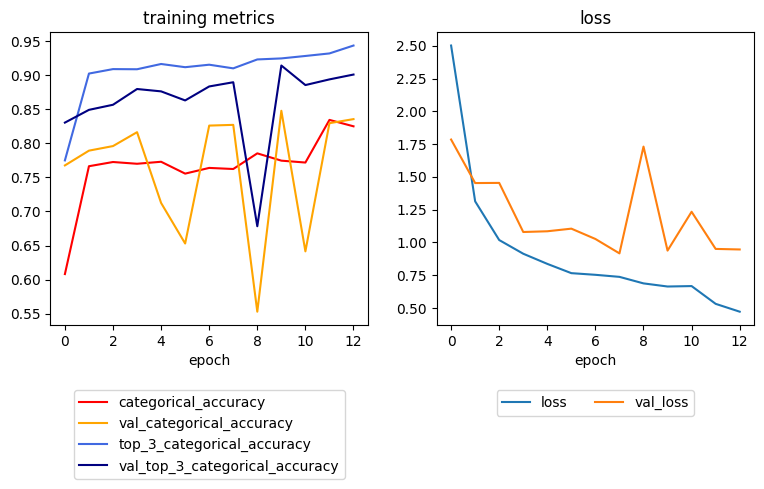

In [19]:
log = pd.read_csv(log_path)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20*cm, 15*cm))

ax1.plot(log['epoch'], log['categorical_accuracy'], label='categorical_accuracy', color='red')
ax1.plot(log['epoch'], log['val_categorical_accuracy'], label='val_categorical_accuracy', color='orange')
ax1.plot(log['epoch'], log[f'top_{top_k}_categorical_accuracy'], label=f'top_{top_k}_categorical_accuracy', color='royalblue')
ax1.plot(log['epoch'], log[f'val_top_{top_k}_categorical_accuracy'], label=f'val_top_{top_k}_categorical_accuracy', color='navy')
ax1.set_title('training metrics')
ax1.set_xlabel('epoch')
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=1)  # Legend below the plot

ax2.plot(log['epoch'], log['loss'], label='loss')
ax2.plot(log['epoch'], log['val_loss'], label='val_loss')
ax2.set_title('loss')
ax2.set_xlabel('epoch')
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=2)  # Legend below the plot

fig.tight_layout(rect=[0, 0.1, 1, 1])

plt.savefig(f'{checkpoint_path}/metrics_loss.svg')
plt.show()

In [20]:
# load old model, if needed
try:
    model
except NameError:
    model = load_model(model_path)

In [21]:
# evaluate model
score = model.evaluate(x=Generator(X_test, y_test, 128, max_sequence_length))

  1/407 ━━━━━━━━━━━━━━━━━━━━ 26s 66ms/step - categorical_accuracy: 0.7969 - loss: 0.6475 - top_3_categorical_accuracy: 0.9297 - w_categorical_accuracy: 0.7969 - w_top_3_categorical_accuracy: 0.9297

  3/407 ━━━━━━━━━━━━━━━━━━━━ 13s 33ms/step - categorical_accuracy: 0.8203 - loss: 0.6246 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8203 - w_top_3_categorical_accuracy: 0.9379

  6/407 ━━━━━━━━━━━━━━━━━━━━ 10s 25ms/step - categorical_accuracy: 0.8396 - loss: 0.6135 - top_3_categorical_accuracy: 0.9423 - w_categorical_accuracy: 0.8396 - w_top_3_categorical_accuracy: 0.9423

  9/407 ━━━━━━━━━━━━━━━━━━━━ 8s 23ms/step - categorical_accuracy: 0.8430 - loss: 0.6171 - top_3_categorical_accuracy: 0.9422 - w_categorical_accuracy: 0.8430 - w_top_3_categorical_accuracy: 0.9422 

 12/407 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - categorical_accuracy: 0.8442 - loss: 0.6196 - top_3_categorical_accuracy: 0.9419 - w_categorical_accuracy: 0.8442 - w_top_3_categorical_accuracy: 0.9419

 15/407 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - categorical_accuracy: 0.8455 - loss: 0.6223 - top_3_categorical_accuracy: 0.9410 - w_categorical_accuracy: 0.8455 - w_top_3_categorical_accuracy: 0.9410

 18/407 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - categorical_accuracy: 0.8472 - loss: 0.6250 - top_3_categorical_accuracy: 0.9404 - w_categorical_accuracy: 0.8472 - w_top_3_categorical_accuracy: 0.9404

 21/407 ━━━━━━━━━━━━━━━━━━━━ 8s 22ms/step - categorical_accuracy: 0.8491 - loss: 0.6243 - top_3_categorical_accuracy: 0.9403 - w_categorical_accuracy: 0.8491 - w_top_3_categorical_accuracy: 0.9403

 24/407 ━━━━━━━━━━━━━━━━━━━━ 8s 21ms/step - categorical_accuracy: 0.8502 - loss: 0.6250 - top_3_categorical_accuracy: 0.9400 - w_categorical_accuracy: 0.8502 - w_top_3_categorical_accuracy: 0.9400

 27/407 ━━━━━━━━━━━━━━━━━━━━ 8s 21ms/step - categorical_accuracy: 0.8510 - loss: 0.6258 - top_3_categorical_accuracy: 0.9395 - w_categorical_accuracy: 0.8510 - w_top_3_categorical_accuracy: 0.9395

 30/407 ━━━━━━━━━━━━━━━━━━━━ 8s 21ms/step - categorical_accuracy: 0.8517 - loss: 0.6263 - top_3_categorical_accuracy: 0.9391 - w_categorical_accuracy: 0.8517 - w_top_3_categorical_accuracy: 0.9391

 33/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8521 - loss: 0.6274 - top_3_categorical_accuracy: 0.9386 - w_categorical_accuracy: 0.8521 - w_top_3_categorical_accuracy: 0.9386

 36/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8524 - loss: 0.6283 - top_3_categorical_accuracy: 0.9383 - w_categorical_accuracy: 0.8524 - w_top_3_categorical_accuracy: 0.9383

 39/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8525 - loss: 0.6291 - top_3_categorical_accuracy: 0.9381 - w_categorical_accuracy: 0.8525 - w_top_3_categorical_accuracy: 0.9381

 42/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8527 - loss: 0.6293 - top_3_categorical_accuracy: 0.9379 - w_categorical_accuracy: 0.8527 - w_top_3_categorical_accuracy: 0.9379

 45/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8529 - loss: 0.6295 - top_3_categorical_accuracy: 0.9378 - w_categorical_accuracy: 0.8529 - w_top_3_categorical_accuracy: 0.9378

 48/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8531 - loss: 0.6299 - top_3_categorical_accuracy: 0.9376 - w_categorical_accuracy: 0.8531 - w_top_3_categorical_accuracy: 0.9376

 51/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8532 - loss: 0.6306 - top_3_categorical_accuracy: 0.9374 - w_categorical_accuracy: 0.8532 - w_top_3_categorical_accuracy: 0.9374

 54/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8534 - loss: 0.6311 - top_3_categorical_accuracy: 0.9372 - w_categorical_accuracy: 0.8534 - w_top_3_categorical_accuracy: 0.9372

 57/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8536 - loss: 0.6313 - top_3_categorical_accuracy: 0.9371 - w_categorical_accuracy: 0.8536 - w_top_3_categorical_accuracy: 0.9371

 60/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8537 - loss: 0.6316 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8537 - w_top_3_categorical_accuracy: 0.9370

 63/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8539 - loss: 0.6318 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8539 - w_top_3_categorical_accuracy: 0.9370

 65/407 ━━━━━━━━━━━━━━━━━━━━ 7s 21ms/step - categorical_accuracy: 0.8540 - loss: 0.6319 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8540 - w_top_3_categorical_accuracy: 0.9369

 67/407 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - categorical_accuracy: 0.8541 - loss: 0.6320 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8541 - w_top_3_categorical_accuracy: 0.9369

 70/407 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - categorical_accuracy: 0.8542 - loss: 0.6322 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8542 - w_top_3_categorical_accuracy: 0.9369

 73/407 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - categorical_accuracy: 0.8543 - loss: 0.6323 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8543 - w_top_3_categorical_accuracy: 0.9369

 76/407 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - categorical_accuracy: 0.8544 - loss: 0.6323 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9369

 79/407 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - categorical_accuracy: 0.8544 - loss: 0.6324 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8544 - w_top_3_categorical_accuracy: 0.9369

 82/407 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step - categorical_accuracy: 0.8545 - loss: 0.6326 - top_3_categorical_accuracy: 0.9368 - w_categorical_accuracy: 0.8545 - w_top_3_categorical_accuracy: 0.9368

 85/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8546 - loss: 0.6325 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8546 - w_top_3_categorical_accuracy: 0.9369

 88/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8547 - loss: 0.6324 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8547 - w_top_3_categorical_accuracy: 0.9369

 91/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8548 - loss: 0.6324 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8548 - w_top_3_categorical_accuracy: 0.9369

 94/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8549 - loss: 0.6323 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8549 - w_top_3_categorical_accuracy: 0.9369

 97/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8550 - loss: 0.6323 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8550 - w_top_3_categorical_accuracy: 0.9369

100/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8552 - loss: 0.6322 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8552 - w_top_3_categorical_accuracy: 0.9369

103/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8553 - loss: 0.6321 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8553 - w_top_3_categorical_accuracy: 0.9369

106/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8554 - loss: 0.6321 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8554 - w_top_3_categorical_accuracy: 0.9369

109/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8555 - loss: 0.6322 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8555 - w_top_3_categorical_accuracy: 0.9369

112/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8556 - loss: 0.6322 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8556 - w_top_3_categorical_accuracy: 0.9369

115/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8557 - loss: 0.6322 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8557 - w_top_3_categorical_accuracy: 0.9369

118/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8559 - loss: 0.6321 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8559 - w_top_3_categorical_accuracy: 0.9369

121/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8560 - loss: 0.6320 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8560 - w_top_3_categorical_accuracy: 0.9369

124/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8561 - loss: 0.6319 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8561 - w_top_3_categorical_accuracy: 0.9369

127/407 ━━━━━━━━━━━━━━━━━━━━ 6s 22ms/step - categorical_accuracy: 0.8562 - loss: 0.6318 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8562 - w_top_3_categorical_accuracy: 0.9369

130/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8563 - loss: 0.6317 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8563 - w_top_3_categorical_accuracy: 0.9369

133/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8564 - loss: 0.6316 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8564 - w_top_3_categorical_accuracy: 0.9369

136/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8565 - loss: 0.6315 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8565 - w_top_3_categorical_accuracy: 0.9369

139/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8566 - loss: 0.6314 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8566 - w_top_3_categorical_accuracy: 0.9370

142/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8567 - loss: 0.6312 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8567 - w_top_3_categorical_accuracy: 0.9370

145/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8568 - loss: 0.6311 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8568 - w_top_3_categorical_accuracy: 0.9370

148/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8569 - loss: 0.6310 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8569 - w_top_3_categorical_accuracy: 0.9370

151/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8571 - loss: 0.6308 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8571 - w_top_3_categorical_accuracy: 0.9370

154/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8572 - loss: 0.6307 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9370

156/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8572 - loss: 0.6307 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8572 - w_top_3_categorical_accuracy: 0.9370

159/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8573 - loss: 0.6306 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9370

161/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8573 - loss: 0.6306 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8573 - w_top_3_categorical_accuracy: 0.9370

164/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8574 - loss: 0.6306 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8574 - w_top_3_categorical_accuracy: 0.9370

167/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8575 - loss: 0.6305 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8575 - w_top_3_categorical_accuracy: 0.9370

170/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8576 - loss: 0.6305 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9370

173/407 ━━━━━━━━━━━━━━━━━━━━ 5s 22ms/step - categorical_accuracy: 0.8576 - loss: 0.6304 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8576 - w_top_3_categorical_accuracy: 0.9370

176/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8577 - loss: 0.6304 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8577 - w_top_3_categorical_accuracy: 0.9370

178/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8578 - loss: 0.6303 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9370

181/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8578 - loss: 0.6303 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8578 - w_top_3_categorical_accuracy: 0.9370

184/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8579 - loss: 0.6302 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8579 - w_top_3_categorical_accuracy: 0.9370

187/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8580 - loss: 0.6302 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9370

190/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8580 - loss: 0.6301 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8580 - w_top_3_categorical_accuracy: 0.9370

193/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8581 - loss: 0.6300 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8581 - w_top_3_categorical_accuracy: 0.9370

196/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8582 - loss: 0.6300 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9370

199/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8582 - loss: 0.6300 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8582 - w_top_3_categorical_accuracy: 0.9370

202/407 ━━━━━━━━━━━━━━━━━━━━ 4s 21ms/step - categorical_accuracy: 0.8583 - loss: 0.6299 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9369

205/407 ━━━━━━━━━━━━━━━━━━━━ 4s 21ms/step - categorical_accuracy: 0.8583 - loss: 0.6299 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8583 - w_top_3_categorical_accuracy: 0.9369

208/407 ━━━━━━━━━━━━━━━━━━━━ 4s 21ms/step - categorical_accuracy: 0.8584 - loss: 0.6299 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9369

210/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8584 - loss: 0.6299 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8584 - w_top_3_categorical_accuracy: 0.9369

213/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8585 - loss: 0.6298 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9369

215/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8585 - loss: 0.6298 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8585 - w_top_3_categorical_accuracy: 0.9369

218/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8586 - loss: 0.6298 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8586 - w_top_3_categorical_accuracy: 0.9369

221/407 ━━━━━━━━━━━━━━━━━━━━ 4s 22ms/step - categorical_accuracy: 0.8587 - loss: 0.6297 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9369

224/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8587 - loss: 0.6297 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8587 - w_top_3_categorical_accuracy: 0.9369

227/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8588 - loss: 0.6296 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9369

230/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8588 - loss: 0.6296 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8588 - w_top_3_categorical_accuracy: 0.9369

233/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8589 - loss: 0.6296 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9369

236/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8589 - loss: 0.6295 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8589 - w_top_3_categorical_accuracy: 0.9369

239/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8590 - loss: 0.6295 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9369

242/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8590 - loss: 0.6294 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8590 - w_top_3_categorical_accuracy: 0.9369

245/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8591 - loss: 0.6294 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9369

248/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8591 - loss: 0.6294 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8591 - w_top_3_categorical_accuracy: 0.9369

251/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8592 - loss: 0.6293 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9369

253/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8592 - loss: 0.6293 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8592 - w_top_3_categorical_accuracy: 0.9369

256/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8593 - loss: 0.6292 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9369

259/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8593 - loss: 0.6291 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8593 - w_top_3_categorical_accuracy: 0.9369

262/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8594 - loss: 0.6291 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9369

265/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8594 - loss: 0.6290 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8594 - w_top_3_categorical_accuracy: 0.9369

268/407 ━━━━━━━━━━━━━━━━━━━━ 3s 22ms/step - categorical_accuracy: 0.8595 - loss: 0.6289 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9369

271/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8595 - loss: 0.6288 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8595 - w_top_3_categorical_accuracy: 0.9369

273/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8596 - loss: 0.6287 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9369

276/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8596 - loss: 0.6287 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9369

279/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8596 - loss: 0.6286 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8596 - w_top_3_categorical_accuracy: 0.9369

282/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8597 - loss: 0.6285 - top_3_categorical_accuracy: 0.9369 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9369

285/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8597 - loss: 0.6284 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8597 - w_top_3_categorical_accuracy: 0.9370

288/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8598 - loss: 0.6283 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9370

291/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8598 - loss: 0.6283 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9370

294/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8598 - loss: 0.6282 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8598 - w_top_3_categorical_accuracy: 0.9370

297/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8599 - loss: 0.6281 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9370

300/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8599 - loss: 0.6280 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8599 - w_top_3_categorical_accuracy: 0.9370

303/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8600 - loss: 0.6279 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9370

306/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8600 - loss: 0.6278 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9370

309/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8600 - loss: 0.6278 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8600 - w_top_3_categorical_accuracy: 0.9370

311/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8601 - loss: 0.6277 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9370

314/407 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - categorical_accuracy: 0.8601 - loss: 0.6276 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9370

317/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8601 - loss: 0.6275 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8601 - w_top_3_categorical_accuracy: 0.9370

320/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8602 - loss: 0.6274 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9370

323/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8602 - loss: 0.6273 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8602 - w_top_3_categorical_accuracy: 0.9370

326/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8603 - loss: 0.6273 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9370

328/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8603 - loss: 0.6272 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9370

331/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8603 - loss: 0.6271 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8603 - w_top_3_categorical_accuracy: 0.9370

334/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8604 - loss: 0.6271 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9370

337/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8604 - loss: 0.6270 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9370

340/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8604 - loss: 0.6269 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8604 - w_top_3_categorical_accuracy: 0.9370

343/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8605 - loss: 0.6268 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9370

346/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8605 - loss: 0.6268 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9370

349/407 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - categorical_accuracy: 0.8605 - loss: 0.6267 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9370

352/407 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - categorical_accuracy: 0.8605 - loss: 0.6267 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8605 - w_top_3_categorical_accuracy: 0.9370

354/407 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - categorical_accuracy: 0.8606 - loss: 0.6266 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9370

357/407 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - categorical_accuracy: 0.8606 - loss: 0.6266 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9370

360/407 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - categorical_accuracy: 0.8606 - loss: 0.6265 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8606 - w_top_3_categorical_accuracy: 0.9370

363/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8607 - loss: 0.6265 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9370

366/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8607 - loss: 0.6264 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9370

369/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8607 - loss: 0.6264 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9370

372/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8607 - loss: 0.6263 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8607 - w_top_3_categorical_accuracy: 0.9370

375/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8608 - loss: 0.6263 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9370

378/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8608 - loss: 0.6262 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9370

381/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8608 - loss: 0.6262 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9370

384/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8608 - loss: 0.6262 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8608 - w_top_3_categorical_accuracy: 0.9370

387/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8609 - loss: 0.6261 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9370

390/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8609 - loss: 0.6261 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9370

393/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8609 - loss: 0.6260 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9370

396/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8609 - loss: 0.6260 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9370

399/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8609 - loss: 0.6260 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8609 - w_top_3_categorical_accuracy: 0.9370

401/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8610 - loss: 0.6259 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9370

404/407 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - categorical_accuracy: 0.8610 - loss: 0.6259 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9370

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step - categorical_accuracy: 0.8610 - loss: 0.6259 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9370

407/407 ━━━━━━━━━━━━━━━━━━━━ 9s 23ms/step - categorical_accuracy: 0.8610 - loss: 0.6259 - top_3_categorical_accuracy: 0.9370 - w_categorical_accuracy: 0.8610 - w_top_3_categorical_accuracy: 0.9370


In [22]:
print(f'Test loss: {score[0]}')
print(f'Test accuracy: {score[1]}')

Test loss: 0.6217053532600403
Test accuracy: 0.8633745312690735


In [23]:
# print classification report
y_pred = model.predict(x=Generator(X_test, y_test, 128, max_sequence_length))
y_pred = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_test, axis=1)

distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

report = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan)
report_dict = classification_report(y_true, y_pred, target_names=distinct_labels, zero_division=np.nan, output_dict=True)

print(report)

# save classification report to file
with open(f'{checkpoint_path}/classification_report.txt', 'w') as f:
    json.dump(report_dict, f)

  1/407 ━━━━━━━━━━━━━━━━━━━━ 4:12 622ms/step

  5/407 ━━━━━━━━━━━━━━━━━━━━ 6s 16ms/step   

  8/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 12/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 15/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 18/407 ━━━━━━━━━━━━━━━━━━━━ 6s 17ms/step

 21/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 24/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 27/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 30/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 33/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 37/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 40/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 43/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 46/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 49/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 52/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 55/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 58/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 61/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 64/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 67/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 70/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 73/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 76/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 79/407 ━━━━━━━━━━━━━━━━━━━━ 6s 18ms/step

 82/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

 85/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

 88/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

 91/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

 94/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

 97/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

101/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

104/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

107/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

110/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

113/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

116/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

119/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

123/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

126/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

129/407 ━━━━━━━━━━━━━━━━━━━━ 5s 18ms/step

132/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

135/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

138/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

141/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

144/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

147/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

150/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

153/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

157/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

160/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

163/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

167/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

171/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

174/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

177/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

180/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

183/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

186/407 ━━━━━━━━━━━━━━━━━━━━ 4s 18ms/step

190/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

193/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

196/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

199/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

202/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

205/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

208/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

211/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

214/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

217/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

221/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

224/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

227/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

230/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

233/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

236/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

239/407 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step

242/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

245/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

248/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

251/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

254/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

257/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

260/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

263/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

266/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

269/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

272/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

275/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

278/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

282/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

285/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

288/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

292/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

295/407 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step

298/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

301/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

304/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

307/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

310/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

313/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

316/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

319/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

322/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

325/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

328/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

331/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

334/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

337/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

340/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

344/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

347/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

351/407 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step

355/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

358/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

361/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

364/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

367/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

370/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

373/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

376/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

379/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

382/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

386/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

389/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

392/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

395/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

398/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

401/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

404/407 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step

407/407 ━━━━━━━━━━━━━━━━━━━━ 9s 20ms/step


                 precision    recall  f1-score   support

      adjkerntz       0.00      0.00      0.00        11
         alpine       0.52      0.82      0.64       560
          anvil       0.46      0.44      0.45       378
          atrun       0.97      1.00      0.98       237
            awk       0.10      1.00      0.19         5
       basename       0.00      0.00      0.00         2
           bash       0.95      0.96      0.95     12512
            cat       0.86      0.92      0.89        26
        cleanup       0.42      0.62      0.50       276
            cmp       0.62      1.00      0.77         5
             cp       0.91      1.00      0.95        30
           cron       0.85      1.00      0.92       624
           date       0.94      1.00      0.97      1218
             dd       0.96      0.99      0.98       125
       dhclient       0.00      0.06      0.00        17
          dmesg       0.56      1.00      0.71        15
          egrep       0.17    

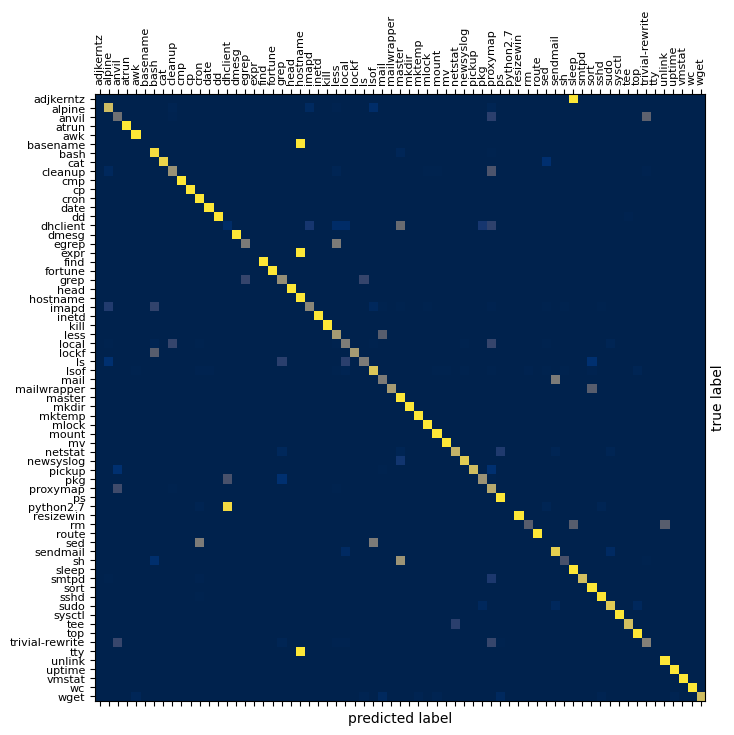

In [24]:
# print confusion matrix
# labels explicitly set, because current model may not predict all labels
conf_matrix = confusion_matrix(y_true, y_pred, labels=range(labels_cardinality), normalize='true')

# Replace all NaN values with 0
conf_matrix = np.nan_to_num(conf_matrix)

# Verify the distinct labels align correctly
distinct_labels = [labels_map[i] for i in range(labels_cardinality)]

# Plot the confusion matrix
fig, ax = plt.subplots(figsize=(20*cm, 20*cm))

ax.matshow(conf_matrix, cmap='cividis', aspect='auto')

# Set class names on axes
ax.set_xticks(range(len(distinct_labels)))
ax.set_yticks(range(len(distinct_labels)))
ax.set_xticklabels(distinct_labels, rotation=90, fontsize=8)
ax.set_yticklabels(distinct_labels, fontsize=8)

# Set axis labels "predicted" and "actual"
ax.set_xlabel('predicted label')
ax.set_ylabel('true label')
# y-axis label right side
ax.yaxis.set_label_position('right')

# set figsize
plt.savefig(f'{checkpoint_path}/confusion_matrix.svg')
plt.show()

In [25]:
unique_in_y_pred = [ labels_map[i] for i in np.unique(y_pred) ]
#print("Unique labels in y_pred:", unique_in_y_pred)

unique_not_in_y_pred = [ label for label in distinct_labels if label not in unique_in_y_pred ]
print("Unique labels not in y_pred:", unique_not_in_y_pred)

Unique labels not in y_pred: ['expr', 'python2.7']
